In [1]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

In [345]:
provider_df = pd.read_csv("Train-1542865627584.csv")

In [346]:
inpatient_df = pd.read_csv("Train_Inpatientdata-1542865627584.csv")

In [347]:
outpatient_df = pd.read_csv("Train_Outpatientdata-1542865627584.csv")

In [348]:
inpatient_provider_df = pd.read_csv("Train-1542865627584.csv")

In [349]:
outpatient_provider_df = pd.read_csv("Train-1542865627584.csv")

Reading all CSV files

In [350]:
inpatient_provider_df = inpatient_provider_df[inpatient_provider_df['Provider'].isin(inpatient_df['Provider'].unique())]

In [351]:
outpatient_provider_df = outpatient_provider_df[outpatient_provider_df['Provider'].isin(outpatient_df['Provider'].unique())]

Filtering out both inpatient and outpatient details dataframe for which we have potential fraud label

In [352]:
inpatient_final_df, test_inpatient_final_df = train_test_split(inpatient_provider_df, test_size=0.20, random_state=42,stratify=inpatient_provider_df[['PotentialFraud']])

In [353]:
outpatient_final_df, test_outpatient_final_df = train_test_split(outpatient_provider_df, test_size=0.20, random_state=42,stratify=outpatient_provider_df[['PotentialFraud']])

Splitting Provider into train and test,with 20% on test set

In [354]:
inpatient_final_df, cv_inpatient_final_df = train_test_split(inpatient_provider_df, test_size=0.20, random_state=13,stratify=inpatient_provider_df[['PotentialFraud']])

In [355]:
outpatient_final_df, cv_outpatient_final_df = train_test_split(outpatient_provider_df, test_size=0.20, random_state=13,stratify=outpatient_provider_df[['PotentialFraud']])

Splitting Provider into train and CV, with 16% on cv set and 64% in trainset

In [356]:
inpatient_provider = pd.merge(inpatient_df, inpatient_final_df, on="Provider", how="inner")

In [357]:
outpatient_provider = pd.merge(outpatient_df, outpatient_final_df, on="Provider", how="inner")

In [358]:
inpatient_final_df = inpatient_final_df.set_index('Provider')

In [359]:
outpatient_final_df = outpatient_final_df.set_index('Provider')

Merging Train provider with inpatient and outpatient

In [360]:
inpatient_final_df.shape

(1673, 1)

In [361]:
outpatient_final_df.shape

(4009, 1)

In [362]:
len(outpatient_final_df[outpatient_final_df['PotentialFraud'] == 'Yes']) / len(outpatient_final_df)

0.09229234222998253

In [363]:
len(cv_outpatient_final_df[cv_outpatient_final_df['PotentialFraud'] == 'Yes']) / len(cv_outpatient_final_df)

0.09172482552342971

In [364]:
len(test_outpatient_final_df[test_outpatient_final_df['PotentialFraud'] == 'Yes']) / len(test_outpatient_final_df)

0.09172482552342971

In [365]:
test_inpatient_provider = pd.merge(inpatient_df, test_inpatient_final_df, on="Provider", how="inner")

In [366]:
test_outpatient_provider = pd.merge(outpatient_df, test_outpatient_final_df, on="Provider", how="inner")

In [367]:
test_inpatient_final_df = test_inpatient_final_df.set_index('Provider')

In [368]:
test_outpatient_final_df = test_outpatient_final_df.set_index('Provider')

In [369]:
test_inpatient_final_df.shape

(419, 1)

In [370]:
test_outpatient_final_df.shape

(1003, 1)

Merging Test provider with inpatient and outpatient

In [371]:
cv_inpatient_provider = pd.merge(inpatient_df, cv_inpatient_final_df, on="Provider", how="inner")

In [372]:
cv_outpatient_provider = pd.merge(outpatient_df, cv_outpatient_final_df, on="Provider", how="inner")

In [373]:
cv_inpatient_final_df = cv_inpatient_final_df.set_index('Provider')

In [374]:
cv_outpatient_final_df = cv_outpatient_final_df.set_index('Provider')

In [375]:
cv_inpatient_final_df.shape

(419, 1)

In [376]:
cv_outpatient_final_df.shape

(1003, 1)

Merging Cross validate provider with inpatient and outpatient

<h2>Feature Engineering</h2>

<h3>FE Claim count per provider</h3> 

In [377]:
inpatient_claim_count_per_provider = inpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [378]:
outpatient_claim_count_per_provider = outpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [379]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_claim_count_per_provider, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_claim_count_per_provider, left_index=True, right_index=True)

<h3>FE Total money reimbursed per provider</h3> 

In [380]:
inpatient_total_reimbursed_per_provider = inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [381]:
outpatient_total_reimbursed_per_provider = outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [382]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_total_reimbursed_per_provider, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_total_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average money reimbursed per provider</h3> 

In [383]:
inpatient_avg_reimbursed_per_provider = inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')
outpatient_avg_reimbursed_per_provider = outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [384]:
outpatient_avg_reimbursed_per_provider = outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [385]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average number of days admitted per provider</h3>

In [386]:
inpatient_provider[['AdmissionDt','DischargeDt']] = inpatient_provider[['AdmissionDt','DischargeDt']].apply(pd.to_datetime)

In [387]:
inpatient_provider['AdmitDays'] = (inpatient_provider['DischargeDt'] - inpatient_provider['AdmissionDt']).dt.days + 1

In [388]:
inpatient_avg_admitdays_per_provider = inpatient_provider.groupby('Provider')['AdmitDays'].agg('mean')

In [389]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_avg_admitdays_per_provider, left_index=True, right_index=True)

<h3>FE Is claim end date and discharge date same</h3>

In [390]:
inpatient_provider[['ClaimStartDt','ClaimEndDt']] = inpatient_provider[['ClaimStartDt','ClaimEndDt']].apply(pd.to_datetime)
inpatient_provider['IsClaimEndDtDischardeDt'] = inpatient_provider['DischargeDt'] != inpatient_provider['ClaimEndDt']
inpatient_claim_discharge_date_per_provider = inpatient_provider.groupby('Provider')['IsClaimEndDtDischardeDt'].agg('count')

In [391]:
inpatient_provider['IsClaimEndDtDischardeDt'] = inpatient_provider['DischargeDt'] != inpatient_provider['ClaimEndDt']

In [392]:
inpatient_claim_discharge_date_per_provider = inpatient_provider.groupby('Provider')['IsClaimEndDtDischardeDt'].agg('count')

In [393]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_claim_discharge_date_per_provider, left_index=True, right_index=True)

<h3>FE Beneficiary features</h3>

In [394]:
beneficiary_df = pd.read_csv("Train_Beneficiarydata-1542865627584.csv")

In [395]:
beneficiary_df["County"] = "C" + beneficiary_df["County"].astype(str)
beneficiary_df["State"] = "S" + beneficiary_df["State"].astype(str)
beneficiary_df["Gender"] = beneficiary_df["Gender"].replace(2,0)

In [396]:
inpatient_beneficiary_detail = pd.merge(beneficiary_df, inpatient_provider, how="inner", on='BeneID')

In [397]:
outpatient_beneficiary_detail = pd.merge(beneficiary_df, outpatient_provider, how="inner", on='BeneID')

<h3>FE Gender</h3>

In [398]:
inpatient_gender = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
inpatient_gender.columns = ['Gender_0','Gender_1']

In [399]:
outpatient_gender = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
outpatient_gender.columns = ['Gender_0','Gender_1']

In [400]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_gender, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_gender, left_index=True, right_index=True)

<h3>FE Race</h3>

In [401]:
inpatient_race = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])

In [402]:
inpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [403]:
outpatient_race = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])
outpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [404]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_race, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_race, left_index=True, right_index=True)

<h3>FE Age</h3>

In [405]:
inpatient_beneficiary_detail['DOB'] = pd.to_datetime(inpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
inpatient_beneficiary_detail['DOD'] = pd.to_datetime(inpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
inpatient_beneficiary_detail['Age'] = round(((inpatient_beneficiary_detail['DOD'] - inpatient_beneficiary_detail['DOB']).dt.days)/365)
inpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - inpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [406]:
inpatient_avg_age = inpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [407]:
outpatient_beneficiary_detail['DOB'] = pd.to_datetime(outpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
outpatient_beneficiary_detail['DOD'] = pd.to_datetime(outpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
outpatient_beneficiary_detail['Age'] = round(((outpatient_beneficiary_detail['DOD'] - outpatient_beneficiary_detail['DOB']).dt.days)/365)
outpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - outpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [408]:
outpatient_avg_age = outpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [409]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_avg_age, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_avg_age, left_index=True, right_index=True)

<h3>FE Only Fraud Diagnosis Code</h3>

In [410]:
inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [411]:
outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [412]:
outpatient_final_df.shape

(4009, 11)

In [413]:
inpatient_final_df.shape

(1673, 13)

In [414]:
inpatient_diagnosis_code = pd.DataFrame(np.vstack([inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
inpatient_diagnosis_code = inpatient_diagnosis_code.dropna()
inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)
fraud_inpatient_diagnosis_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_inpatient_diagnosis_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)
only_fraud_inpatient_diagnosis_code = list(fraud_inpatient_diagnosis_claim_code - non_fraud_inpatient_diagnosis_claim_code)

In [415]:
import pickle

In [416]:
with open('only_fraud_inpatient_diagnosis_code.pkl', 'wb') as file:
    pickle.dump(only_fraud_inpatient_diagnosis_code, file)

In [417]:
inpatient_fraud_code_count = pd.crosstab(inpatient_diagnosis_code['Provider'], inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_inpatient_diagnosis_code]

In [418]:
inpatient_fraud_code_count['only_fraud_code_count'] = inpatient_fraud_code_count.sum(axis=1)

In [419]:
outpatient_diagnosis_code = pd.DataFrame(np.vstack([outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
outpatient_diagnosis_code = outpatient_diagnosis_code.dropna()
outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)
fraud_outpatient_diagnosis_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_outpatient_diagnosis_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)
only_fraud_outpatient_diagnosis_code = list(fraud_outpatient_diagnosis_claim_code - non_fraud_outpatient_diagnosis_claim_code)

In [420]:
only_fraud_outpatient_diagnosis_code
with open('only_fraud_outpatient_diagnosis_code.pkl', 'wb') as file:
    pickle.dump(only_fraud_outpatient_diagnosis_code, file)

In [421]:
outpatient_fraud_code_count = pd.crosstab(outpatient_diagnosis_code['Provider'], outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_outpatient_diagnosis_code]

In [422]:
outpatient_fraud_code_count['only_fraud_code_count'] = outpatient_fraud_code_count.sum(axis=1)

In [423]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_fraud_code_count['only_fraud_code_count'], how='left', left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_fraud_code_count['only_fraud_code_count'], how='left', left_index=True, right_index=True)

In [424]:
inpatient_final_df = inpatient_final_df.fillna(0)

In [425]:
outpatient_final_df = outpatient_final_df.fillna(0)

In [426]:
outpatient_final_df.shape

(4009, 12)

In [427]:
inpatient_final_df.shape

(1673, 14)

<h3>FE Only Fraud Procedure Code</h3>

In [428]:
inpatient_procedure_code = pd.DataFrame(np.vstack([inpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
inpatient_procedure_code = inpatient_procedure_code.dropna()
inpatient_procedure_code['ClmProcedureCode'] = 'P' + inpatient_procedure_code['ClmProcedureCode'].astype(str)
fraud_inpatient_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_inpatient_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_inpatient_procedure_code = list(fraud_inpatient_procedure_code - non_fraud_inpatient_procedure_code)

In [429]:
with open('only_fraud_inpatient_procedure_code.pkl', 'wb') as file:
    pickle.dump(only_fraud_inpatient_procedure_code, file)

In [430]:
inpatient_procedure_code_count = pd.crosstab(inpatient_procedure_code['Provider'], inpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_inpatient_procedure_code]

In [431]:
inpatient_procedure_code_count['only_fraud_procedure_code_count'] = inpatient_procedure_code_count.sum(axis=1)

In [432]:
outpatient_procedure_code = pd.DataFrame(np.vstack([outpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
outpatient_procedure_code = outpatient_procedure_code.dropna()
outpatient_procedure_code['ClmProcedureCode'] = 'P' + outpatient_procedure_code['ClmProcedureCode'].astype(str)
fraud_outpatient_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_outpatient_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_outpatient_procedure_code = list(fraud_outpatient_procedure_code - non_fraud_outpatient_procedure_code)

In [433]:
with open('only_fraud_outpatient_procedure_code.pkl', 'wb') as file:
    pickle.dump(only_fraud_outpatient_procedure_code, file)

In [434]:
outpatient_procedure_code_count = pd.crosstab(outpatient_procedure_code['Provider'], outpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_outpatient_procedure_code]

In [435]:
outpatient_procedure_code_count['only_fraud_procedure_code_count'] = outpatient_procedure_code_count.sum(axis=1)

In [436]:
len(outpatient_procedure_code_count)

121

In [437]:
len(outpatient_final_df)

4009

In [438]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_procedure_code_count['only_fraud_procedure_code_count'],how='left', left_index=True, right_index=True)

In [439]:
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_procedure_code_count['only_fraud_procedure_code_count'], how='left', left_index=True, right_index=True)

In [440]:
inpatient_final_df = inpatient_final_df.fillna(0)

In [441]:
outpatient_final_df = outpatient_final_df.fillna(0)

In [442]:
outpatient_final_df.shape

(4009, 13)

In [443]:
inpatient_final_df.shape

(1673, 15)

<h3>FE Fraud Physician Code</h3>

In [444]:
fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_inpatient_physician = list(fraud_attending_physician - non_fraud_attending_physician)

In [445]:
with open('only_fraud_inpatient_physician.pkl', 'wb') as file:
    pickle.dump(only_fraud_inpatient_physician, file)

In [446]:
inpatient_physician_count = pd.crosstab(inpatient_provider['Provider'], inpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_inpatient_physician]

In [447]:
inpatient_physician_count['only_fraud_physician_count'] = inpatient_physician_count.sum(axis=1)

In [448]:
fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_outpatient_physician = list(fraud_attending_physician - non_fraud_attending_physician)

In [449]:
with open('only_fraud_outpatient_physician.pkl', 'wb') as file:
    pickle.dump(only_fraud_outpatient_physician, file)

In [450]:
outpatient_physician_count = pd.crosstab(outpatient_provider['Provider'], outpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_outpatient_physician]

In [451]:
outpatient_physician_count['only_fraud_physician_count'] = outpatient_physician_count.sum(axis=1)

In [452]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)

In [453]:
inpatient_final_df = inpatient_final_df.fillna(0)

In [454]:
outpatient_final_df = outpatient_final_df.fillna(0)

<h3>FE Fraud Operating Physician Code</h3>

In [455]:
fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_op_inpatient_physician = list(fraud_op_physician - non_fraud_op_physician)

In [456]:
with open('only_fraud_op_inpatient_physician.pkl', 'wb') as file:
    pickle.dump(only_fraud_op_inpatient_physician, file)

In [457]:
inpatient_op_physician_count = pd.crosstab(inpatient_provider['Provider'], inpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_op_inpatient_physician]

In [458]:
inpatient_op_physician_count['only_fraud_op_physician_count'] = inpatient_op_physician_count.sum(axis=1)

In [459]:
fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_op_outpatient_physician = list(fraud_op_physician - non_fraud_op_physician)

In [460]:
with open('only_fraud_op_outpatient_physician.pkl', 'wb') as file:
    pickle.dump(only_fraud_op_outpatient_physician, file)

In [461]:
outpatient_op_physician_count = pd.crosstab(outpatient_provider['Provider'], outpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_op_outpatient_physician]

In [462]:
outpatient_op_physician_count['only_fraud_op_physician_count'] = outpatient_op_physician_count.sum(axis=1)

In [463]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)

In [464]:
inpatient_final_df.shape

(1673, 17)

In [465]:
outpatient_final_df.shape

(4009, 15)

In [466]:
inpatient_final_df = inpatient_final_df.fillna(0)

In [467]:
outpatient_final_df = outpatient_final_df.fillna(0)

<h3>FE is_alive</h3>

In [468]:
inpatient_is_alive = inpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [469]:
inpatient_is_alive = inpatient_is_alive[inpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [470]:
outpatient_is_alive = outpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [471]:
outpatient_is_alive = outpatient_is_alive[outpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [472]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_is_alive, on='Provider',how='left')
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_is_alive, on='Provider',how='left')

In [473]:
inpatient_final_df['alive_count'].fillna(0, inplace=True)
outpatient_final_df['alive_count'].fillna(0, inplace=True)

<h3>FE number_of_doctor</h3>

In [474]:
inpatient_total_doctor = pd.DataFrame(np.vstack([inpatient_provider[["ClaimID","Provider","OperatingPhysician"]], inpatient_provider[["ClaimID","Provider","AttendingPhysician"]], inpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
inpatient_total_doctor = inpatient_total_doctor.dropna()

In [475]:
inpatient_doctor_count = inpatient_total_doctor.groupby('Provider')['Doctor'].unique()
inpatient_doctor_count = inpatient_doctor_count.str.len()

In [476]:
outpatient_total_doctor = pd.DataFrame(np.vstack([outpatient_provider[["ClaimID","Provider","OperatingPhysician"]], outpatient_provider[["ClaimID","Provider","AttendingPhysician"]], outpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
outpatient_total_doctor = outpatient_total_doctor.dropna()

In [477]:
outpatient_doctor_count = outpatient_total_doctor.groupby('Provider')['Doctor'].unique()
outpatient_doctor_count = outpatient_doctor_count.str.len()

In [478]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_doctor_count, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_doctor_count, left_index=True, right_index=True)

In [479]:
inpatient_final_df.head() 

,PotentialFraud,Claim count,InscClaimAmtReimbursed_total,InscClaimAmtReimbursed_avg,AdmitDays,IsClaimEndDtDischardeDt,Gender_0,Gender_1,Race_1,Race_2,Race_3,Race_5,Age,only_fraud_code_count,only_fraud_procedure_code_count,only_fraud_physician_count,only_fraud_op_physician_count,alive_count,Doctor
Provider,,,,,,,,,,,,,,,,,,,
PRV51001,No,5,97000,19400.000000,6.000000,5,3,2,5,0,0,0,78.400000,0,0.0,0.0,0.0,0.0,7
PRV51003,Yes,62,573000,9241.935484,6.161290,62,41,21,49,13,0,0,70.822581,5,3.0,62.0,40.0,1.0,2
PRV51008,No,2,25000,12500.000000,5.000000,2,1,1,2,0,0,0,51.500000,0,0.0,0.0,0.0,0.0,4
PRV51011,No,1,5000,5000.000000,6.000000,1,1,0,1,0,0,0,98.000000,0,0.0,0.0,0.0,0.0,1
PRV51021,Yes,29,269000,9275.862069,5.758621,29,20,9,18,11,0,0,70.862069,5,1.0,29.0,17.0,0.0,11


<h2>Cross Validation set feature engineering</h2>

<h3>FE Claim count per provider</h3> 

In [480]:
cv_inpatient_claim_count_per_provider = cv_inpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [481]:
cv_outpatient_claim_count_per_provider = cv_outpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [482]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_claim_count_per_provider, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_claim_count_per_provider, left_index=True, right_index=True)

<h3>FE Total money reimbursed per provider</h3> 

In [483]:
cv_inpatient_total_reimbursed_per_provider = cv_inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [484]:
cv_outpatient_total_reimbursed_per_provider = cv_outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [485]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_total_reimbursed_per_provider, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_total_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average money reimbursed per provider</h3> 

In [486]:
cv_inpatient_avg_reimbursed_per_provider = cv_inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [487]:
cv_outpatient_avg_reimbursed_per_provider = cv_outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [488]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average number of days admitted per provider</h3>

In [489]:
cv_inpatient_provider[['AdmissionDt','DischargeDt']] = cv_inpatient_provider[['AdmissionDt','DischargeDt']].apply(pd.to_datetime)

In [490]:
cv_inpatient_provider['AdmitDays'] = (cv_inpatient_provider['DischargeDt'] - cv_inpatient_provider['AdmissionDt']).dt.days + 1

In [491]:
cv_inpatient_avg_admitdays_per_provider = cv_inpatient_provider.groupby('Provider')['AdmitDays'].agg('mean')

In [492]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_avg_admitdays_per_provider, left_index=True, right_index=True)

<h3>FE Is claim end date and discharge date same</h3>

In [493]:
cv_inpatient_provider[['ClaimStartDt','ClaimEndDt']] = cv_inpatient_provider[['ClaimStartDt','ClaimEndDt']].apply(pd.to_datetime)

In [494]:
cv_inpatient_provider['IsClaimEndDtDischardeDt'] = cv_inpatient_provider['DischargeDt'] != cv_inpatient_provider['ClaimEndDt']

In [495]:
cv_inpatient_claim_discharge_date_per_provider = cv_inpatient_provider.groupby('Provider')['IsClaimEndDtDischardeDt'].agg('count')

In [496]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_claim_discharge_date_per_provider, left_index=True, right_index=True)

<h3>FE Beneficiary features</h3>

In [497]:
beneficiary_df = pd.read_csv("Train_Beneficiarydata-1542865627584.csv")

In [498]:
beneficiary_df["County"] = "C" + beneficiary_df["County"].astype(str)
beneficiary_df["State"] = "S" + beneficiary_df["State"].astype(str)
beneficiary_df["Gender"] = beneficiary_df["Gender"].replace(2,0)

In [499]:
cv_inpatient_beneficiary_detail = pd.merge(beneficiary_df, cv_inpatient_provider, how="inner", on='BeneID')

In [500]:
cv_outpatient_beneficiary_detail = pd.merge(beneficiary_df, cv_outpatient_provider, how="inner", on='BeneID')

<h3>FE Gender</h3>

In [501]:
cv_inpatient_gender = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
cv_inpatient_gender.columns = ['Gender_0','Gender_1']

In [502]:
cv_outpatient_gender = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
cv_outpatient_gender.columns = ['Gender_0','Gender_1']

In [503]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_gender, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_gender, left_index=True, right_index=True)

<h3>FE Race</h3>

In [504]:
cv_inpatient_race = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])

In [505]:
cv_inpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [506]:
cv_outpatient_race = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])
cv_outpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [507]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_race, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_race, left_index=True, right_index=True)

<h3>FE Age</h3>

In [508]:
cv_inpatient_beneficiary_detail['DOB'] = pd.to_datetime(cv_inpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
cv_inpatient_beneficiary_detail['DOD'] = pd.to_datetime(cv_inpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
cv_inpatient_beneficiary_detail['Age'] = round(((cv_inpatient_beneficiary_detail['DOD'] - cv_inpatient_beneficiary_detail['DOB']).dt.days)/365)
cv_inpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - cv_inpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [509]:
cv_inpatient_avg_age = cv_inpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [510]:
cv_outpatient_beneficiary_detail['DOB'] = pd.to_datetime(cv_outpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
cv_outpatient_beneficiary_detail['DOD'] = pd.to_datetime(cv_outpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
cv_outpatient_beneficiary_detail['Age'] = round(((cv_outpatient_beneficiary_detail['DOD'] - cv_outpatient_beneficiary_detail['DOB']).dt.days)/365)
cv_outpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - cv_outpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [511]:
cv_outpatient_avg_age = cv_outpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [512]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_avg_age, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_avg_age, left_index=True, right_index=True)

<h3>FE Only Fraud Diagnosis Code</h3>

In [513]:
cv_inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
cv_inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [514]:
cv_outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
cv_outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [515]:
cv_outpatient_final_df.shape

(1003, 11)

In [516]:
cv_inpatient_final_df.shape

(419, 13)

In [517]:
cv_inpatient_diagnosis_code = pd.DataFrame(np.vstack([cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
cv_inpatient_diagnosis_code = cv_inpatient_diagnosis_code.dropna()
cv_inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + cv_inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [518]:
fraud_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)

In [519]:
only_fraud_code = (fraud_claim_code - non_fraud_claim_code).intersection(set(cv_inpatient_diagnosis_code['ClmDiagnosisCode'].unique()))

In [520]:
cv_inpatient_fraud_code_count = pd.crosstab(cv_inpatient_diagnosis_code['Provider'], cv_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2580237767.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_inpatient_fraud_code_count = pd.crosstab(cv_inpatient_diagnosis_code['Provider'], cv_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]


In [521]:
cv_inpatient_fraud_code_count['only_fraud_code_count'] = cv_inpatient_fraud_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3448116192.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_inpatient_fraud_code_count['only_fraud_code_count'] = cv_inpatient_fraud_code_count.sum(axis=1)


In [522]:
cv_outpatient_diagnosis_code = pd.DataFrame(np.vstack([cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
cv_outpatient_diagnosis_code = cv_outpatient_diagnosis_code.dropna()
cv_outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + cv_outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [523]:
fraud_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)
only_fraud_code = (fraud_claim_code - non_fraud_claim_code).intersection(set(cv_outpatient_diagnosis_code['ClmDiagnosisCode'].unique()))

In [524]:
cv_outpatient_fraud_code_count = pd.crosstab(cv_outpatient_diagnosis_code['Provider'], cv_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1849432453.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_outpatient_fraud_code_count = pd.crosstab(cv_outpatient_diagnosis_code['Provider'], cv_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]


In [525]:
cv_outpatient_fraud_code_count['only_fraud_code_count'] = cv_outpatient_fraud_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3849248466.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_outpatient_fraud_code_count['only_fraud_code_count'] = cv_outpatient_fraud_code_count.sum(axis=1)


In [526]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_fraud_code_count['only_fraud_code_count'],how='left', left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_fraud_code_count['only_fraud_code_count'],how='left', left_index=True, right_index=True)

In [527]:
cv_inpatient_final_df = cv_inpatient_final_df.fillna(0)

In [528]:
cv_outpatient_final_df = cv_outpatient_final_df.fillna(0)

In [529]:
cv_outpatient_final_df.shape

(1003, 12)

In [530]:
cv_inpatient_final_df.shape

(419, 14)

<h3>FE Only Fraud Procedure Code</h3>

In [531]:
cv_inpatient_procedure_code = pd.DataFrame(np.vstack([cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
cv_inpatient_procedure_code = cv_inpatient_procedure_code.dropna()
cv_inpatient_procedure_code['ClmProcedureCode'] = 'P' + cv_inpatient_procedure_code['ClmProcedureCode'].astype(str)

In [532]:
fraud_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_code = (fraud_procedure_code - non_fraud_procedure_code).intersection(set(cv_inpatient_procedure_code['ClmProcedureCode'].unique()))

In [533]:
cv_inpatient_procedure_code_count = pd.crosstab(cv_inpatient_procedure_code['Provider'], cv_inpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\55164533.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_inpatient_procedure_code_count = pd.crosstab(cv_inpatient_procedure_code['Provider'], cv_inpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]


In [534]:
cv_inpatient_procedure_code_count['only_fraud_procedure_code_count'] = cv_inpatient_procedure_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2113667426.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_inpatient_procedure_code_count['only_fraud_procedure_code_count'] = cv_inpatient_procedure_code_count.sum(axis=1)


In [535]:
cv_outpatient_procedure_code = pd.DataFrame(np.vstack([cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
cv_outpatient_procedure_code = cv_outpatient_procedure_code.dropna()
cv_outpatient_procedure_code['ClmProcedureCode'] = 'P' + cv_outpatient_procedure_code['ClmProcedureCode'].astype(str)

In [536]:
fraud_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_code = (fraud_procedure_code - non_fraud_procedure_code).intersection(set(cv_outpatient_procedure_code['ClmProcedureCode'].unique()))

In [537]:
cv_outpatient_procedure_code_count = pd.crosstab(cv_outpatient_procedure_code['Provider'], cv_outpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\649709789.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_outpatient_procedure_code_count = pd.crosstab(cv_outpatient_procedure_code['Provider'], cv_outpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]


In [538]:
cv_outpatient_procedure_code_count['only_fraud_procedure_code_count'] = cv_outpatient_procedure_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\807433101.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_outpatient_procedure_code_count['only_fraud_procedure_code_count'] = cv_outpatient_procedure_code_count.sum(axis=1)


In [539]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_procedure_code_count['only_fraud_procedure_code_count'],how='left', left_index=True, right_index=True)

In [540]:
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_procedure_code_count['only_fraud_procedure_code_count'],how='left', left_index=True, right_index=True)

In [541]:
cv_inpatient_final_df = cv_inpatient_final_df.fillna(0)

In [542]:
cv_outpatient_final_df = cv_outpatient_final_df.fillna(0)

In [543]:
cv_outpatient_final_df.shape

(1003, 13)

In [544]:
cv_inpatient_final_df.shape

(419, 15)

<h3>FE Fraud Physician Code</h3>

In [545]:
fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_physician = (fraud_attending_physician - non_fraud_attending_physician).intersection(set(cv_inpatient_provider['AttendingPhysician'].unique()))

In [546]:
cv_inpatient_physician_count = pd.crosstab(cv_inpatient_provider['Provider'],cv_inpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3790635363.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_inpatient_physician_count = pd.crosstab(cv_inpatient_provider['Provider'],cv_inpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]


In [547]:
cv_inpatient_physician_count['only_fraud_physician_count'] = cv_inpatient_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2659371022.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_inpatient_physician_count['only_fraud_physician_count'] = cv_inpatient_physician_count.sum(axis=1)


In [548]:
fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_physician = (fraud_attending_physician - non_fraud_attending_physician).intersection(set(cv_outpatient_provider['AttendingPhysician'].unique()))

In [549]:
cv_outpatient_physician_count = pd.crosstab(cv_outpatient_provider['Provider'], cv_outpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2974430959.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_outpatient_physician_count = pd.crosstab(cv_outpatient_provider['Provider'], cv_outpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]


In [550]:
cv_outpatient_physician_count['only_fraud_physician_count'] = cv_outpatient_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2750280085.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_outpatient_physician_count['only_fraud_physician_count'] = cv_outpatient_physician_count.sum(axis=1)


In [551]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)

In [552]:
cv_inpatient_final_df = cv_inpatient_final_df.fillna(0)

In [553]:
cv_outpatient_final_df = cv_outpatient_final_df.fillna(0)

<h3>FE Fraud Operating Physician Code</h3>

In [554]:
fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_physician = (fraud_op_physician - non_fraud_op_physician).intersection(set(cv_inpatient_provider['OperatingPhysician'].unique()))

In [555]:
cv_inpatient_op_physician_count = pd.crosstab(cv_inpatient_provider['Provider'], cv_inpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3757021524.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_inpatient_op_physician_count = pd.crosstab(cv_inpatient_provider['Provider'], cv_inpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]


In [556]:
cv_inpatient_op_physician_count['only_fraud_op_physician_count'] = cv_inpatient_op_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2195868575.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_inpatient_op_physician_count['only_fraud_op_physician_count'] = cv_inpatient_op_physician_count.sum(axis=1)


In [557]:
fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_physician = (fraud_op_physician - non_fraud_op_physician).intersection(set(cv_outpatient_provider['OperatingPhysician'].unique()))

In [558]:
cv_outpatient_op_physician_count = pd.crosstab(cv_outpatient_provider['Provider'], cv_outpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2979007153.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cv_outpatient_op_physician_count = pd.crosstab(cv_outpatient_provider['Provider'], cv_outpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]


In [559]:
cv_outpatient_op_physician_count['only_fraud_op_physician_count'] = cv_outpatient_op_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\727378871.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_outpatient_op_physician_count['only_fraud_op_physician_count'] = cv_outpatient_op_physician_count.sum(axis=1)


In [560]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)

In [561]:
cv_inpatient_final_df = cv_inpatient_final_df.fillna(0)

In [562]:
cv_outpatient_final_df = cv_outpatient_final_df.fillna(0)

In [563]:
cv_inpatient_final_df.shape

(419, 17)

In [564]:
cv_outpatient_final_df.shape

(1003, 15)

<h3>FE is_dead</h3>

In [565]:
cv_inpatient_is_alive = cv_inpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [566]:
cv_inpatient_is_alive = cv_inpatient_is_alive[cv_inpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [567]:
cv_outpatient_is_alive = cv_outpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [568]:
cv_outpatient_is_alive = cv_outpatient_is_alive[cv_outpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [569]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_is_alive, on='Provider',how='left')
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_is_alive, on='Provider',how='left')

In [570]:
cv_inpatient_final_df['alive_count'].fillna(0, inplace=True)
cv_outpatient_final_df['alive_count'].fillna(0, inplace=True)

<h3>FE number_of_doctor</h3>

In [571]:
cv_inpatient_total_doctor = pd.DataFrame(np.vstack([cv_inpatient_provider[["ClaimID","Provider","OperatingPhysician"]], cv_inpatient_provider[["ClaimID","Provider","AttendingPhysician"]], cv_inpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
cv_inpatient_total_doctor = cv_inpatient_total_doctor.dropna()

In [572]:
cv_inpatient_doctor_count = cv_inpatient_total_doctor.groupby('Provider')['Doctor'].unique()
cv_inpatient_doctor_count = cv_inpatient_doctor_count.str.len()

In [573]:
cv_outpatient_total_doctor = pd.DataFrame(np.vstack([cv_outpatient_provider[["ClaimID","Provider","OperatingPhysician"]], cv_outpatient_provider[["ClaimID","Provider","AttendingPhysician"]], cv_outpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
cv_outpatient_total_doctor = cv_outpatient_total_doctor.dropna()

In [574]:
cv_outpatient_doctor_count = cv_outpatient_total_doctor.groupby('Provider')['Doctor'].unique()
cv_outpatient_doctor_count = cv_outpatient_doctor_count.str.len()

In [575]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_doctor_count, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_doctor_count, left_index=True, right_index=True)

<h2>Testset feature engineering</h2>

<h3>FE Claim count per provider</h3> 

In [576]:
test_inpatient_claim_count_per_provider = test_inpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [577]:
test_outpatient_claim_count_per_provider = test_outpatient_provider.groupby("Provider").size().reset_index(name='Claim count').set_index('Provider')

In [578]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_claim_count_per_provider, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_claim_count_per_provider, left_index=True, right_index=True)

<h3>FE Total money reimbursed per provider</h3> 

In [579]:
test_inpatient_total_reimbursed_per_provider = test_inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [580]:
test_outpatient_total_reimbursed_per_provider = test_outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('sum')

In [581]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_total_reimbursed_per_provider, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_total_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average money reimbursed per provider</h3> 

In [582]:
test_inpatient_avg_reimbursed_per_provider = test_inpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [583]:
test_outpatient_avg_reimbursed_per_provider = test_outpatient_provider.groupby('Provider')['InscClaimAmtReimbursed'].agg('mean')

In [584]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_avg_reimbursed_per_provider, left_index=True, right_index=True)

<h3>FE Average number of days admitted per provider</h3>

In [585]:
test_inpatient_provider[['AdmissionDt','DischargeDt']] = test_inpatient_provider[['AdmissionDt','DischargeDt']].apply(pd.to_datetime)

In [586]:
test_inpatient_provider['AdmitDays'] = (test_inpatient_provider['DischargeDt'] - test_inpatient_provider['AdmissionDt']).dt.days + 1

In [587]:
test_inpatient_avg_admitdays_per_provider = test_inpatient_provider.groupby('Provider')['AdmitDays'].agg('mean')

In [588]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_avg_admitdays_per_provider, left_index=True, right_index=True)

<h3>FE Is claim end date and discharge date same</h3>

In [589]:
test_inpatient_provider[['ClaimStartDt','ClaimEndDt']] = test_inpatient_provider[['ClaimStartDt','ClaimEndDt']].apply(pd.to_datetime)

In [590]:
test_inpatient_provider['IsClaimEndDtDischardeDt'] = test_inpatient_provider['DischargeDt'] != test_inpatient_provider['ClaimEndDt']

In [591]:
test_inpatient_claim_discharge_date_per_provider = test_inpatient_provider.groupby('Provider')['IsClaimEndDtDischardeDt'].agg('count')

In [592]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_claim_discharge_date_per_provider, left_index=True, right_index=True)

<h3>FE Beneficiary features</h3>

In [593]:
beneficiary_df = pd.read_csv("Train_Beneficiarydata-1542865627584.csv")

In [594]:
beneficiary_df["County"] = "C" + beneficiary_df["County"].astype(str)
beneficiary_df["State"] = "S" + beneficiary_df["State"].astype(str)
beneficiary_df["Gender"] = beneficiary_df["Gender"].replace(2,0)

In [595]:
test_inpatient_beneficiary_detail = pd.merge(beneficiary_df, test_inpatient_provider, how="inner", on='BeneID')

In [596]:
test_outpatient_beneficiary_detail = pd.merge(beneficiary_df, test_outpatient_provider, how="inner", on='BeneID')

<h3>FE Gender</h3>

In [597]:
test_inpatient_gender = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
test_inpatient_gender.columns = ['Gender_0','Gender_1']

In [598]:
test_outpatient_gender = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['Gender'], rownames=['Provider'], colnames=['Gender'])
test_outpatient_gender.columns = ['Gender_0','Gender_1']

In [599]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_gender, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_gender, left_index=True, right_index=True)

<h3>FE Race</h3>

In [600]:
test_inpatient_race = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])

In [601]:
test_inpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [602]:
test_outpatient_race = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['Race'], rownames=['Provider'], colnames=['Race'])
test_outpatient_race.columns = ['Race_1','Race_2','Race_3','Race_5']

In [603]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_race, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_race, left_index=True, right_index=True)

<h3>FE Age</h3>

In [604]:
test_inpatient_beneficiary_detail['DOB'] = pd.to_datetime(test_inpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
test_inpatient_beneficiary_detail['DOD'] = pd.to_datetime(test_inpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
test_inpatient_beneficiary_detail['Age'] = round(((test_inpatient_beneficiary_detail['DOD'] - test_inpatient_beneficiary_detail['DOB']).dt.days)/365)
test_inpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - test_inpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [605]:
test_inpatient_avg_age = test_inpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [606]:
test_outpatient_beneficiary_detail['DOB'] = pd.to_datetime(test_outpatient_beneficiary_detail['DOB'] , format = '%Y-%m-%d')
test_outpatient_beneficiary_detail['DOD'] = pd.to_datetime(test_outpatient_beneficiary_detail['DOD'],format = '%Y-%m-%d')
test_outpatient_beneficiary_detail['Age'] = round(((test_outpatient_beneficiary_detail['DOD'] - test_outpatient_beneficiary_detail['DOB']).dt.days)/365)
test_outpatient_beneficiary_detail["Age"].fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - test_outpatient_beneficiary_detail['DOB']).dt.days)/365),inplace=True)

In [607]:
test_outpatient_avg_age = test_outpatient_beneficiary_detail.groupby('Provider')['Age'].agg('mean')

In [608]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_avg_age, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_avg_age, left_index=True, right_index=True)

<h3>FE Only Fraud Diagnosis Code</h3>

In [609]:
test_inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
test_inpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [610]:
test_outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_x':'InscClaimAmtReimbursed_total'}, inplace = True)
test_outpatient_final_df.rename(columns = {'InscClaimAmtReimbursed_y':'InscClaimAmtReimbursed_avg'}, inplace = True)

In [611]:
test_outpatient_final_df.shape

(1003, 11)

In [612]:
test_inpatient_final_df.shape

(419, 13)

In [613]:
test_inpatient_diagnosis_code = pd.DataFrame(np.vstack([test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
test_inpatient_diagnosis_code = test_inpatient_diagnosis_code.dropna()
test_inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + test_inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [614]:
fraud_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_claim_code = set(inpatient_diagnosis_code[inpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)

In [615]:
only_fraud_code = (fraud_claim_code - non_fraud_claim_code).intersection(set(test_inpatient_diagnosis_code['ClmDiagnosisCode'].unique()))

In [616]:
test_inpatient_fraud_code_count = pd.crosstab(test_inpatient_diagnosis_code['Provider'], test_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\4067073892.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_inpatient_fraud_code_count = pd.crosstab(test_inpatient_diagnosis_code['Provider'], test_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]


In [617]:
test_inpatient_fraud_code_count['only_fraud_code_count'] = test_inpatient_fraud_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1225349689.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_inpatient_fraud_code_count['only_fraud_code_count'] = test_inpatient_fraud_code_count.sum(axis=1)


In [618]:
test_outpatient_diagnosis_code = pd.DataFrame(np.vstack([test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
test_outpatient_diagnosis_code = test_outpatient_diagnosis_code.dropna()
test_outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + test_outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [619]:
fraud_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "Yes"]["ClmDiagnosisCode"].value_counts().index)
non_fraud_claim_code = set(outpatient_diagnosis_code[outpatient_diagnosis_code["PotentialFraud"] == "No"]["ClmDiagnosisCode"].value_counts().index)
only_fraud_code = (fraud_claim_code - non_fraud_claim_code).intersection(set(test_outpatient_diagnosis_code['ClmDiagnosisCode'].unique()))

In [620]:
test_outpatient_fraud_code_count = pd.crosstab(test_outpatient_diagnosis_code['Provider'], test_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3737361300.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_outpatient_fraud_code_count = pd.crosstab(test_outpatient_diagnosis_code['Provider'], test_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])[only_fraud_code]


In [621]:
test_outpatient_fraud_code_count['only_fraud_code_count'] = test_outpatient_fraud_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1941728840.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_outpatient_fraud_code_count['only_fraud_code_count'] = test_outpatient_fraud_code_count.sum(axis=1)


In [622]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_fraud_code_count['only_fraud_code_count'],how='left', left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_fraud_code_count['only_fraud_code_count'],how='left', left_index=True, right_index=True)

In [623]:
test_inpatient_final_df = test_inpatient_final_df.fillna(0)

In [624]:
test_outpatient_final_df = test_outpatient_final_df.fillna(0)

In [625]:
test_outpatient_final_df.shape

(1003, 12)

In [626]:
test_inpatient_final_df.shape

(419, 14)

<h3>FE Only Fraud Procedure Code</h3>

In [627]:
test_inpatient_procedure_code = pd.DataFrame(np.vstack([test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
test_inpatient_procedure_code = test_inpatient_procedure_code.dropna()
test_inpatient_procedure_code['ClmProcedureCode'] = 'P' + test_inpatient_procedure_code['ClmProcedureCode'].astype(str)

In [628]:
fraud_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_procedure_code = set(inpatient_procedure_code[inpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_code = (fraud_procedure_code - non_fraud_procedure_code).intersection(set(test_inpatient_procedure_code['ClmProcedureCode'].unique()))

In [629]:
test_inpatient_procedure_code_count = pd.crosstab(test_inpatient_procedure_code['Provider'], test_inpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3804265773.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_inpatient_procedure_code_count = pd.crosstab(test_inpatient_procedure_code['Provider'], test_inpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]


In [630]:
test_inpatient_procedure_code_count['only_fraud_procedure_code_count'] = test_inpatient_procedure_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1442412580.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_inpatient_procedure_code_count['only_fraud_procedure_code_count'] = test_inpatient_procedure_code_count.sum(axis=1)


In [631]:
test_outpatient_procedure_code = pd.DataFrame(np.vstack([test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_1","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_2","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_3","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_4","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_5","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmProcedureCode_6","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmProcedureCode","PotentialFraud"])
test_outpatient_procedure_code = test_outpatient_procedure_code.dropna()
test_outpatient_procedure_code['ClmProcedureCode'] = 'P' + test_outpatient_procedure_code['ClmProcedureCode'].astype(str)

In [632]:
fraud_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "Yes"]["ClmProcedureCode"].value_counts().index)
non_fraud_procedure_code = set(outpatient_procedure_code[outpatient_procedure_code["PotentialFraud"] == "No"]["ClmProcedureCode"].value_counts().index)
only_fraud_code = (fraud_procedure_code - non_fraud_procedure_code).intersection(set(test_outpatient_procedure_code['ClmProcedureCode'].unique()))

In [633]:
test_outpatient_procedure_code_count = pd.crosstab(test_outpatient_procedure_code['Provider'], test_outpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\4191849437.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_outpatient_procedure_code_count = pd.crosstab(test_outpatient_procedure_code['Provider'], test_outpatient_procedure_code['ClmProcedureCode'], rownames=['Provider'], colnames=['ClmProcedureCode'])[only_fraud_code]


In [634]:
test_outpatient_procedure_code_count['only_fraud_procedure_code_count'] = test_outpatient_procedure_code_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\4229373221.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_outpatient_procedure_code_count['only_fraud_procedure_code_count'] = test_outpatient_procedure_code_count.sum(axis=1)


In [635]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_procedure_code_count['only_fraud_procedure_code_count'],how='left', left_index=True, right_index=True)

In [636]:
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_procedure_code_count['only_fraud_procedure_code_count'],how='left', left_index=True, right_index=True)

In [637]:
test_inpatient_final_df = test_inpatient_final_df.fillna(0)

In [638]:
test_outpatient_final_df = test_outpatient_final_df.fillna(0)

In [639]:
outpatient_final_df.shape

(4780, 17)

In [640]:
inpatient_final_df.shape

(1701, 19)

<h3>FE Fraud Physician Code</h3>

In [641]:
fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_physician = (fraud_attending_physician - non_fraud_attending_physician).intersection(set(test_inpatient_provider['AttendingPhysician'].unique()))

In [642]:
test_inpatient_physician_count = pd.crosstab(test_inpatient_provider['Provider'],test_inpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3290491233.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_inpatient_physician_count = pd.crosstab(test_inpatient_provider['Provider'],test_inpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]


In [643]:
test_inpatient_physician_count['only_fraud_physician_count'] = test_inpatient_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3477501291.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_inpatient_physician_count['only_fraud_physician_count'] = test_inpatient_physician_count.sum(axis=1)


In [644]:
fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["AttendingPhysician"].value_counts().index)
non_fraud_attending_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["AttendingPhysician"].value_counts().index)
only_fraud_physician = (fraud_attending_physician - non_fraud_attending_physician).intersection(set(test_outpatient_provider['AttendingPhysician'].unique()))

In [645]:
test_outpatient_physician_count = pd.crosstab(test_outpatient_provider['Provider'], test_outpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2676454465.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_outpatient_physician_count = pd.crosstab(test_outpatient_provider['Provider'], test_outpatient_provider['AttendingPhysician'], rownames=['Provider'], colnames=['AttendingPhysician'])[only_fraud_physician]


In [646]:
test_outpatient_physician_count['only_fraud_physician_count'] = test_outpatient_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1287630542.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_outpatient_physician_count['only_fraud_physician_count'] = test_outpatient_physician_count.sum(axis=1)


In [647]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_physician_count['only_fraud_physician_count'],how='left', left_index=True, right_index=True)

In [648]:
test_inpatient_final_df = test_inpatient_final_df.fillna(0)

In [649]:
test_outpatient_final_df = test_outpatient_final_df.fillna(0)

<h3>FE Fraud Operating Physician Code</h3>

In [650]:
fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(inpatient_provider[inpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_physician = (fraud_op_physician - non_fraud_op_physician).intersection(set(test_inpatient_provider['OperatingPhysician'].unique()))

In [651]:
test_inpatient_op_physician_count = pd.crosstab(test_inpatient_provider['Provider'], test_inpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3227409384.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_inpatient_op_physician_count = pd.crosstab(test_inpatient_provider['Provider'], test_inpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]


In [652]:
test_inpatient_op_physician_count['only_fraud_op_physician_count'] = test_inpatient_op_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1395725738.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_inpatient_op_physician_count['only_fraud_op_physician_count'] = test_inpatient_op_physician_count.sum(axis=1)


In [653]:
fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "Yes"]["OperatingPhysician"].value_counts().index)
non_fraud_op_physician = set(outpatient_provider[outpatient_provider["PotentialFraud"] == "No"]["OperatingPhysician"].value_counts().index)
only_fraud_physician = (fraud_op_physician - non_fraud_op_physician).intersection(set(test_outpatient_provider['OperatingPhysician'].unique()))

In [654]:
test_outpatient_op_physician_count = pd.crosstab(test_outpatient_provider['Provider'], test_outpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1551343596.py:1: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  test_outpatient_op_physician_count = pd.crosstab(test_outpatient_provider['Provider'], test_outpatient_provider['OperatingPhysician'], rownames=['Provider'], colnames=['OperatingPhysician'])[only_fraud_physician]


In [655]:
test_outpatient_op_physician_count['only_fraud_op_physician_count'] = test_outpatient_op_physician_count.sum(axis=1)

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2886908210.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_outpatient_op_physician_count['only_fraud_op_physician_count'] = test_outpatient_op_physician_count.sum(axis=1)


In [656]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_op_physician_count['only_fraud_op_physician_count'],how='left', left_index=True, right_index=True)

In [657]:
test_inpatient_final_df = test_inpatient_final_df.fillna(0)

In [658]:
test_outpatient_final_df = test_outpatient_final_df.fillna(0)

In [659]:
test_inpatient_final_df.shape

(419, 17)

In [660]:
test_outpatient_final_df.shape

(1003, 15)

<h3>FE alive_count</h3>

In [661]:
test_inpatient_is_alive = test_inpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [662]:
test_inpatient_is_alive = test_inpatient_is_alive[test_inpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [663]:
test_outpatient_is_alive = test_outpatient_beneficiary_detail.groupby(['Provider','DOD'],dropna=False).size().reset_index(name='alive_count')

In [664]:
test_outpatient_is_alive = test_outpatient_is_alive[test_outpatient_is_alive['DOD'].notnull()].set_index('Provider')[['alive_count']]

In [665]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_is_alive, on='Provider',how='left')
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_is_alive, on='Provider',how='left')

In [666]:
test_inpatient_final_df['alive_count'].fillna(0, inplace=True)
test_outpatient_final_df['alive_count'].fillna(0, inplace=True)

<h3>FE number_of_doctor</h3>

In [667]:
test_inpatient_total_doctor = pd.DataFrame(np.vstack([test_inpatient_provider[["ClaimID","Provider","OperatingPhysician"]], test_inpatient_provider[["ClaimID","Provider","AttendingPhysician"]], test_inpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
test_inpatient_total_doctor = test_inpatient_total_doctor.dropna()

In [668]:
test_inpatient_doctor_count = test_inpatient_total_doctor.groupby('Provider')['Doctor'].unique()
test_inpatient_doctor_count = test_inpatient_doctor_count.str.len()

In [669]:
test_outpatient_total_doctor = pd.DataFrame(np.vstack([test_outpatient_provider[["ClaimID","Provider","OperatingPhysician"]], test_outpatient_provider[["ClaimID","Provider","AttendingPhysician"]], test_outpatient_provider[["ClaimID","Provider","OtherPhysician"]]]), columns=["ClaimID","Provider","Doctor"])
test_outpatient_total_doctor = test_outpatient_total_doctor.dropna()

In [670]:
test_outpatient_doctor_count = test_outpatient_total_doctor.groupby('Provider')['Doctor'].unique()
test_outpatient_doctor_count = test_outpatient_doctor_count.str.len()

In [671]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_doctor_count, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_doctor_count, left_index=True, right_index=True)

<h2>FE County</h2>

In [672]:
inpatient_county = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])
cv_inpatient_county = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])
test_inpatient_county = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])

In [673]:
inpatient_county.columns

Index(['C0', 'C10', 'C100', 'C11', 'C110', 'C111', 'C113', 'C117', 'C120',
       'C130',
       ...
       'C986', 'C987', 'C988', 'C989', 'C990', 'C991', 'C992', 'C993', 'C994',
       'C999'],
      dtype='object', name='County', length=278)

In [674]:
with open('inpatient_county_columns.pkl', 'wb') as file:
    pickle.dump(inpatient_county.columns, file)

In [675]:
outpatient_county = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])
cv_outpatient_county = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])
test_outpatient_county = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['County'], rownames=['Provider'], colnames=['County'])

In [676]:
with open('outpatient_county_columns.pkl', 'wb') as file:
    pickle.dump(outpatient_county.columns, file)

In [677]:
for i in outpatient_county.columns:
    if not i in cv_outpatient_county:
        cv_outpatient_county[i] = 0
    if not i in test_outpatient_county:
        test_outpatient_county[i] = 0
test_outpatient_county = test_outpatient_county[outpatient_county.columns]
cv_outpatient_county = cv_outpatient_county[outpatient_county.columns]

In [678]:
for i in inpatient_county.columns:
    if not i in cv_inpatient_county:
        cv_inpatient_county[i] = 0
    if not i in test_inpatient_county:
        test_inpatient_county[i] = 0
test_inpatient_county = test_inpatient_county[inpatient_county.columns]
cv_inpatient_county = cv_inpatient_county[inpatient_county.columns]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\67009883.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_county[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\67009883.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_county[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\67009883.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.con

In [679]:
outpatient_county.loc[['PRV51016']]

County,C0,C1,C10,C100,C11,C110,C111,C113,C117,C120,...,C987,C988,C989,C990,C991,C992,C993,C994,C996,C999
Provider,,,,,,,,,,,,,,,,,,,,,
PRV51016,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [680]:
with open('check_county.pkl', 'wb') as file:
    pickle.dump(outpatient_county.loc[['PRV51016']], file)

In [681]:
pca_inpatient = PCA(.90)
pca_inpatient.fit(inpatient_county)

PCA(n_components=0.9)

In [682]:
pca_inpatient.n_components_

49

In [683]:
with open('inpatient_county_pca.pkl', 'wb') as file:
    pickle.dump(pca_inpatient, file)

In [684]:
no_of_dimension = len(pca_inpatient.transform(inpatient_county)[0])
array = pca_inpatient.transform(inpatient_county)
inpatient_county_pca = pd.DataFrame(data = array,index = inpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])
array = pca_inpatient.transform(cv_inpatient_county)
cv_inpatient_county_pca = pd.DataFrame(data = array,index = cv_inpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])
array = pca_inpatient.transform(test_inpatient_county)
test_inpatient_county_pca = pd.DataFrame(data = array,index = test_inpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])

In [685]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_county_pca, left_index=True, right_index=True)
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_county_pca, left_index=True, right_index=True)
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_county_pca, left_index=True, right_index=True)

In [686]:
pca_outpatient = PCA(.90)
pca_outpatient.fit(outpatient_county)

PCA(n_components=0.9)

In [687]:
with open('outpatient_county_pca.pkl', 'wb') as file:
    pickle.dump(pca_outpatient, file)

In [688]:
no_of_dimension = len(pca_outpatient.transform(outpatient_county)[0])
array = pca_outpatient.transform(outpatient_county)
outpatient_county_pca = pd.DataFrame(data = array,index = outpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])
array = pca_outpatient.transform(cv_outpatient_county)
cv_outpatient_county_pca = pd.DataFrame(data = array,index = cv_outpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])
array = pca_outpatient.transform(test_outpatient_county)
test_outpatient_county_pca = pd.DataFrame(data = array,index = test_outpatient_county.index,columns=['County_'+str(i) for i in range(no_of_dimension)])

In [689]:
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_county_pca, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_county_pca, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_county_pca, left_index=True, right_index=True)

<h2>FE Diagnosis Code</h2>

In [690]:
def return_prob_dict(df):
    data_dict = dict()
    total_fraud = df[df['PotentialFraud'] == 'Yes'].shape[0]
    for diagnosis_code in df['ClmDiagnosisCode'].unique():
        data_dict[diagnosis_code] = float(df[(df['ClmDiagnosisCode'] == diagnosis_code) & (df['PotentialFraud'] == 'Yes')].shape[0]) / float(total_fraud)
    return data_dict

In [691]:
inpatient_diagnosis_code = pd.DataFrame(np.vstack([inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
inpatient_diagnosis_code = inpatient_diagnosis_code.dropna()
inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [692]:
inpatient_diagnosis_code_prob = return_prob_dict(inpatient_diagnosis_code)

In [693]:
inpatient_diagnosis_code_count = pd.crosstab(inpatient_diagnosis_code['Provider'], inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [694]:
with open('inpatient_diagnosis_code_count_columns.pkl', 'wb') as file:
    pickle.dump(inpatient_diagnosis_code_count.columns, file)

with open('inpatient_diagnosis_code_prob.pkl', 'wb') as file:
    pickle.dump(inpatient_diagnosis_code_prob, file)

In [695]:
inpatient_diagnosis_code_count.head()

ClmDiagnosisCode,D0030,D0031,D0049,D0059,D0071,D0078,D00800,D00804,D00841,D00842,...,DV8537,DV8538,DV8539,DV854,DV860,DV861,DV8739,DV8741,DV8801,DV8802
Provider,,,,,,,,,,,,,,,,,,,,,
PRV51001,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,3,0,0,0,0,0,0
PRV51008,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51011,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51021,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [696]:
for col in inpatient_diagnosis_code_count.columns.values:
    inpatient_diagnosis_code_count[col] = inpatient_diagnosis_code_prob[col]

In [697]:
cv_inpatient_diagnosis_code = pd.DataFrame(np.vstack([cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], cv_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
cv_inpatient_diagnosis_code = cv_inpatient_diagnosis_code.dropna()
cv_inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + cv_inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [698]:
cv_inpatient_diagnosis_code_count = pd.crosstab(cv_inpatient_diagnosis_code['Provider'], cv_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [699]:
test_inpatient_diagnosis_code = pd.DataFrame(np.vstack([test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], test_inpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
test_inpatient_diagnosis_code = test_inpatient_diagnosis_code.dropna()
test_inpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + test_inpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [700]:
test_inpatient_diagnosis_code_count = pd.crosstab(test_inpatient_diagnosis_code['Provider'], test_inpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [701]:
inpatient_diagnosis_code_count.shape

(1673, 4474)

In [702]:
for i in inpatient_diagnosis_code_count.columns:
    if not i in cv_inpatient_diagnosis_code_count:
        cv_inpatient_diagnosis_code_count[i] = 0
    if not i in test_inpatient_diagnosis_code_count:
        test_inpatient_diagnosis_code_count[i] = 0
test_inpatient_diagnosis_code_count = test_inpatient_diagnosis_code_count[inpatient_diagnosis_code_count.columns]
cv_inpatient_diagnosis_code_count = cv_inpatient_diagnosis_code_count[inpatient_diagnosis_code_count.columns]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_inpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\1093747241.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

In [703]:
for col in test_inpatient_diagnosis_code_count.columns.values:
    test_inpatient_diagnosis_code_count[col] =  inpatient_diagnosis_code_prob[col]
for col in cv_inpatient_diagnosis_code_count.columns.values:
    cv_inpatient_diagnosis_code_count[col] = inpatient_diagnosis_code_prob[col]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3741470872.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_inpatient_diagnosis_code_count[col] =  inpatient_diagnosis_code_prob[col]
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3741470872.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_inpatient_diagnosis_code_count[col] = inpatient_diagnosis_code_prob[col]


In [704]:
a = inpatient_diagnosis_code_count.values.ravel()

In [705]:
inpatient_diagnosis_code_count.shape

(1673, 4474)

In [706]:
pca_inpatient_diagnosis_code = PCA(50)
pca_inpatient_diagnosis_code.fit(inpatient_diagnosis_code_count)

PCA(n_components=50)

In [707]:
with open('pca_inpatient_diagnosis_code.pkl', 'wb') as file:
    pickle.dump(pca_inpatient_diagnosis_code, file)

In [708]:
pca_inpatient_diagnosis_code.transform(inpatient_diagnosis_code_count).shape

(1673, 50)

In [709]:
no_of_dimension = len(pca_inpatient_diagnosis_code.transform(inpatient_diagnosis_code_count)[0])
array = pca_inpatient_diagnosis_code.transform(inpatient_diagnosis_code_count)
inpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = inpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])
array = pca_inpatient_diagnosis_code.transform(cv_inpatient_diagnosis_code_count)
cv_inpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = cv_inpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])
array = pca_inpatient_diagnosis_code.transform(test_inpatient_diagnosis_code_count)
test_inpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = test_inpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])

In [710]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_diagnosis_code_count_pca, left_index=True, right_index=True)
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_diagnosis_code_count_pca, left_index=True, right_index=True)
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_diagnosis_code_count_pca, left_index=True, right_index=True)

In [711]:
outpatient_diagnosis_code = pd.DataFrame(np.vstack([outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
outpatient_diagnosis_code = outpatient_diagnosis_code.dropna()
outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [712]:
outpatient_diagnosis_code_count = pd.crosstab(outpatient_diagnosis_code['Provider'], outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [713]:
outpatient_diagnosis_code_prob = return_prob_dict(outpatient_diagnosis_code)

In [714]:
with open('outpatient_diagnosis_code_count_columns.pkl', 'wb') as file:
    pickle.dump(outpatient_diagnosis_code_count.columns, file)

with open('outpatient_diagnosis_code_prob.pkl', 'wb') as file:
    pickle.dump(outpatient_diagnosis_code_prob, file)

In [715]:
outpatient_diagnosis_code_count.head()

ClmDiagnosisCode,D0010,D0011,D0019,D0020,D0021,D0022,D0023,D0029,D0030,D0031,...,DV8749,DV8801,DV8802,DV8803,DV8901,DV8902,DV8903,DV8904,DV8905,DV8909
Provider,,,,,,,,,,,,,,,,,,,,,
PRV51001,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51004,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PRV51005,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,0,0
PRV51007,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [716]:
cv_outpatient_diagnosis_code = pd.DataFrame(np.vstack([cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], cv_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
cv_outpatient_diagnosis_code = cv_outpatient_diagnosis_code.dropna()
cv_outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + cv_outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [717]:
cv_outpatient_diagnosis_code_count = pd.crosstab(cv_outpatient_diagnosis_code['Provider'], cv_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [718]:
test_outpatient_diagnosis_code = pd.DataFrame(np.vstack([test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_1","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_2","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_3","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_4","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_5","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_6","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_7","PotentialFraud"]],  test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_8","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_9","PotentialFraud"]], test_outpatient_provider[["ClaimID","Provider","ClmDiagnosisCode_10","PotentialFraud"]]]), columns=["ClaimID","Provider","ClmDiagnosisCode","PotentialFraud"])
test_outpatient_diagnosis_code = test_outpatient_diagnosis_code.dropna()
test_outpatient_diagnosis_code['ClmDiagnosisCode'] = 'D' + test_outpatient_diagnosis_code['ClmDiagnosisCode'].astype(str)

In [719]:
test_outpatient_diagnosis_code_count = pd.crosstab(test_outpatient_diagnosis_code['Provider'], test_outpatient_diagnosis_code['ClmDiagnosisCode'], rownames=['Provider'], colnames=['ClmDiagnosisCode'])

In [720]:
outpatient_diagnosis_code_count.shape

(4004, 10582)

In [721]:
a = outpatient_diagnosis_code_count.values.ravel()

In [722]:
for i in outpatient_diagnosis_code_count.columns:
    if not i in cv_outpatient_diagnosis_code_count:
        cv_outpatient_diagnosis_code_count[i] = 0
    if not i in test_outpatient_diagnosis_code_count:
        test_outpatient_diagnosis_code_count[i] = 0
test_outpatient_diagnosis_code_count = test_outpatient_diagnosis_code_count[outpatient_diagnosis_code_count.columns]
cv_outpatient_diagnosis_code_count = cv_outpatient_diagnosis_code_count[outpatient_diagnosis_code_count.columns]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  test_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  cv_outpatient_diagnosis_code_count[i] = 0
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\3390118154.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider jo

In [723]:
outpatient_diagnosis_code_prob = return_prob_dict(outpatient_diagnosis_code)

In [724]:
for col in outpatient_diagnosis_code_count.columns.values:
    outpatient_diagnosis_code_count[col] = outpatient_diagnosis_code_prob[col]

In [725]:
for col in test_outpatient_diagnosis_code_count.columns.values:
    test_outpatient_diagnosis_code_count[col] = outpatient_diagnosis_code_prob[col]
for col in cv_outpatient_diagnosis_code_count.columns.values:
    cv_outpatient_diagnosis_code_count[col] = outpatient_diagnosis_code_prob[col]

C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2290955210.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_outpatient_diagnosis_code_count[col] = outpatient_diagnosis_code_prob[col]
C:\Users\Asus\AppData\Local\Temp\ipykernel_20220\2290955210.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cv_outpatient_diagnosis_code_count[col] = outpatient_diagnosis_code_prob[col]


In [726]:
pca_outpatient_diagnosis_code = PCA(50)
pca_outpatient_diagnosis_code.fit(outpatient_diagnosis_code_count)

PCA(n_components=50)

In [727]:
with open('pca_outpatient_diagnosis_code.pkl', 'wb') as file:
    pickle.dump(pca_outpatient_diagnosis_code, file)

In [728]:
no_of_dimension = len(pca_outpatient_diagnosis_code.transform(outpatient_diagnosis_code_count)[0])
array = pca_outpatient_diagnosis_code.transform(outpatient_diagnosis_code_count)
outpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = outpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])
array = pca_outpatient_diagnosis_code.transform(cv_outpatient_diagnosis_code_count)
cv_outpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = cv_outpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])
array = pca_outpatient_diagnosis_code.transform(test_outpatient_diagnosis_code_count)
test_outpatient_diagnosis_code_count_pca = pd.DataFrame(data = array,index = test_outpatient_diagnosis_code_count.index,columns=['Diagnosis_'+str(i) for i in range(no_of_dimension)])

In [729]:
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_diagnosis_code_count_pca, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_diagnosis_code_count_pca, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_diagnosis_code_count_pca, left_index=True, right_index=True)

In [730]:
inpatient_final_df.shape

(1701, 118)

In [731]:
cv_inpatient_final_df.shape

(430, 118)

<h2>FE Beneficiary Disease</h2>

<h3>Train</h3>

<h3>FE RenalDiseaseIndicator</h3>

In [732]:
inpatient_beneficiary_detail["RenalDiseaseIndicator"] = inpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
inpatient_RenalDiseaseIndicator = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# inpatient_RenalDiseaseIndicator.rename(columns = {'0':'RenalDiseaseIndicator_0', 1:'RenalDiseaseIndicator_1'}, inplace = True)
inpatient_RenalDiseaseIndicator = inpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [733]:
outpatient_beneficiary_detail["RenalDiseaseIndicator"] = outpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
outpatient_RenalDiseaseIndicator = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# outpatient_RenalDiseaseIndicator.columns = ['RenalDiseaseIndicator_0','RenalDiseaseIndicator_1']
outpatient_RenalDiseaseIndicator = outpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [734]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_RenalDiseaseIndicator, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_RenalDiseaseIndicator, left_index=True, right_index=True)

<h3>FE ChronicCond_Alzheimer</h3>

In [735]:
inpatient_beneficiary_detail["ChronicCond_Alzheimer"] = inpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
inpatient_ChronicCond_Alzheimer = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# inpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
inpatient_ChronicCond_Alzheimer = inpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [736]:
outpatient_beneficiary_detail["ChronicCond_Alzheimer"] = outpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
outpatient_ChronicCond_Alzheimer = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# outpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
outpatient_ChronicCond_Alzheimer = outpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [737]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)

<h3>FE ChronicCond_Heartfailure</h3>

In [738]:
inpatient_beneficiary_detail["ChronicCond_Heartfailure"] = inpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
inpatient_ChronicCond_Heartfailure = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# inpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
inpatient_ChronicCond_Heartfailure = inpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [739]:
outpatient_beneficiary_detail["ChronicCond_Heartfailure"] = outpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
outpatient_ChronicCond_Heartfailure = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# outpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
outpatient_ChronicCond_Heartfailure = outpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [740]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)

<h3>FE ChronicCond_KidneyDisease</h3>

In [741]:
inpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = inpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
inpatient_ChronicCond_KidneyDisease = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# inpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
inpatient_ChronicCond_KidneyDisease = inpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [742]:
outpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = outpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
outpatient_ChronicCond_KidneyDisease = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# outpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
outpatient_ChronicCond_KidneyDisease = outpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [743]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)

<h3>FE ChronicCond_Cancer</h3>

In [744]:
inpatient_beneficiary_detail["ChronicCond_Cancer"] = inpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
inpatient_ChronicCond_Cancer = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# inpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
inpatient_ChronicCond_Cancer = inpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [745]:
outpatient_beneficiary_detail["ChronicCond_Cancer"] = outpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
outpatient_ChronicCond_Cancer = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# outpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
outpatient_ChronicCond_Cancer = outpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [746]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Cancer, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Cancer, left_index=True, right_index=True)

<h3>FE ChronicCond_ObstrPulmonary</h3>

In [747]:
inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
inpatient_ChronicCond_ObstrPulmonary = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# inpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
inpatient_ChronicCond_ObstrPulmonary = inpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [748]:
outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
outpatient_ChronicCond_ObstrPulmonary = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# outpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
outpatient_ChronicCond_ObstrPulmonary = outpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [749]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)

<h3>FE ChronicCond_Depression</h3>

In [750]:
inpatient_beneficiary_detail["ChronicCond_Depression"] = inpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
inpatient_ChronicCond_Depression = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# inpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
inpatient_ChronicCond_Depression = inpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [751]:
outpatient_beneficiary_detail["ChronicCond_Depression"] = outpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
outpatient_ChronicCond_Depression = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# outpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
outpatient_ChronicCond_Depression = outpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [752]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Depression, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Depression, left_index=True, right_index=True)

<h3>FE ChronicCond_Diabetes</h3>

In [753]:
inpatient_beneficiary_detail["ChronicCond_Diabetes"] = inpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
inpatient_ChronicCond_Diabetes = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# inpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
inpatient_ChronicCond_Diabetes = inpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [754]:
outpatient_beneficiary_detail["ChronicCond_Diabetes"] = outpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
outpatient_ChronicCond_Diabetes = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# outpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
outpatient_ChronicCond_Diabetes = outpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [755]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Diabetes, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Diabetes, left_index=True, right_index=True)

<h3>FE ChronicCond_IschemicHeart</h3>

In [756]:
inpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = inpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
inpatient_ChronicCond_IschemicHeart = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# inpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
inpatient_ChronicCond_IschemicHeart = inpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [757]:
outpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = outpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
outpatient_ChronicCond_IschemicHeart = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# outpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
outpatient_ChronicCond_IschemicHeart = outpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [758]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)

<h3>FE ChronicCond_Osteoporasis</h3>

In [759]:
inpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = inpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
inpatient_ChronicCond_Osteoporasis = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# inpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
inpatient_ChronicCond_Osteoporasis = inpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [760]:
outpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = outpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
outpatient_ChronicCond_Osteoporasis = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# outpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
outpatient_ChronicCond_Osteoporasis = outpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [761]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)

<h3>FE ChronicCond_rheumatoidarthritis</h3>

In [762]:
inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
inpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# inpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
inpatient_ChronicCond_rheumatoidarthritis = inpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [763]:
outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
outpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# outpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
outpatient_ChronicCond_rheumatoidarthritis = outpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [764]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)

<h3>FE ChronicCond_stroke</h3>

In [765]:
inpatient_beneficiary_detail["ChronicCond_stroke"] = inpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
inpatient_ChronicCond_stroke = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# inpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
inpatient_ChronicCond_stroke = inpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [766]:
outpatient_beneficiary_detail["ChronicCond_stroke"] = outpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
outpatient_ChronicCond_stroke = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# outpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
outpatient_ChronicCond_stroke = outpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [767]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_stroke, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_stroke, left_index=True, right_index=True)

<h3>CV</h3>

<h3>FE RenalDiseaseIndicator</h3>

In [768]:
cv_inpatient_beneficiary_detail["RenalDiseaseIndicator"] = cv_inpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
cv_inpatient_RenalDiseaseIndicator = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# inpatient_RenalDiseaseIndicator.rename(columns = {'0':'RenalDiseaseIndicator_0', 1:'RenalDiseaseIndicator_1'}, inplace = True)
cv_inpatient_RenalDiseaseIndicator = cv_inpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [769]:
cv_outpatient_beneficiary_detail["RenalDiseaseIndicator"] = cv_outpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
cv_outpatient_RenalDiseaseIndicator = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# outpatient_RenalDiseaseIndicator.columns = ['RenalDiseaseIndicator_0','RenalDiseaseIndicator_1']
cv_outpatient_RenalDiseaseIndicator = cv_outpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [770]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_RenalDiseaseIndicator, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_RenalDiseaseIndicator, left_index=True, right_index=True)

<h3>FE ChronicCond_Alzheimer</h3>

In [771]:
cv_inpatient_beneficiary_detail["ChronicCond_Alzheimer"] = cv_inpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
cv_inpatient_ChronicCond_Alzheimer = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# inpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
cv_inpatient_ChronicCond_Alzheimer = cv_inpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [772]:
cv_outpatient_beneficiary_detail["ChronicCond_Alzheimer"] = cv_outpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
cv_outpatient_ChronicCond_Alzheimer = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# outpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
cv_outpatient_ChronicCond_Alzheimer = cv_outpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [773]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)

<h3>FE ChronicCond_Heartfailure</h3>

In [774]:
cv_inpatient_beneficiary_detail["ChronicCond_Heartfailure"] = cv_inpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
cv_inpatient_ChronicCond_Heartfailure = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# inpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
cv_inpatient_ChronicCond_Heartfailure = cv_inpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [775]:
cv_outpatient_beneficiary_detail["ChronicCond_Heartfailure"] = cv_outpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
cv_outpatient_ChronicCond_Heartfailure = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# outpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
cv_outpatient_ChronicCond_Heartfailure = cv_outpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [776]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)

<h3>FE ChronicCond_KidneyDisease</h3>

In [777]:
cv_inpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = cv_inpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
cv_inpatient_ChronicCond_KidneyDisease = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# inpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
cv_inpatient_ChronicCond_KidneyDisease = cv_inpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [778]:
cv_outpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = cv_outpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
cv_outpatient_ChronicCond_KidneyDisease = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# outpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
cv_outpatient_ChronicCond_KidneyDisease = cv_outpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [779]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)

<h3>FE ChronicCond_Cancer</h3>

In [780]:
cv_inpatient_beneficiary_detail["ChronicCond_Cancer"] = cv_inpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
cv_inpatient_ChronicCond_Cancer = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# inpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
cv_inpatient_ChronicCond_Cancer = cv_inpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [781]:
cv_outpatient_beneficiary_detail["ChronicCond_Cancer"] = cv_outpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
cv_outpatient_ChronicCond_Cancer = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# outpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
cv_outpatient_ChronicCond_Cancer = cv_outpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [782]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Cancer, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Cancer, left_index=True, right_index=True)

<h3>FE ChronicCond_ObstrPulmonary</h3>

In [783]:
cv_inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = cv_inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
cv_inpatient_ChronicCond_ObstrPulmonary = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# inpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
cv_inpatient_ChronicCond_ObstrPulmonary = cv_inpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [784]:
cv_outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = cv_outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
cv_outpatient_ChronicCond_ObstrPulmonary = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# outpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
cv_outpatient_ChronicCond_ObstrPulmonary = cv_outpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [785]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)

<h3>FE ChronicCond_Depression</h3>

In [786]:
cv_inpatient_beneficiary_detail["ChronicCond_Depression"] = cv_inpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
cv_inpatient_ChronicCond_Depression = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# inpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
cv_inpatient_ChronicCond_Depression = cv_inpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [787]:
cv_outpatient_beneficiary_detail["ChronicCond_Depression"] = cv_outpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
cv_outpatient_ChronicCond_Depression = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# outpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
cv_outpatient_ChronicCond_Depression = cv_outpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [788]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Depression, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Depression, left_index=True, right_index=True)

<h3>FE ChronicCond_Diabetes</h3>

In [789]:
cv_inpatient_beneficiary_detail["ChronicCond_Diabetes"] = cv_inpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
cv_inpatient_ChronicCond_Diabetes = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# inpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
cv_inpatient_ChronicCond_Diabetes = cv_inpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [790]:
cv_outpatient_beneficiary_detail["ChronicCond_Diabetes"] = cv_outpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
cv_outpatient_ChronicCond_Diabetes = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# outpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
cv_outpatient_ChronicCond_Diabetes = cv_outpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [791]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Diabetes, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Diabetes, left_index=True, right_index=True)

<h3>FE ChronicCond_IschemicHeart</h3>

In [792]:
cv_inpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = cv_inpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
cv_inpatient_ChronicCond_IschemicHeart = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# inpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
cv_inpatient_ChronicCond_IschemicHeart = cv_inpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [793]:
cv_outpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = cv_outpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
cv_outpatient_ChronicCond_IschemicHeart = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# outpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
cv_outpatient_ChronicCond_IschemicHeart = cv_outpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [794]:
inpatient_final_df = pd.merge(inpatient_final_df,inpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)
outpatient_final_df = pd.merge(outpatient_final_df,outpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)

<h3>FE ChronicCond_Osteoporasis</h3>

In [795]:
cv_inpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = cv_inpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
cv_inpatient_ChronicCond_Osteoporasis = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# inpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
cv_inpatient_ChronicCond_Osteoporasis = cv_inpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [796]:
cv_outpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = cv_outpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
cv_outpatient_ChronicCond_Osteoporasis = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# outpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
cv_outpatient_ChronicCond_Osteoporasis = cv_outpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [797]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)

<h3>FE ChronicCond_rheumatoidarthritis</h3>

In [798]:
cv_inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = cv_inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
cv_inpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# inpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
cv_inpatient_ChronicCond_rheumatoidarthritis = cv_inpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [799]:
cv_outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = cv_outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
cv_outpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# outpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
cv_outpatient_ChronicCond_rheumatoidarthritis = cv_outpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [800]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)

<h3>FE ChronicCond_stroke</h3>

In [801]:
cv_inpatient_beneficiary_detail["ChronicCond_stroke"] = cv_inpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
cv_inpatient_ChronicCond_stroke = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# inpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
cv_inpatient_ChronicCond_stroke = cv_inpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [802]:
cv_outpatient_beneficiary_detail["ChronicCond_stroke"] = cv_outpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
cv_outpatient_ChronicCond_stroke = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# outpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
cv_outpatient_ChronicCond_stroke = cv_outpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [803]:
cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_ChronicCond_stroke, left_index=True, right_index=True)
cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_ChronicCond_stroke, left_index=True, right_index=True)

<h3>Test</h3>

<h3>FE RenalDiseaseIndicator</h3>

In [804]:
test_inpatient_beneficiary_detail["RenalDiseaseIndicator"] = test_inpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
test_inpatient_RenalDiseaseIndicator = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# inpatient_RenalDiseaseIndicator.rename(columns = {'0':'RenalDiseaseIndicator_0', 1:'RenalDiseaseIndicator_1'}, inplace = True)
test_inpatient_RenalDiseaseIndicator = test_inpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [805]:
test_outpatient_beneficiary_detail["RenalDiseaseIndicator"] = test_outpatient_beneficiary_detail["RenalDiseaseIndicator"].replace('Y',1)
test_outpatient_RenalDiseaseIndicator = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['RenalDiseaseIndicator'], rownames=['Provider'], colnames=['RenalDiseaseIndicator'])
# outpatient_RenalDiseaseIndicator.columns = ['RenalDiseaseIndicator_0','RenalDiseaseIndicator_1']
test_outpatient_RenalDiseaseIndicator = test_outpatient_RenalDiseaseIndicator.add_prefix('RenalDiseaseIndicator_')

In [806]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_RenalDiseaseIndicator, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_RenalDiseaseIndicator, left_index=True, right_index=True)

<h3>FE ChronicCond_Alzheimer</h3>

In [807]:
test_inpatient_beneficiary_detail["ChronicCond_Alzheimer"] = test_inpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
test_inpatient_ChronicCond_Alzheimer = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# inpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
test_inpatient_ChronicCond_Alzheimer = test_inpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [808]:
test_outpatient_beneficiary_detail["ChronicCond_Alzheimer"] = test_outpatient_beneficiary_detail["ChronicCond_Alzheimer"].replace(2, 0)
test_outpatient_ChronicCond_Alzheimer = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Alzheimer'], rownames=['Provider'], colnames=['ChronicCond_Alzheimer'])
# outpatient_ChronicCond_Alzheimer.columns = ['ChronicCond_Alzheimer_0','ChronicCond_Alzheimer_1']
test_outpatient_ChronicCond_Alzheimer = test_outpatient_ChronicCond_Alzheimer.add_prefix('ChronicCond_Alzheimer_')

In [809]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Alzheimer, left_index=True, right_index=True)

<h3>FE ChronicCond_Heartfailure</h3>

In [810]:
test_inpatient_beneficiary_detail["ChronicCond_Heartfailure"] = test_inpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
test_inpatient_ChronicCond_Heartfailure = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# inpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
test_inpatient_ChronicCond_Heartfailure = test_inpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [811]:
test_outpatient_beneficiary_detail["ChronicCond_Heartfailure"] = test_outpatient_beneficiary_detail["ChronicCond_Heartfailure"].replace(2, 0)
test_outpatient_ChronicCond_Heartfailure = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Heartfailure'], rownames=['Provider'], colnames=['ChronicCond_Heartfailure'])
# outpatient_ChronicCond_Heartfailure.columns = ['ChronicCond_Heartfailure_0','ChronicCond_Heartfailure_1']
test_outpatient_ChronicCond_Heartfailure = test_outpatient_ChronicCond_Heartfailure.add_prefix('ChronicCond_Heartfailure_')

In [812]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Heartfailure, left_index=True, right_index=True)

<h3>FE ChronicCond_KidneyDisease</h3>

In [813]:
test_inpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = test_inpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
test_inpatient_ChronicCond_KidneyDisease = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# inpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
test_inpatient_ChronicCond_KidneyDisease = test_inpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [814]:
test_outpatient_beneficiary_detail["ChronicCond_KidneyDisease"] = test_outpatient_beneficiary_detail["ChronicCond_KidneyDisease"].replace(2, 0)
test_outpatient_ChronicCond_KidneyDisease = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_KidneyDisease'], rownames=['Provider'], colnames=['ChronicCond_KidneyDisease'])
# outpatient_ChronicCond_KidneyDisease.columns = ['ChronicCond_KidneyDisease_0','ChronicCond_KidneyDisease_1']
test_outpatient_ChronicCond_KidneyDisease = test_outpatient_ChronicCond_KidneyDisease.add_prefix('ChronicCond_KidneyDisease_')

In [815]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_KidneyDisease, left_index=True, right_index=True)

<h3>FE ChronicCond_Cancer</h3>

In [816]:
test_inpatient_beneficiary_detail["ChronicCond_Cancer"] = test_inpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
test_inpatient_ChronicCond_Cancer = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# inpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
test_inpatient_ChronicCond_Cancer = test_inpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [817]:
test_outpatient_beneficiary_detail["ChronicCond_Cancer"] = test_outpatient_beneficiary_detail["ChronicCond_Cancer"].replace(2, 0)
test_outpatient_ChronicCond_Cancer = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Cancer'], rownames=['Provider'], colnames=['ChronicCond_Cancer'])
# outpatient_ChronicCond_Cancer.columns = ['ChronicCond_Cancer_0','ChronicCond_Cancer_1']
test_outpatient_ChronicCond_Cancer = test_outpatient_ChronicCond_Cancer.add_prefix('ChronicCond_Cancer_')

In [818]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Cancer, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Cancer, left_index=True, right_index=True)

<h3>FE ChronicCond_ObstrPulmonary</h3>

In [819]:
test_inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = test_inpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
test_inpatient_ChronicCond_ObstrPulmonary = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# inpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
test_inpatient_ChronicCond_ObstrPulmonary = test_inpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [820]:
test_outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"] = test_outpatient_beneficiary_detail["ChronicCond_ObstrPulmonary"].replace(2, 0)
test_outpatient_ChronicCond_ObstrPulmonary = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_ObstrPulmonary'], rownames=['Provider'], colnames=['ChronicCond_ObstrPulmonary'])
# outpatient_ChronicCond_ObstrPulmonary.columns = ['ChronicCond_ObstrPulmonary_0','ChronicCond_ObstrPulmonary_1']
test_outpatient_ChronicCond_ObstrPulmonary = test_outpatient_ChronicCond_ObstrPulmonary.add_prefix('ChronicCond_ObstrPulmonary_')

In [821]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_ObstrPulmonary, left_index=True, right_index=True)

<h3>FE ChronicCond_Depression</h3>

In [822]:
test_inpatient_beneficiary_detail["ChronicCond_Depression"] = test_inpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
test_inpatient_ChronicCond_Depression = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# inpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
test_inpatient_ChronicCond_Depression = test_inpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [823]:
test_outpatient_beneficiary_detail["ChronicCond_Depression"] = test_outpatient_beneficiary_detail["ChronicCond_Depression"].replace(2, 0)
test_outpatient_ChronicCond_Depression = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Depression'], rownames=['Provider'], colnames=['ChronicCond_Depression'])
# outpatient_ChronicCond_Depression.columns = ['ChronicCond_Depression_0','ChronicCond_Depression_1']
test_outpatient_ChronicCond_Depression = test_outpatient_ChronicCond_Depression.add_prefix('ChronicCond_Depression_')

In [824]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Depression, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Depression, left_index=True, right_index=True)

<h3>FE ChronicCond_Diabetes</h3>

In [825]:
test_inpatient_beneficiary_detail["ChronicCond_Diabetes"] = test_inpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
test_inpatient_ChronicCond_Diabetes = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# inpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
test_inpatient_ChronicCond_Diabetes = test_inpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [826]:
test_outpatient_beneficiary_detail["ChronicCond_Diabetes"] = test_outpatient_beneficiary_detail["ChronicCond_Diabetes"].replace(2, 0)
test_outpatient_ChronicCond_Diabetes = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Diabetes'], rownames=['Provider'], colnames=['ChronicCond_Diabetes'])
# outpatient_ChronicCond_Diabetes.columns = ['ChronicCond_Diabetes_0','ChronicCond_Diabetes_1']
test_outpatient_ChronicCond_Diabetes = test_outpatient_ChronicCond_Diabetes.add_prefix('ChronicCond_Diabetes_')

In [827]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Diabetes, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Diabetes, left_index=True, right_index=True)

<h3>FE ChronicCond_IschemicHeart</h3>

In [828]:
test_inpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = test_inpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
test_inpatient_ChronicCond_IschemicHeart = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# inpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
test_inpatient_ChronicCond_IschemicHeart = test_inpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [829]:
test_outpatient_beneficiary_detail["ChronicCond_IschemicHeart"] = test_outpatient_beneficiary_detail["ChronicCond_IschemicHeart"].replace(2, 0)
test_outpatient_ChronicCond_IschemicHeart = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_IschemicHeart'], rownames=['Provider'], colnames=['ChronicCond_IschemicHeart'])
# outpatient_ChronicCond_IschemicHeart.columns = ['ChronicCond_IschemicHeart_0','ChronicCond_IschemicHeart_1']
test_outpatient_ChronicCond_IschemicHeart = test_outpatient_ChronicCond_IschemicHeart.add_prefix('ChronicCond_IschemicHeart_')

In [830]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_IschemicHeart, left_index=True, right_index=True)

<h3>FE ChronicCond_Osteoporasis</h3>

In [831]:
test_inpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = test_inpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
test_inpatient_ChronicCond_Osteoporasis = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# inpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
test_inpatient_ChronicCond_Osteoporasis = test_inpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [832]:
test_outpatient_beneficiary_detail["ChronicCond_Osteoporasis"] = test_outpatient_beneficiary_detail["ChronicCond_Osteoporasis"].replace(2, 0)
test_outpatient_ChronicCond_Osteoporasis = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_Osteoporasis'], rownames=['Provider'], colnames=['ChronicCond_Osteoporasis'])
# outpatient_ChronicCond_Osteoporasis.columns = ['ChronicCond_Osteoporasis_0','ChronicCond_Osteoporasis_1']
test_outpatient_ChronicCond_Osteoporasis = test_outpatient_ChronicCond_Osteoporasis.add_prefix('ChronicCond_Osteoporasis_')

In [833]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_Osteoporasis, left_index=True, right_index=True)

<h3>FE ChronicCond_rheumatoidarthritis</h3>

In [834]:
test_inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = test_inpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
test_inpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# inpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
test_inpatient_ChronicCond_rheumatoidarthritis = test_inpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [835]:
test_outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"] = test_outpatient_beneficiary_detail["ChronicCond_rheumatoidarthritis"].replace(2, 0)
test_outpatient_ChronicCond_rheumatoidarthritis = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_rheumatoidarthritis'], rownames=['Provider'], colnames=['ChronicCond_rheumatoidarthritis'])
# outpatient_ChronicCond_rheumatoidarthritis.columns = ['ChronicCond_rheumatoidarthritis_0','ChronicCond_rheumatoidarthritis_1']
test_outpatient_ChronicCond_rheumatoidarthritis = test_outpatient_ChronicCond_rheumatoidarthritis.add_prefix('ChronicCond_rheumatoidarthritis_')

In [836]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_rheumatoidarthritis, left_index=True, right_index=True)

<h3>FE ChronicCond_stroke</h3>

In [837]:
test_inpatient_beneficiary_detail["ChronicCond_stroke"] = test_inpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
test_inpatient_ChronicCond_stroke = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# inpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
test_inpatient_ChronicCond_stroke = test_inpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [838]:
test_outpatient_beneficiary_detail["ChronicCond_stroke"] = test_outpatient_beneficiary_detail["ChronicCond_stroke"].replace(2, 0)
test_outpatient_ChronicCond_stroke = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['ChronicCond_stroke'], rownames=['Provider'], colnames=['ChronicCond_stroke'])
# outpatient_ChronicCond_stroke.columns = ['ChronicCond_stroke_0','ChronicCond_stroke_1']
test_outpatient_ChronicCond_stroke = test_outpatient_ChronicCond_stroke.add_prefix('ChronicCond_stroke_')

In [839]:
test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_ChronicCond_stroke, left_index=True, right_index=True)
test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_ChronicCond_stroke, left_index=True, right_index=True)

In [840]:
len(outpatient_final_df[outpatient_final_df['PotentialFraud'] == 'Yes']) / len(outpatient_final_df)

0.14617801047120418

In [841]:
len(cv_outpatient_final_df[cv_outpatient_final_df['PotentialFraud'] == 'Yes']) / len(cv_outpatient_final_df)

0.14380165289256197

In [842]:
len(test_outpatient_final_df[test_outpatient_final_df['PotentialFraud'] == 'Yes']) / len(test_outpatient_final_df)

0.14380714879467996

In [843]:
outpatient_final_df.shape

(4775, 133)

In [844]:
test_outpatient_final_df.shape

(1203, 131)

In [845]:
cv_outpatient_final_df.shape

(1210, 129)

In [846]:
inpatient_final_df.shape

(1701, 144)

In [847]:
test_inpatient_final_df.shape

(425, 142)

In [848]:
cv_inpatient_final_df.shape

(430, 140)

In [849]:
inpatient_final_df['PotentialFraud'] = inpatient_final_df['PotentialFraud'].replace('Yes', 1)
inpatient_final_df['PotentialFraud'] = inpatient_final_df['PotentialFraud'].replace('No', 0)

outpatient_final_df['PotentialFraud'] = outpatient_final_df['PotentialFraud'].replace('Yes', 1)
outpatient_final_df['PotentialFraud'] = outpatient_final_df['PotentialFraud'].replace('No', 0)

test_inpatient_final_df['PotentialFraud'] = test_inpatient_final_df['PotentialFraud'].replace('Yes', 1)
test_inpatient_final_df['PotentialFraud'] = test_inpatient_final_df['PotentialFraud'].replace('No', 0)

test_outpatient_final_df['PotentialFraud'] = test_outpatient_final_df['PotentialFraud'].replace('Yes', 1)
test_outpatient_final_df['PotentialFraud'] = test_outpatient_final_df['PotentialFraud'].replace('No', 0)

cv_inpatient_final_df['PotentialFraud'] = cv_inpatient_final_df['PotentialFraud'].replace('Yes', 1)
cv_inpatient_final_df['PotentialFraud'] = cv_inpatient_final_df['PotentialFraud'].replace('No', 0)

cv_outpatient_final_df['PotentialFraud'] = cv_outpatient_final_df['PotentialFraud'].replace('Yes', 1)
cv_outpatient_final_df['PotentialFraud'] = cv_outpatient_final_df['PotentialFraud'].replace('No', 0)

In [850]:
inpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
AdmitDays                            False
                                     ...  
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
ChronicCond_IschemicHeart_0_y        False
ChronicCond_IschemicHeart_1_y        False
Length: 144, dtype: bool

In [851]:
outpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
Gender_0                             False
                                     ...  
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
ChronicCond_IschemicHeart_0_y        False
ChronicCond_IschemicHeart_1_y        False
Length: 133, dtype: bool

In [852]:
test_inpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
AdmitDays                            False
                                     ...  
ChronicCond_Osteoporasis_1           False
ChronicCond_rheumatoidarthritis_0    False
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
Length: 142, dtype: bool

In [853]:
test_outpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
Gender_0                             False
                                     ...  
ChronicCond_Osteoporasis_1           False
ChronicCond_rheumatoidarthritis_0    False
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
Length: 131, dtype: bool

In [854]:
cv_inpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
AdmitDays                            False
                                     ...  
ChronicCond_Osteoporasis_1           False
ChronicCond_rheumatoidarthritis_0    False
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
Length: 140, dtype: bool

In [855]:
cv_outpatient_final_df.isnull().any()

PotentialFraud                       False
Claim count                          False
InscClaimAmtReimbursed_total         False
InscClaimAmtReimbursed_avg           False
Gender_0                             False
                                     ...  
ChronicCond_Osteoporasis_1           False
ChronicCond_rheumatoidarthritis_0    False
ChronicCond_rheumatoidarthritis_1    False
ChronicCond_stroke_0                 False
ChronicCond_stroke_1                 False
Length: 129, dtype: bool

<h2>FE State</h2>

In [856]:
# inpatient_state = pd.crosstab(inpatient_beneficiary_detail['Provider'], inpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])
# cv_inpatient_state = pd.crosstab(cv_inpatient_beneficiary_detail['Provider'], cv_inpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])
# test_inpatient_state = pd.crosstab(test_inpatient_beneficiary_detail['Provider'], test_inpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])

In [857]:
# outpatient_state = pd.crosstab(outpatient_beneficiary_detail['Provider'], outpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])
# cv_outpatient_state = pd.crosstab(cv_outpatient_beneficiary_detail['Provider'], cv_outpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])
# test_outpatient_state = pd.crosstab(test_outpatient_beneficiary_detail['Provider'], test_outpatient_beneficiary_detail['State'], rownames=['Provider'], colnames=['State'])

In [858]:
# for i in outpatient_state.columns:
#     if not i in cv_outpatient_state:
#         cv_outpatient_state[i] = 0
#     if not i in test_outpatient_state:
#         test_outpatient_state[i] = 0
# test_outpatient_state = test_outpatient_state[outpatient_state.columns]
# cv_outpatient_state = cv_outpatient_state[outpatient_state.columns]

In [859]:
# for i in inpatient_state.columns:
#     if not i in cv_inpatient_state:
#         cv_inpatient_state[i] = 0
#     if not i in test_inpatient_state:
#         test_inpatient_state[i] = 0
# test_inpatient_state = test_inpatient_state[inpatient_state.columns]
# cv_inpatient_state = cv_inpatient_state[inpatient_state.columns]

In [860]:
# pca_inpatient = PCA(.90)
# pca_inpatient.fit(inpatient_state)

In [861]:
# with open('pca_inpatient_state.pkl', 'wb') as file:
#     pickle.dump(pca_inpatient, file)

# with open('inpatient_state_columns.pkl', 'wb') as file:
#     pickle.dump(inpatient_state.columns, file)

In [862]:
# no_of_dimension = len(pca_inpatient.transform(inpatient_state)[0])
# array = pca_inpatient.transform(inpatient_state)
# inpatient_state_pca = pd.DataFrame(data = array,index = inpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])
# array = pca_inpatient.transform(cv_inpatient_state)
# cv_inpatient_state_pca = pd.DataFrame(data = array,index = cv_inpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])
# array = pca_inpatient.transform(test_inpatient_state)
# test_inpatient_state_pca = pd.DataFrame(data = array,index = test_inpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])

In [863]:
# inpatient_final_df = pd.merge(inpatient_final_df,inpatient_state_pca, left_index=True, right_index=True)
# cv_inpatient_final_df = pd.merge(cv_inpatient_final_df,cv_inpatient_state_pca, left_index=True, right_index=True)
# test_inpatient_final_df = pd.merge(test_inpatient_final_df,test_inpatient_state_pca, left_index=True, right_index=True)

In [864]:
# pca_outpatient = PCA(.90)
# pca_outpatient.fit(outpatient_state)

In [865]:
# with open('pca_outpatient_state.pkl', 'wb') as file:
#     pickle.dump(pca_outpatient, file)

# with open('outpatient_state_columns.pkl', 'wb') as file:
#     pickle.dump(outpatient_state.columns, file)

In [866]:
# no_of_dimension = len(pca_outpatient.transform(outpatient_state)[0])
# array = pca_outpatient.transform(outpatient_state)
# outpatient_state_pca = pd.DataFrame(data = array,index = outpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])
# array = pca_outpatient.transform(cv_outpatient_state)
# cv_outpatient_state_pca = pd.DataFrame(data = array,index = cv_outpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])
# array = pca_outpatient.transform(test_outpatient_state)
# test_outpatient_state_pca = pd.DataFrame(data = array,index = test_outpatient_state.index,columns=['State_'+str(i) for i in range(no_of_dimension)])

In [867]:
# outpatient_final_df = pd.merge(outpatient_final_df,outpatient_state_pca, left_index=True, right_index=True)
# cv_outpatient_final_df = pd.merge(cv_outpatient_final_df,cv_outpatient_state_pca, left_index=True, right_index=True)
# test_outpatient_final_df = pd.merge(test_outpatient_final_df,test_outpatient_state_pca, left_index=True, right_index=True)

In [868]:
# # outpatient_final_df = outpatient_final_df.drop(columns=['State_'+str(i) for i in range(no_of_dimension)])
# cv_outpatient_final_df = cv_outpatient_final_df.drop(columns=['State_'+str(i) for i in range(no_of_dimension)])
# test_outpatient_final_df = test_outpatient_final_df.drop(columns=['State_'+str(i) for i in range(no_of_dimension)])

In [869]:
# # inpatient_final_df = inpatient_final_df.drop(columns=['State_'+str(i) for i in range(25)])
# cv_inpatient_final_df = cv_inpatient_final_df.drop(columns=['State_'+str(i) for i in range(25)])
# test_inpatient_final_df = test_inpatient_final_df.drop(columns=['State_'+str(i) for i in range(25)])

In [870]:
inpatient_final_df.to_csv("inpatient_final_pca_deploy.csv")
cv_inpatient_final_df.to_csv("cv_inpatient_final_pca_deploy.csv")
test_inpatient_final_df.to_csv("test_inpatient_final_pca_depoly.csv")
outpatient_final_df.to_csv("outpatient_final_pca_deploy.csv")
cv_outpatient_final_df.to_csv("cv_outpatient_final_pca_deploy.csv")
test_outpatient_final_df.to_csv("test_outpatient_final_pca_depoly.csv")

In [871]:
inpatient_final_df.head()

,PotentialFraud,Claim count,InscClaimAmtReimbursed_total,InscClaimAmtReimbursed_avg,AdmitDays,IsClaimEndDtDischardeDt,Gender_0,Gender_1,Race_1,Race_2,...,ChronicCond_IschemicHeart_0_x,ChronicCond_IschemicHeart_1_x,ChronicCond_Osteoporasis_0,ChronicCond_Osteoporasis_1,ChronicCond_rheumatoidarthritis_0,ChronicCond_rheumatoidarthritis_1,ChronicCond_stroke_0,ChronicCond_stroke_1,ChronicCond_IschemicHeart_0_y,ChronicCond_IschemicHeart_1_y
Provider,,,,,,,,,,,,,,,,,,,,,
PRV51001,0,5,97000,19400.000000,6.000000,5,3,2,5,0,...,1,4,5,0,2,3,3,2,1,4
PRV51003,1,62,573000,9241.935484,6.161290,62,41,21,49,13,...,7,55,49,13,43,19,55,7,7,55
PRV51008,0,2,25000,12500.000000,5.000000,2,1,1,2,0,...,0,2,2,0,2,0,2,0,0,2
PRV51011,0,1,5000,5000.000000,6.000000,1,1,0,1,0,...,0,1,0,1,0,1,1,0,0,1
PRV51021,1,29,269000,9275.862069,5.758621,29,20,9,18,11,...,5,24,17,12,15,14,20,9,5,24


In [872]:
outpatient_final_df.head()

,PotentialFraud,Claim count,InscClaimAmtReimbursed_total,InscClaimAmtReimbursed_avg,Gender_0,Gender_1,Race_1,Race_2,Race_3,Race_5,...,ChronicCond_IschemicHeart_0_x,ChronicCond_IschemicHeart_1_x,ChronicCond_Osteoporasis_0,ChronicCond_Osteoporasis_1,ChronicCond_rheumatoidarthritis_0,ChronicCond_rheumatoidarthritis_1,ChronicCond_stroke_0,ChronicCond_stroke_1,ChronicCond_IschemicHeart_0_y,ChronicCond_IschemicHeart_1_y
Provider,,,,,,,,,,,,,,,,,,,,,
PRV51001,0,20,7640,382.000000,13,7,16,4,0,0,...,1,19,14,6,15,5,16,4,1,19
PRV51003,1,70,32670,466.714286,37,33,58,11,0,1,...,13,57,50,20,51,19,65,5,13,57
PRV51004,0,149,52170,350.134228,103,46,120,24,5,0,...,41,108,100,49,103,46,132,17,41,108
PRV51005,1,1165,280910,241.124464,654,511,893,262,10,0,...,270,895,821,344,834,331,1041,124,270,895
PRV51005,1,1165,280910,241.124464,654,511,893,262,10,0,...,270,895,821,344,834,331,1041,124,270,895


In [2]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

In [4]:
inpatient_final_df = pd.read_csv("inpatient_final_pca_deploy.csv",index_col='Provider')
cv_inpatient_final_df = pd.read_csv("cv_inpatient_final_pca_deploy.csv",index_col='Provider')
test_inpatient_final_df = pd.read_csv("test_inpatient_final_pca_depoly.csv",index_col='Provider')

In [6]:
outpatient_final_df = pd.read_csv("outpatient_final_pca_deploy.csv",index_col='Provider')
cv_outpatient_final_df = pd.read_csv("cv_outpatient_final_pca_deploy.csv",index_col='Provider')
test_outpatient_final_df = pd.read_csv("test_outpatient_final_pca_depoly.csv",index_col='Provider')

In [7]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

In [8]:
X_train_inpatient, y_train_inpatient =  inpatient_final_df.drop(columns=['PotentialFraud']),inpatient_final_df[['PotentialFraud']]
X_train_outpatient, y_train_outpatient = outpatient_final_df.drop(columns=['PotentialFraud']),outpatient_final_df[['PotentialFraud']]

In [9]:
X_test_inpatient, y_test_inpatient =  test_inpatient_final_df.drop(columns=['PotentialFraud']),test_inpatient_final_df[['PotentialFraud']]
X_test_outpatient, y_test_outpatient =  test_outpatient_final_df.drop(columns=['PotentialFraud']),test_outpatient_final_df[['PotentialFraud']]

In [10]:
X_cv_inpatient, y_cv_inpatient =  cv_inpatient_final_df.drop(columns=['PotentialFraud']),cv_inpatient_final_df[['PotentialFraud']]
X_cv_outpatient, y_cv_outpatient =  cv_outpatient_final_df.drop(columns=['PotentialFraud']),cv_outpatient_final_df[['PotentialFraud']]

In [11]:
X_train_inpatient = X_train_inpatient[X_cv_inpatient.columns]
X_train_outpatient = X_train_outpatient[X_cv_outpatient.columns]
X_test_inpatient = X_test_inpatient[X_cv_inpatient.columns]
X_test_outpatient = X_test_outpatient[X_cv_outpatient.columns]

In [881]:
with open('column_order_inpatient.pkl', 'wb') as file:
    pickle.dump(X_train_inpatient.columns, file)
with open('column_order_outpatient.pkl', 'wb') as file:
    pickle.dump(X_train_outpatient.columns, file)

<h3>Creating 70:30 distribution</h3>

In [12]:
from imblearn.over_sampling import SMOTE
from collections import Counter

In [13]:
over = SMOTE(sampling_strategy=0.43,random_state=32)

In [14]:
X_inpatient_70_30, y_inpatient_70_30 = over.fit_resample(X_train_inpatient, y_train_inpatient)

In [15]:
y_inpatient_70_30.value_counts() / y_inpatient_70_30.shape[0]

PotentialFraud
0                 0.699367
1                 0.300633
dtype: float64

In [16]:
X_outpatient_70_30, y_outpatient_70_30 = over.fit_resample(X_train_outpatient, y_train_outpatient)

In [17]:
y_outpatient_70_30.value_counts() / y_outpatient_70_30.shape[0]

PotentialFraud
0                 0.699314
1                 0.300686
dtype: float64

<h3>Creating 60:40 distribution</h3>

In [18]:
over = SMOTE(sampling_strategy=0.67,random_state=32)

In [19]:
X_inpatient_60_40, y_inpatient_60_40 = over.fit_resample(X_train_inpatient, y_train_inpatient)

In [20]:
y_inpatient_60_40.value_counts() / y_inpatient_60_40.shape[0]

PotentialFraud
0                 0.598916
1                 0.401084
dtype: float64

In [21]:
X_outpatient_60_40, y_outpatient_60_40 = over.fit_resample(X_train_outpatient, y_train_outpatient)

In [22]:
y_outpatient_60_40.value_counts() / y_outpatient_60_40.shape[0]

PotentialFraud
0                 0.598854
1                 0.401146
dtype: float64

<h3>Creating 50:50 distribution</h3>

In [23]:
over = SMOTE(sampling_strategy=1,random_state=32)

In [24]:
X_inpatient_50_50, y_inpatient_50_50 = over.fit_resample(X_train_inpatient, y_train_inpatient)

In [25]:
y_inpatient_50_50.value_counts() / y_inpatient_50_50.shape[0]

PotentialFraud
0                 0.5
1                 0.5
dtype: float64

In [26]:
X_outpatient_50_50, y_outpatient_50_50 = over.fit_resample(X_train_outpatient, y_train_outpatient)

In [27]:
y_inpatient_50_50.value_counts() / y_inpatient_50_50.shape[0]

PotentialFraud
0                 0.5
1                 0.5
dtype: float64

<h2>Standardization</h2>

In [28]:
from sklearn.preprocessing import StandardScaler

In [29]:
trans_inpatient = StandardScaler()
trans_inpatient.fit(X_train_inpatient)
X_train_inpatient_sd = trans_inpatient.transform(X_train_inpatient)
X_test_inpatient_sd = trans_inpatient.transform(X_test_inpatient)
X_cv_inpatient_sd = trans_inpatient.transform(X_cv_inpatient)

In [30]:
X_train_inpatient_sd = pd.DataFrame(data=X_train_inpatient_sd,columns=X_train_inpatient.columns.values)
X_test_inpatient_sd = pd.DataFrame(data=X_test_inpatient_sd,columns=X_test_inpatient.columns.values)
X_cv_inpatient_sd = pd.DataFrame(data=X_cv_inpatient_sd,columns=X_cv_inpatient.columns.values)

In [31]:
X_cv_inpatient_sd.head()

,Claim count,InscClaimAmtReimbursed_total,InscClaimAmtReimbursed_avg,AdmitDays,IsClaimEndDtDischardeDt,Gender_0,Gender_1,Race_1,Race_2,Race_3,...,ChronicCond_Depression_0,ChronicCond_Depression_1,ChronicCond_Diabetes_0,ChronicCond_Diabetes_1,ChronicCond_Osteoporasis_0,ChronicCond_Osteoporasis_1,ChronicCond_rheumatoidarthritis_0,ChronicCond_rheumatoidarthritis_1,ChronicCond_stroke_0,ChronicCond_stroke_1
0,-0.430305,-0.441904,-0.792792,-0.136064,-0.430305,-0.420705,-0.435563,-0.415842,-0.413292,-0.347593,...,-0.449293,-0.404737,-0.487951,-0.412268,-0.397867,-0.476738,-0.431687,-0.420149,-0.469254,-0.226058
1,-0.475398,-0.420415,3.794877,3.023918,-0.475398,-0.460205,-0.487204,-0.469203,-0.413292,-0.347593,...,-0.494059,-0.449465,-0.487951,-0.468453,-0.503745,-0.415711,-0.502768,-0.420149,-0.496313,-0.355702
2,0.020625,-0.022884,-0.191467,-0.416129,0.020625,0.013794,0.029206,0.064403,-0.059042,-0.347593,...,0.132667,-0.091639,-0.266646,0.093393,0.096230,-0.110574,-0.218445,0.427553,0.098995,-0.355702
3,-0.295026,-0.347355,-0.657861,1.768028,-0.295026,-0.183706,-0.435563,-0.335801,-0.059042,-0.347593,...,-0.135930,-0.449465,-0.377298,-0.271807,-0.291989,-0.293656,-0.325066,-0.238498,-0.333956,-0.096414
4,-0.452851,-0.459094,-0.961456,0.107012,-0.452851,-0.420705,-0.487204,-0.469203,-0.236167,-0.347593,...,-0.494059,-0.404737,-0.377298,-0.468453,-0.468452,-0.415711,-0.431687,-0.480699,-0.469254,-0.355702


In [32]:
trans_outpatient = StandardScaler()
trans_outpatient.fit(X_train_outpatient)
X_train_outpatient_sd = trans_outpatient.transform(X_train_outpatient)
X_test_outpatient_sd = trans_outpatient.transform(X_test_outpatient)
X_cv_outpatient_sd = trans_outpatient.transform(X_cv_outpatient)

In [33]:
X_train_outpatient_sd = pd.DataFrame(data=X_train_outpatient_sd,columns=X_train_outpatient.columns.values)
X_test_outpatient_sd = pd.DataFrame(data=X_test_outpatient_sd,columns=X_test_outpatient.columns.values)
X_cv_outpatient_sd = pd.DataFrame(data=X_cv_outpatient_sd,columns=X_cv_outpatient.columns.values)

In [34]:
with open('trans_outpatient.pkl', 'wb') as file:
    pickle.dump(trans_outpatient, file)
with open('trans_inpatient.pkl', 'wb') as file:
    pickle.dump(trans_inpatient, file)

NameError: name 'pickle' is not defined

<h3>Creating 70:30 distribution</h3>

In [35]:
over = SMOTE(sampling_strategy=0.43,random_state=32)

In [36]:
X_inpatient_70_30_sd, y_inpatient_70_30_sd = over.fit_resample(X_train_inpatient_sd, y_train_inpatient)

In [37]:
y_inpatient_70_30_sd.value_counts() / y_inpatient_70_30_sd.shape[0]

PotentialFraud
0                 0.699367
1                 0.300633
dtype: float64

In [38]:
X_outpatient_70_30_sd, y_outpatient_70_30_sd = over.fit_resample(X_train_outpatient_sd, y_train_outpatient)

In [39]:
y_outpatient_70_30_sd.value_counts() / y_outpatient_70_30_sd.shape[0]

PotentialFraud
0                 0.699314
1                 0.300686
dtype: float64

<h3>Creating 60:40 distribution</h3>

In [40]:
over = SMOTE(sampling_strategy=0.67,random_state=32)

In [41]:
X_inpatient_60_40_sd, y_inpatient_60_40_sd = over.fit_resample(X_train_inpatient_sd, y_train_inpatient)

In [42]:
y_inpatient_60_40_sd.value_counts() / y_inpatient_60_40_sd.shape[0]

PotentialFraud
0                 0.598916
1                 0.401084
dtype: float64

In [43]:
X_outpatient_60_40_sd, y_outpatient_60_40_sd = over.fit_resample(X_train_outpatient_sd, y_train_outpatient)

In [44]:
y_outpatient_60_40_sd.value_counts() / y_outpatient_60_40_sd.shape[0]

PotentialFraud
0                 0.598854
1                 0.401146
dtype: float64

<h3>Creating 50:50 distribution</h3>

In [45]:
over = SMOTE(sampling_strategy=1,random_state=32)

In [46]:
X_inpatient_50_50_sd, y_inpatient_50_50_sd = over.fit_resample(X_train_inpatient_sd, y_train_inpatient)

In [47]:
y_inpatient_50_50_sd.value_counts() / y_inpatient_50_50_sd.shape[0]

PotentialFraud
0                 0.5
1                 0.5
dtype: float64

In [48]:
X_outpatient_50_50_sd, y_outpatient_50_50_sd = over.fit_resample(X_train_outpatient_sd, y_train_outpatient)

In [49]:
y_outpatient_50_50_sd.value_counts() / y_outpatient_50_50_sd.shape[0]

PotentialFraud
0                 0.5
1                 0.5
dtype: float64

In [50]:
y_outpatient_50_50.value_counts() / y_outpatient_50_50.shape[0]

PotentialFraud
0                 0.5
1                 0.5
dtype: float64

In [51]:
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns

In [52]:
X_outpatient_50_50_sd.columns

Index(['Claim count', 'InscClaimAmtReimbursed_total',
       'InscClaimAmtReimbursed_avg', 'Gender_0', 'Gender_1', 'Race_1',
       'Race_2', 'Race_3', 'Race_5', 'Age',
       ...
       'ChronicCond_Depression_0', 'ChronicCond_Depression_1',
       'ChronicCond_Diabetes_0', 'ChronicCond_Diabetes_1',
       'ChronicCond_Osteoporasis_0', 'ChronicCond_Osteoporasis_1',
       'ChronicCond_rheumatoidarthritis_0',
       'ChronicCond_rheumatoidarthritis_1', 'ChronicCond_stroke_0',
       'ChronicCond_stroke_1'],
      dtype='object', length=128)

In [53]:
from matplotlib import pyplot
def plot_top_features(columns,df,y_true,y_pred):
    correct_pred_index = []
    incorrect_pred_index = []
    for i,y in enumerate(zip(y_true,y_pred)):
        if y[0] == 1 and y[1] == 1:
            correct_pred_index.append(i)
        if y[0] == 1 and y[1] == 0:
            incorrect_pred_index.append(i)
    for column in columns:
        plt.hist(df.iloc[correct_pred_index][column].values, bins=50, label="TP")
        plt.hist(df.iloc[incorrect_pred_index][column].values, bins=50, label="FN")
        plt.xlabel(column, size=14)
        plt.ylabel("Count", size=14)
        plt.title(column)
        plt.legend(loc='upper right')
        plt.show()
    return 0

### Inpatient Final Model

In [928]:
from sklearn.linear_model import LogisticRegression

County_15
County_5
County_40
County_9
County_23
County_14
only_fraud_procedure_code_count
only_fraud_code_count
only_fraud_physician_count
only_fraud_op_physician_count
              precision    recall  f1-score   support

           0       0.93      0.81      0.86       332
           1       0.55      0.80      0.65        98

    accuracy                           0.80       430
   macro avg       0.74      0.80      0.76       430
weighted avg       0.84      0.80      0.82       430



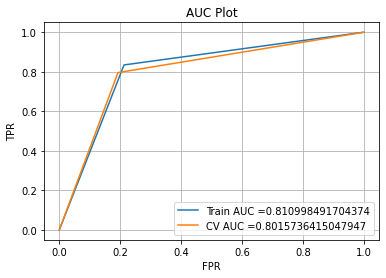

Cross Validation
FNR:0.20408163265306123 ,TPR:0.7959183673469388 ,FPR:0.1927710843373494 ,TNR:0.8072289156626506 


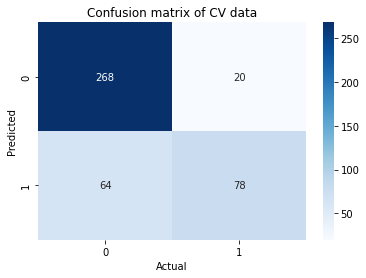

In [128]:
clf = LogisticRegression(C=0.01,solver='liblinear',class_weight={1:1.1,0:0.18})
clf.fit(X_train_inpatient,y_train_inpatient.values.ravel())
y_pred = clf.predict(X_cv_inpatient)
coefs=clf.coef_[0]
top_ten = np.argpartition(coefs, -10)[-10:]
[print(X_train_inpatient.columns[i]) for i in top_ten]
print(classification_report(y_cv_inpatient,y_pred))
y_train_pred = clf.predict(X_train_inpatient)
train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
auc_score = auc(cv_fpr, cv_tpr)
plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("AUC Plot")
plt.grid()
plt.show()
plt.figure()
cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
tn, fp, fn, tp = cv_cm.ravel()
print("Cross Validation")
print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
plt.title('Confusion matrix of CV data')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.show()

              precision    recall  f1-score   support

           0       0.94      0.65      0.77       302
           1       0.43      0.87      0.57        91

    accuracy                           0.70       393
   macro avg       0.69      0.76      0.67       393
weighted avg       0.82      0.70      0.73       393



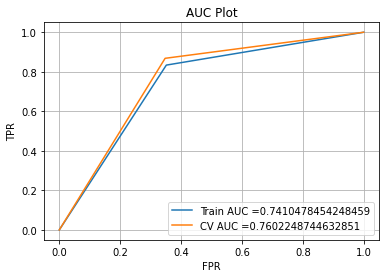

Cross Validation
FNR:0.13186813186813187 ,TPR:0.8681318681318682 ,FPR:0.347682119205298 ,TNR:0.652317880794702 


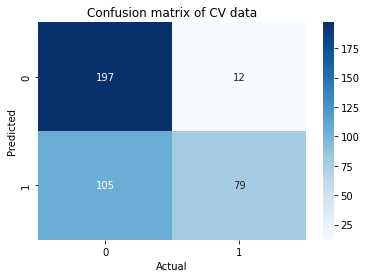

In [930]:
y_pred = clf.predict(X_test_inpatient)
# feature = [column for _,column in sorted(zip(clf.coef_[0],X_train_inpatient.columns.values))]
# temp = plot_top_features(feature[:6],X_cv_inpatient,y_cv_inpatient.values,y_pred.ravel())
print(classification_report(y_test_inpatient,y_pred))
y_train_pred = clf.predict(X_train_inpatient)
train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
cv_fpr, cv_tpr, te_thresholds = roc_curve(y_test_inpatient, y_pred)
auc_score = auc(cv_fpr, cv_tpr)
plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("AUC Plot")
plt.grid()
plt.show()
plt.figure()
cv_cm = confusion_matrix(y_test_inpatient, y_pred)
tn, fp, fn, tp = cv_cm.ravel()
print("Cross Validation")
print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
plt.title('Confusion matrix of CV data')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.show()

In [931]:
with open('inpatient_model.pkl', 'wb') as file:
    pickle.dump(clf, file)

### Outpatient Final Modal

County_28
InscClaimAmtReimbursed_avg
alive_count
County_37
only_fraud_code_count
only_fraud_procedure_code_count
only_fraud_physician_count
only_fraud_op_physician_count
County_3
Doctor
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.72      0.41       174

    accuracy                           0.70      1210
   macro avg       0.61      0.71      0.61      1210
weighted avg       0.84      0.70      0.75      1210

              precision    recall  f1-score   support

           0       0.95      0.74      0.83      4077
           1       0.60      0.91      0.72      1753

    accuracy                           0.79      5830
   macro avg       0.77      0.82      0.78      5830
weighted avg       0.84      0.79      0.80      5830



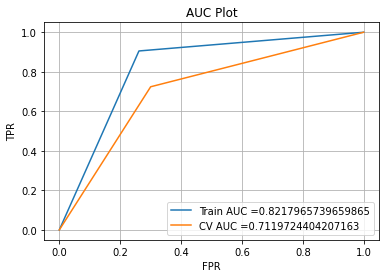

Cross Validation
FNR:0.27586206896551724 ,TPR:0.7241379310344828 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


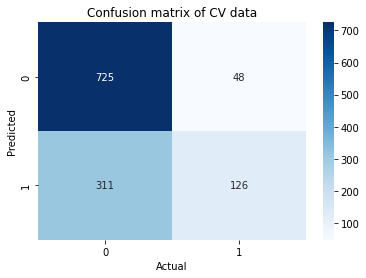

In [129]:
clf = LogisticRegression(C=0.01,solver='liblinear',class_weight={1:0.9,0:0.13})
clf.fit(X_outpatient_70_30_sd,y_outpatient_70_30_sd.values.ravel())
y_pred = clf.predict(X_cv_outpatient_sd)
coefs=clf.coef_[0]
top_ten = np.argpartition(coefs, -10)[-10:]
[print(X_outpatient_70_30_sd.columns[i]) for i in top_ten]
print(classification_report(y_cv_outpatient,y_pred))
y_train_pred = clf.predict(X_outpatient_70_30_sd)
print(classification_report(y_outpatient_70_30_sd,y_train_pred))
train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30_sd, y_train_pred)
cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
auc_score = auc(cv_fpr, cv_tpr)
plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("AUC Plot")
plt.grid()
plt.show()
plt.figure()
cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
tn, fp, fn, tp = cv_cm.ravel()
print("Cross Validation")
print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
plt.title('Confusion matrix of CV data')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.show()

              precision    recall  f1-score   support

           0       0.97      0.70      0.81       918
           1       0.35      0.88      0.50       169

    accuracy                           0.73      1087
   macro avg       0.66      0.79      0.66      1087
weighted avg       0.87      0.73      0.76      1087



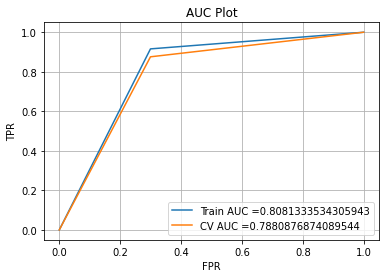

Cross Validation
FNR:0.1242603550295858 ,TPR:0.8757396449704142 ,FPR:0.2995642701525055 ,TNR:0.7004357298474946 


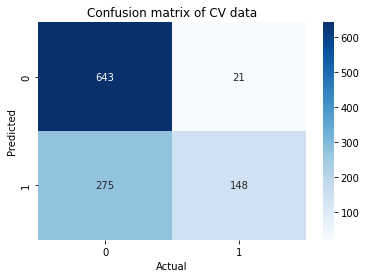

In [935]:
y_pred = clf.predict(X_test_outpatient_sd)
# feature = [column for _,column in sorted(zip(clf.coef_[0],X_train_inpatient.columns.values))]
# temp = plot_top_features(feature[:6],X_cv_inpatient,y_cv_inpatient.values,y_pred.ravel())
print(classification_report(y_test_outpatient,y_pred))
y_train_pred = clf.predict(X_train_outpatient_sd)
train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
cv_fpr, cv_tpr, te_thresholds = roc_curve(y_test_outpatient, y_pred)
auc_score = auc(cv_fpr, cv_tpr)
plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("AUC Plot")
plt.grid()
plt.show()
plt.figure()
cv_cm = confusion_matrix(y_test_outpatient, y_pred)
tn, fp, fn, tp = cv_cm.ravel()
print("Cross Validation")
print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
plt.title('Confusion matrix of CV data')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.show()

In [937]:
with open('outpatient_model.pkl', 'wb') as file:
    pickle.dump(clf, file)

<h2>SGD Classifier</h2>

In [54]:
from sklearn.linear_model import SGDClassifier

Original Distribution

              precision    recall  f1-score   support

           0       0.82      0.78      0.80       332
           1       0.36      0.43      0.39        98

    accuracy                           0.70       430
   macro avg       0.59      0.60      0.60       430
weighted avg       0.72      0.70      0.71       430



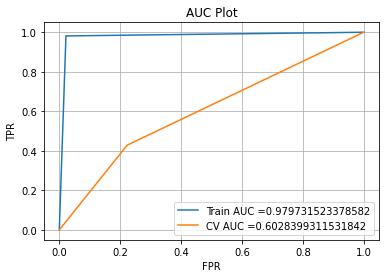

Cross Validation
FNR:0.5714285714285714 ,TPR:0.42857142857142855 ,FPR:0.22289156626506024 ,TNR:0.7771084337349398 


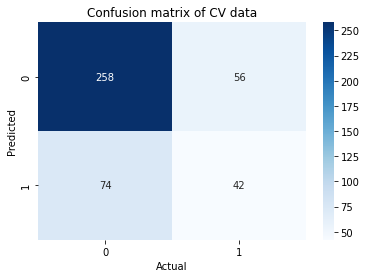

              precision    recall  f1-score   support

           0       0.82      0.73      0.77       332
           1       0.33      0.45      0.38        98

    accuracy                           0.67       430
   macro avg       0.58      0.59      0.58       430
weighted avg       0.71      0.67      0.69       430



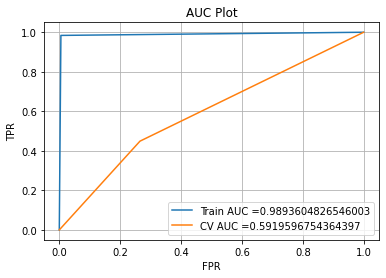

Cross Validation
FNR:0.5510204081632653 ,TPR:0.4489795918367347 ,FPR:0.26506024096385544 ,TNR:0.7349397590361446 


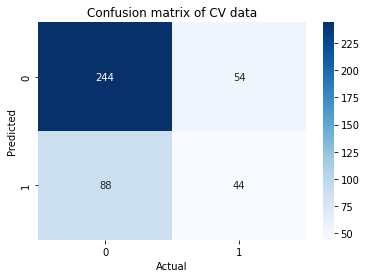

              precision    recall  f1-score   support

           0       0.85      0.83      0.84       332
           1       0.48      0.52      0.50        98

    accuracy                           0.76       430
   macro avg       0.67      0.68      0.67       430
weighted avg       0.77      0.76      0.76       430



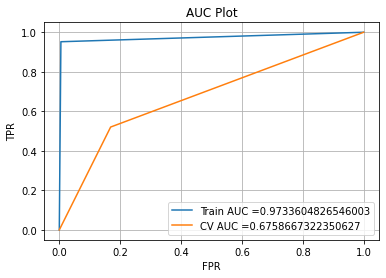

Cross Validation
FNR:0.47959183673469385 ,TPR:0.5204081632653061 ,FPR:0.1686746987951807 ,TNR:0.8313253012048193 


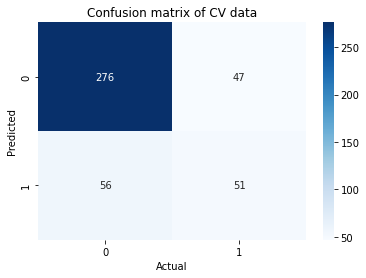

              precision    recall  f1-score   support

           0       0.83      0.60      0.70       332
           1       0.30      0.58      0.40        98

    accuracy                           0.60       430
   macro avg       0.57      0.59      0.55       430
weighted avg       0.71      0.60      0.63       430



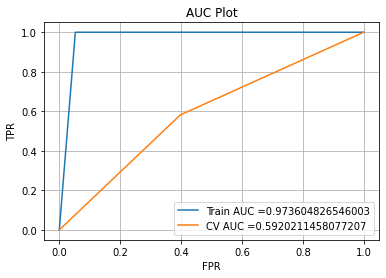

Cross Validation
FNR:0.41836734693877553 ,TPR:0.5816326530612245 ,FPR:0.39759036144578314 ,TNR:0.6024096385542169 


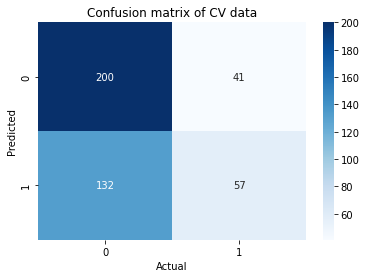

              precision    recall  f1-score   support

           0       0.83      0.75      0.79       332
           1       0.36      0.47      0.41        98

    accuracy                           0.69       430
   macro avg       0.59      0.61      0.60       430
weighted avg       0.72      0.69      0.70       430



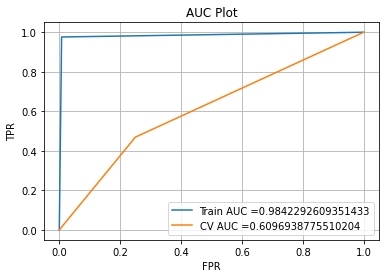

Cross Validation
FNR:0.5306122448979592 ,TPR:0.46938775510204084 ,FPR:0.25 ,TNR:0.75 


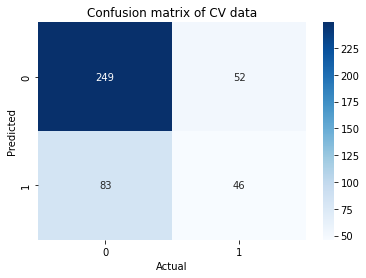

              precision    recall  f1-score   support

           0       0.81      0.78      0.79       332
           1       0.33      0.38      0.35        98

    accuracy                           0.69       430
   macro avg       0.57      0.58      0.57       430
weighted avg       0.70      0.69      0.69       430



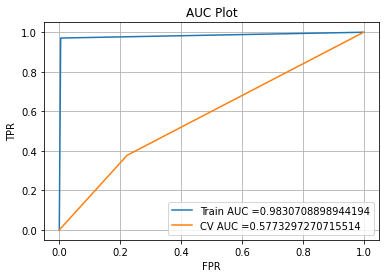

Cross Validation
FNR:0.6224489795918368 ,TPR:0.37755102040816324 ,FPR:0.22289156626506024 ,TNR:0.7771084337349398 


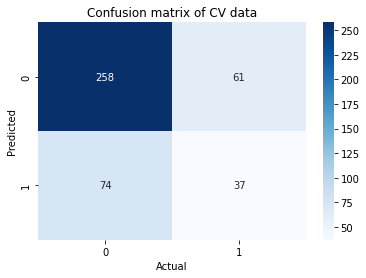

In [55]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.76,0:0.23})
    clf.fit(X_train_inpatient_sd,y_train_inpatient.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_train_inpatient_sd)
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Tol 0.0001
              precision    recall  f1-score   support

           0       0.84      0.85      0.84       332
           1       0.46      0.45      0.46        98

    accuracy                           0.76       430
   macro avg       0.65      0.65      0.65       430
weighted avg       0.75      0.76      0.75       430

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1326
           1       1.00      0.98      0.99      1326

    accuracy                           0.99      2652
   macro avg       0.99      0.99      0.99      2652
weighted avg       0.99      0.99      0.99      2652



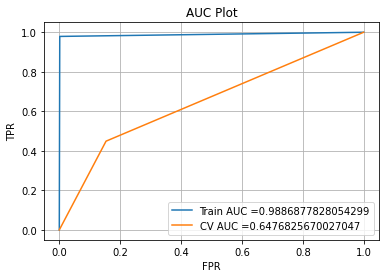

Cross validation
FNR:0.5510204081632653 ,TPR:0.4489795918367347 ,FPR:0.1536144578313253 ,TNR:0.8463855421686747 


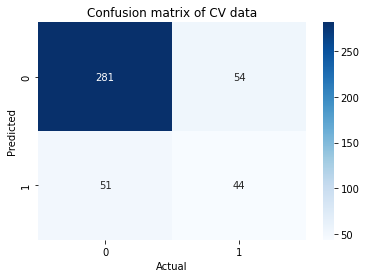

----------------------------------------------------------------------------------------
Tol 0.001
              precision    recall  f1-score   support

           0       0.80      0.76      0.78       332
           1       0.30      0.36      0.33        98

    accuracy                           0.67       430
   macro avg       0.55      0.56      0.55       430
weighted avg       0.69      0.67      0.67       430

              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1326
           1       0.98      0.99      0.98      1326

    accuracy                           0.98      2652
   macro avg       0.98      0.98      0.98      2652
weighted avg       0.98      0.98      0.98      2652



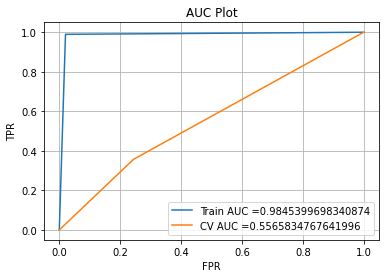

Cross validation
FNR:0.6428571428571429 ,TPR:0.35714285714285715 ,FPR:0.24397590361445784 ,TNR:0.7560240963855421 


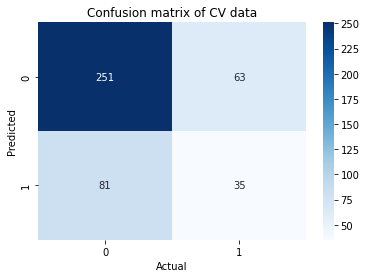

----------------------------------------------------------------------------------------
Tol 0.01
              precision    recall  f1-score   support

           0       0.83      0.76      0.79       332
           1       0.36      0.46      0.41        98

    accuracy                           0.69       430
   macro avg       0.59      0.61      0.60       430
weighted avg       0.72      0.69      0.70       430

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      1326
           1       0.99      0.99      0.99      1326

    accuracy                           0.99      2652
   macro avg       0.99      0.99      0.99      2652
weighted avg       0.99      0.99      0.99      2652



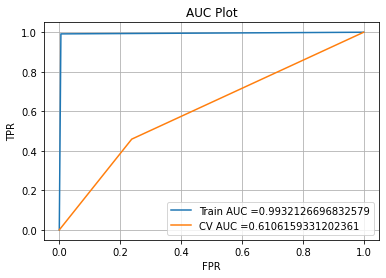

Cross validation
FNR:0.5408163265306123 ,TPR:0.45918367346938777 ,FPR:0.23795180722891565 ,TNR:0.7620481927710844 


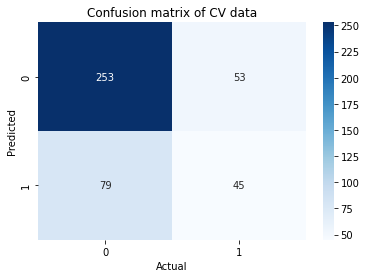

----------------------------------------------------------------------------------------
Tol 0.1
              precision    recall  f1-score   support

           0       0.81      0.81      0.81       332
           1       0.37      0.38      0.37        98

    accuracy                           0.71       430
   macro avg       0.59      0.59      0.59       430
weighted avg       0.71      0.71      0.71       430

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1326
           1       1.00      0.98      0.99      1326

    accuracy                           0.99      2652
   macro avg       0.99      0.99      0.99      2652
weighted avg       0.99      0.99      0.99      2652



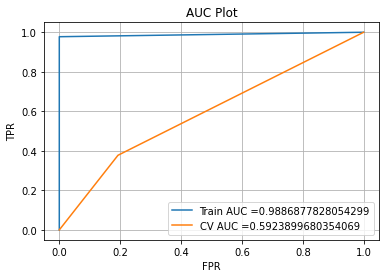

Cross validation
FNR:0.6224489795918368 ,TPR:0.37755102040816324 ,FPR:0.1927710843373494 ,TNR:0.8072289156626506 


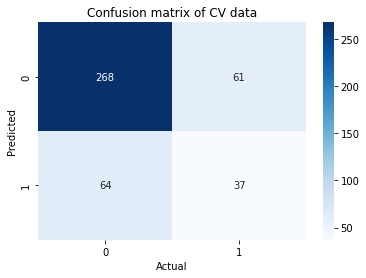

----------------------------------------------------------------------------------------
Tol 1
              precision    recall  f1-score   support

           0       0.83      0.76      0.79       332
           1       0.36      0.46      0.40        98

    accuracy                           0.69       430
   macro avg       0.59      0.61      0.60       430
weighted avg       0.72      0.69      0.70       430

              precision    recall  f1-score   support

           0       0.98      0.99      0.99      1326
           1       0.99      0.98      0.99      1326

    accuracy                           0.99      2652
   macro avg       0.99      0.99      0.99      2652
weighted avg       0.99      0.99      0.99      2652



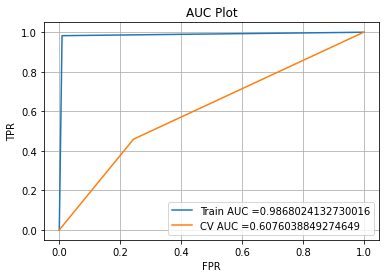

Cross validation
FNR:0.5408163265306123 ,TPR:0.45918367346938777 ,FPR:0.24397590361445784 ,TNR:0.7560240963855421 


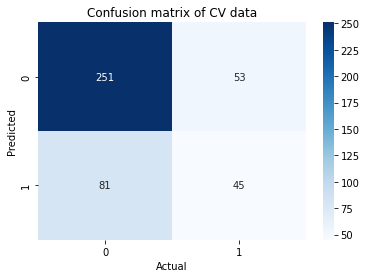

----------------------------------------------------------------------------------------
Tol 10
              precision    recall  f1-score   support

           0       0.86      0.78      0.82       332
           1       0.44      0.58      0.50        98

    accuracy                           0.74       430
   macro avg       0.65      0.68      0.66       430
weighted avg       0.77      0.74      0.75       430

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      1326
           1       0.99      0.99      0.99      1326

    accuracy                           0.99      2652
   macro avg       0.99      0.99      0.99      2652
weighted avg       0.99      0.99      0.99      2652



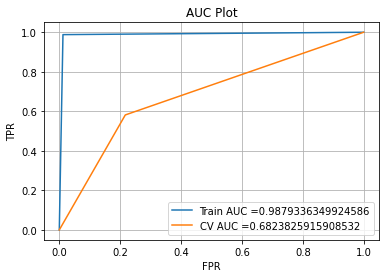

Cross validation
FNR:0.41836734693877553 ,TPR:0.5816326530612245 ,FPR:0.21686746987951808 ,TNR:0.7831325301204819 


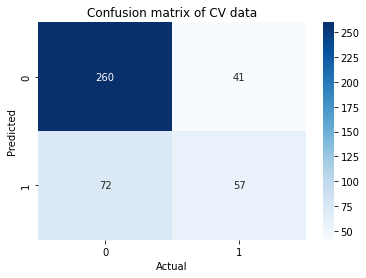

In [56]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.76,0:0.23})
    clf.fit(X_inpatient_50_50_sd,y_inpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol",c)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_50_50_sd)
    print(classification_report(y_inpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Tol 0.0001
              precision    recall  f1-score   support

           0       0.83      0.75      0.79       332
           1       0.36      0.48      0.41        98

    accuracy                           0.69       430
   macro avg       0.59      0.61      0.60       430
weighted avg       0.72      0.69      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      0.99      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



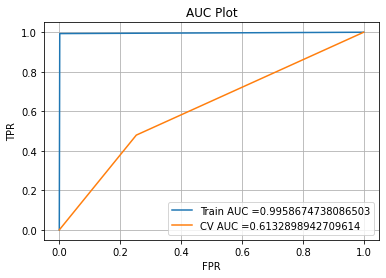

Cross Validation
FNR:0.5204081632653061 ,TPR:0.47959183673469385 ,FPR:0.25301204819277107 ,TNR:0.7469879518072289 


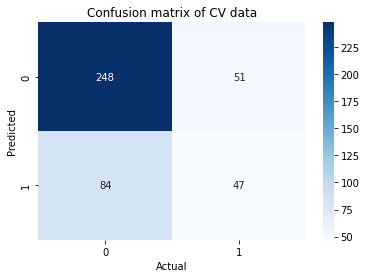

----------------------------------------------------------------------------------------
Tol 0.001
              precision    recall  f1-score   support

           0       0.84      0.77      0.80       332
           1       0.39      0.50      0.44        98

    accuracy                           0.71       430
   macro avg       0.61      0.63      0.62       430
weighted avg       0.74      0.71      0.72       430

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1326
           1       1.00      0.97      0.99       888

    accuracy                           0.99      2214
   macro avg       0.99      0.99      0.99      2214
weighted avg       0.99      0.99      0.99      2214



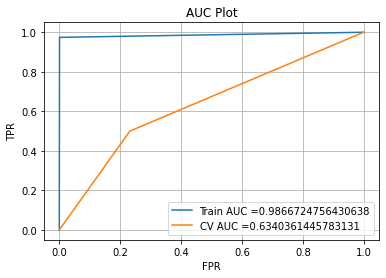

Cross Validation
FNR:0.5 ,TPR:0.5 ,FPR:0.2319277108433735 ,TNR:0.7680722891566265 


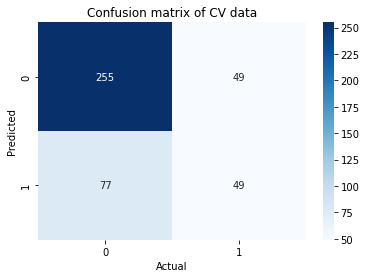

----------------------------------------------------------------------------------------
Tol 0.01
              precision    recall  f1-score   support

           0       0.81      0.80      0.80       332
           1       0.35      0.37      0.36        98

    accuracy                           0.70       430
   macro avg       0.58      0.58      0.58       430
weighted avg       0.71      0.70      0.70       430

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      1326
           1       0.99      0.98      0.99       888

    accuracy                           0.99      2214
   macro avg       0.99      0.99      0.99      2214
weighted avg       0.99      0.99      0.99      2214



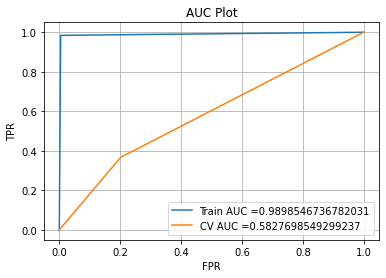

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.20180722891566266 ,TNR:0.7981927710843374 


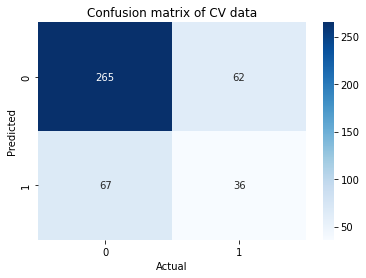

----------------------------------------------------------------------------------------
Tol 0.1
              precision    recall  f1-score   support

           0       0.83      0.78      0.81       332
           1       0.39      0.47      0.43        98

    accuracy                           0.71       430
   macro avg       0.61      0.63      0.62       430
weighted avg       0.73      0.71      0.72       430

              precision    recall  f1-score   support

           0       0.99      1.00      1.00      1326
           1       1.00      0.99      0.99       888

    accuracy                           0.99      2214
   macro avg       1.00      0.99      0.99      2214
weighted avg       0.99      0.99      0.99      2214



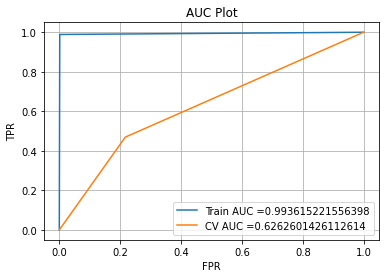

Cross Validation
FNR:0.5306122448979592 ,TPR:0.46938775510204084 ,FPR:0.21686746987951808 ,TNR:0.7831325301204819 


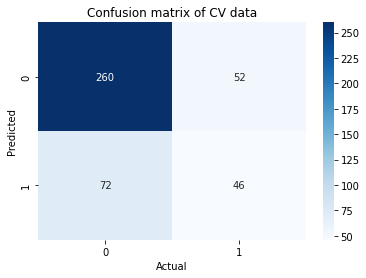

----------------------------------------------------------------------------------------
Tol 1
              precision    recall  f1-score   support

           0       0.79      0.73      0.75       332
           1       0.26      0.33      0.29        98

    accuracy                           0.63       430
   macro avg       0.52      0.53      0.52       430
weighted avg       0.67      0.63      0.65       430

              precision    recall  f1-score   support

           0       0.99      0.97      0.98      1326
           1       0.96      0.99      0.97       888

    accuracy                           0.98      2214
   macro avg       0.98      0.98      0.98      2214
weighted avg       0.98      0.98      0.98      2214



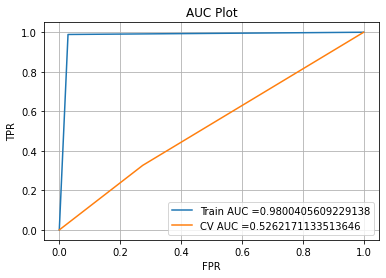

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.2740963855421687 ,TNR:0.7259036144578314 


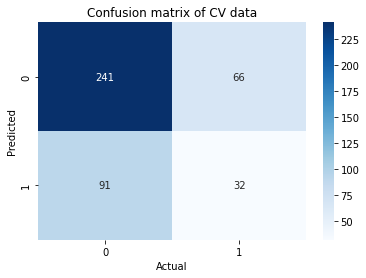

----------------------------------------------------------------------------------------
Tol 10
              precision    recall  f1-score   support

           0       0.86      0.70      0.77       332
           1       0.37      0.60      0.46        98

    accuracy                           0.68       430
   macro avg       0.61      0.65      0.61       430
weighted avg       0.75      0.68      0.70       430

              precision    recall  f1-score   support

           0       0.99      0.93      0.96      1326
           1       0.91      0.99      0.95       888

    accuracy                           0.96      2214
   macro avg       0.95      0.96      0.95      2214
weighted avg       0.96      0.96      0.96      2214



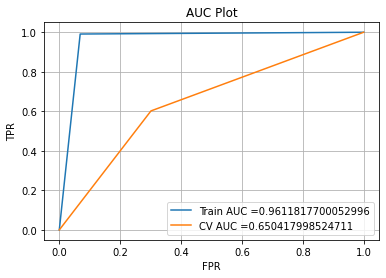

Cross Validation
FNR:0.3979591836734694 ,TPR:0.6020408163265306 ,FPR:0.30120481927710846 ,TNR:0.6987951807228916 


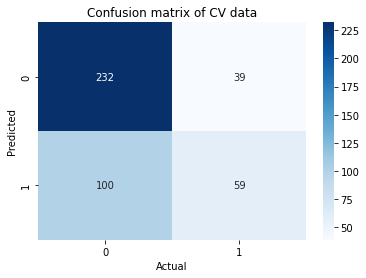

In [57]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.76,0:0.23})
    clf.fit(X_inpatient_60_40_sd,y_inpatient_60_40_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol",c)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_60_40_sd)
    print(classification_report(y_inpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Tol 0.0001
              precision    recall  f1-score   support

           0       0.83      0.73      0.77       332
           1       0.35      0.49      0.41        98

    accuracy                           0.67       430
   macro avg       0.59      0.61      0.59       430
weighted avg       0.72      0.67      0.69       430

              precision    recall  f1-score   support

           0       0.99      1.00      1.00      1326
           1       0.99      0.99      0.99       570

    accuracy                           0.99      1896
   macro avg       0.99      0.99      0.99      1896
weighted avg       0.99      0.99      0.99      1896



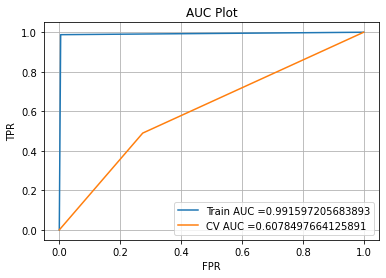

Cross Validation
FNR:0.5102040816326531 ,TPR:0.4897959183673469 ,FPR:0.2740963855421687 ,TNR:0.7259036144578314 


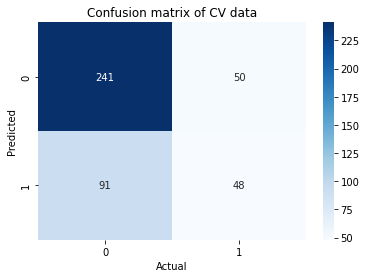

----------------------------------------------------------------------------------------
Tol 0.001
              precision    recall  f1-score   support

           0       0.84      0.73      0.78       332
           1       0.36      0.52      0.43        98

    accuracy                           0.68       430
   macro avg       0.60      0.62      0.60       430
weighted avg       0.73      0.68      0.70       430

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      1326
           1       0.98      0.98      0.98       570

    accuracy                           0.99      1896
   macro avg       0.99      0.99      0.99      1896
weighted avg       0.99      0.99      0.99      1896



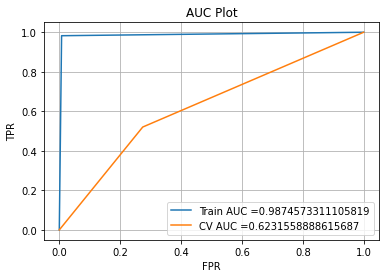

Cross Validation
FNR:0.47959183673469385 ,TPR:0.5204081632653061 ,FPR:0.2740963855421687 ,TNR:0.7259036144578314 


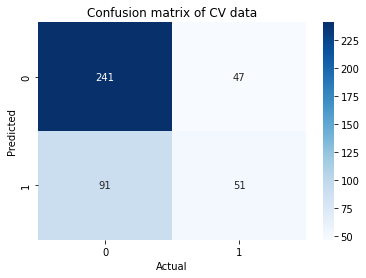

----------------------------------------------------------------------------------------
Tol 0.01
              precision    recall  f1-score   support

           0       0.83      0.78      0.80       332
           1       0.38      0.45      0.41        98

    accuracy                           0.70       430
   macro avg       0.60      0.61      0.61       430
weighted avg       0.72      0.70      0.71       430

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      1326
           1       0.99      0.98      0.99       570

    accuracy                           0.99      1896
   macro avg       0.99      0.99      0.99      1896
weighted avg       0.99      0.99      0.99      1896



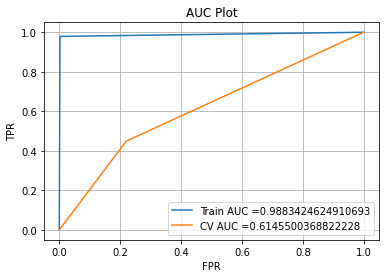

Cross Validation
FNR:0.5510204081632653 ,TPR:0.4489795918367347 ,FPR:0.21987951807228914 ,TNR:0.7801204819277109 


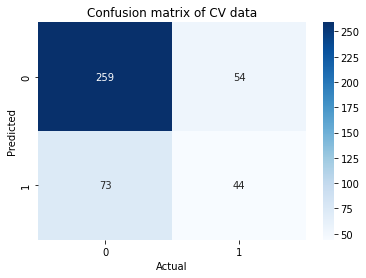

----------------------------------------------------------------------------------------
Tol 0.1
              precision    recall  f1-score   support

           0       0.85      0.77      0.81       332
           1       0.41      0.53      0.46        98

    accuracy                           0.72       430
   macro avg       0.63      0.65      0.64       430
weighted avg       0.75      0.72      0.73       430

              precision    recall  f1-score   support

           0       0.99      1.00      1.00      1326
           1       1.00      0.98      0.99       570

    accuracy                           0.99      1896
   macro avg       0.99      0.99      0.99      1896
weighted avg       0.99      0.99      0.99      1896



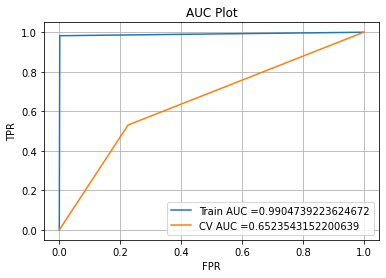

Cross Validation
FNR:0.46938775510204084 ,TPR:0.5306122448979592 ,FPR:0.22590361445783133 ,TNR:0.7740963855421686 


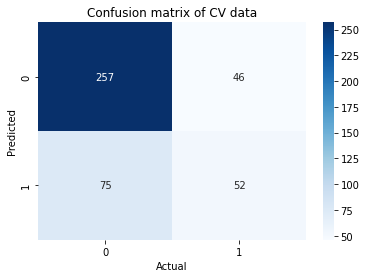

----------------------------------------------------------------------------------------
Tol 1
              precision    recall  f1-score   support

           0       0.85      0.79      0.82       332
           1       0.43      0.54      0.48        98

    accuracy                           0.73       430
   macro avg       0.64      0.66      0.65       430
weighted avg       0.76      0.73      0.74       430

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1326
           1       0.99      0.96      0.98       570

    accuracy                           0.99      1896
   macro avg       0.99      0.98      0.98      1896
weighted avg       0.99      0.99      0.99      1896



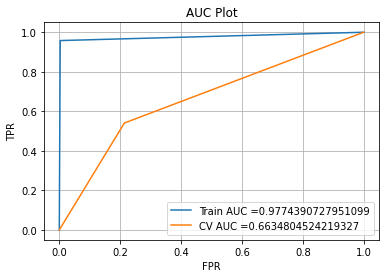

Cross Validation
FNR:0.45918367346938777 ,TPR:0.5408163265306123 ,FPR:0.21385542168674698 ,TNR:0.786144578313253 


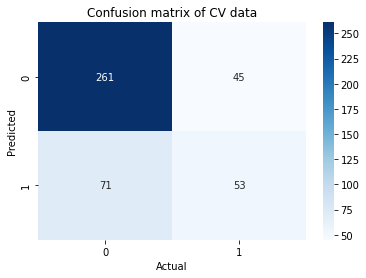

----------------------------------------------------------------------------------------
Tol 10
              precision    recall  f1-score   support

           0       0.83      0.73      0.78       332
           1       0.35      0.49      0.41        98

    accuracy                           0.68       430
   macro avg       0.59      0.61      0.59       430
weighted avg       0.72      0.68      0.69       430

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      1326
           1       0.98      0.98      0.98       570

    accuracy                           0.99      1896
   macro avg       0.98      0.99      0.98      1896
weighted avg       0.99      0.99      0.99      1896



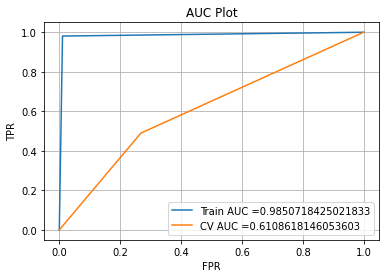

Cross Validation
FNR:0.5102040816326531 ,TPR:0.4897959183673469 ,FPR:0.2680722891566265 ,TNR:0.7319277108433735 


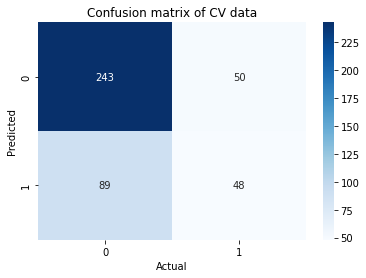

In [58]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.76,0:0.23})
    clf.fit(X_inpatient_70_30_sd,y_inpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol",c)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_70_30_sd)
    print(classification_report(y_inpatient_70_30_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

<h2>SGD Classifier Outpatient</h2>

Original Distribution

----------------------------------------------------------------------------------------
Tol:  0.0001
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.19      0.09      0.12       174

    accuracy                           0.82      1210
   macro avg       0.53      0.51      0.51      1210
weighted avg       0.76      0.82      0.79      1210



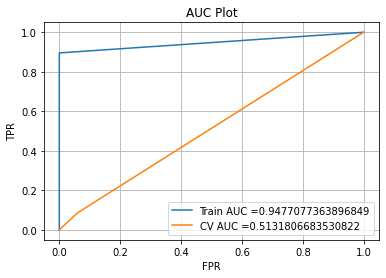

Cross Validation
FNR:0.9137931034482759 ,TPR:0.08620689655172414 ,FPR:0.059845559845559844 ,TNR:0.9401544401544402 


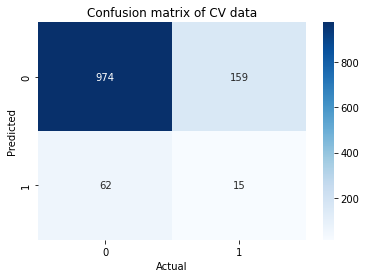

----------------------------------------------------------------------------------------
Tol:  0.001
              precision    recall  f1-score   support

           0       0.85      0.94      0.89      1036
           1       0.11      0.05      0.07       174

    accuracy                           0.81      1210
   macro avg       0.48      0.49      0.48      1210
weighted avg       0.75      0.81      0.77      1210



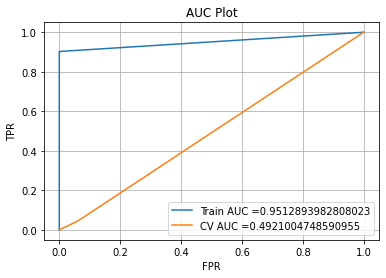

Cross Validation
FNR:0.9540229885057471 ,TPR:0.04597701149425287 ,FPR:0.06177606177606178 ,TNR:0.9382239382239382 


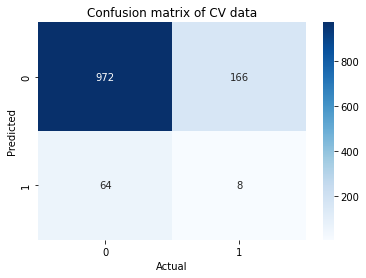

----------------------------------------------------------------------------------------
Tol:  0.01
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.12      0.05      0.07       174

    accuracy                           0.82      1210
   macro avg       0.49      0.50      0.48      1210
weighted avg       0.75      0.82      0.78      1210



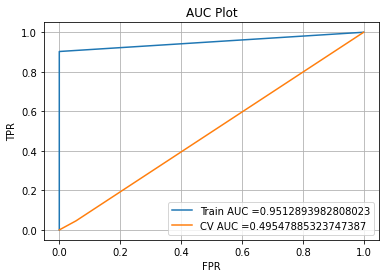

Cross Validation
FNR:0.9540229885057471 ,TPR:0.04597701149425287 ,FPR:0.05501930501930502 ,TNR:0.944980694980695 


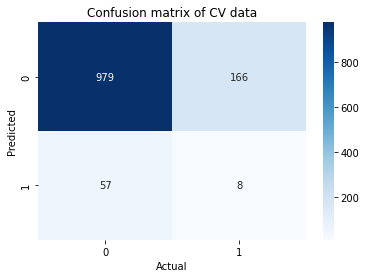

----------------------------------------------------------------------------------------
Tol:  0.1
              precision    recall  f1-score   support

           0       0.87      0.92      0.89      1036
           1       0.25      0.17      0.21       174

    accuracy                           0.81      1210
   macro avg       0.56      0.54      0.55      1210
weighted avg       0.78      0.81      0.79      1210



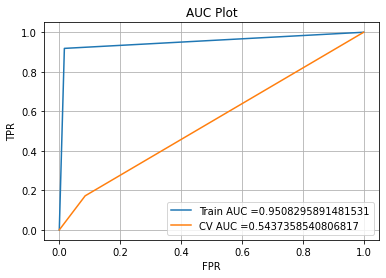

Cross Validation
FNR:0.8275862068965517 ,TPR:0.1724137931034483 ,FPR:0.08494208494208494 ,TNR:0.915057915057915 


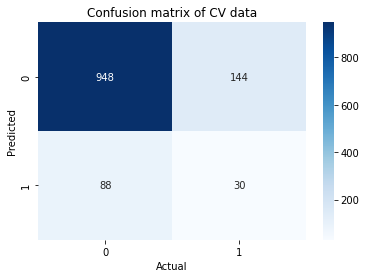

----------------------------------------------------------------------------------------
Tol:  1
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.17      0.07      0.10       174

    accuracy                           0.81      1210
   macro avg       0.51      0.51      0.50      1210
weighted avg       0.76      0.81      0.78      1210



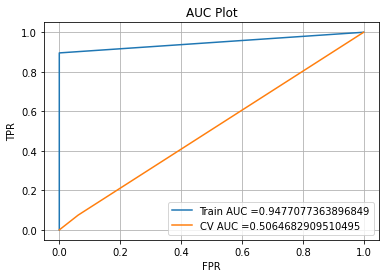

Cross Validation
FNR:0.9252873563218391 ,TPR:0.07471264367816093 ,FPR:0.06177606177606178 ,TNR:0.9382239382239382 


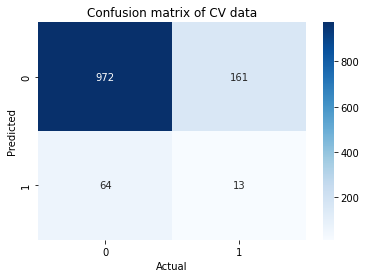

----------------------------------------------------------------------------------------
Tol:  10
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.14      0.05      0.07       174

    accuracy                           0.82      1210
   macro avg       0.50      0.50      0.49      1210
weighted avg       0.75      0.82      0.78      1210



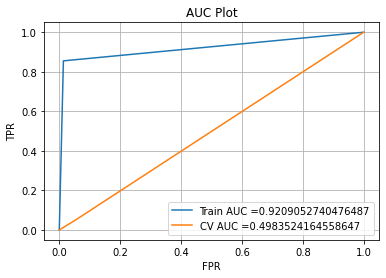

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.05501930501930502 ,TNR:0.944980694980695 


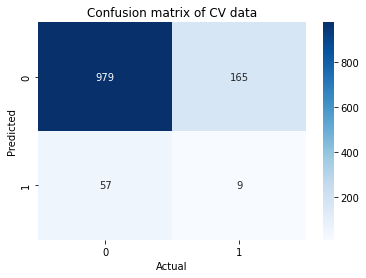

In [59]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.83,0:0.16})
    clf.fit(X_train_outpatient_sd,y_train_outpatient.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol: ", c)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_train_outpatient_sd)
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Tol 0.0001
              precision    recall  f1-score   support

           0       0.86      0.96      0.90      1036
           1       0.13      0.03      0.05       174

    accuracy                           0.83      1210
   macro avg       0.49      0.50      0.48      1210
weighted avg       0.75      0.83      0.78      1210

              precision    recall  f1-score   support

           0       0.94      1.00      0.97      4077
           1       1.00      0.94      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



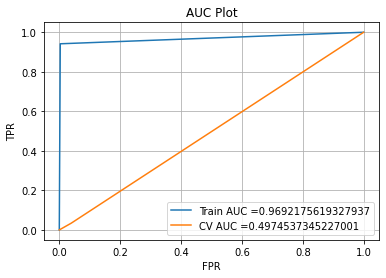

Cross validation
FNR:0.9655172413793104 ,TPR:0.034482758620689655 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


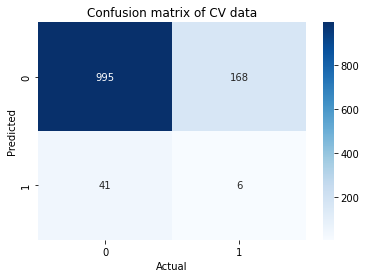

----------------------------------------------------------------------------------------
Tol 0.001
              precision    recall  f1-score   support

           0       0.86      0.96      0.90      1036
           1       0.14      0.04      0.06       174

    accuracy                           0.83      1210
   macro avg       0.50      0.50      0.48      1210
weighted avg       0.75      0.83      0.78      1210

              precision    recall  f1-score   support

           0       0.95      1.00      0.97      4077
           1       1.00      0.95      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



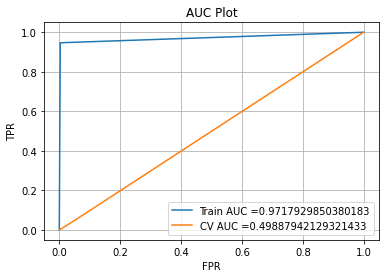

Cross validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


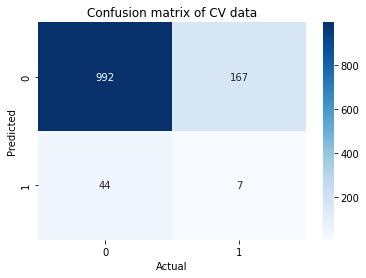

----------------------------------------------------------------------------------------
Tol 0.01
              precision    recall  f1-score   support

           0       0.85      0.95      0.90      1036
           1       0.11      0.04      0.06       174

    accuracy                           0.82      1210
   macro avg       0.48      0.49      0.48      1210
weighted avg       0.75      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.95      0.99      0.97      4077
           1       0.99      0.94      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



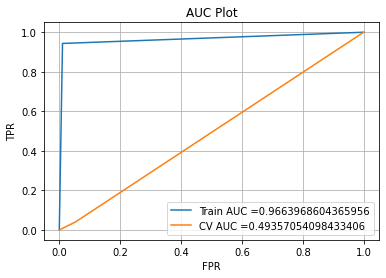

Cross validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.05308880308880309 ,TNR:0.946911196911197 


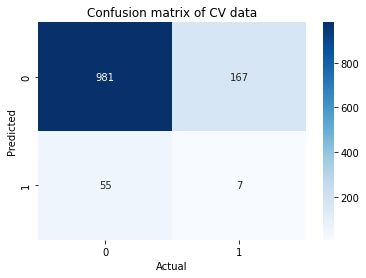

----------------------------------------------------------------------------------------
Tol 0.1
              precision    recall  f1-score   support

           0       0.86      0.95      0.90      1036
           1       0.15      0.06      0.08       174

    accuracy                           0.82      1210
   macro avg       0.50      0.50      0.49      1210
weighted avg       0.76      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.96      0.99      0.98      4077
           1       0.99      0.96      0.98      4077

    accuracy                           0.98      8154
   macro avg       0.98      0.98      0.98      8154
weighted avg       0.98      0.98      0.98      8154



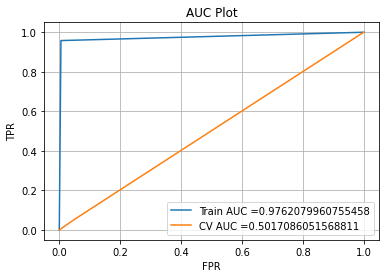

Cross validation
FNR:0.9425287356321839 ,TPR:0.05747126436781609 ,FPR:0.05405405405405406 ,TNR:0.9459459459459459 


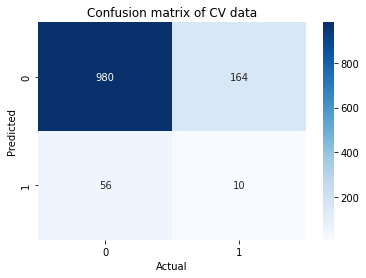

----------------------------------------------------------------------------------------
Tol 1
              precision    recall  f1-score   support

           0       0.82      0.63      0.72      1036
           1       0.08      0.20      0.12       174

    accuracy                           0.57      1210
   macro avg       0.45      0.41      0.42      1210
weighted avg       0.72      0.57      0.63      1210

              precision    recall  f1-score   support

           0       1.00      0.71      0.83      4077
           1       0.77      1.00      0.87      4077

    accuracy                           0.85      8154
   macro avg       0.88      0.85      0.85      8154
weighted avg       0.88      0.85      0.85      8154



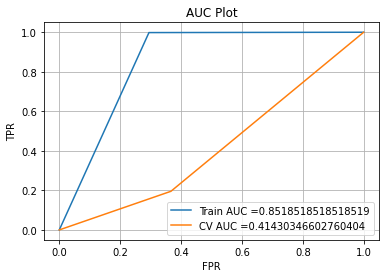

Cross validation
FNR:0.8045977011494253 ,TPR:0.19540229885057472 ,FPR:0.3667953667953668 ,TNR:0.6332046332046332 


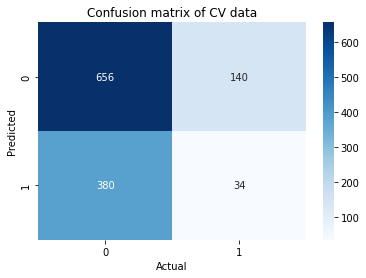

----------------------------------------------------------------------------------------
Tol 10
              precision    recall  f1-score   support

           0       0.84      0.72      0.77      1036
           1       0.09      0.16      0.11       174

    accuracy                           0.64      1210
   macro avg       0.46      0.44      0.44      1210
weighted avg       0.73      0.64      0.68      1210

              precision    recall  f1-score   support

           0       1.00      0.79      0.88      4077
           1       0.83      1.00      0.91      4077

    accuracy                           0.90      8154
   macro avg       0.91      0.90      0.89      8154
weighted avg       0.91      0.90      0.89      8154



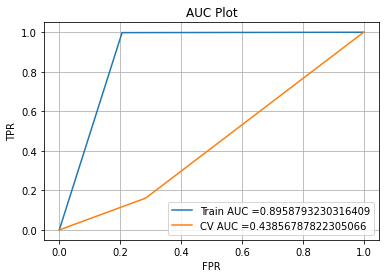

Cross validation
FNR:0.8390804597701149 ,TPR:0.16091954022988506 ,FPR:0.28378378378378377 ,TNR:0.7162162162162162 


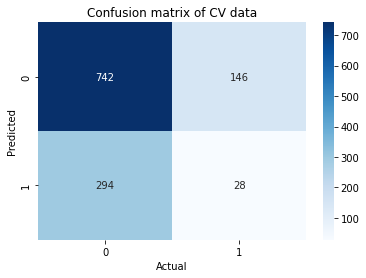

In [60]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.83,0:0.16})
    clf.fit(X_outpatient_50_50_sd,y_outpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol",c)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_50_50_sd)
    print(classification_report(y_outpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Tol 0.0001
              precision    recall  f1-score   support

           0       0.84      0.87      0.86      1036
           1       0.06      0.05      0.06       174

    accuracy                           0.75      1210
   macro avg       0.45      0.46      0.46      1210
weighted avg       0.73      0.75      0.74      1210

              precision    recall  f1-score   support

           0       0.98      0.93      0.95      4077
           1       0.90      0.98      0.94      2731

    accuracy                           0.95      6808
   macro avg       0.94      0.95      0.95      6808
weighted avg       0.95      0.95      0.95      6808



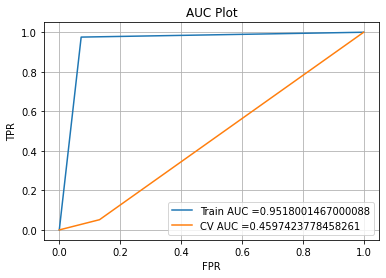

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.13223938223938225 ,TNR:0.8677606177606177 


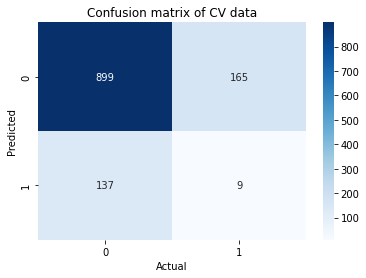

----------------------------------------------------------------------------------------
Tol 0.001
              precision    recall  f1-score   support

           0       0.86      0.95      0.90      1036
           1       0.16      0.05      0.08       174

    accuracy                           0.82      1210
   macro avg       0.51      0.50      0.49      1210
weighted avg       0.76      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      4077
           1       1.00      0.93      0.97      2731

    accuracy                           0.97      6808
   macro avg       0.98      0.97      0.97      6808
weighted avg       0.97      0.97      0.97      6808



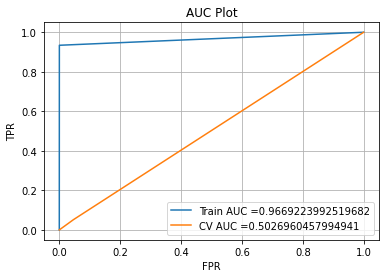

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.04633204633204633 ,TNR:0.9536679536679536 


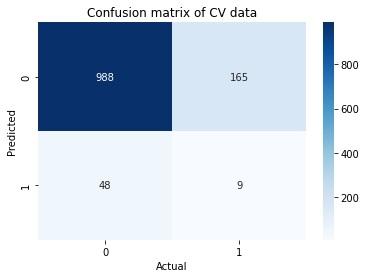

----------------------------------------------------------------------------------------
Tol 0.01
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.17      0.07      0.10       174

    accuracy                           0.82      1210
   macro avg       0.51      0.51      0.50      1210
weighted avg       0.76      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      4077
           1       1.00      0.96      0.98      2731

    accuracy                           0.98      6808
   macro avg       0.99      0.98      0.98      6808
weighted avg       0.98      0.98      0.98      6808



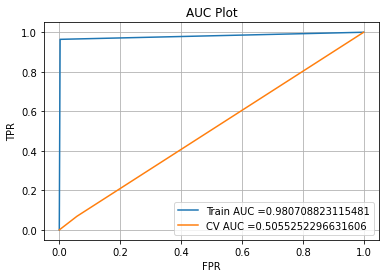

Cross Validation
FNR:0.9310344827586207 ,TPR:0.06896551724137931 ,FPR:0.05791505791505792 ,TNR:0.9420849420849421 


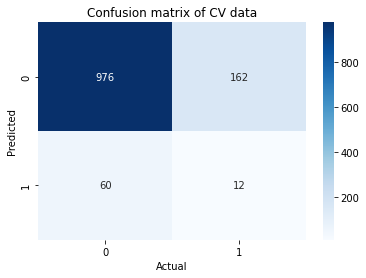

----------------------------------------------------------------------------------------
Tol 0.1
              precision    recall  f1-score   support

           0       0.86      0.96      0.91      1036
           1       0.15      0.04      0.06       174

    accuracy                           0.83      1210
   macro avg       0.50      0.50      0.48      1210
weighted avg       0.75      0.83      0.78      1210

              precision    recall  f1-score   support

           0       0.94      1.00      0.97      4077
           1       1.00      0.91      0.95      2731

    accuracy                           0.96      6808
   macro avg       0.97      0.95      0.96      6808
weighted avg       0.97      0.96      0.96      6808



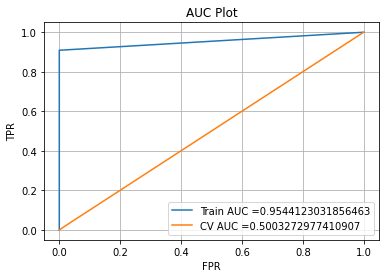

Cross Validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


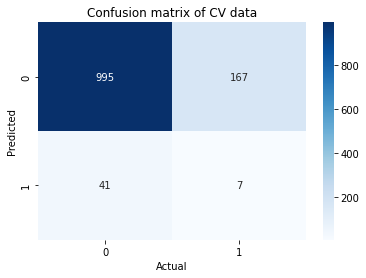

----------------------------------------------------------------------------------------
Tol 1
              precision    recall  f1-score   support

           0       0.80      0.55      0.65      1036
           1       0.06      0.18      0.10       174

    accuracy                           0.50      1210
   macro avg       0.43      0.37      0.38      1210
weighted avg       0.70      0.50      0.57      1210

              precision    recall  f1-score   support

           0       1.00      0.62      0.76      4077
           1       0.64      1.00      0.78      2731

    accuracy                           0.77      6808
   macro avg       0.82      0.81      0.77      6808
weighted avg       0.85      0.77      0.77      6808



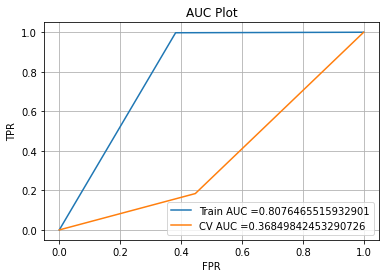

Cross Validation
FNR:0.8160919540229885 ,TPR:0.1839080459770115 ,FPR:0.4469111969111969 ,TNR:0.553088803088803 


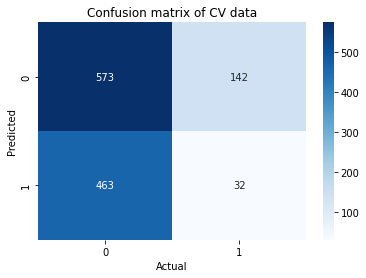

----------------------------------------------------------------------------------------
Tol 10
              precision    recall  f1-score   support

           0       0.86      0.96      0.90      1036
           1       0.13      0.04      0.06       174

    accuracy                           0.82      1210
   macro avg       0.49      0.50      0.48      1210
weighted avg       0.75      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.94      1.00      0.97      4077
           1       0.99      0.91      0.95      2731

    accuracy                           0.96      6808
   macro avg       0.97      0.95      0.96      6808
weighted avg       0.96      0.96      0.96      6808



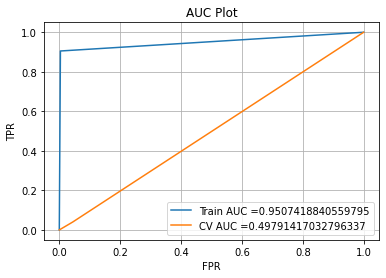

Cross Validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.0444015444015444 ,TNR:0.9555984555984556 


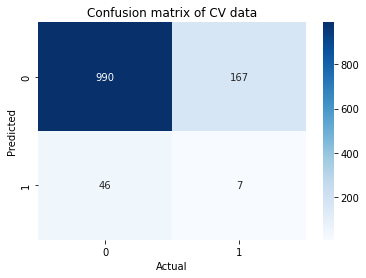

In [61]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.83,0:0.16})
    clf.fit(X_outpatient_60_40_sd,y_outpatient_60_40_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol",c)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_60_40_sd)
    print(classification_report(y_outpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Tol: 0.0001
              precision    recall  f1-score   support

           0       0.86      0.96      0.90      1036
           1       0.14      0.04      0.06       174

    accuracy                           0.83      1210
   macro avg       0.50      0.50      0.48      1210
weighted avg       0.75      0.83      0.78      1210

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      4077
           1       1.00      0.91      0.95      1753

    accuracy                           0.97      5830
   macro avg       0.98      0.95      0.97      5830
weighted avg       0.97      0.97      0.97      5830



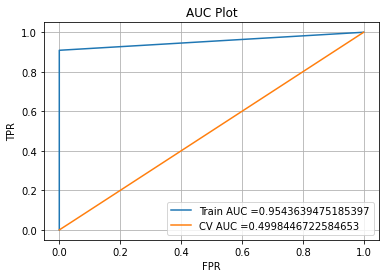

Cross Validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.04054054054054054 ,TNR:0.9594594594594594 


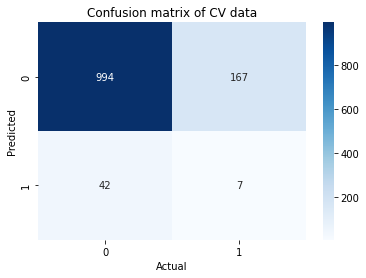

----------------------------------------------------------------------------------------
Tol: 0.001
              precision    recall  f1-score   support

           0       0.86      0.96      0.90      1036
           1       0.14      0.04      0.06       174

    accuracy                           0.83      1210
   macro avg       0.50      0.50      0.48      1210
weighted avg       0.75      0.83      0.78      1210

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      4077
           1       1.00      0.91      0.96      1753

    accuracy                           0.97      5830
   macro avg       0.98      0.96      0.97      5830
weighted avg       0.98      0.97      0.97      5830



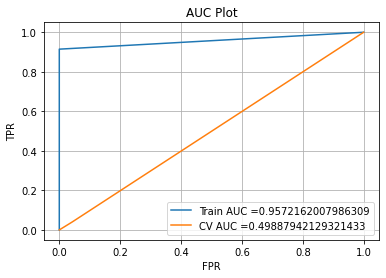

Cross Validation
FNR:0.9597701149425287 ,TPR:0.040229885057471264 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


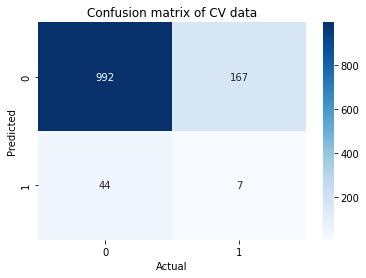

----------------------------------------------------------------------------------------
Tol: 0.01
              precision    recall  f1-score   support

           0       0.86      0.95      0.90      1036
           1       0.16      0.05      0.08       174

    accuracy                           0.82      1210
   macro avg       0.51      0.50      0.49      1210
weighted avg       0.76      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.97      1.00      0.98      4077
           1       1.00      0.93      0.96      1753

    accuracy                           0.98      5830
   macro avg       0.98      0.96      0.97      5830
weighted avg       0.98      0.98      0.98      5830



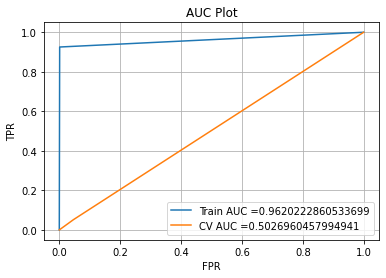

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.04633204633204633 ,TNR:0.9536679536679536 


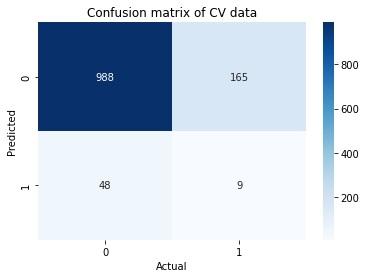

----------------------------------------------------------------------------------------
Tol: 0.1
              precision    recall  f1-score   support

           0       0.86      0.95      0.90      1036
           1       0.13      0.05      0.07       174

    accuracy                           0.82      1210
   macro avg       0.49      0.50      0.48      1210
weighted avg       0.75      0.82      0.78      1210

              precision    recall  f1-score   support

           0       0.97      1.00      0.98      4077
           1       1.00      0.93      0.96      1753

    accuracy                           0.98      5830
   macro avg       0.98      0.96      0.97      5830
weighted avg       0.98      0.98      0.98      5830



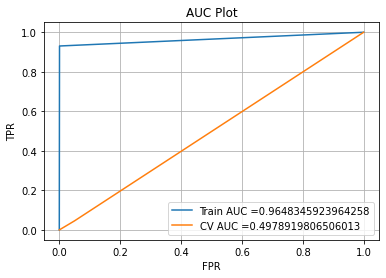

Cross Validation
FNR:0.9540229885057471 ,TPR:0.04597701149425287 ,FPR:0.05019305019305019 ,TNR:0.9498069498069498 


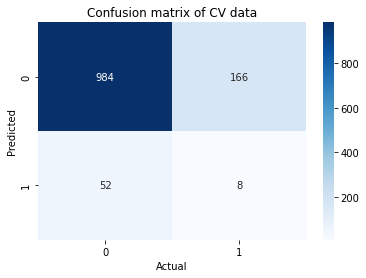

----------------------------------------------------------------------------------------
Tol: 1
              precision    recall  f1-score   support

           0       0.84      0.80      0.82      1036
           1       0.09      0.11      0.10       174

    accuracy                           0.70      1210
   macro avg       0.47      0.46      0.46      1210
weighted avg       0.74      0.70      0.72      1210

              precision    recall  f1-score   support

           0       0.99      0.88      0.93      4077
           1       0.77      0.99      0.87      1753

    accuracy                           0.91      5830
   macro avg       0.88      0.93      0.90      5830
weighted avg       0.93      0.91      0.91      5830



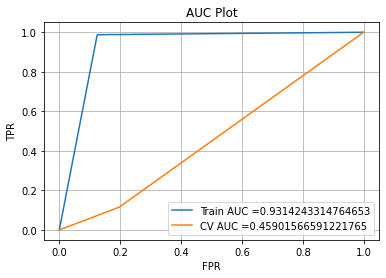

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.1969111969111969 ,TNR:0.803088803088803 


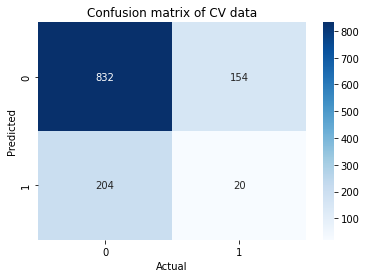

----------------------------------------------------------------------------------------
Tol: 10
              precision    recall  f1-score   support

           0       0.85      0.83      0.84      1036
           1       0.09      0.10      0.10       174

    accuracy                           0.72      1210
   macro avg       0.47      0.47      0.47      1210
weighted avg       0.74      0.72      0.73      1210

              precision    recall  f1-score   support

           0       1.00      0.92      0.96      4077
           1       0.84      1.00      0.91      1753

    accuracy                           0.94      5830
   macro avg       0.92      0.96      0.93      5830
weighted avg       0.95      0.94      0.94      5830



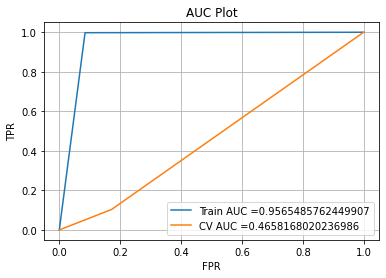

Cross Validation
FNR:0.896551724137931 ,TPR:0.10344827586206896 ,FPR:0.1718146718146718 ,TNR:0.8281853281853282 


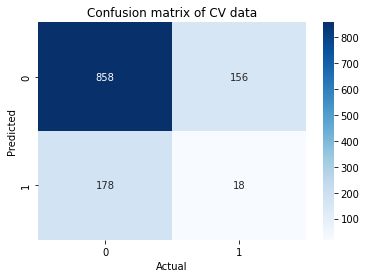

In [62]:
for c in [0.0001,0.001,0.01,0.1,1,10]:
    clf = SGDClassifier(tol=c,class_weight={1:0.83,0:0.16})
    clf.fit(X_outpatient_70_30_sd,y_outpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("Tol:",c)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_70_30_sd)
    print(classification_report(y_outpatient_70_30_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

<h2>LGBM Classifier</h2>

In [63]:
from lightgbm import LGBMClassifier

Original Distribution

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Race_5 47
only_fraud_physician_count 48
only_fraud_op_physician_count 73
County_12 89
County_13 87
County_21 42
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



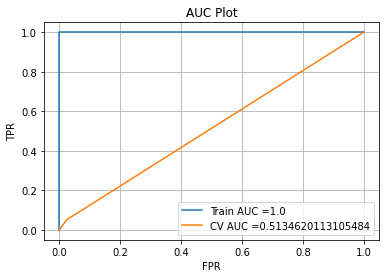

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


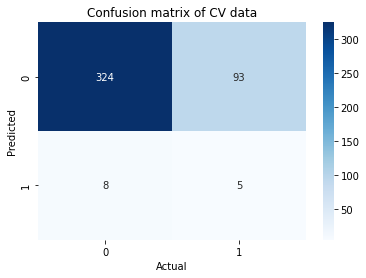

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 63
InscClaimAmtReimbursed_total 74
AdmitDays 50
Race_5 77
only_fraud_physician_count 49
only_fraud_op_physician_count 77
County_0 43
County_10 37
County_11 129
County_12 178
County_13 205
County_15 40
County_21 98
County_22 41
County_27 31
County_47 38
ChronicCond_Diabetes_0 35
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



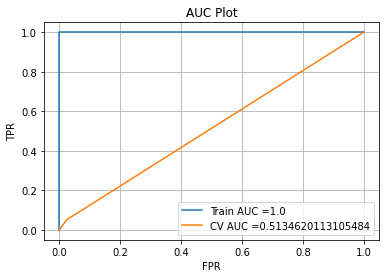

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


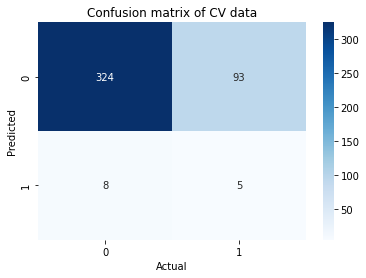

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 66
InscClaimAmtReimbursed_total 64
AdmitDays 49
Race_5 77
only_fraud_physician_count 49
only_fraud_op_physician_count 77
County_0 33
County_10 39
County_11 129
County_12 178
County_13 202
County_15 40
County_21 114
County_22 44
County_27 31
County_47 38
ChronicCond_Diabetes_0 35
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



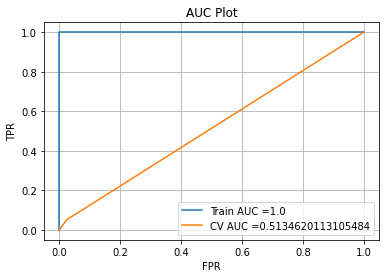

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


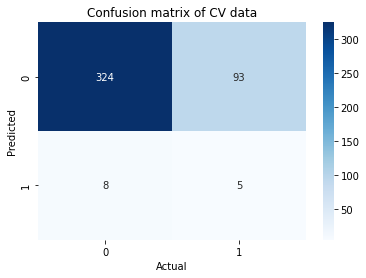

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 66
InscClaimAmtReimbursed_total 64
AdmitDays 49
Race_5 77
only_fraud_physician_count 49
only_fraud_op_physician_count 77
County_0 33
County_10 39
County_11 129
County_12 178
County_13 202
County_15 40
County_21 114
County_22 44
County_27 31
County_47 38
ChronicCond_Diabetes_0 35
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



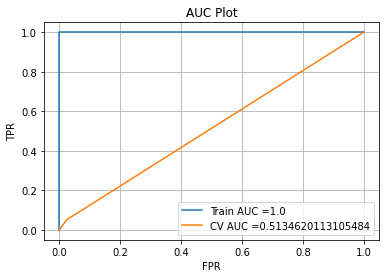

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


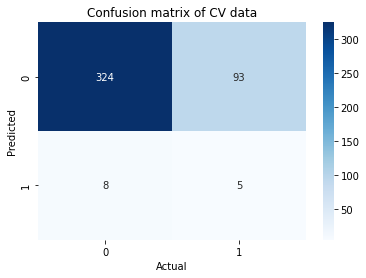

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 66
InscClaimAmtReimbursed_total 64
AdmitDays 49
Race_5 77
only_fraud_physician_count 49
only_fraud_op_physician_count 77
County_0 33
County_10 39
County_11 129
County_12 178
County_13 202
County_15 40
County_21 114
County_22 44
County_27 31
County_47 38
ChronicCond_Diabetes_0 35
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



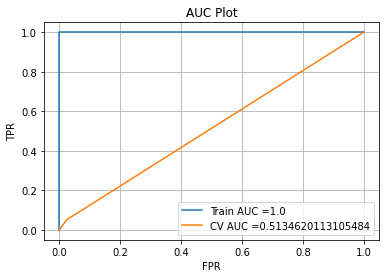

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


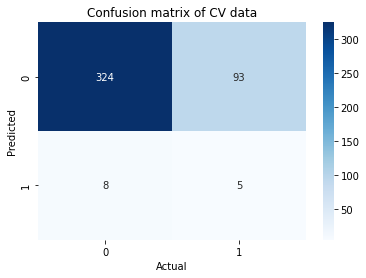

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 66
InscClaimAmtReimbursed_total 64
AdmitDays 49
Race_5 77
only_fraud_physician_count 49
only_fraud_op_physician_count 77
County_0 33
County_10 39
County_11 129
County_12 178
County_13 202
County_15 40
County_21 114
County_22 44
County_27 31
County_47 38
ChronicCond_Diabetes_0 35
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



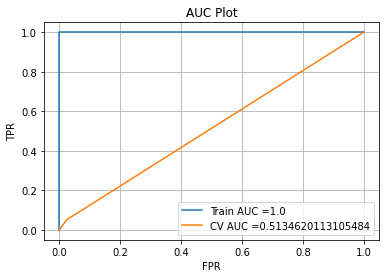

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


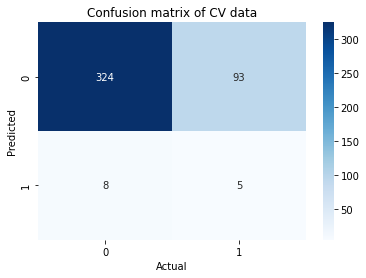

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Race_5 67
only_fraud_physician_count 68
only_fraud_op_physician_count 113
County_12 129
County_13 127
County_21 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



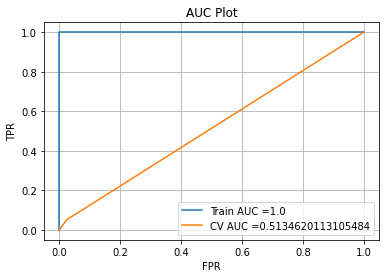

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


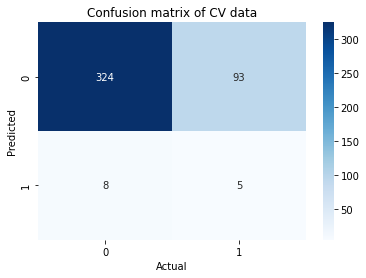

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 109
InscClaimAmtReimbursed_total 97
AdmitDays 65
Gender_0 32
Race_5 117
only_fraud_physician_count 70
only_fraud_op_physician_count 117
County_0 49
County_7 35
County_10 61
County_11 194
County_12 258
County_13 278
County_15 60
County_18 35
County_21 150
County_22 51
County_27 35
County_47 40
ChronicCond_Diabetes_0 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



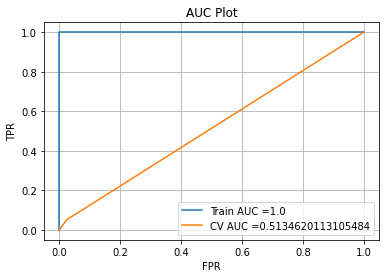

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


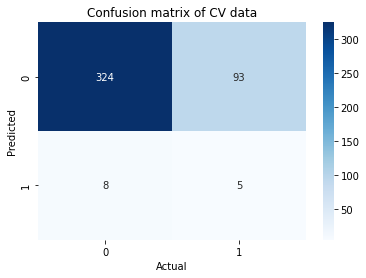

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 114
InscClaimAmtReimbursed_total 96
AdmitDays 64
Gender_0 33
Race_5 117
only_fraud_physician_count 70
only_fraud_op_physician_count 117
County_0 41
County_10 70
County_11 195
County_12 258
County_13 272
County_15 61
County_18 36
County_21 166
County_22 54
County_27 34
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



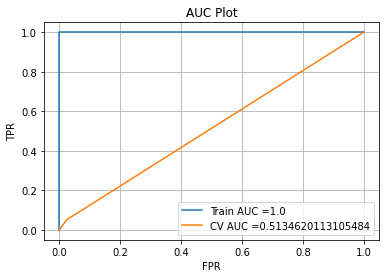

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


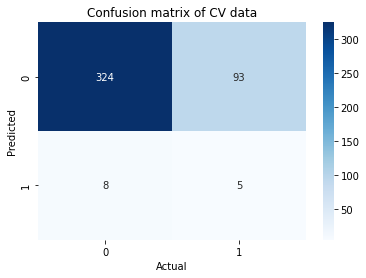

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 114
InscClaimAmtReimbursed_total 96
AdmitDays 64
Gender_0 33
Race_5 117
only_fraud_physician_count 70
only_fraud_op_physician_count 117
County_0 41
County_10 70
County_11 195
County_12 258
County_13 272
County_15 61
County_18 36
County_21 166
County_22 54
County_27 34
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



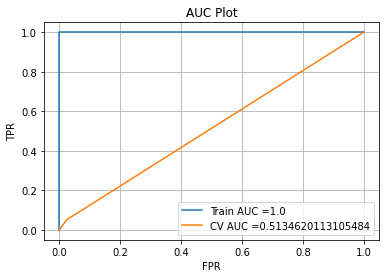

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


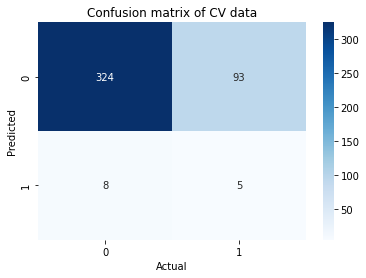

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 114
InscClaimAmtReimbursed_total 96
AdmitDays 64
Gender_0 33
Race_5 117
only_fraud_physician_count 70
only_fraud_op_physician_count 117
County_0 41
County_10 70
County_11 195
County_12 258
County_13 272
County_15 61
County_18 36
County_21 166
County_22 54
County_27 34
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



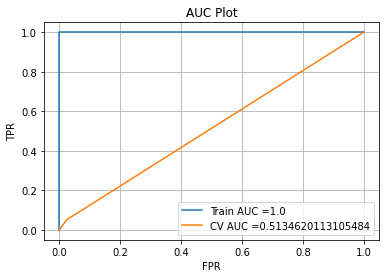

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


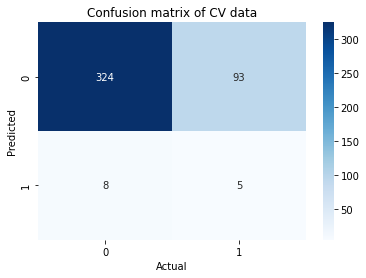

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 114
InscClaimAmtReimbursed_total 96
AdmitDays 64
Gender_0 33
Race_5 117
only_fraud_physician_count 70
only_fraud_op_physician_count 117
County_0 41
County_10 70
County_11 195
County_12 258
County_13 272
County_15 61
County_18 36
County_21 166
County_22 54
County_27 34
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



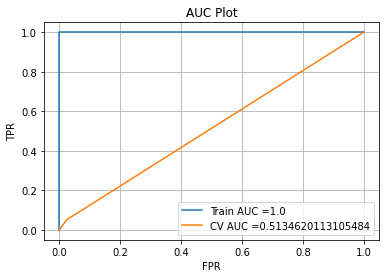

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


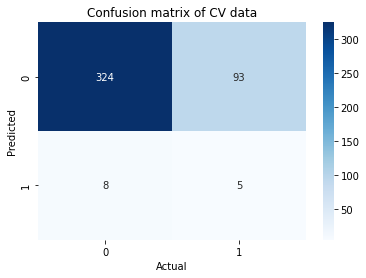

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Race_5 86
only_fraud_physician_count 89
only_fraud_op_physician_count 158
County_12 158
County_13 187
County_21 80
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



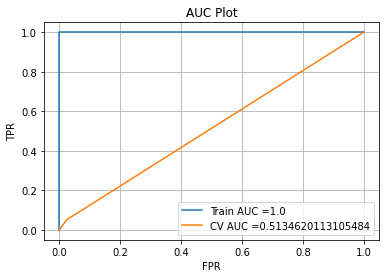

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


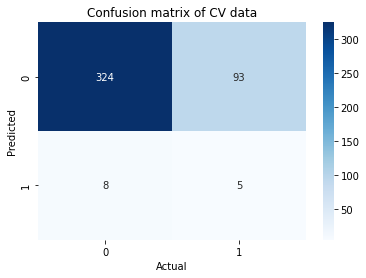

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 161
InscClaimAmtReimbursed_total 140
InscClaimAmtReimbursed_avg 32
AdmitDays 77
Gender_0 36
Race_5 148
only_fraud_physician_count 91
only_fraud_op_physician_count 166
County_0 76
County_7 38
County_8 31
County_10 77
County_11 230
County_12 310
County_13 359
County_15 64
County_17 40
County_18 40
County_21 185
County_22 58
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



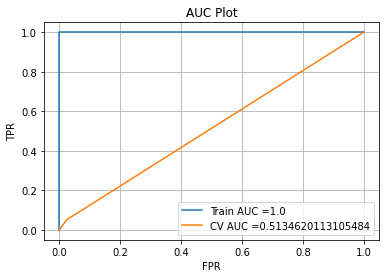

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


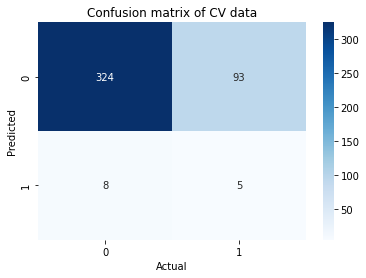

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 162
InscClaimAmtReimbursed_total 130
AdmitDays 79
Gender_0 39
Race_5 148
only_fraud_physician_count 91
only_fraud_op_physician_count 166
County_0 67
County_6 36
County_8 32
County_10 88
County_11 228
County_12 312
County_13 353
County_15 65
County_17 38
County_18 40
County_21 200
County_22 59
County_27 38
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



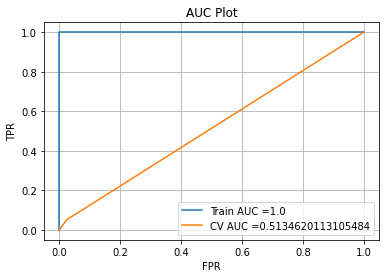

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


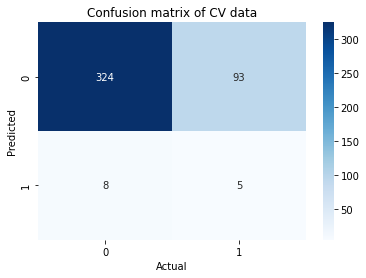

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 162
InscClaimAmtReimbursed_total 130
AdmitDays 79
Gender_0 39
Race_5 148
only_fraud_physician_count 91
only_fraud_op_physician_count 166
County_0 67
County_6 36
County_8 32
County_10 88
County_11 228
County_12 312
County_13 353
County_15 65
County_17 38
County_18 40
County_21 200
County_22 59
County_27 38
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



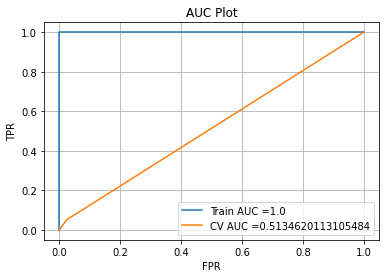

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


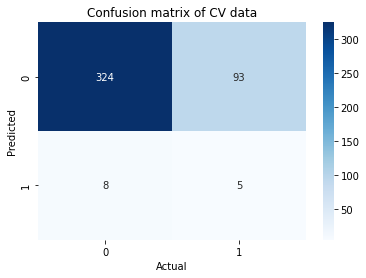

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 162
InscClaimAmtReimbursed_total 130
AdmitDays 79
Gender_0 39
Race_5 148
only_fraud_physician_count 91
only_fraud_op_physician_count 166
County_0 67
County_6 36
County_8 32
County_10 88
County_11 228
County_12 312
County_13 353
County_15 65
County_17 38
County_18 40
County_21 200
County_22 59
County_27 38
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



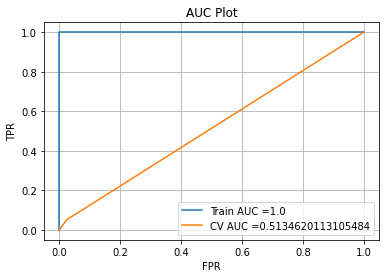

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


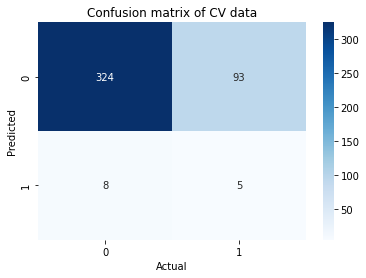

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 162
InscClaimAmtReimbursed_total 130
AdmitDays 79
Gender_0 39
Race_5 148
only_fraud_physician_count 91
only_fraud_op_physician_count 166
County_0 67
County_6 36
County_8 32
County_10 88
County_11 228
County_12 312
County_13 353
County_15 65
County_17 38
County_18 40
County_21 200
County_22 59
County_27 38
County_47 40
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



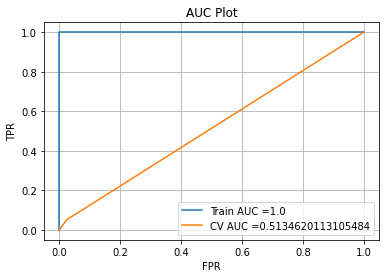

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


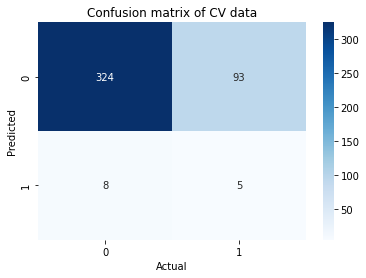

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Race_5 86
only_fraud_physician_count 100
only_fraud_op_physician_count 172
County_11 33
County_12 159
County_13 198
County_21 81
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



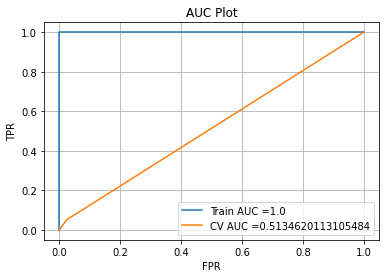

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


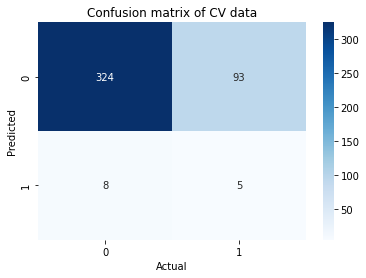

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 165
InscClaimAmtReimbursed_total 143
InscClaimAmtReimbursed_avg 32
AdmitDays 78
Gender_0 36
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 83
County_7 39
County_8 32
County_10 78
County_11 234
County_12 310
County_13 371
County_15 65
County_17 40
County_18 42
County_21 185
County_22 59
County_25 46
County_27 38
County_47 42
ChronicCond_Diabetes_0 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



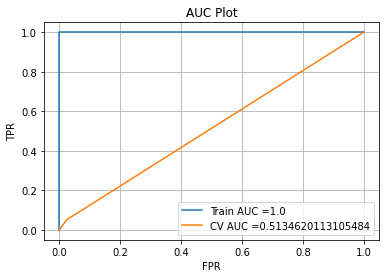

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


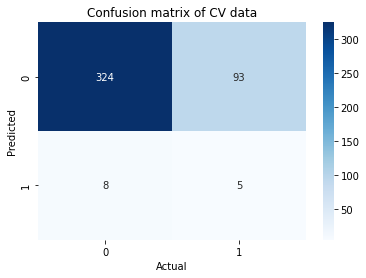

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



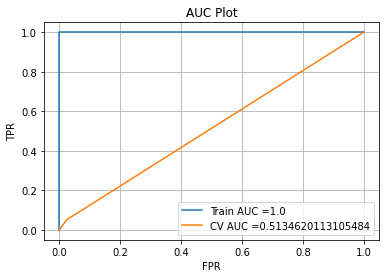

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


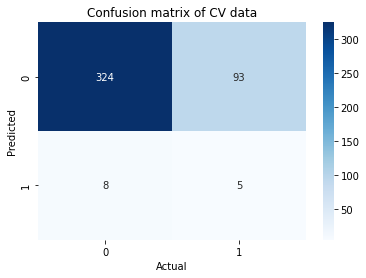

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



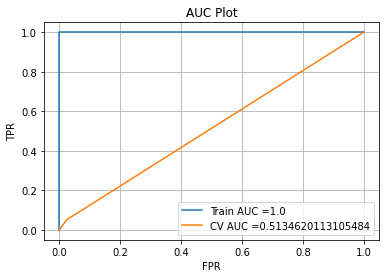

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


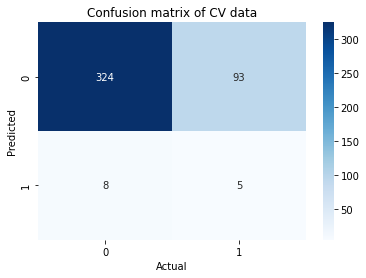

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



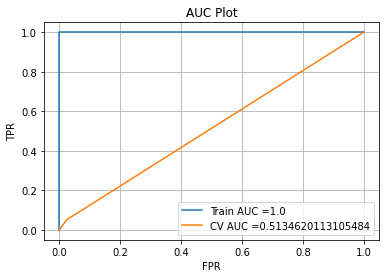

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


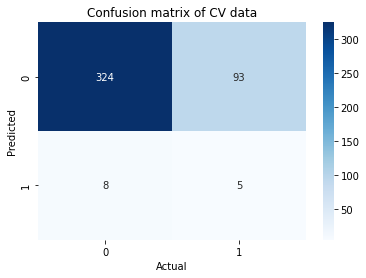

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



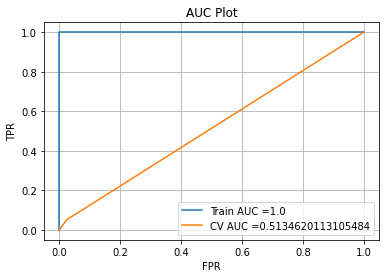

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


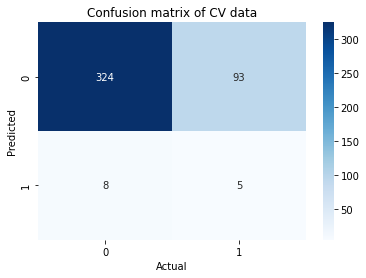

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Race_5 86
only_fraud_physician_count 100
only_fraud_op_physician_count 172
County_11 33
County_12 159
County_13 198
County_21 81
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



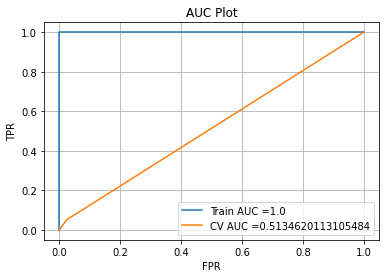

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


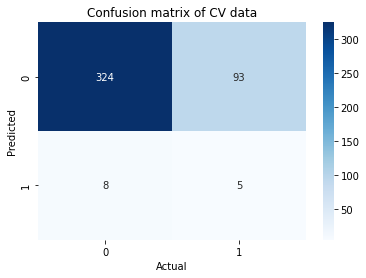

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 165
InscClaimAmtReimbursed_total 143
InscClaimAmtReimbursed_avg 32
AdmitDays 78
Gender_0 36
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 83
County_7 39
County_8 32
County_10 78
County_11 234
County_12 310
County_13 371
County_15 65
County_17 40
County_18 42
County_21 185
County_22 59
County_25 46
County_27 38
County_47 42
ChronicCond_Diabetes_0 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



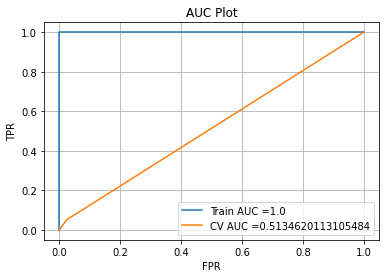

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


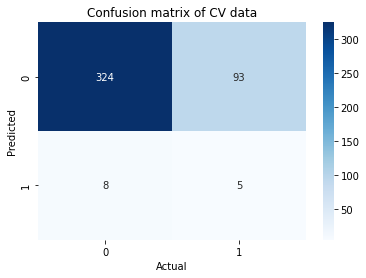

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



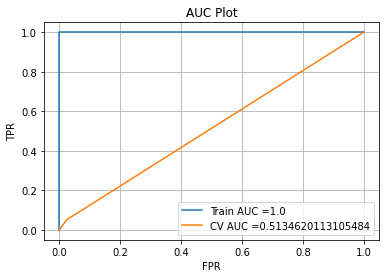

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


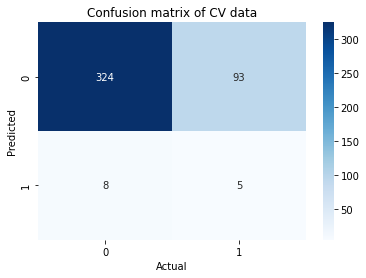

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



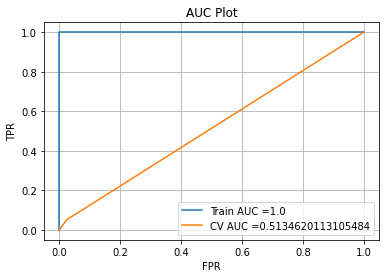

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


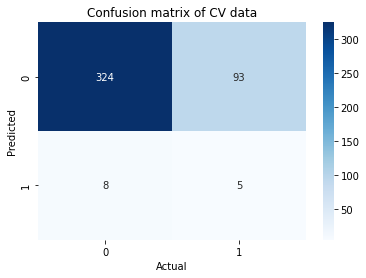

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



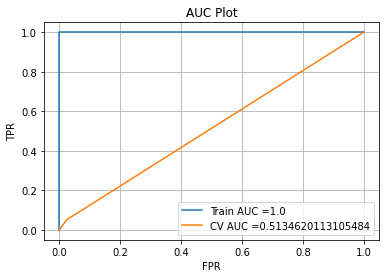

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


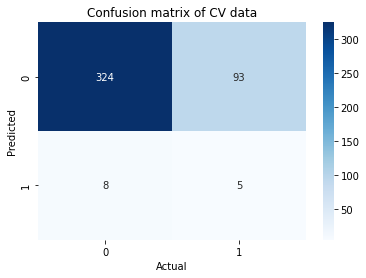

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



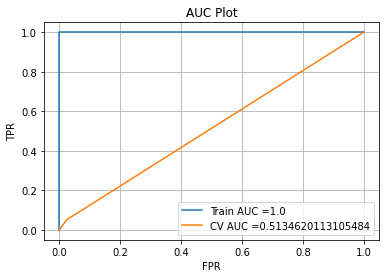

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


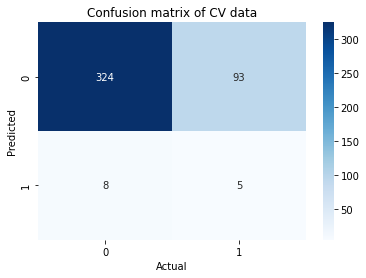

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Race_5 86
only_fraud_physician_count 100
only_fraud_op_physician_count 172
County_11 33
County_12 159
County_13 198
County_21 81
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



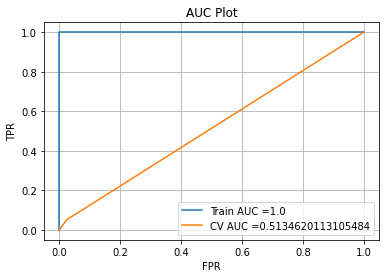

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


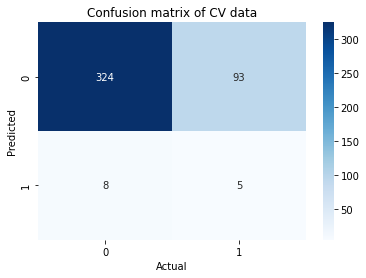

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 165
InscClaimAmtReimbursed_total 143
InscClaimAmtReimbursed_avg 32
AdmitDays 78
Gender_0 36
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 83
County_7 39
County_8 32
County_10 78
County_11 234
County_12 310
County_13 371
County_15 65
County_17 40
County_18 42
County_21 185
County_22 59
County_25 46
County_27 38
County_47 42
ChronicCond_Diabetes_0 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



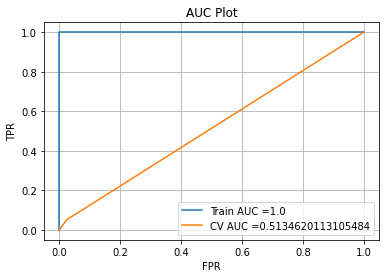

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


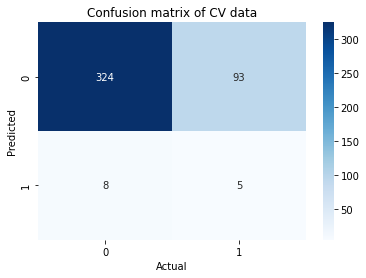

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



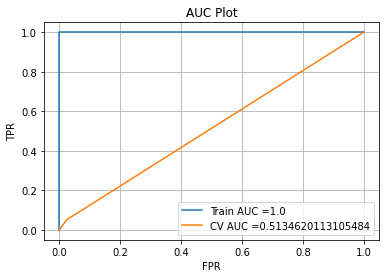

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


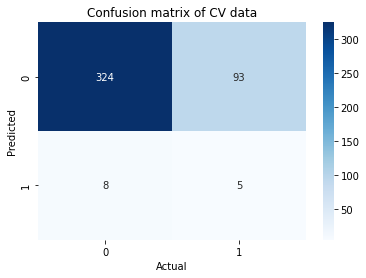

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



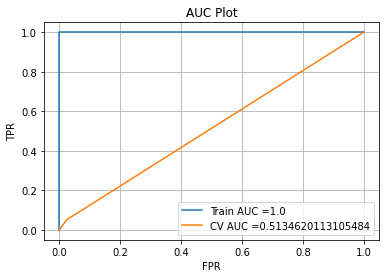

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


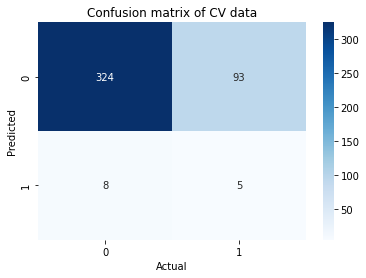

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



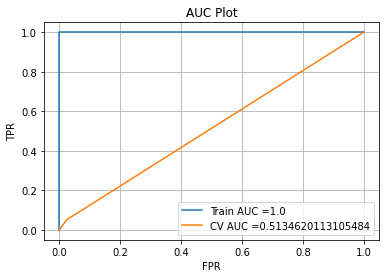

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


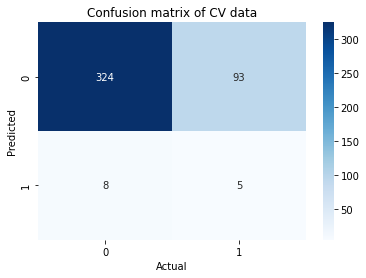

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 165
InscClaimAmtReimbursed_total 134
AdmitDays 80
Gender_0 39
Race_5 148
only_fraud_physician_count 102
only_fraud_op_physician_count 180
County_0 74
County_6 36
County_8 33
County_10 89
County_11 232
County_12 312
County_13 365
County_15 66
County_17 38
County_18 42
County_21 200
County_22 60
County_25 35
County_27 38
County_47 41
ChronicCond_Diabetes_0 44
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430



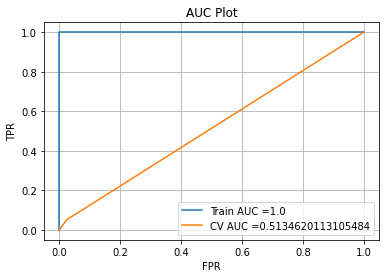

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


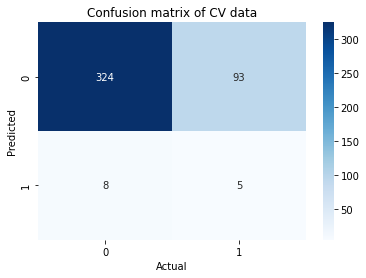

In [64]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.76,0:0.23})
        clf.fit(X_train_inpatient,y_train_inpatient.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_inpatient.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_train_inpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Race_5 42
only_fraud_physician_count 67
only_fraud_op_physician_count 45
County_10 34
County_12 61
County_13 55
County_21 45
County_38 31
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



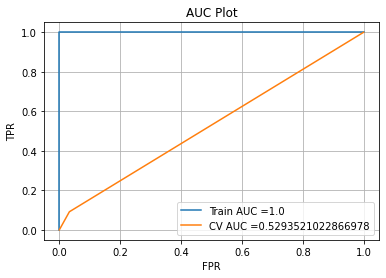

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


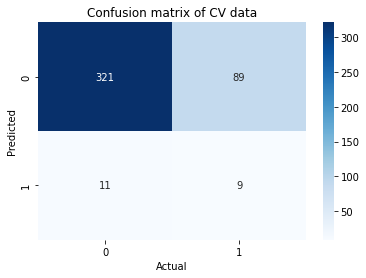

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 64
InscClaimAmtReimbursed_total 51
Race_5 76
only_fraud_physician_count 111
only_fraud_op_physician_count 87
County_0 63
County_1 49
County_2 58
County_3 33
County_9 52
County_10 102
County_11 158
County_12 132
County_13 104
County_14 53
County_15 41
County_16 46
County_21 82
County_23 34
County_38 44
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      265

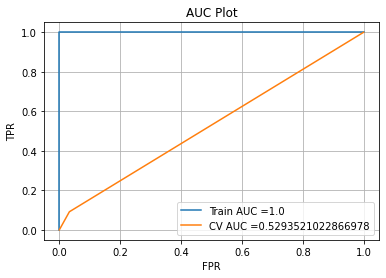

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


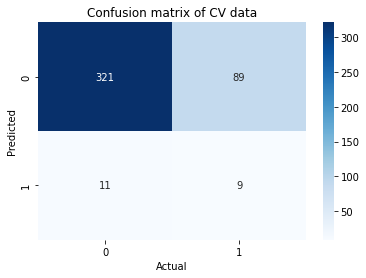

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 65
InscClaimAmtReimbursed_total 50
Race_5 76
only_fraud_physician_count 111
only_fraud_op_physician_count 88
County_0 71
County_1 49
County_2 62
County_3 36
County_6 31
County_9 61
County_10 106
County_11 158
County_12 148
County_13 106
County_14 52
County_15 38
County_16 48
County_21 74
County_23 31
County_38 43
County_39 32
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy               

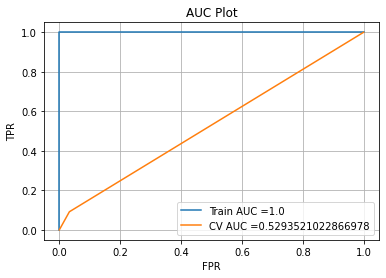

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


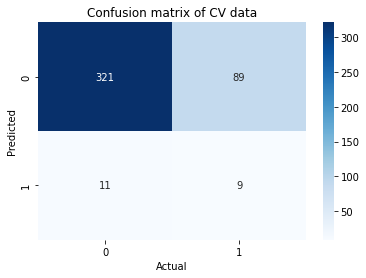

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 65
InscClaimAmtReimbursed_total 50
Race_5 76
only_fraud_physician_count 111
only_fraud_op_physician_count 88
County_0 71
County_1 49
County_2 62
County_3 36
County_6 31
County_9 61
County_10 106
County_11 158
County_12 148
County_13 106
County_14 52
County_15 38
County_16 48
County_21 74
County_23 31
County_38 43
County_39 32
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy              

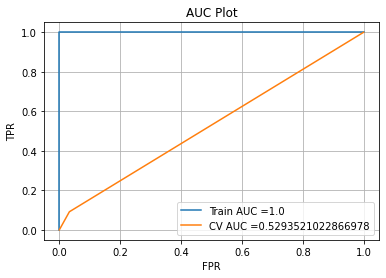

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


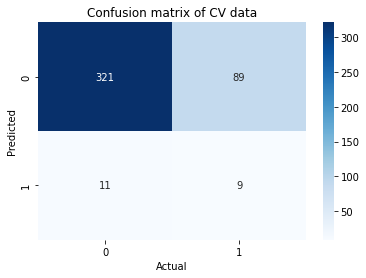

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 65
InscClaimAmtReimbursed_total 50
Race_5 76
only_fraud_physician_count 111
only_fraud_op_physician_count 88
County_0 71
County_1 49
County_2 62
County_3 36
County_6 31
County_9 61
County_10 106
County_11 158
County_12 148
County_13 106
County_14 52
County_15 38
County_16 48
County_21 74
County_23 31
County_38 43
County_39 32
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy              

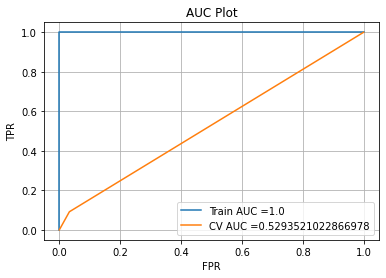

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


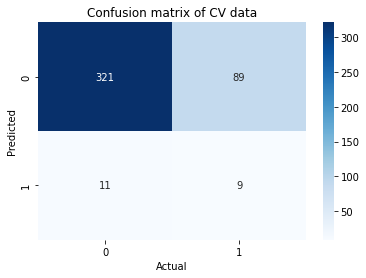

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 65
InscClaimAmtReimbursed_total 50
Race_5 76
only_fraud_physician_count 111
only_fraud_op_physician_count 88
County_0 71
County_1 49
County_2 62
County_3 36
County_6 31
County_9 61
County_10 106
County_11 158
County_12 148
County_13 106
County_14 52
County_15 38
County_16 48
County_21 74
County_23 31
County_38 43
County_39 32
              precision    recall  f1-score   support

           0       0.78      0.97      0.87       332
           1       0.45      0.09      0.15        98

    accuracy                           0.77       430
   macro avg       0.62      0.53      0.51       430
weighted avg       0.71      0.77      0.70       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy              

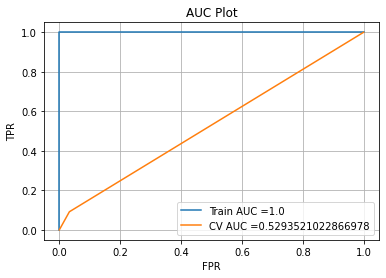

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


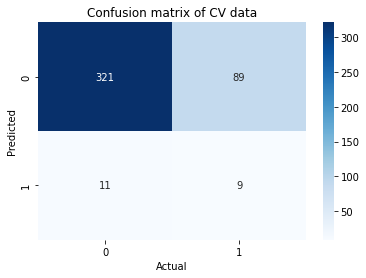

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Race_5 62
only_fraud_physician_count 107
only_fraud_op_physician_count 65
County_10 54
County_12 81
County_13 75
County_21 65
County_38 51
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



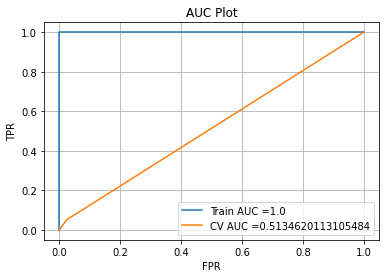

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


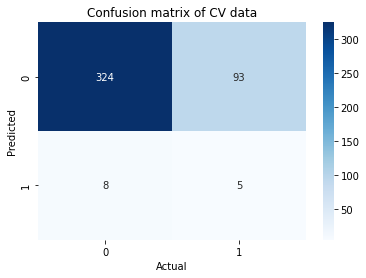

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 84
InscClaimAmtReimbursed_total 69
Race_5 96
only_fraud_physician_count 162
only_fraud_op_physician_count 127
County_0 90
County_1 62
County_2 95
County_3 41
County_6 32
County_9 82
County_10 150
County_11 238
County_12 170
County_13 143
County_14 82
County_15 63
County_16 50
County_21 109
County_23 59
County_38 65
County_39 40
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy             

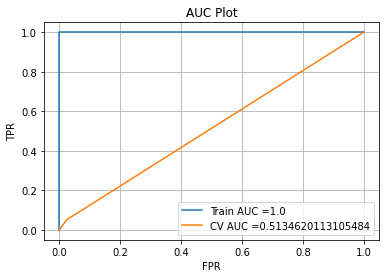

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


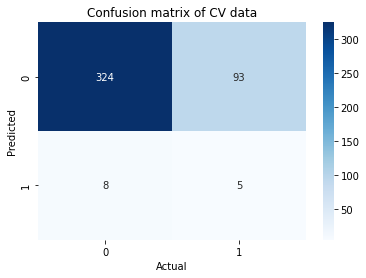

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 88
InscClaimAmtReimbursed_total 69
Race_5 96
only_fraud_physician_count 160
only_fraud_op_physician_count 128
County_0 98
County_1 63
County_2 92
County_3 36
County_6 38
County_9 93
County_10 155
County_11 230
County_12 189
County_13 143
County_14 73
County_15 56
County_16 54
County_19 32
County_21 99
County_23 53
County_38 63
County_39 46
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy 

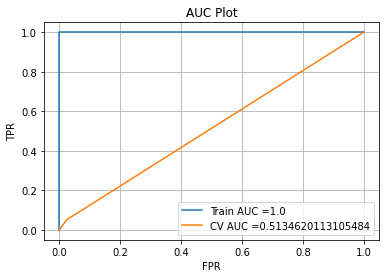

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


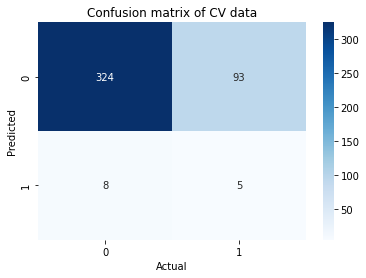

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 88
InscClaimAmtReimbursed_total 69
Race_5 96
only_fraud_physician_count 160
only_fraud_op_physician_count 128
County_0 98
County_1 63
County_2 92
County_3 36
County_6 38
County_9 93
County_10 155
County_11 230
County_12 189
County_13 143
County_14 73
County_15 56
County_16 54
County_19 32
County_21 99
County_23 53
County_38 63
County_39 46
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy

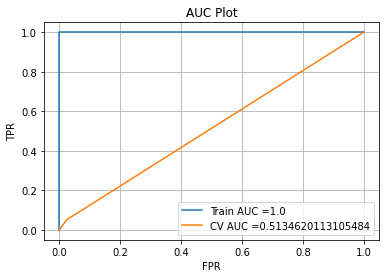

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


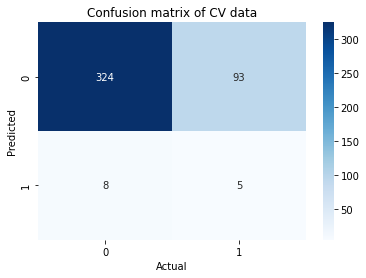

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 88
InscClaimAmtReimbursed_total 69
Race_5 96
only_fraud_physician_count 160
only_fraud_op_physician_count 128
County_0 98
County_1 63
County_2 92
County_3 36
County_6 38
County_9 93
County_10 155
County_11 230
County_12 189
County_13 143
County_14 73
County_15 56
County_16 54
County_19 32
County_21 99
County_23 53
County_38 63
County_39 46
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy

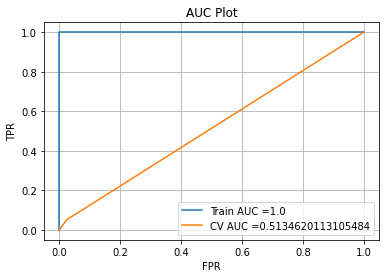

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


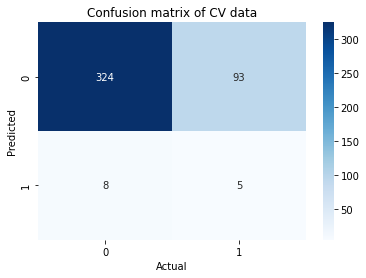

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 88
InscClaimAmtReimbursed_total 69
Race_5 96
only_fraud_physician_count 160
only_fraud_op_physician_count 128
County_0 98
County_1 63
County_2 92
County_3 36
County_6 38
County_9 93
County_10 155
County_11 230
County_12 189
County_13 143
County_14 73
County_15 56
County_16 54
County_19 32
County_21 99
County_23 53
County_38 63
County_39 46
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy

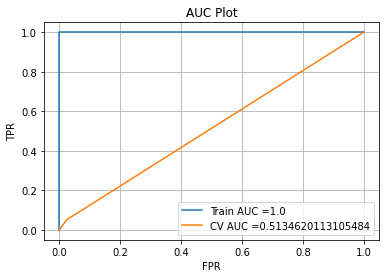

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


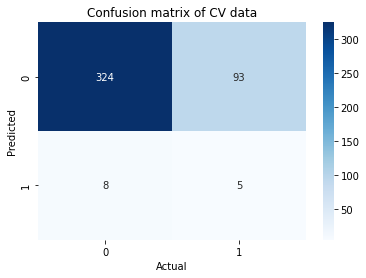

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Race_5 85
only_fraud_physician_count 149
only_fraud_op_physician_count 95
County_10 70
County_12 107
County_13 108
County_21 84
County_38 72
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



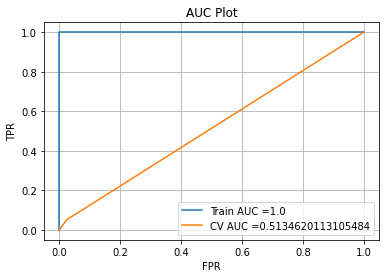

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


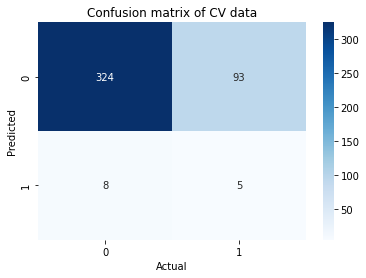

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 137
InscClaimAmtReimbursed_total 106
Race_5 123
only_fraud_physician_count 213
only_fraud_op_physician_count 174
County_0 122
County_1 79
County_2 115
County_3 54
County_4 31
County_5 34
County_6 35
County_9 92
County_10 191
County_11 304
County_12 214
County_13 182
County_14 93
County_15 72
County_16 54
County_21 129
County_23 74
County_27 32
County_38 90
County_39 49
ChronicCond_Depression_0 32
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
         

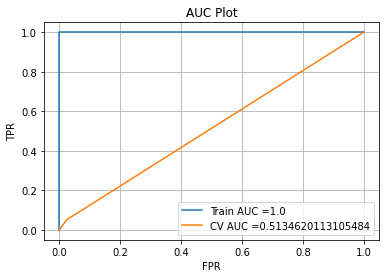

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


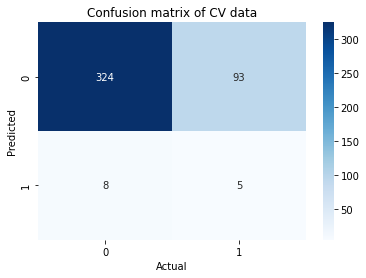

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 131
InscClaimAmtReimbursed_total 95
InscClaimAmtReimbursed_avg 32
Race_5 123
only_fraud_physician_count 212
only_fraud_op_physician_count 182
County_0 124
County_1 82
County_2 114
County_3 48
County_6 40
County_9 106
County_10 197
County_11 287
County_12 235
County_13 191
County_14 84
County_15 65
County_16 65
County_19 35
County_21 120
County_23 68
County_27 35
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.

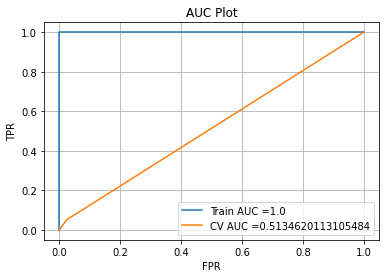

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


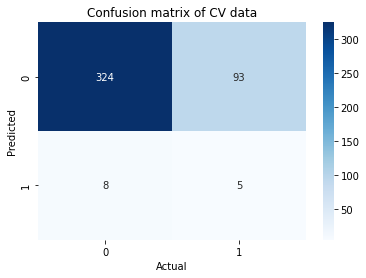

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 131
InscClaimAmtReimbursed_total 95
InscClaimAmtReimbursed_avg 32
Race_5 123
only_fraud_physician_count 212
only_fraud_op_physician_count 182
County_0 124
County_1 82
County_2 114
County_3 48
County_6 40
County_9 106
County_10 197
County_11 287
County_12 235
County_13 191
County_14 84
County_15 65
County_16 65
County_19 35
County_21 120
County_23 68
County_27 35
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1

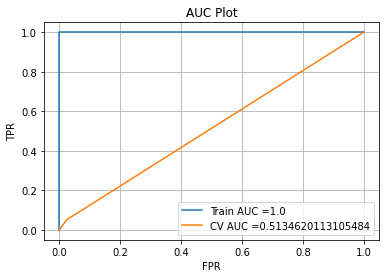

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


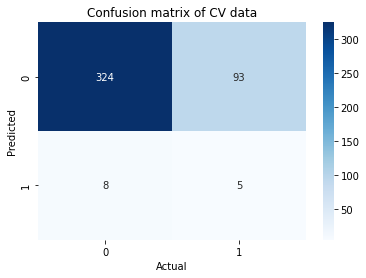

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 131
InscClaimAmtReimbursed_total 95
InscClaimAmtReimbursed_avg 32
Race_5 123
only_fraud_physician_count 212
only_fraud_op_physician_count 182
County_0 124
County_1 82
County_2 114
County_3 48
County_6 40
County_9 106
County_10 197
County_11 287
County_12 235
County_13 191
County_14 84
County_15 65
County_16 65
County_19 35
County_21 120
County_23 68
County_27 35
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1

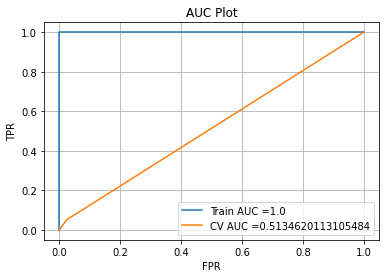

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


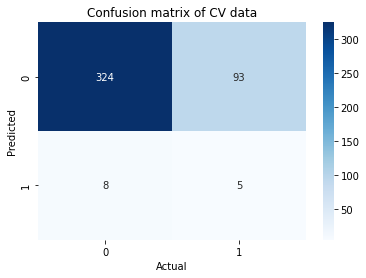

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 131
InscClaimAmtReimbursed_total 95
InscClaimAmtReimbursed_avg 32
Race_5 123
only_fraud_physician_count 212
only_fraud_op_physician_count 182
County_0 124
County_1 82
County_2 114
County_3 48
County_6 40
County_9 106
County_10 197
County_11 287
County_12 235
County_13 191
County_14 84
County_15 65
County_16 65
County_19 35
County_21 120
County_23 68
County_27 35
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1

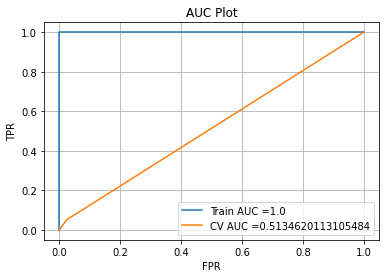

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


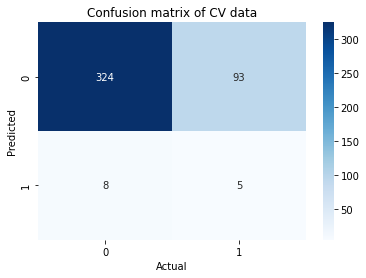

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Race_5 85
only_fraud_physician_count 163
only_fraud_op_physician_count 121
County_10 70
County_11 32
County_12 110
County_13 117
County_21 84
County_38 72
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



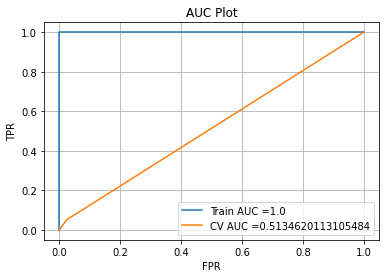

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


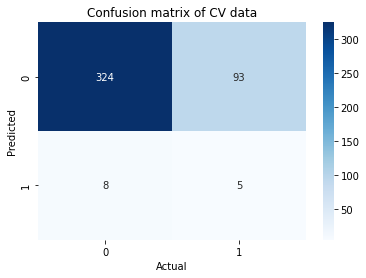

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 147
InscClaimAmtReimbursed_total 121
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 199
County_0 123
County_1 79
County_2 117
County_3 55
County_4 33
County_5 36
County_6 35
County_9 93
County_10 191
County_11 313
County_12 216
County_13 189
County_14 94
County_15 72
County_16 55
County_21 129
County_23 74
County_27 32
County_28 32
County_38 90
County_39 49
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1

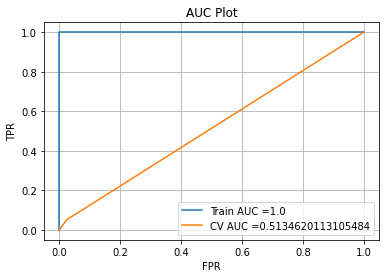

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


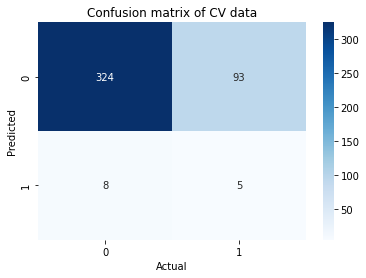

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

    

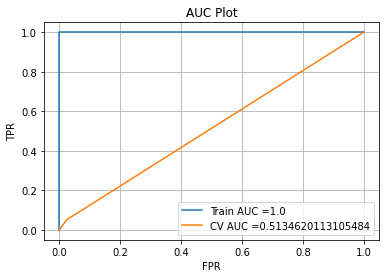

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


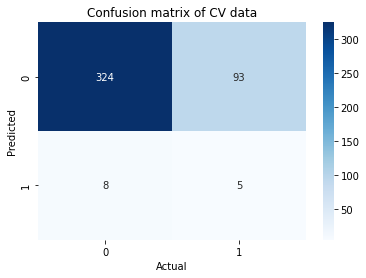

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

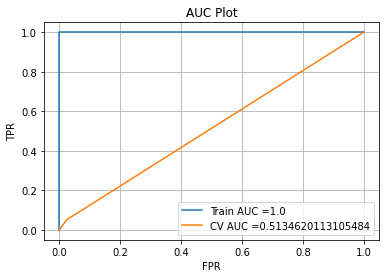

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


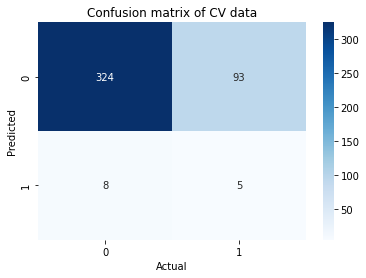

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

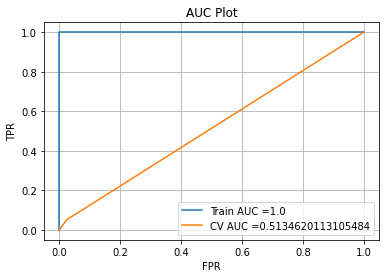

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


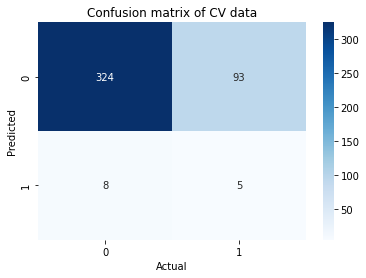

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

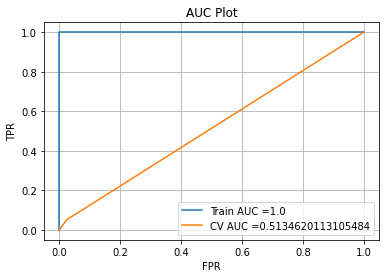

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


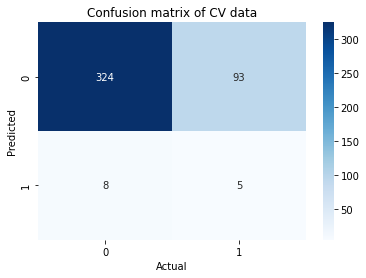

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Race_5 85
only_fraud_physician_count 163
only_fraud_op_physician_count 121
County_10 70
County_11 32
County_12 110
County_13 117
County_21 84
County_38 72
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



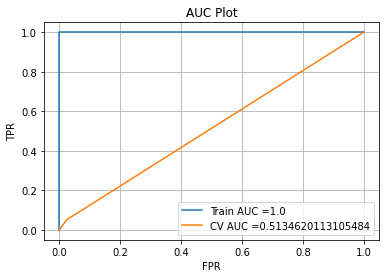

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


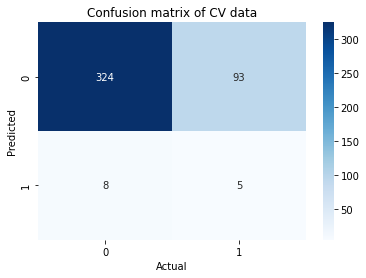

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 147
InscClaimAmtReimbursed_total 121
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 199
County_0 123
County_1 79
County_2 117
County_3 55
County_4 33
County_5 36
County_6 35
County_9 93
County_10 191
County_11 313
County_12 216
County_13 189
County_14 94
County_15 72
County_16 55
County_21 129
County_23 74
County_27 32
County_28 32
County_38 90
County_39 49
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1

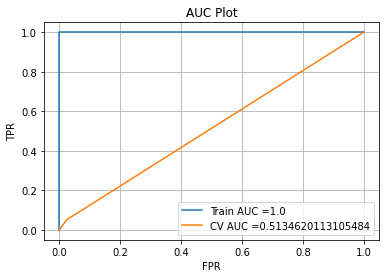

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


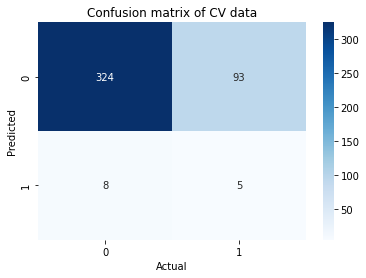

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

    

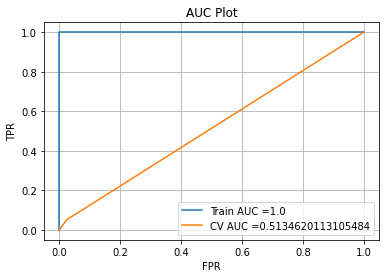

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


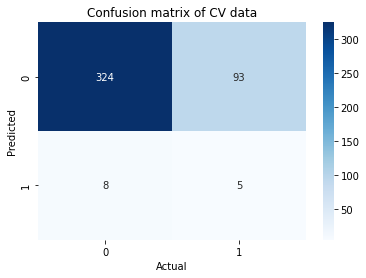

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

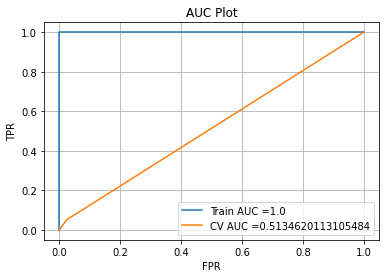

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


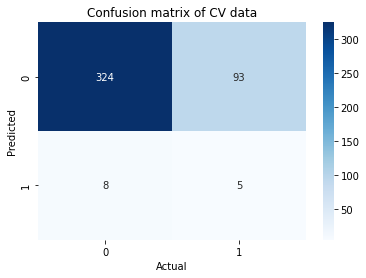

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

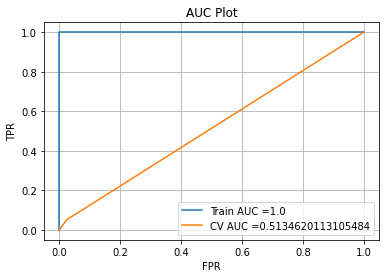

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


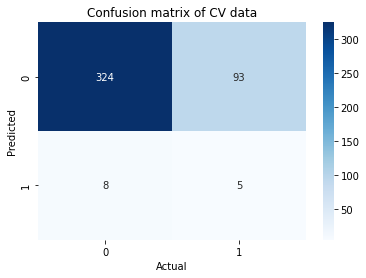

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

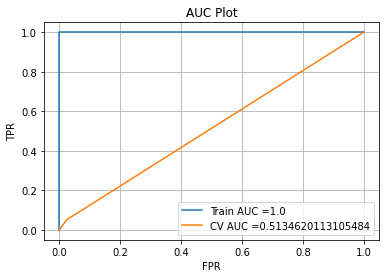

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


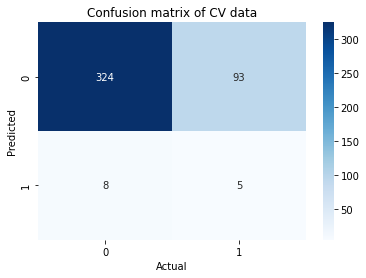

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Race_5 85
only_fraud_physician_count 163
only_fraud_op_physician_count 121
County_10 70
County_11 32
County_12 110
County_13 117
County_21 84
County_38 72
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00      1326

    accuracy                           1.00      2652
   macro avg       1.00      1.00      1.00      2652
weighted avg       1.00      1.00      1.00      2652



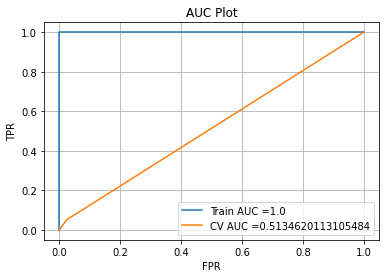

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


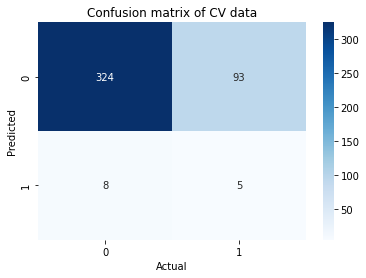

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 147
InscClaimAmtReimbursed_total 121
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 199
County_0 123
County_1 79
County_2 117
County_3 55
County_4 33
County_5 36
County_6 35
County_9 93
County_10 191
County_11 313
County_12 216
County_13 189
County_14 94
County_15 72
County_16 55
County_21 129
County_23 74
County_27 32
County_28 32
County_38 90
County_39 49
ChronicCond_Depression_0 33
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      

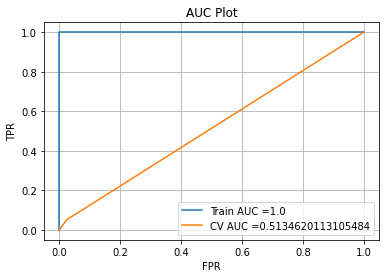

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


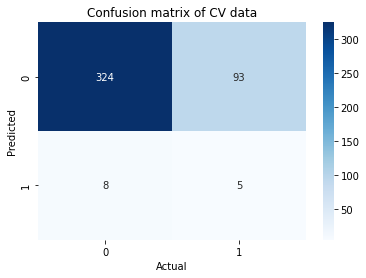

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

   

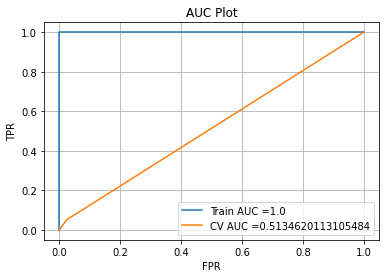

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


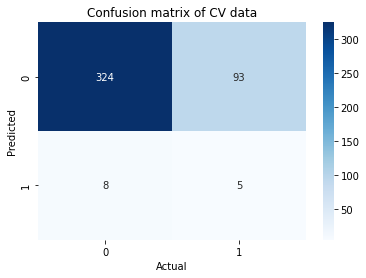

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

  

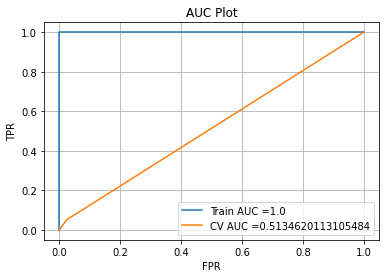

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


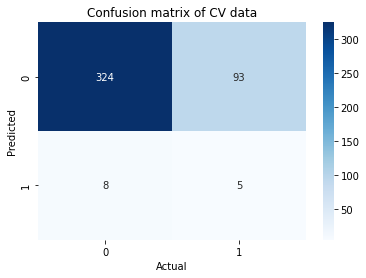

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

  

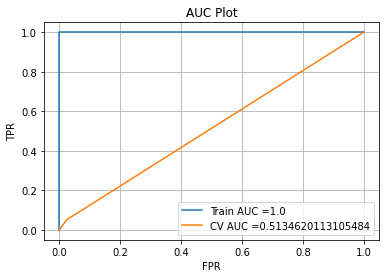

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


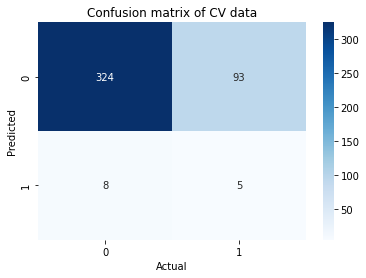

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 144
InscClaimAmtReimbursed_total 107
InscClaimAmtReimbursed_avg 34
AdmitDays 31
Race_5 123
only_fraud_physician_count 227
only_fraud_op_physician_count 206
County_0 127
County_1 82
County_2 116
County_3 48
County_6 40
County_9 107
County_10 197
County_11 296
County_12 237
County_13 198
County_14 85
County_15 65
County_16 66
County_19 35
County_21 121
County_23 68
County_27 35
County_28 31
County_35 31
County_38 87
County_39 54
ChronicCond_Depression_0 34
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

  

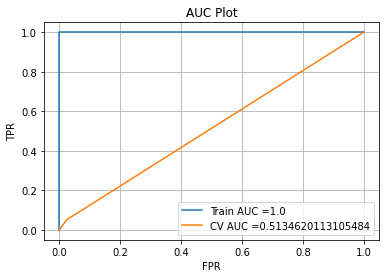

Cross validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


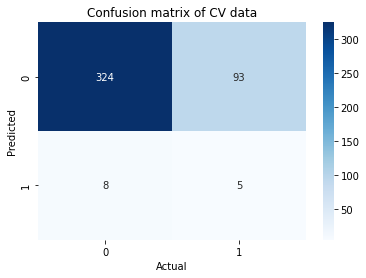

In [65]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_50_50,y_inpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_50_50.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_50_50)
        print(classification_report(y_inpatient_50_50,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Race_5 43
only_fraud_physician_count 73
only_fraud_op_physician_count 44
County_11 36
County_12 64
County_13 50
County_21 44
County_38 37
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



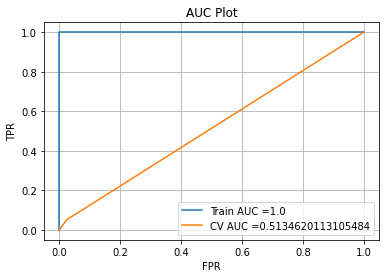

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


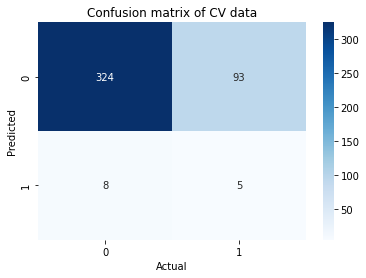

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 62
InscClaimAmtReimbursed_total 84
Race_5 69
only_fraud_physician_count 117
only_fraud_op_physician_count 48
County_0 52
County_2 38
County_4 39
County_5 34
County_8 31
County_9 37
County_10 66
County_11 148
County_12 146
County_13 87
County_14 39
County_15 43
County_21 64
County_29 31
County_38 73
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy               

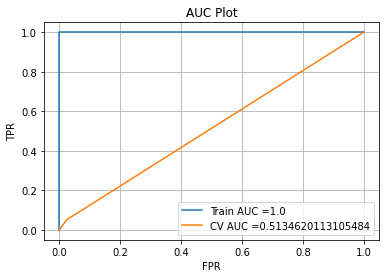

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


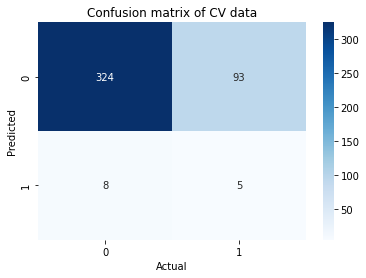

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 61
InscClaimAmtReimbursed_total 88
Race_5 70
only_fraud_physician_count 117
only_fraud_op_physician_count 49
County_0 70
County_2 42
County_3 31
County_4 46
County_5 40
County_8 37
County_9 33
County_10 64
County_11 143
County_12 153
County_13 88
County_14 40
County_15 40
County_16 34
County_21 64
County_38 78
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy   

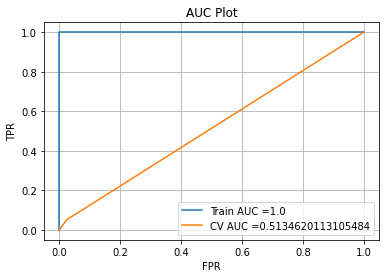

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


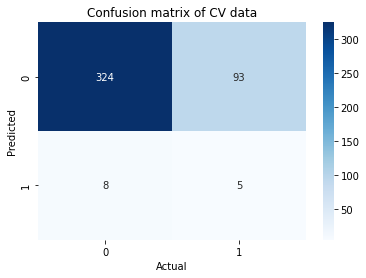

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 61
InscClaimAmtReimbursed_total 88
Race_5 70
only_fraud_physician_count 117
only_fraud_op_physician_count 49
County_0 70
County_2 42
County_3 31
County_4 46
County_5 40
County_8 37
County_9 33
County_10 64
County_11 143
County_12 153
County_13 88
County_14 40
County_15 40
County_16 34
County_21 64
County_38 78
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy  

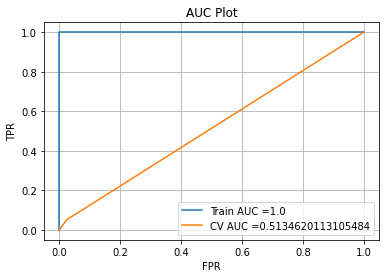

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


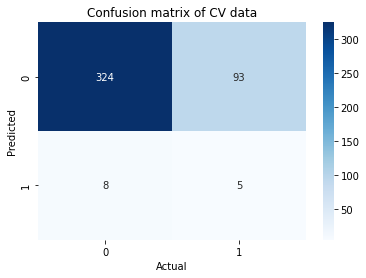

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 61
InscClaimAmtReimbursed_total 88
Race_5 70
only_fraud_physician_count 117
only_fraud_op_physician_count 49
County_0 70
County_2 42
County_3 31
County_4 46
County_5 40
County_8 37
County_9 33
County_10 64
County_11 143
County_12 153
County_13 88
County_14 40
County_15 40
County_16 34
County_21 64
County_38 78
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy  

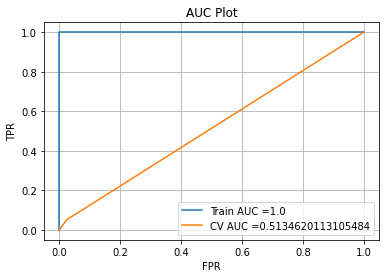

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


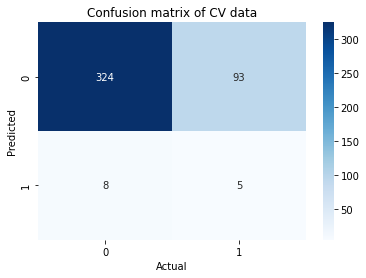

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 61
InscClaimAmtReimbursed_total 88
Race_5 70
only_fraud_physician_count 117
only_fraud_op_physician_count 49
County_0 70
County_2 42
County_3 31
County_4 46
County_5 40
County_8 37
County_9 33
County_10 64
County_11 143
County_12 153
County_13 88
County_14 40
County_15 40
County_16 34
County_21 64
County_38 78
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy  

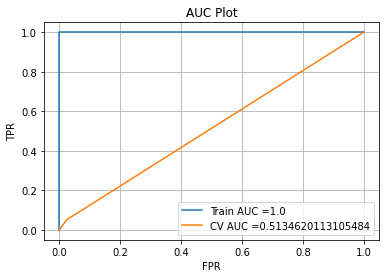

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


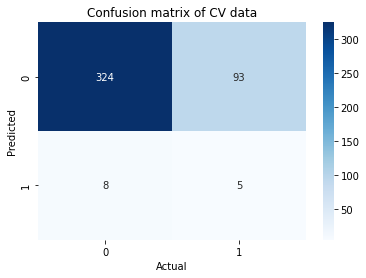

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Race_5 63
only_fraud_physician_count 113
only_fraud_op_physician_count 64
County_11 39
County_12 84
County_13 70
County_21 64
County_38 57
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



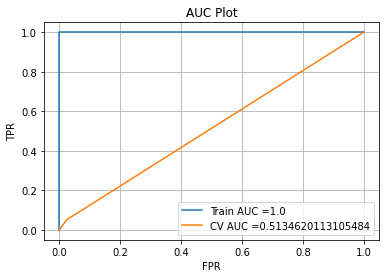

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


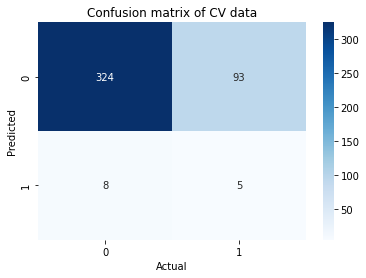

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 97
InscClaimAmtReimbursed_total 124
Race_5 89
only_fraud_physician_count 177
only_fraud_op_physician_count 69
County_0 77
County_2 44
County_4 48
County_5 61
County_7 33
County_8 36
County_9 52
County_10 101
County_11 201
County_12 213
County_13 123
County_14 54
County_15 60
County_16 39
County_17 38
County_21 85
County_23 32
County_29 48
County_34 33
County_35 32
County_37 33
County_38 114
ChronicCond_Depression_1 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.0

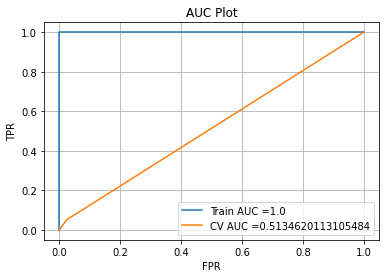

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


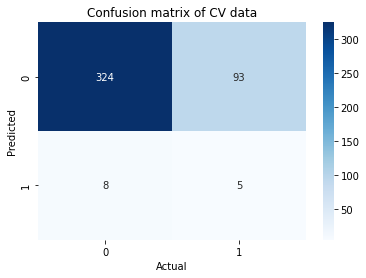

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 98
InscClaimAmtReimbursed_total 120
Race_5 90
only_fraud_physician_count 176
only_fraud_op_physician_count 69
County_0 88
County_1 38
County_2 48
County_3 34
County_4 57
County_5 72
County_6 31
County_8 49
County_9 56
County_10 94
County_11 198
County_12 233
County_13 139
County_14 60
County_15 58
County_16 43
County_17 37
County_21 85
County_29 44
County_31 37
County_34 34
County_35 36
County_37 34
County_38 120
County_39 32
ChronicCond_Depression_1 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

      

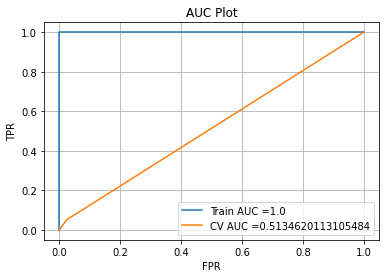

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


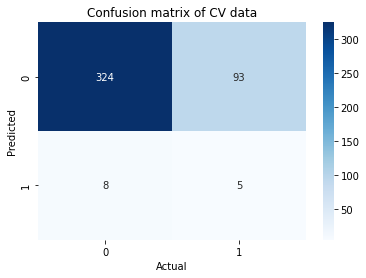

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 98
InscClaimAmtReimbursed_total 120
Race_5 90
only_fraud_physician_count 176
only_fraud_op_physician_count 69
County_0 88
County_1 38
County_2 48
County_3 34
County_4 57
County_5 72
County_6 31
County_8 49
County_9 56
County_10 94
County_11 198
County_12 233
County_13 139
County_14 60
County_15 58
County_16 43
County_17 37
County_21 85
County_29 44
County_31 37
County_34 34
County_35 36
County_37 34
County_38 120
County_39 32
ChronicCond_Depression_1 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

     

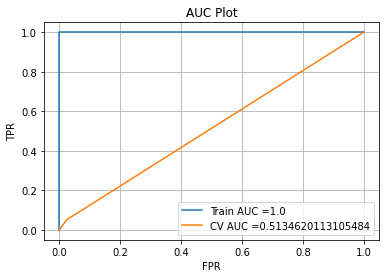

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


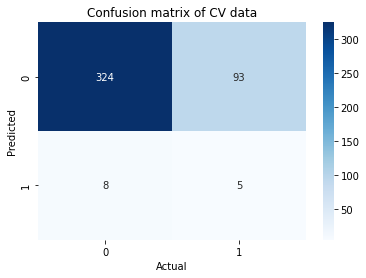

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 98
InscClaimAmtReimbursed_total 120
Race_5 90
only_fraud_physician_count 176
only_fraud_op_physician_count 69
County_0 88
County_1 38
County_2 48
County_3 34
County_4 57
County_5 72
County_6 31
County_8 49
County_9 56
County_10 94
County_11 198
County_12 233
County_13 139
County_14 60
County_15 58
County_16 43
County_17 37
County_21 85
County_29 44
County_31 37
County_34 34
County_35 36
County_37 34
County_38 120
County_39 32
ChronicCond_Depression_1 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

     

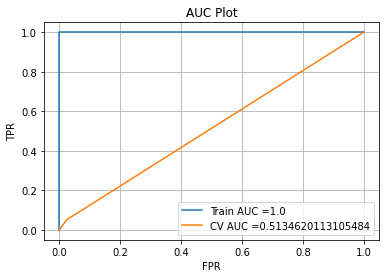

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


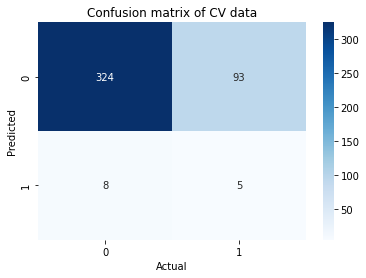

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 98
InscClaimAmtReimbursed_total 120
Race_5 90
only_fraud_physician_count 176
only_fraud_op_physician_count 69
County_0 88
County_1 38
County_2 48
County_3 34
County_4 57
County_5 72
County_6 31
County_8 49
County_9 56
County_10 94
County_11 198
County_12 233
County_13 139
County_14 60
County_15 58
County_16 43
County_17 37
County_21 85
County_29 44
County_31 37
County_34 34
County_35 36
County_37 34
County_38 120
County_39 32
ChronicCond_Depression_1 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

     

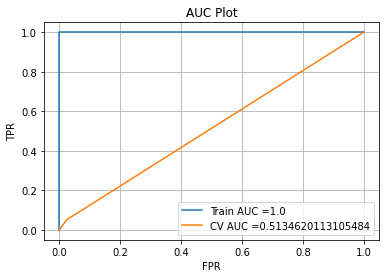

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


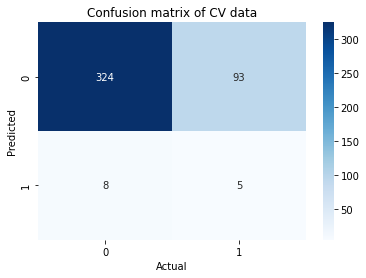

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Race_5 79
only_fraud_physician_count 160
only_fraud_op_physician_count 94
County_10 42
County_11 46
County_12 114
County_13 105
County_21 83
County_38 77
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



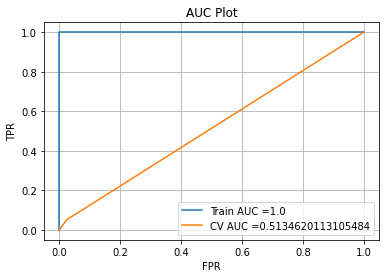

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


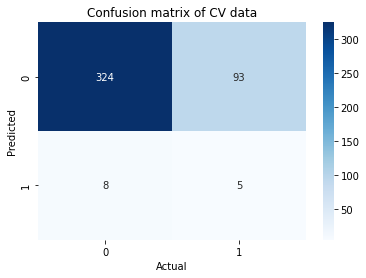

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 135
InscClaimAmtReimbursed_total 183
InscClaimAmtReimbursed_avg 31
Race_5 114
Age 31
only_fraud_physician_count 235
only_fraud_op_physician_count 100
County_0 120
County_1 34
County_2 62
County_4 58
County_5 82
County_7 39
County_8 40
County_9 62
County_10 123
County_11 254
County_12 271
County_13 165
County_14 63
County_15 68
County_16 46
County_17 41
County_21 108
County_23 34
County_29 56
County_30 33
County_31 33
County_34 43
County_35 34
County_37 49
County_38 148
County_39 40
ChronicCond_Depression_1 75
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

   

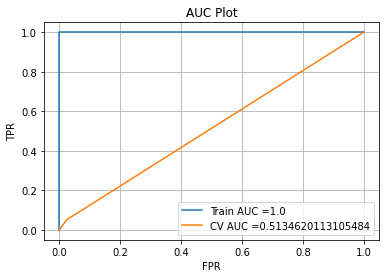

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


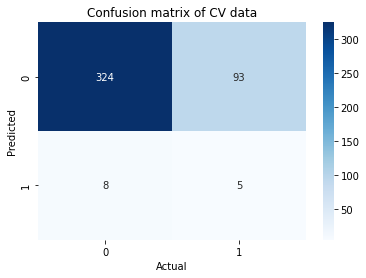

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 145
InscClaimAmtReimbursed_total 186
Race_5 115
only_fraud_physician_count 230
only_fraud_op_physician_count 100
County_0 116
County_1 56
County_2 63
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 57
County_9 70
County_10 112
County_11 241
County_12 290
County_13 183
County_14 70
County_15 65
County_16 53
County_17 42
County_21 107
County_23 32
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 151
County_39 39
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

   

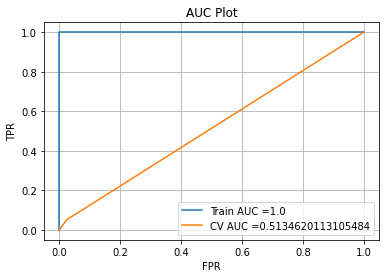

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


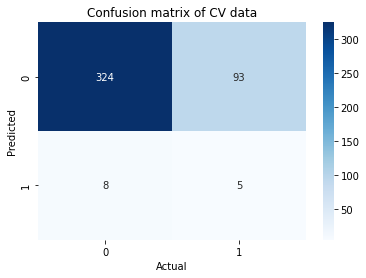

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 145
InscClaimAmtReimbursed_total 186
Race_5 115
only_fraud_physician_count 230
only_fraud_op_physician_count 100
County_0 116
County_1 56
County_2 63
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 57
County_9 70
County_10 112
County_11 241
County_12 290
County_13 183
County_14 70
County_15 65
County_16 53
County_17 42
County_21 107
County_23 32
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 151
County_39 39
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

  

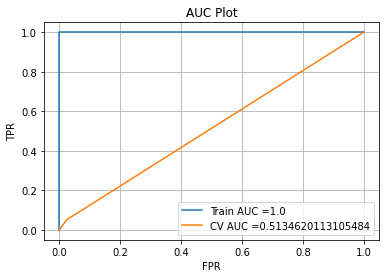

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


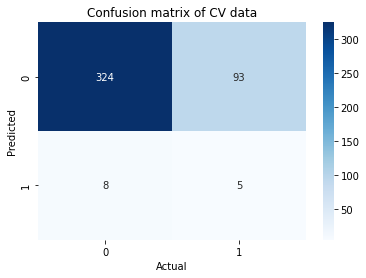

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 145
InscClaimAmtReimbursed_total 186
Race_5 115
only_fraud_physician_count 230
only_fraud_op_physician_count 100
County_0 116
County_1 56
County_2 63
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 57
County_9 70
County_10 112
County_11 241
County_12 290
County_13 183
County_14 70
County_15 65
County_16 53
County_17 42
County_21 107
County_23 32
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 151
County_39 39
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

  

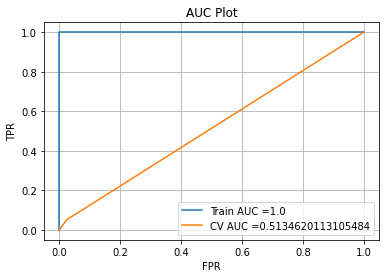

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


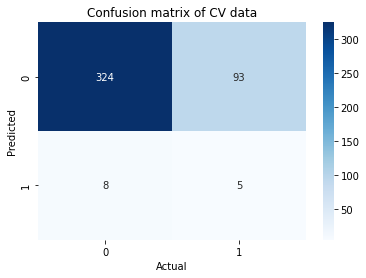

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 145
InscClaimAmtReimbursed_total 186
Race_5 115
only_fraud_physician_count 230
only_fraud_op_physician_count 100
County_0 116
County_1 56
County_2 63
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 57
County_9 70
County_10 112
County_11 241
County_12 290
County_13 183
County_14 70
County_15 65
County_16 53
County_17 42
County_21 107
County_23 32
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 151
County_39 39
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

  

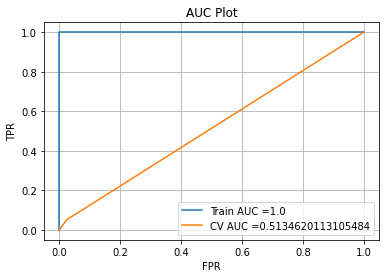

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


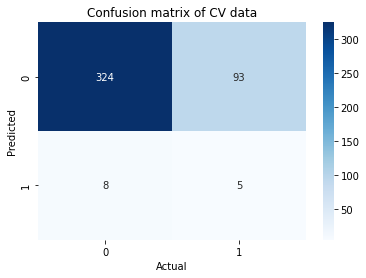

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Race_5 79
only_fraud_physician_count 172
only_fraud_op_physician_count 116
County_10 42
County_11 52
County_12 118
County_13 114
County_21 84
County_38 77
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



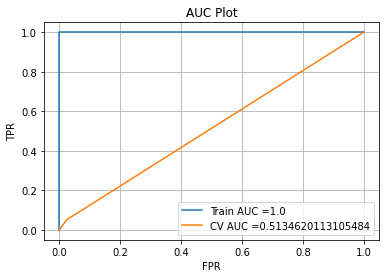

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


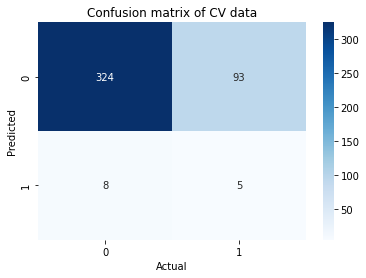

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 145
InscClaimAmtReimbursed_total 192
InscClaimAmtReimbursed_avg 33
Race_5 114
Age 31
only_fraud_physician_count 247
only_fraud_op_physician_count 122
County_0 124
County_1 34
County_2 66
County_4 59
County_5 83
County_7 39
County_8 41
County_9 65
County_10 124
County_11 261
County_12 274
County_13 171
County_14 65
County_15 71
County_16 46
County_17 41
County_21 110
County_23 34
County_25 40
County_29 56
County_30 33
County_31 33
County_34 43
County_35 34
County_37 49
County_38 148
County_39 41
ChronicCond_Depression_1 75
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69  

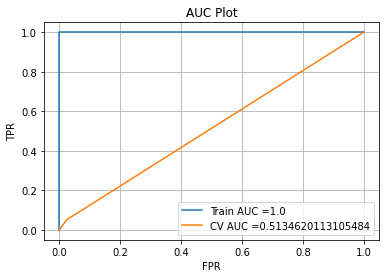

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


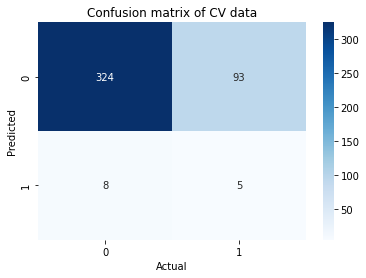

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69  

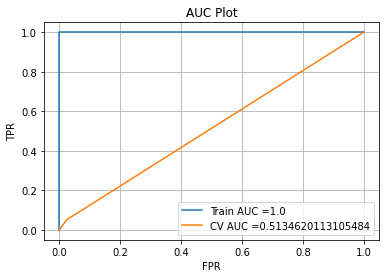

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


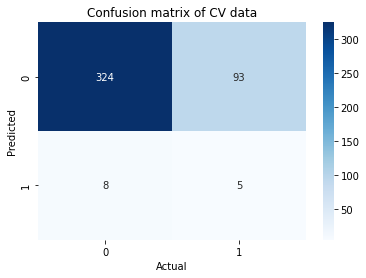

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

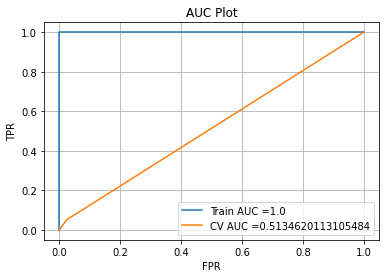

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


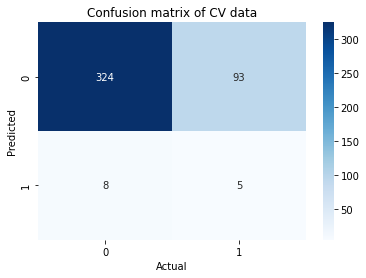

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

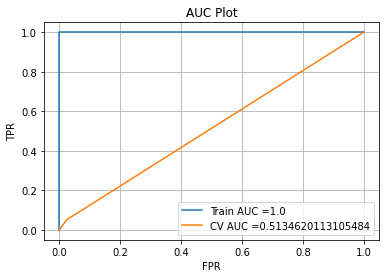

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


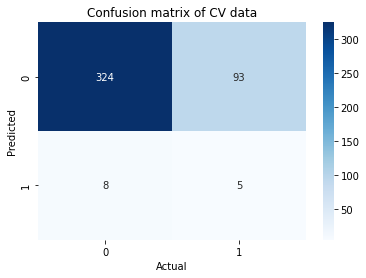

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

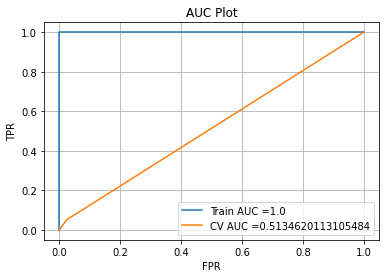

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


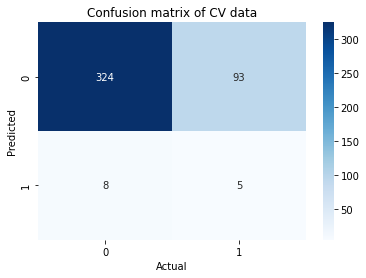

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Race_5 79
only_fraud_physician_count 172
only_fraud_op_physician_count 116
County_10 42
County_11 52
County_12 118
County_13 114
County_21 84
County_38 77
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



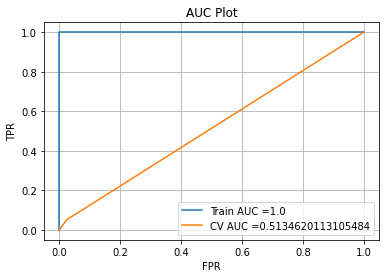

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


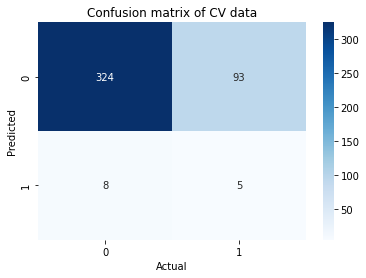

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 145
InscClaimAmtReimbursed_total 192
InscClaimAmtReimbursed_avg 33
Race_5 114
Age 31
only_fraud_physician_count 247
only_fraud_op_physician_count 122
County_0 124
County_1 34
County_2 66
County_4 59
County_5 83
County_7 39
County_8 41
County_9 65
County_10 124
County_11 261
County_12 274
County_13 171
County_14 65
County_15 71
County_16 46
County_17 41
County_21 110
County_23 34
County_25 40
County_29 56
County_30 33
County_31 33
County_34 43
County_35 34
County_37 49
County_38 148
County_39 41
ChronicCond_Depression_1 75
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69  

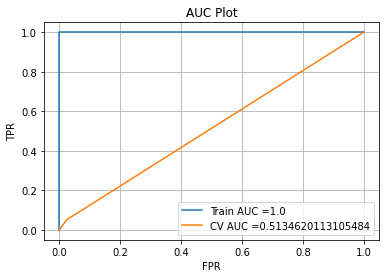

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


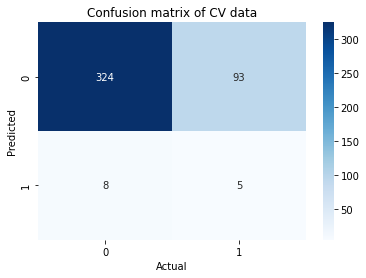

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69  

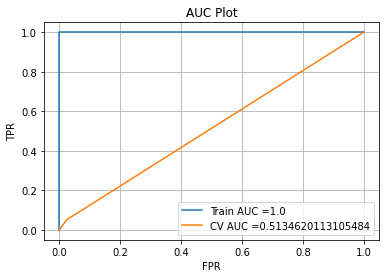

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


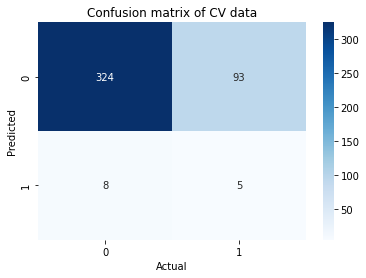

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

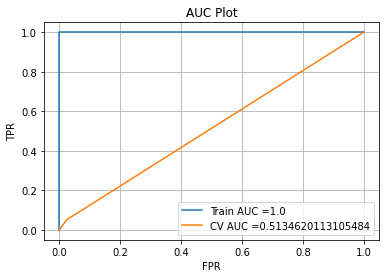

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


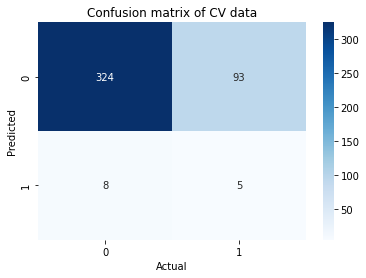

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

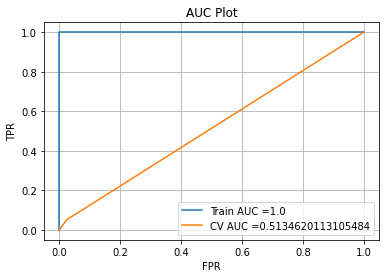

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


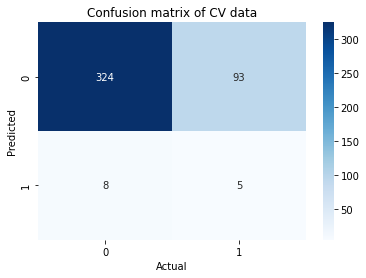

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

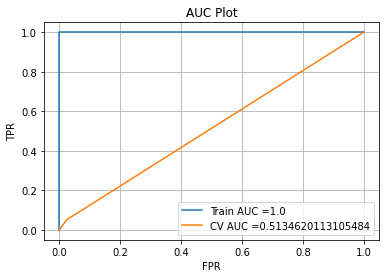

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


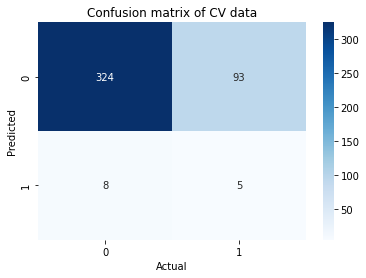

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Race_5 79
only_fraud_physician_count 172
only_fraud_op_physician_count 116
County_10 42
County_11 52
County_12 118
County_13 114
County_21 84
County_38 77
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       888

    accuracy                           1.00      2214
   macro avg       1.00      1.00      1.00      2214
weighted avg       1.00      1.00      1.00      2214



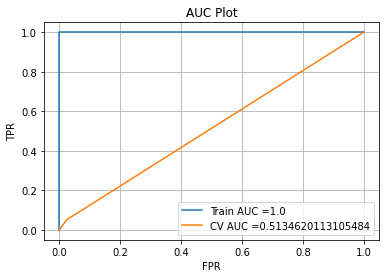

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


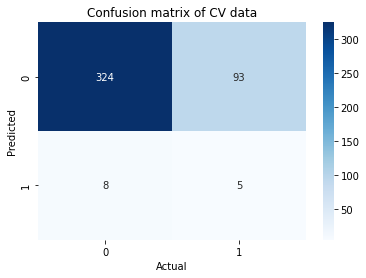

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 145
InscClaimAmtReimbursed_total 192
InscClaimAmtReimbursed_avg 33
Race_5 114
Age 31
only_fraud_physician_count 247
only_fraud_op_physician_count 122
County_0 124
County_1 34
County_2 66
County_4 59
County_5 83
County_7 39
County_8 41
County_9 65
County_10 124
County_11 261
County_12 274
County_13 171
County_14 65
County_15 71
County_16 46
County_17 41
County_21 110
County_23 34
County_25 40
County_29 56
County_30 33
County_31 33
County_34 43
County_35 34
County_37 49
County_38 148
County_39 41
ChronicCond_Depression_1 75
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

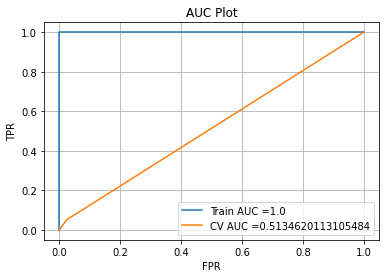

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


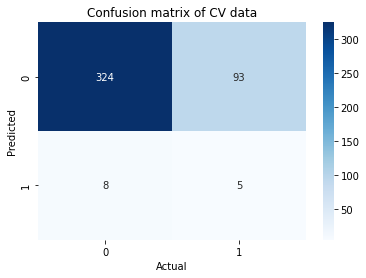

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69 

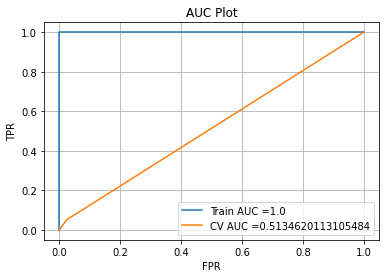

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


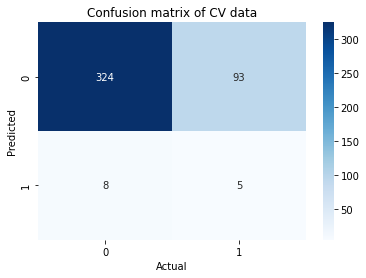

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69

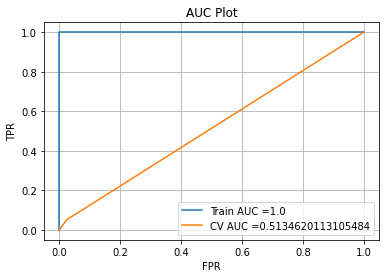

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


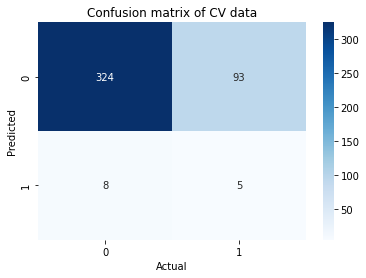

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69

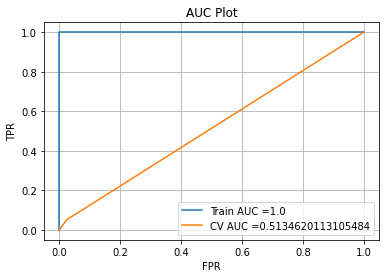

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


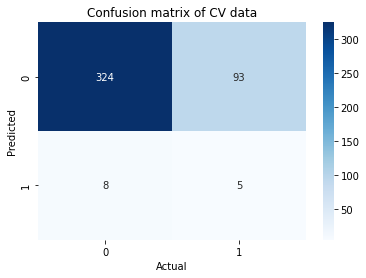

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 160
InscClaimAmtReimbursed_total 192
Race_5 115
only_fraud_physician_count 242
only_fraud_op_physician_count 122
County_0 119
County_1 56
County_2 67
County_3 45
County_4 61
County_5 93
County_6 46
County_7 35
County_8 58
County_9 71
County_10 113
County_11 249
County_12 293
County_13 189
County_14 73
County_15 68
County_16 53
County_17 42
County_21 108
County_23 32
County_25 41
County_26 35
County_29 53
County_30 40
County_31 40
County_34 41
County_35 36
County_37 45
County_38 152
County_39 40
ChronicCond_Depression_1 76
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69

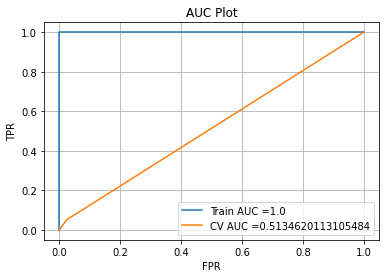

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


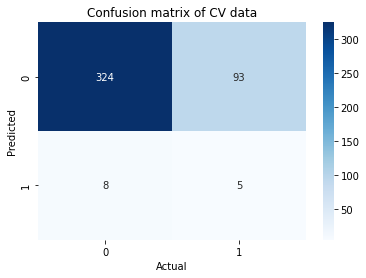

In [66]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_60_40,y_inpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_60_40.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_60_40)
        print(classification_report(y_inpatient_60_40,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Race_5 44
only_fraud_physician_count 43
only_fraud_op_physician_count 43
County_12 64
County_13 108
County_21 43
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



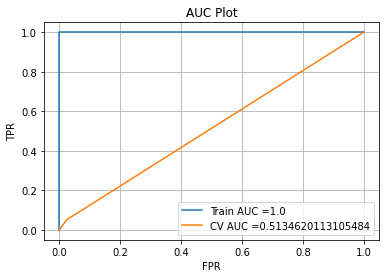

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


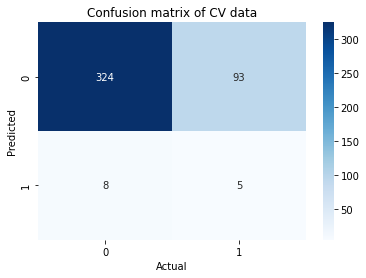

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 80
InscClaimAmtReimbursed_total 72
Race_5 78
only_fraud_physician_count 43
only_fraud_op_physician_count 95
County_0 61
County_10 94
County_11 106
County_12 168
County_13 199
County_14 51
County_21 81
County_38 42
County_47 41
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1

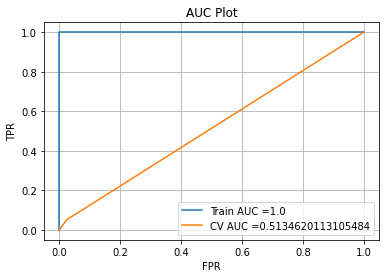

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


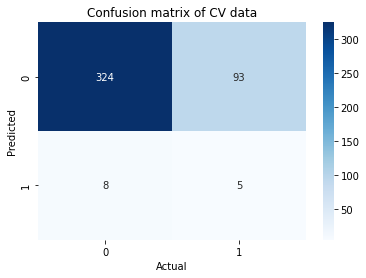

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 88
InscClaimAmtReimbursed_total 50
Race_5 77
only_fraud_physician_count 43
only_fraud_op_physician_count 97
County_0 57
County_9 43
County_10 87
County_11 110
County_12 159
County_13 201
County_14 50
County_21 82
County_23 41
County_27 44
County_35 43
County_38 46
County_47 42
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00

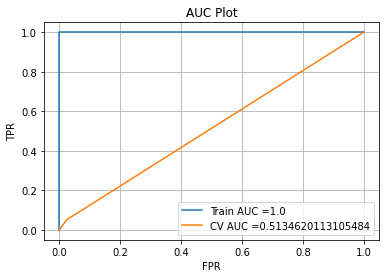

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


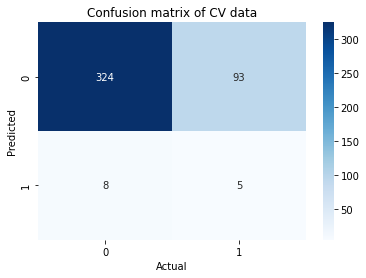

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 88
InscClaimAmtReimbursed_total 50
Race_5 77
only_fraud_physician_count 43
only_fraud_op_physician_count 97
County_0 57
County_9 43
County_10 87
County_11 110
County_12 159
County_13 201
County_14 50
County_21 82
County_23 41
County_27 44
County_35 43
County_38 46
County_47 42
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.0

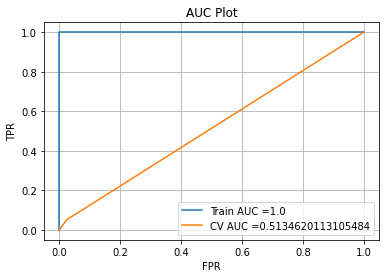

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


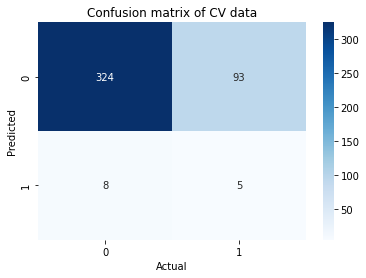

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 88
InscClaimAmtReimbursed_total 50
Race_5 77
only_fraud_physician_count 43
only_fraud_op_physician_count 97
County_0 57
County_9 43
County_10 87
County_11 110
County_12 159
County_13 201
County_14 50
County_21 82
County_23 41
County_27 44
County_35 43
County_38 46
County_47 42
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.0

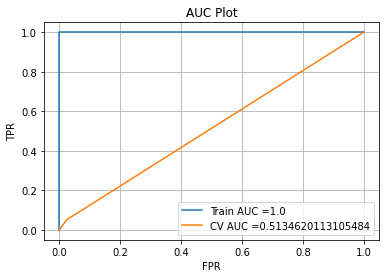

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


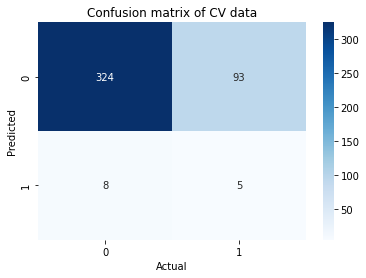

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 88
InscClaimAmtReimbursed_total 50
Race_5 77
only_fraud_physician_count 43
only_fraud_op_physician_count 97
County_0 57
County_9 43
County_10 87
County_11 110
County_12 159
County_13 201
County_14 50
County_21 82
County_23 41
County_27 44
County_35 43
County_38 46
County_47 42
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.0

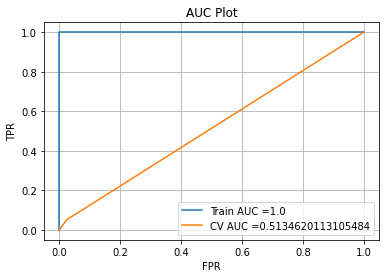

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


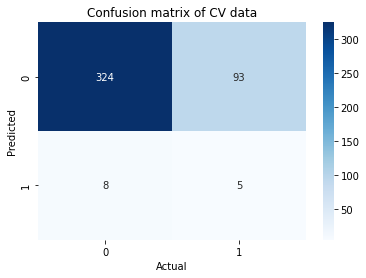

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Race_5 64
only_fraud_physician_count 63
only_fraud_op_physician_count 63
County_12 84
County_13 160
County_21 63
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



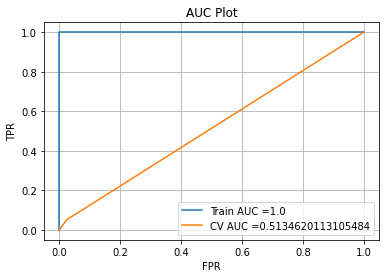

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


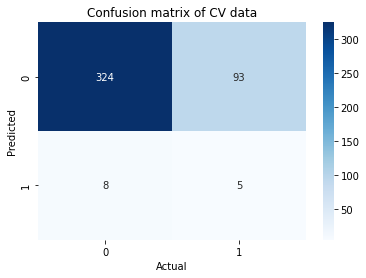

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 112
InscClaimAmtReimbursed_total 91
Race_5 108
only_fraud_physician_count 65
only_fraud_op_physician_count 139
County_0 75
County_1 52
County_6 65
County_8 44
County_9 61
County_10 119
County_11 140
County_12 221
County_13 287
County_14 85
County_16 53
County_21 125
County_23 60
County_27 50
County_30 47
County_35 42
County_38 70
County_47 70
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accura

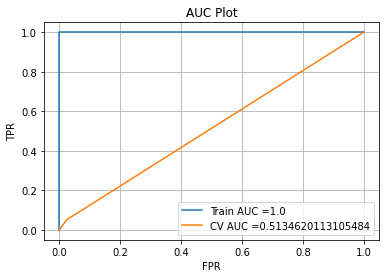

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


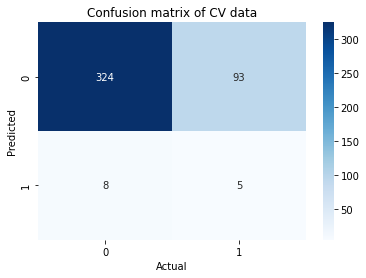

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 117
InscClaimAmtReimbursed_total 65
Race_5 106
only_fraud_physician_count 63
only_fraud_op_physician_count 139
County_0 81
County_6 45
County_8 56
County_9 79
County_10 111
County_11 144
County_12 225
County_13 285
County_14 72
County_16 51
County_21 127
County_23 63
County_26 44
County_27 54
County_30 49
County_35 52
County_38 74
County_47 59
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accur

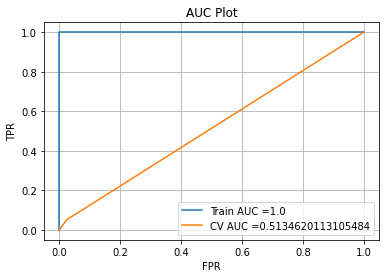

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


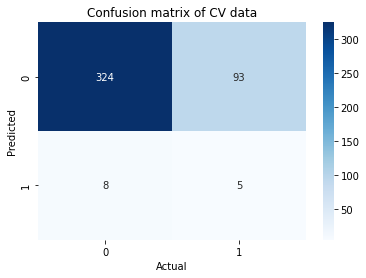

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 117
InscClaimAmtReimbursed_total 65
Race_5 106
only_fraud_physician_count 63
only_fraud_op_physician_count 139
County_0 81
County_6 45
County_8 56
County_9 79
County_10 111
County_11 144
County_12 225
County_13 285
County_14 72
County_16 51
County_21 127
County_23 63
County_26 44
County_27 54
County_30 49
County_35 52
County_38 74
County_47 59
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accu

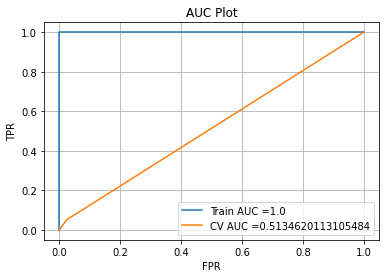

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


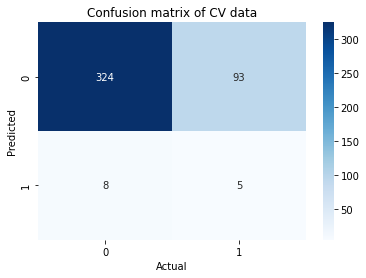

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 117
InscClaimAmtReimbursed_total 65
Race_5 106
only_fraud_physician_count 63
only_fraud_op_physician_count 139
County_0 81
County_6 45
County_8 56
County_9 79
County_10 111
County_11 144
County_12 225
County_13 285
County_14 72
County_16 51
County_21 127
County_23 63
County_26 44
County_27 54
County_30 49
County_35 52
County_38 74
County_47 59
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accu

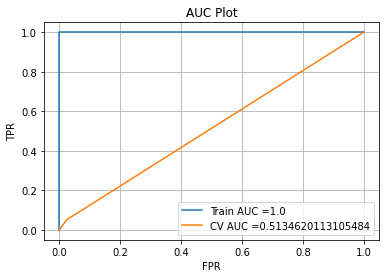

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


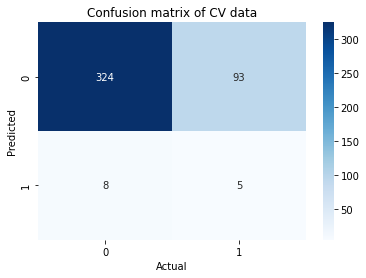

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 117
InscClaimAmtReimbursed_total 65
Race_5 106
only_fraud_physician_count 63
only_fraud_op_physician_count 139
County_0 81
County_6 45
County_8 56
County_9 79
County_10 111
County_11 144
County_12 225
County_13 285
County_14 72
County_16 51
County_21 127
County_23 63
County_26 44
County_27 54
County_30 49
County_35 52
County_38 74
County_47 59
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accu

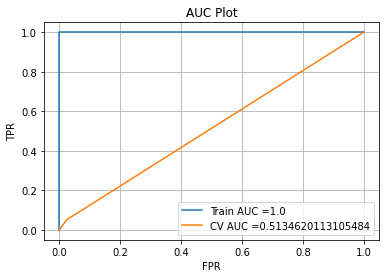

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


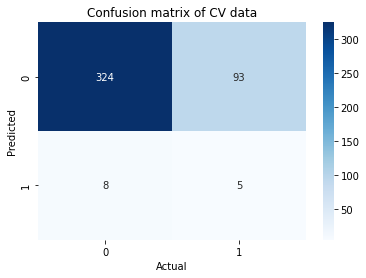

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Race_5 80
only_fraud_physician_count 84
only_fraud_op_physician_count 96
County_10 49
County_12 107
County_13 224
County_21 83
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



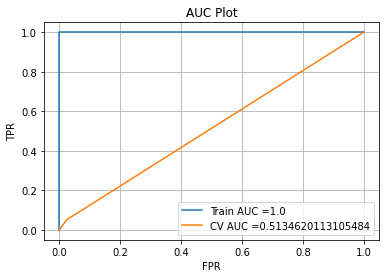

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


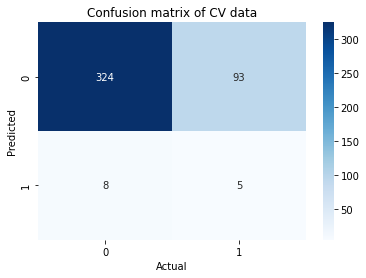

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 176
InscClaimAmtReimbursed_total 133
Race_5 132
only_fraud_physician_count 92
only_fraud_op_physician_count 195
County_0 94
County_1 59
County_3 53
County_5 41
County_6 72
County_8 54
County_9 69
County_10 135
County_11 165
County_12 271
County_13 378
County_14 97
County_16 59
County_21 162
County_23 79
County_25 51
County_27 55
County_30 63
County_35 55
County_38 85
County_47 73
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00   

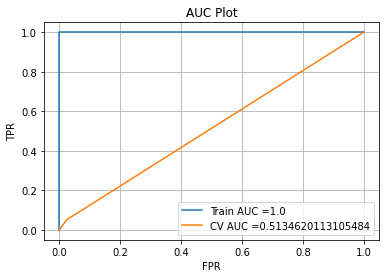

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


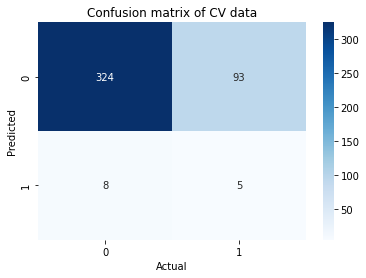

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 168
InscClaimAmtReimbursed_total 114
Race_5 132
only_fraud_physician_count 84
only_fraud_op_physician_count 194
County_0 97
County_3 50
County_5 42
County_6 57
County_8 63
County_9 95
County_10 130
County_11 186
County_12 275
County_13 382
County_14 83
County_16 57
County_21 161
County_23 75
County_25 49
County_26 45
County_27 56
County_30 62
County_35 58
County_38 91
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00  

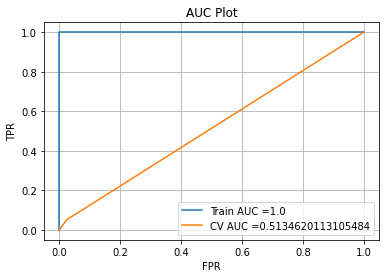

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


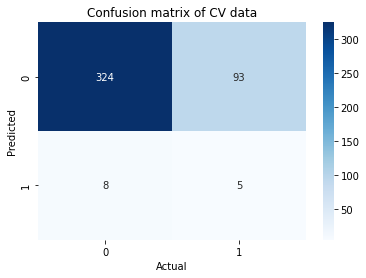

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 168
InscClaimAmtReimbursed_total 114
Race_5 132
only_fraud_physician_count 84
only_fraud_op_physician_count 194
County_0 97
County_3 50
County_5 42
County_6 57
County_8 63
County_9 95
County_10 130
County_11 186
County_12 275
County_13 382
County_14 83
County_16 57
County_21 161
County_23 75
County_25 49
County_26 45
County_27 56
County_30 62
County_35 58
County_38 91
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

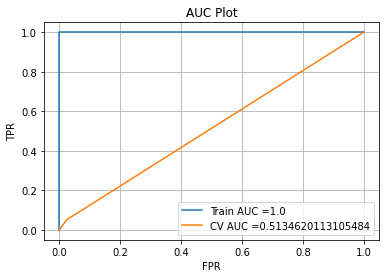

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


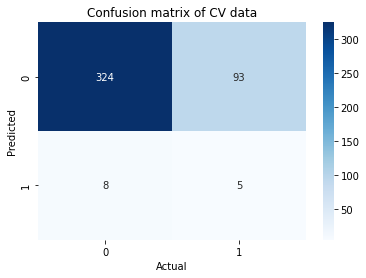

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 168
InscClaimAmtReimbursed_total 114
Race_5 132
only_fraud_physician_count 84
only_fraud_op_physician_count 194
County_0 97
County_3 50
County_5 42
County_6 57
County_8 63
County_9 95
County_10 130
County_11 186
County_12 275
County_13 382
County_14 83
County_16 57
County_21 161
County_23 75
County_25 49
County_26 45
County_27 56
County_30 62
County_35 58
County_38 91
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

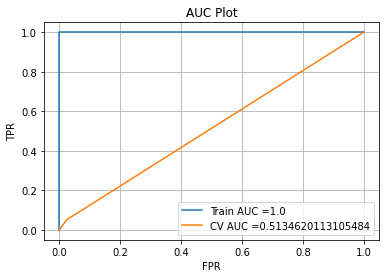

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


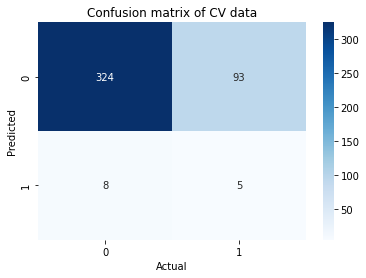

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 168
InscClaimAmtReimbursed_total 114
Race_5 132
only_fraud_physician_count 84
only_fraud_op_physician_count 194
County_0 97
County_3 50
County_5 42
County_6 57
County_8 63
County_9 95
County_10 130
County_11 186
County_12 275
County_13 382
County_14 83
County_16 57
County_21 161
County_23 75
County_25 49
County_26 45
County_27 56
County_30 62
County_35 58
County_38 91
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

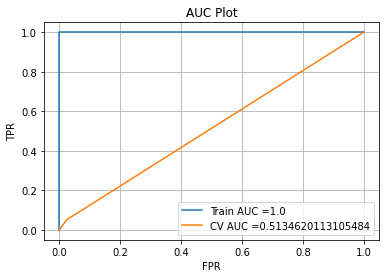

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


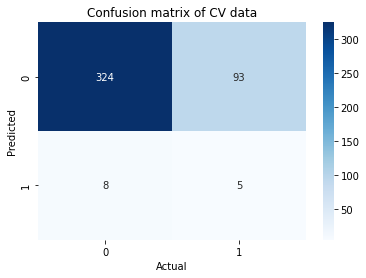

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Race_5 80
only_fraud_physician_count 97
only_fraud_op_physician_count 115
County_10 52
County_12 109
County_13 235
County_21 84
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



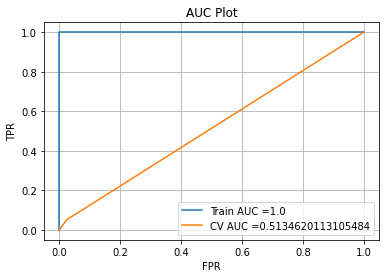

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


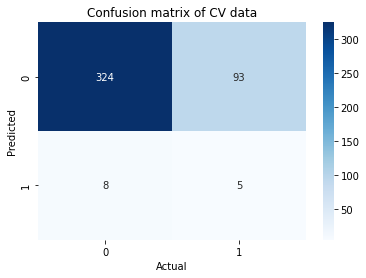

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 185
InscClaimAmtReimbursed_total 140
Race_5 132
only_fraud_physician_count 106
only_fraud_op_physician_count 214
County_0 94
County_1 60
County_3 54
County_5 43
County_6 72
County_8 55
County_9 69
County_10 141
County_11 168
County_12 272
County_13 391
County_14 97
County_16 59
County_21 165
County_23 79
County_25 57
County_27 55
County_30 63
County_35 55
County_38 86
County_47 73
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00  

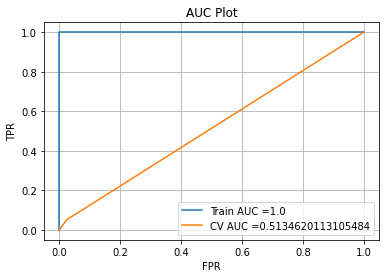

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


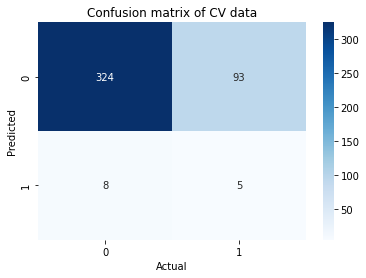

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00  

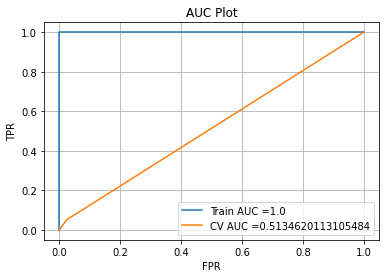

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


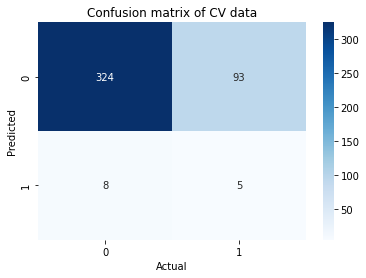

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

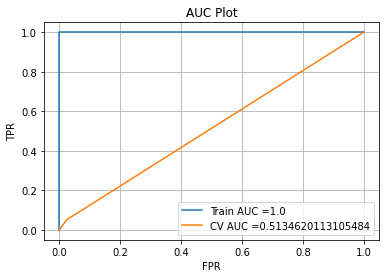

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


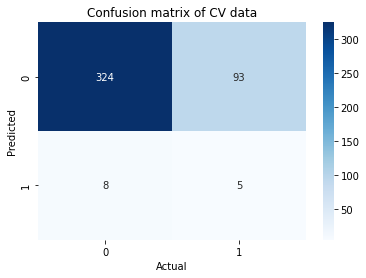

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

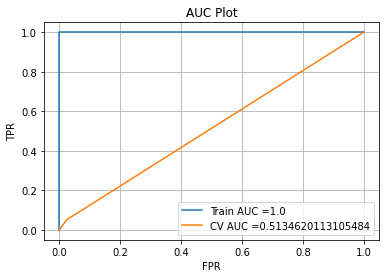

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


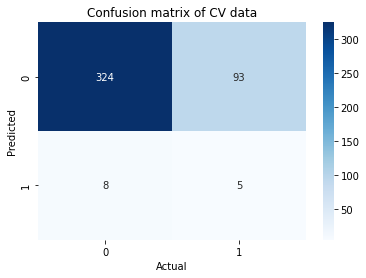

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

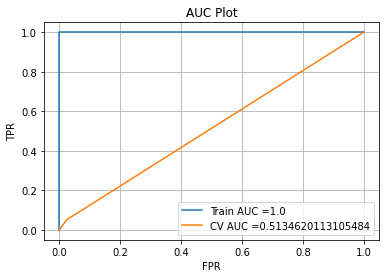

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


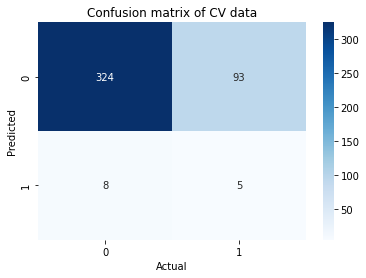

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Race_5 80
only_fraud_physician_count 97
only_fraud_op_physician_count 115
County_10 52
County_12 109
County_13 235
County_21 84
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



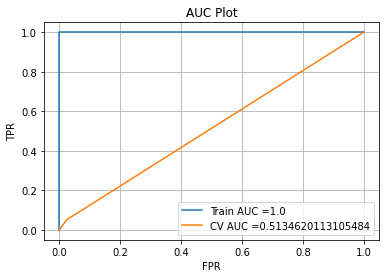

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


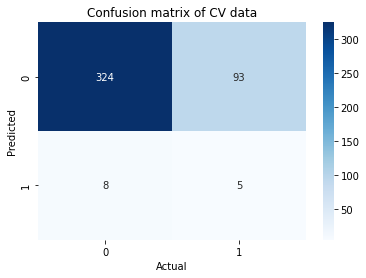

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 185
InscClaimAmtReimbursed_total 140
Race_5 132
only_fraud_physician_count 106
only_fraud_op_physician_count 214
County_0 94
County_1 60
County_3 54
County_5 43
County_6 72
County_8 55
County_9 69
County_10 141
County_11 168
County_12 272
County_13 391
County_14 97
County_16 59
County_21 165
County_23 79
County_25 57
County_27 55
County_30 63
County_35 55
County_38 86
County_47 73
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00  

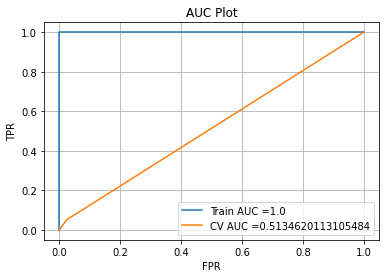

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


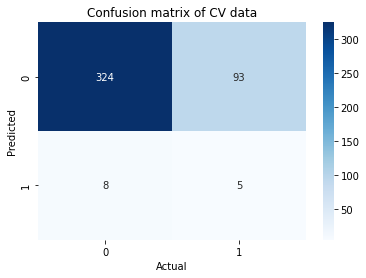

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00  

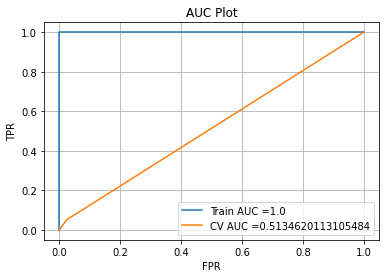

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


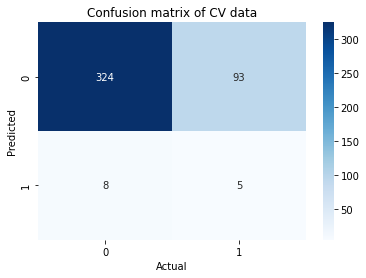

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

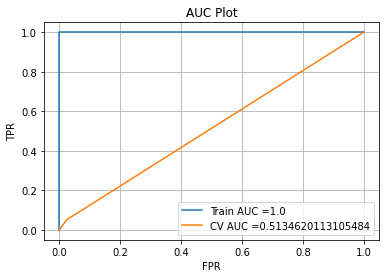

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


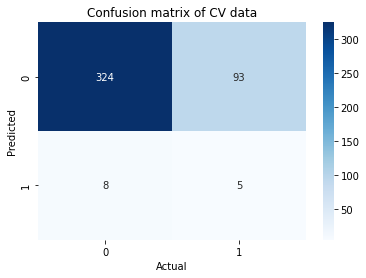

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

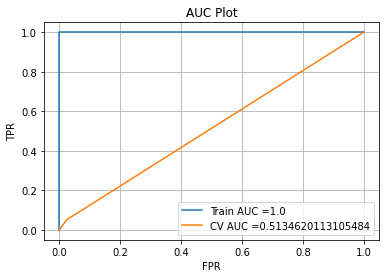

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


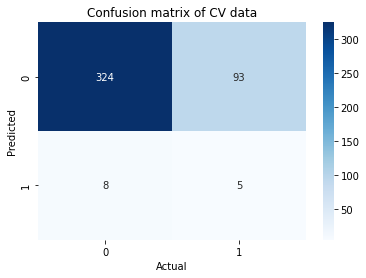

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

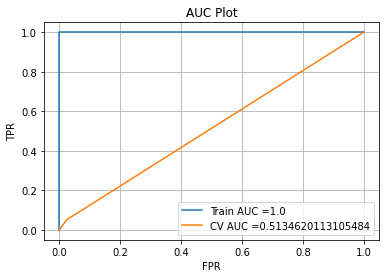

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


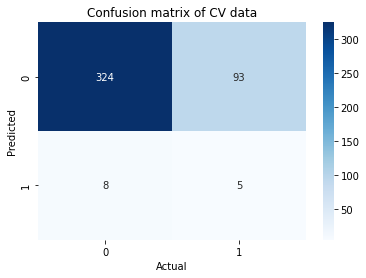

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Race_5 80
only_fraud_physician_count 97
only_fraud_op_physician_count 115
County_10 52
County_12 109
County_13 235
County_21 84
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00      1.00      1.00       570

    accuracy                           1.00      1896
   macro avg       1.00      1.00      1.00      1896
weighted avg       1.00      1.00      1.00      1896



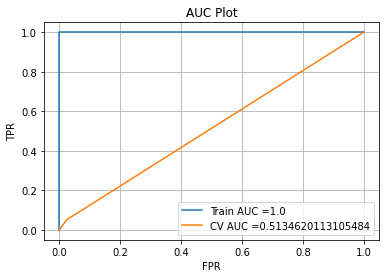

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


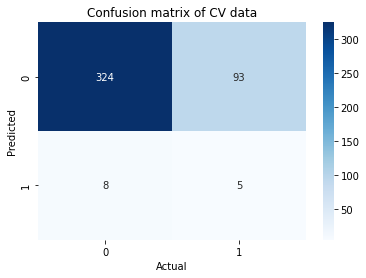

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 185
InscClaimAmtReimbursed_total 140
Race_5 132
only_fraud_physician_count 106
only_fraud_op_physician_count 214
County_0 94
County_1 60
County_3 54
County_5 43
County_6 72
County_8 55
County_9 69
County_10 141
County_11 168
County_12 272
County_13 391
County_14 97
County_16 59
County_21 165
County_23 79
County_25 57
County_27 55
County_30 63
County_35 55
County_38 86
County_47 73
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

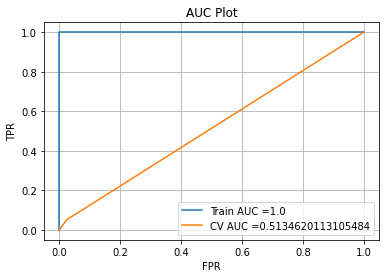

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


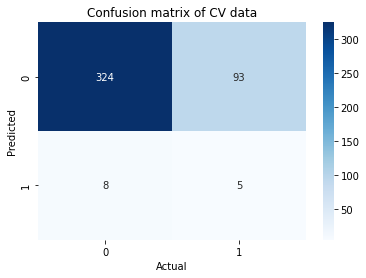

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00 

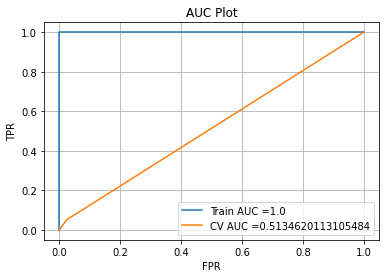

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


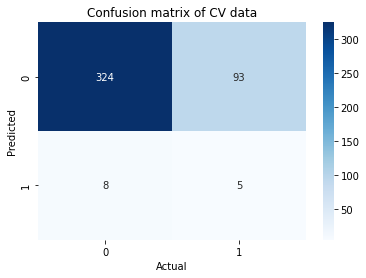

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00

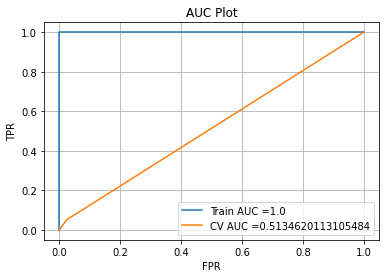

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


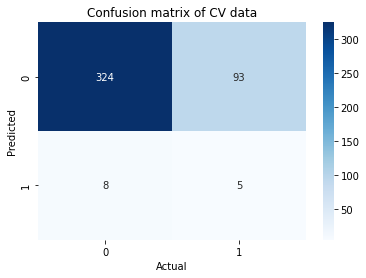

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00

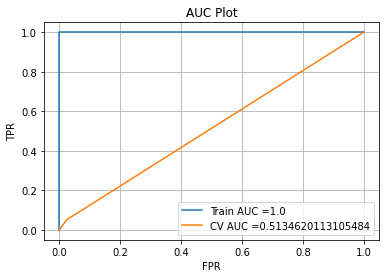

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


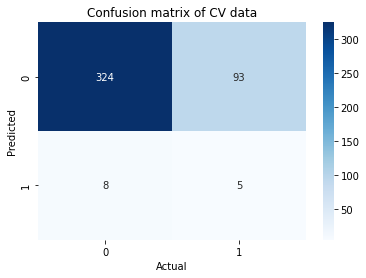

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 181
InscClaimAmtReimbursed_total 119
Race_5 132
only_fraud_physician_count 98
only_fraud_op_physician_count 213
County_0 98
County_3 51
County_5 44
County_6 57
County_8 64
County_9 95
County_10 134
County_11 189
County_12 277
County_13 395
County_14 83
County_16 57
County_21 163
County_23 75
County_25 55
County_26 45
County_27 56
County_30 62
County_35 58
County_38 92
County_47 62
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.38      0.05      0.09        98

    accuracy                           0.77       430
   macro avg       0.58      0.51      0.48       430
weighted avg       0.69      0.77      0.69       430

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1326
           1       1.00

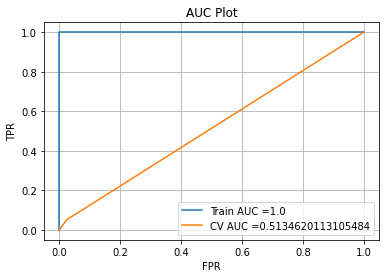

Cross Validation
FNR:0.9489795918367347 ,TPR:0.05102040816326531 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


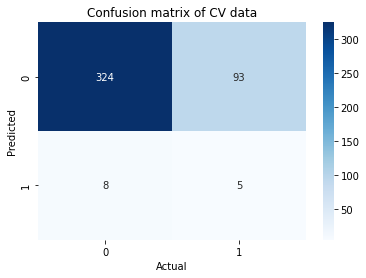

In [67]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_70_30,y_inpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_70_30.columns),clf.feature_importances_):
            if j > 40:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_70_30)
        print(classification_report(y_inpatient_70_30,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Random Forest</h2>

Original Distribution

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.14732303210865164
only_fraud_procedure_code_count 0.055054017102323646
only_fraud_physician_count 0.20009489522576282
only_fraud_op_physician_count 0.23844012638792247
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.66       430
weighted avg       0.81      0.82      0.78       430



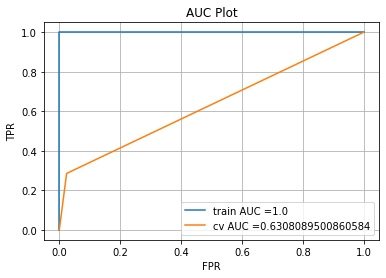

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


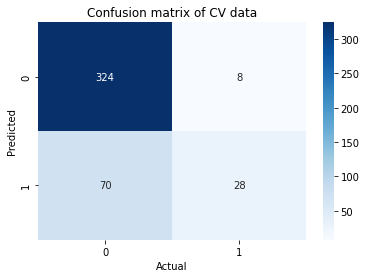

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.1312541096655157
only_fraud_procedure_code_count 0.06546287189822098
only_fraud_physician_count 0.25050630020582515
only_fraud_op_physician_count 0.20554045505590376
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.77      0.24      0.37        98

    accuracy                           0.81       430
   macro avg       0.79      0.61      0.63       430
weighted avg       0.81      0.81      0.77       430



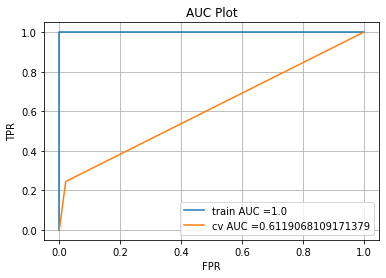

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


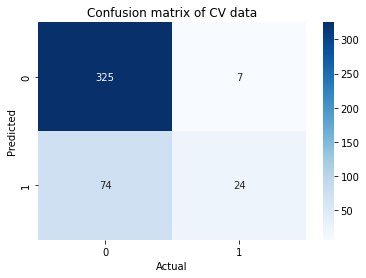

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.14485242889532354
only_fraud_procedure_code_count 0.08428339193804728
only_fraud_physician_count 0.23446048423739582
only_fraud_op_physician_count 0.17838607429713194
              precision    recall  f1-score   support

           0       0.84      0.92      0.87       332
           1       0.58      0.40      0.47        98

    accuracy                           0.80       430
   macro avg       0.71      0.66      0.67       430
weighted avg       0.78      0.80      0.78       430



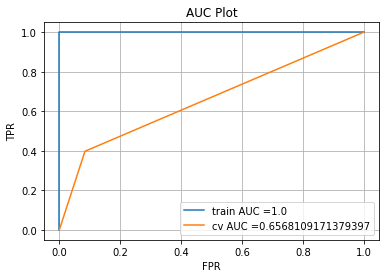

Cross Validation
FNR:0.6020408163265306 ,TPR:0.3979591836734694 ,FPR:0.08433734939759036 ,TNR:0.9156626506024096 


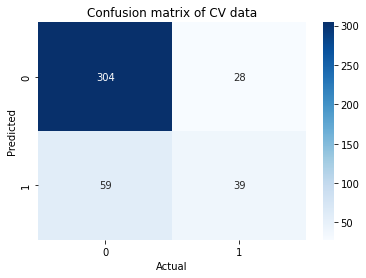

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.1211293523834718
only_fraud_procedure_code_count 0.09128377798490037
only_fraud_physician_count 0.19372131258013214
only_fraud_op_physician_count 0.2218673682667602
              precision    recall  f1-score   support

           0       0.83      0.95      0.88       332
           1       0.65      0.35      0.45        98

    accuracy                           0.81       430
   macro avg       0.74      0.65      0.67       430
weighted avg       0.79      0.81      0.79       430



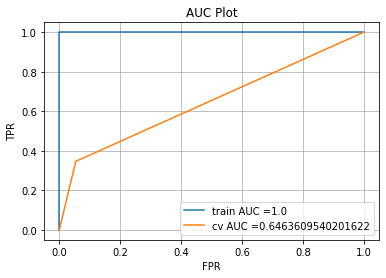

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.05421686746987952 ,TNR:0.9457831325301205 


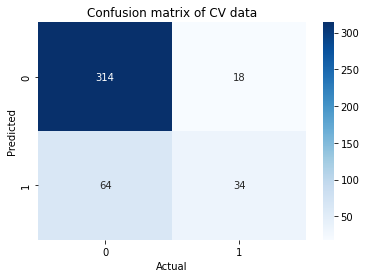

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.15745907396989045
only_fraud_procedure_code_count 0.0759922462487574
only_fraud_physician_count 0.18963127039015645
only_fraud_op_physician_count 0.22322333460814167
              precision    recall  f1-score   support

           0       0.83      0.93      0.88       332
           1       0.62      0.37      0.46        98

    accuracy                           0.80       430
   macro avg       0.73      0.65      0.67       430
weighted avg       0.78      0.80      0.79       430



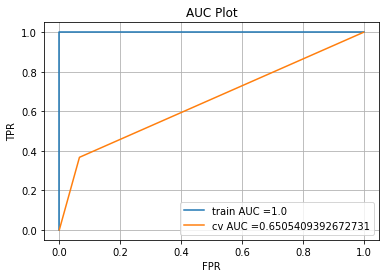

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.06626506024096386 ,TNR:0.9337349397590361 


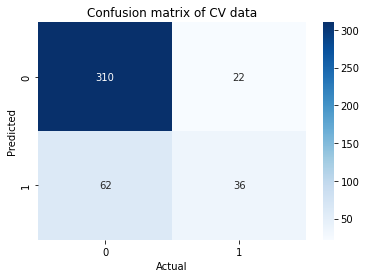

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.12521560007002028
only_fraud_physician_count 0.2049985753709315
only_fraud_op_physician_count 0.21445886839902395
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.77      0.28      0.41        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.65       430
weighted avg       0.81      0.82      0.78       430



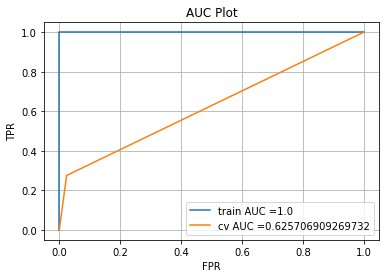

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


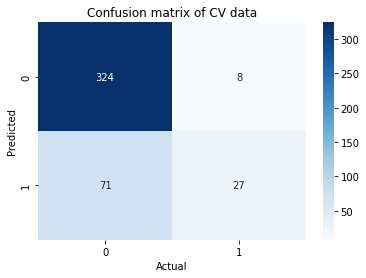

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.14050691999431875
only_fraud_procedure_code_count 0.05172928205318038
only_fraud_physician_count 0.24055180053940553
only_fraud_op_physician_count 0.20170906238931074
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.77      0.28      0.41        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.65       430
weighted avg       0.81      0.82      0.78       430



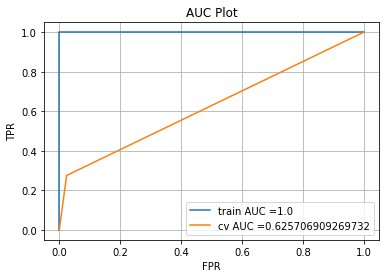

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


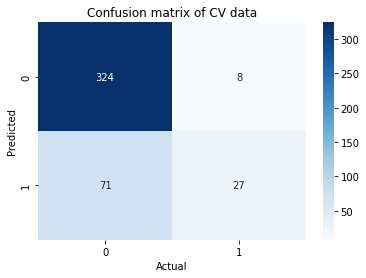

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.13544010451436234
only_fraud_procedure_code_count 0.058677700624436516
only_fraud_physician_count 0.23568530975038265
only_fraud_op_physician_count 0.21389282336702073
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.83      0.62      0.64       430
weighted avg       0.82      0.82      0.78       430



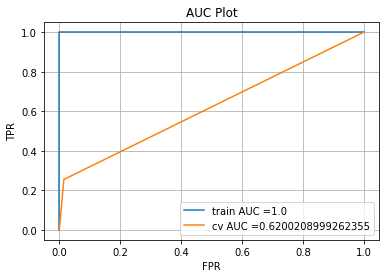

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


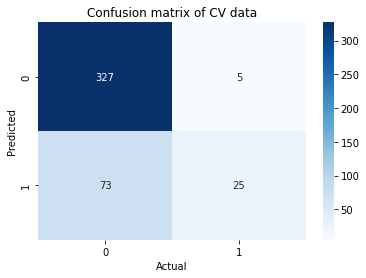

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.117752073187384
only_fraud_procedure_code_count 0.05776595739175723
only_fraud_physician_count 0.21690431053462908
only_fraud_op_physician_count 0.24643600873786942
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.82      0.61      0.64       430
weighted avg       0.82      0.82      0.78       430



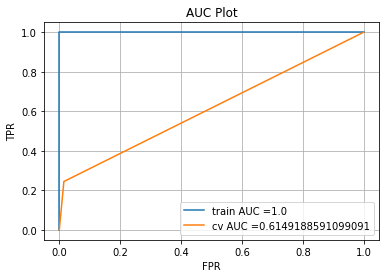

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


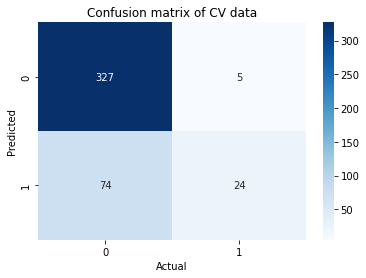

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.12384758179080871
only_fraud_procedure_code_count 0.06073629638228561
only_fraud_physician_count 0.27090460532750327
only_fraud_op_physician_count 0.22065160029470415
              precision    recall  f1-score   support

           0       0.82      0.99      0.89       332
           1       0.86      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.84      0.62      0.64       430
weighted avg       0.83      0.82      0.78       430



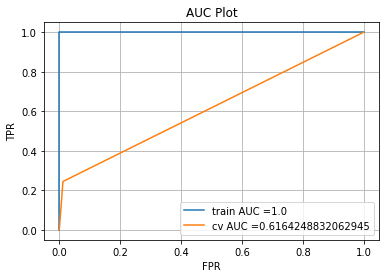

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


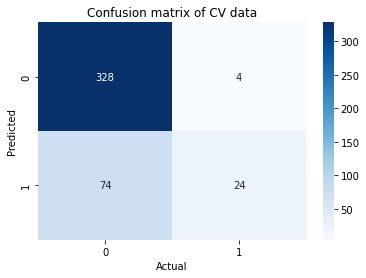

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.14130154135757025
only_fraud_procedure_code_count 0.07272410362945621
only_fraud_physician_count 0.23318599421952108
only_fraud_op_physician_count 0.19208484836045728
              precision    recall  f1-score   support

           0       0.83      0.92      0.87       332
           1       0.57      0.38      0.45        98

    accuracy                           0.79       430
   macro avg       0.70      0.65      0.66       430
weighted avg       0.77      0.79      0.78       430



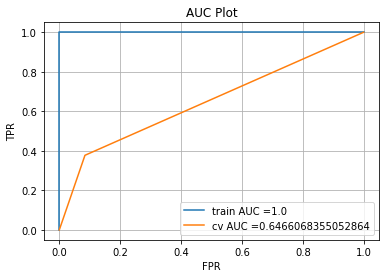

Cross Validation
FNR:0.6224489795918368 ,TPR:0.37755102040816324 ,FPR:0.08433734939759036 ,TNR:0.9156626506024096 


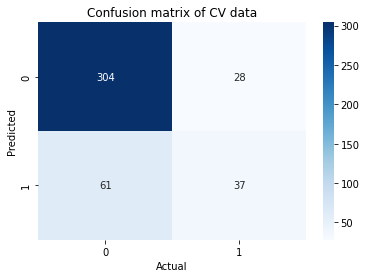

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.11464411191481248
only_fraud_physician_count 0.2363986093606505
only_fraud_op_physician_count 0.21781546355388431
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.84      0.28      0.42        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.66       430
weighted avg       0.83      0.82      0.79       430



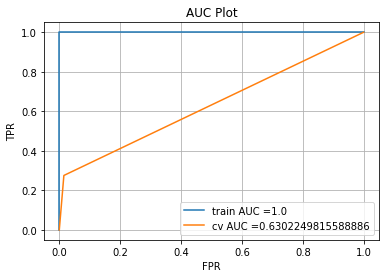

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


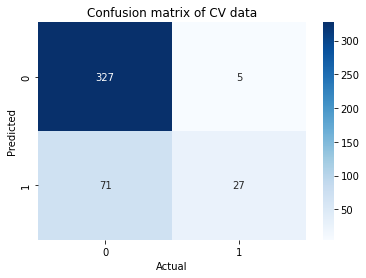

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.12686431035820098
only_fraud_procedure_code_count 0.05860552202279066
only_fraud_physician_count 0.23199841062666582
only_fraud_op_physician_count 0.20508482519866805
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.83      0.30      0.44        98

    accuracy                           0.83       430
   macro avg       0.83      0.64      0.67       430
weighted avg       0.83      0.83      0.79       430



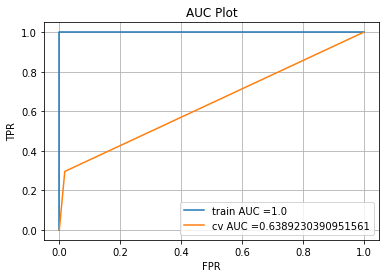

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


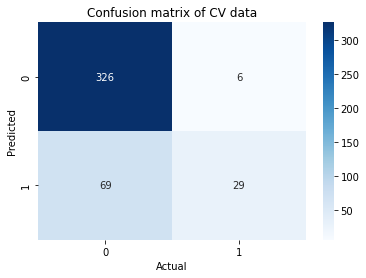

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.12974788276032703
only_fraud_procedure_code_count 0.07145361311001469
only_fraud_physician_count 0.23820805606239454
only_fraud_op_physician_count 0.19695357964838042
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.80      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.81      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



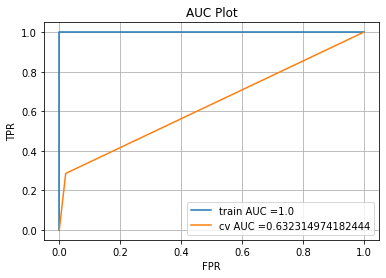

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


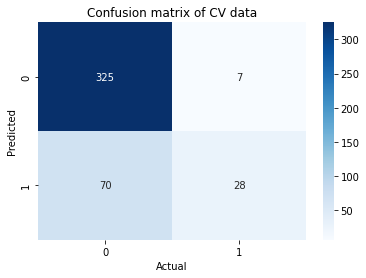

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.14029363541831363
only_fraud_procedure_code_count 0.05890489638615901
only_fraud_physician_count 0.2347866414252218
only_fraud_op_physician_count 0.18843396665893522
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       332
           1       0.74      0.26      0.38        98

    accuracy                           0.81       430
   macro avg       0.78      0.61      0.63       430
weighted avg       0.80      0.81      0.77       430



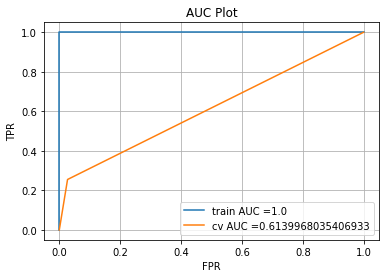

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


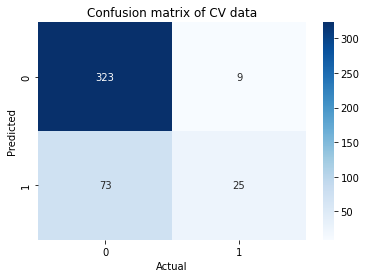

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.12199508490888407
only_fraud_procedure_code_count 0.058087418934679856
only_fraud_physician_count 0.20595978765655368
only_fraud_op_physician_count 0.21965779610143107
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.79      0.32      0.45        98

    accuracy                           0.83       430
   macro avg       0.81      0.65      0.67       430
weighted avg       0.82      0.83      0.80       430



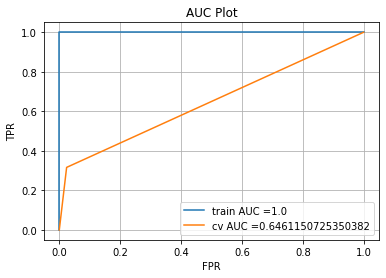

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


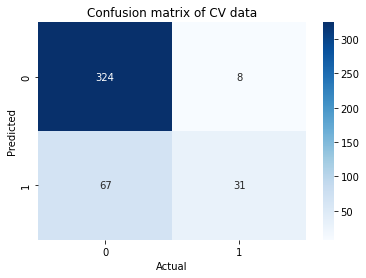

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.1307018919259516
only_fraud_procedure_code_count 0.06359512724813714
only_fraud_physician_count 0.20045510013120618
only_fraud_op_physician_count 0.22796356517383065
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.86      0.31      0.45        98

    accuracy                           0.83       430
   macro avg       0.84      0.65      0.68       430
weighted avg       0.83      0.83      0.80       430



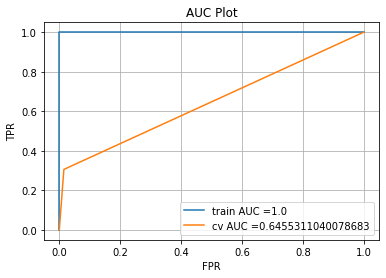

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


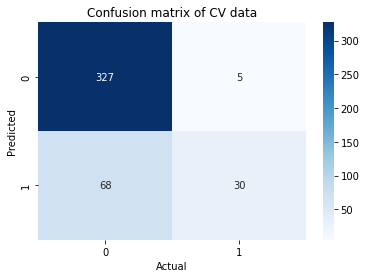

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.1264006352367623
only_fraud_procedure_code_count 0.06638339499938825
only_fraud_physician_count 0.2314673551865342
only_fraud_op_physician_count 0.21184616867802838
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.79      0.31      0.44        98

    accuracy                           0.82       430
   macro avg       0.81      0.64      0.67       430
weighted avg       0.82      0.82      0.79       430



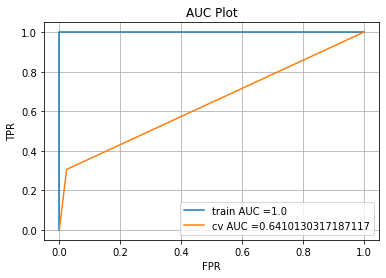

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


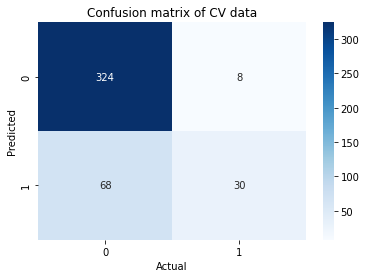

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.1487052222944284
only_fraud_procedure_code_count 0.07117186299501432
only_fraud_physician_count 0.2079236237502876
only_fraud_op_physician_count 0.21636174480263057
              precision    recall  f1-score   support

           0       0.83      0.95      0.89       332
           1       0.67      0.36      0.47        98

    accuracy                           0.81       430
   macro avg       0.75      0.65      0.68       430
weighted avg       0.80      0.81      0.79       430



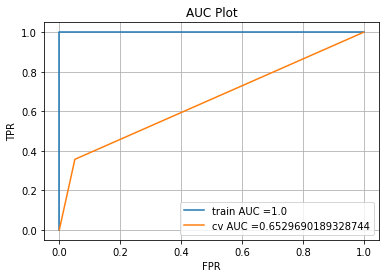

Cross Validation
FNR:0.6428571428571429 ,TPR:0.35714285714285715 ,FPR:0.05120481927710843 ,TNR:0.9487951807228916 


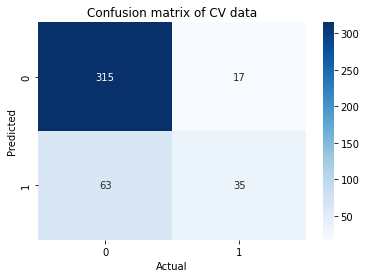

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.12218919570131903
only_fraud_procedure_code_count 0.06887368891156138
only_fraud_physician_count 0.18617856092704635
only_fraud_op_physician_count 0.23986708778345797
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.83      0.30      0.44        98

    accuracy                           0.83       430
   macro avg       0.83      0.64      0.67       430
weighted avg       0.83      0.83      0.79       430



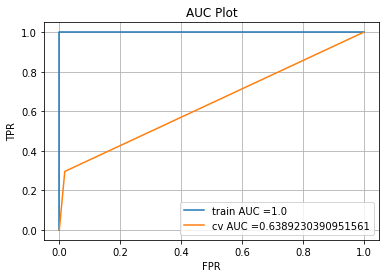

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


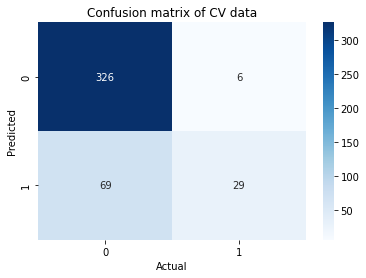

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.12987330968973196
only_fraud_procedure_code_count 0.055236465554663196
only_fraud_physician_count 0.22359009511472064
only_fraud_op_physician_count 0.20944662588815313
              precision    recall  f1-score   support

           0       0.82      0.99      0.89       332
           1       0.86      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.84      0.62      0.64       430
weighted avg       0.83      0.82      0.78       430



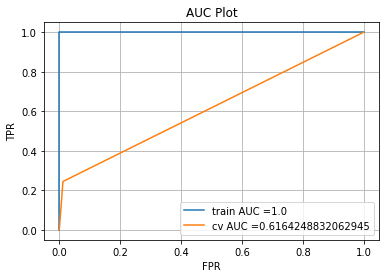

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


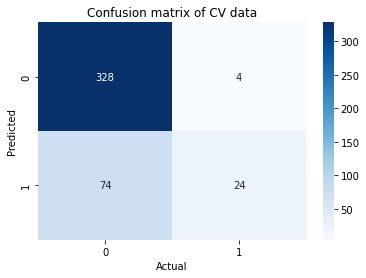

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.12440113664538678
only_fraud_procedure_code_count 0.06345351881954846
only_fraud_physician_count 0.22837285936149027
only_fraud_op_physician_count 0.2183498709922743
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.82      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



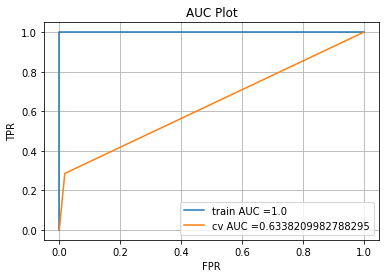

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


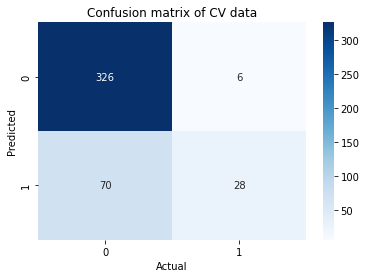

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.13291036660141586
only_fraud_procedure_code_count 0.07075951657219849
only_fraud_physician_count 0.21526481773264391
only_fraud_op_physician_count 0.20540444181123704
              precision    recall  f1-score   support

           0       0.83      0.96      0.89       332
           1       0.70      0.33      0.44        98

    accuracy                           0.81       430
   macro avg       0.76      0.64      0.67       430
weighted avg       0.80      0.81      0.79       430



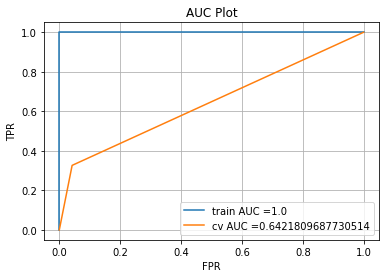

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


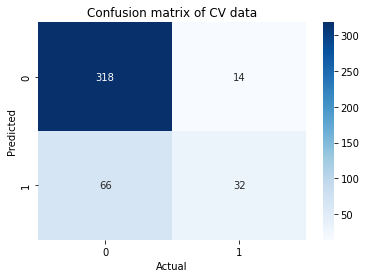

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.13474874296289474
only_fraud_procedure_code_count 0.06658477936223799
only_fraud_physician_count 0.2155868863568917
only_fraud_op_physician_count 0.2058058440680832
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.75      0.34      0.46        98

    accuracy                           0.82       430
   macro avg       0.79      0.65      0.68       430
weighted avg       0.81      0.82      0.80       430



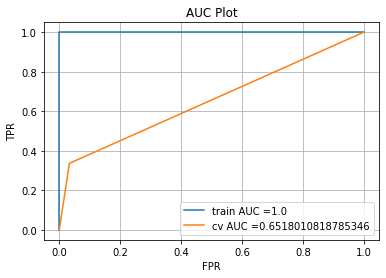

Cross Validation
FNR:0.6632653061224489 ,TPR:0.336734693877551 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


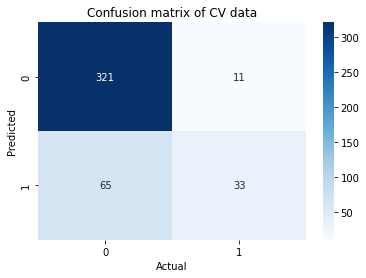

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.1343300607757187
only_fraud_procedure_code_count 0.0736337349819034
only_fraud_physician_count 0.22885814334915727
only_fraud_op_physician_count 0.20191443062646863
              precision    recall  f1-score   support

           0       0.83      0.96      0.89       332
           1       0.70      0.34      0.46        98

    accuracy                           0.82       430
   macro avg       0.77      0.65      0.67       430
weighted avg       0.80      0.82      0.79       430



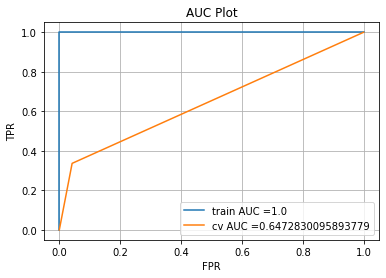

Cross Validation
FNR:0.6632653061224489 ,TPR:0.336734693877551 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


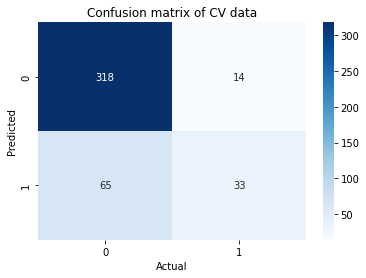

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.12846222741353305
only_fraud_procedure_code_count 0.06764841132841014
only_fraud_physician_count 0.22102965504947308
only_fraud_op_physician_count 0.20794159668345766
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.76      0.33      0.46        98

    accuracy                           0.82       430
   macro avg       0.80      0.65      0.68       430
weighted avg       0.81      0.82      0.79       430



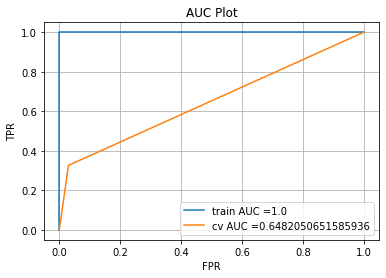

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.030120481927710843 ,TNR:0.9698795180722891 


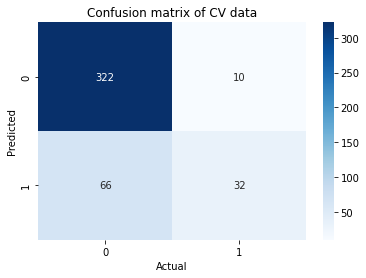

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.12525016424053198
only_fraud_procedure_code_count 0.06230551192793292
only_fraud_physician_count 0.21635960449864677
only_fraud_op_physician_count 0.22322054634293884
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.80      0.33      0.46        98

    accuracy                           0.83       430
   macro avg       0.82      0.65      0.68       430
weighted avg       0.82      0.83      0.80       430



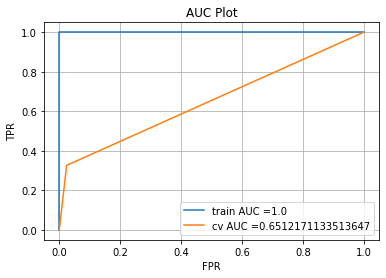

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


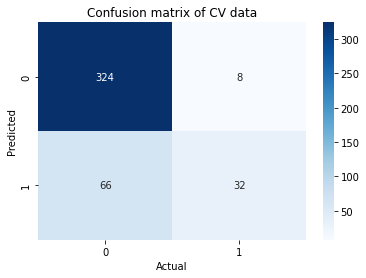

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.1304731062843196
only_fraud_procedure_code_count 0.06549599708666687
only_fraud_physician_count 0.2215824690315224
only_fraud_op_physician_count 0.22474865083535678
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.77      0.24      0.37        98

    accuracy                           0.81       430
   macro avg       0.79      0.61      0.63       430
weighted avg       0.81      0.81      0.77       430



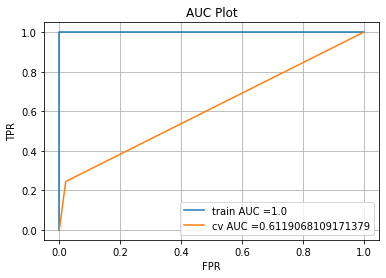

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


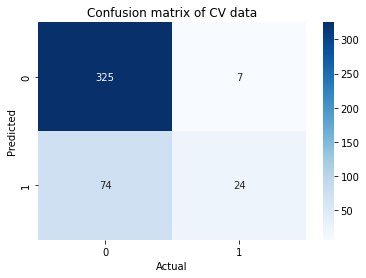

In [68]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_train_inpatient,y_train_inpatient.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_inpatient.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_train_inpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="cv AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.08039159057845695
only_fraud_procedure_code_count 0.07122254857200477
only_fraud_physician_count 0.24600433524393786
only_fraud_op_physician_count 0.22461728978704287
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.80      0.20      0.33        98

    accuracy                           0.81       430
   macro avg       0.80      0.59      0.61       430
weighted avg       0.81      0.81      0.76       430



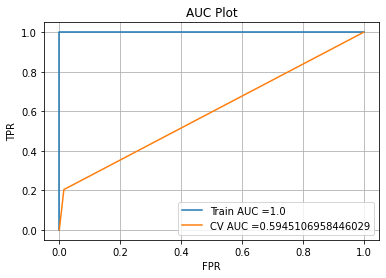

Cross Validation
FNR:0.7959183673469388 ,TPR:0.20408163265306123 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


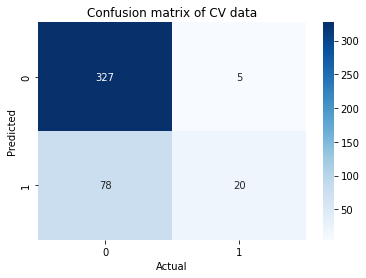

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.1068128759134261
only_fraud_procedure_code_count 0.05725189136861265
only_fraud_physician_count 0.21513002449996008
only_fraud_op_physician_count 0.2154810658202289
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.73      0.31      0.43        98

    accuracy                           0.82       430
   macro avg       0.78      0.64      0.66       430
weighted avg       0.80      0.82      0.79       430



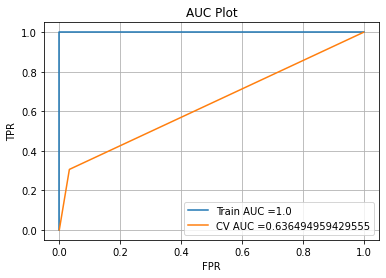

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


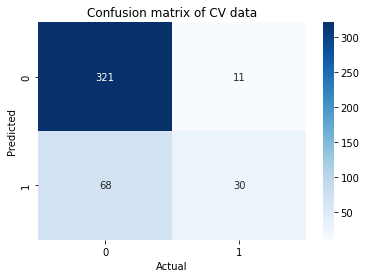

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.09843195671769488
only_fraud_procedure_code_count 0.09519374363633057
only_fraud_physician_count 0.19132099823933504
only_fraud_op_physician_count 0.23148758185262752
              precision    recall  f1-score   support

           0       0.82      0.96      0.88       332
           1       0.67      0.29      0.40        98

    accuracy                           0.80       430
   macro avg       0.74      0.62      0.64       430
weighted avg       0.78      0.80      0.77       430



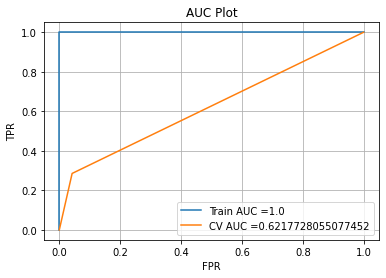

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


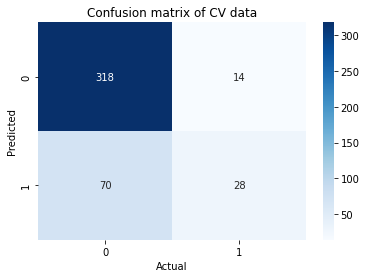

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.08199103326500976
only_fraud_procedure_code_count 0.07466032186608053
only_fraud_physician_count 0.23912021597817415
only_fraud_op_physician_count 0.2127828078046306
              precision    recall  f1-score   support

           0       0.81      0.99      0.89       332
           1       0.85      0.23      0.37        98

    accuracy                           0.82       430
   macro avg       0.83      0.61      0.63       430
weighted avg       0.82      0.82      0.77       430



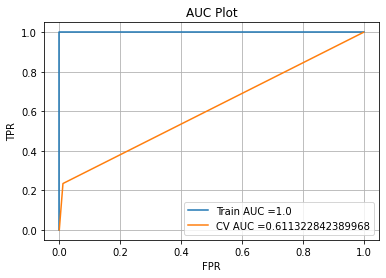

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


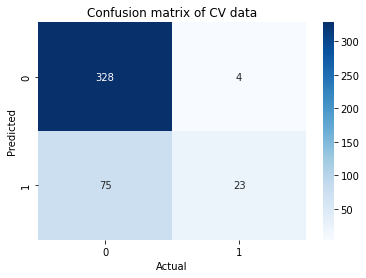

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.11676291559088117
only_fraud_procedure_code_count 0.07874343035406792
only_fraud_physician_count 0.2190491412178425
only_fraud_op_physician_count 0.1785901707806854
              precision    recall  f1-score   support

           0       0.83      0.92      0.88       332
           1       0.59      0.37      0.45        98

    accuracy                           0.80       430
   macro avg       0.71      0.65      0.66       430
weighted avg       0.78      0.80      0.78       430



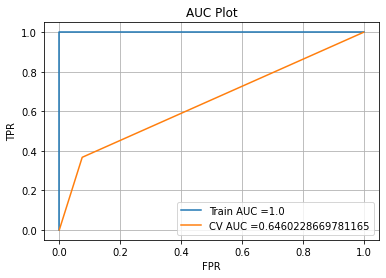

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.07530120481927711 ,TNR:0.9246987951807228 


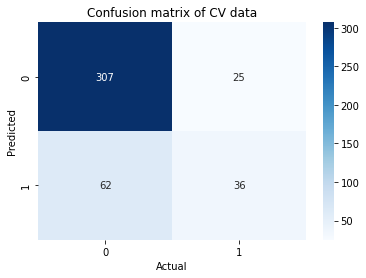

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.07911112351285277
only_fraud_procedure_code_count 0.08625380578658508
only_fraud_physician_count 0.20269735975144773
only_fraud_op_physician_count 0.212718629094689
              precision    recall  f1-score   support

           0       0.84      0.93      0.88       332
           1       0.63      0.40      0.49        98

    accuracy                           0.81       430
   macro avg       0.73      0.66      0.69       430
weighted avg       0.79      0.81      0.79       430



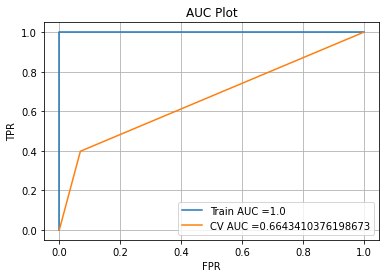

Cross Validation
FNR:0.6020408163265306 ,TPR:0.3979591836734694 ,FPR:0.06927710843373494 ,TNR:0.9307228915662651 


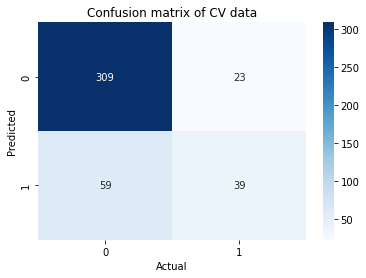

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.07643010765741108
only_fraud_procedure_code_count 0.06174067604769569
only_fraud_physician_count 0.2165894307978405
only_fraud_op_physician_count 0.2508795492931218
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.82      0.61      0.64       430
weighted avg       0.82      0.82      0.78       430



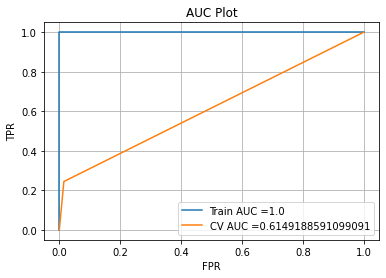

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


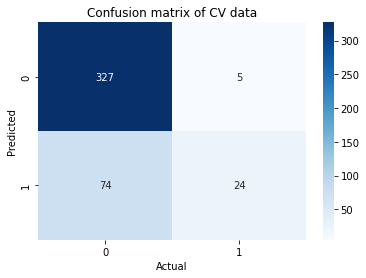

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.09470915279493668
only_fraud_procedure_code_count 0.06994271186538648
only_fraud_physician_count 0.24175363237126274
only_fraud_op_physician_count 0.19757631780249033
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.30      0.43        98

    accuracy                           0.82       430
   macro avg       0.80      0.64      0.66       430
weighted avg       0.82      0.82      0.79       430



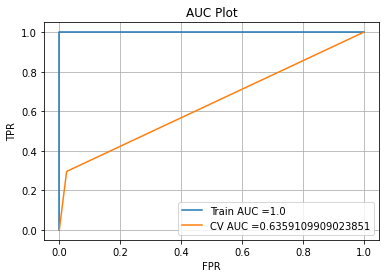

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


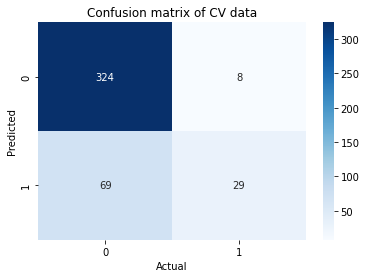

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.10581607631661313
only_fraud_procedure_code_count 0.06075090565620111
only_fraud_physician_count 0.21957834120441241
only_fraud_op_physician_count 0.19340520166547406
              precision    recall  f1-score   support

           0       0.83      0.96      0.89       332
           1       0.69      0.32      0.43        98

    accuracy                           0.81       430
   macro avg       0.76      0.64      0.66       430
weighted avg       0.79      0.81      0.78       430



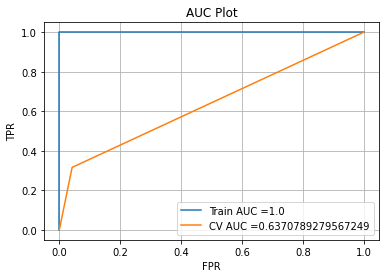

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


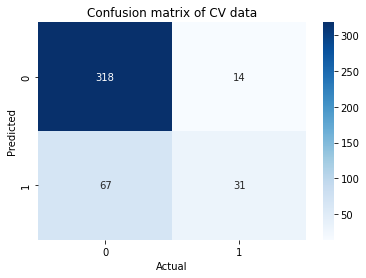

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.0910596621666147
only_fraud_procedure_code_count 0.075365151016463
only_fraud_physician_count 0.23281272824136656
only_fraud_op_physician_count 0.20505562060570603
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       332
           1       0.76      0.30      0.43        98

    accuracy                           0.82       430
   macro avg       0.79      0.63      0.66       430
weighted avg       0.81      0.82      0.79       430



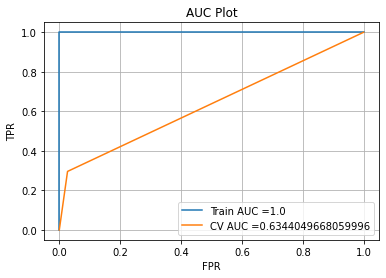

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


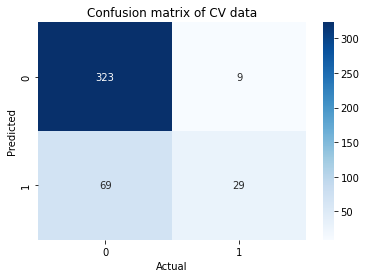

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.10112399113931626
only_fraud_procedure_code_count 0.07041102156744661
only_fraud_physician_count 0.1895506361338356
only_fraud_op_physician_count 0.2411755783415645
              precision    recall  f1-score   support

           0       0.84      0.95      0.89       332
           1       0.69      0.37      0.48        98

    accuracy                           0.82       430
   macro avg       0.76      0.66      0.69       430
weighted avg       0.80      0.82      0.80       430



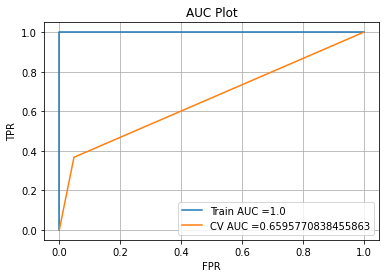

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.04819277108433735 ,TNR:0.9518072289156626 


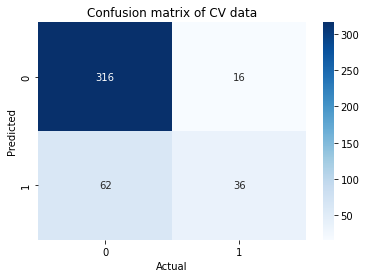

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.10263248447681578
only_fraud_procedure_code_count 0.06931356488180018
only_fraud_physician_count 0.23338374389193758
only_fraud_op_physician_count 0.20035626283049082
              precision    recall  f1-score   support

           0       0.83      0.95      0.89       332
           1       0.69      0.35      0.46        98

    accuracy                           0.82       430
   macro avg       0.76      0.65      0.68       430
weighted avg       0.80      0.82      0.79       430



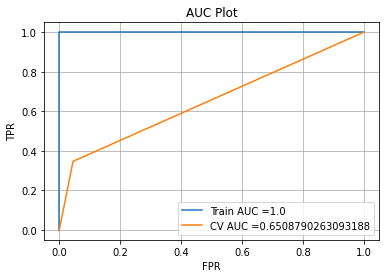

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.045180722891566265 ,TNR:0.9548192771084337 


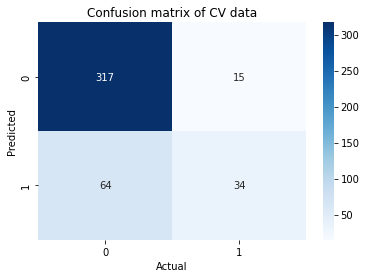

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.09457884803073194
only_fraud_procedure_code_count 0.07595032850791948
only_fraud_physician_count 0.20885092614712197
only_fraud_op_physician_count 0.20808537333814725
              precision    recall  f1-score   support

           0       0.83      0.95      0.88       332
           1       0.66      0.32      0.43        98

    accuracy                           0.81       430
   macro avg       0.74      0.63      0.66       430
weighted avg       0.79      0.81      0.78       430



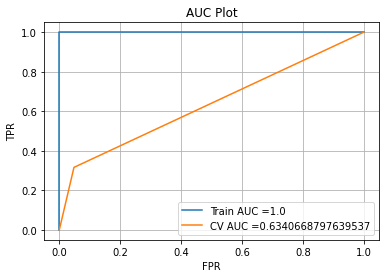

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.04819277108433735 ,TNR:0.9518072289156626 


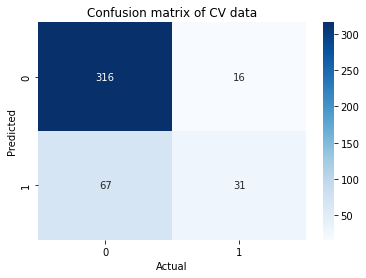

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.07483262710134884
only_fraud_procedure_code_count 0.07223492867450777
only_fraud_physician_count 0.2550082421376267
only_fraud_op_physician_count 0.19378181619534718
              precision    recall  f1-score   support

           0       0.82      0.99      0.89       332
           1       0.86      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.84      0.62      0.64       430
weighted avg       0.83      0.82      0.78       430



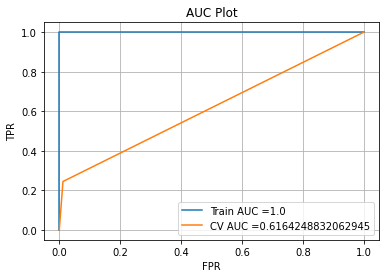

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


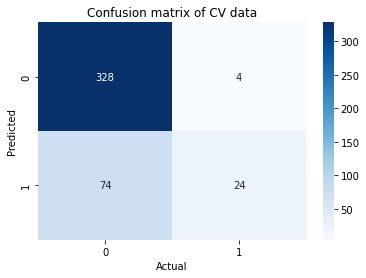

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.08861349979169633
only_fraud_procedure_code_count 0.07649130530079705
only_fraud_physician_count 0.20862048543501124
only_fraud_op_physician_count 0.2260613897568015
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.79      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.80      0.62      0.64       430
weighted avg       0.81      0.82      0.78       430



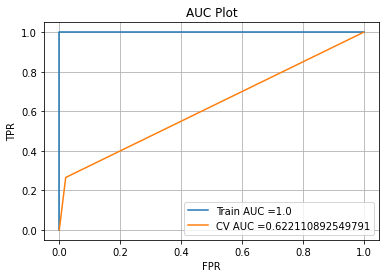

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


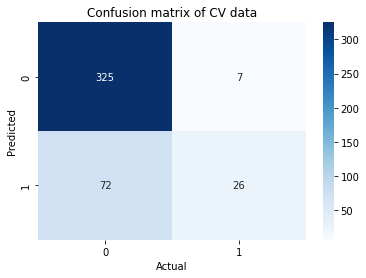

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.08859377680305405
only_fraud_procedure_code_count 0.07749416186749898
only_fraud_physician_count 0.2081743879316276
only_fraud_op_physician_count 0.22189071314729245
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.78      0.32      0.45        98

    accuracy                           0.82       430
   macro avg       0.80      0.64      0.67       430
weighted avg       0.82      0.82      0.79       430



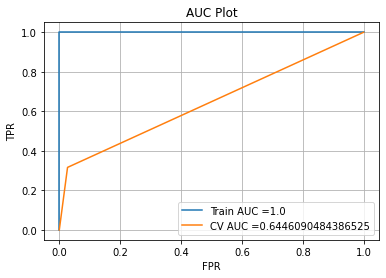

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


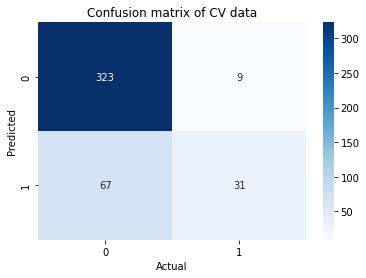

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.09591554955658652
only_fraud_procedure_code_count 0.06936034814331614
only_fraud_physician_count 0.2123374991032137
only_fraud_op_physician_count 0.23310953651720168
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.74      0.23      0.36        98

    accuracy                           0.81       430
   macro avg       0.78      0.61      0.62       430
weighted avg       0.80      0.81      0.77       430



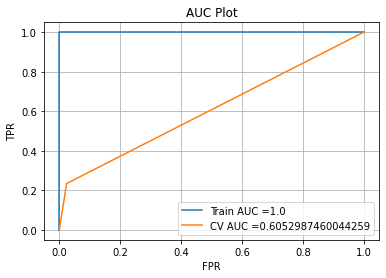

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


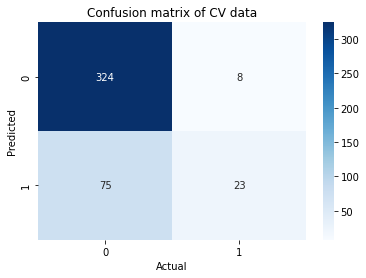

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.09690069849025387
only_fraud_procedure_code_count 0.07190384248392993
only_fraud_physician_count 0.20746769690628172
only_fraud_op_physician_count 0.22360088568860442
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.79      0.23      0.36        98

    accuracy                           0.81       430
   macro avg       0.80      0.61      0.63       430
weighted avg       0.81      0.81      0.77       430



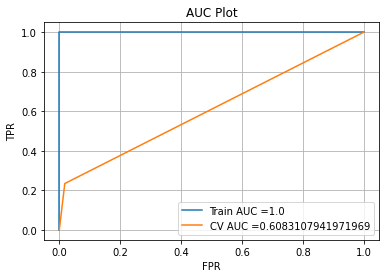

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


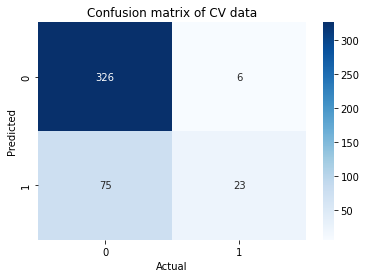

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.10064023784846594
only_fraud_procedure_code_count 0.06824912086192934
only_fraud_physician_count 0.21254950718038565
only_fraud_op_physician_count 0.20626197293423035
              precision    recall  f1-score   support

           0       0.83      0.97      0.90       332
           1       0.76      0.35      0.48        98

    accuracy                           0.83       430
   macro avg       0.79      0.66      0.69       430
weighted avg       0.82      0.83      0.80       430



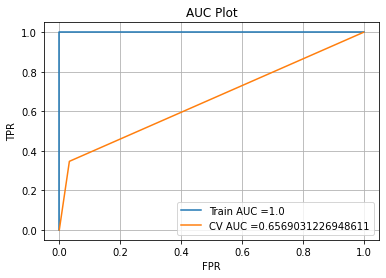

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


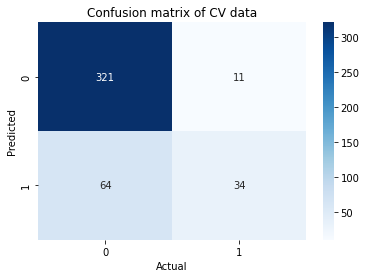

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.09643945213574912
only_fraud_procedure_code_count 0.07523007971979119
only_fraud_physician_count 0.225034839251758
only_fraud_op_physician_count 0.2152884765845644
              precision    recall  f1-score   support

           0       0.84      0.96      0.89       332
           1       0.73      0.37      0.49        98

    accuracy                           0.83       430
   macro avg       0.79      0.66      0.69       430
weighted avg       0.81      0.83      0.80       430



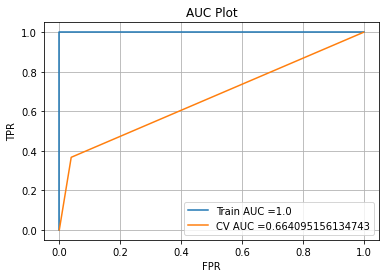

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.0391566265060241 ,TNR:0.9608433734939759 


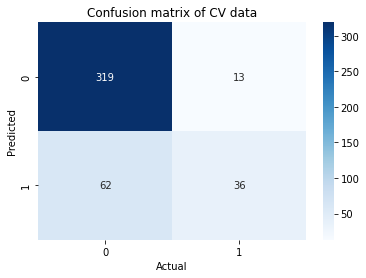

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.09823701770047663
only_fraud_procedure_code_count 0.05568412033275023
only_fraud_physician_count 0.22859749005254956
only_fraud_op_physician_count 0.23528458857084103
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.79      0.23      0.36        98

    accuracy                           0.81       430
   macro avg       0.80      0.61      0.63       430
weighted avg       0.81      0.81      0.77       430



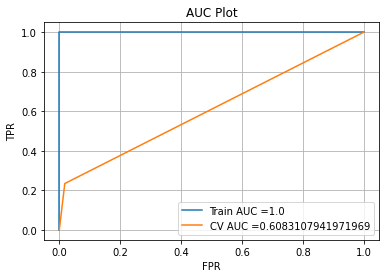

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


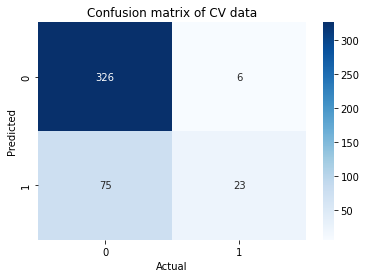

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.08610434481638116
only_fraud_procedure_code_count 0.07519999906914228
only_fraud_physician_count 0.2324936762721706
only_fraud_op_physician_count 0.2162688891978828
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.84      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



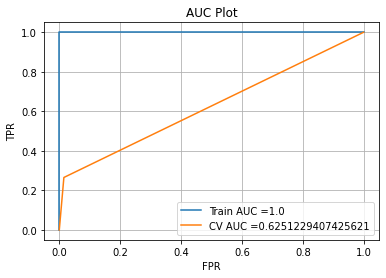

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


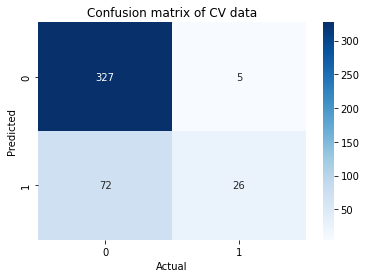

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.09595012185845829
only_fraud_procedure_code_count 0.07497917255640135
only_fraud_physician_count 0.22873437355849857
only_fraud_op_physician_count 0.2222984209123839
              precision    recall  f1-score   support

           0       0.83      0.97      0.90       332
           1       0.76      0.35      0.48        98

    accuracy                           0.83       430
   macro avg       0.79      0.66      0.69       430
weighted avg       0.82      0.83      0.80       430



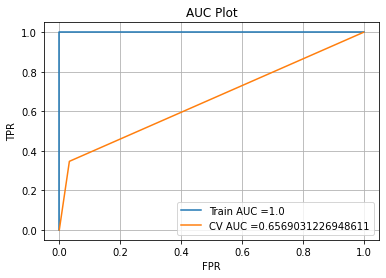

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


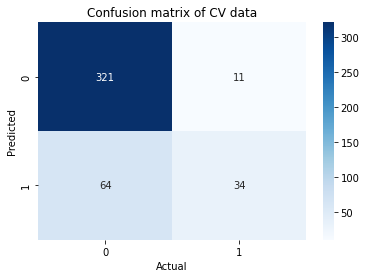

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.10572508695730319
only_fraud_procedure_code_count 0.07430849520647456
only_fraud_physician_count 0.20691697969503686
only_fraud_op_physician_count 0.22554861224414788
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.30      0.43        98

    accuracy                           0.82       430
   macro avg       0.80      0.64      0.66       430
weighted avg       0.82      0.82      0.79       430



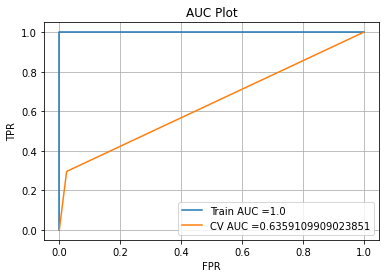

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


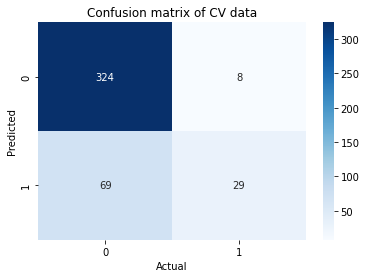

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.09598953667722135
only_fraud_procedure_code_count 0.07372521523472382
only_fraud_physician_count 0.2272118786755961
only_fraud_op_physician_count 0.21203319211636
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.66       430
weighted avg       0.81      0.82      0.78       430



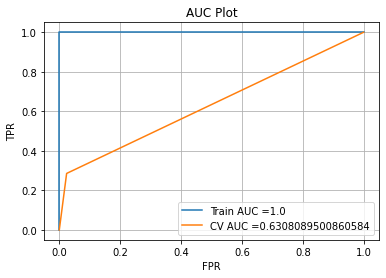

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


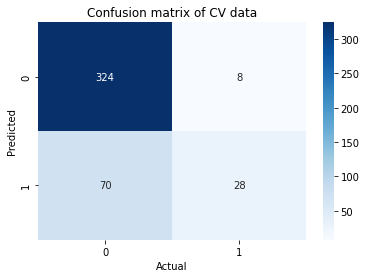

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.09440901648865037
only_fraud_procedure_code_count 0.07414220328832147
only_fraud_physician_count 0.22316590657651983
only_fraud_op_physician_count 0.21872846287601183
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       332
           1       0.76      0.29      0.41        98

    accuracy                           0.82       430
   macro avg       0.79      0.63      0.65       430
weighted avg       0.81      0.82      0.78       430



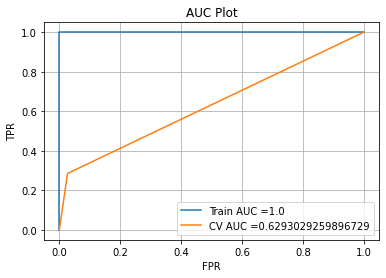

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


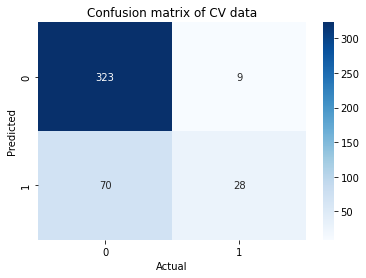

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.09301710758993019
only_fraud_procedure_code_count 0.0765274086331186
only_fraud_physician_count 0.22517319503686947
only_fraud_op_physician_count 0.21427290867002624
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       332
           1       0.76      0.29      0.41        98

    accuracy                           0.82       430
   macro avg       0.79      0.63      0.65       430
weighted avg       0.81      0.82      0.78       430



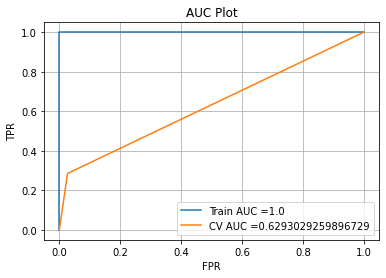

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


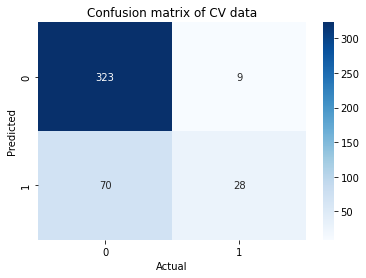

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.08804405623233014
only_fraud_procedure_code_count 0.0698221120530908
only_fraud_physician_count 0.24329114365117394
only_fraud_op_physician_count 0.20645284869420205
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.83      0.62      0.64       430
weighted avg       0.82      0.82      0.78       430



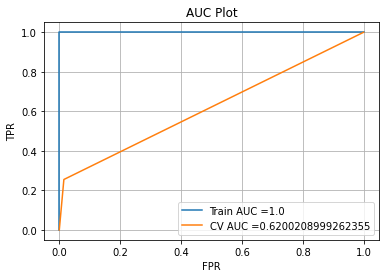

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


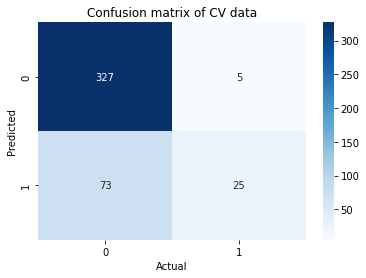

In [69]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_50_50,y_inpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.12152639390884401
only_fraud_procedure_code_count 0.09308608808225599
only_fraud_physician_count 0.21569385356148152
only_fraud_op_physician_count 0.19483741572595314
              precision    recall  f1-score   support

           0       0.83      0.92      0.87       332
           1       0.57      0.36      0.44        98

    accuracy                           0.79       430
   macro avg       0.70      0.64      0.66       430
weighted avg       0.77      0.79      0.77       430



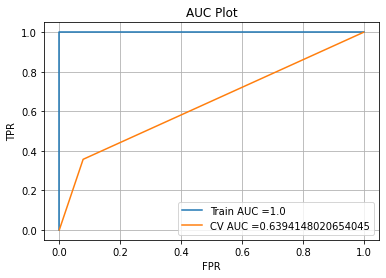

Cross Validation
FNR:0.6428571428571429 ,TPR:0.35714285714285715 ,FPR:0.0783132530120482 ,TNR:0.9216867469879518 


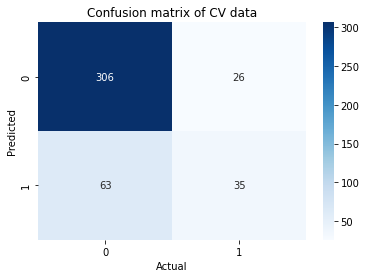

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.09273240785713405
only_fraud_procedure_code_count 0.0641114753510116
only_fraud_physician_count 0.24573618595342248
only_fraud_op_physician_count 0.20665127716419887
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.84      0.28      0.42        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.66       430
weighted avg       0.83      0.82      0.79       430



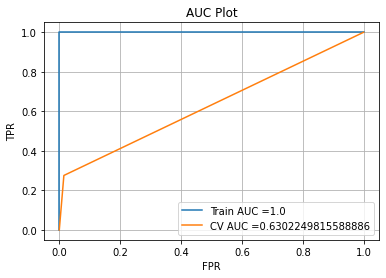

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


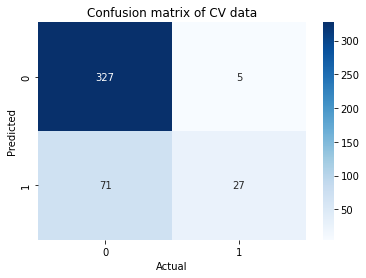

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.13241863348876012
only_fraud_procedure_code_count 0.08847315669590974
only_fraud_physician_count 0.1728005022546312
only_fraud_op_physician_count 0.20165948662642216
              precision    recall  f1-score   support

           0       0.83      0.92      0.87       332
           1       0.57      0.37      0.45        98

    accuracy                           0.79       430
   macro avg       0.70      0.64      0.66       430
weighted avg       0.77      0.79      0.78       430



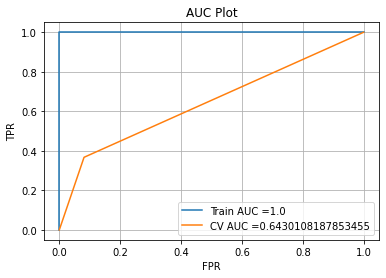

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.08132530120481928 ,TNR:0.9186746987951807 


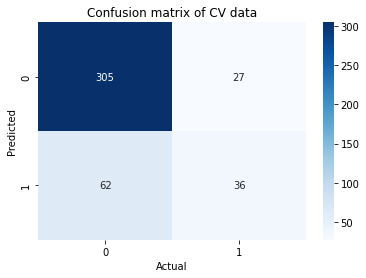

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.13295413154154198
only_fraud_procedure_code_count 0.0764893938371616
only_fraud_physician_count 0.22298869673070387
only_fraud_op_physician_count 0.18687893579814038
              precision    recall  f1-score   support

           0       0.83      0.92      0.88       332
           1       0.59      0.38      0.46        98

    accuracy                           0.80       430
   macro avg       0.71      0.65      0.67       430
weighted avg       0.78      0.80      0.78       430



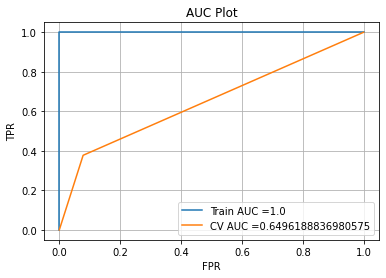

Cross Validation
FNR:0.6224489795918368 ,TPR:0.37755102040816324 ,FPR:0.0783132530120482 ,TNR:0.9216867469879518 


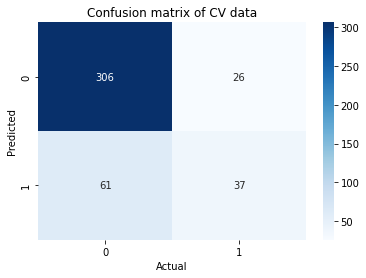

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.10083488359968064
only_fraud_procedure_code_count 0.07330335948291318
only_fraud_physician_count 0.22694111639032763
only_fraud_op_physician_count 0.2311577313087918
              precision    recall  f1-score   support

           0       0.83      0.97      0.90       332
           1       0.78      0.33      0.46        98

    accuracy                           0.83       430
   macro avg       0.81      0.65      0.68       430
weighted avg       0.82      0.83      0.80       430



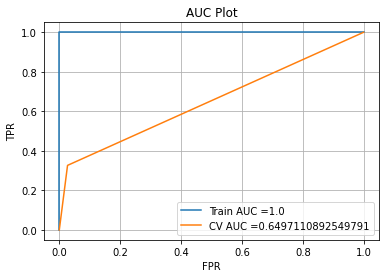

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


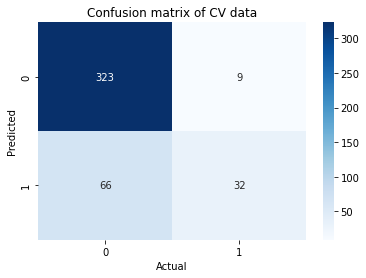

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.08268332582207566
only_fraud_procedure_code_count 0.0586054988735837
only_fraud_physician_count 0.2304768234888447
only_fraud_op_physician_count 0.22009187713228934
              precision    recall  f1-score   support

           0       0.81      0.99      0.89       332
           1       0.85      0.23      0.37        98

    accuracy                           0.82       430
   macro avg       0.83      0.61      0.63       430
weighted avg       0.82      0.82      0.77       430



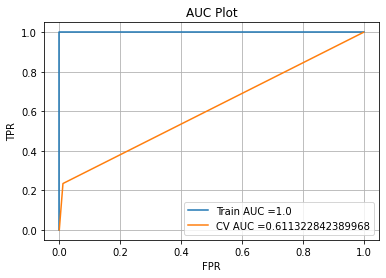

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


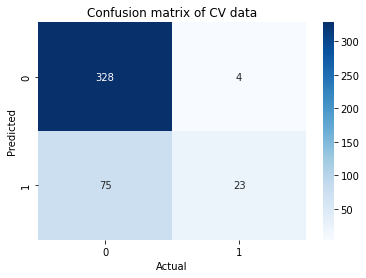

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.1297473914882202
only_fraud_procedure_code_count 0.07172834619780345
only_fraud_physician_count 0.2855227986320913
only_fraud_op_physician_count 0.14846294988320766
              precision    recall  f1-score   support

           0       0.83      0.95      0.88       332
           1       0.65      0.33      0.44        98

    accuracy                           0.81       430
   macro avg       0.74      0.64      0.66       430
weighted avg       0.79      0.81      0.78       430



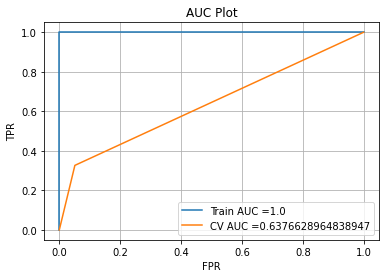

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.05120481927710843 ,TNR:0.9487951807228916 


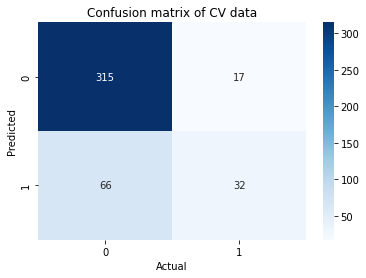

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.09593122970591712
only_fraud_procedure_code_count 0.07256193653447074
only_fraud_physician_count 0.22944012714192416
only_fraud_op_physician_count 0.2076486725903844
              precision    recall  f1-score   support

           0       0.82      0.99      0.89       332
           1       0.86      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.84      0.62      0.64       430
weighted avg       0.83      0.82      0.78       430



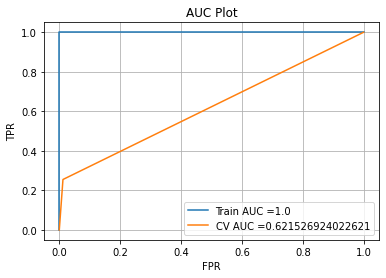

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


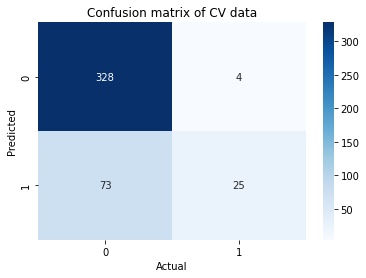

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.10974449824356283
only_fraud_procedure_code_count 0.06849337827966767
only_fraud_physician_count 0.22159540402744513
only_fraud_op_physician_count 0.20695925756066633
              precision    recall  f1-score   support

           0       0.83      0.95      0.89       332
           1       0.67      0.34      0.45        98

    accuracy                           0.81       430
   macro avg       0.75      0.64      0.67       430
weighted avg       0.79      0.81      0.79       430



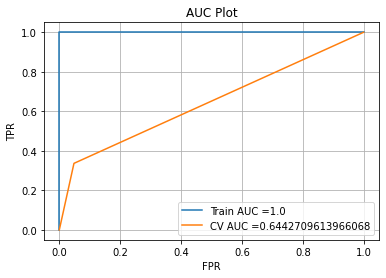

Cross Validation
FNR:0.6632653061224489 ,TPR:0.336734693877551 ,FPR:0.04819277108433735 ,TNR:0.9518072289156626 


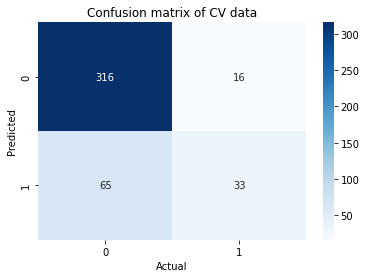

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.09489062374543071
only_fraud_procedure_code_count 0.06896830202971992
only_fraud_physician_count 0.24022212018330447
only_fraud_op_physician_count 0.22070213509542871
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.82      0.28      0.41        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



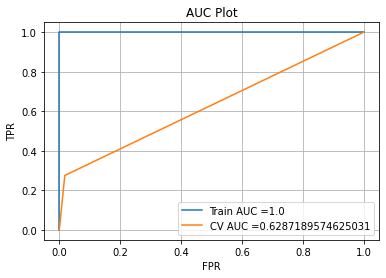

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


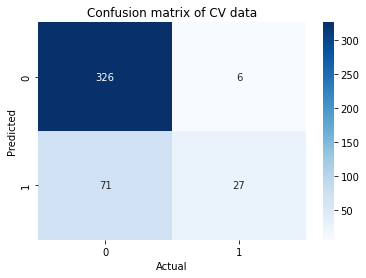

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.10826478595352396
only_fraud_procedure_code_count 0.05778040552076465
only_fraud_physician_count 0.21685811411263872
only_fraud_op_physician_count 0.22062245940783268
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.76      0.26      0.38        98

    accuracy                           0.81       430
   macro avg       0.79      0.62      0.64       430
weighted avg       0.80      0.81      0.77       430



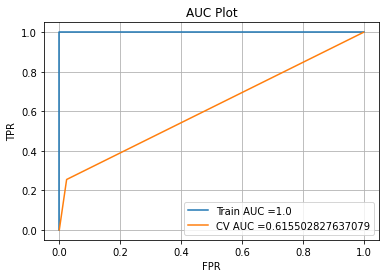

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


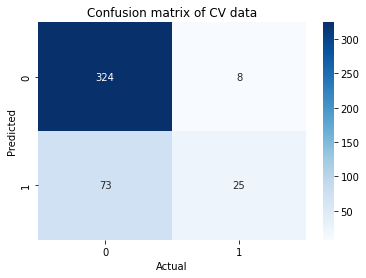

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.09109354514718193
only_fraud_procedure_code_count 0.06651997622908791
only_fraud_physician_count 0.23209768947975054
only_fraud_op_physician_count 0.20489701434507623
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.30      0.43        98

    accuracy                           0.82       430
   macro avg       0.80      0.64      0.66       430
weighted avg       0.82      0.82      0.79       430



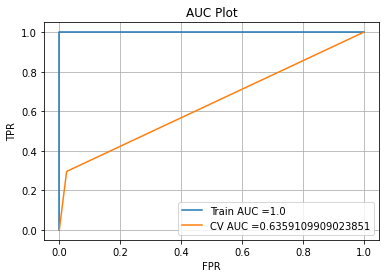

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


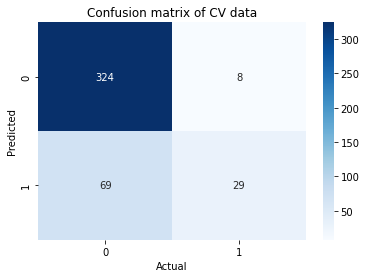

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.11052088648623809
only_fraud_procedure_code_count 0.08864396947399938
only_fraud_physician_count 0.19659418682140348
only_fraud_op_physician_count 0.23661874325947183
              precision    recall  f1-score   support

           0       0.82      0.95      0.88       332
           1       0.63      0.32      0.42        98

    accuracy                           0.80       430
   macro avg       0.73      0.63      0.65       430
weighted avg       0.78      0.80      0.78       430



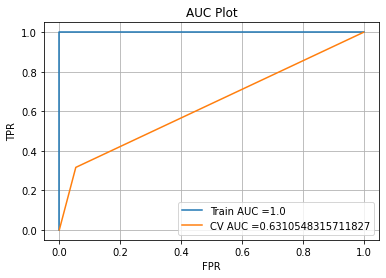

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.05421686746987952 ,TNR:0.9457831325301205 


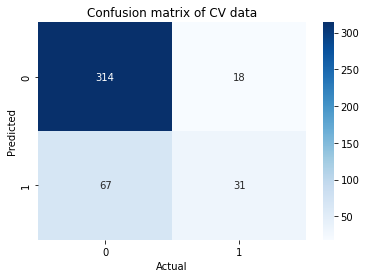

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.10656872012647287
only_fraud_procedure_code_count 0.05315734230590318
only_fraud_physician_count 0.19879815849830534
only_fraud_op_physician_count 0.2253880857665345
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.30      0.43        98

    accuracy                           0.82       430
   macro avg       0.80      0.64      0.66       430
weighted avg       0.82      0.82      0.79       430



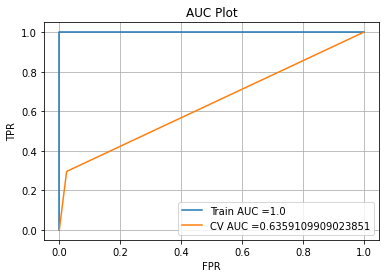

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


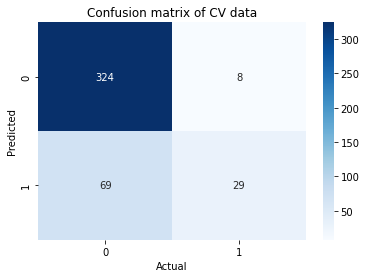

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.10633694399644593
only_fraud_procedure_code_count 0.06593691128886618
only_fraud_physician_count 0.21178020703286699
only_fraud_op_physician_count 0.2207264595658243
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.82      0.23      0.37        98

    accuracy                           0.81       430
   macro avg       0.82      0.61      0.63       430
weighted avg       0.82      0.81      0.77       430



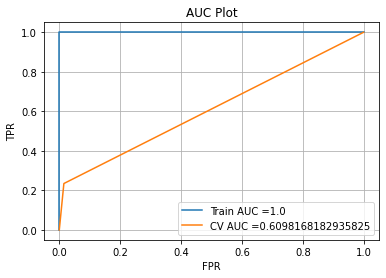

Cross Validation
FNR:0.7653061224489796 ,TPR:0.23469387755102042 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


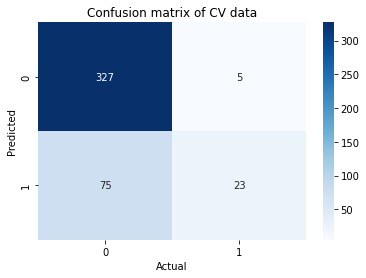

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.09957275551067742
only_fraud_procedure_code_count 0.07108846697595121
only_fraud_physician_count 0.21433912056932153
only_fraud_op_physician_count 0.22829937114024088
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.84      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



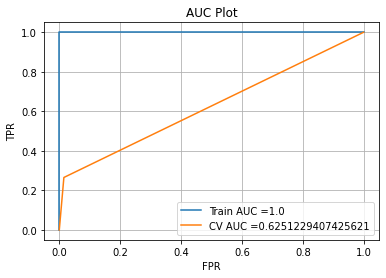

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


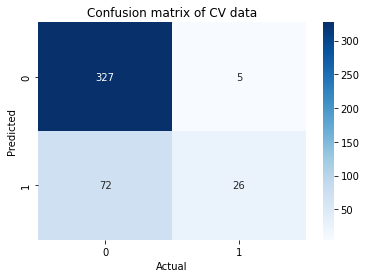

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.10824303880802136
only_fraud_procedure_code_count 0.07253119493498646
only_fraud_physician_count 0.2148356779757556
only_fraud_op_physician_count 0.23542700526019017
              precision    recall  f1-score   support

           0       0.83      0.97      0.90       332
           1       0.76      0.35      0.48        98

    accuracy                           0.83       430
   macro avg       0.79      0.66      0.69       430
weighted avg       0.82      0.83      0.80       430



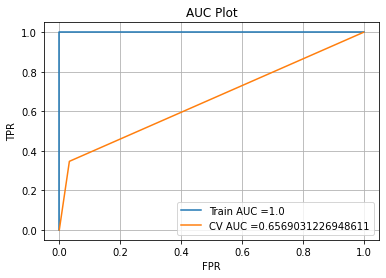

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


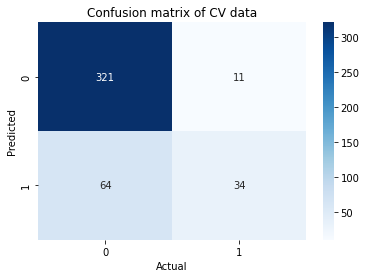

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.10394219363240487
only_fraud_procedure_code_count 0.0725368823696452
only_fraud_physician_count 0.20409656882718558
only_fraud_op_physician_count 0.2215674963975527
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.82      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



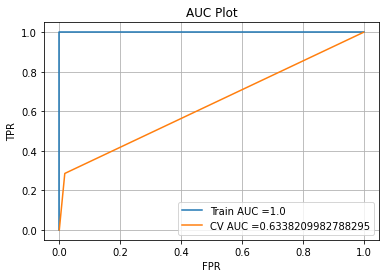

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


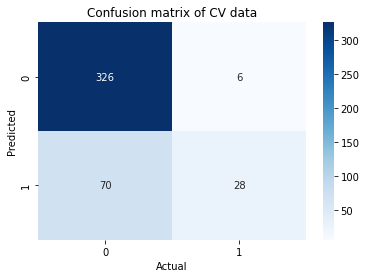

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.09858973479855747
only_fraud_procedure_code_count 0.07284113375467335
only_fraud_physician_count 0.224039486641964
only_fraud_op_physician_count 0.19944945264127947
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.66       430
weighted avg       0.81      0.82      0.78       430



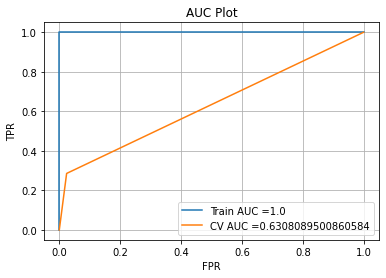

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


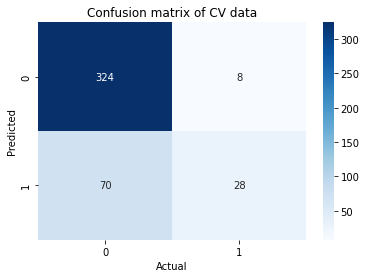

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.09986143232767339
only_fraud_procedure_code_count 0.07738693178535334
only_fraud_physician_count 0.2195069498864669
only_fraud_op_physician_count 0.21350193228667808
              precision    recall  f1-score   support

           0       0.82      0.99      0.90       332
           1       0.87      0.28      0.42        98

    accuracy                           0.83       430
   macro avg       0.85      0.63      0.66       430
weighted avg       0.83      0.83      0.79       430



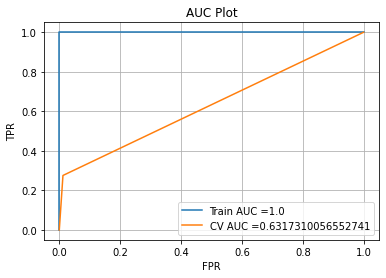

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


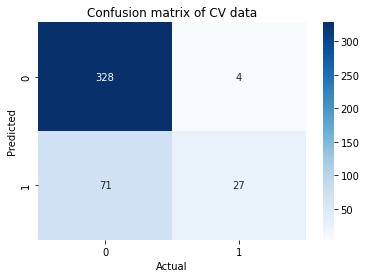

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.10164611808910246
only_fraud_procedure_code_count 0.07842981222971028
only_fraud_physician_count 0.22803319472939357
only_fraud_op_physician_count 0.20883562147850201
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.85      0.29      0.43        98

    accuracy                           0.83       430
   macro avg       0.84      0.64      0.66       430
weighted avg       0.83      0.83      0.79       430



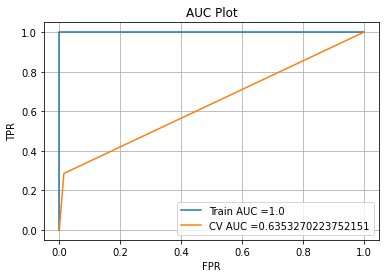

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


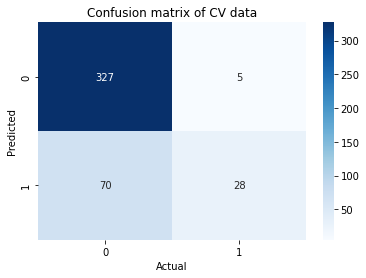

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.09546499919910714
only_fraud_procedure_code_count 0.06516343988340667
only_fraud_physician_count 0.20743495105743065
only_fraud_op_physician_count 0.22024182135300424
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.84      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



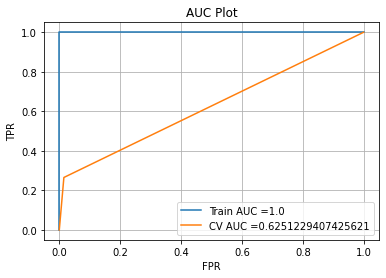

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


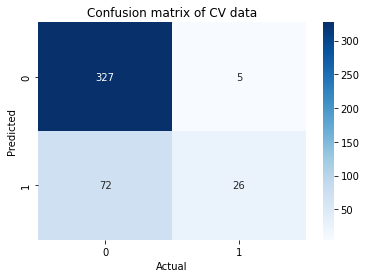

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.11005012747784511
only_fraud_procedure_code_count 0.07551820117597474
only_fraud_physician_count 0.22128111601037306
only_fraud_op_physician_count 0.20963684922531084
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.85      0.30      0.44        98

    accuracy                           0.83       430
   macro avg       0.84      0.64      0.67       430
weighted avg       0.83      0.83      0.79       430



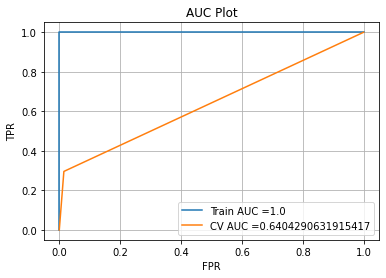

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


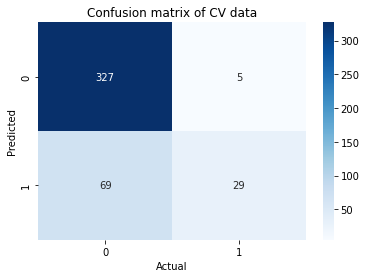

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.11023325513095933
only_fraud_procedure_code_count 0.07168040596050856
only_fraud_physician_count 0.22138378855552687
only_fraud_op_physician_count 0.204768414805002
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.79      0.31      0.44        98

    accuracy                           0.82       430
   macro avg       0.81      0.64      0.67       430
weighted avg       0.82      0.82      0.79       430



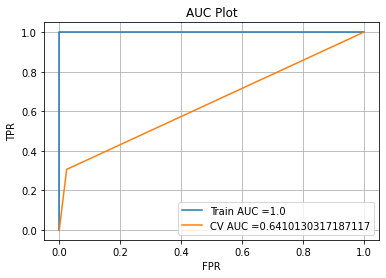

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


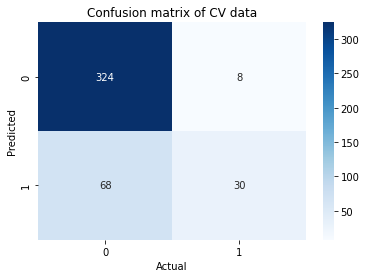

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.09579397156574643
only_fraud_procedure_code_count 0.07325778796694757
only_fraud_physician_count 0.22801482398564613
only_fraud_op_physician_count 0.2132977756190747
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.81      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.81      0.62      0.64       430
weighted avg       0.81      0.82      0.78       430



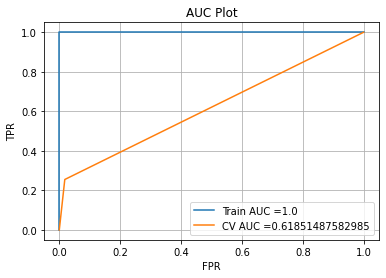

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


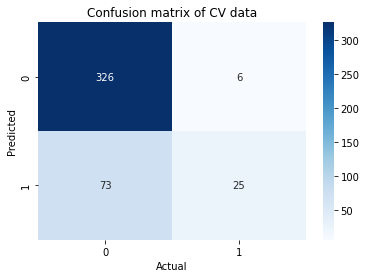

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.10217143618567925
only_fraud_procedure_code_count 0.06496822552546105
only_fraud_physician_count 0.22790234141492915
only_fraud_op_physician_count 0.21055439204121823
              precision    recall  f1-score   support

           0       0.82      0.99      0.90       332
           1       0.87      0.28      0.42        98

    accuracy                           0.83       430
   macro avg       0.85      0.63      0.66       430
weighted avg       0.83      0.83      0.79       430



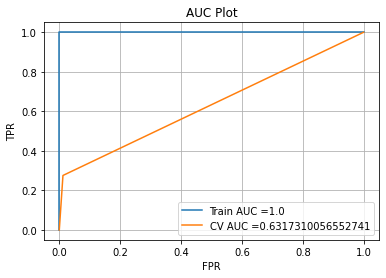

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


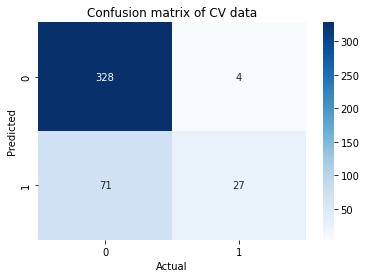

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.10705877752088061
only_fraud_procedure_code_count 0.07522186038715484
only_fraud_physician_count 0.20878983782368885
only_fraud_op_physician_count 0.22592776196909006
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.85      0.29      0.43        98

    accuracy                           0.83       430
   macro avg       0.84      0.64      0.66       430
weighted avg       0.83      0.83      0.79       430



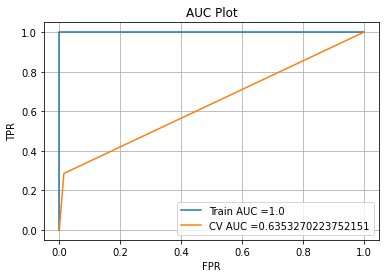

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


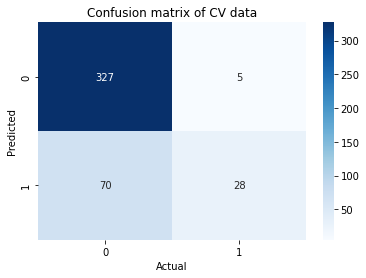

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.10841579945662161
only_fraud_procedure_code_count 0.07181904562293476
only_fraud_physician_count 0.21764719322512566
only_fraud_op_physician_count 0.21653817147024357
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.78      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.80      0.63      0.66       430
weighted avg       0.81      0.82      0.78       430



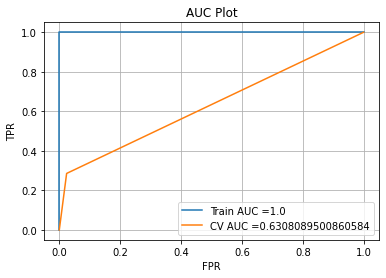

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


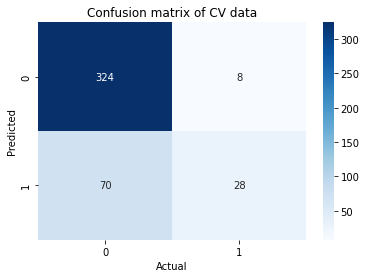

In [70]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_60_40,y_inpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.09742894680759771
only_fraud_procedure_code_count 0.08125430794733039
only_fraud_physician_count 0.26497972330332215
only_fraud_op_physician_count 0.1771998792925466
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.83      0.62      0.64       430
weighted avg       0.82      0.82      0.78       430



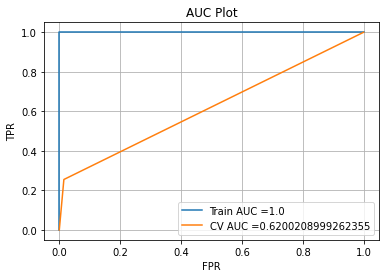

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


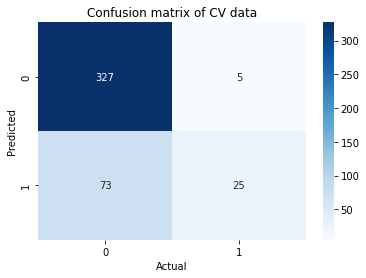

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.10441000627893163
only_fraud_procedure_code_count 0.08259385659481991
only_fraud_physician_count 0.18967726554798778
only_fraud_op_physician_count 0.2148361159444774
              precision    recall  f1-score   support

           0       0.83      0.95      0.89       332
           1       0.67      0.33      0.44        98

    accuracy                           0.81       430
   macro avg       0.75      0.64      0.66       430
weighted avg       0.79      0.81      0.78       430



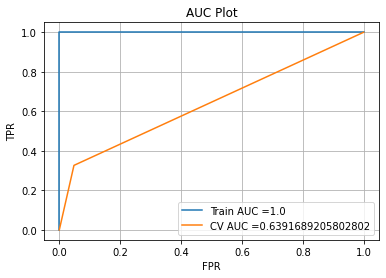

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.04819277108433735 ,TNR:0.9518072289156626 


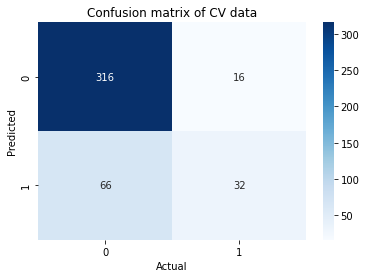

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.11453682285279186
only_fraud_procedure_code_count 0.07043943436873407
only_fraud_physician_count 0.23338188657403527
only_fraud_op_physician_count 0.18619603729895448
              precision    recall  f1-score   support

           0       0.81      0.98      0.89       332
           1       0.76      0.22      0.35        98

    accuracy                           0.81       430
   macro avg       0.78      0.60      0.62       430
weighted avg       0.80      0.81      0.76       430



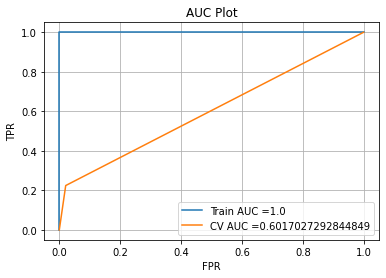

Cross Validation
FNR:0.7755102040816326 ,TPR:0.22448979591836735 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


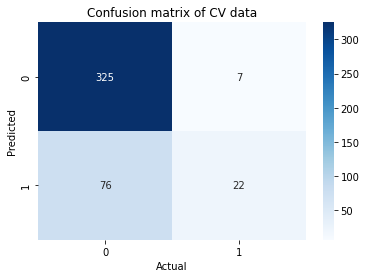

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.13073828793895884
only_fraud_procedure_code_count 0.1023967458991955
only_fraud_physician_count 0.2326571507820874
only_fraud_op_physician_count 0.20469673922721252
              precision    recall  f1-score   support

           0       0.84      0.93      0.88       332
           1       0.63      0.38      0.47        98

    accuracy                           0.81       430
   macro avg       0.73      0.66      0.68       430
weighted avg       0.79      0.81      0.79       430



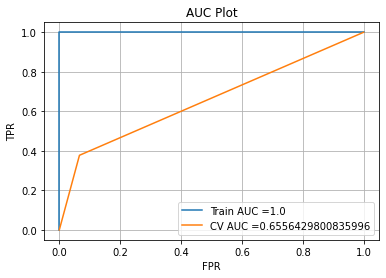

Cross Validation
FNR:0.6224489795918368 ,TPR:0.37755102040816324 ,FPR:0.06626506024096386 ,TNR:0.9337349397590361 


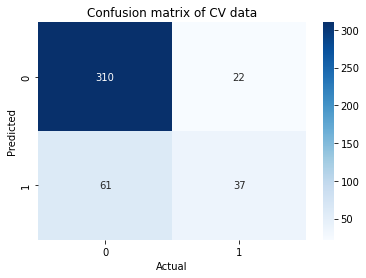

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.08461596459488044
only_fraud_procedure_code_count 0.06471643873633683
only_fraud_physician_count 0.23004700999178643
only_fraud_op_physician_count 0.20722597572936563
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.76      0.32      0.45        98

    accuracy                           0.82       430
   macro avg       0.79      0.64      0.67       430
weighted avg       0.81      0.82      0.79       430



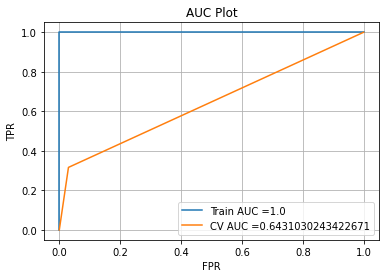

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.030120481927710843 ,TNR:0.9698795180722891 


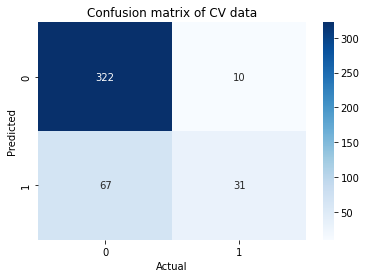

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.1283157607591021
only_fraud_procedure_code_count 0.07083559996006769
only_fraud_physician_count 0.25377870692367116
only_fraud_op_physician_count 0.19727638423541946
              precision    recall  f1-score   support

           0       0.84      0.95      0.89       332
           1       0.71      0.37      0.48        98

    accuracy                           0.82       430
   macro avg       0.77      0.66      0.69       430
weighted avg       0.81      0.82      0.80       430



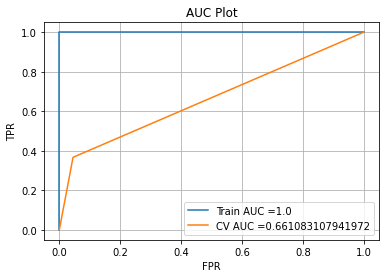

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.045180722891566265 ,TNR:0.9548192771084337 


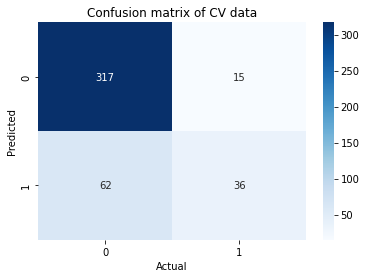

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.11573795639438762
only_fraud_procedure_code_count 0.06947879368748358
only_fraud_physician_count 0.21912349279731105
only_fraud_op_physician_count 0.256941653120277
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.84      0.28      0.42        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.66       430
weighted avg       0.83      0.82      0.79       430



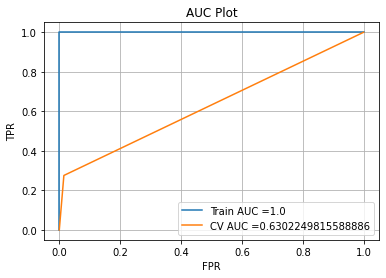

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


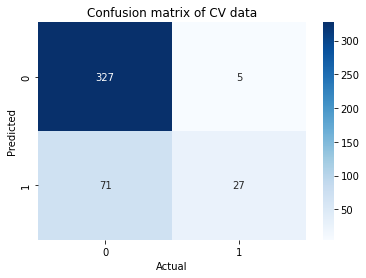

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.12946523405757435
only_fraud_procedure_code_count 0.07295258616136241
only_fraud_physician_count 0.2151061104806481
only_fraud_op_physician_count 0.23545686972683327
              precision    recall  f1-score   support

           0       0.83      0.95      0.89       332
           1       0.69      0.35      0.46        98

    accuracy                           0.82       430
   macro avg       0.76      0.65      0.68       430
weighted avg       0.80      0.82      0.79       430



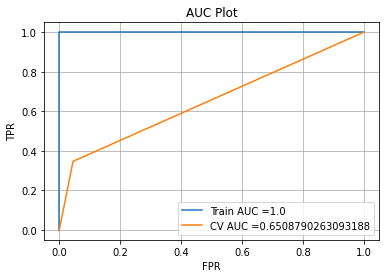

Cross Validation
FNR:0.6530612244897959 ,TPR:0.3469387755102041 ,FPR:0.045180722891566265 ,TNR:0.9548192771084337 


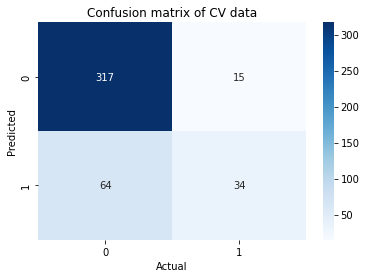

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.11028801822297049
only_fraud_procedure_code_count 0.061755488187199455
only_fraud_physician_count 0.231533244653046
only_fraud_op_physician_count 0.20633402164330322
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.80      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.81      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



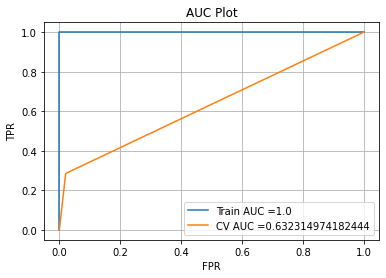

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


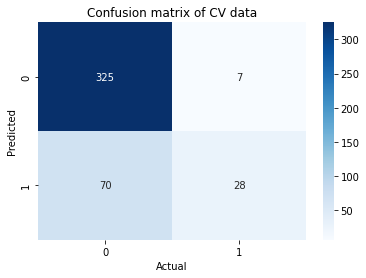

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.11481477637849831
only_fraud_procedure_code_count 0.09299554079025503
only_fraud_physician_count 0.19647355922460988
only_fraud_op_physician_count 0.19576556905572473
              precision    recall  f1-score   support

           0       0.83      0.94      0.88       332
           1       0.64      0.37      0.47        98

    accuracy                           0.81       430
   macro avg       0.74      0.65      0.68       430
weighted avg       0.79      0.81      0.79       430



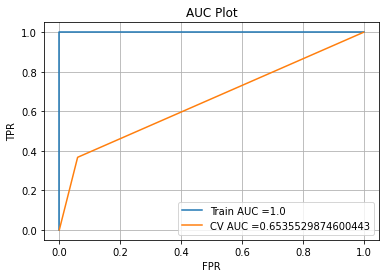

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.060240963855421686 ,TNR:0.9397590361445783 


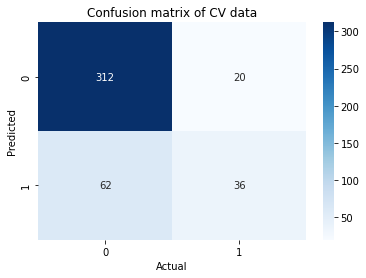

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.11362665380952515
only_fraud_procedure_code_count 0.06253485252640724
only_fraud_physician_count 0.24494076290085576
only_fraud_op_physician_count 0.19157882731361758
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.24      0.38        98

    accuracy                           0.82       430
   macro avg       0.82      0.61      0.64       430
weighted avg       0.82      0.82      0.78       430



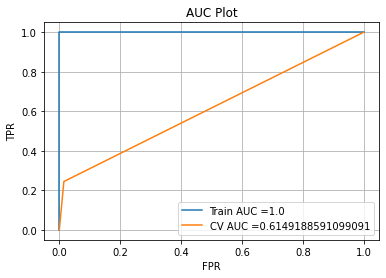

Cross Validation
FNR:0.7551020408163265 ,TPR:0.24489795918367346 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


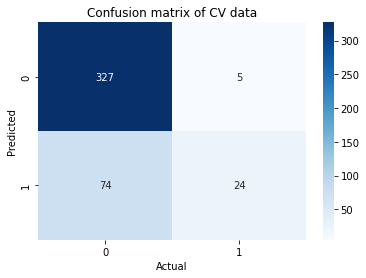

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.12247310634761706
only_fraud_procedure_code_count 0.06758662802136632
only_fraud_physician_count 0.24502407020121383
only_fraud_op_physician_count 0.18596860203534507
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.80      0.33      0.46        98

    accuracy                           0.83       430
   macro avg       0.82      0.65      0.68       430
weighted avg       0.82      0.83      0.80       430



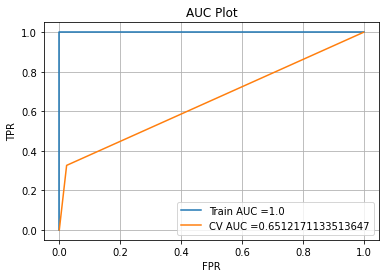

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.024096385542168676 ,TNR:0.9759036144578314 


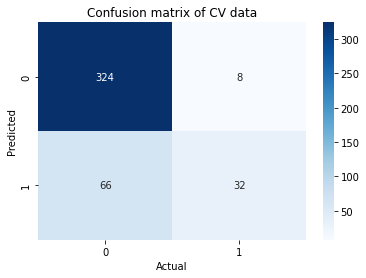

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.10999184484800577
only_fraud_procedure_code_count 0.06246311243406457
only_fraud_physician_count 0.21549107371355095
only_fraud_op_physician_count 0.20707814159188118
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.82      0.28      0.41        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



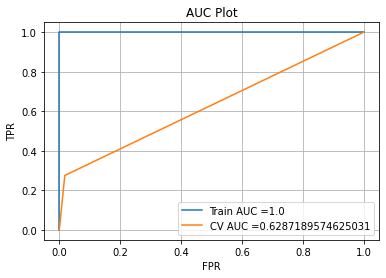

Cross Validation
FNR:0.7244897959183674 ,TPR:0.2755102040816326 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


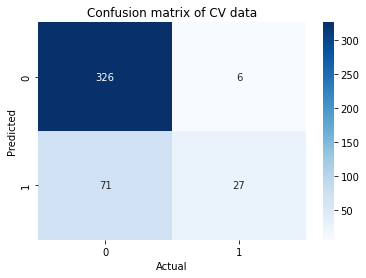

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.11236236913857944
only_fraud_procedure_code_count 0.09800022921582585
only_fraud_physician_count 0.24272046693205596
only_fraud_op_physician_count 0.1897680744942345
              precision    recall  f1-score   support

           0       0.84      0.96      0.89       332
           1       0.72      0.37      0.49        98

    accuracy                           0.82       430
   macro avg       0.78      0.66      0.69       430
weighted avg       0.81      0.82      0.80       430



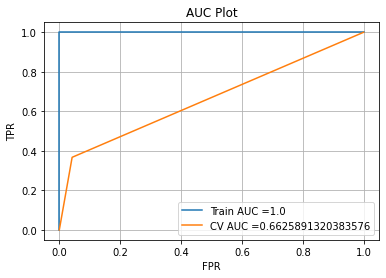

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


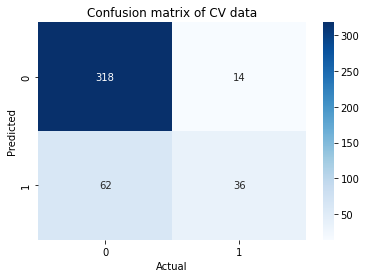

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.12097279981503968
only_fraud_procedure_code_count 0.06955615365506118
only_fraud_physician_count 0.23277552083083555
only_fraud_op_physician_count 0.2030447021245972
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.85      0.30      0.44        98

    accuracy                           0.83       430
   macro avg       0.84      0.64      0.67       430
weighted avg       0.83      0.83      0.79       430



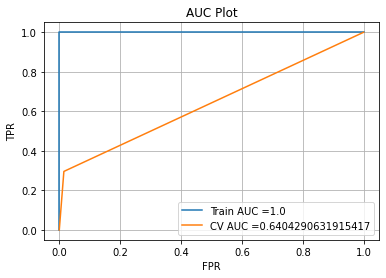

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


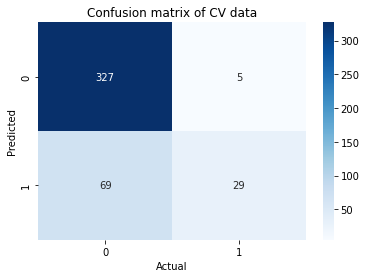

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.11862926303449906
only_fraud_procedure_code_count 0.0709788084654608
only_fraud_physician_count 0.21324890787476905
only_fraud_op_physician_count 0.19230426467944917
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.73      0.31      0.43        98

    accuracy                           0.82       430
   macro avg       0.78      0.64      0.66       430
weighted avg       0.80      0.82      0.79       430



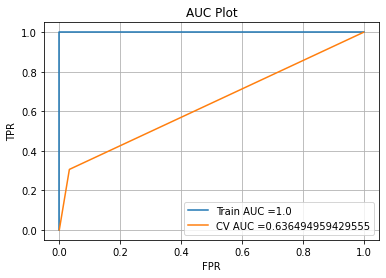

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.03313253012048193 ,TNR:0.9668674698795181 


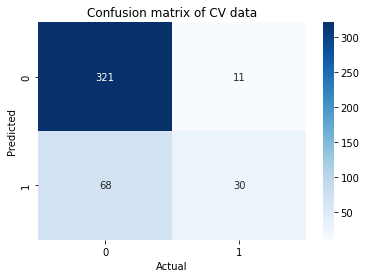

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.12016158325226631
only_fraud_procedure_code_count 0.06557392995098259
only_fraud_physician_count 0.1985986178796698
only_fraud_op_physician_count 0.2367689623976326
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.84      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.83      0.63      0.65       430
weighted avg       0.82      0.82      0.78       430



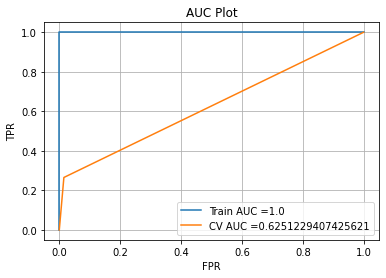

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


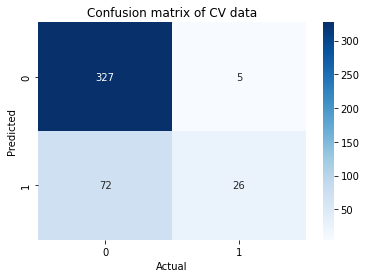

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.12897638314609786
only_fraud_procedure_code_count 0.07350545005485395
only_fraud_physician_count 0.22257298074767834
only_fraud_op_physician_count 0.2048257166660499
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       332
           1       0.74      0.29      0.41        98

    accuracy                           0.81       430
   macro avg       0.78      0.63      0.65       430
weighted avg       0.80      0.81      0.78       430



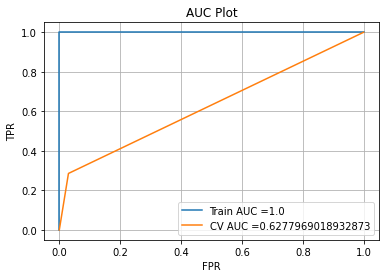

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.030120481927710843 ,TNR:0.9698795180722891 


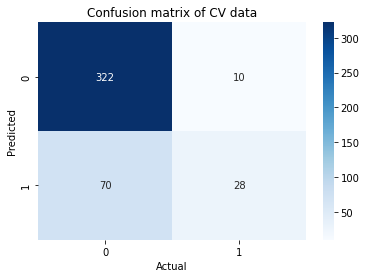

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.12482421263846598
only_fraud_procedure_code_count 0.06800036627113137
only_fraud_physician_count 0.20823755850271133
only_fraud_op_physician_count 0.2048769058086255
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.76      0.33      0.46        98

    accuracy                           0.82       430
   macro avg       0.80      0.65      0.68       430
weighted avg       0.81      0.82      0.79       430



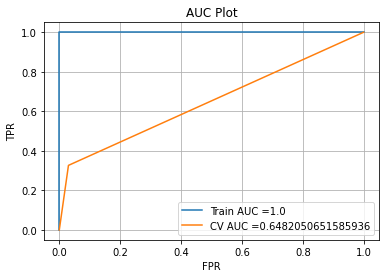

Cross Validation
FNR:0.673469387755102 ,TPR:0.32653061224489793 ,FPR:0.030120481927710843 ,TNR:0.9698795180722891 


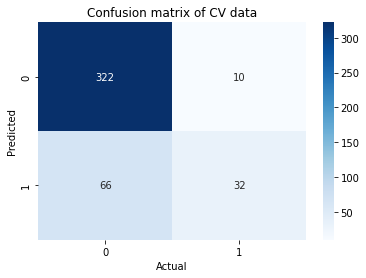

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.11698987668201086
only_fraud_procedure_code_count 0.07199552039571519
only_fraud_physician_count 0.2400278105385083
only_fraud_op_physician_count 0.1963520014308525
              precision    recall  f1-score   support

           0       0.83      0.97      0.89       332
           1       0.75      0.31      0.43        98

    accuracy                           0.82       430
   macro avg       0.79      0.64      0.66       430
weighted avg       0.81      0.82      0.79       430



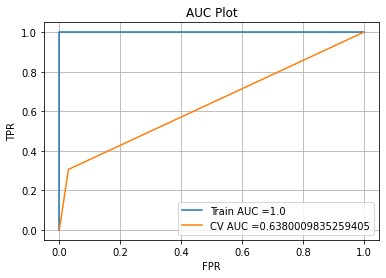

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.030120481927710843 ,TNR:0.9698795180722891 


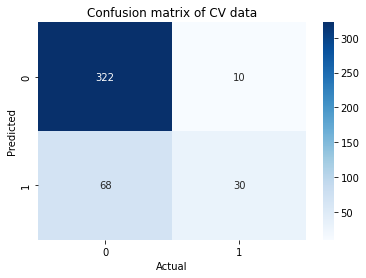

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.11267176259037971
only_fraud_procedure_code_count 0.08172421540620842
only_fraud_physician_count 0.20794476624983277
only_fraud_op_physician_count 0.24171490050036382
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.82      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



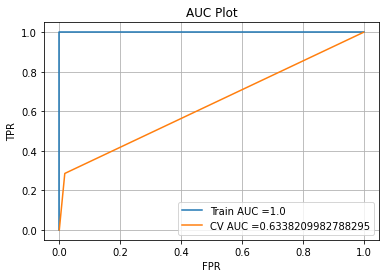

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


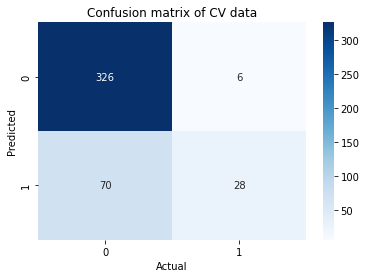

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.10633521481501888
only_fraud_procedure_code_count 0.0679780629767396
only_fraud_physician_count 0.2346418536404295
only_fraud_op_physician_count 0.2257104102281399
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.82      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



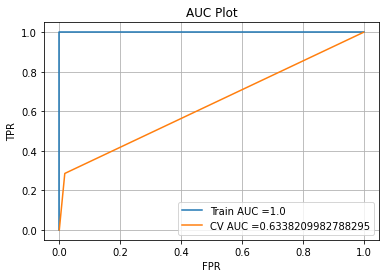

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


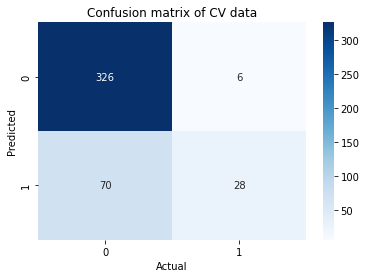

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.10880949987976093
only_fraud_procedure_code_count 0.07284933916150443
only_fraud_physician_count 0.21857861213850124
only_fraud_op_physician_count 0.20516747112306963
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.81      0.31      0.44        98

    accuracy                           0.83       430
   macro avg       0.82      0.64      0.67       430
weighted avg       0.82      0.83      0.79       430



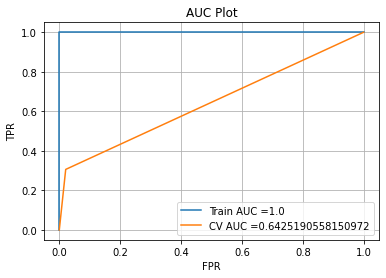

Cross Validation
FNR:0.6938775510204082 ,TPR:0.30612244897959184 ,FPR:0.02108433734939759 ,TNR:0.9789156626506024 


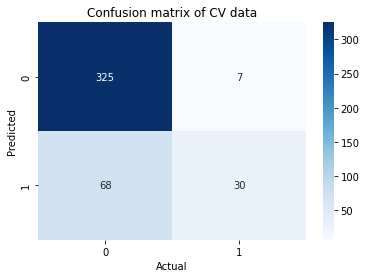

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.122237812179639
only_fraud_procedure_code_count 0.08190700269579884
only_fraud_physician_count 0.2296172449583075
only_fraud_op_physician_count 0.19627322351606377
              precision    recall  f1-score   support

           0       0.83      0.96      0.89       332
           1       0.72      0.32      0.44        98

    accuracy                           0.82       430
   macro avg       0.77      0.64      0.66       430
weighted avg       0.80      0.82      0.79       430



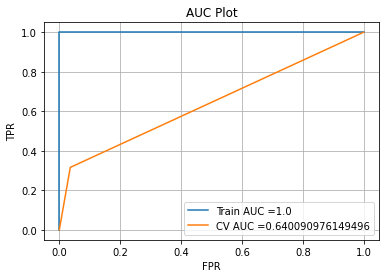

Cross Validation
FNR:0.6836734693877551 ,TPR:0.3163265306122449 ,FPR:0.03614457831325301 ,TNR:0.963855421686747 


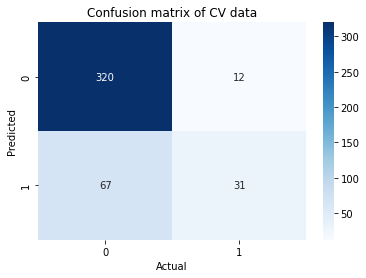

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.11169770044957647
only_fraud_procedure_code_count 0.06942370086802105
only_fraud_physician_count 0.2184251633177471
only_fraud_op_physician_count 0.2369287009470009
              precision    recall  f1-score   support

           0       0.82      0.98      0.90       332
           1       0.82      0.29      0.42        98

    accuracy                           0.82       430
   macro avg       0.82      0.63      0.66       430
weighted avg       0.82      0.82      0.79       430



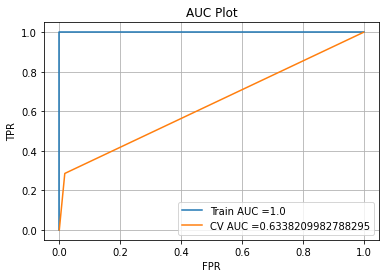

Cross Validation
FNR:0.7142857142857143 ,TPR:0.2857142857142857 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


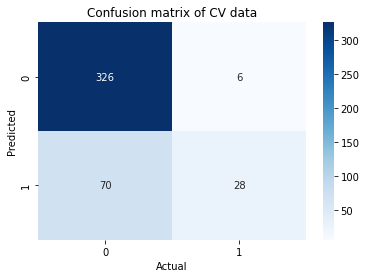

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.11375129399465869
only_fraud_procedure_code_count 0.06908474492850204
only_fraud_physician_count 0.22140569682298944
only_fraud_op_physician_count 0.21768347933755755
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.81      0.27      0.40        98

    accuracy                           0.82       430
   macro avg       0.82      0.62      0.65       430
weighted avg       0.82      0.82      0.78       430



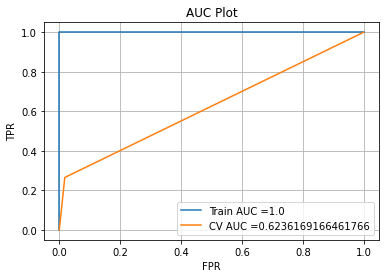

Cross Validation
FNR:0.7346938775510204 ,TPR:0.2653061224489796 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


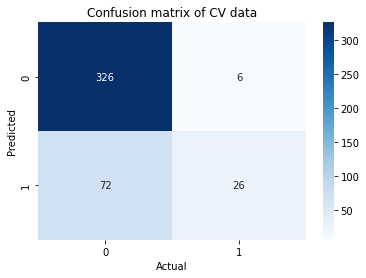

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.1050650516913342
only_fraud_procedure_code_count 0.06892277071591833
only_fraud_physician_count 0.2325145429363878
only_fraud_op_physician_count 0.2120332925905481
              precision    recall  f1-score   support

           0       0.82      0.98      0.89       332
           1       0.83      0.26      0.39        98

    accuracy                           0.82       430
   macro avg       0.83      0.62      0.64       430
weighted avg       0.82      0.82      0.78       430



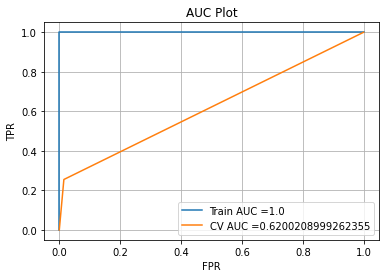

Cross Validation
FNR:0.7448979591836735 ,TPR:0.25510204081632654 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


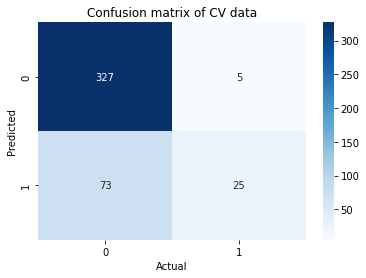

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.10759672403632572
only_fraud_procedure_code_count 0.07620412240603557
only_fraud_physician_count 0.22567791814770122
only_fraud_op_physician_count 0.21286461902435222
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       332
           1       0.83      0.30      0.44        98

    accuracy                           0.83       430
   macro avg       0.83      0.64      0.67       430
weighted avg       0.83      0.83      0.79       430



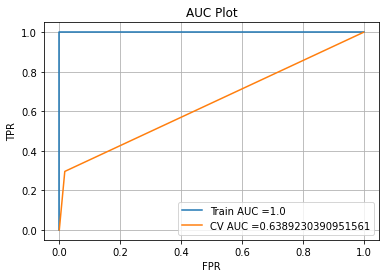

Cross Validation
FNR:0.7040816326530612 ,TPR:0.29591836734693877 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


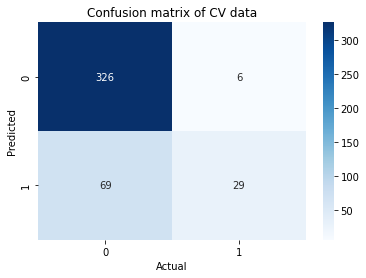

In [71]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_70_30,y_inpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

In [72]:
from xgboost import XGBClassifier

c:\programdata\miniconda3\lib\site-packages\pkg_resources\__init__.py:122: PkgResourcesDeprecationWarning: mpy is an invalid version and will not be supported in a future release
  warnings.warn(


<h2>XgBoost Forest</h2>

Original Distribution

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.7278505
only_fraud_op_physician_count 0.24747032
              precision    recall  f1-score   support

           0       0.78      0.99      0.87       332
           1       0.64      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.71      0.53      0.50       430
weighted avg       0.75      0.78      0.70       430



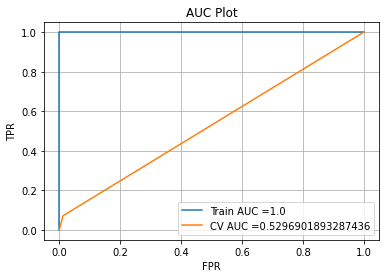

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


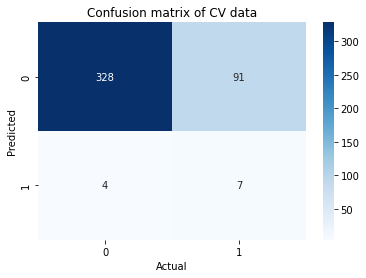

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



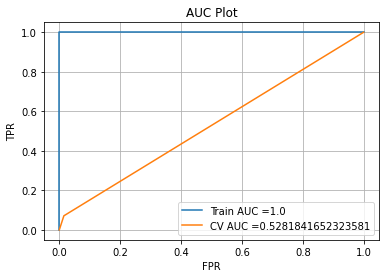

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


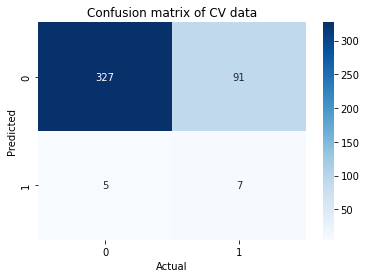

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



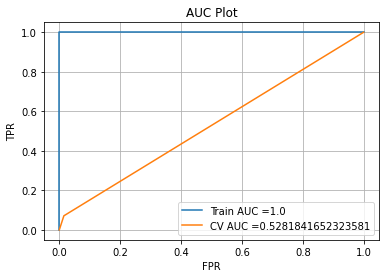

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


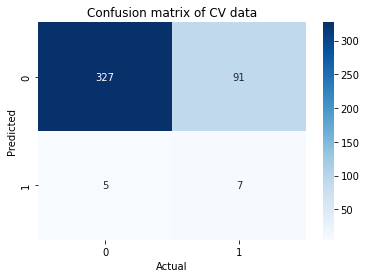

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



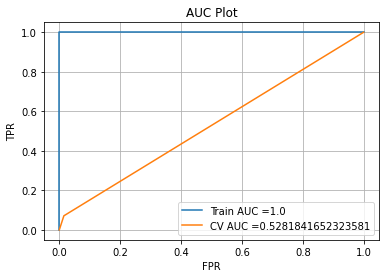

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


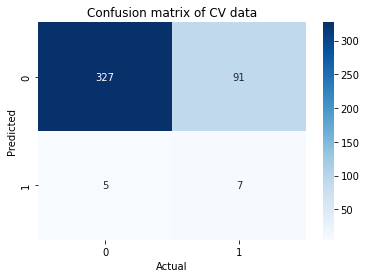

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.72789097
only_fraud_op_physician_count 0.24748409
              precision    recall  f1-score   support

           0       0.78      0.99      0.87       332
           1       0.64      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.71      0.53      0.50       430
weighted avg       0.75      0.78      0.70       430



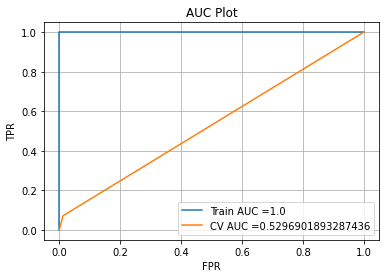

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


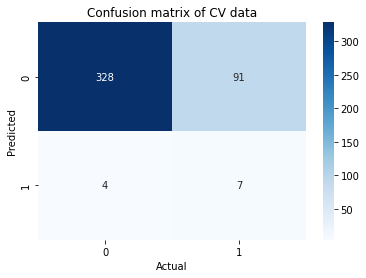

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



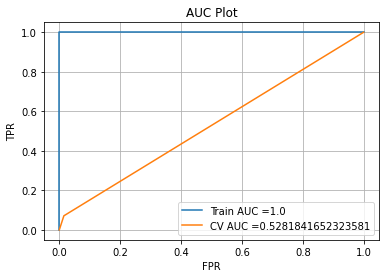

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


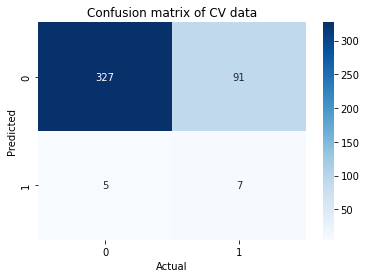

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



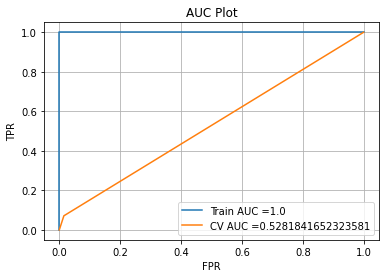

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


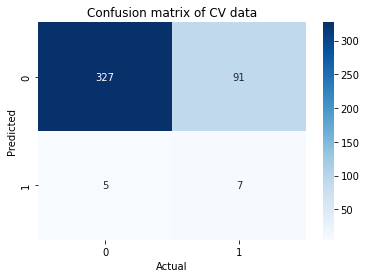

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



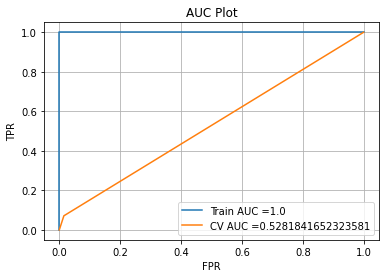

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


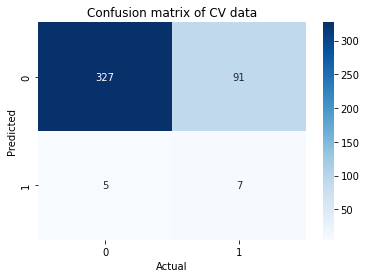

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.72789097
only_fraud_op_physician_count 0.24748409
              precision    recall  f1-score   support

           0       0.78      0.99      0.87       332
           1       0.64      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.71      0.53      0.50       430
weighted avg       0.75      0.78      0.70       430



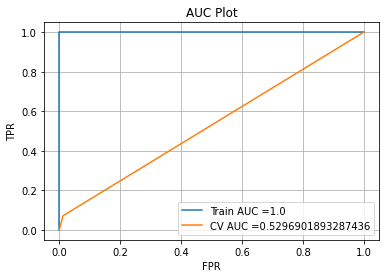

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


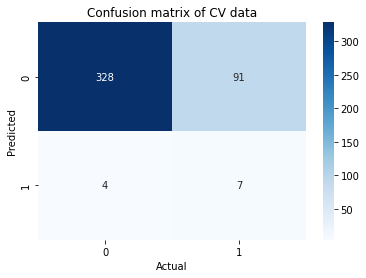

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



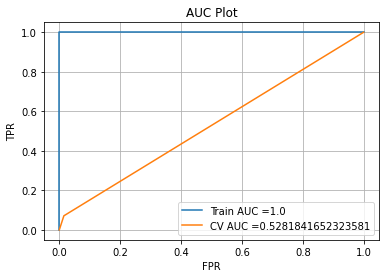

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


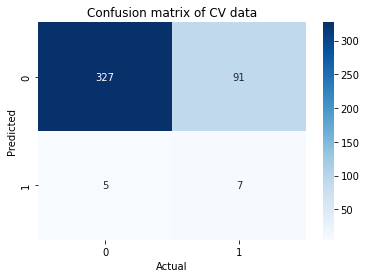

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



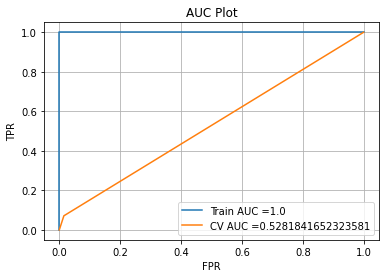

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


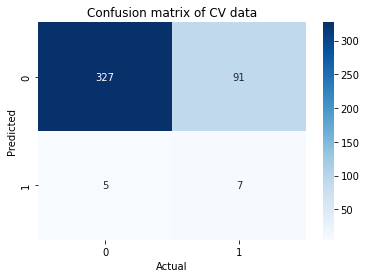

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



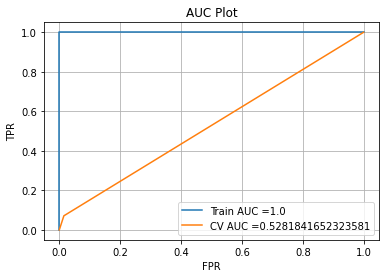

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


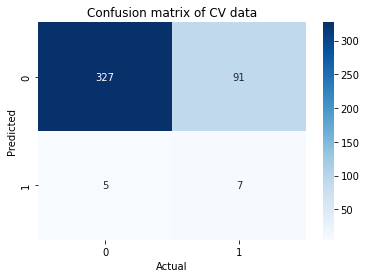

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.72789097
only_fraud_op_physician_count 0.24748409
              precision    recall  f1-score   support

           0       0.78      0.99      0.87       332
           1       0.64      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.71      0.53      0.50       430
weighted avg       0.75      0.78      0.70       430



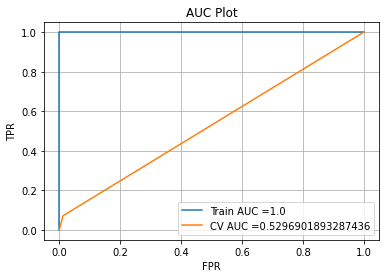

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


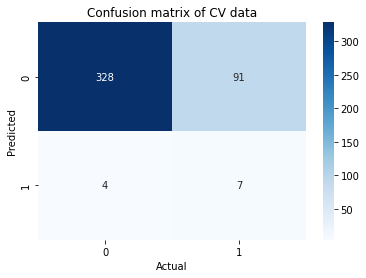

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



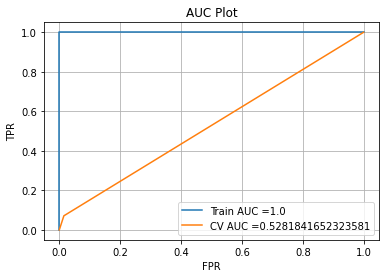

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


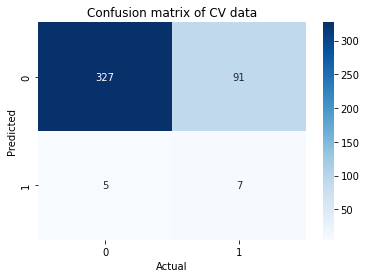

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



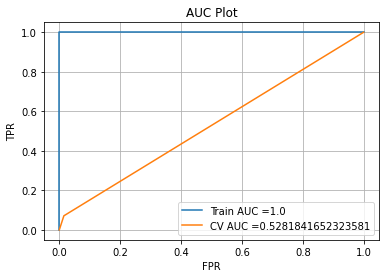

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


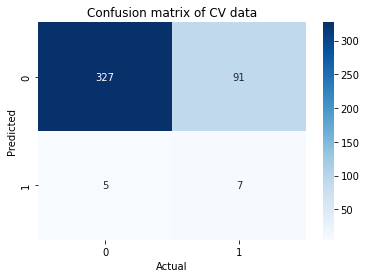

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.78319037
only_fraud_op_physician_count 0.20046481
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



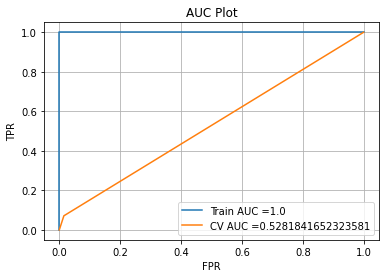

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


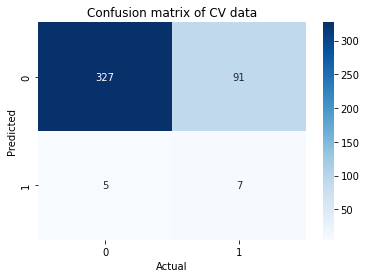

In [73]:
for n_est in [100,200,500,1000]:
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_train_inpatient,y_train_inpatient.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_inpatient.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_train_inpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.7625326
only_fraud_op_physician_count 0.22977014
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.60      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.69      0.54      0.52       430
weighted avg       0.74      0.78      0.71       430



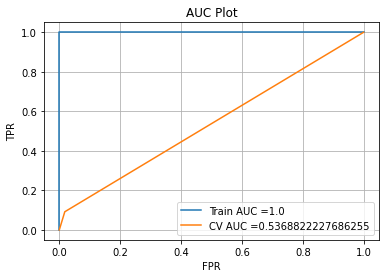

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


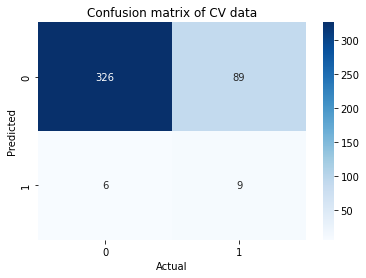

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



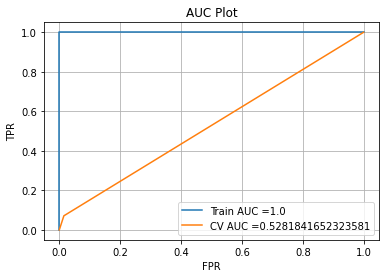

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


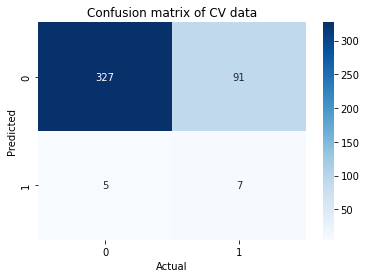

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



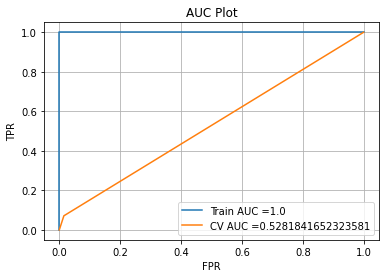

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


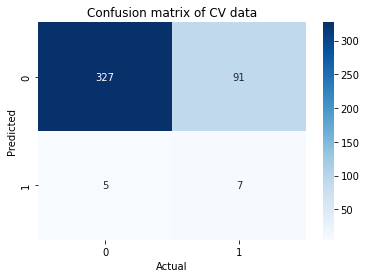

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



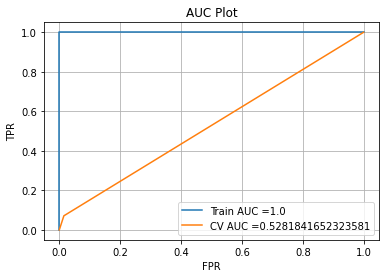

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


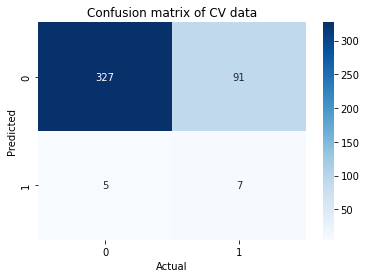

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.7625326
only_fraud_op_physician_count 0.22977014
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.60      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.69      0.54      0.52       430
weighted avg       0.74      0.78      0.71       430



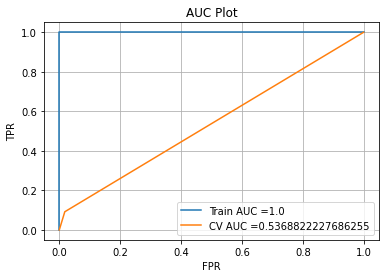

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


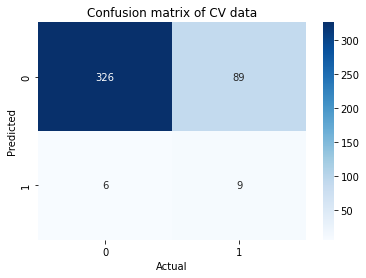

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



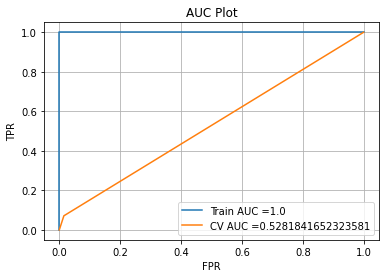

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


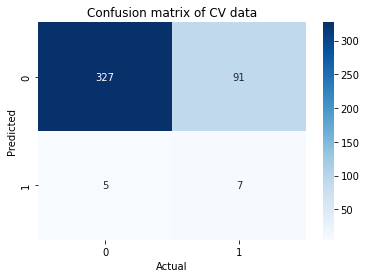

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



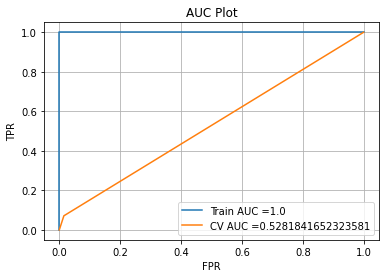

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


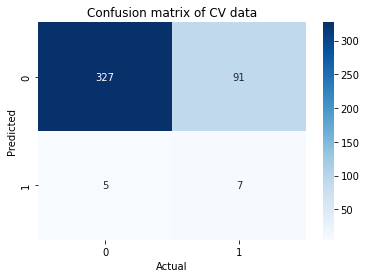

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



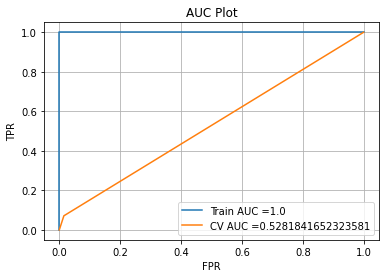

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


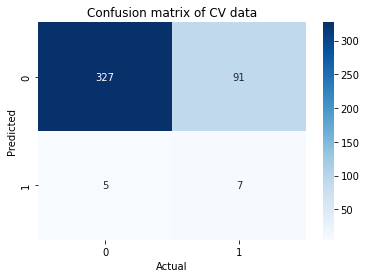

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.7625326
only_fraud_op_physician_count 0.22977014
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.60      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.69      0.54      0.52       430
weighted avg       0.74      0.78      0.71       430



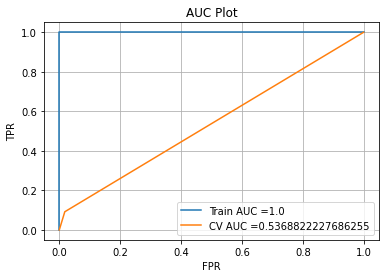

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


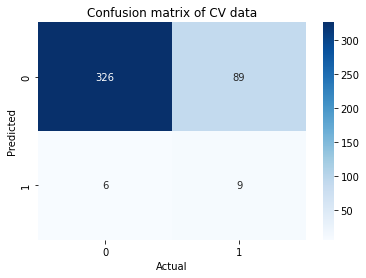

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



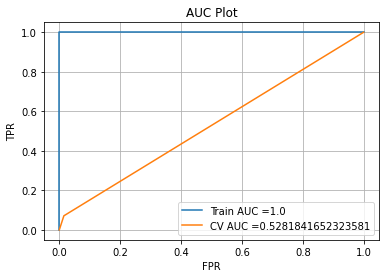

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


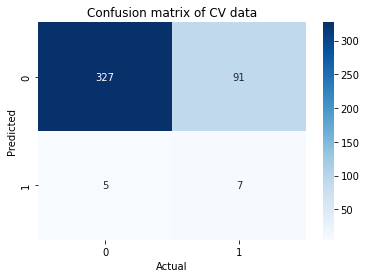

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



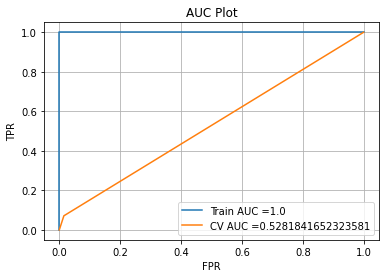

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


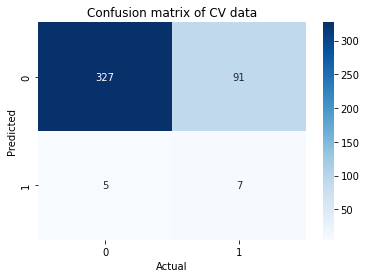

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



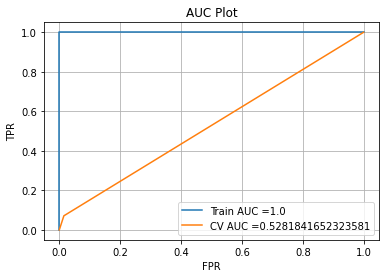

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


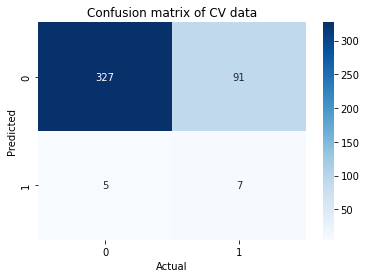

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.7625326
only_fraud_op_physician_count 0.22977014
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.60      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.69      0.54      0.52       430
weighted avg       0.74      0.78      0.71       430



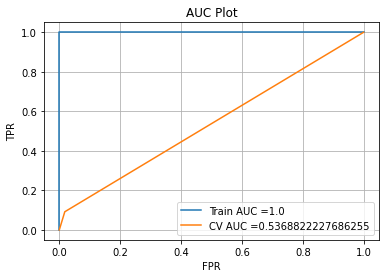

Cross validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.018072289156626505 ,TNR:0.9819277108433735 


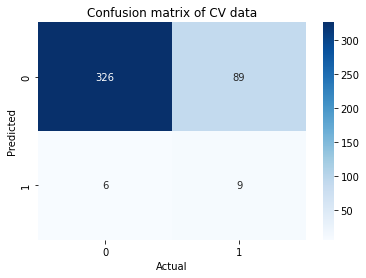

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



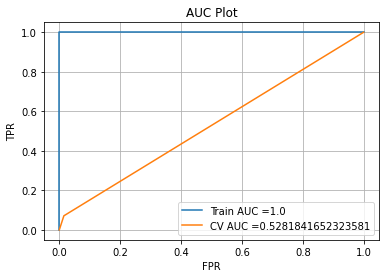

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


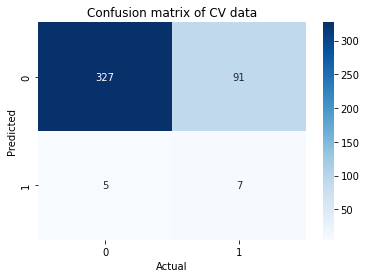

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



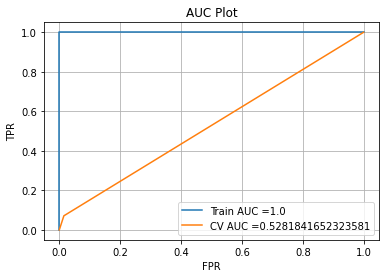

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


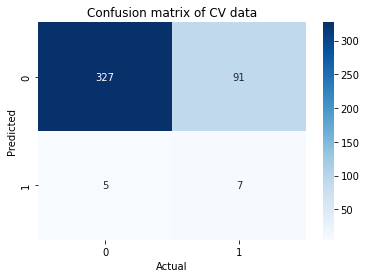

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.8048196
only_fraud_op_physician_count 0.19159484
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



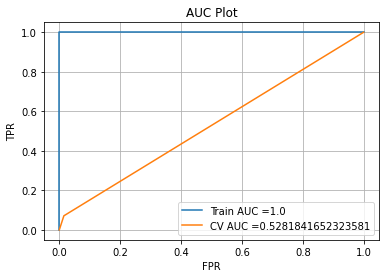

Cross validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


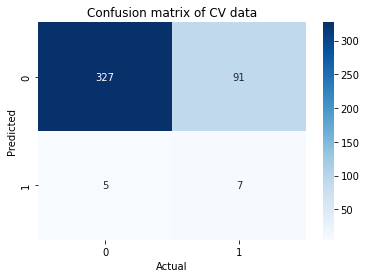

In [74]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_50_50,y_inpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.75581276
only_fraud_op_physician_count 0.23254757
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.64      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.71      0.54      0.52       430
weighted avg       0.75      0.78      0.71       430



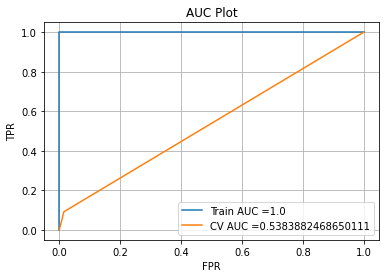

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


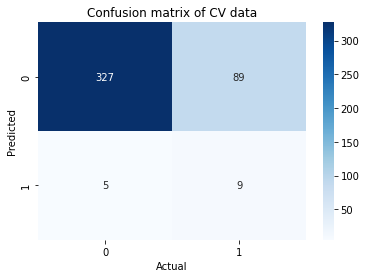

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



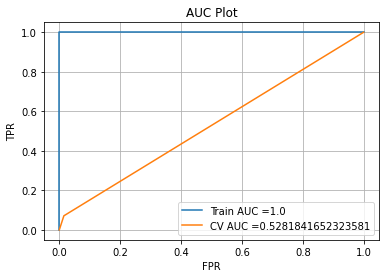

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


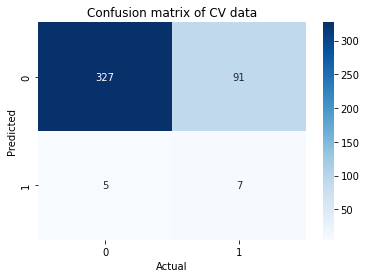

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



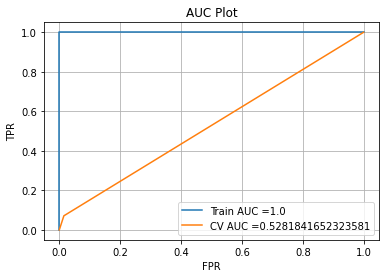

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


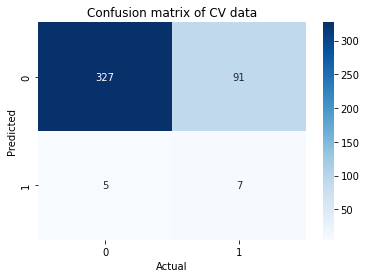

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



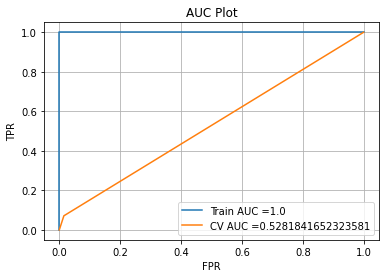

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


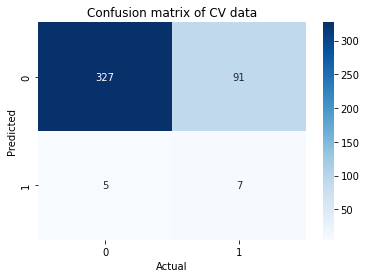

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.75581276
only_fraud_op_physician_count 0.23254757
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.64      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.71      0.54      0.52       430
weighted avg       0.75      0.78      0.71       430



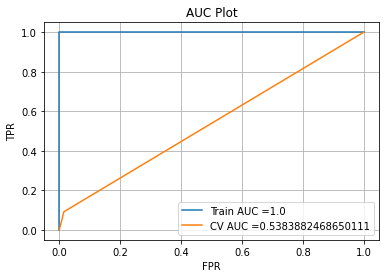

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


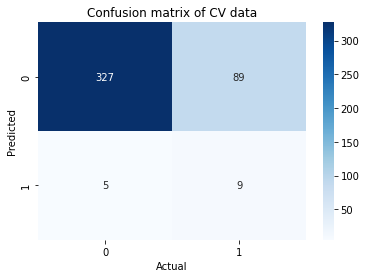

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



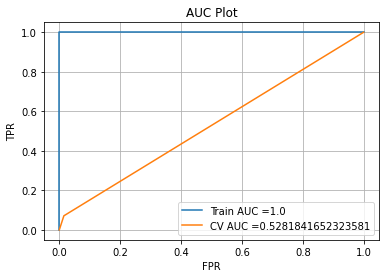

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


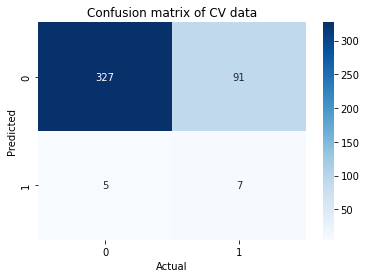

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



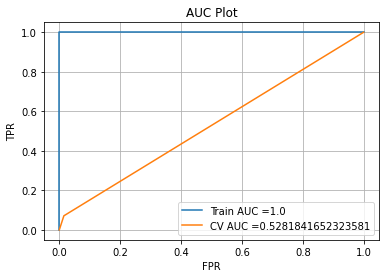

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


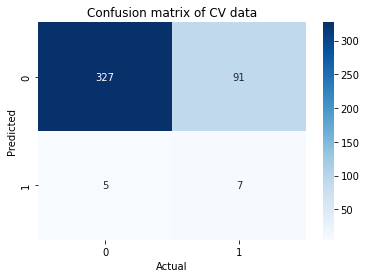

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



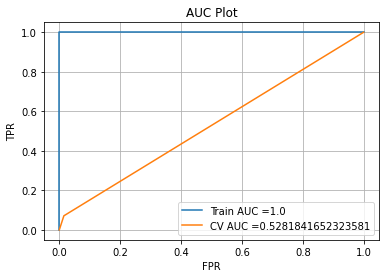

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


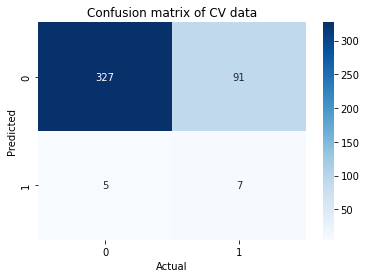

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.75581276
only_fraud_op_physician_count 0.23254757
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.64      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.71      0.54      0.52       430
weighted avg       0.75      0.78      0.71       430



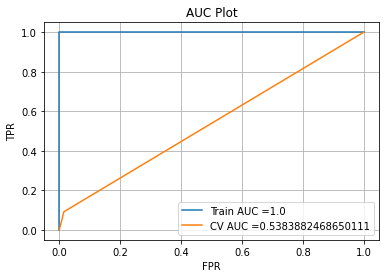

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


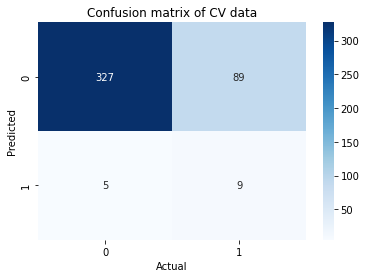

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



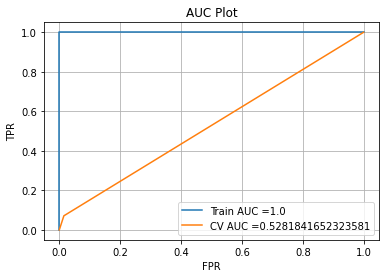

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


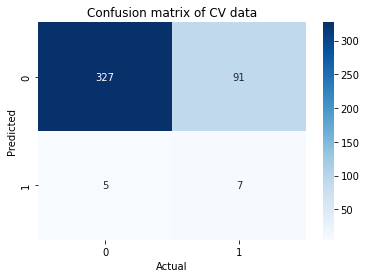

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



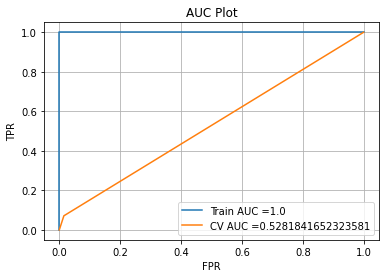

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


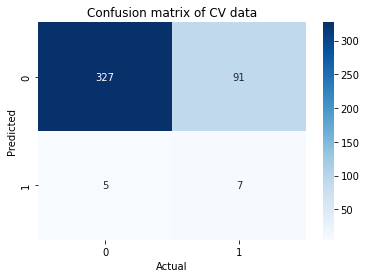

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



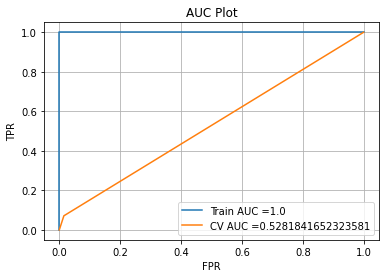

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


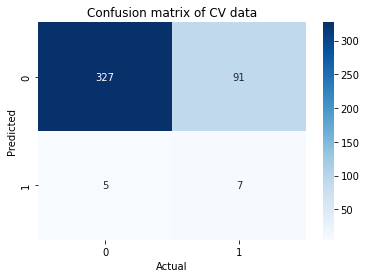

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.75581276
only_fraud_op_physician_count 0.23254757
              precision    recall  f1-score   support

           0       0.79      0.98      0.87       332
           1       0.64      0.09      0.16        98

    accuracy                           0.78       430
   macro avg       0.71      0.54      0.52       430
weighted avg       0.75      0.78      0.71       430



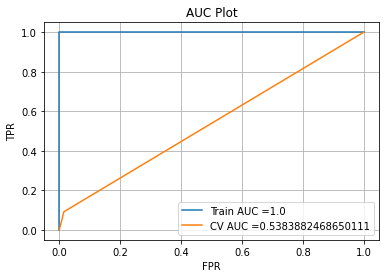

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


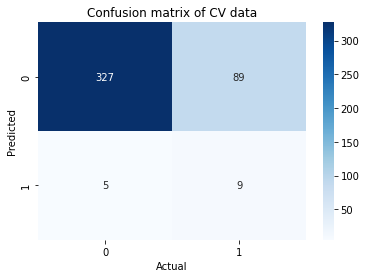

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



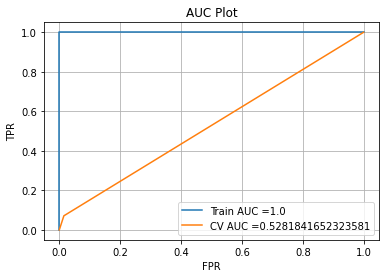

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


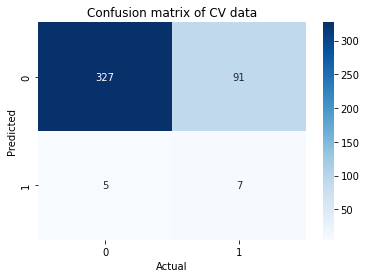

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



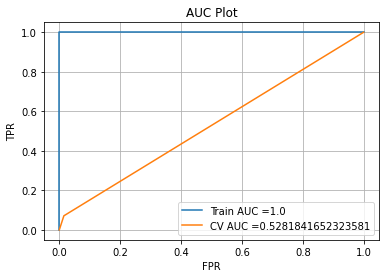

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


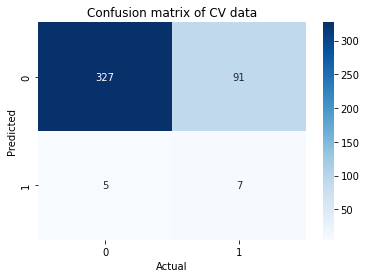

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.78810483
only_fraud_op_physician_count 0.20632783
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



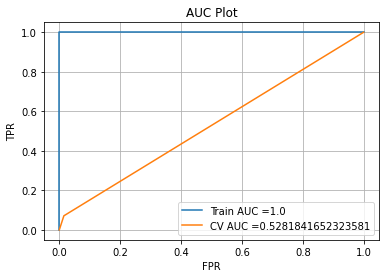

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


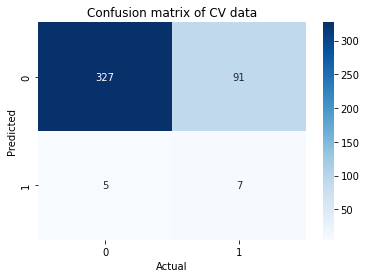

In [75]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_60_40,y_inpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.7642279
only_fraud_op_physician_count 0.21758607
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



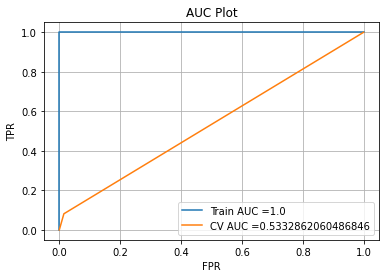

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


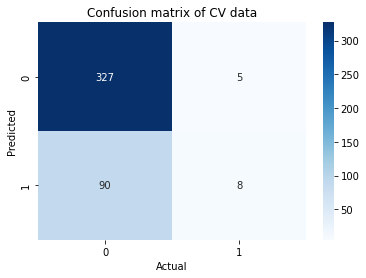

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



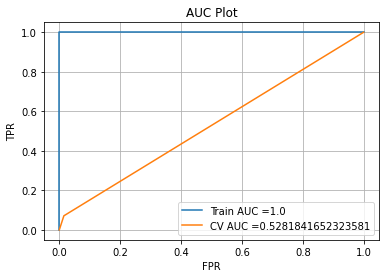

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


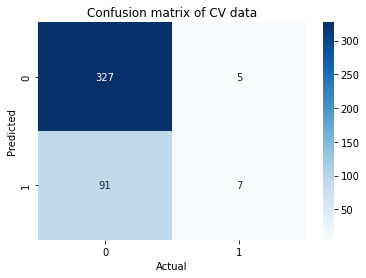

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



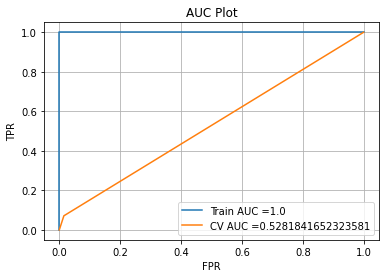

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


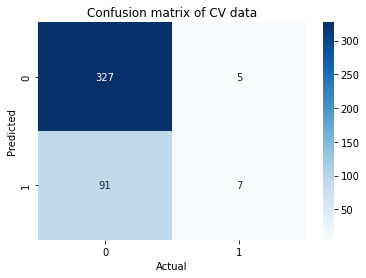

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



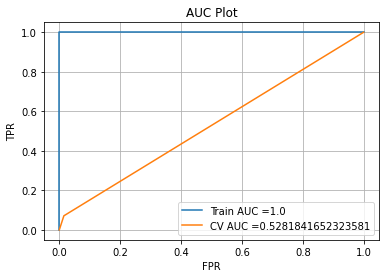

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


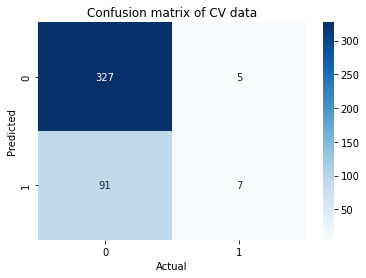

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.7642279
only_fraud_op_physician_count 0.21758607
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



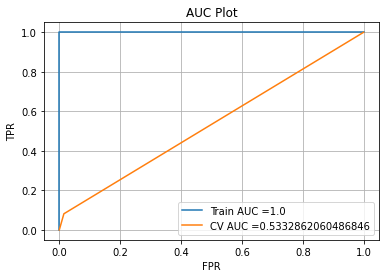

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


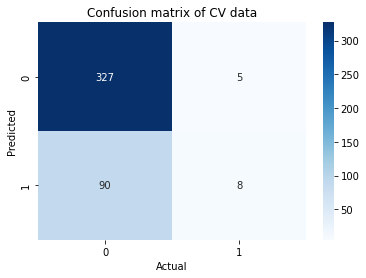

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



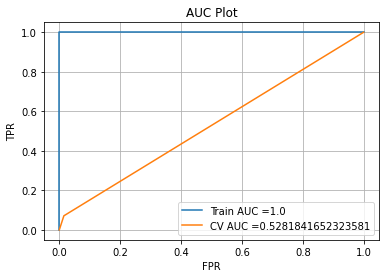

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


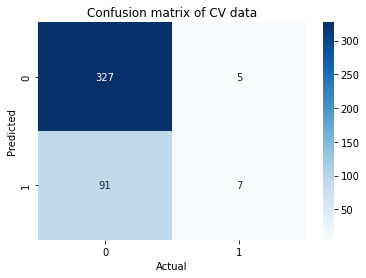

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



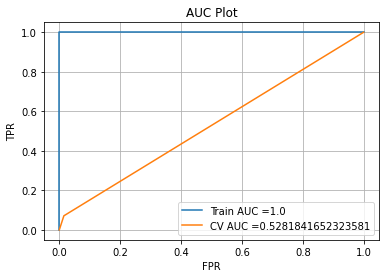

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


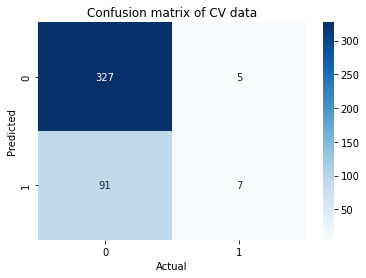

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



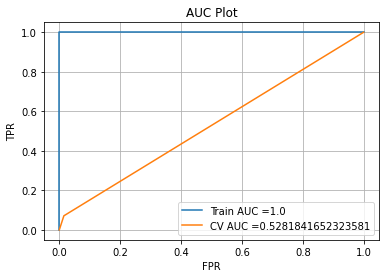

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


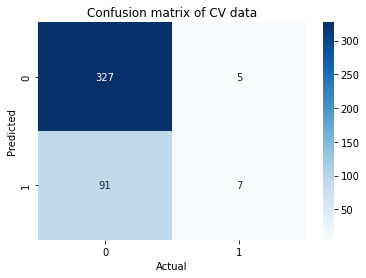

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.7642279
only_fraud_op_physician_count 0.21758607
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



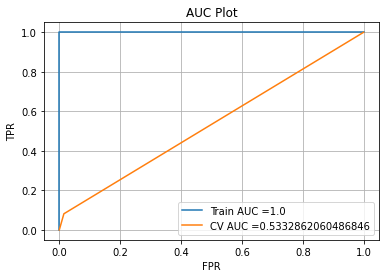

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


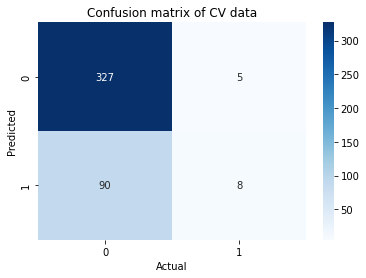

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



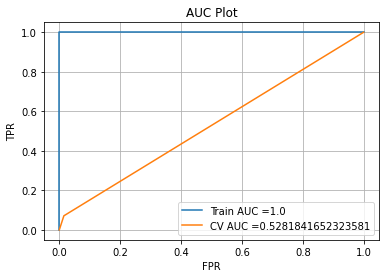

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


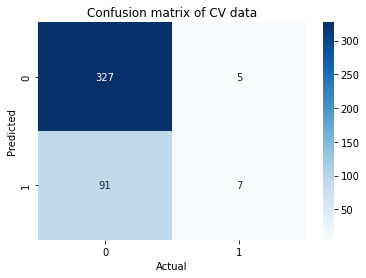

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



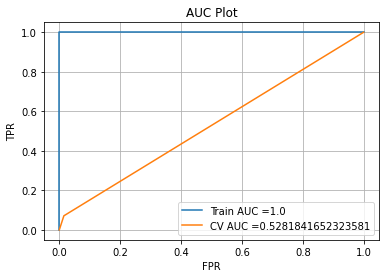

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


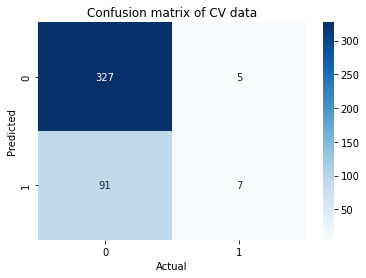

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



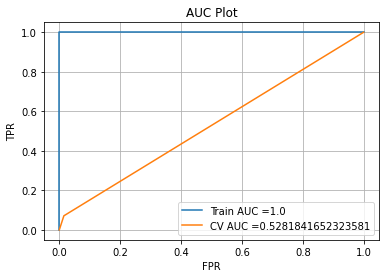

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


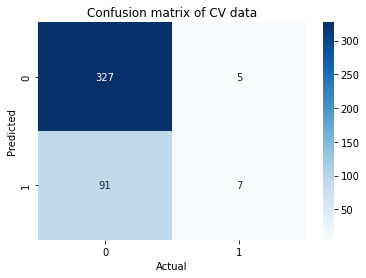

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.7642279
only_fraud_op_physician_count 0.21758607
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



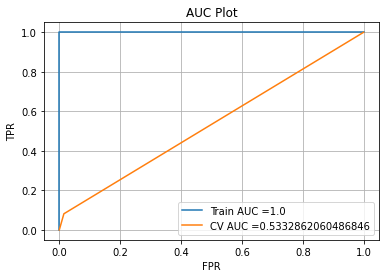

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


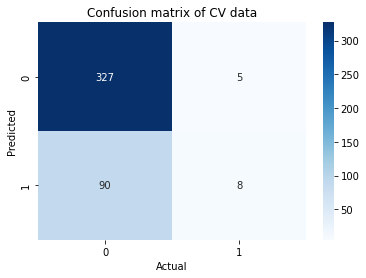

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



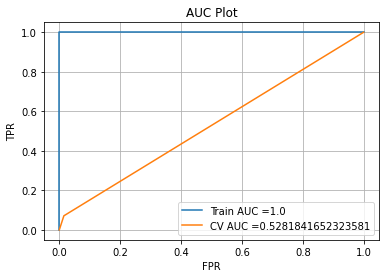

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


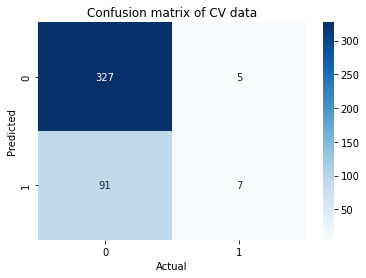

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



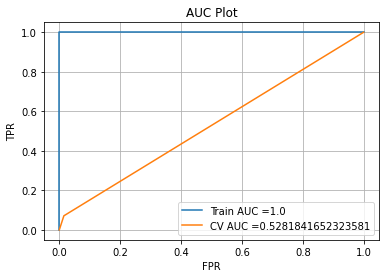

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


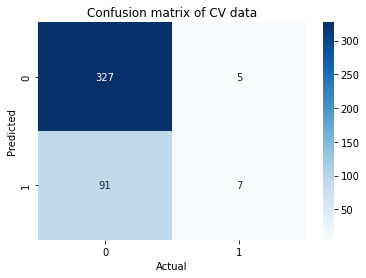

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.77729136
only_fraud_op_physician_count 0.2116067
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.58      0.07      0.13        98

    accuracy                           0.78       430
   macro avg       0.68      0.53      0.50       430
weighted avg       0.74      0.78      0.70       430



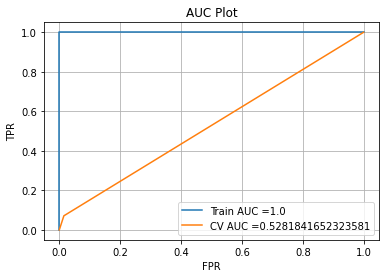

Cross Validation
FNR:0.9285714285714286 ,TPR:0.07142857142857142 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


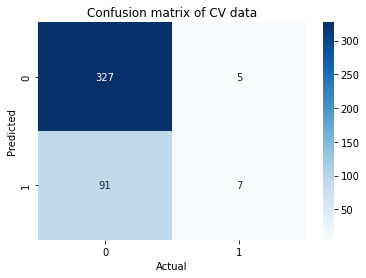

In [76]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_inpatient_70_30,y_inpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_inpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Decision Tree</h2>

In [77]:
from sklearn.tree import DecisionTreeClassifier

Original Distribution

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



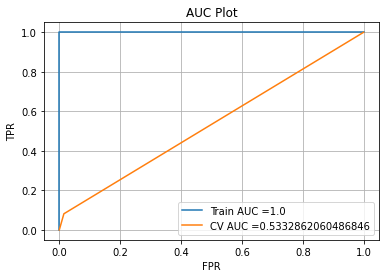

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


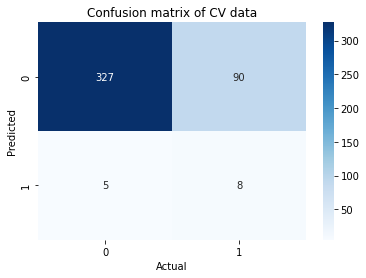

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



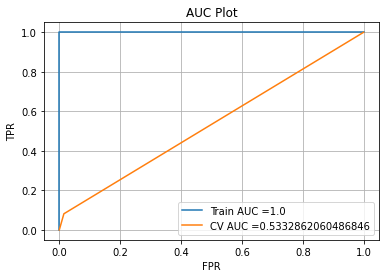

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


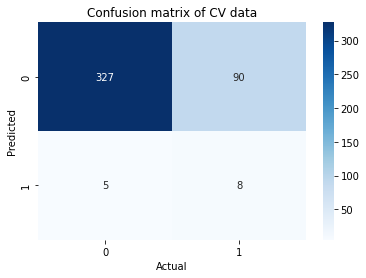

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



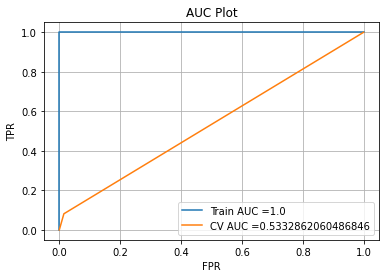

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


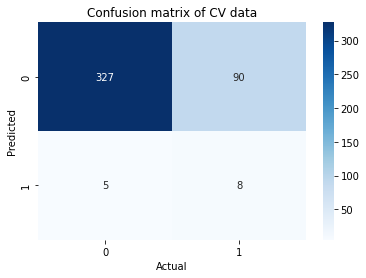

              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



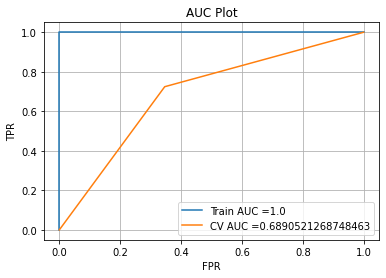

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


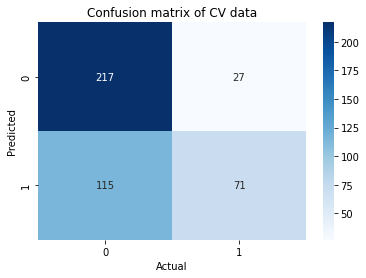

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



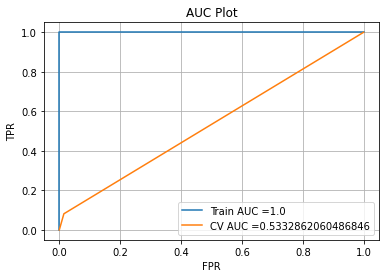

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


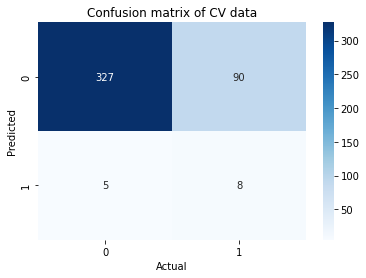

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



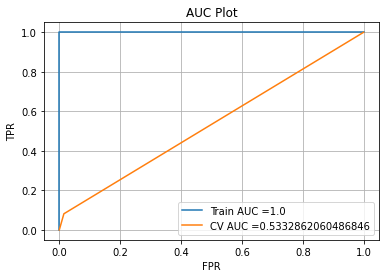

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


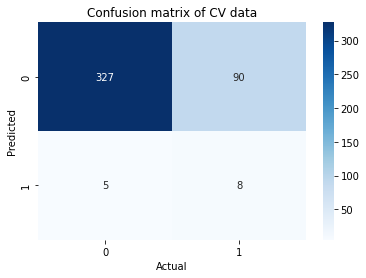

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



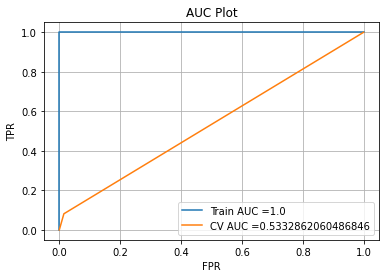

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


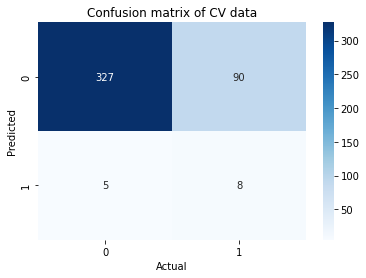

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



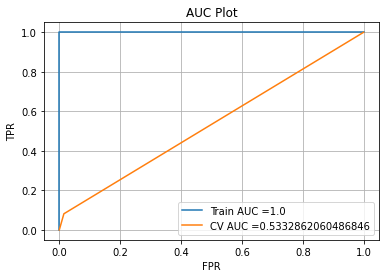

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


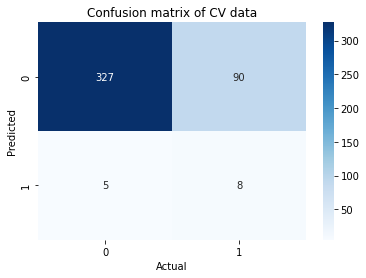

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



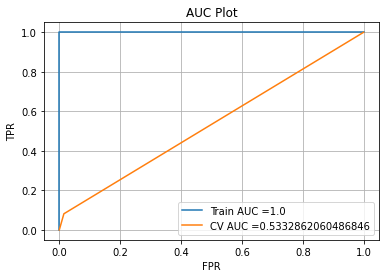

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


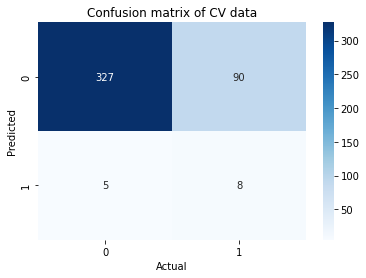

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



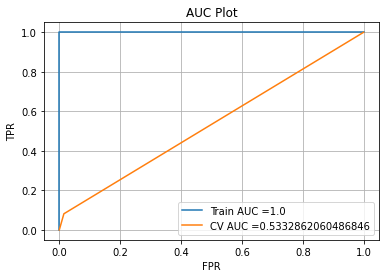

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


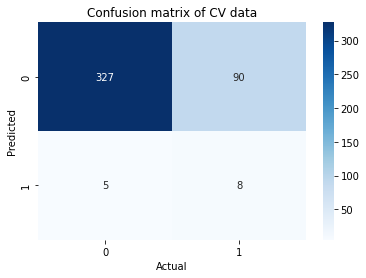

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



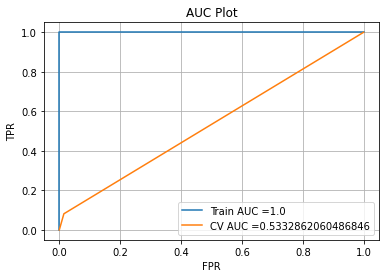

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


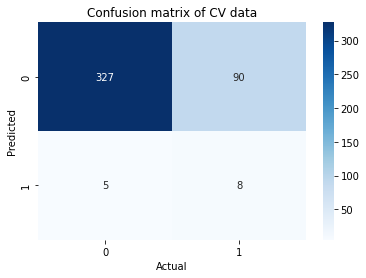

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



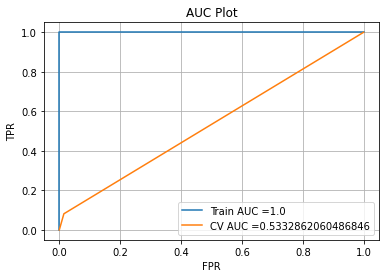

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


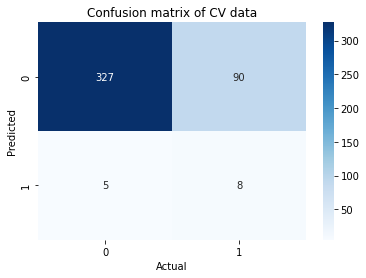

              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



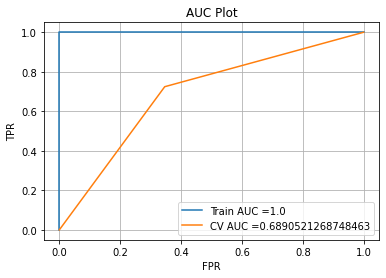

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


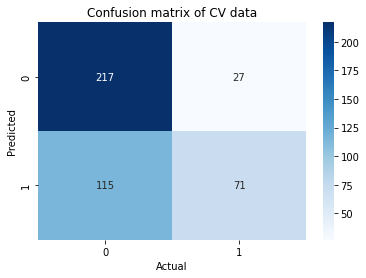

              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



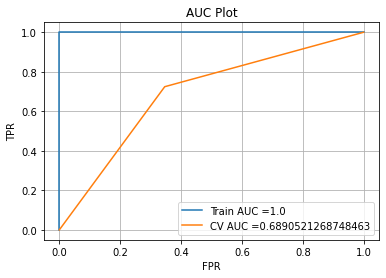

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


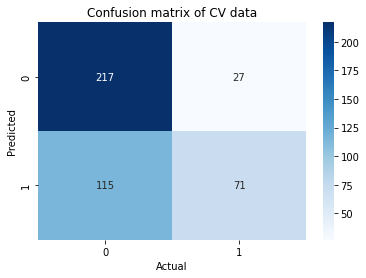

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



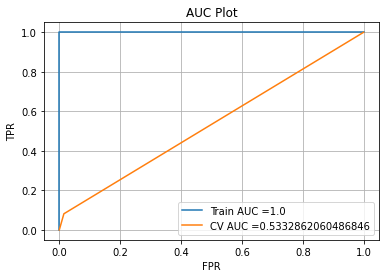

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


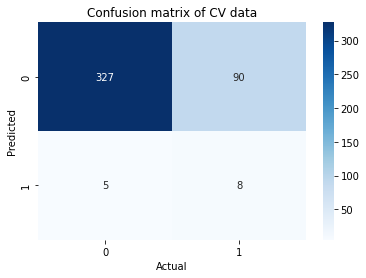

              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



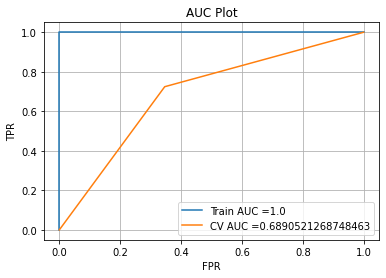

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


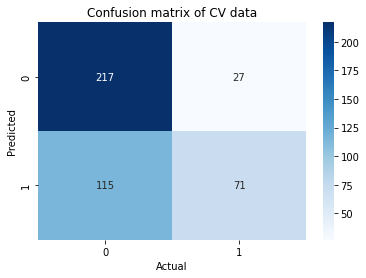

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



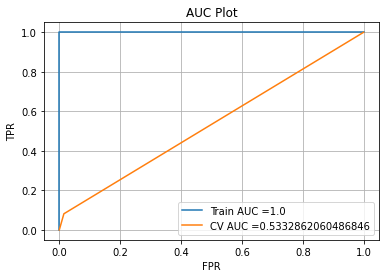

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


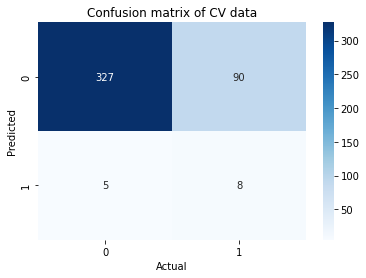

              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



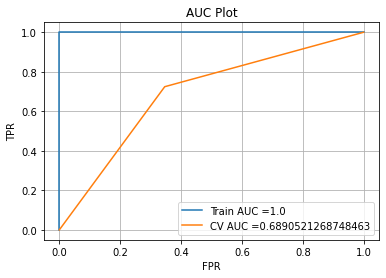

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


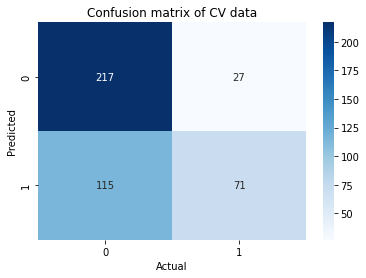

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



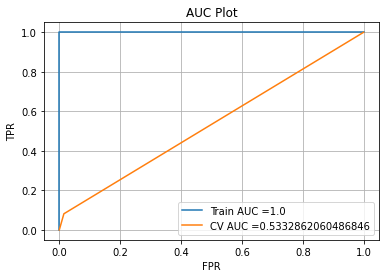

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


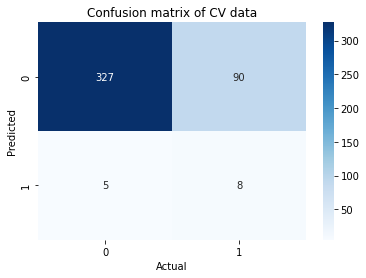

              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



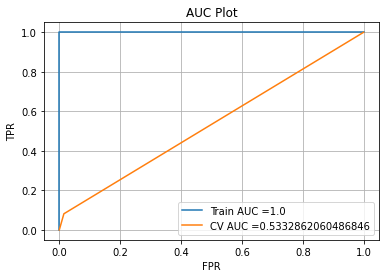

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


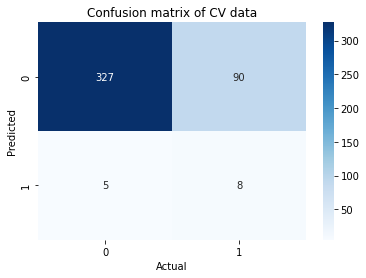

In [78]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:0.76,0:0.23})
        clf.fit(X_train_inpatient,y_train_inpatient.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_train_inpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



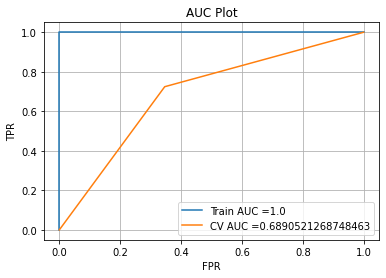

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


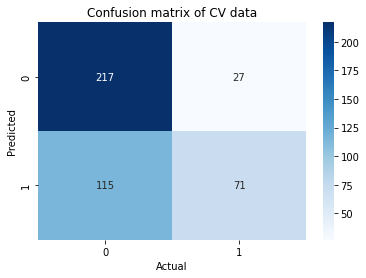

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



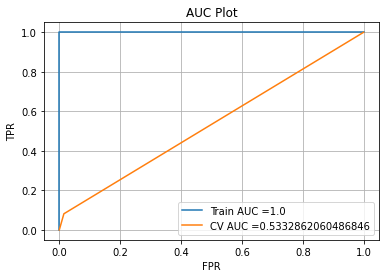

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


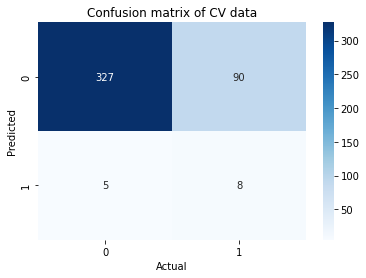

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



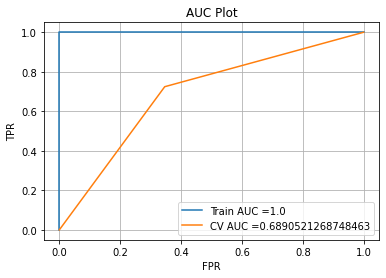

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


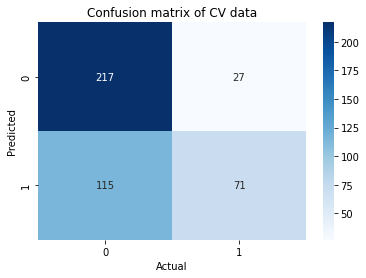

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



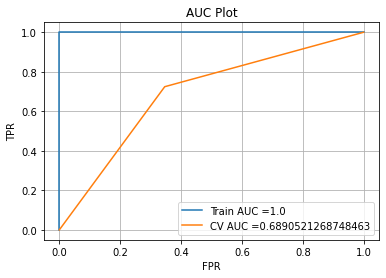

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


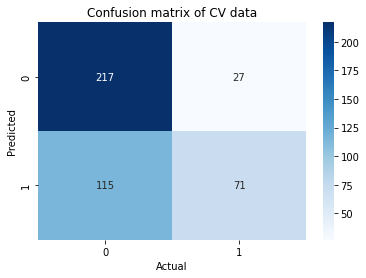

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



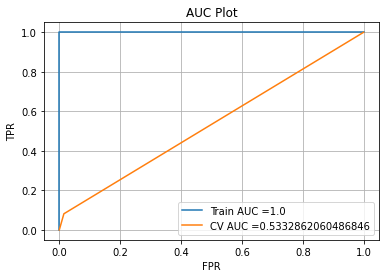

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


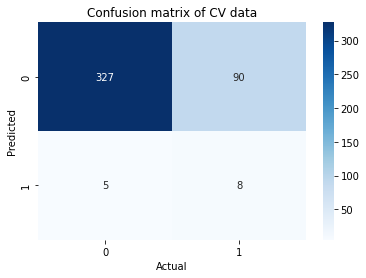

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



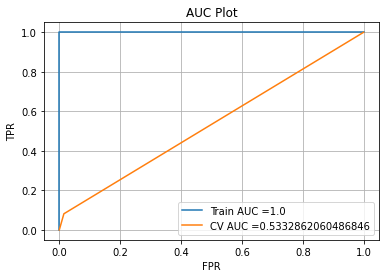

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


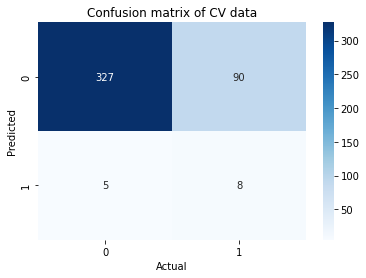

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



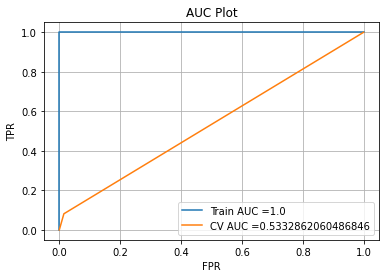

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


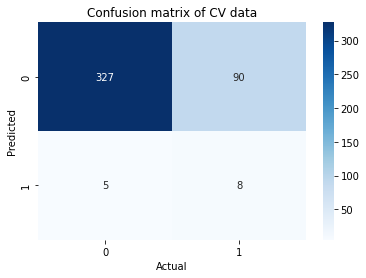

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



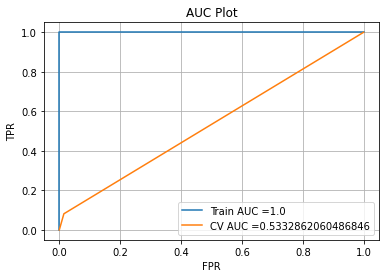

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


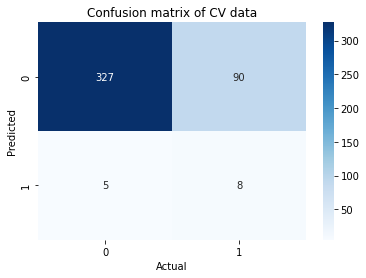

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



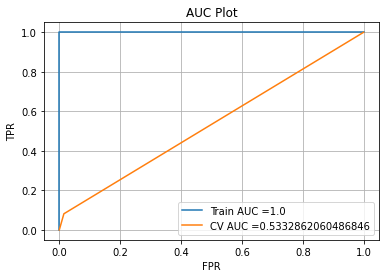

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


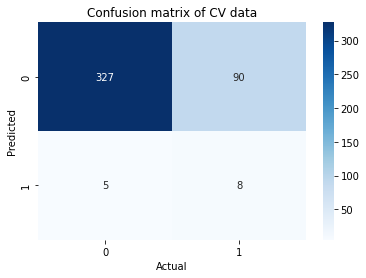

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



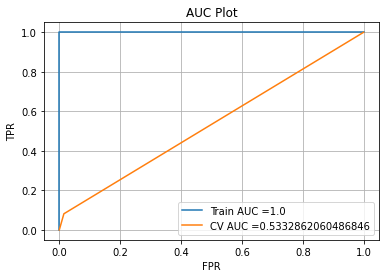

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


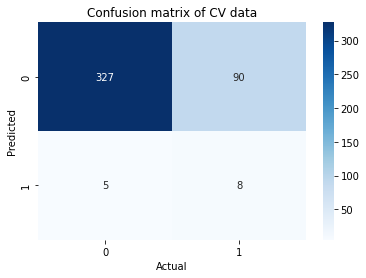

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



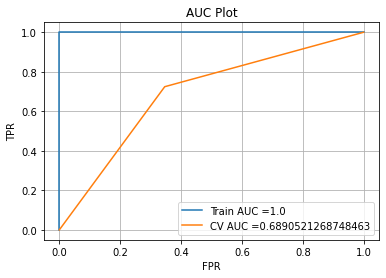

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


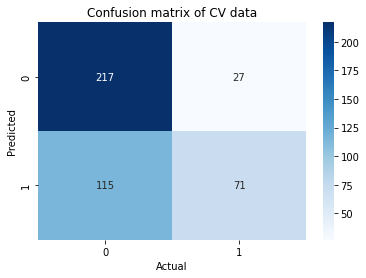

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



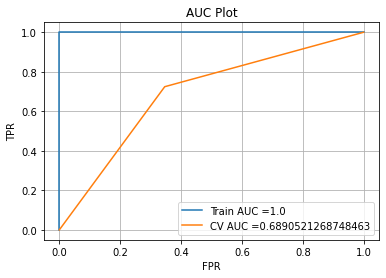

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


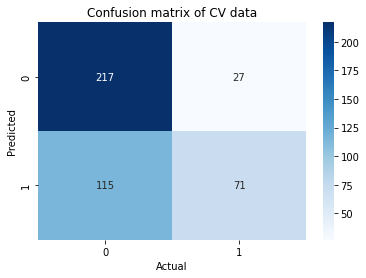

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



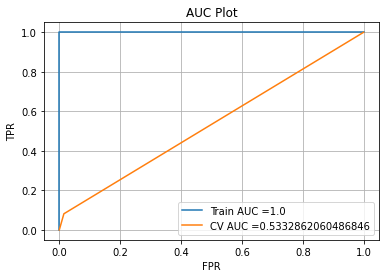

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


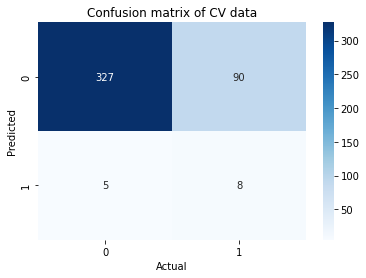

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



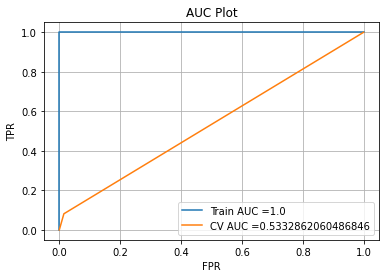

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


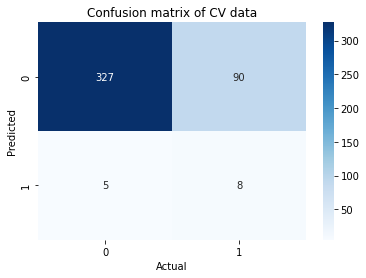

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



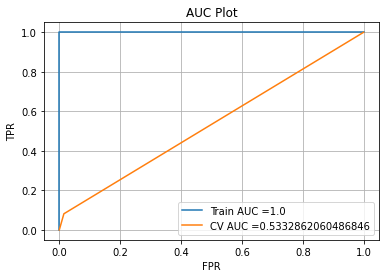

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


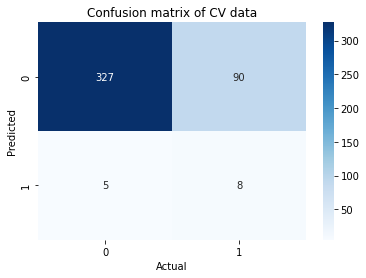

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



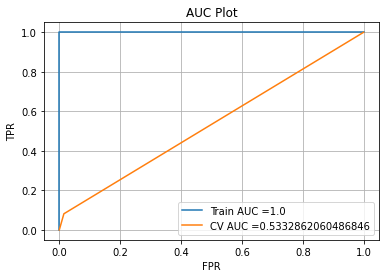

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


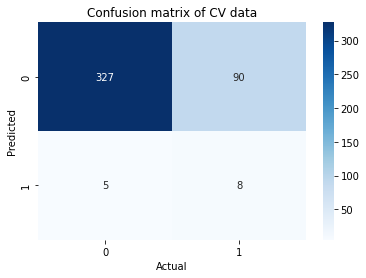

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



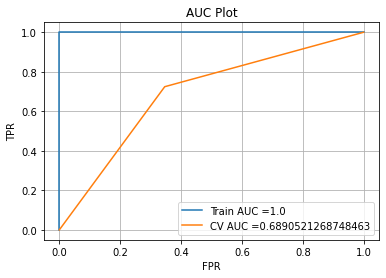

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


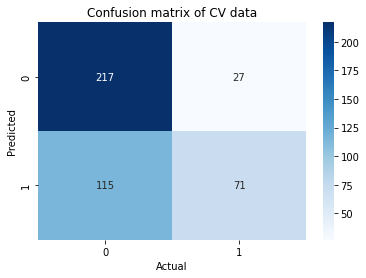

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



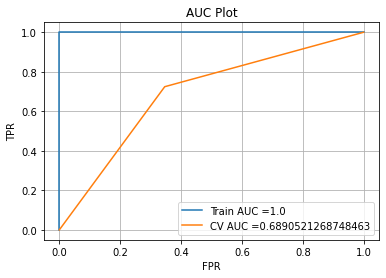

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


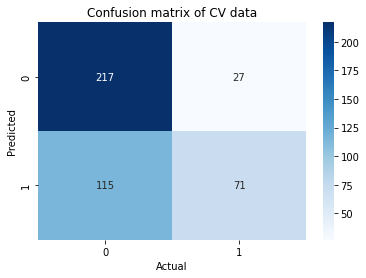

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



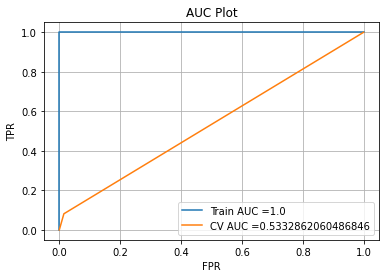

Cross validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


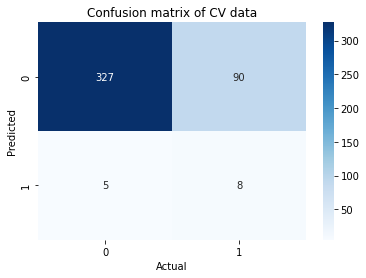

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9967619546018973
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



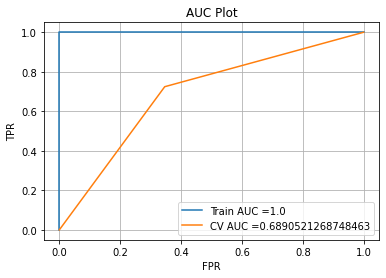

Cross validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


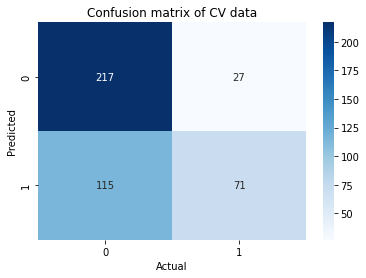

In [79]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_50_50,y_inpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_inpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



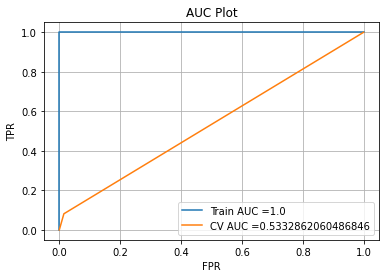

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


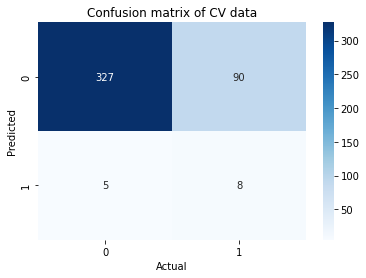

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



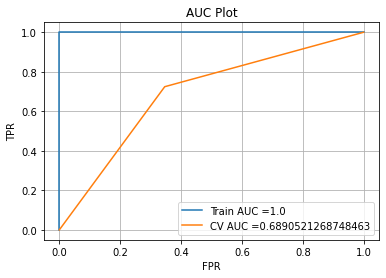

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


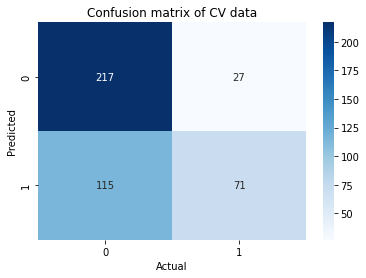

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



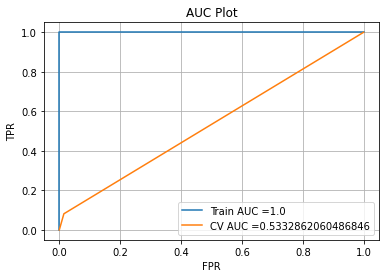

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


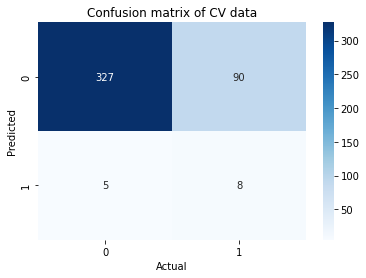

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



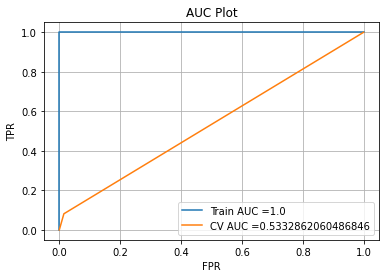

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


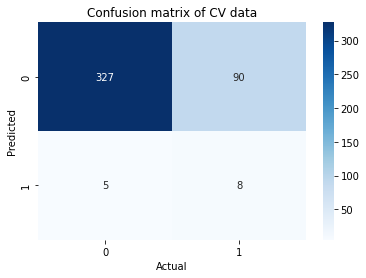

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



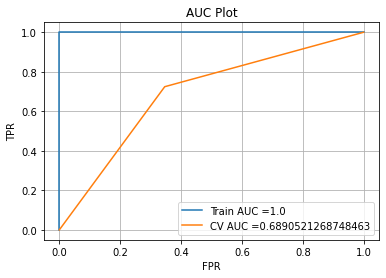

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


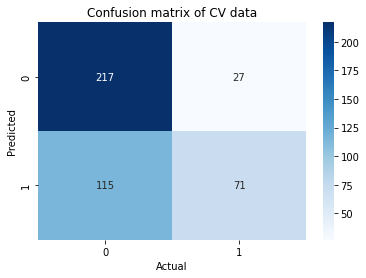

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



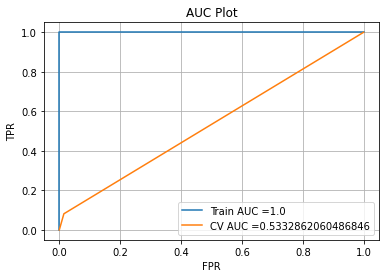

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


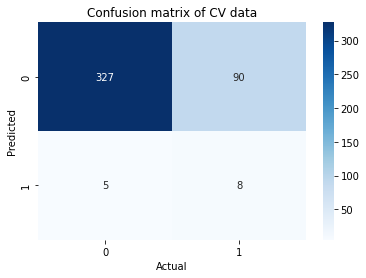

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



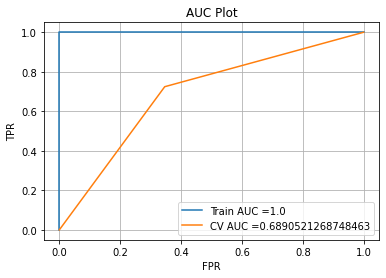

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


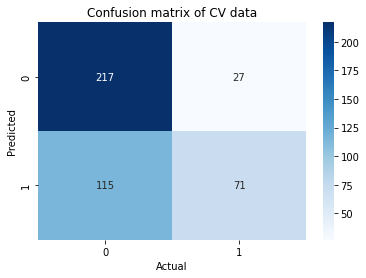

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



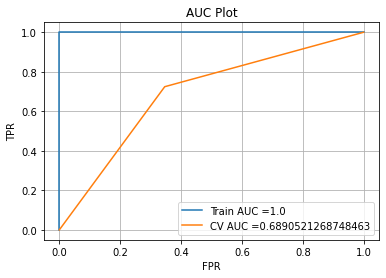

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


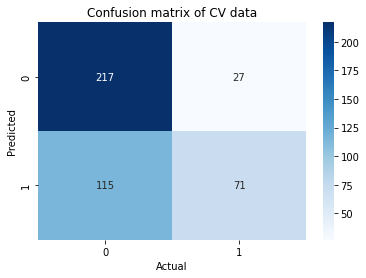

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



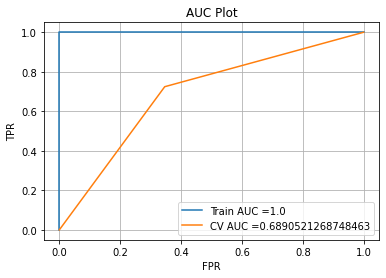

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


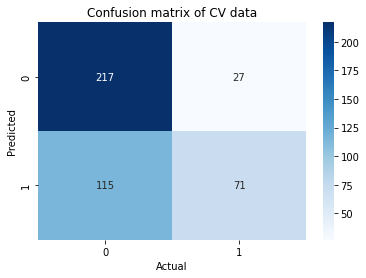

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



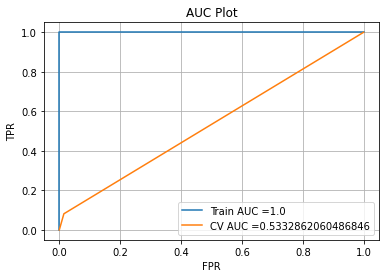

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


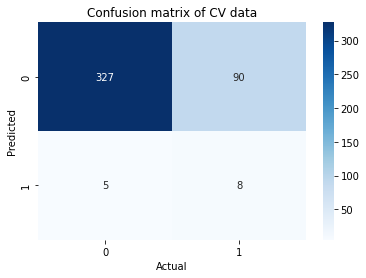

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



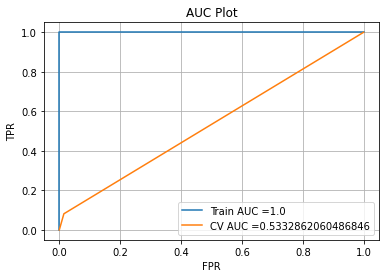

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


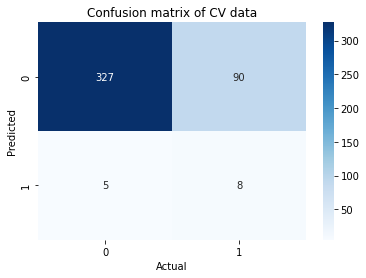

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



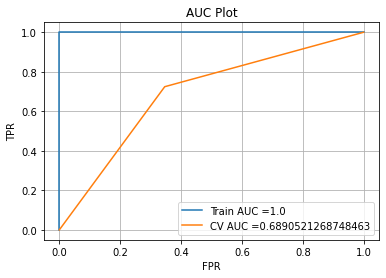

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


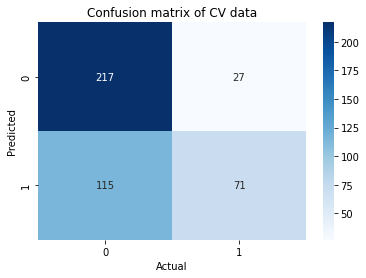

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



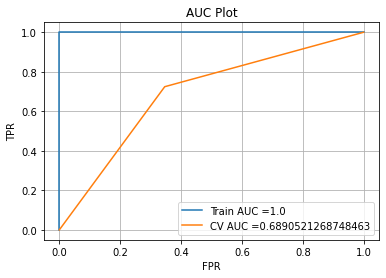

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


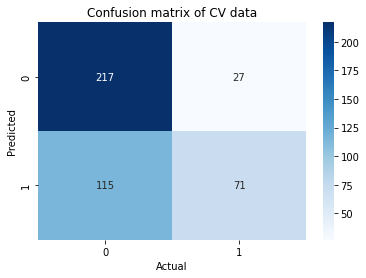

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



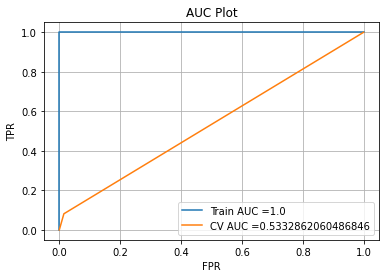

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


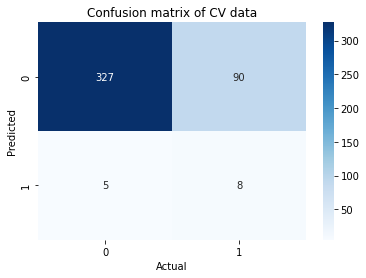

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



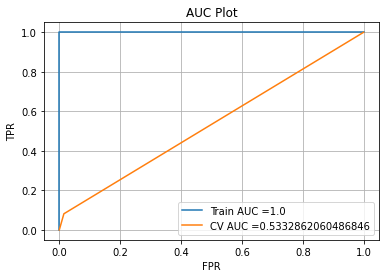

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


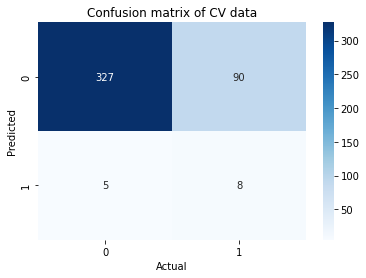

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



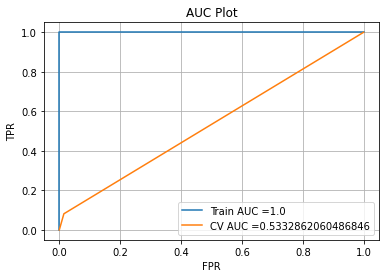

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


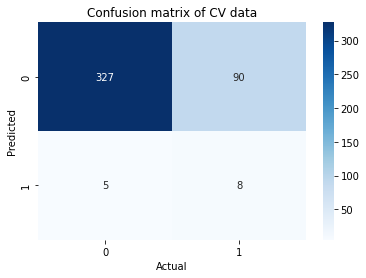

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



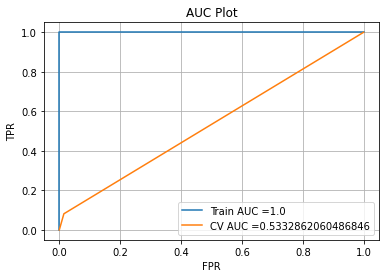

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


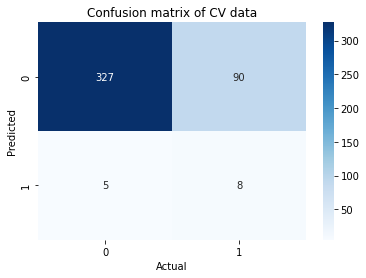

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



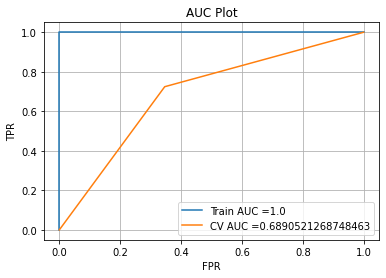

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


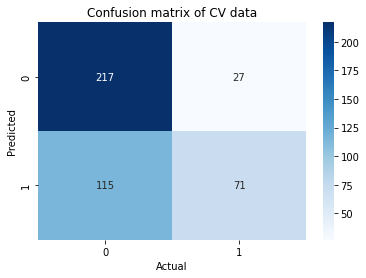

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



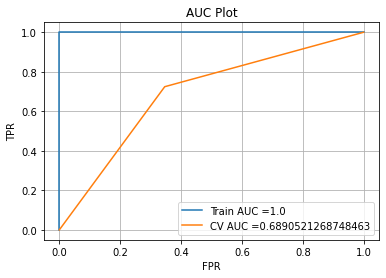

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


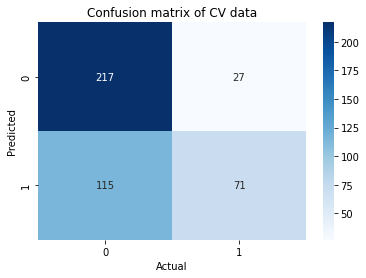

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9963909009420963
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



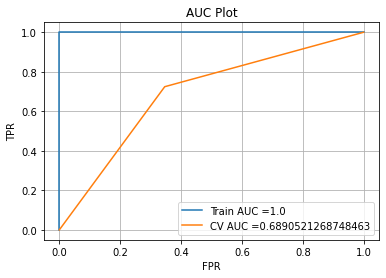

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


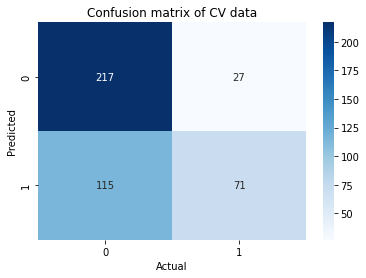

In [80]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_60_40,y_inpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_inpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



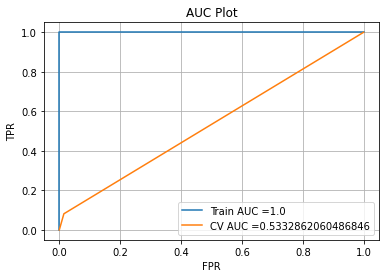

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


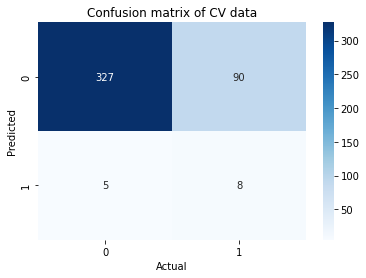

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



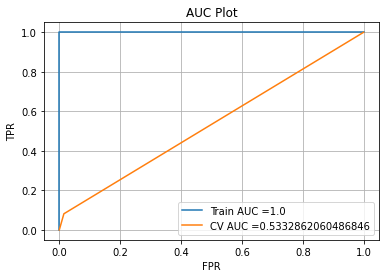

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


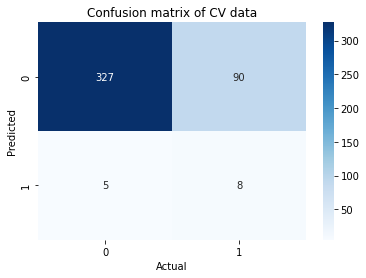

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



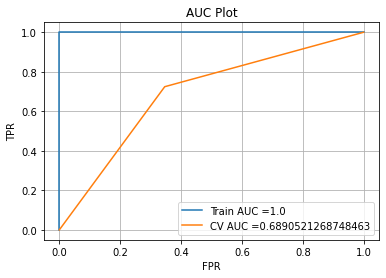

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


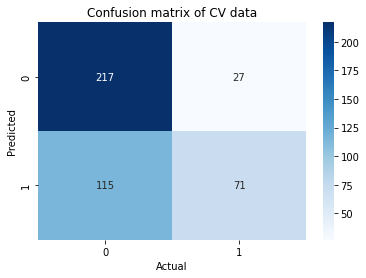

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



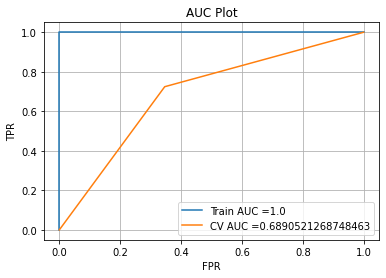

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


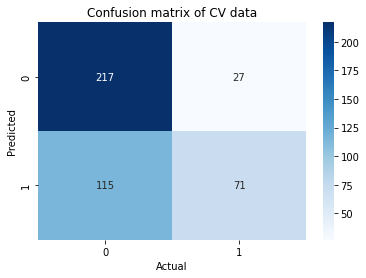

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



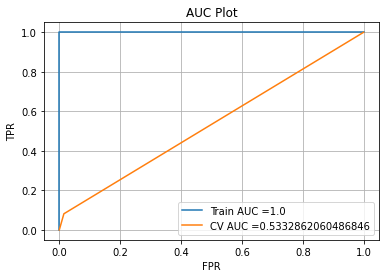

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


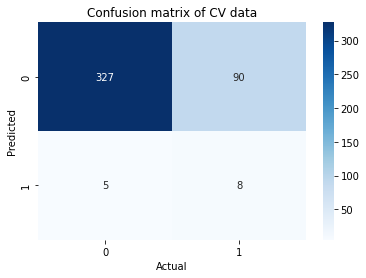

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



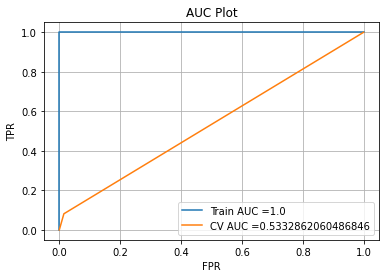

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


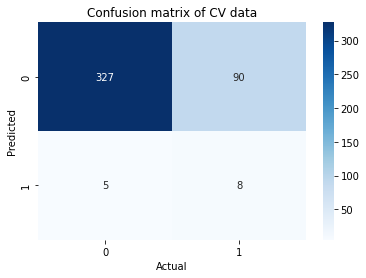

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



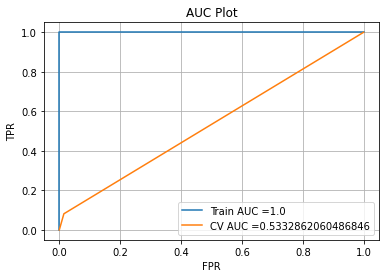

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


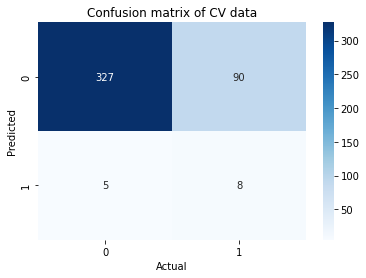

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



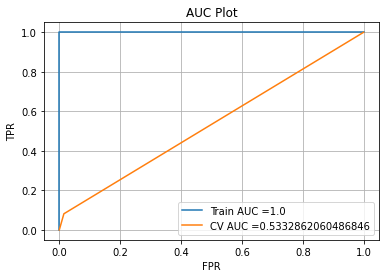

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


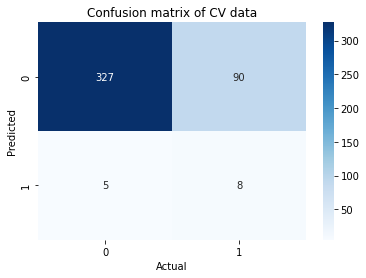

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



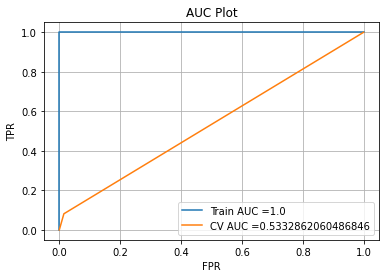

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


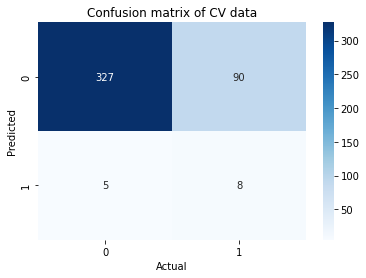

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



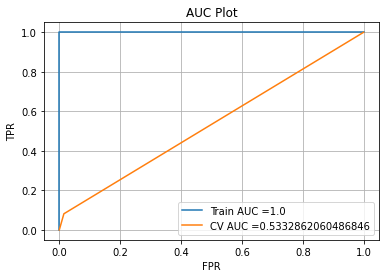

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


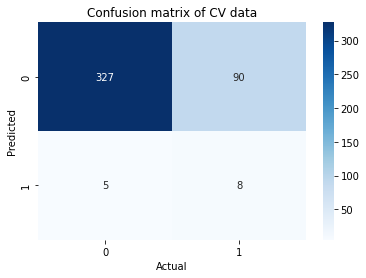

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



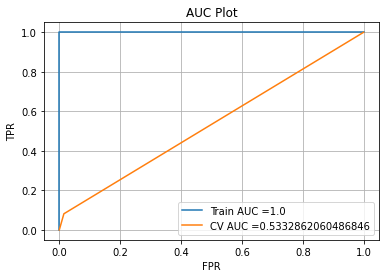

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


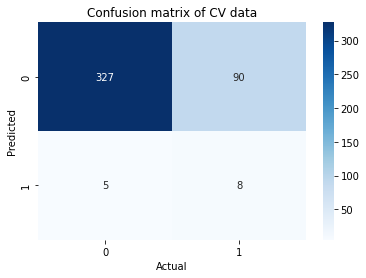

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



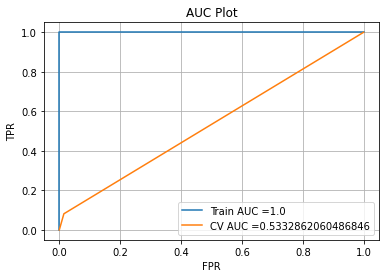

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


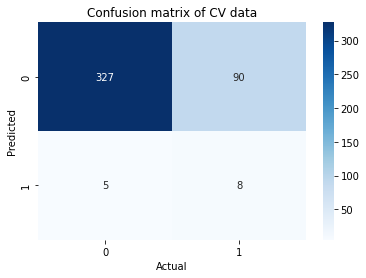

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



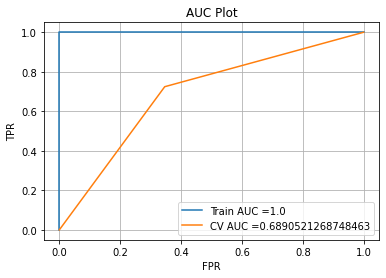

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


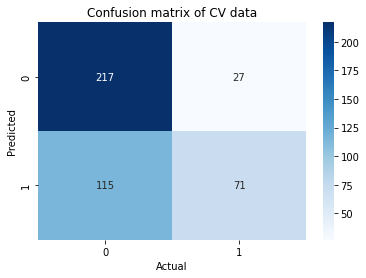

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



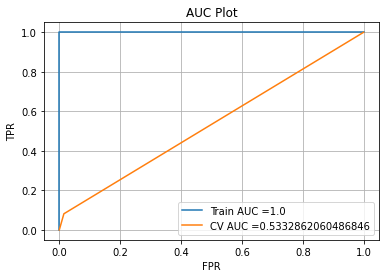

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


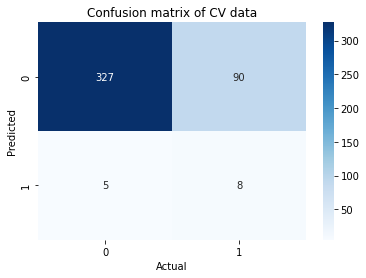

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



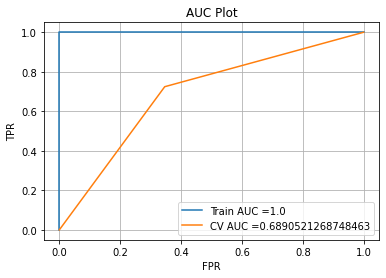

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


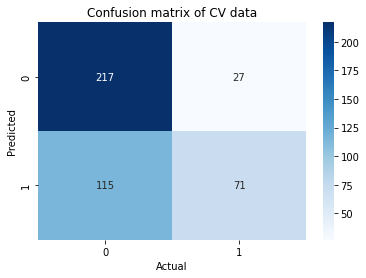

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



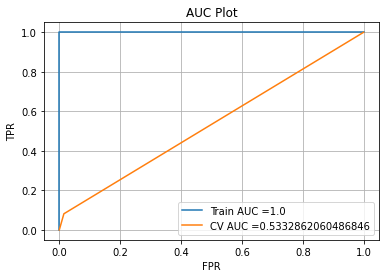

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


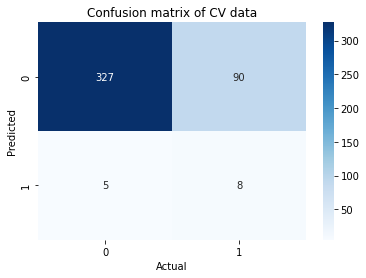

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



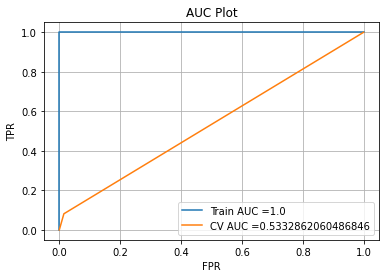

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


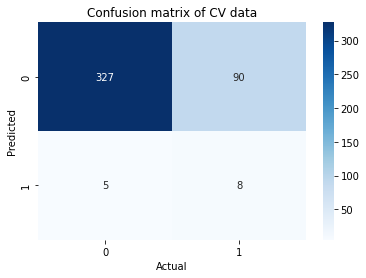

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



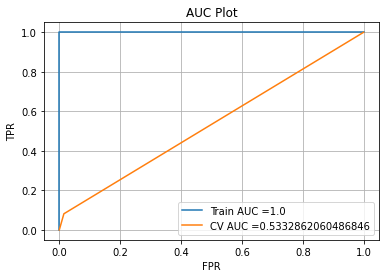

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


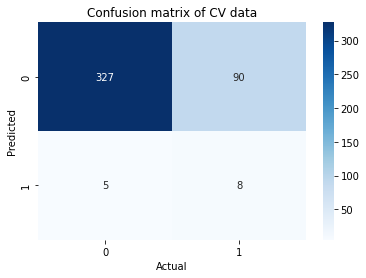

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       332
           1       0.62      0.08      0.14        98

    accuracy                           0.78       430
   macro avg       0.70      0.53      0.51       430
weighted avg       0.75      0.78      0.71       430



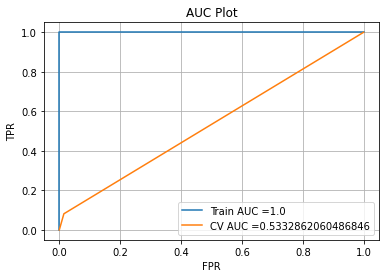

Cross Validation
FNR:0.9183673469387755 ,TPR:0.08163265306122448 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


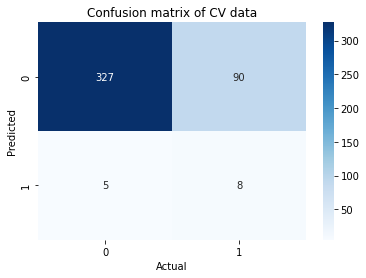

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9957642028141573
              precision    recall  f1-score   support

           0       0.89      0.65      0.75       332
           1       0.38      0.72      0.50        98

    accuracy                           0.67       430
   macro avg       0.64      0.69      0.63       430
weighted avg       0.77      0.67      0.70       430



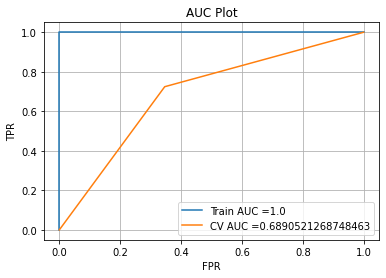

Cross Validation
FNR:0.2755102040816326 ,TPR:0.7244897959183674 ,FPR:0.3463855421686747 ,TNR:0.6536144578313253 


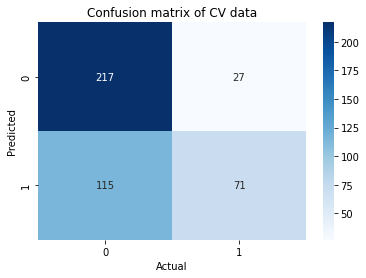

In [81]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:0.76,0:0.23})
        clf.fit(X_inpatient_70_30,y_inpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_inpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_inpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_inpatient,y_pred))
        y_train_pred = clf.predict(X_inpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Logistic Regression</h2>

In [82]:
from sklearn.linear_model import LogisticRegression

Original Distribution

----------------------------------------------------------------------------------------
C:  0.01
Important Features
InscClaimAmtReimbursed_total 0.0742784611134109
InscClaimAmtReimbursed_avg 0.18855919283115133
AdmitDays 0.19948100272819322
Race_5 0.053548241281663946
only_fraud_code_count 0.3146805697687148
only_fraud_procedure_code_count 0.26221974029843337
only_fraud_physician_count 0.3835977953096552
only_fraud_op_physician_count 0.38634665460520773
Doctor 0.10629307169767586
County_9 0.05011642374036182
County_23 0.05778476761028751
County_40 0.05678556201649545
ChronicCond_Alzheimer_0 0.05085796578088854
ChronicCond_Cancer_1 0.05446423980730129
ChronicCond_ObstrPulmonary_0 0.05039438733786739
ChronicCond_Osteoporasis_1 0.0501726052603223
ChronicCond_stroke_1 0.050227796785962474
              precision    recall  f1-score   support

           0       0.91      0.76      0.82       332
           1       0.47      0.73      0.57        98

    accuracy                           

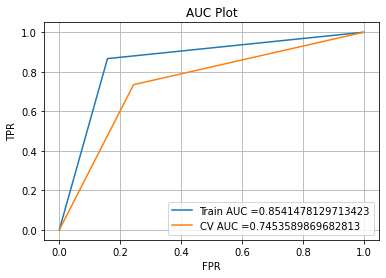

Cross Validation
FNR:0.2653061224489796 ,TPR:0.7346938775510204 ,FPR:0.24397590361445784 ,TNR:0.7560240963855421 


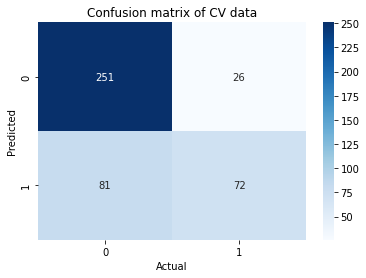

----------------------------------------------------------------------------------------
C:  0.1
Important Features
InscClaimAmtReimbursed_total 0.13697007617291654
InscClaimAmtReimbursed_avg 0.21670435139095998
AdmitDays 0.3182848209589298
Race_5 0.14591444141411525
Age 0.0739325192251885
only_fraud_code_count 1.1967522328487383
only_fraud_procedure_code_count 0.8822703965863322
only_fraud_physician_count 1.7335210236659817
only_fraud_op_physician_count 1.7322139707825044
Doctor 0.18498600838381107
County_5 0.07683500876080855
County_13 0.13765545232629375
County_14 0.07514072775464288
County_15 0.06934818832492866
County_23 0.13574910124297881
County_24 0.11158148107009294
County_26 0.07924684526602839
County_30 0.1385014490629088
County_40 0.08109277779128517
ChronicCond_Cancer_1 0.07512861412693601
ChronicCond_Osteoporasis_1 0.07487458369597581
              precision    recall  f1-score   support

           0       0.86      0.80      0.82       332
           1       0.44      0

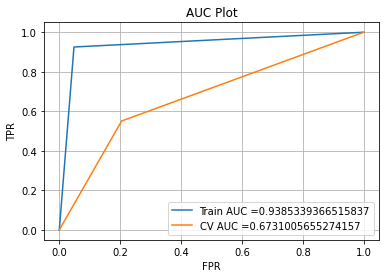

Cross Validation
FNR:0.4489795918367347 ,TPR:0.5510204081632653 ,FPR:0.20481927710843373 ,TNR:0.7951807228915663 


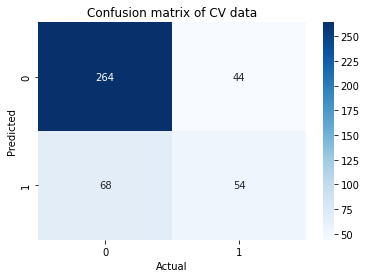

----------------------------------------------------------------------------------------
C:  1
Important Features
InscClaimAmtReimbursed_total 0.38521213288517825
InscClaimAmtReimbursed_avg 0.11840372732154587
AdmitDays 0.3097067618737186
Race_2 0.17185930018898132
Race_5 0.08962025013766062
Age 0.13028318112747966
only_fraud_code_count 2.8661841268011603
only_fraud_procedure_code_count 1.5965889384773693
only_fraud_physician_count 5.556484997587436
only_fraud_op_physician_count 5.4213099107619405
Doctor 0.3935537834052477
County_3 0.1699063629679253
County_5 0.28917131507829913
County_13 0.6070390176713316
County_17 0.11272836306389017
County_18 0.13748257776493955
County_19 0.3047079558594816
County_20 0.1555183983029077
County_21 0.32028658871699284
County_22 0.3014954376256654
County_23 0.21477566710364726
County_24 0.1883483620875769
County_26 0.10305172159797125
County_30 0.10788617690642166
County_32 0.16387829805503204
County_37 0.09051173220582215
County_40 0.10956979457103203

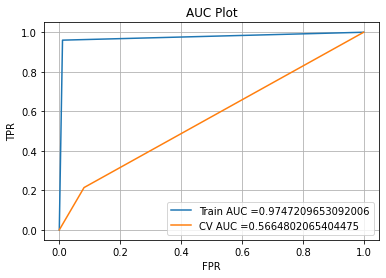

Cross Validation
FNR:0.7857142857142857 ,TPR:0.21428571428571427 ,FPR:0.08132530120481928 ,TNR:0.9186746987951807 


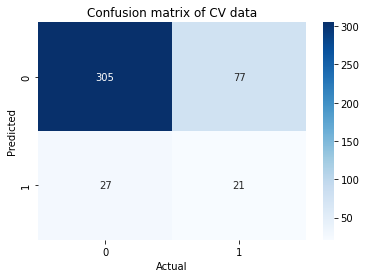

----------------------------------------------------------------------------------------
C:  10
Important Features
InscClaimAmtReimbursed_total 0.5079030825923704
AdmitDays 0.26245370844184573
Race_2 0.2040338008101367
Age 0.20114820133584604
only_fraud_code_count 5.095622614881904
only_fraud_procedure_code_count 2.100946409822461
only_fraud_physician_count 14.520161836125684
only_fraud_op_physician_count 13.931687195698256
alive_count 0.07233758553304767
Doctor 0.8366102928337802
County_0 0.21131732993000035
County_3 0.4534892816249617
County_5 0.3572449077422164
County_6 0.3128642608597153
County_13 1.355959678681075
County_16 0.11443503648188814
County_17 0.08004809707007783
County_19 0.9901673682304205
County_20 0.510099957095434
County_21 0.69734125334746
County_22 0.4413145381499483
County_23 0.10438527505837583
County_24 0.388572300814255
County_26 0.6276186584511886
County_28 0.4305931643417125
County_32 0.43692536014041994
County_33 0.1256250245244565
County_37 0.1272712795901

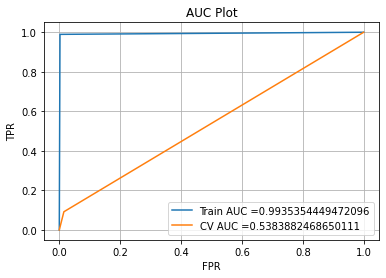

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.015060240963855422 ,TNR:0.9849397590361446 


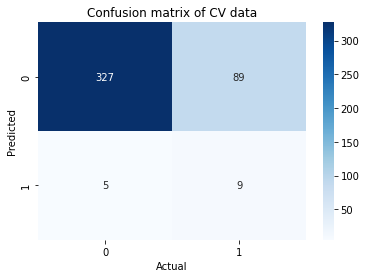

In [83]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:1.5,0:0.18})
    clf.fit(X_train_inpatient_sd,y_train_inpatient.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_train_inpatient.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_train_inpatient_sd)
    print(classification_report(y_train_inpatient,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
Claim count 0.03577067048643152
InscClaimAmtReimbursed_total 0.07718452036682288
InscClaimAmtReimbursed_avg 0.23836266400790979
AdmitDays 0.2662019662073673
IsClaimEndDtDischardeDt 0.03577067048643152
Gender_0 0.03742251891823047
Gender_1 0.03300492193749172
Race_1 0.04504493824488459
Race_5 0.03602358591436781
Age 0.015928591831878423
only_fraud_code_count 0.3973884770754724
only_fraud_procedure_code_count 0.3081342990364301
only_fraud_physician_count 0.515860880378094
only_fraud_op_physician_count 0.5234576047717019
Doctor 0.19509221792608053
County_5 0.033741369753752394
County_9 0.05742646003478706
County_12 0.032600193991540155
County_13 0.018234883516255445
County_14 0.045321678434161336
County_15 0.013217703843719935
County_17 0.021022766154080483
County_23 0.07014097038465641
County_24 0.039253851937509555
County_27 0.027988316109444113
County_28 0.02838932885523

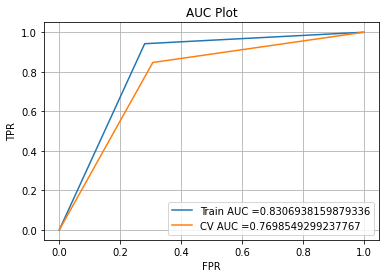

Cross Validation
FNR:0.15306122448979592 ,TPR:0.8469387755102041 ,FPR:0.3072289156626506 ,TNR:0.6927710843373494 


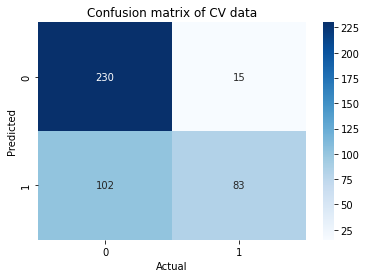

----------------------------------------------------------------------------------------
C:  0.1
Important Features
InscClaimAmtReimbursed_total 0.16797709180948694
InscClaimAmtReimbursed_avg 0.23649400436571397
AdmitDays 0.3729689314668256
Race_1 0.017056941128243585
Race_5 0.10663490992729716
Age 0.07304810024557956
only_fraud_code_count 1.4108366665229042
only_fraud_procedure_code_count 0.9974618882235873
only_fraud_physician_count 2.192007612729704
only_fraud_op_physician_count 2.211115664756736
Doctor 0.32051225668123595
County_3 0.04227941554743885
County_5 0.08887064177764462
County_13 0.18388067834965535
County_14 0.007013553585542486
County_17 0.027494086966531425
County_18 0.027455531427293546
County_22 0.03696652597942586
County_23 0.09717484589537381
County_24 0.1317006209313625
County_26 0.08577659572488294
County_28 0.03031427069188192
County_30 0.12772881982170595
County_36 0.03305474993673046
County_40 0.08449823131065545
County_42 0.03785159296041039
Diagnosis_2 0.0067

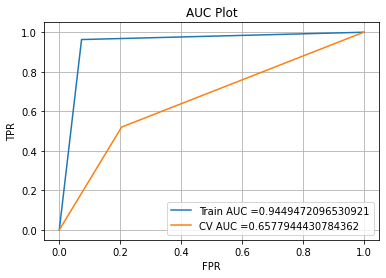

Cross Validation
FNR:0.47959183673469385 ,TPR:0.5204081632653061 ,FPR:0.20481927710843373 ,TNR:0.7951807228915663 


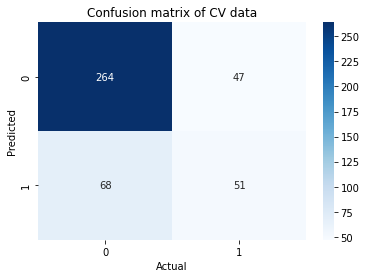

----------------------------------------------------------------------------------------
C:  1
Important Features
InscClaimAmtReimbursed_total 0.4898312909685604
InscClaimAmtReimbursed_avg 0.09486866350738984
AdmitDays 0.3512109540932578
Race_2 0.06583217876956515
Age 0.11442253481962285
only_fraud_code_count 3.1859024467116943
only_fraud_procedure_code_count 1.8564889813170409
only_fraud_physician_count 6.773352337273696
only_fraud_op_physician_count 6.633698476117731
Doctor 0.49176291871258815
County_3 0.26057841654395275
County_5 0.2620134303149762
County_13 0.6535407956803749
County_17 0.1566410638628106
County_18 0.14494719768021067
County_19 0.2952469303554261
County_20 0.06900832717617694
County_21 0.1917930057969771
County_22 0.25629260736024395
County_23 0.09526833049178686
County_24 0.1927221511758335
County_26 0.16156490405758003
County_28 0.027840708602664792
County_32 0.07403368270627564
County_37 0.007893289987231924
County_40 0.09295591751608066
County_41 0.0707909881329

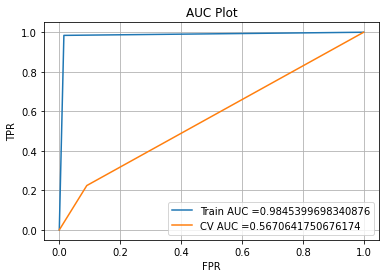

Cross Validation
FNR:0.7755102040816326 ,TPR:0.22448979591836735 ,FPR:0.09036144578313253 ,TNR:0.9096385542168675 


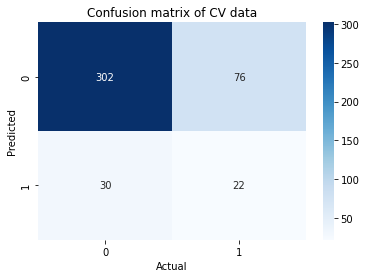

----------------------------------------------------------------------------------------
C:  10
Important Features
InscClaimAmtReimbursed_total 0.6757788170416306
AdmitDays 0.3024434876773846
Age 0.18286298501682147
only_fraud_code_count 5.346396336911368
only_fraud_procedure_code_count 2.6692533809253347
only_fraud_physician_count 16.729169406603678
only_fraud_op_physician_count 16.021980841967
Doctor 0.8669676532004186
County_0 0.33202417854249294
County_3 0.4376768631119433
County_5 0.28132594506392355
County_6 0.03476250152651144
County_13 1.288992123906293
County_16 0.08883216094068572
County_17 0.16508361487534992
County_18 0.01059954542007856
County_19 1.068231163796501
County_20 0.49875466947452407
County_21 0.3182248647662794
County_22 0.39345238110353997
County_23 0.04582675839897955
County_24 0.18175389694037306
County_26 1.18261265432676
County_28 0.49383510130134506
County_32 0.08771001075381292
County_33 0.04817417770358352
County_39 0.25915462366708975
County_40 0.301180

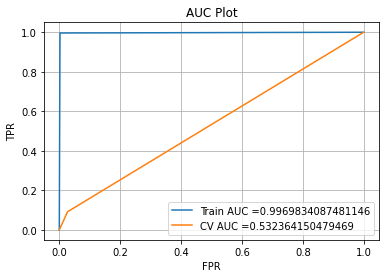

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.02710843373493976 ,TNR:0.9728915662650602 


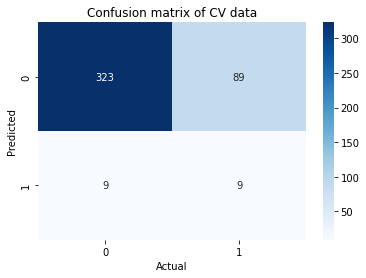

In [84]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:0.77,0:0.23})
    clf.fit(X_inpatient_50_50_sd,y_inpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_inpatient_50_50.columns),clf.coef_[0]):
        if j > 0.005:
            print(i,j)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_50_50_sd)
    print(classification_report(y_inpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
              precision    recall  f1-score   support

           0       0.85      0.68      0.76       332
           1       0.36      0.60      0.45        98

    accuracy                           0.67       430
   macro avg       0.61      0.64      0.60       430
weighted avg       0.74      0.67      0.69       430

              precision    recall  f1-score   support

           0       0.75      0.65      0.70      1326
           1       0.57      0.68      0.62       888

    accuracy                           0.66      2214
   macro avg       0.66      0.66      0.66      2214
weighted avg       0.68      0.66      0.66      2214



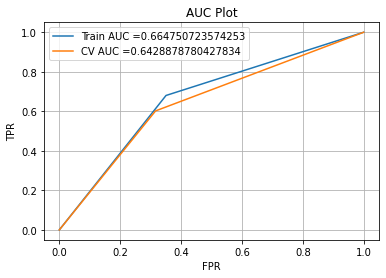

Cross Validation
FNR:0.3979591836734694 ,TPR:0.6020408163265306 ,FPR:0.31626506024096385 ,TNR:0.6837349397590361 


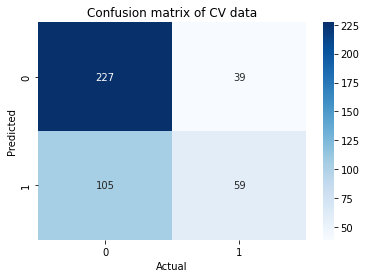

----------------------------------------------------------------------------------------
C:  0.1
Important Features
              precision    recall  f1-score   support

           0       0.85      0.68      0.76       332
           1       0.36      0.60      0.45        98

    accuracy                           0.67       430
   macro avg       0.61      0.64      0.60       430
weighted avg       0.74      0.67      0.69       430

              precision    recall  f1-score   support

           0       0.75      0.65      0.70      1326
           1       0.57      0.68      0.62       888

    accuracy                           0.66      2214
   macro avg       0.66      0.66      0.66      2214
weighted avg       0.68      0.66      0.66      2214



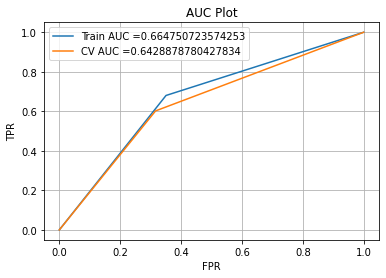

Cross Validation
FNR:0.3979591836734694 ,TPR:0.6020408163265306 ,FPR:0.31626506024096385 ,TNR:0.6837349397590361 


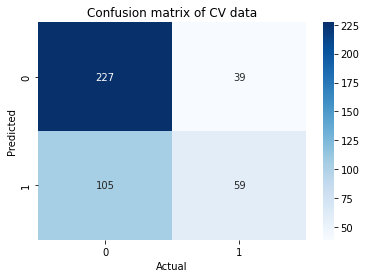

----------------------------------------------------------------------------------------
C:  1
Important Features
              precision    recall  f1-score   support

           0       0.85      0.68      0.76       332
           1       0.36      0.60      0.45        98

    accuracy                           0.67       430
   macro avg       0.61      0.64      0.60       430
weighted avg       0.74      0.67      0.69       430

              precision    recall  f1-score   support

           0       0.75      0.65      0.70      1326
           1       0.57      0.68      0.62       888

    accuracy                           0.66      2214
   macro avg       0.66      0.66      0.66      2214
weighted avg       0.68      0.66      0.66      2214



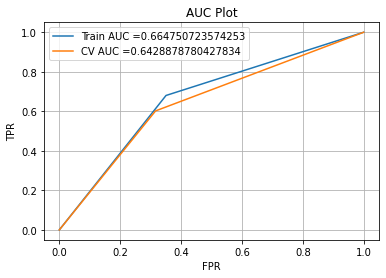

Cross Validation
FNR:0.3979591836734694 ,TPR:0.6020408163265306 ,FPR:0.31626506024096385 ,TNR:0.6837349397590361 


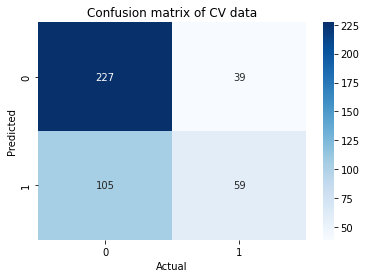

----------------------------------------------------------------------------------------
C:  10
Important Features
              precision    recall  f1-score   support

           0       0.85      0.68      0.76       332
           1       0.36      0.60      0.45        98

    accuracy                           0.67       430
   macro avg       0.61      0.64      0.60       430
weighted avg       0.74      0.67      0.69       430

              precision    recall  f1-score   support

           0       0.75      0.65      0.70      1326
           1       0.57      0.68      0.62       888

    accuracy                           0.66      2214
   macro avg       0.66      0.66      0.66      2214
weighted avg       0.68      0.66      0.66      2214



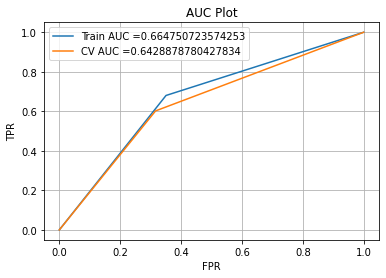

Cross Validation
FNR:0.3979591836734694 ,TPR:0.6020408163265306 ,FPR:0.31626506024096385 ,TNR:0.6837349397590361 


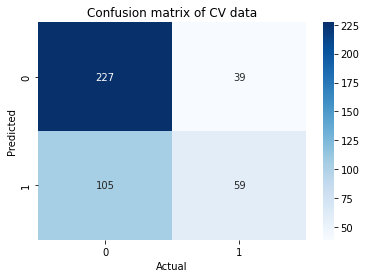

In [85]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:1.8,0:0.05})
    clf.fit(X_inpatient_60_40,y_inpatient_60_40.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_inpatient_60_40.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_60_40_sd)
    print(classification_report(y_inpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
InscClaimAmtReimbursed_total 0.07638733608245138
InscClaimAmtReimbursed_avg 0.1701505960223263
AdmitDays 0.19051999725840318
Race_5 0.06832487202949519
only_fraud_code_count 0.3410877355293796
only_fraud_procedure_code_count 0.2794085033680348
only_fraud_physician_count 0.4123920396336373
only_fraud_op_physician_count 0.42024483964305076
Doctor 0.10810852433203161
County_14 0.056610359855294425
County_40 0.06256216905211685
ChronicCond_Cancer_1 0.0548253263186025
ChronicCond_stroke_1 0.05600399244858521
              precision    recall  f1-score   support

           0       0.89      0.84      0.87       332
           1       0.55      0.65      0.60        98

    accuracy                           0.80       430
   macro avg       0.72      0.75      0.73       430
weighted avg       0.81      0.80      0.80       430

              precision    recall  f1-score   s

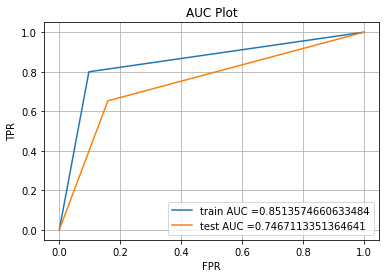

Cross Validation
FNR:0.3469387755102041 ,TPR:0.6530612244897959 ,FPR:0.15963855421686746 ,TNR:0.8403614457831325 


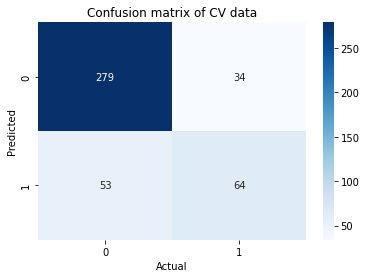

----------------------------------------------------------------------------------------
C:  0.1
Important Features
InscClaimAmtReimbursed_total 0.1500377628427402
InscClaimAmtReimbursed_avg 0.18963355177669847
AdmitDays 0.29522060867936506
Race_5 0.18860266604999243
Age 0.07614324308612291
only_fraud_code_count 1.2738852689697837
only_fraud_procedure_code_count 0.9324183757393476
only_fraud_physician_count 1.8292133296312072
only_fraud_op_physician_count 1.867607444594602
Doctor 0.22142948961497103
County_13 0.17005321427161516
County_14 0.06347908900300105
County_17 0.05011474289591805
County_23 0.0879993457088192
County_24 0.14283550075666682
County_26 0.08837175456429265
County_30 0.11936331332633748
County_40 0.08710996794939181
ChronicCond_Cancer_1 0.07513413142365213
ChronicCond_Osteoporasis_1 0.0627518433116043
              precision    recall  f1-score   support

           0       0.84      0.86      0.85       332
           1       0.50      0.46      0.48        98

    a

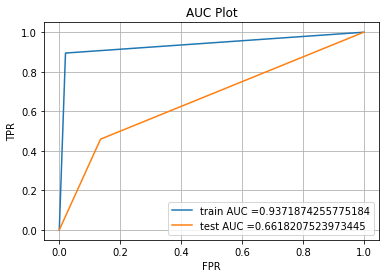

Cross Validation
FNR:0.5408163265306123 ,TPR:0.45918367346938777 ,FPR:0.1355421686746988 ,TNR:0.8644578313253012 


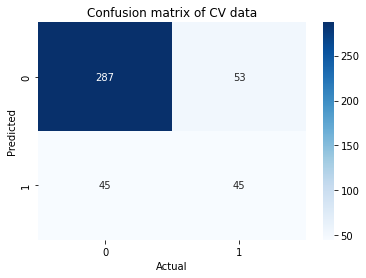

----------------------------------------------------------------------------------------
C:  1
Important Features
InscClaimAmtReimbursed_total 0.38560631856745164
InscClaimAmtReimbursed_avg 0.09448941411663007
AdmitDays 0.28163643454490095
Race_2 0.14080329285213652
Race_5 0.1632951644418261
Age 0.12419072846921635
only_fraud_code_count 2.92519522796778
only_fraud_procedure_code_count 1.6126235659029604
only_fraud_physician_count 5.796249003743173
only_fraud_op_physician_count 5.802404655423193
Doctor 0.4610317500777948
County_3 0.3096968139692006
County_5 0.229525045637497
County_13 0.6284884266559364
County_17 0.11563866316498703
County_18 0.2559938474631741
County_19 0.13516089217260044
County_20 0.11844439217088773
County_21 0.19770439611949775
County_22 0.2222955913348124
County_23 0.1614624274984554
County_24 0.2723815238128615
County_26 0.1385132943069518
County_28 0.1304131043963564
County_32 0.0685913835779115
County_37 0.1112599211389357
County_40 0.0878018591553204
County_42

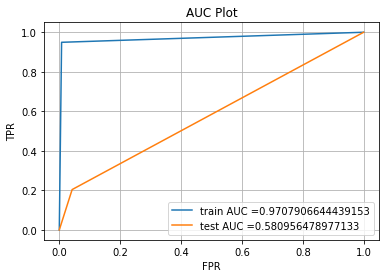

Cross Validation
FNR:0.7959183673469388 ,TPR:0.20408163265306123 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


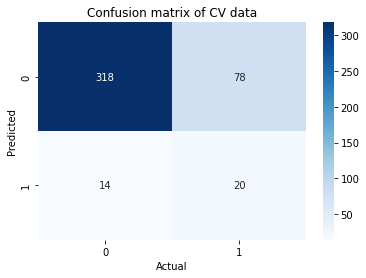

----------------------------------------------------------------------------------------
C:  10
Important Features
InscClaimAmtReimbursed_total 0.3703538757216143
AdmitDays 0.24243406474583262
Race_2 0.06217239517795813
Age 0.20935702199995912
only_fraud_code_count 4.94290682156788
only_fraud_procedure_code_count 2.020105280032518
only_fraud_physician_count 14.8818530460893
only_fraud_op_physician_count 14.591146417080635
Doctor 0.841786888993719
County_0 0.17794981656244174
County_3 0.5826583039804872
County_5 0.25698021628442297
County_6 0.37025518170645655
County_13 1.2751625073864372
County_16 0.18687003787310338
County_17 0.06341719843995046
County_18 0.24832136061079635
County_19 0.7739493726322833
County_20 0.4891919698723429
County_21 0.47976229121173325
County_22 0.42908468458813054
County_23 0.12720755024602248
County_24 0.3822400236049826
County_26 0.8558308334040061
County_28 0.6258517582190528
County_32 0.24890823444370605
County_33 0.06741777276495009
County_37 0.28124781

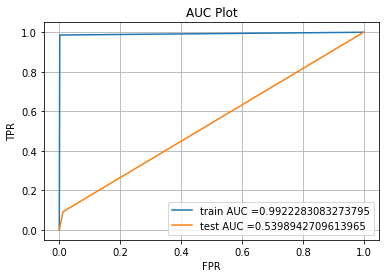

Cross Validation
FNR:0.9081632653061225 ,TPR:0.09183673469387756 ,FPR:0.012048192771084338 ,TNR:0.9879518072289156 


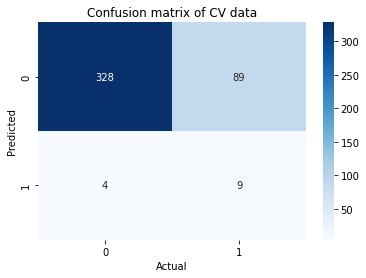

In [86]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:0.9,0:0.23})
    clf.fit(X_inpatient_70_30_sd,y_inpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_inpatient_70_30.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_70_30_sd)
    print(classification_report(y_inpatient_70_30_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="test AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    print("Cross Validation")
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

<h2>Naive Bayes</h2>

In [87]:
from sklearn.naive_bayes import GaussianNB

Original Distribution

              precision    recall  f1-score   support

           0       0.91      0.57      0.70       332
           1       0.35      0.81      0.49        98

    accuracy                           0.62       430
   macro avg       0.63      0.69      0.59       430
weighted avg       0.78      0.62      0.65       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.98      1326
           1       0.85      1.00      0.92       375

    accuracy                           0.96      1701
   macro avg       0.93      0.98      0.95      1701
weighted avg       0.97      0.96      0.96      1701



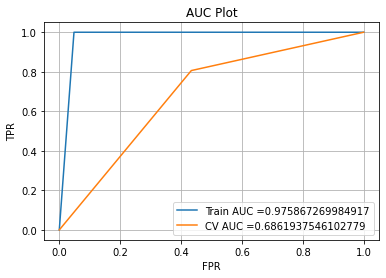

Cross Validation
FNR:0.19387755102040816 ,TPR:0.8061224489795918 ,FPR:0.43373493975903615 ,TNR:0.5662650602409639 


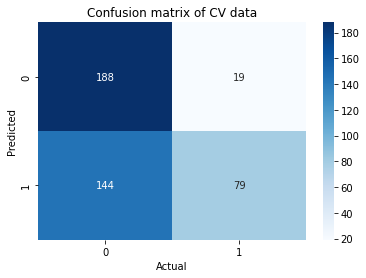

              precision    recall  f1-score   support

           0       0.91      0.57      0.70       332
           1       0.35      0.81      0.49        98

    accuracy                           0.62       430
   macro avg       0.63      0.69      0.59       430
weighted avg       0.78      0.62      0.65       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.84      1.00      0.91       375

    accuracy                           0.96      1701
   macro avg       0.92      0.97      0.94      1701
weighted avg       0.97      0.96      0.96      1701



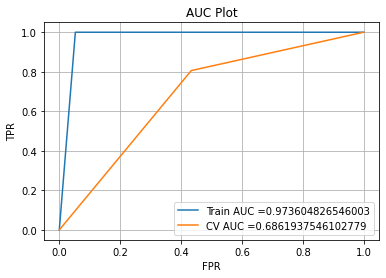

Cross Validation
FNR:0.19387755102040816 ,TPR:0.8061224489795918 ,FPR:0.43373493975903615 ,TNR:0.5662650602409639 


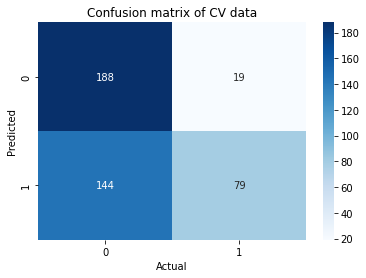

              precision    recall  f1-score   support

           0       0.91      0.57      0.70       332
           1       0.35      0.81      0.49        98

    accuracy                           0.62       430
   macro avg       0.63      0.69      0.59       430
weighted avg       0.78      0.62      0.65       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.83      1.00      0.91       375

    accuracy                           0.96      1701
   macro avg       0.92      0.97      0.94      1701
weighted avg       0.96      0.96      0.96      1701



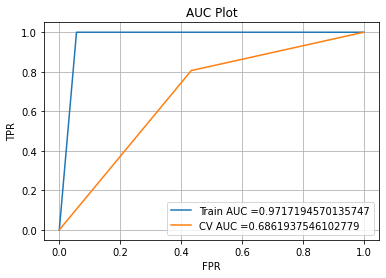

Cross Validation
FNR:0.19387755102040816 ,TPR:0.8061224489795918 ,FPR:0.43373493975903615 ,TNR:0.5662650602409639 


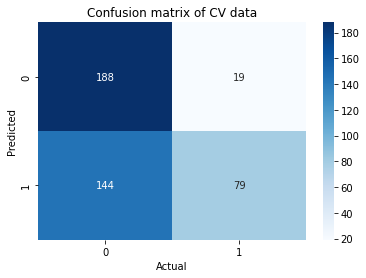

              precision    recall  f1-score   support

           0       0.91      0.57      0.70       332
           1       0.35      0.81      0.49        98

    accuracy                           0.62       430
   macro avg       0.63      0.69      0.59       430
weighted avg       0.78      0.62      0.65       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.83      1.00      0.91       375

    accuracy                           0.95      1701
   macro avg       0.91      0.97      0.94      1701
weighted avg       0.96      0.95      0.96      1701



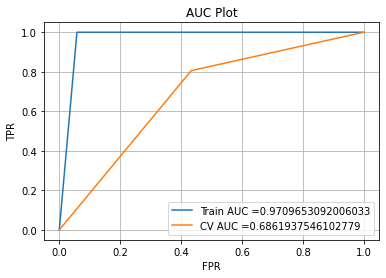

Cross Validation
FNR:0.19387755102040816 ,TPR:0.8061224489795918 ,FPR:0.43373493975903615 ,TNR:0.5662650602409639 


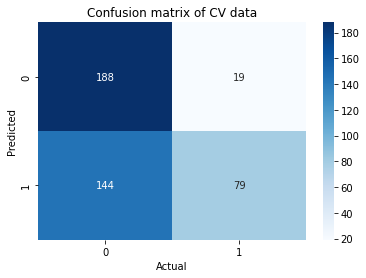

              precision    recall  f1-score   support

           0       0.90      0.58      0.71       332
           1       0.36      0.79      0.49        98

    accuracy                           0.63       430
   macro avg       0.63      0.68      0.60       430
weighted avg       0.78      0.63      0.66       430

              precision    recall  f1-score   support

           0       0.99      0.94      0.96      1326
           1       0.82      0.96      0.88       375

    accuracy                           0.94      1701
   macro avg       0.90      0.95      0.92      1701
weighted avg       0.95      0.94      0.95      1701



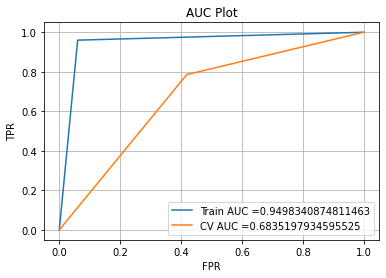

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4186746987951807 ,TNR:0.5813253012048193 


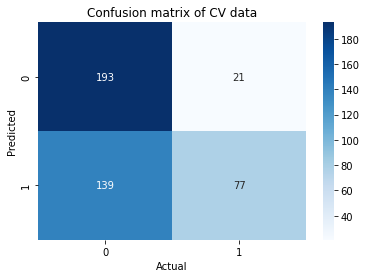

              precision    recall  f1-score   support

           0       0.86      0.87      0.87       332
           1       0.55      0.53      0.54        98

    accuracy                           0.79       430
   macro avg       0.71      0.70      0.70       430
weighted avg       0.79      0.79      0.79       430

              precision    recall  f1-score   support

           0       0.89      0.94      0.91      1326
           1       0.74      0.59      0.65       375

    accuracy                           0.86      1701
   macro avg       0.81      0.76      0.78      1701
weighted avg       0.86      0.86      0.86      1701



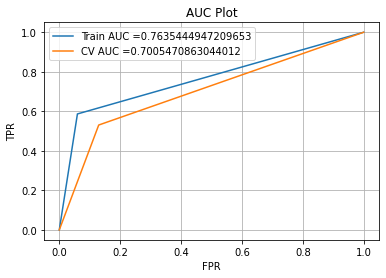

Cross Validation
FNR:0.46938775510204084 ,TPR:0.5306122448979592 ,FPR:0.12951807228915663 ,TNR:0.8704819277108434 


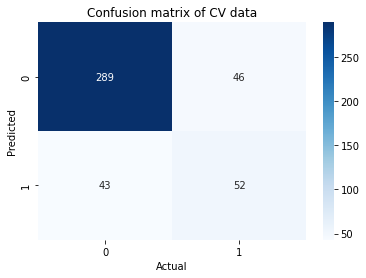

              precision    recall  f1-score   support

           0       0.85      0.89      0.87       332
           1       0.55      0.45      0.49        98

    accuracy                           0.79       430
   macro avg       0.70      0.67      0.68       430
weighted avg       0.78      0.79      0.78       430

              precision    recall  f1-score   support

           0       0.86      0.96      0.91      1326
           1       0.75      0.45      0.56       375

    accuracy                           0.85      1701
   macro avg       0.80      0.70      0.73      1701
weighted avg       0.84      0.85      0.83      1701



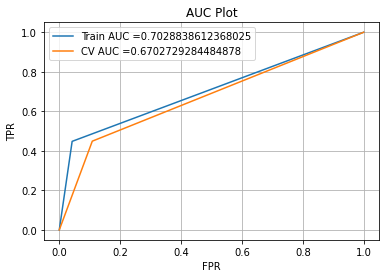

Cross Validation
FNR:0.5510204081632653 ,TPR:0.4489795918367347 ,FPR:0.10843373493975904 ,TNR:0.891566265060241 


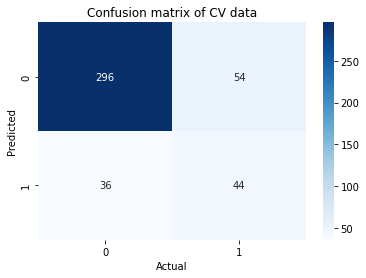

In [88]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_train_inpatient_sd,y_train_inpatient.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_train_inpatient_sd)
    print(classification_report(y_train_inpatient,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_inpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.91      0.61      0.73       332
           1       0.37      0.79      0.50        98

    accuracy                           0.65       430
   macro avg       0.64      0.70      0.61       430
weighted avg       0.78      0.65      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.95      1.00      0.97      1326

    accuracy                           0.97      2652
   macro avg       0.98      0.97      0.97      2652
weighted avg       0.98      0.97      0.97      2652



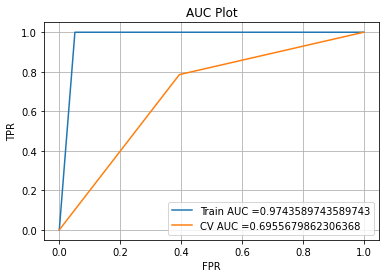

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.39457831325301207 ,TNR:0.6054216867469879 


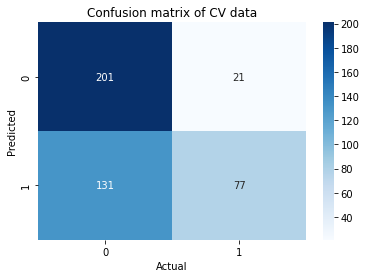

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.91      0.61      0.73       332
           1       0.37      0.79      0.50        98

    accuracy                           0.65       430
   macro avg       0.64      0.70      0.61       430
weighted avg       0.78      0.65      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.95      1.00      0.97      1326

    accuracy                           0.97      2652
   macro avg       0.97      0.97      0.97      2652
weighted avg       0.97      0.97      0.97      2652



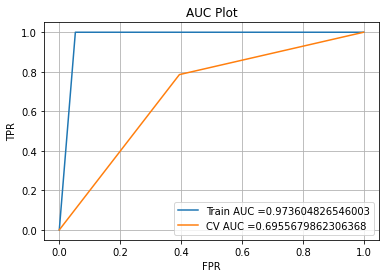

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.39457831325301207 ,TNR:0.6054216867469879 


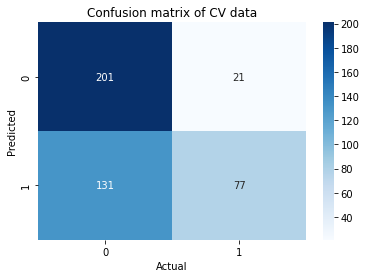

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.91      0.61      0.73       332
           1       0.37      0.79      0.50        98

    accuracy                           0.65       430
   macro avg       0.64      0.70      0.61       430
weighted avg       0.78      0.65      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.95      1.00      0.97      1326

    accuracy                           0.97      2652
   macro avg       0.97      0.97      0.97      2652
weighted avg       0.97      0.97      0.97      2652



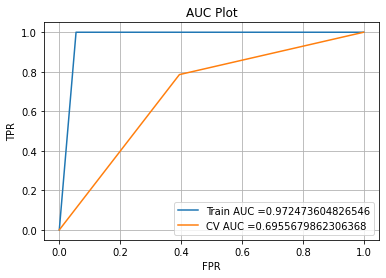

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.39457831325301207 ,TNR:0.6054216867469879 


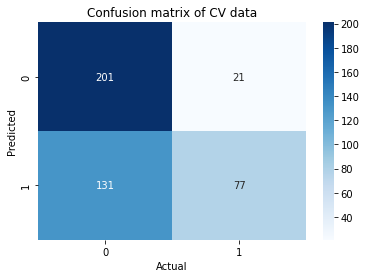

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.90      0.61      0.73       332
           1       0.37      0.78      0.50        98

    accuracy                           0.65       430
   macro avg       0.64      0.69      0.62       430
weighted avg       0.78      0.65      0.68       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.95      1.00      0.97      1326

    accuracy                           0.97      2652
   macro avg       0.97      0.97      0.97      2652
weighted avg       0.97      0.97      0.97      2652



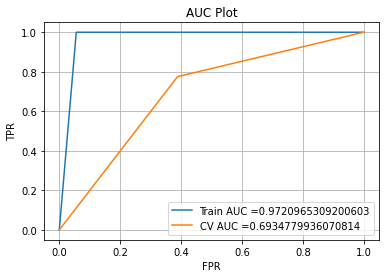

Cross Validation
FNR:0.22448979591836735 ,TPR:0.7755102040816326 ,FPR:0.3885542168674699 ,TNR:0.6114457831325302 


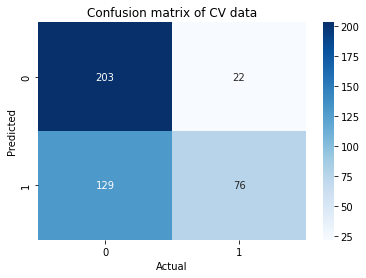

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.90      0.63      0.74       332
           1       0.38      0.77      0.51        98

    accuracy                           0.66       430
   macro avg       0.64      0.70      0.63       430
weighted avg       0.78      0.66      0.69       430

              precision    recall  f1-score   support

           0       0.93      0.94      0.94      1326
           1       0.94      0.93      0.94      1326

    accuracy                           0.94      2652
   macro avg       0.94      0.94      0.94      2652
weighted avg       0.94      0.94      0.94      2652



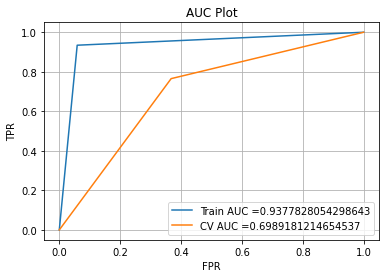

Cross Validation
FNR:0.23469387755102042 ,TPR:0.7653061224489796 ,FPR:0.3674698795180723 ,TNR:0.6325301204819277 


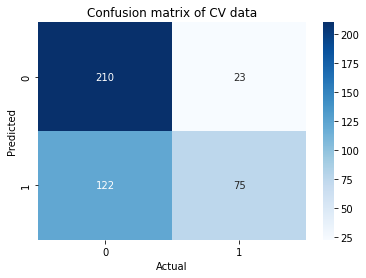

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.86      0.94      0.90       332
           1       0.71      0.47      0.56        98

    accuracy                           0.83       430
   macro avg       0.78      0.71      0.73       430
weighted avg       0.82      0.83      0.82       430

              precision    recall  f1-score   support

           0       0.66      0.94      0.78      1326
           1       0.90      0.52      0.66      1326

    accuracy                           0.73      2652
   macro avg       0.78      0.73      0.72      2652
weighted avg       0.78      0.73      0.72      2652



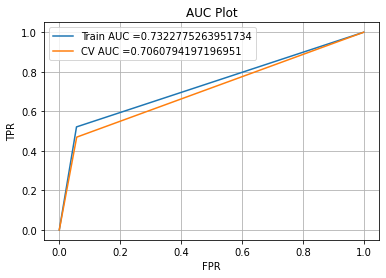

Cross Validation
FNR:0.5306122448979592 ,TPR:0.46938775510204084 ,FPR:0.0572289156626506 ,TNR:0.9427710843373494 


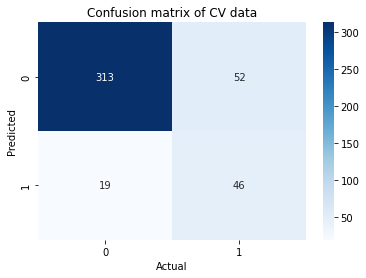

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.84      0.96      0.90       332
           1       0.75      0.37      0.49        98

    accuracy                           0.83       430
   macro avg       0.79      0.67      0.69       430
weighted avg       0.82      0.83      0.80       430

              precision    recall  f1-score   support

           0       0.62      0.97      0.76      1326
           1       0.92      0.42      0.58      1326

    accuracy                           0.69      2652
   macro avg       0.77      0.69      0.67      2652
weighted avg       0.77      0.69      0.67      2652



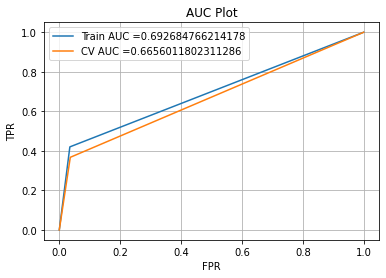

Cross Validation
FNR:0.6326530612244898 ,TPR:0.3673469387755102 ,FPR:0.03614457831325301 ,TNR:0.963855421686747 


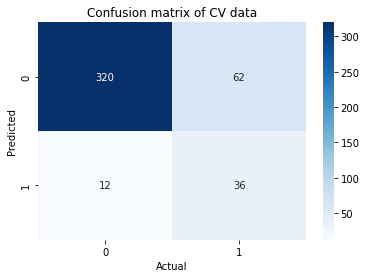

In [89]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_inpatient_50_50_sd,y_inpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_50_50_sd)
    print(classification_report(y_inpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.90      0.59      0.72       332
           1       0.36      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.63      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.98      1326
           1       0.93      1.00      0.97       888

    accuracy                           0.97      2214
   macro avg       0.97      0.98      0.97      2214
weighted avg       0.97      0.97      0.97      2214



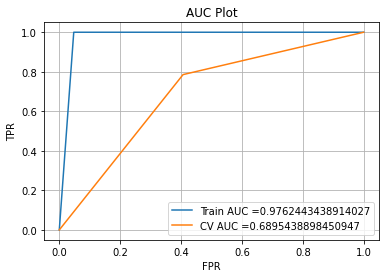

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4066265060240964 ,TNR:0.5933734939759037 


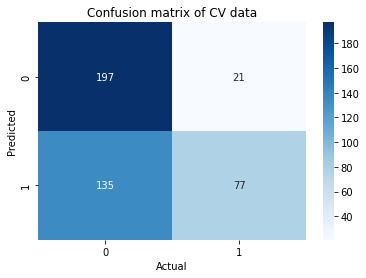

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.90      0.59      0.72       332
           1       0.36      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.63      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.93      1.00      0.96       888

    accuracy                           0.97      2214
   macro avg       0.96      0.97      0.97      2214
weighted avg       0.97      0.97      0.97      2214



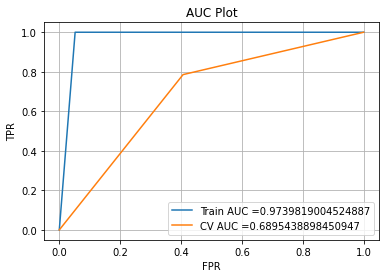

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4066265060240964 ,TNR:0.5933734939759037 


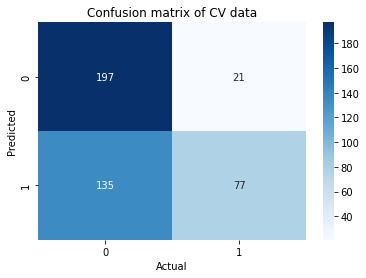

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.90      0.59      0.71       332
           1       0.36      0.79      0.49        98

    accuracy                           0.63       430
   macro avg       0.63      0.69      0.60       430
weighted avg       0.78      0.63      0.66       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.92      1.00      0.96       888

    accuracy                           0.97      2214
   macro avg       0.96      0.97      0.97      2214
weighted avg       0.97      0.97      0.97      2214



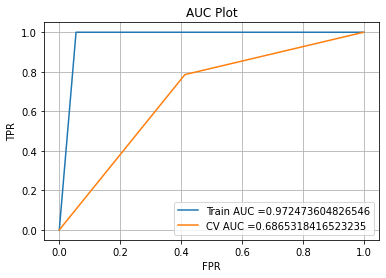

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4126506024096386 ,TNR:0.5873493975903614 


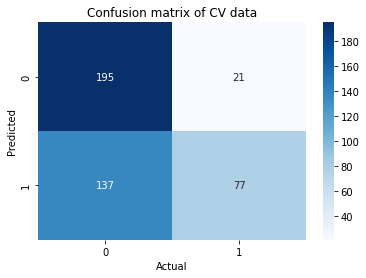

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.91      0.58      0.71       332
           1       0.36      0.80      0.50        98

    accuracy                           0.63       430
   macro avg       0.63      0.69      0.60       430
weighted avg       0.78      0.63      0.66       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.92      1.00      0.96       888

    accuracy                           0.96      2214
   macro avg       0.96      0.97      0.96      2214
weighted avg       0.97      0.96      0.96      2214



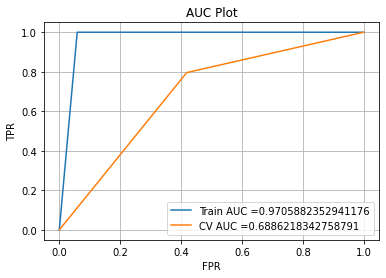

Cross Validation
FNR:0.20408163265306123 ,TPR:0.7959183673469388 ,FPR:0.4186746987951807 ,TNR:0.5813253012048193 


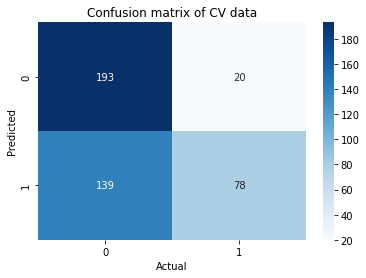

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.90      0.59      0.71       332
           1       0.36      0.79      0.49        98

    accuracy                           0.63       430
   macro avg       0.63      0.69      0.60       430
weighted avg       0.78      0.63      0.66       430

              precision    recall  f1-score   support

           0       0.96      0.94      0.95      1326
           1       0.91      0.94      0.93       888

    accuracy                           0.94      2214
   macro avg       0.94      0.94      0.94      2214
weighted avg       0.94      0.94      0.94      2214



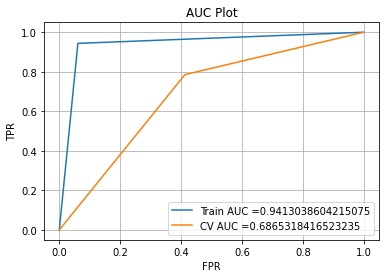

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4126506024096386 ,TNR:0.5873493975903614 


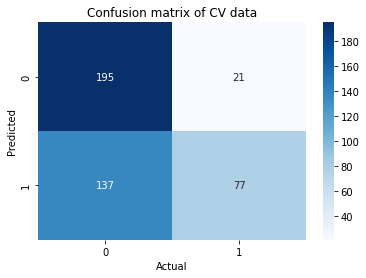

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.86      0.88      0.87       332
           1       0.55      0.52      0.54        98

    accuracy                           0.80       430
   macro avg       0.71      0.70      0.70       430
weighted avg       0.79      0.80      0.79       430

              precision    recall  f1-score   support

           0       0.75      0.94      0.83      1326
           1       0.85      0.53      0.65       888

    accuracy                           0.77      2214
   macro avg       0.80      0.73      0.74      2214
weighted avg       0.79      0.77      0.76      2214



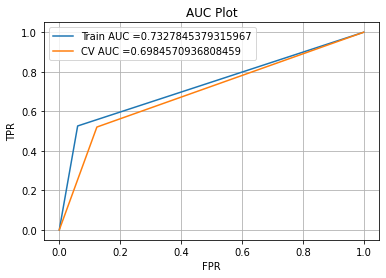

Cross Validation
FNR:0.47959183673469385 ,TPR:0.5204081632653061 ,FPR:0.12349397590361445 ,TNR:0.8765060240963856 


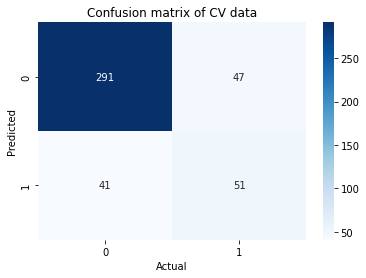

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.84      0.90      0.87       332
           1       0.55      0.42      0.47        98

    accuracy                           0.79       430
   macro avg       0.69      0.66      0.67       430
weighted avg       0.77      0.79      0.78       430

              precision    recall  f1-score   support

           0       0.71      0.96      0.82      1326
           1       0.88      0.42      0.57       888

    accuracy                           0.74      2214
   macro avg       0.80      0.69      0.69      2214
weighted avg       0.78      0.74      0.72      2214



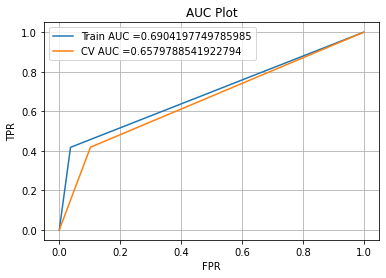

Cross Validation
FNR:0.5816326530612245 ,TPR:0.41836734693877553 ,FPR:0.10240963855421686 ,TNR:0.8975903614457831 


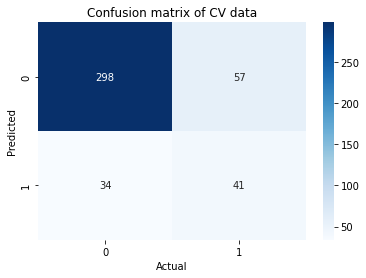

In [90]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_inpatient_60_40_sd,y_inpatient_60_40_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_60_40_sd)
    print(classification_report(y_inpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.90      0.60      0.72       332
           1       0.37      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.64      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.98      1326
           1       0.90      1.00      0.95       570

    accuracy                           0.97      1896
   macro avg       0.95      0.98      0.96      1896
weighted avg       0.97      0.97      0.97      1896



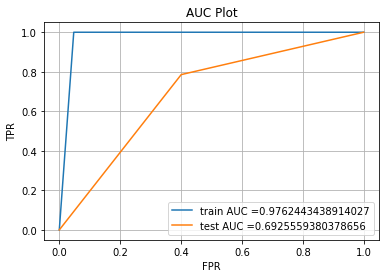

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4006024096385542 ,TNR:0.5993975903614458 


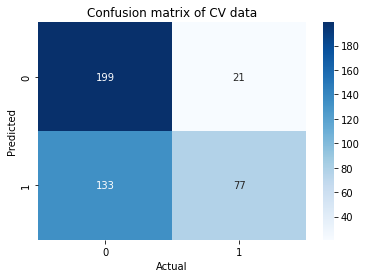

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.90      0.60      0.72       332
           1       0.37      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.64      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.89      1.00      0.94       570

    accuracy                           0.96      1896
   macro avg       0.95      0.97      0.96      1896
weighted avg       0.97      0.96      0.96      1896



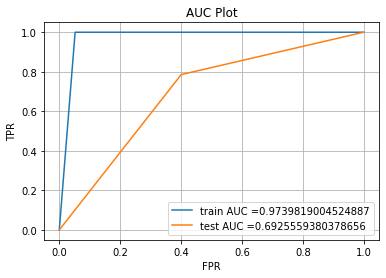

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4006024096385542 ,TNR:0.5993975903614458 


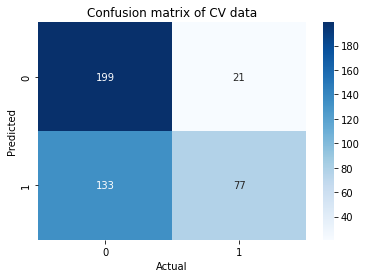

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.90      0.60      0.72       332
           1       0.37      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.64      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      1326
           1       0.89      1.00      0.94       570

    accuracy                           0.96      1896
   macro avg       0.94      0.97      0.96      1896
weighted avg       0.97      0.96      0.96      1896



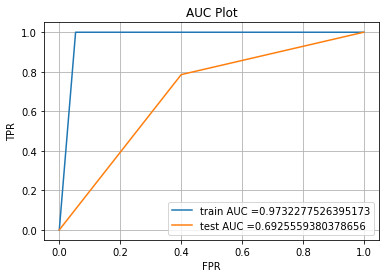

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4006024096385542 ,TNR:0.5993975903614458 


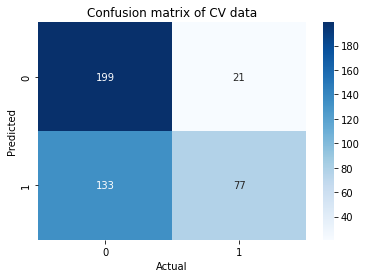

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.90      0.60      0.72       332
           1       0.36      0.79      0.50        98

    accuracy                           0.64       430
   macro avg       0.63      0.69      0.61       430
weighted avg       0.78      0.64      0.67       430

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1326
           1       0.89      1.00      0.94       570

    accuracy                           0.96      1896
   macro avg       0.94      0.97      0.96      1896
weighted avg       0.97      0.96      0.96      1896



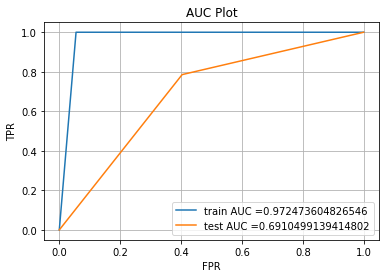

Cross Validation
FNR:0.21428571428571427 ,TPR:0.7857142857142857 ,FPR:0.4036144578313253 ,TNR:0.5963855421686747 


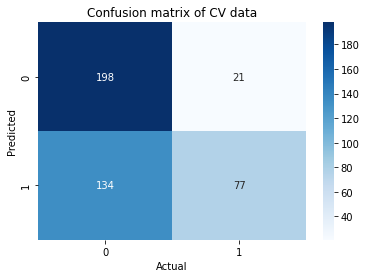

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.90      0.61      0.73       332
           1       0.37      0.77      0.50        98

    accuracy                           0.65       430
   macro avg       0.63      0.69      0.61       430
weighted avg       0.78      0.65      0.68       430

              precision    recall  f1-score   support

           0       0.98      0.94      0.96      1326
           1       0.88      0.95      0.91       570

    accuracy                           0.94      1896
   macro avg       0.93      0.95      0.94      1896
weighted avg       0.95      0.94      0.95      1896



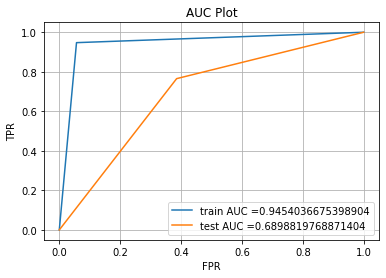

Cross Validation
FNR:0.23469387755102042 ,TPR:0.7653061224489796 ,FPR:0.3855421686746988 ,TNR:0.6144578313253012 


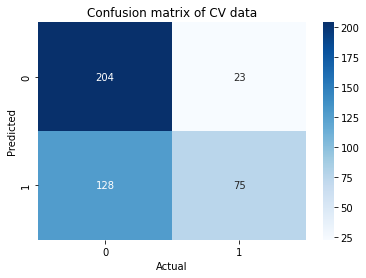

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.86      0.92      0.89       332
           1       0.66      0.50      0.57        98

    accuracy                           0.83       430
   macro avg       0.76      0.71      0.73       430
weighted avg       0.82      0.83      0.82       430

              precision    recall  f1-score   support

           0       0.82      0.94      0.88      1326
           1       0.80      0.53      0.64       570

    accuracy                           0.82      1896
   macro avg       0.81      0.74      0.76      1896
weighted avg       0.82      0.82      0.81      1896



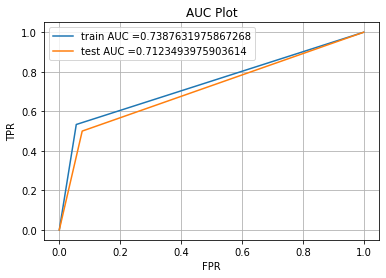

Cross Validation
FNR:0.5 ,TPR:0.5 ,FPR:0.07530120481927711 ,TNR:0.9246987951807228 


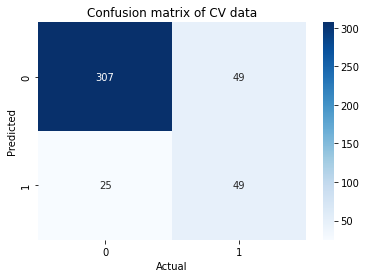

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.84      0.96      0.90       332
           1       0.73      0.39      0.51        98

    accuracy                           0.83       430
   macro avg       0.79      0.67      0.70       430
weighted avg       0.82      0.83      0.81       430

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      1326
           1       0.84      0.43      0.57       570

    accuracy                           0.80      1896
   macro avg       0.82      0.70      0.72      1896
weighted avg       0.81      0.80      0.78      1896



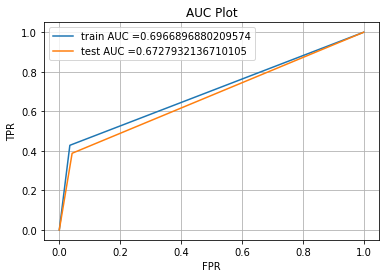

Cross Validation
FNR:0.6122448979591837 ,TPR:0.3877551020408163 ,FPR:0.04216867469879518 ,TNR:0.9578313253012049 


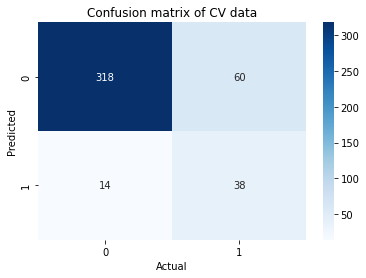

In [91]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_inpatient_70_30_sd,y_inpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_inpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_inpatient,y_pred))
    y_train_pred = clf.predict(X_inpatient_70_30_sd)
    print(classification_report(y_inpatient_70_30_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_inpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_inpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="test AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    print("Cross Validation")
    cv_cm = confusion_matrix(y_cv_inpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

<h2>Outpatient<h2>

<h2>LGBM Classifier</h2>

In [92]:
from lightgbm import LGBMClassifier

Original Distribution

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Claim count 41
only_fraud_physician_count 50
County_0 109
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



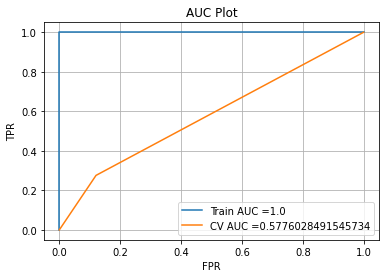

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


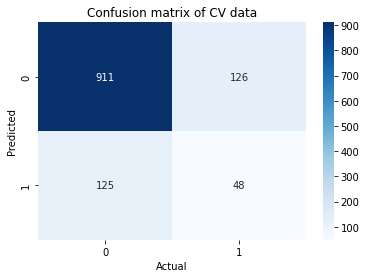

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 136
only_fraud_physician_count 53
County_0 119
County_34 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



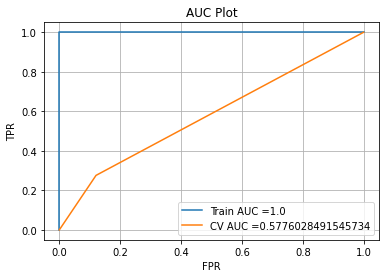

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


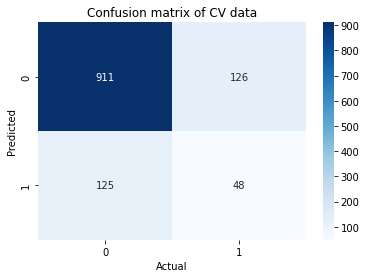

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 136
only_fraud_physician_count 53
County_0 119
County_34 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



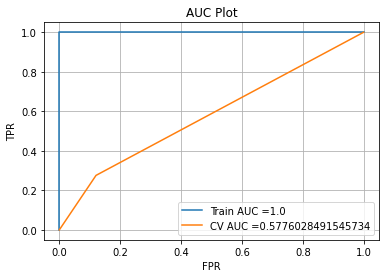

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


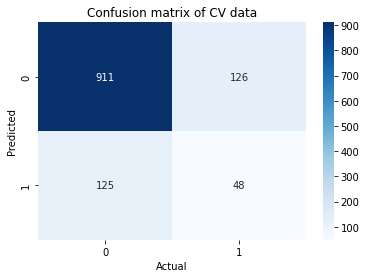

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 136
only_fraud_physician_count 53
County_0 119
County_34 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



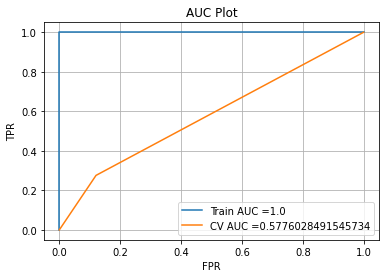

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


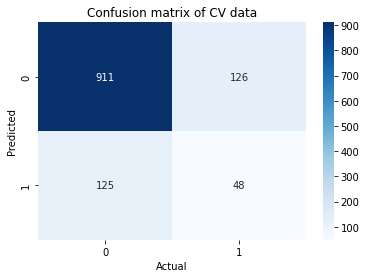

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 136
only_fraud_physician_count 53
County_0 119
County_34 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



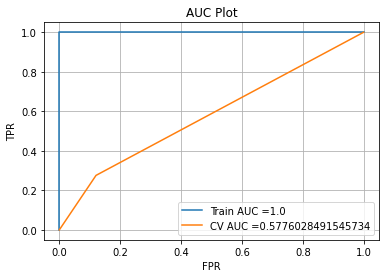

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


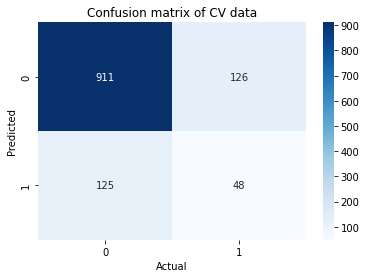

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 136
only_fraud_physician_count 53
County_0 119
County_34 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



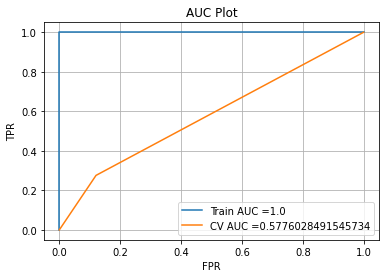

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


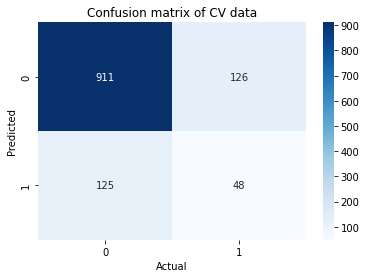

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Claim count 43
only_fraud_physician_count 70
County_0 150
County_34 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



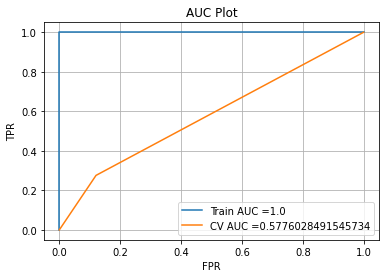

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


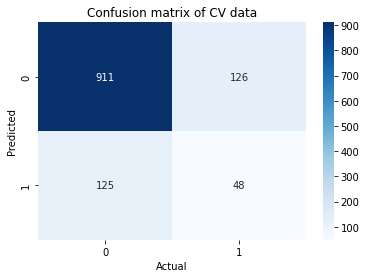

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 183
only_fraud_physician_count 73
County_0 161
County_34 46
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



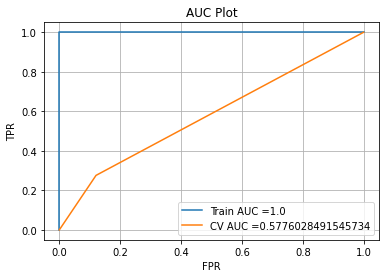

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


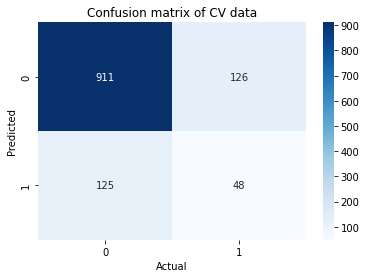

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 183
only_fraud_physician_count 73
County_0 161
County_34 46
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



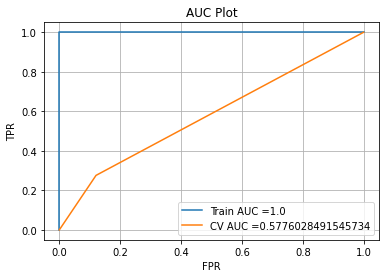

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


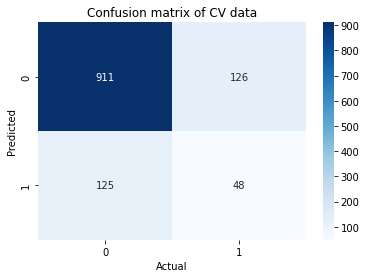

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 183
only_fraud_physician_count 73
County_0 161
County_34 46
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



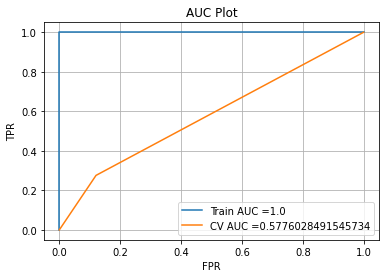

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


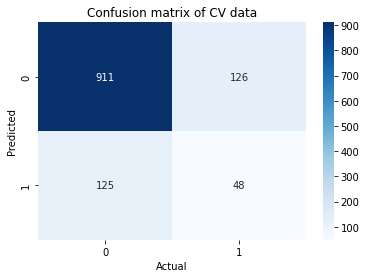

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 183
only_fraud_physician_count 73
County_0 161
County_34 46
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



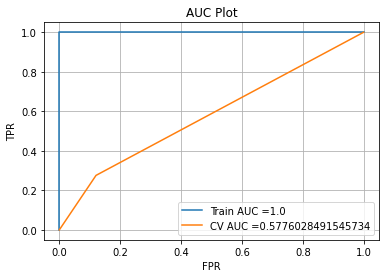

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


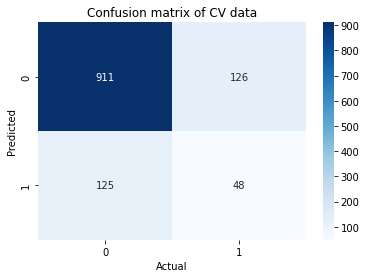

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 183
only_fraud_physician_count 73
County_0 161
County_34 46
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



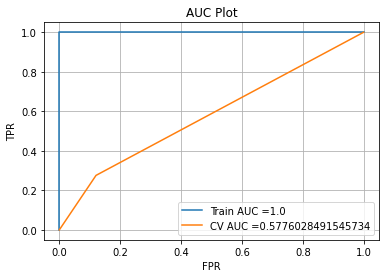

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


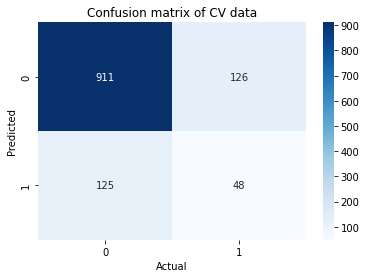

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Claim count 49
only_fraud_code_count 48
only_fraud_physician_count 100
County_0 237
County_1 33
County_7 36
County_22 38
County_34 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



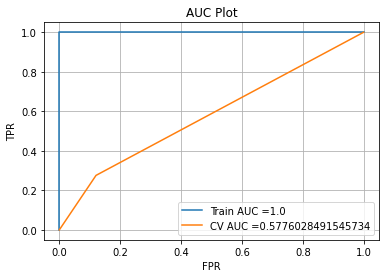

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


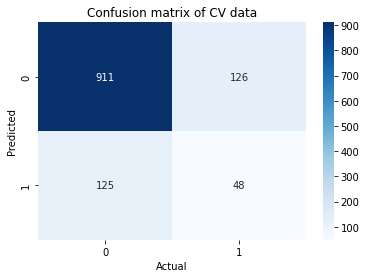

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 313
InscClaimAmtReimbursed_total 36
only_fraud_code_count 48
only_fraud_physician_count 103
County_0 281
County_1 38
County_7 38
County_22 38
County_34 54
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



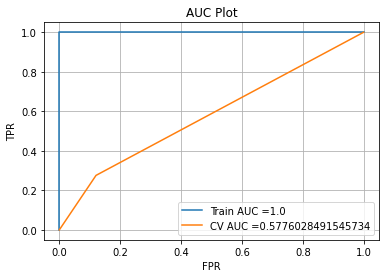

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


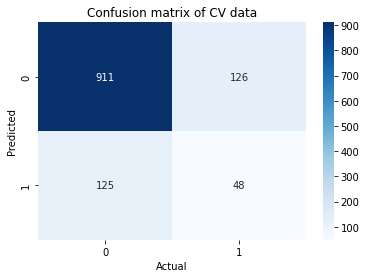

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 313
InscClaimAmtReimbursed_total 36
only_fraud_code_count 48
only_fraud_physician_count 103
County_0 281
County_1 38
County_7 38
County_22 38
County_34 54
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



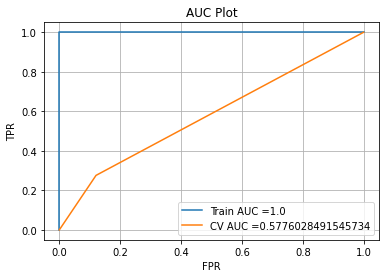

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


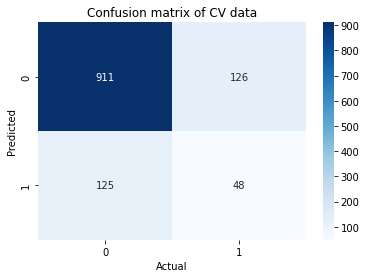

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 313
InscClaimAmtReimbursed_total 36
only_fraud_code_count 48
only_fraud_physician_count 103
County_0 281
County_1 38
County_7 38
County_22 38
County_34 54
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



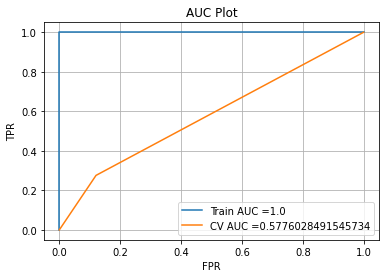

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


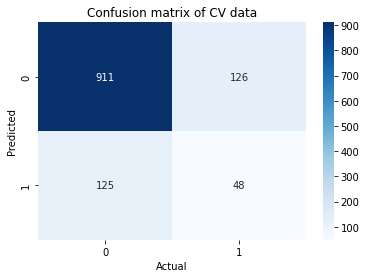

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 313
InscClaimAmtReimbursed_total 36
only_fraud_code_count 48
only_fraud_physician_count 103
County_0 281
County_1 38
County_7 38
County_22 38
County_34 54
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



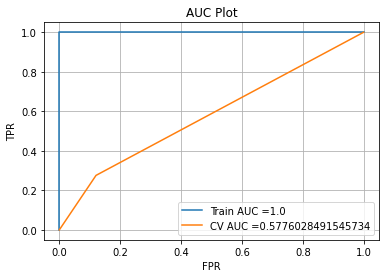

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


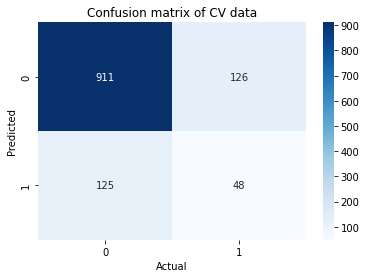

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 313
InscClaimAmtReimbursed_total 36
only_fraud_code_count 48
only_fraud_physician_count 103
County_0 281
County_1 38
County_7 38
County_22 38
County_34 54
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



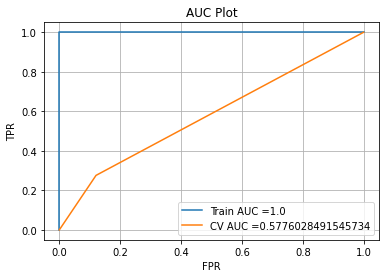

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


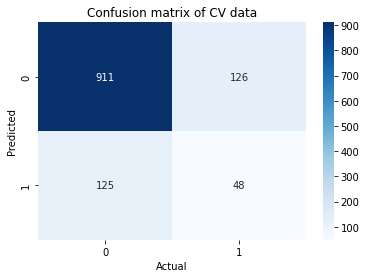

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Claim count 74
only_fraud_code_count 51
only_fraud_physician_count 125
County_0 267
County_1 42
County_7 36
County_16 32
County_22 54
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



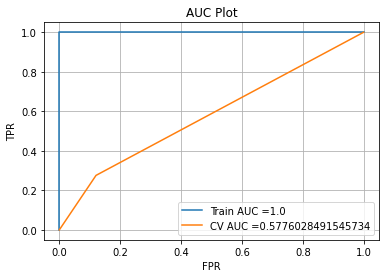

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


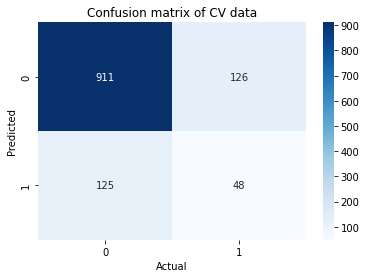

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 339
InscClaimAmtReimbursed_total 38
InscClaimAmtReimbursed_avg 32
only_fraud_code_count 52
only_fraud_physician_count 128
County_0 309
County_1 49
County_7 38
County_15 33
County_16 35
County_22 48
County_32 32
County_34 58
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



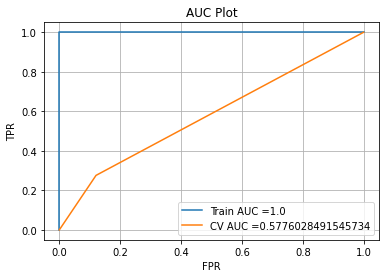

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


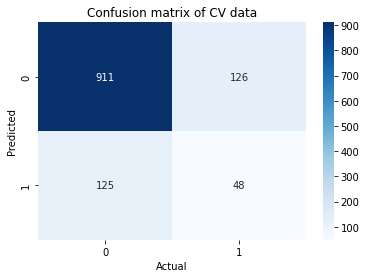

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 339
InscClaimAmtReimbursed_total 38
InscClaimAmtReimbursed_avg 32
only_fraud_code_count 52
only_fraud_physician_count 128
County_0 309
County_1 49
County_7 38
County_15 33
County_16 35
County_22 48
County_32 32
County_34 58
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



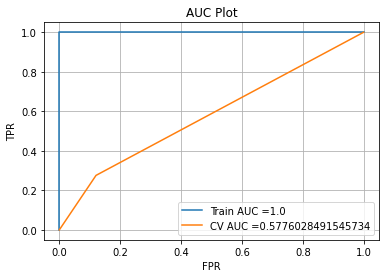

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


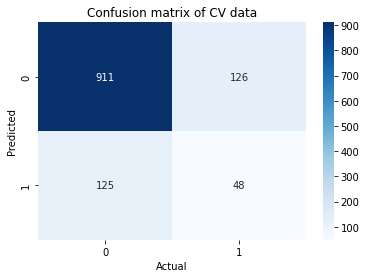

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 339
InscClaimAmtReimbursed_total 38
InscClaimAmtReimbursed_avg 32
only_fraud_code_count 52
only_fraud_physician_count 128
County_0 309
County_1 49
County_7 38
County_15 33
County_16 35
County_22 48
County_32 32
County_34 58
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



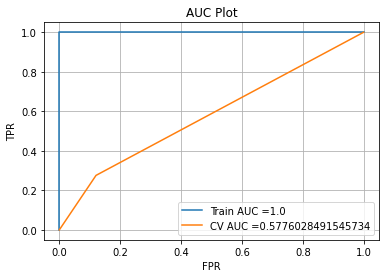

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


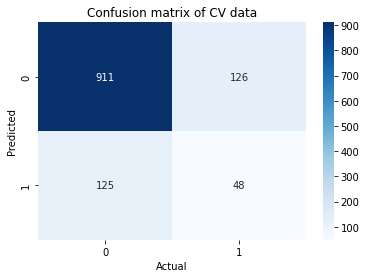

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 339
InscClaimAmtReimbursed_total 38
InscClaimAmtReimbursed_avg 32
only_fraud_code_count 52
only_fraud_physician_count 128
County_0 309
County_1 49
County_7 38
County_15 33
County_16 35
County_22 48
County_32 32
County_34 58
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



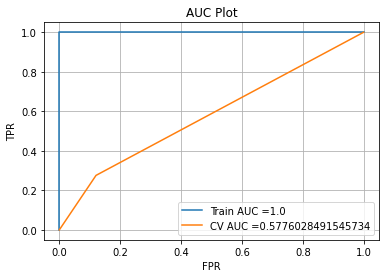

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


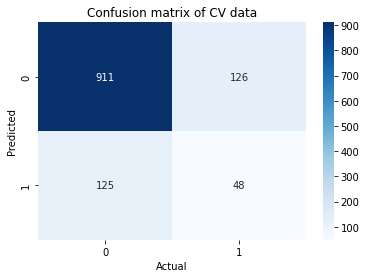

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 339
InscClaimAmtReimbursed_total 38
InscClaimAmtReimbursed_avg 32
only_fraud_code_count 52
only_fraud_physician_count 128
County_0 309
County_1 49
County_7 38
County_15 33
County_16 35
County_22 48
County_32 32
County_34 58
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



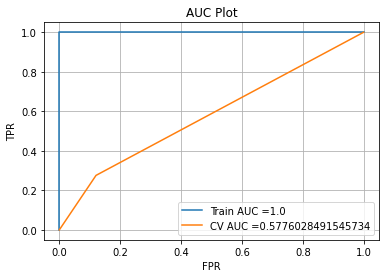

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


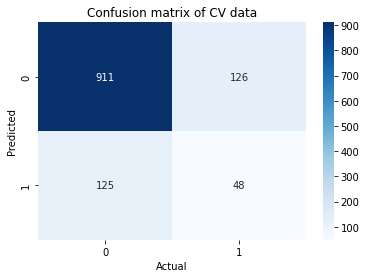

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Claim count 74
only_fraud_code_count 51
only_fraud_physician_count 125
Doctor 36
County_0 290
County_1 42
County_7 36
County_15 32
County_16 38
County_22 56
County_34 42
RenalDiseaseIndicator_1 44
ChronicCond_KidneyDisease_1 34
ChronicCond_Depression_1 41
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



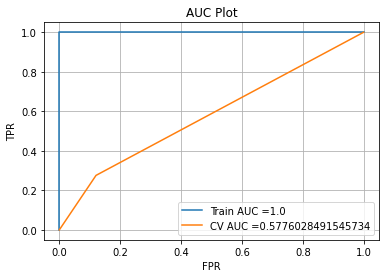

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


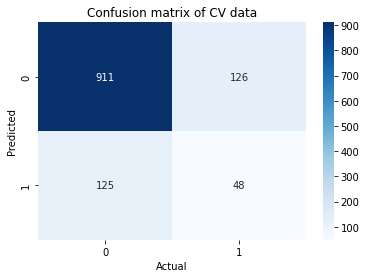

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 339
InscClaimAmtReimbursed_total 41
InscClaimAmtReimbursed_avg 34
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 39
County_0 333
County_1 49
County_7 40
County_15 36
County_16 40
County_22 49
County_23 34
County_32 33
County_34 58
RenalDiseaseIndicator_1 34
ChronicCond_Osteoporasis_1 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



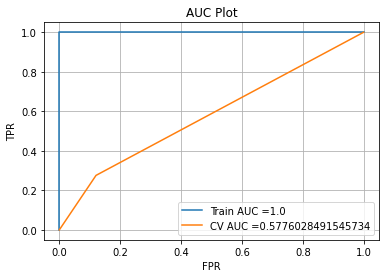

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


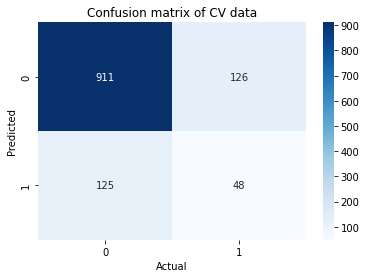

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 339
InscClaimAmtReimbursed_total 41
InscClaimAmtReimbursed_avg 34
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 39
County_0 333
County_1 49
County_7 40
County_15 36
County_16 40
County_22 49
County_23 34
County_32 33
County_34 58
RenalDiseaseIndicator_1 34
ChronicCond_Osteoporasis_1 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



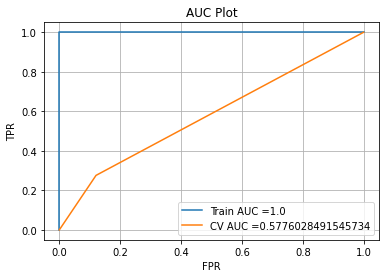

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


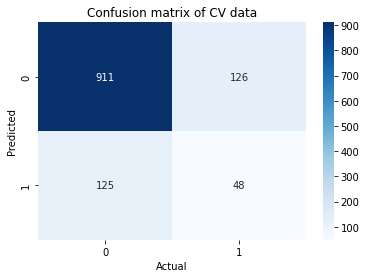

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 339
InscClaimAmtReimbursed_total 41
InscClaimAmtReimbursed_avg 34
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 39
County_0 333
County_1 49
County_7 40
County_15 36
County_16 40
County_22 49
County_23 34
County_32 33
County_34 58
RenalDiseaseIndicator_1 34
ChronicCond_Osteoporasis_1 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



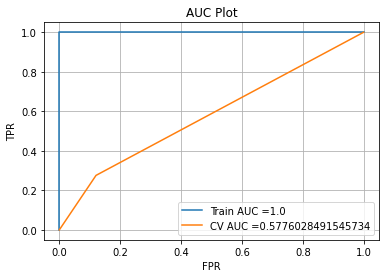

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


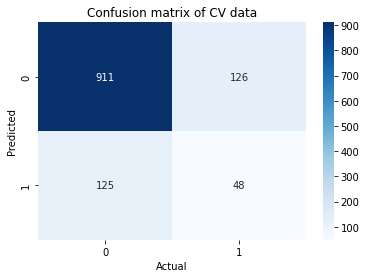

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 339
InscClaimAmtReimbursed_total 41
InscClaimAmtReimbursed_avg 34
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 39
County_0 333
County_1 49
County_7 40
County_15 36
County_16 40
County_22 49
County_23 34
County_32 33
County_34 58
RenalDiseaseIndicator_1 34
ChronicCond_Osteoporasis_1 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



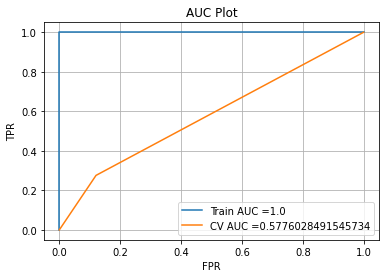

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


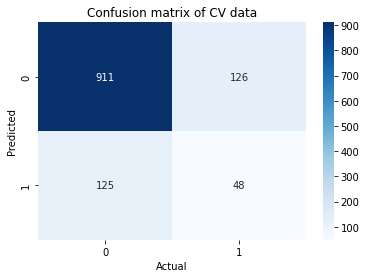

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 339
InscClaimAmtReimbursed_total 41
InscClaimAmtReimbursed_avg 34
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 39
County_0 333
County_1 49
County_7 40
County_15 36
County_16 40
County_22 49
County_23 34
County_32 33
County_34 58
RenalDiseaseIndicator_1 34
ChronicCond_Osteoporasis_1 38
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



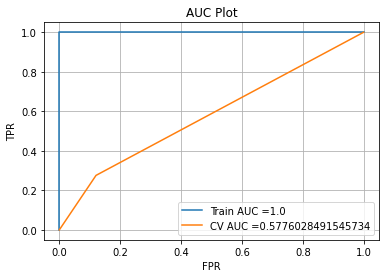

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


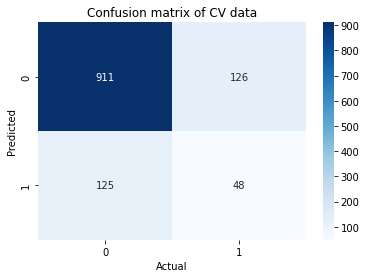

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Claim count 74
Race_1 42
only_fraud_code_count 51
only_fraud_physician_count 125
Doctor 53
County_0 310
County_1 42
County_7 38
County_15 45
County_16 43
County_22 56
County_23 34
County_34 49
RenalDiseaseIndicator_1 70
ChronicCond_Alzheimer_1 38
ChronicCond_KidneyDisease_1 71
ChronicCond_Depression_1 71
ChronicCond_Diabetes_1 32
ChronicCond_Osteoporasis_1 41
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



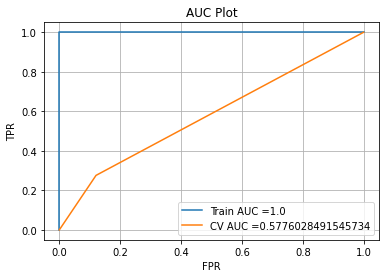

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


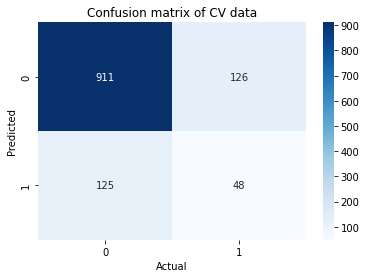

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 339
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 39
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 55
County_0 361
County_1 49
County_2 36
County_6 32
County_7 43
County_15 53
County_16 51
County_22 49
County_23 43
County_24 34
County_32 36
County_34 69
RenalDiseaseIndicator_1 34
ChronicCond_KidneyDisease_0 94
ChronicCond_KidneyDisease_1 39
ChronicCond_ObstrPulmonary_1 37
ChronicCond_Osteoporasis_1 92
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



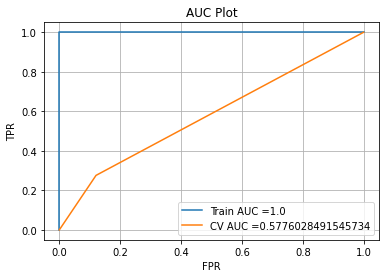

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


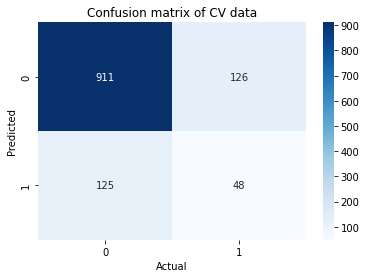

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 339
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 39
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 55
County_0 361
County_1 49
County_2 36
County_6 32
County_7 43
County_15 53
County_16 51
County_22 49
County_23 43
County_24 34
County_32 36
County_34 69
RenalDiseaseIndicator_1 34
ChronicCond_KidneyDisease_0 94
ChronicCond_KidneyDisease_1 39
ChronicCond_ObstrPulmonary_1 37
ChronicCond_Osteoporasis_1 92
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



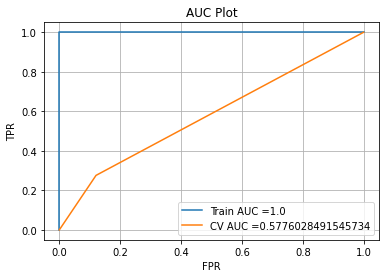

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


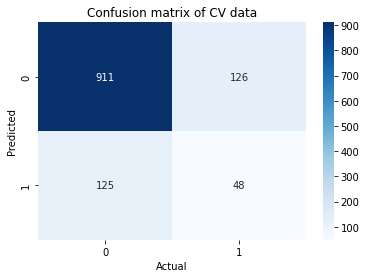

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 339
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 39
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 55
County_0 361
County_1 49
County_2 36
County_6 32
County_7 43
County_15 53
County_16 51
County_22 49
County_23 43
County_24 34
County_32 36
County_34 69
RenalDiseaseIndicator_1 34
ChronicCond_KidneyDisease_0 94
ChronicCond_KidneyDisease_1 39
ChronicCond_ObstrPulmonary_1 37
ChronicCond_Osteoporasis_1 92
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



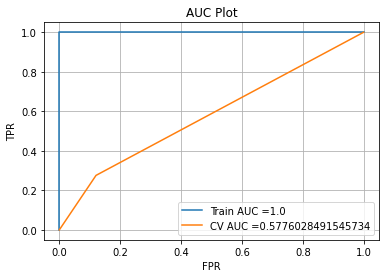

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


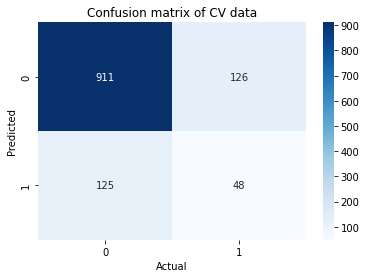

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 339
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 39
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 55
County_0 361
County_1 49
County_2 36
County_6 32
County_7 43
County_15 53
County_16 51
County_22 49
County_23 43
County_24 34
County_32 36
County_34 69
RenalDiseaseIndicator_1 34
ChronicCond_KidneyDisease_0 94
ChronicCond_KidneyDisease_1 39
ChronicCond_ObstrPulmonary_1 37
ChronicCond_Osteoporasis_1 92
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



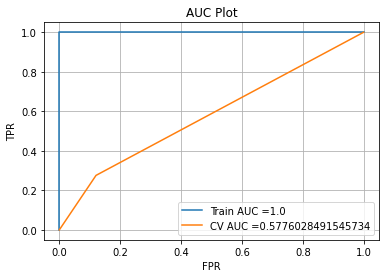

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


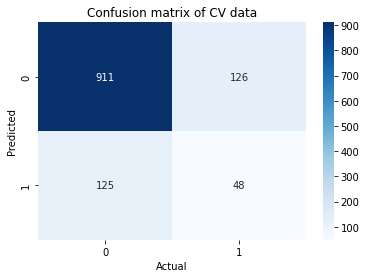

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 339
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 39
only_fraud_code_count 52
only_fraud_physician_count 128
Doctor 55
County_0 361
County_1 49
County_2 36
County_6 32
County_7 43
County_15 53
County_16 51
County_22 49
County_23 43
County_24 34
County_32 36
County_34 69
RenalDiseaseIndicator_1 34
ChronicCond_KidneyDisease_0 94
ChronicCond_KidneyDisease_1 39
ChronicCond_ObstrPulmonary_1 37
ChronicCond_Osteoporasis_1 92
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



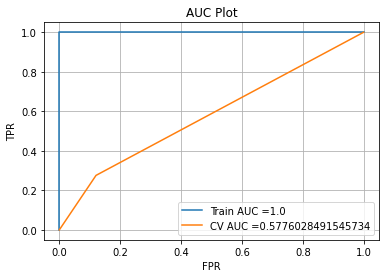

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


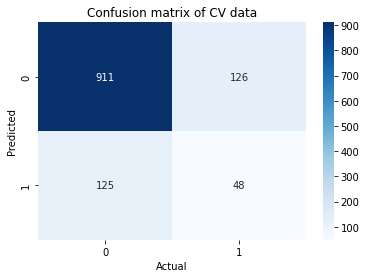

In [93]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.83,0:0.16})
        clf.fit(X_train_outpatient,y_train_outpatient.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_outpatient.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_train_outpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Claim count 33
only_fraud_physician_count 50
County_0 63
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



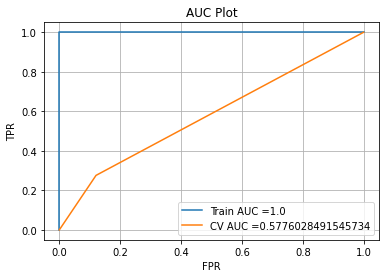

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


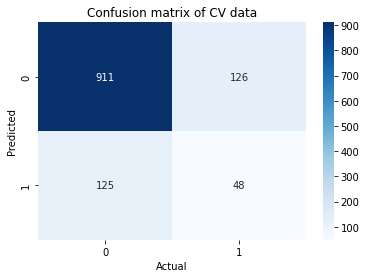

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 136
InscClaimAmtReimbursed_avg 63
only_fraud_physician_count 50
County_0 74
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



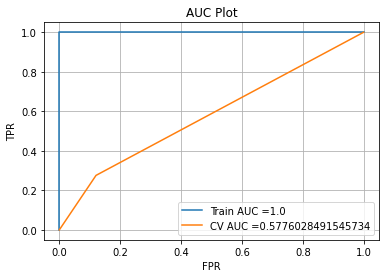

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


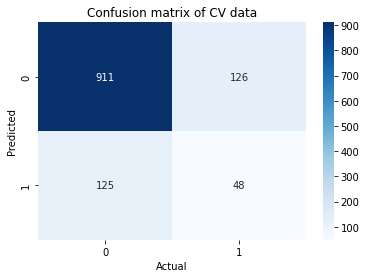

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 136
InscClaimAmtReimbursed_avg 63
only_fraud_physician_count 50
County_0 74
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



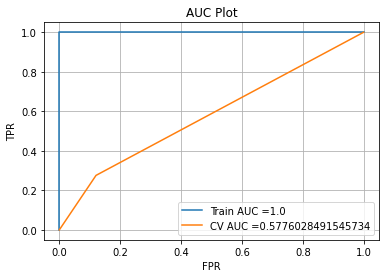

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


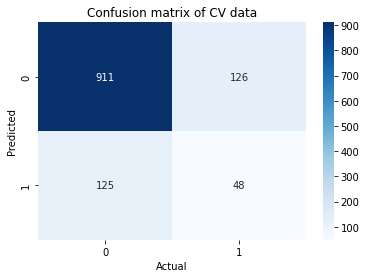

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 136
InscClaimAmtReimbursed_avg 63
only_fraud_physician_count 50
County_0 74
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



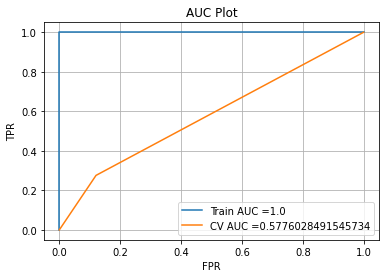

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


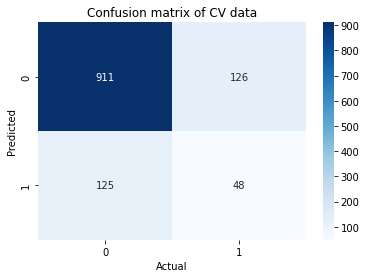

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 136
InscClaimAmtReimbursed_avg 63
only_fraud_physician_count 50
County_0 74
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



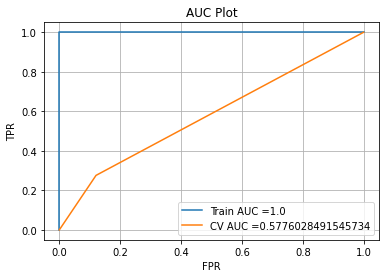

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


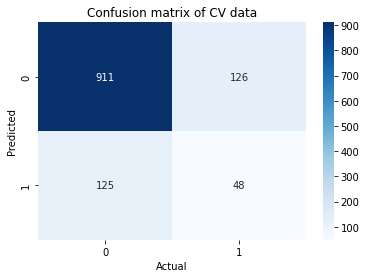

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 136
InscClaimAmtReimbursed_avg 63
only_fraud_physician_count 50
County_0 74
County_16 34
County_34 55
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



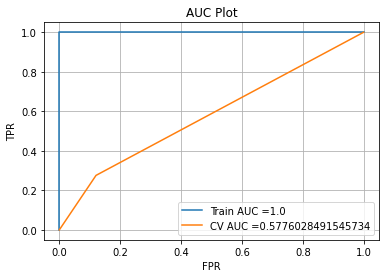

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


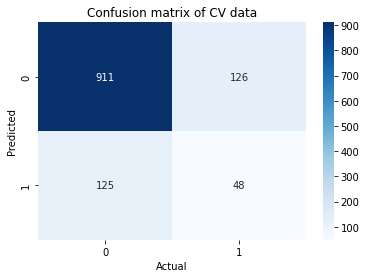

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Claim count 35
InscClaimAmtReimbursed_avg 32
only_fraud_physician_count 70
County_0 90
County_16 40
County_25 32
County_34 64
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



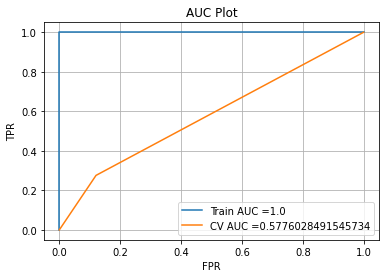

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


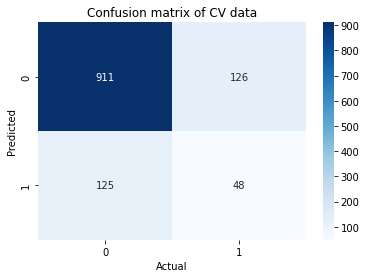

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 189
InscClaimAmtReimbursed_avg 73
only_fraud_physician_count 70
County_0 111
County_16 39
County_25 31
County_34 66
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



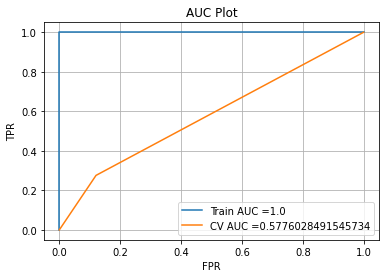

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


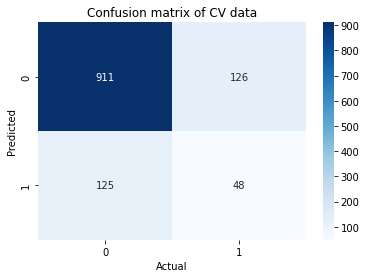

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 189
InscClaimAmtReimbursed_avg 73
only_fraud_physician_count 70
County_0 111
County_16 39
County_25 31
County_34 66
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



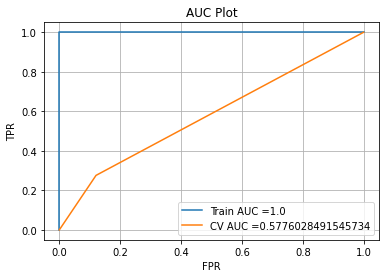

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


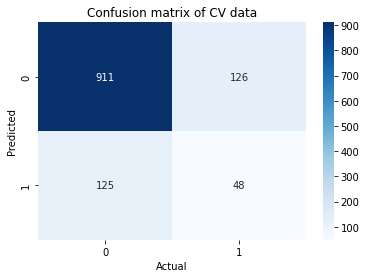

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 189
InscClaimAmtReimbursed_avg 73
only_fraud_physician_count 70
County_0 111
County_16 39
County_25 31
County_34 66
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



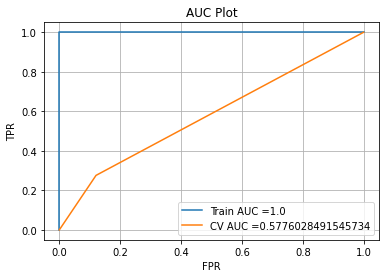

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


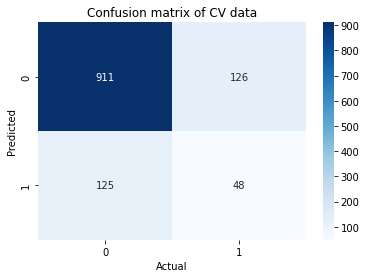

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 189
InscClaimAmtReimbursed_avg 73
only_fraud_physician_count 70
County_0 111
County_16 39
County_25 31
County_34 66
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



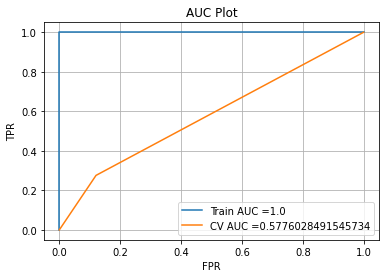

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


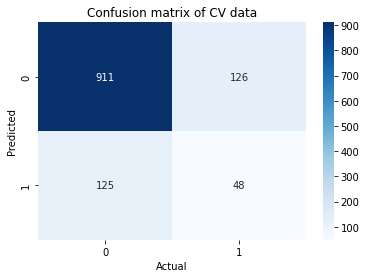

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 189
InscClaimAmtReimbursed_avg 73
only_fraud_physician_count 70
County_0 111
County_16 39
County_25 31
County_34 66
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



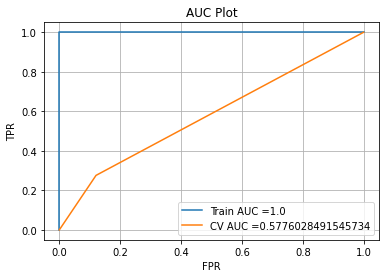

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


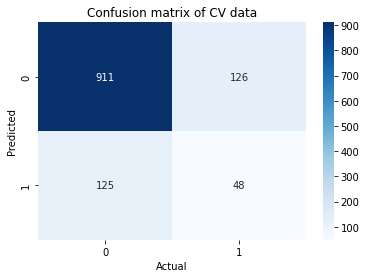

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Claim count 45
InscClaimAmtReimbursed_avg 40
only_fraud_physician_count 100
County_0 130
County_1 42
County_15 39
County_16 54
County_25 37
County_34 84
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



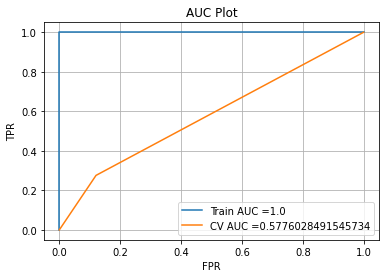

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


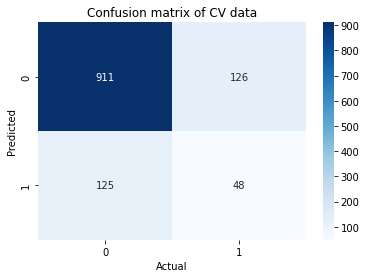

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 276
InscClaimAmtReimbursed_total 39
InscClaimAmtReimbursed_avg 96
only_fraud_physician_count 100
County_0 152
County_1 45
County_15 40
County_16 58
County_25 36
County_34 88
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



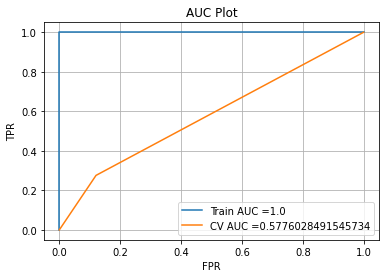

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


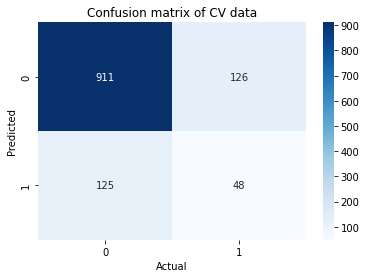

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 276
InscClaimAmtReimbursed_total 39
InscClaimAmtReimbursed_avg 96
only_fraud_physician_count 100
County_0 152
County_1 45
County_15 40
County_16 58
County_25 36
County_34 88
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



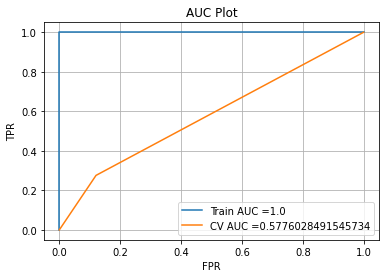

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


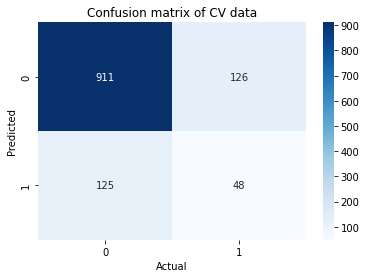

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 276
InscClaimAmtReimbursed_total 39
InscClaimAmtReimbursed_avg 96
only_fraud_physician_count 100
County_0 152
County_1 45
County_15 40
County_16 58
County_25 36
County_34 88
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



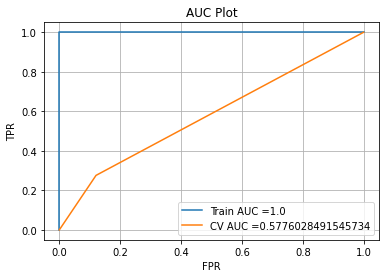

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


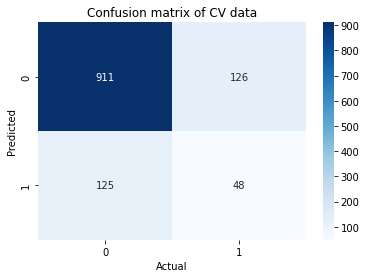

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 276
InscClaimAmtReimbursed_total 39
InscClaimAmtReimbursed_avg 96
only_fraud_physician_count 100
County_0 152
County_1 45
County_15 40
County_16 58
County_25 36
County_34 88
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



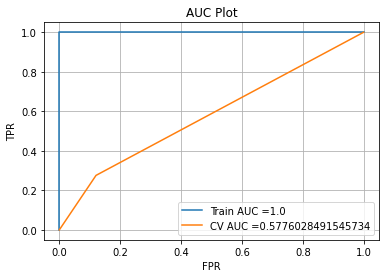

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


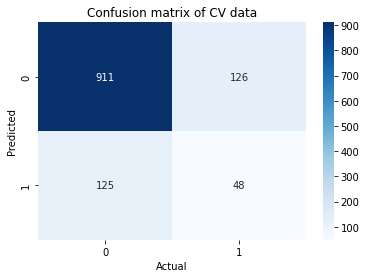

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 276
InscClaimAmtReimbursed_total 39
InscClaimAmtReimbursed_avg 96
only_fraud_physician_count 100
County_0 152
County_1 45
County_15 40
County_16 58
County_25 36
County_34 88
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00      8154



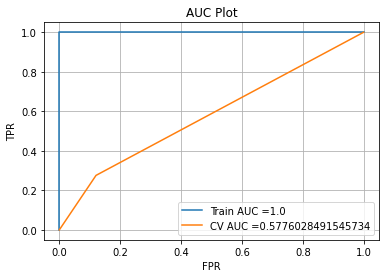

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


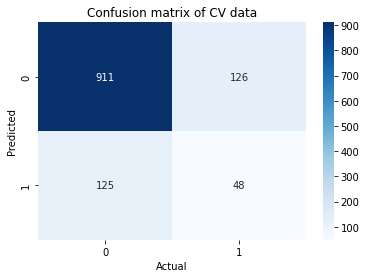

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Claim count 94
InscClaimAmtReimbursed_avg 46
only_fraud_code_count 36
only_fraud_physician_count 136
County_0 176
County_1 58
County_6 33
County_15 42
County_16 62
County_25 39
County_34 92
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted avg       1.00      1.00      1.00 

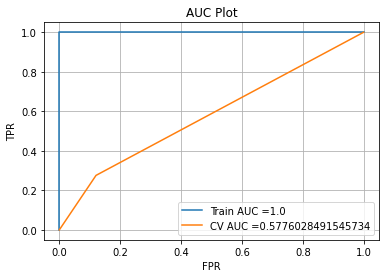

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


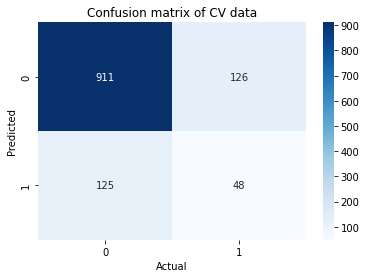

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
only_fraud_code_count 37
only_fraud_physician_count 136
County_0 197
County_1 61
County_6 36
County_15 43
County_16 66
County_25 38
County_34 96
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted a

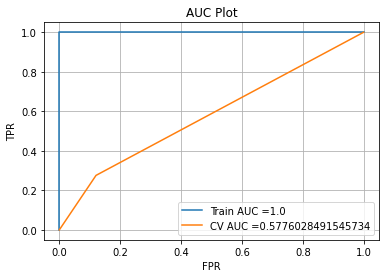

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


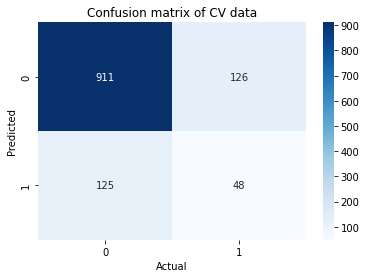

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
only_fraud_code_count 37
only_fraud_physician_count 136
County_0 197
County_1 61
County_6 36
County_15 43
County_16 66
County_25 38
County_34 96
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted a

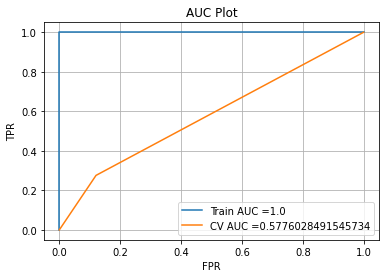

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


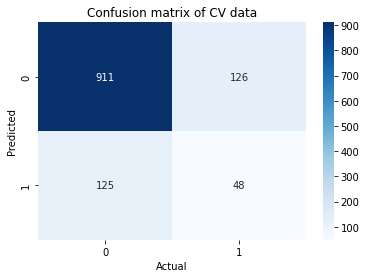

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
only_fraud_code_count 37
only_fraud_physician_count 136
County_0 197
County_1 61
County_6 36
County_15 43
County_16 66
County_25 38
County_34 96
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted 

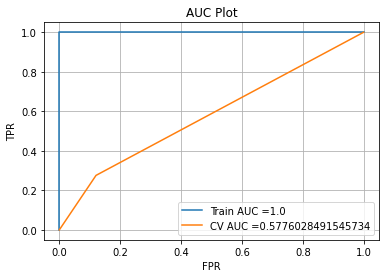

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


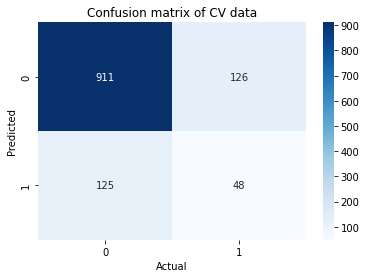

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
only_fraud_code_count 37
only_fraud_physician_count 136
County_0 197
County_1 61
County_6 36
County_15 43
County_16 66
County_25 38
County_34 96
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted 

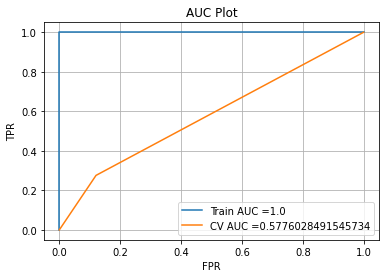

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


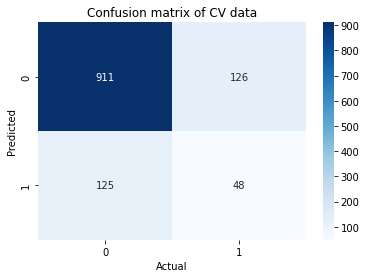

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
only_fraud_code_count 37
only_fraud_physician_count 136
County_0 197
County_1 61
County_6 36
County_15 43
County_16 66
County_25 38
County_34 96
ChronicCond_stroke_1 33
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.00      1.00      8154
weighted 

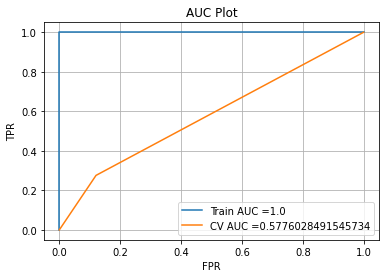

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


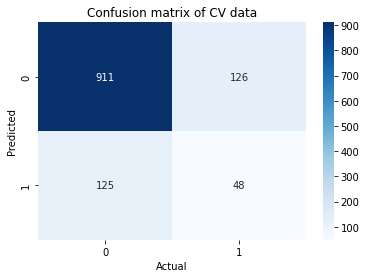

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Claim count 94
InscClaimAmtReimbursed_avg 46
only_fraud_code_count 36
only_fraud_physician_count 136
Doctor 32
County_0 203
County_1 58
County_6 39
County_15 42
County_16 68
County_25 39
County_34 92
RenalDiseaseIndicator_1 46
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00      8154
   macro avg       1.00      1.

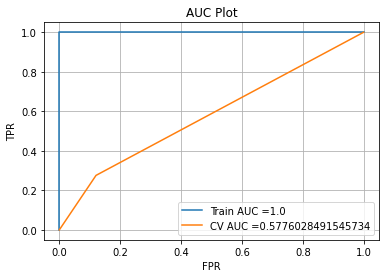

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


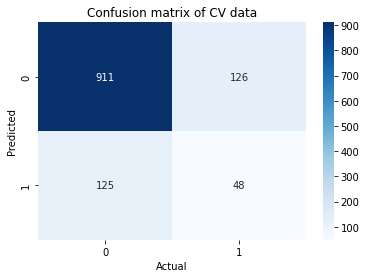

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 31
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 35
County_0 224
County_1 61
County_6 42
County_15 43
County_16 72
County_25 38
County_34 96
RenalDiseaseIndicator_1 48
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00 

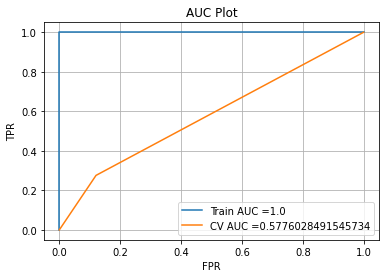

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


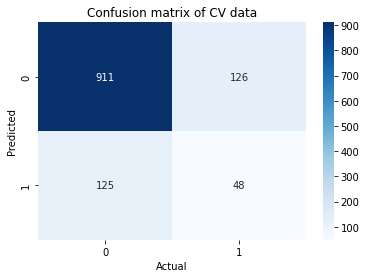

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 31
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 35
County_0 224
County_1 61
County_6 42
County_15 43
County_16 72
County_25 38
County_34 96
RenalDiseaseIndicator_1 48
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00 

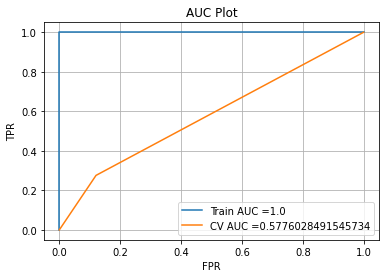

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


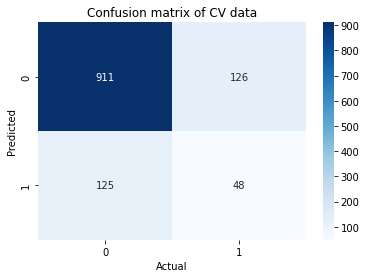

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 31
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 35
County_0 224
County_1 61
County_6 42
County_15 43
County_16 72
County_25 38
County_34 96
RenalDiseaseIndicator_1 48
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00

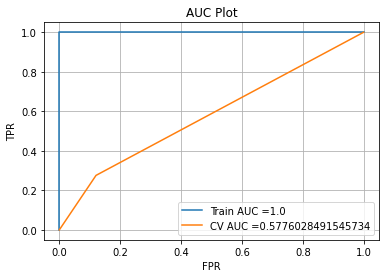

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


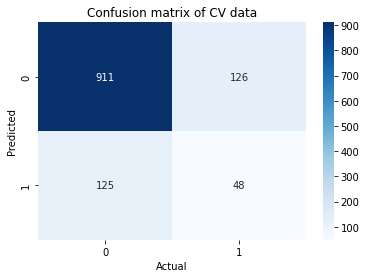

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 31
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 35
County_0 224
County_1 61
County_6 42
County_15 43
County_16 72
County_25 38
County_34 96
RenalDiseaseIndicator_1 48
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00

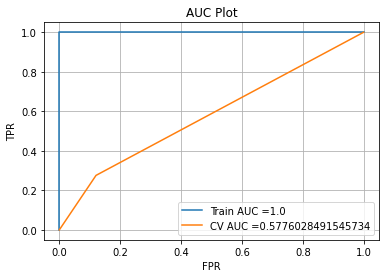

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


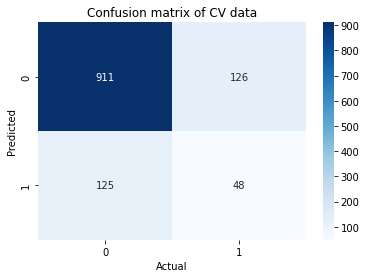

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 31
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 35
County_0 224
County_1 61
County_6 42
County_15 43
County_16 72
County_25 38
County_34 96
RenalDiseaseIndicator_1 48
ChronicCond_Osteoporasis_1 32
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      4077

    accuracy                           1.00

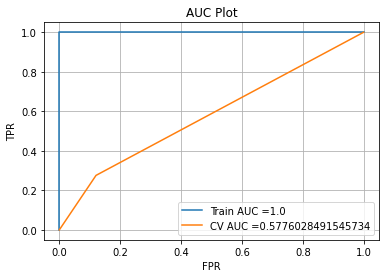

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


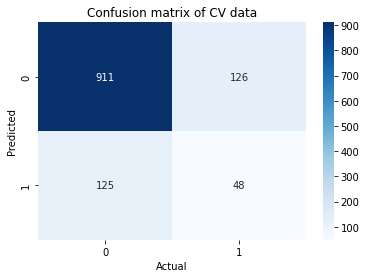

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Claim count 94
InscClaimAmtReimbursed_avg 46
only_fraud_code_count 36
only_fraud_physician_count 136
Doctor 56
County_0 222
County_1 65
County_6 42
County_15 44
County_16 69
County_25 39
County_34 92
RenalDiseaseIndicator_1 86
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      40

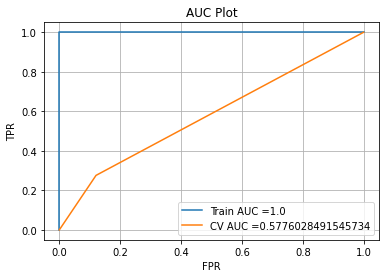

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


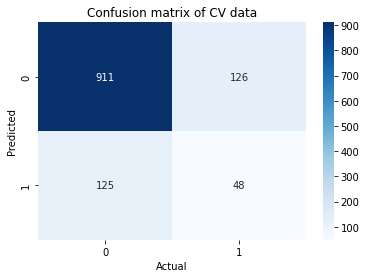

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 37
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 59
County_0 243
County_1 68
County_6 45
County_15 45
County_16 73
County_25 38
County_34 96
RenalDiseaseIndicator_1 88
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

          

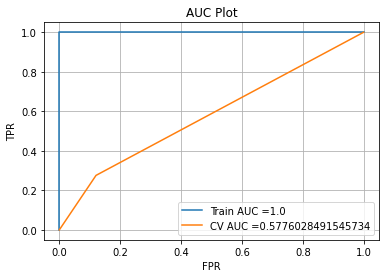

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


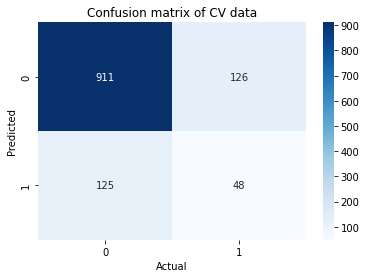

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 37
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 59
County_0 243
County_1 68
County_6 45
County_15 45
County_16 73
County_25 38
County_34 96
RenalDiseaseIndicator_1 88
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

          

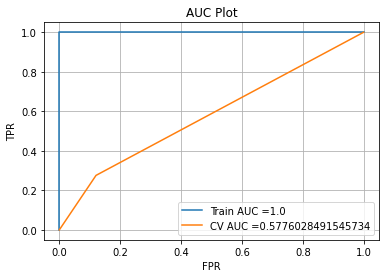

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


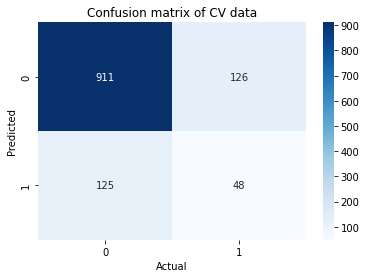

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 37
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 59
County_0 243
County_1 68
County_6 45
County_15 45
County_16 73
County_25 38
County_34 96
RenalDiseaseIndicator_1 88
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

         

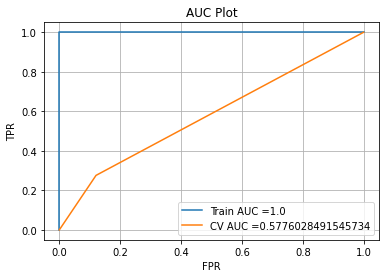

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


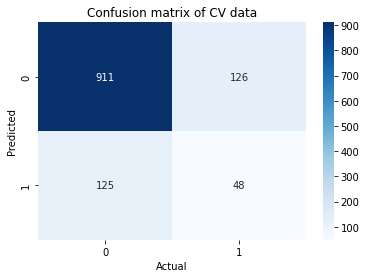

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 37
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 59
County_0 243
County_1 68
County_6 45
County_15 45
County_16 73
County_25 38
County_34 96
RenalDiseaseIndicator_1 88
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

         

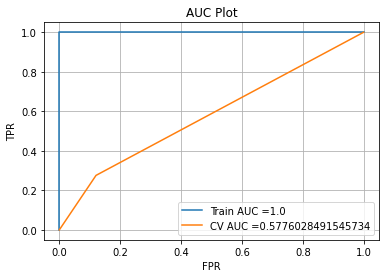

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


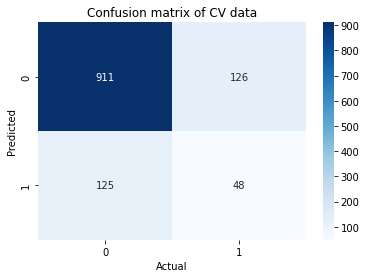

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 326
InscClaimAmtReimbursed_total 42
InscClaimAmtReimbursed_avg 101
Age 37
only_fraud_code_count 37
only_fraud_physician_count 136
Doctor 59
County_0 243
County_1 68
County_6 45
County_15 45
County_16 73
County_25 38
County_34 96
RenalDiseaseIndicator_1 88
RenalDiseaseIndicator_0 36
ChronicCond_Alzheimer_1 53
ChronicCond_Heartfailure_0 57
ChronicCond_KidneyDisease_0 121
ChronicCond_Diabetes_0 31
ChronicCond_Osteoporasis_1 76
ChronicCond_stroke_1 34
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

         

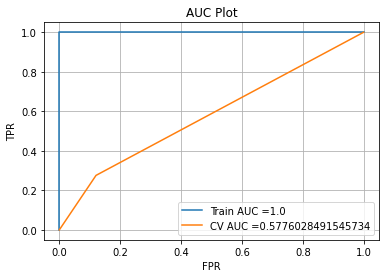

Cross validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


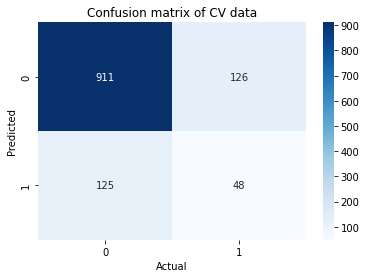

In [94]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est,class_weight={1:0.49,0:0.51})
        clf.fit(X_outpatient_50_50,y_outpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_50_50.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_50_50)
        print(classification_report(y_outpatient_50_50,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Claim count 76
only_fraud_physician_count 50
County_0 102
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



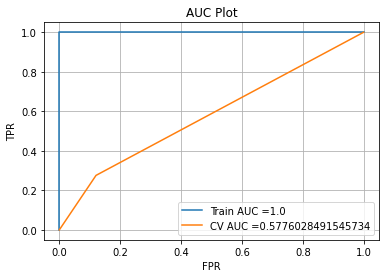

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


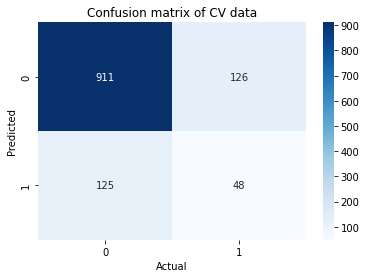

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 138
InscClaimAmtReimbursed_avg 44
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



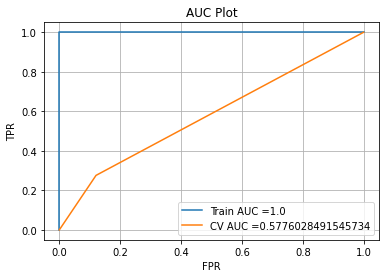

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


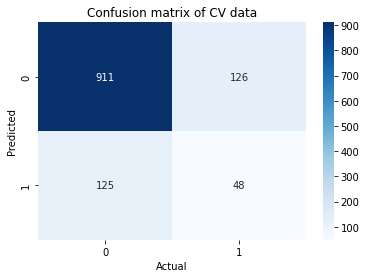

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 138
InscClaimAmtReimbursed_avg 44
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



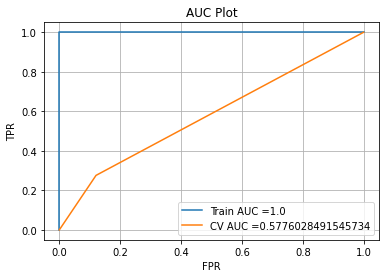

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


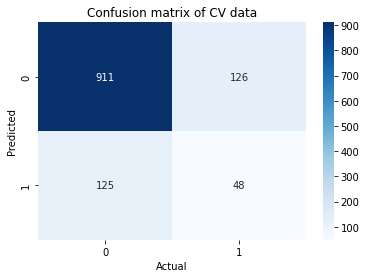

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 138
InscClaimAmtReimbursed_avg 44
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



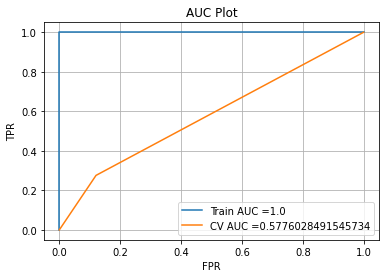

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


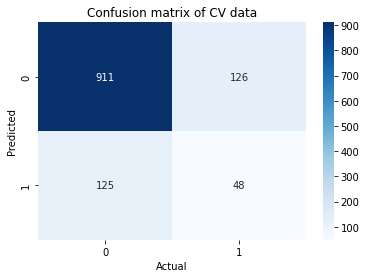

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 138
InscClaimAmtReimbursed_avg 44
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



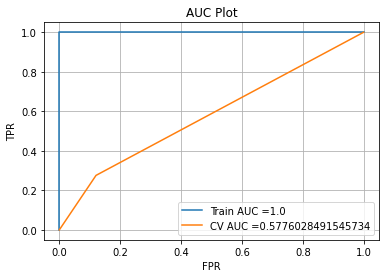

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


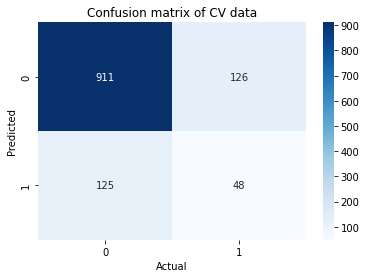

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 138
InscClaimAmtReimbursed_avg 44
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



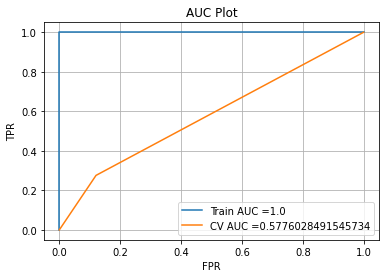

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


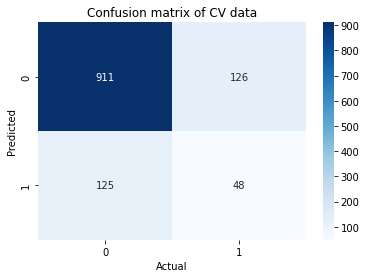

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Claim count 83
only_fraud_physician_count 70
County_0 146
County_1 39
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



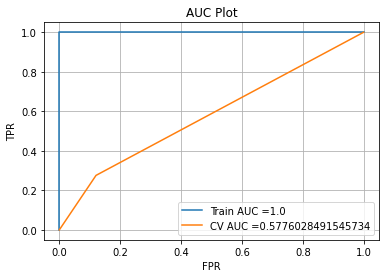

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


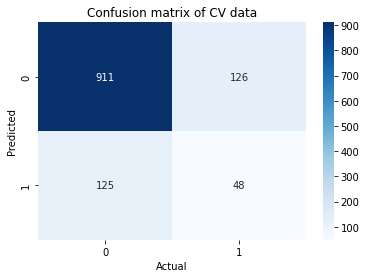

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 186
InscClaimAmtReimbursed_total 36
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 70
County_0 155
County_1 44
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



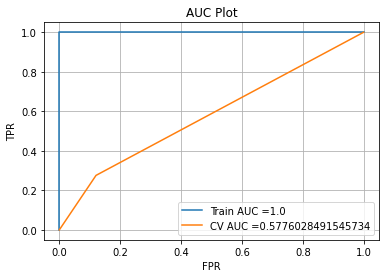

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


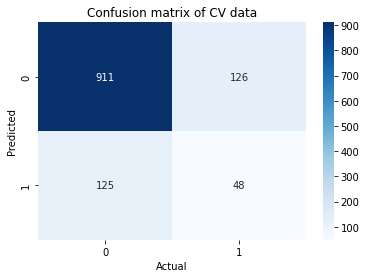

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 186
InscClaimAmtReimbursed_total 36
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 70
County_0 155
County_1 44
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



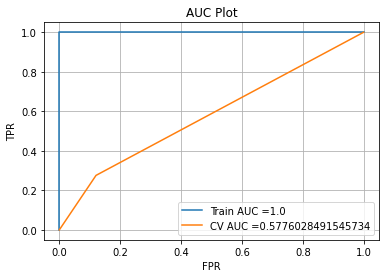

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


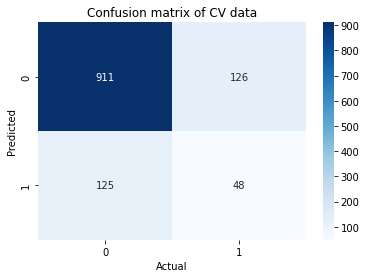

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 186
InscClaimAmtReimbursed_total 36
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 70
County_0 155
County_1 44
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



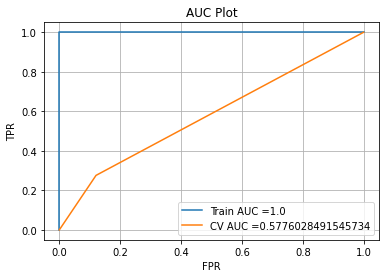

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


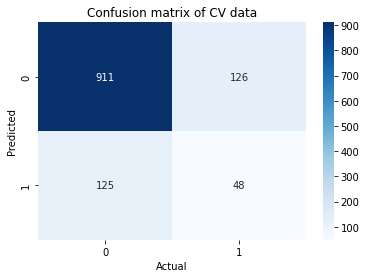

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 186
InscClaimAmtReimbursed_total 36
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 70
County_0 155
County_1 44
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



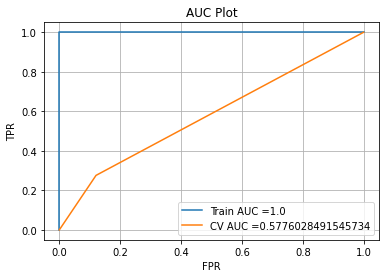

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


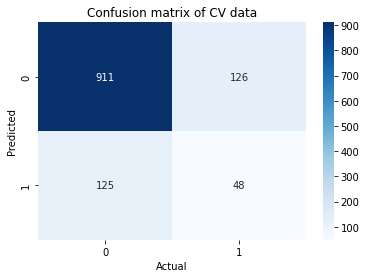

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 186
InscClaimAmtReimbursed_total 36
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 70
County_0 155
County_1 44
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



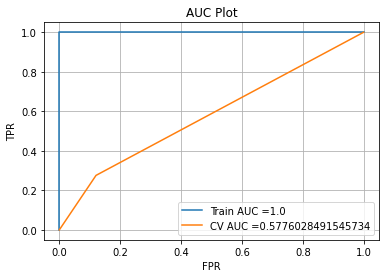

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


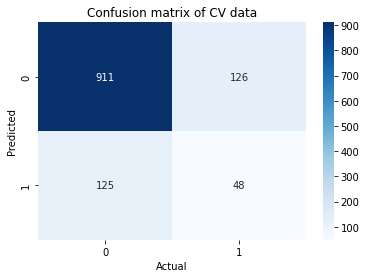

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Claim count 83
InscClaimAmtReimbursed_avg 37
only_fraud_code_count 45
only_fraud_physician_count 100
County_0 233
County_1 61
County_22 45
County_29 31
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



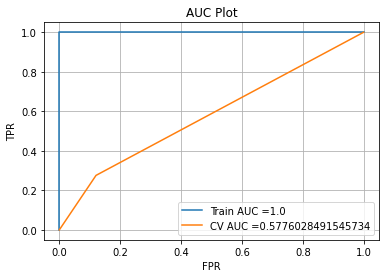

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


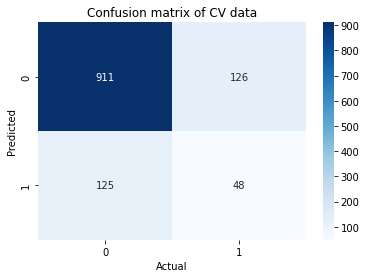

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 277
InscClaimAmtReimbursed_total 45
InscClaimAmtReimbursed_avg 77
only_fraud_code_count 47
only_fraud_physician_count 100
County_0 244
County_1 68
County_7 43
County_15 35
County_22 64
County_29 33
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00  

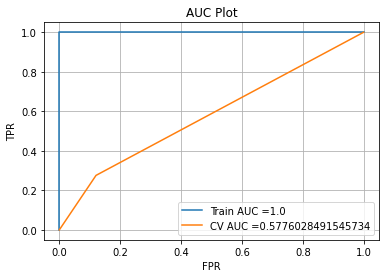

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


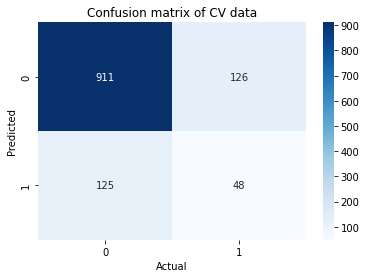

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 277
InscClaimAmtReimbursed_total 45
InscClaimAmtReimbursed_avg 77
only_fraud_code_count 47
only_fraud_physician_count 100
County_0 244
County_1 68
County_7 43
County_15 35
County_22 64
County_29 33
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00  

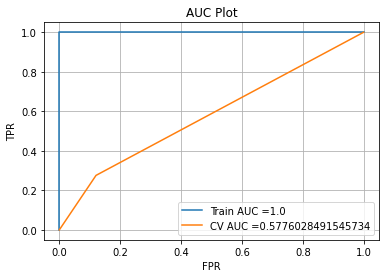

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


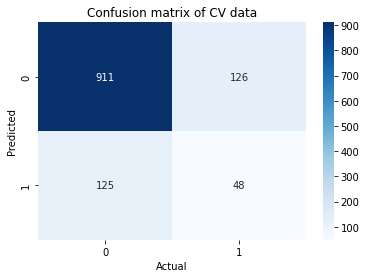

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 277
InscClaimAmtReimbursed_total 45
InscClaimAmtReimbursed_avg 77
only_fraud_code_count 47
only_fraud_physician_count 100
County_0 244
County_1 68
County_7 43
County_15 35
County_22 64
County_29 33
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00 

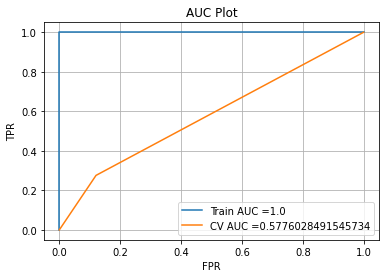

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


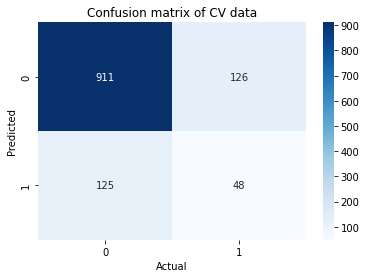

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 277
InscClaimAmtReimbursed_total 45
InscClaimAmtReimbursed_avg 77
only_fraud_code_count 47
only_fraud_physician_count 100
County_0 244
County_1 68
County_7 43
County_15 35
County_22 64
County_29 33
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00 

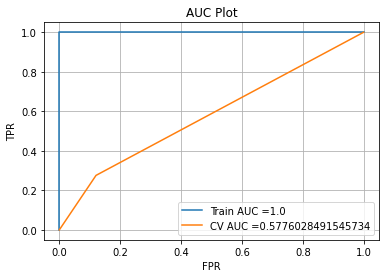

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


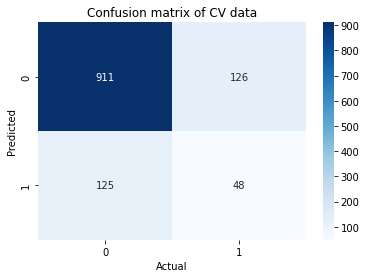

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 277
InscClaimAmtReimbursed_total 45
InscClaimAmtReimbursed_avg 77
only_fraud_code_count 47
only_fraud_physician_count 100
County_0 244
County_1 68
County_7 43
County_15 35
County_22 64
County_29 33
County_34 37
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00 

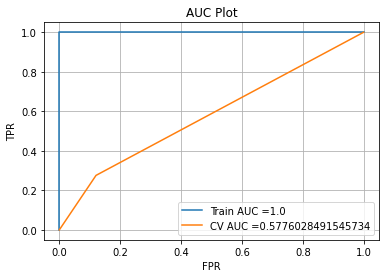

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


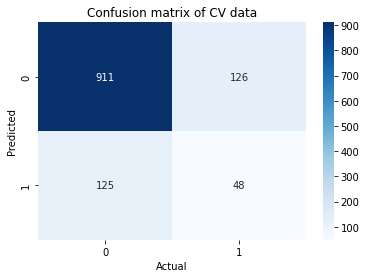

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Claim count 104
InscClaimAmtReimbursed_avg 43
only_fraud_code_count 61
only_fraud_physician_count 141
County_0 316
County_1 75
County_16 31
County_22 77
County_23 37
County_29 33
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00      1.00      1.00      6808



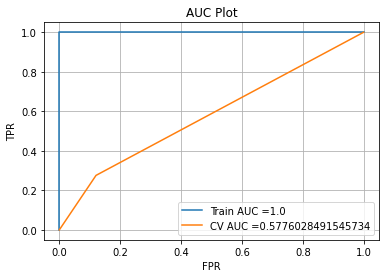

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


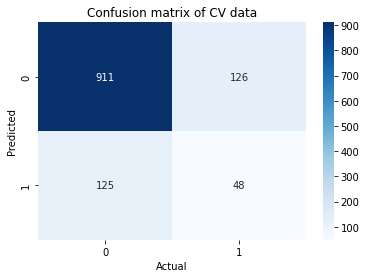

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 89
only_fraud_code_count 64
only_fraud_physician_count 141
County_0 330
County_1 83
County_7 46
County_15 43
County_16 35
County_22 116
County_23 49
County_29 35
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted

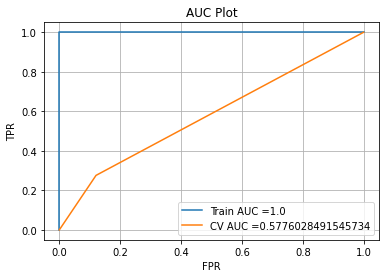

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


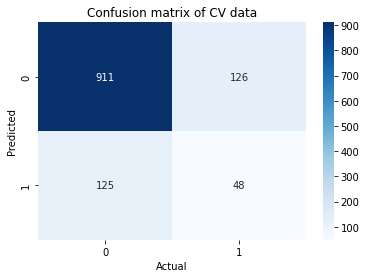

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 89
only_fraud_code_count 64
only_fraud_physician_count 141
County_0 330
County_1 83
County_7 46
County_15 43
County_16 35
County_22 116
County_23 49
County_29 35
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted

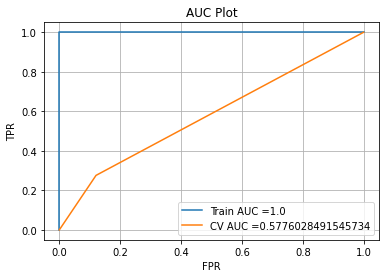

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


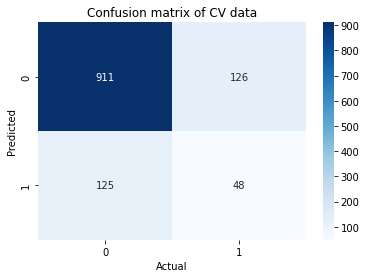

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 89
only_fraud_code_count 64
only_fraud_physician_count 141
County_0 330
County_1 83
County_7 46
County_15 43
County_16 35
County_22 116
County_23 49
County_29 35
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighte

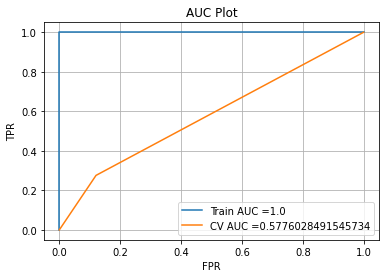

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


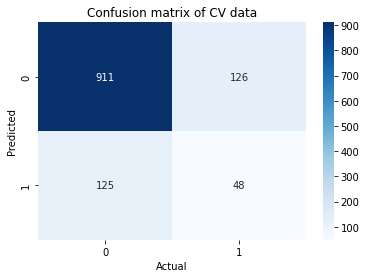

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 89
only_fraud_code_count 64
only_fraud_physician_count 141
County_0 330
County_1 83
County_7 46
County_15 43
County_16 35
County_22 116
County_23 49
County_29 35
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighte

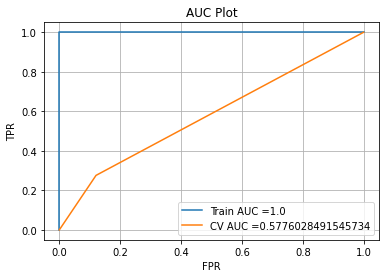

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


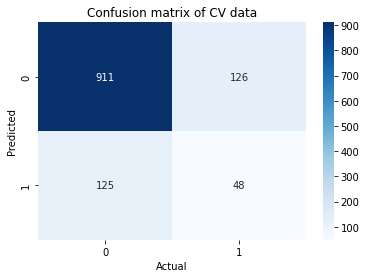

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 89
only_fraud_code_count 64
only_fraud_physician_count 141
County_0 330
County_1 83
County_7 46
County_15 43
County_16 35
County_22 116
County_23 49
County_29 35
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighte

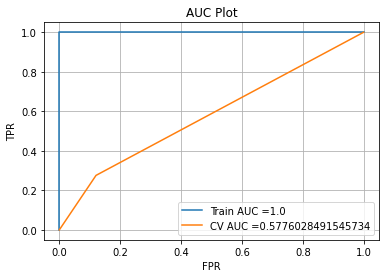

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


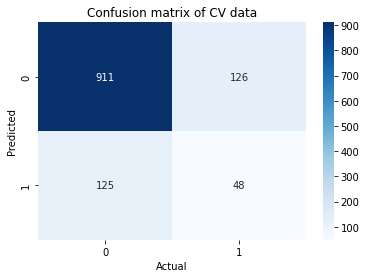

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Claim count 104
InscClaimAmtReimbursed_avg 46
only_fraud_code_count 61
only_fraud_physician_count 141
Doctor 36
County_0 343
County_1 75
County_16 35
County_22 77
County_23 43
County_29 38
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.00      1.00      1.00      6808
weighted avg       1.00   

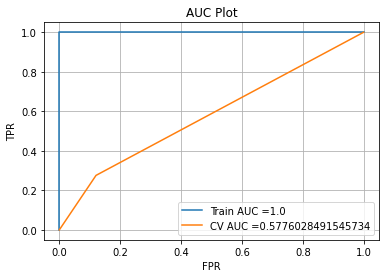

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


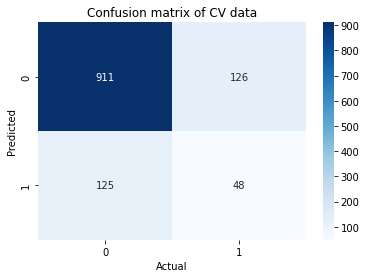

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 92
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 37
County_0 357
County_1 83
County_7 47
County_15 43
County_16 39
County_22 116
County_23 55
County_29 40
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.0

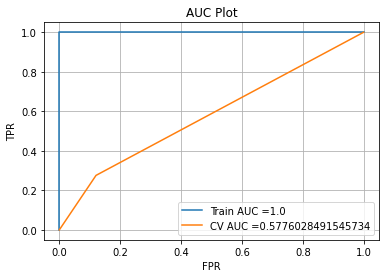

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


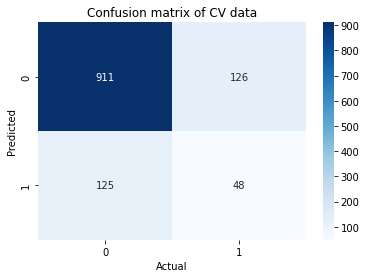

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 92
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 37
County_0 357
County_1 83
County_7 47
County_15 43
County_16 39
County_22 116
County_23 55
County_29 40
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.0

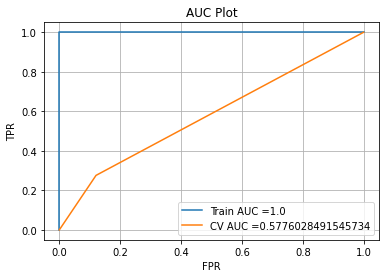

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


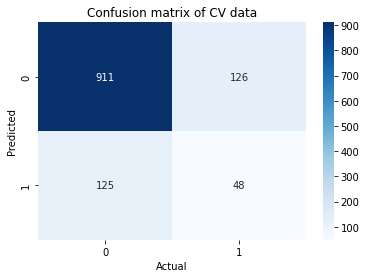

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 92
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 37
County_0 357
County_1 83
County_7 47
County_15 43
County_16 39
County_22 116
County_23 55
County_29 40
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.

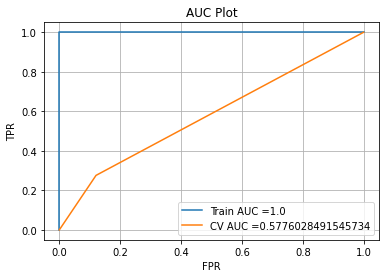

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


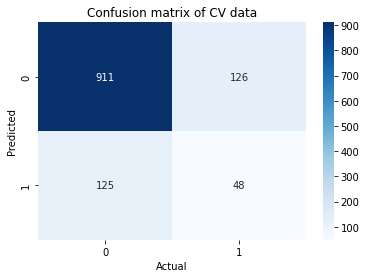

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 92
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 37
County_0 357
County_1 83
County_7 47
County_15 43
County_16 39
County_22 116
County_23 55
County_29 40
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.

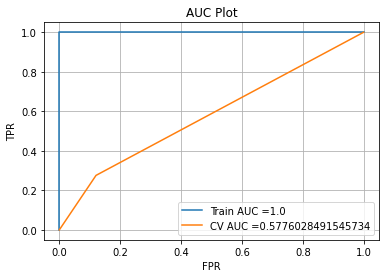

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


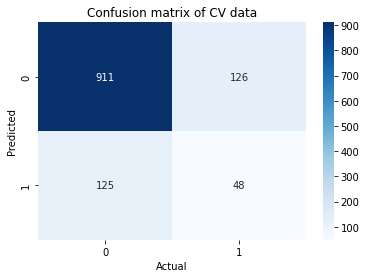

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 92
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 37
County_0 357
County_1 83
County_7 47
County_15 43
County_16 39
County_22 116
County_23 55
County_29 40
County_34 42
ChronicCond_Osteoporasis_1 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg       1.

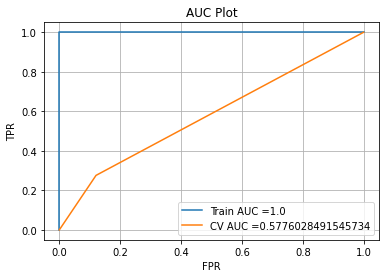

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


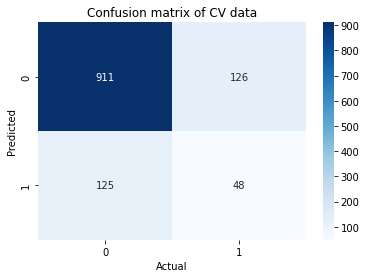

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Claim count 104
InscClaimAmtReimbursed_avg 49
only_fraud_code_count 61
only_fraud_physician_count 141
Doctor 46
County_0 351
County_1 77
County_16 36
County_22 77
County_23 46
County_29 39
County_34 43
ChronicCond_Heartfailure_0 55
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy                           1.00      6808
   macro avg      

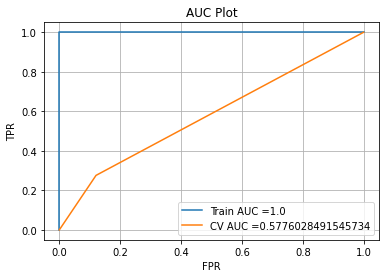

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


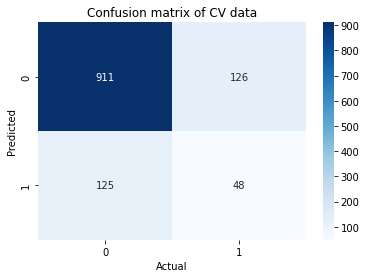

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 95
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 47
County_0 365
County_1 84
County_7 48
County_15 43
County_16 40
County_22 116
County_23 57
County_29 41
County_34 42
ChronicCond_Heartfailure_0 53
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy  

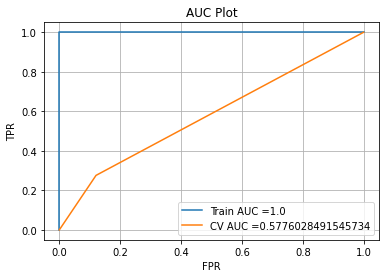

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


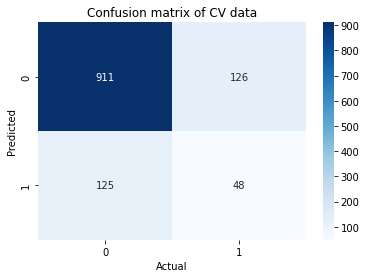

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 95
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 47
County_0 365
County_1 84
County_7 48
County_15 43
County_16 40
County_22 116
County_23 57
County_29 41
County_34 42
ChronicCond_Heartfailure_0 53
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy  

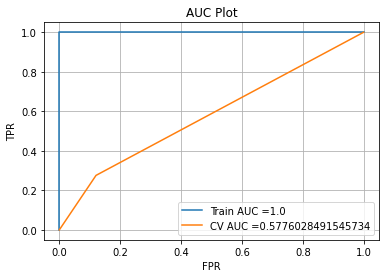

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


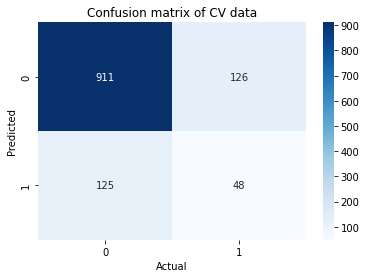

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 95
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 47
County_0 365
County_1 84
County_7 48
County_15 43
County_16 40
County_22 116
County_23 57
County_29 41
County_34 42
ChronicCond_Heartfailure_0 53
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy 

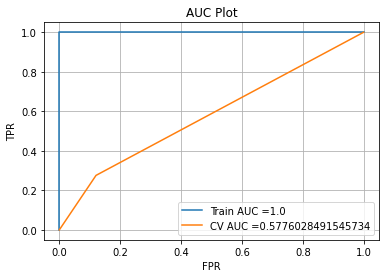

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


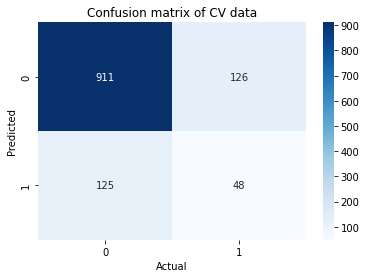

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 95
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 47
County_0 365
County_1 84
County_7 48
County_15 43
County_16 40
County_22 116
County_23 57
County_29 41
County_34 42
ChronicCond_Heartfailure_0 53
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy 

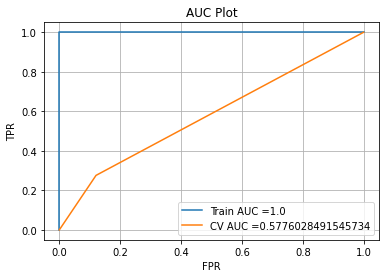

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


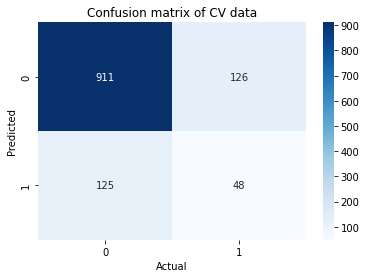

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 336
InscClaimAmtReimbursed_total 59
InscClaimAmtReimbursed_avg 95
only_fraud_code_count 64
only_fraud_physician_count 141
Doctor 47
County_0 365
County_1 84
County_7 48
County_15 43
County_16 40
County_22 116
County_23 57
County_29 41
County_34 42
ChronicCond_Heartfailure_0 53
ChronicCond_KidneyDisease_0 71
ChronicCond_Osteoporasis_1 56
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      2731

    accuracy 

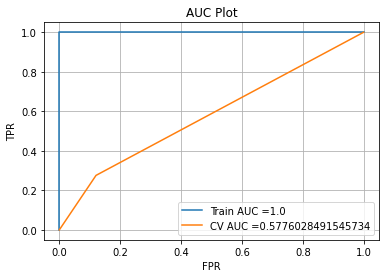

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


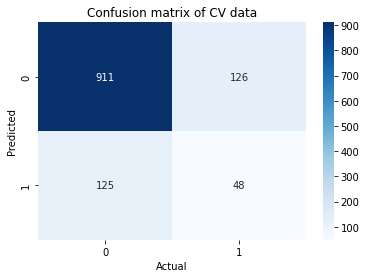

In [95]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est)
        clf.fit(X_outpatient_60_40,y_outpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_60_40.columns),clf.feature_importances_):
            if j > 30:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_60_40)
        print(classification_report(y_outpatient_60_40,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  50
Important Features
Claim count 62
only_fraud_physician_count 50
County_0 101
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



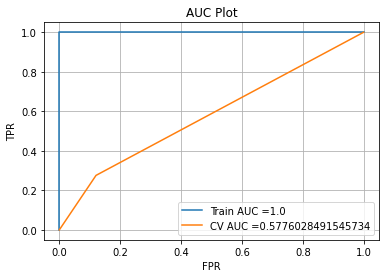

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


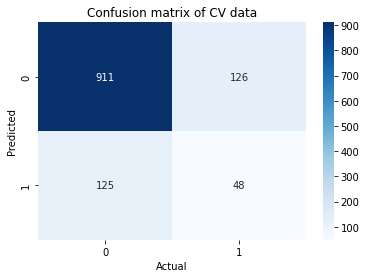

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  50
Important Features
Claim count 121
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



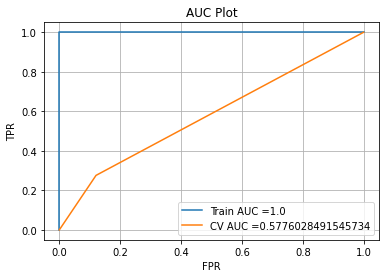

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


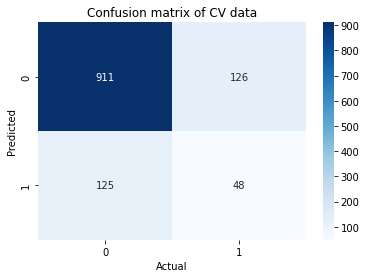

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  50
Important Features
Claim count 121
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



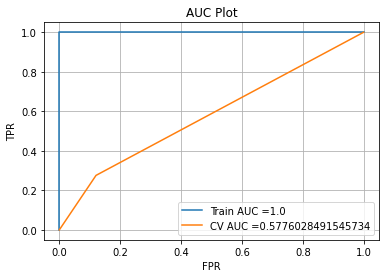

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


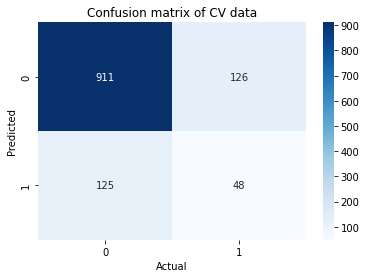

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  50
Important Features
Claim count 121
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



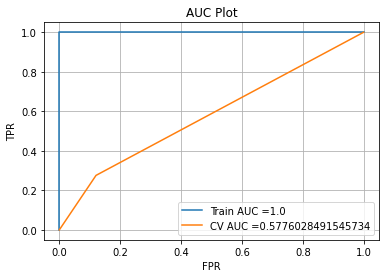

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


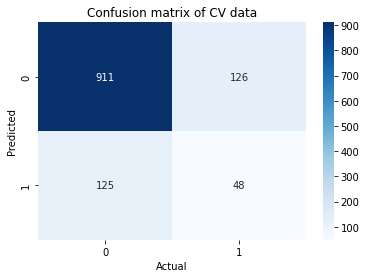

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  50
Important Features
Claim count 121
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



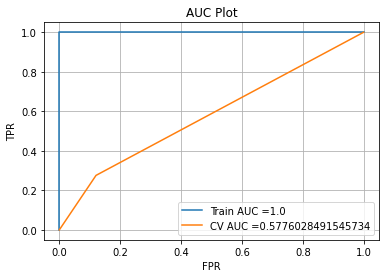

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


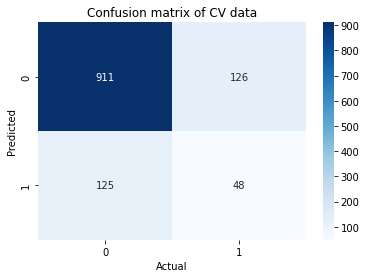

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  50
Important Features
Claim count 121
only_fraud_physician_count 50
County_0 104
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



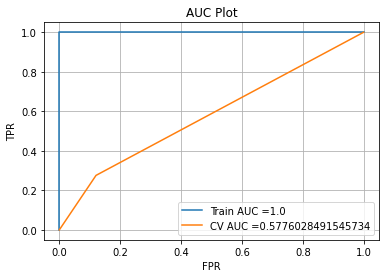

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


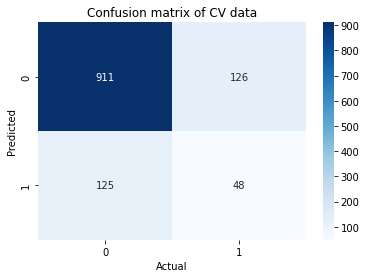

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  70
Important Features
Claim count 63
only_fraud_physician_count 70
County_0 141
County_34 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



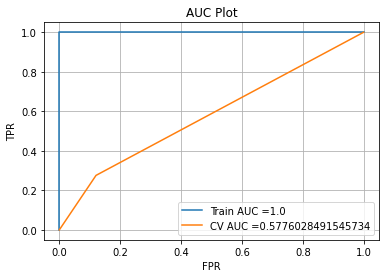

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


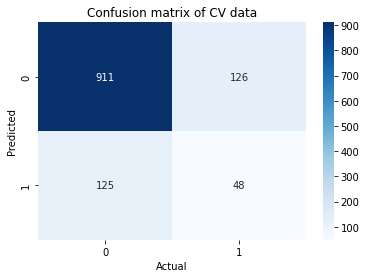

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  70
Important Features
Claim count 158
InscClaimAmtReimbursed_avg 51
only_fraud_physician_count 70
County_0 157
County_34 43
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



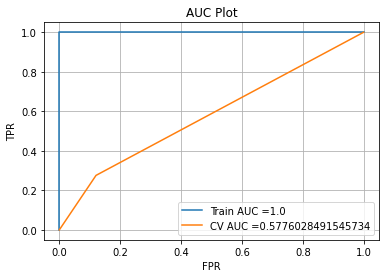

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


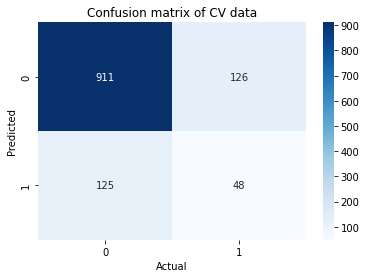

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  70
Important Features
Claim count 158
InscClaimAmtReimbursed_avg 51
only_fraud_physician_count 70
County_0 157
County_34 43
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



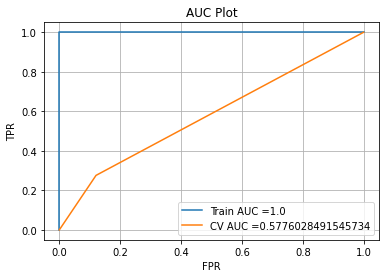

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


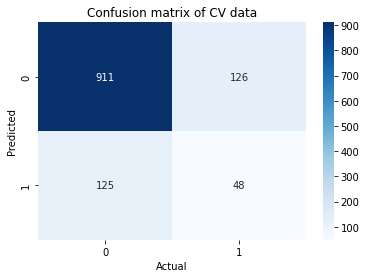

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  70
Important Features
Claim count 158
InscClaimAmtReimbursed_avg 51
only_fraud_physician_count 70
County_0 157
County_34 43
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



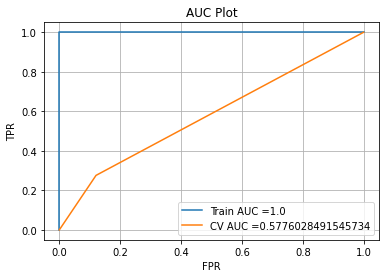

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


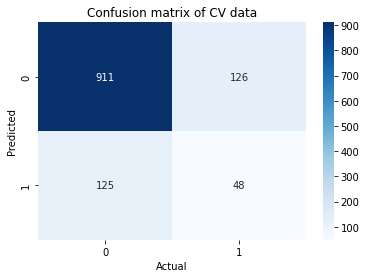

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  70
Important Features
Claim count 158
InscClaimAmtReimbursed_avg 51
only_fraud_physician_count 70
County_0 157
County_34 43
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



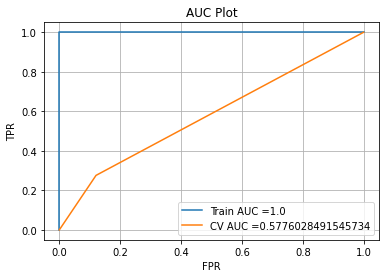

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


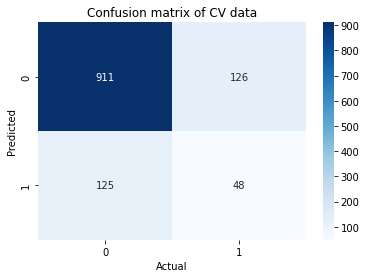

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  70
Important Features
Claim count 158
InscClaimAmtReimbursed_avg 51
only_fraud_physician_count 70
County_0 157
County_34 43
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



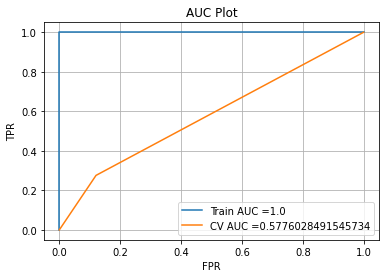

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


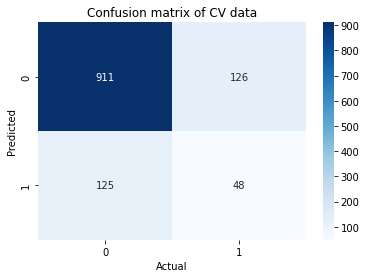

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  100
Important Features
Claim count 64
only_fraud_physician_count 100
County_0 200
County_1 55
County_2 79
County_15 52
County_32 44
County_34 45
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



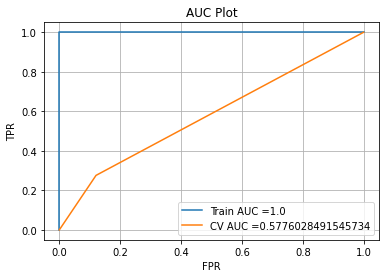

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


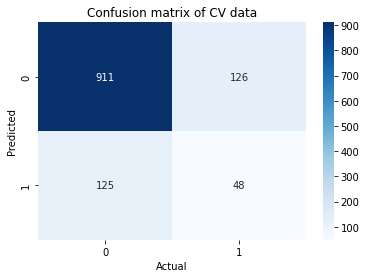

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  100
Important Features
Claim count 216
InscClaimAmtReimbursed_avg 56
only_fraud_physician_count 100
County_0 216
County_1 63
County_2 83
County_15 53
County_21 42
County_32 44
County_34 46
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



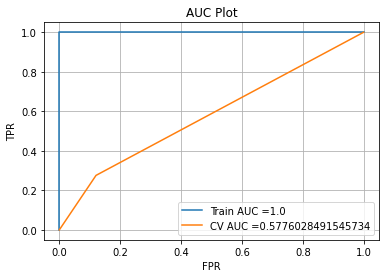

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


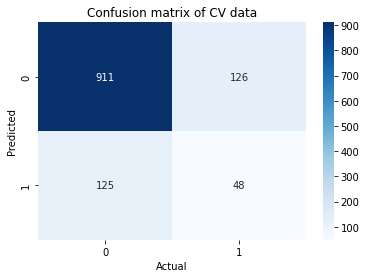

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  100
Important Features
Claim count 216
InscClaimAmtReimbursed_avg 56
only_fraud_physician_count 100
County_0 216
County_1 63
County_2 83
County_15 53
County_21 42
County_32 44
County_34 46
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



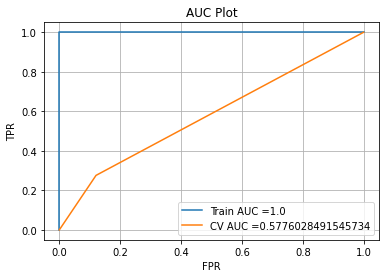

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


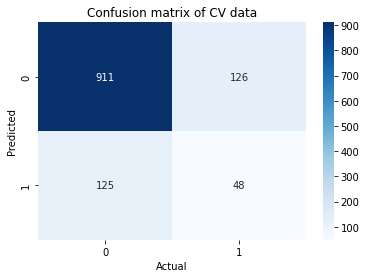

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  100
Important Features
Claim count 216
InscClaimAmtReimbursed_avg 56
only_fraud_physician_count 100
County_0 216
County_1 63
County_2 83
County_15 53
County_21 42
County_32 44
County_34 46
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



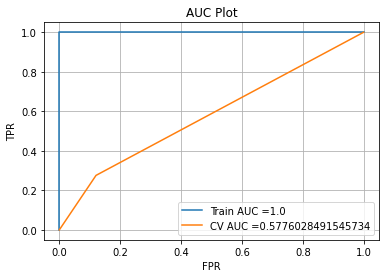

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


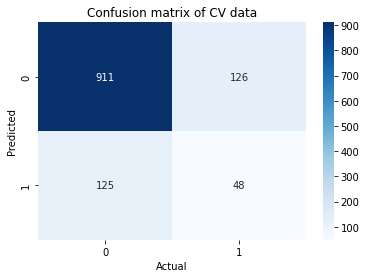

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  100
Important Features
Claim count 216
InscClaimAmtReimbursed_avg 56
only_fraud_physician_count 100
County_0 216
County_1 63
County_2 83
County_15 53
County_21 42
County_32 44
County_34 46
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



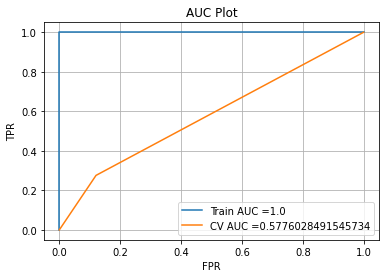

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


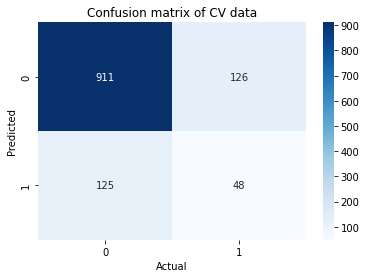

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  100
Important Features
Claim count 216
InscClaimAmtReimbursed_avg 56
only_fraud_physician_count 100
County_0 216
County_1 63
County_2 83
County_15 53
County_21 42
County_32 44
County_34 46
County_39 47
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



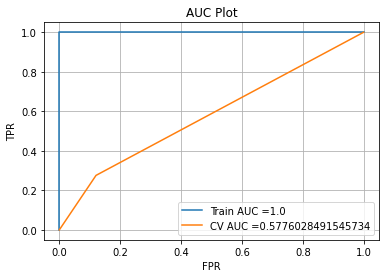

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


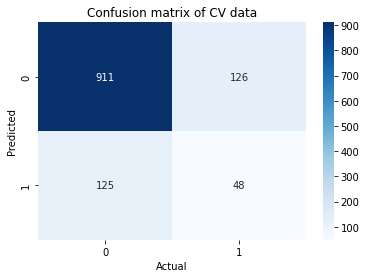

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  200
Important Features
Claim count 124
only_fraud_physician_count 138
County_0 242
County_1 69
County_2 83
County_15 57
County_32 46
County_34 57
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



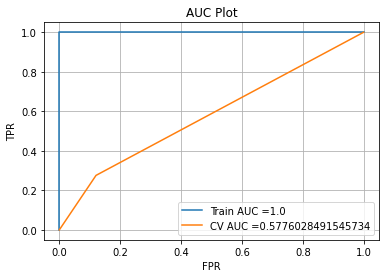

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


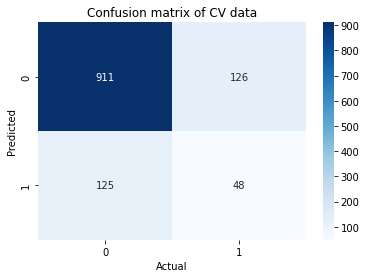

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  200
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 60
only_fraud_physician_count 138
County_0 258
County_1 77
County_2 87
County_15 59
County_21 45
County_32 46
County_34 58
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



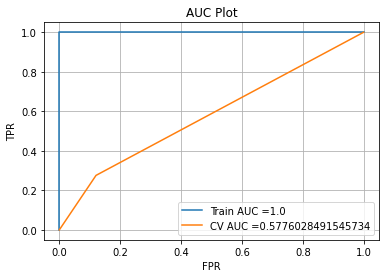

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


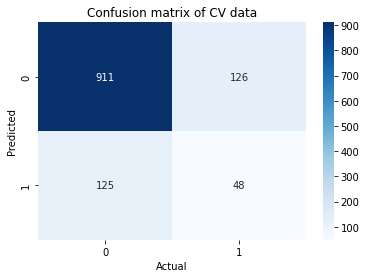

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  200
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 60
only_fraud_physician_count 138
County_0 258
County_1 77
County_2 87
County_15 59
County_21 45
County_32 46
County_34 58
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



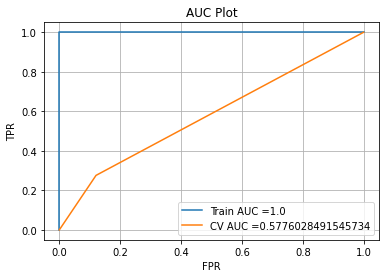

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


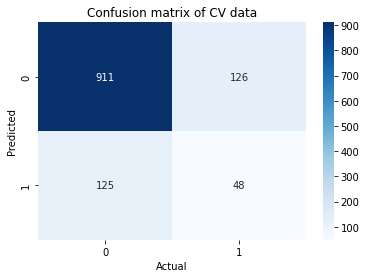

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  200
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 60
only_fraud_physician_count 138
County_0 258
County_1 77
County_2 87
County_15 59
County_21 45
County_32 46
County_34 58
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



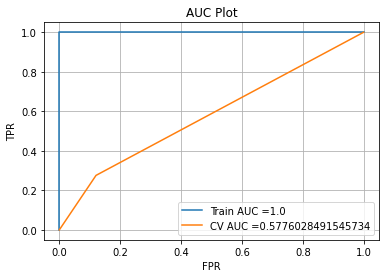

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


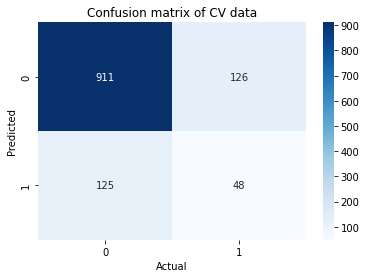

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  200
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 60
only_fraud_physician_count 138
County_0 258
County_1 77
County_2 87
County_15 59
County_21 45
County_32 46
County_34 58
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



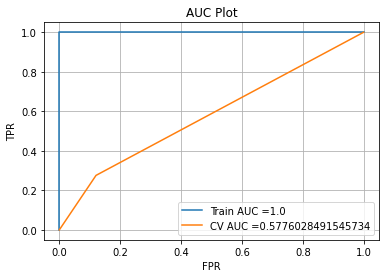

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


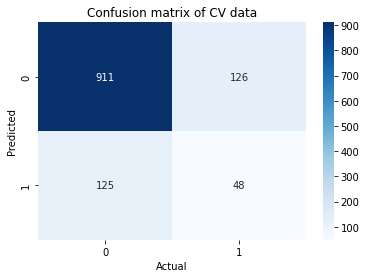

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  200
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 60
only_fraud_physician_count 138
County_0 258
County_1 77
County_2 87
County_15 59
County_21 45
County_32 46
County_34 58
County_39 48
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



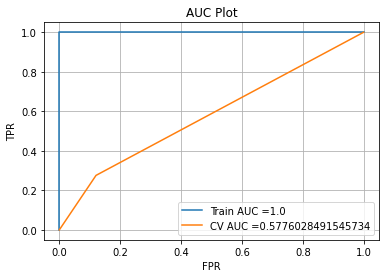

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


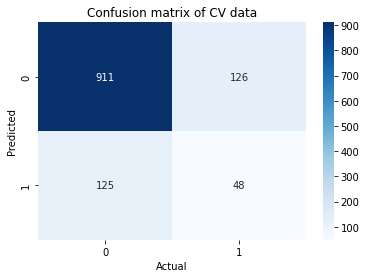

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  500
Important Features
Claim count 124
only_fraud_physician_count 138
County_0 267
County_1 69
County_2 83
County_15 58
County_32 48
County_34 57
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      5830



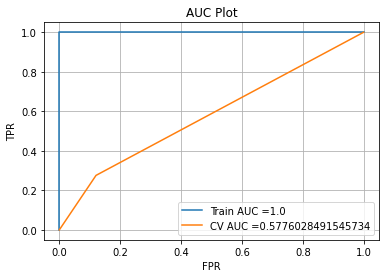

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


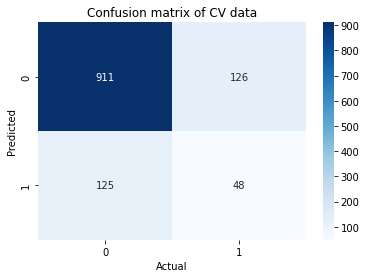

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  500
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 138
County_0 281
County_1 77
County_2 87
County_15 60
County_21 48
County_32 47
County_34 58
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      

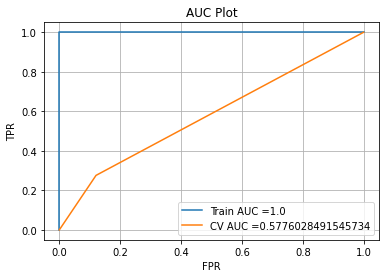

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


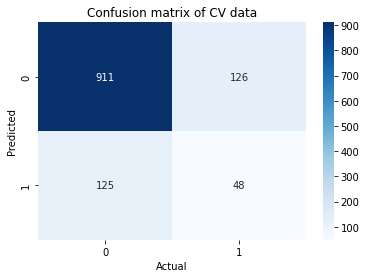

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  500
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 138
County_0 281
County_1 77
County_2 87
County_15 60
County_21 48
County_32 47
County_34 58
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00      

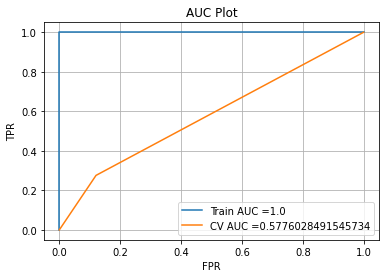

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


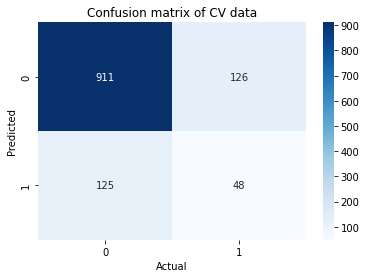

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  500
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 138
County_0 281
County_1 77
County_2 87
County_15 60
County_21 48
County_32 47
County_34 58
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00     

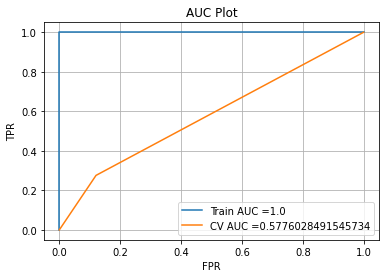

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


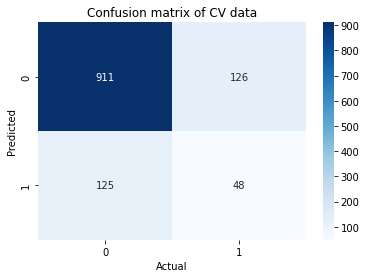

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  500
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 138
County_0 281
County_1 77
County_2 87
County_15 60
County_21 48
County_32 47
County_34 58
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00     

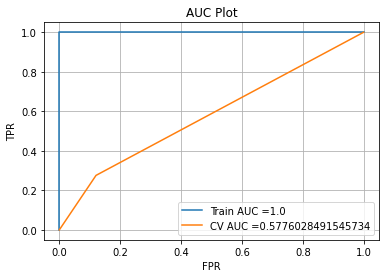

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


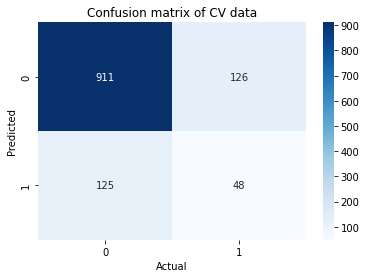

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  500
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 61
only_fraud_physician_count 138
County_0 281
County_1 77
County_2 87
County_15 60
County_21 48
County_32 47
County_34 58
County_39 49
ChronicCond_Osteoporasis_1 42
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg       1.00      1.00      1.00     

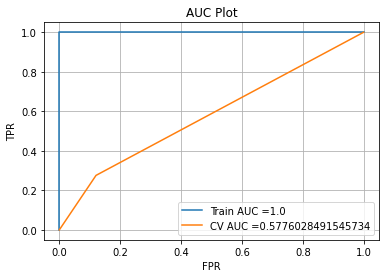

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


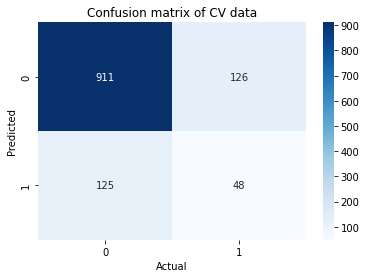

----------------------------------------------------------------------------------------
num_leaves:  10  N estimator:  1000
Important Features
Claim count 124
only_fraud_physician_count 138
Doctor 57
County_0 289
County_1 78
County_2 90
County_15 69
County_32 59
County_34 62
County_39 49
ChronicCond_Heartfailure_0 60
ChronicCond_KidneyDisease_0 116
ChronicCond_Osteoporasis_1 108
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      1.00      1.00      5830
weighted avg      

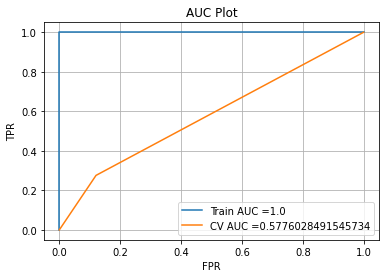

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


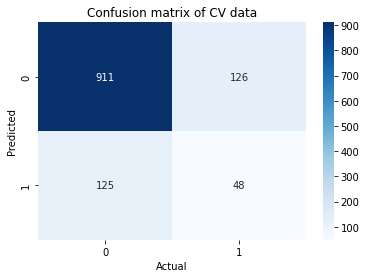

----------------------------------------------------------------------------------------
num_leaves:  50  N estimator:  1000
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 66
only_fraud_physician_count 138
Doctor 61
County_0 305
County_1 83
County_2 94
County_15 71
County_21 50
County_32 60
County_34 62
County_39 49
ChronicCond_Heartfailure_0 62
ChronicCond_KidneyDisease_0 115
ChronicCond_Osteoporasis_1 106
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      

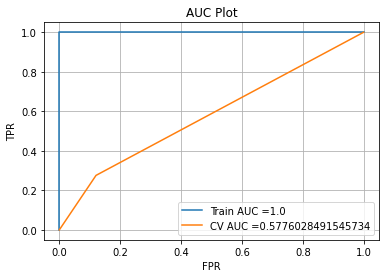

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


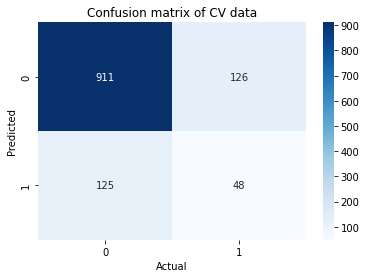

----------------------------------------------------------------------------------------
num_leaves:  70  N estimator:  1000
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 66
only_fraud_physician_count 138
Doctor 61
County_0 305
County_1 83
County_2 94
County_15 71
County_21 50
County_32 60
County_34 62
County_39 49
ChronicCond_Heartfailure_0 62
ChronicCond_KidneyDisease_0 115
ChronicCond_Osteoporasis_1 106
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00      

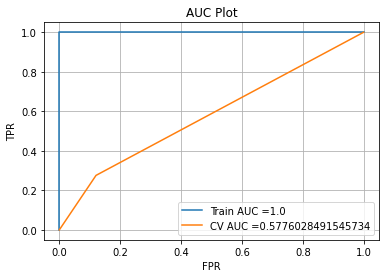

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


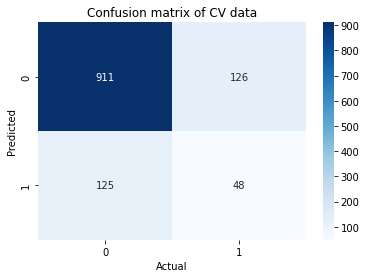

----------------------------------------------------------------------------------------
num_leaves:  100  N estimator:  1000
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 66
only_fraud_physician_count 138
Doctor 61
County_0 305
County_1 83
County_2 94
County_15 71
County_21 50
County_32 60
County_34 62
County_39 49
ChronicCond_Heartfailure_0 62
ChronicCond_KidneyDisease_0 115
ChronicCond_Osteoporasis_1 106
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00     

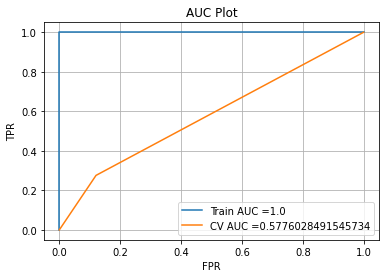

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


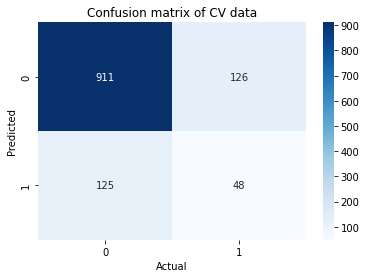

----------------------------------------------------------------------------------------
num_leaves:  120  N estimator:  1000
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 66
only_fraud_physician_count 138
Doctor 61
County_0 305
County_1 83
County_2 94
County_15 71
County_21 50
County_32 60
County_34 62
County_39 49
ChronicCond_Heartfailure_0 62
ChronicCond_KidneyDisease_0 115
ChronicCond_Osteoporasis_1 106
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00     

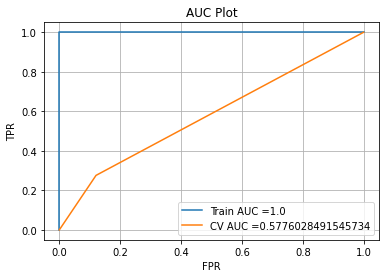

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


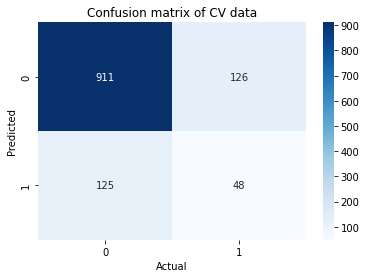

----------------------------------------------------------------------------------------
num_leaves:  150  N estimator:  1000
Important Features
Claim count 278
InscClaimAmtReimbursed_avg 66
only_fraud_physician_count 138
Doctor 61
County_0 305
County_1 83
County_2 94
County_15 71
County_21 50
County_32 60
County_34 62
County_39 49
ChronicCond_Heartfailure_0 62
ChronicCond_KidneyDisease_0 115
ChronicCond_Osteoporasis_1 106
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      1.00      1.00      1753

    accuracy                           1.00      5830
   macro avg       1.00     

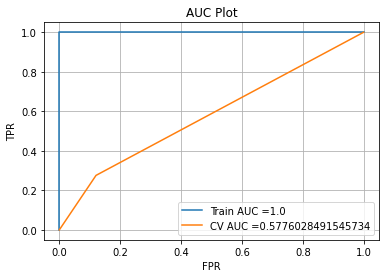

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


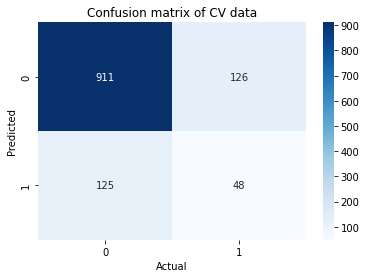

In [96]:
for n_est in [50,70,100,200,500,1000]:
    for num_leaves in [10,50,70,100,120,150]:
        clf = LGBMClassifier(num_leaves=num_leaves,n_estimators=n_est)
        clf.fit(X_outpatient_70_30,y_outpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("num_leaves: ", num_leaves, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_70_30.columns),clf.feature_importances_):
            if j > 40:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_70_30)
        print(classification_report(y_outpatient_70_30,y_train_pred))
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Random Forest</h2>

Original Distribution

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.10990163098489387
only_fraud_physician_count 0.2619199576062257
only_fraud_op_physician_count 0.27194460651082447
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.55      0.32      0.41       174

    accuracy                           0.86      1210
   macro avg       0.72      0.64      0.66      1210
weighted avg       0.84      0.86      0.85      1210



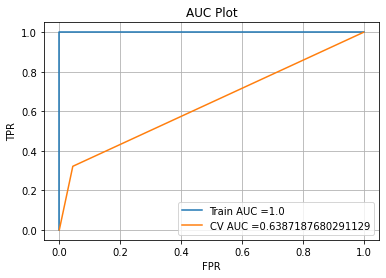

Cross Validation
FNR:0.6781609195402298 ,TPR:0.3218390804597701 ,FPR:0.0444015444015444 ,TNR:0.9555984555984556 


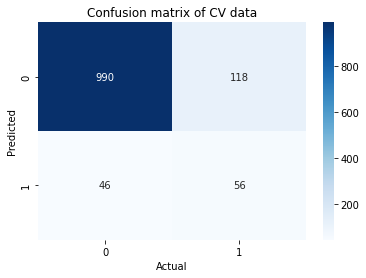

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.10210950602020691
only_fraud_physician_count 0.2671601310713638
only_fraud_op_physician_count 0.2393106969130334
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.56      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



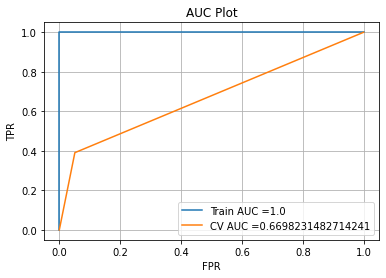

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.05115830115830116 ,TNR:0.9488416988416989 


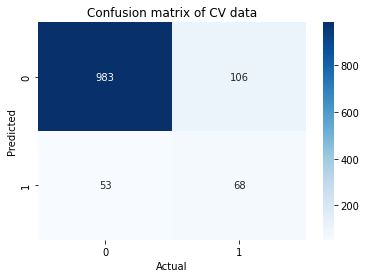

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.13856635008155826
only_fraud_physician_count 0.2691374546007509
only_fraud_op_physician_count 0.2138839549364767
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.55      0.40      0.47       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



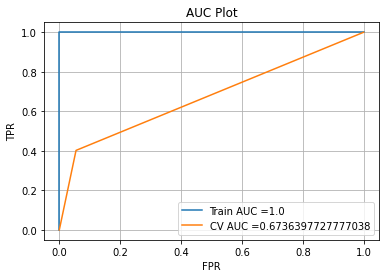

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.05501930501930502 ,TNR:0.944980694980695 


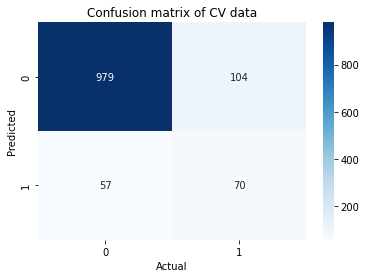

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.14758349580188634
only_fraud_physician_count 0.21213796035565038
only_fraud_op_physician_count 0.26658719496631356
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.57      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



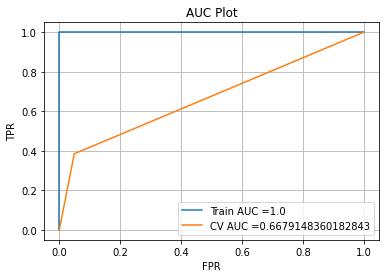

Cross Validation
FNR:0.6149425287356322 ,TPR:0.3850574712643678 ,FPR:0.04922779922779923 ,TNR:0.9507722007722008 


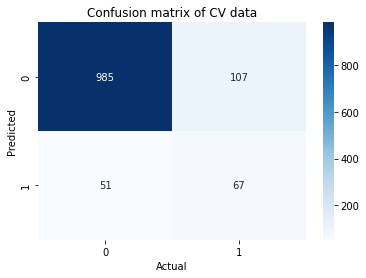

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.11994873588518952
only_fraud_physician_count 0.24149360147841561
only_fraud_op_physician_count 0.23166475477488818
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1036
           1       0.62      0.37      0.47       174

    accuracy                           0.88      1210
   macro avg       0.76      0.67      0.70      1210
weighted avg       0.86      0.88      0.86      1210



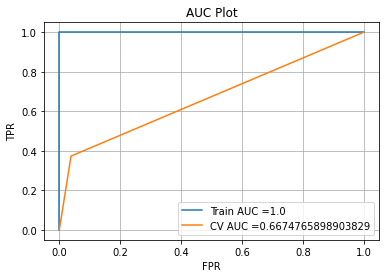

Cross Validation
FNR:0.6264367816091954 ,TPR:0.3735632183908046 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


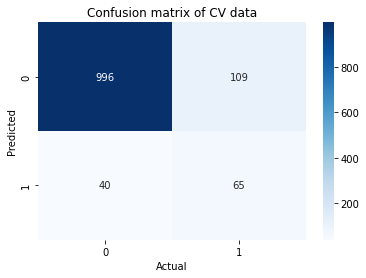

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.13194826613890565
only_fraud_physician_count 0.26529909162907966
only_fraud_op_physician_count 0.2851493391134319
              precision    recall  f1-score   support

           0       0.90      0.97      0.93      1036
           1       0.65      0.38      0.48       174

    accuracy                           0.88      1210
   macro avg       0.78      0.67      0.71      1210
weighted avg       0.87      0.88      0.87      1210



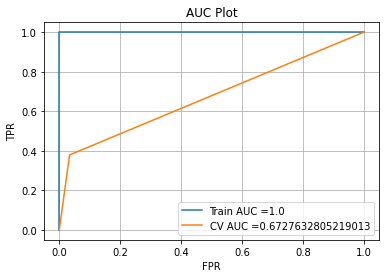

Cross Validation
FNR:0.6206896551724138 ,TPR:0.3793103448275862 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


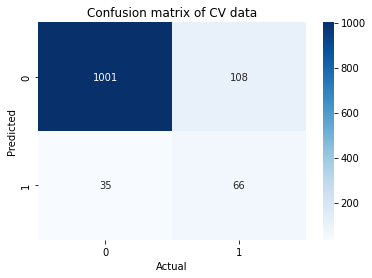

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.09476846501679223
only_fraud_physician_count 0.30692679570338866
only_fraud_op_physician_count 0.2062230253195182
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.56      0.38      0.45       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



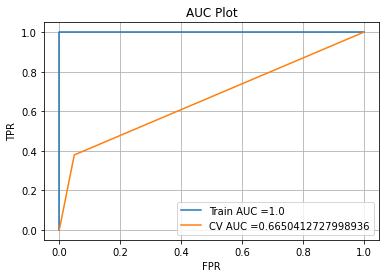

Cross Validation
FNR:0.6206896551724138 ,TPR:0.3793103448275862 ,FPR:0.04922779922779923 ,TNR:0.9507722007722008 


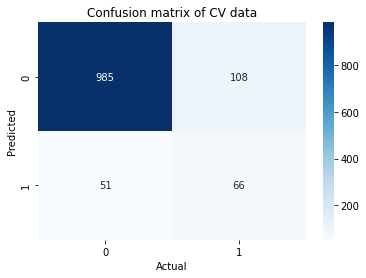

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.1193575759725079
only_fraud_physician_count 0.25548454575006513
only_fraud_op_physician_count 0.2480070325576936
              precision    recall  f1-score   support

           0       0.90      0.95      0.92      1036
           1       0.55      0.38      0.45       174

    accuracy                           0.87      1210
   macro avg       0.73      0.66      0.69      1210
weighted avg       0.85      0.87      0.86      1210



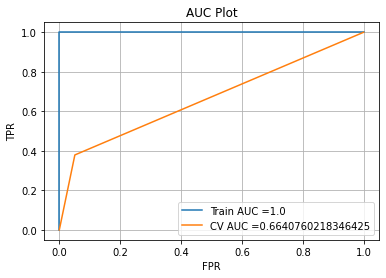

Cross Validation
FNR:0.6206896551724138 ,TPR:0.3793103448275862 ,FPR:0.05115830115830116 ,TNR:0.9488416988416989 


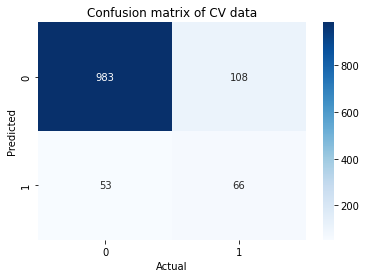

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.14261781816674174
only_fraud_physician_count 0.2778240974631427
only_fraud_op_physician_count 0.23410697625843785
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.52      0.40      0.45       174

    accuracy                           0.86      1210
   macro avg       0.71      0.67      0.69      1210
weighted avg       0.85      0.86      0.85      1210



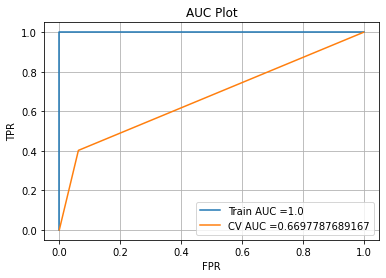

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.06274131274131274 ,TNR:0.9372586872586872 


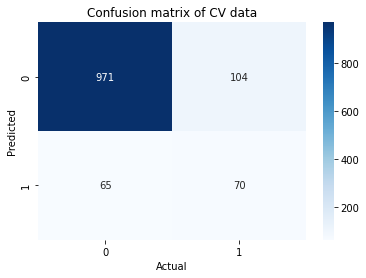

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.10325716213708469
only_fraud_physician_count 0.20867012939883717
only_fraud_op_physician_count 0.31796690938103644
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.63      0.32      0.42       174

    accuracy                           0.88      1210
   macro avg       0.76      0.64      0.68      1210
weighted avg       0.86      0.88      0.86      1210



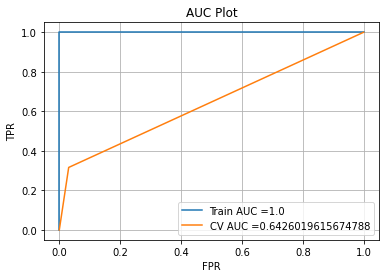

Cross Validation
FNR:0.6839080459770115 ,TPR:0.3160919540229885 ,FPR:0.03088803088803089 ,TNR:0.9691119691119691 


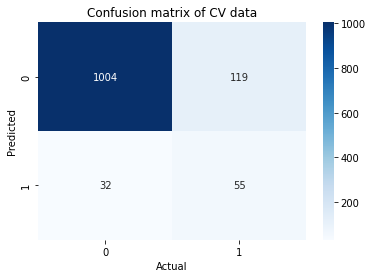

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.12016338538524153
only_fraud_physician_count 0.2619202367429429
only_fraud_op_physician_count 0.2593692860765585
              precision    recall  f1-score   support

           0       0.90      0.95      0.92      1036
           1       0.56      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



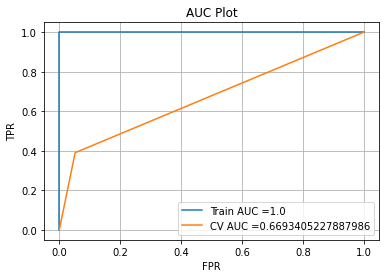

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.052123552123552123 ,TNR:0.9478764478764479 


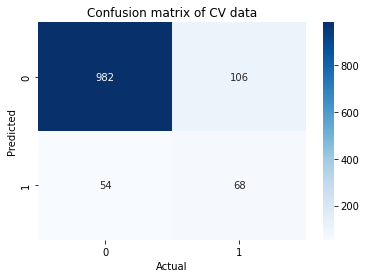

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.13119477486437497
only_fraud_physician_count 0.2443731644035675
only_fraud_op_physician_count 0.28099568828050336
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.56      0.40      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



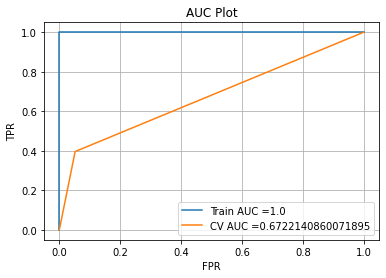

Cross Validation
FNR:0.603448275862069 ,TPR:0.39655172413793105 ,FPR:0.052123552123552123 ,TNR:0.9478764478764479 


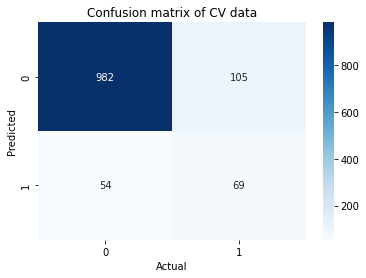

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.10317138588589547
only_fraud_physician_count 0.2711169293322293
only_fraud_op_physician_count 0.2682354638830957
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1036
           1       0.61      0.39      0.47       174

    accuracy                           0.88      1210
   macro avg       0.76      0.67      0.70      1210
weighted avg       0.86      0.88      0.86      1210



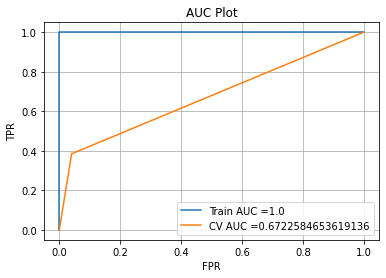

Cross Validation
FNR:0.6149425287356322 ,TPR:0.3850574712643678 ,FPR:0.04054054054054054 ,TNR:0.9594594594594594 


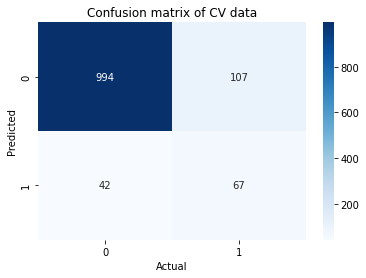

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.11393677020673898
only_fraud_physician_count 0.23044975616748725
only_fraud_op_physician_count 0.27309294683200425
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1036
           1       0.62      0.39      0.48       174

    accuracy                           0.88      1210
   macro avg       0.76      0.67      0.70      1210
weighted avg       0.86      0.88      0.87      1210



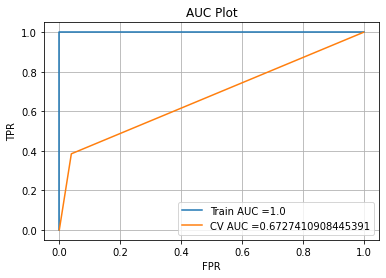

Cross Validation
FNR:0.6149425287356322 ,TPR:0.3850574712643678 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


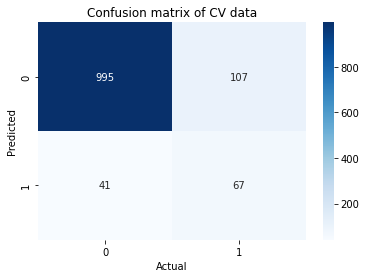

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.10782547860254031
only_fraud_physician_count 0.25923089711984276
only_fraud_op_physician_count 0.2643398583978092
              precision    recall  f1-score   support

           0       0.90      0.97      0.93      1036
           1       0.67      0.39      0.49       174

    accuracy                           0.88      1210
   macro avg       0.79      0.68      0.71      1210
weighted avg       0.87      0.88      0.87      1210



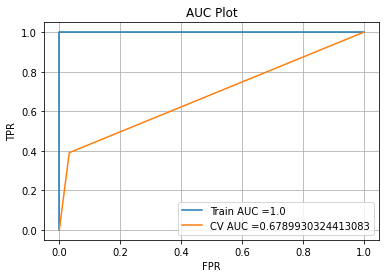

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.032818532818532815 ,TNR:0.9671814671814671 


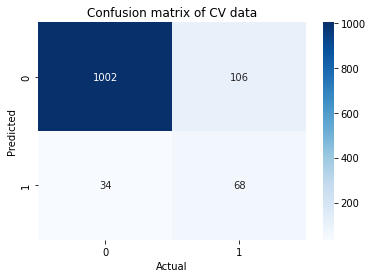

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.11415351921243178
only_fraud_physician_count 0.26309155470928774
only_fraud_op_physician_count 0.24724912892943732
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.57      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



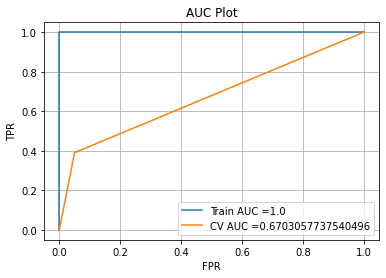

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.05019305019305019 ,TNR:0.9498069498069498 


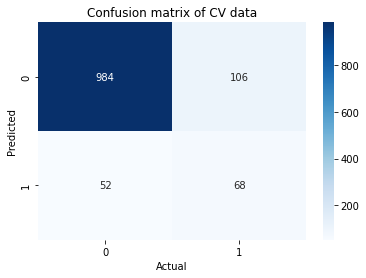

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.10862292831026328
only_fraud_physician_count 0.2793536586792294
only_fraud_op_physician_count 0.2643794769770937
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.54      0.40      0.46       174

    accuracy                           0.87      1210
   macro avg       0.72      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



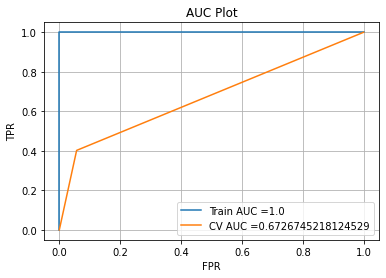

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.05694980694980695 ,TNR:0.943050193050193 


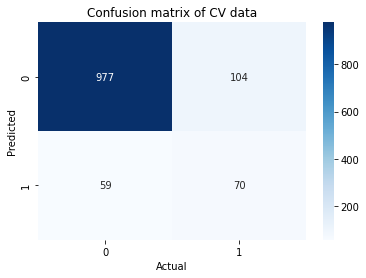

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.1045501914595611
only_fraud_physician_count 0.28068706165306917
only_fraud_op_physician_count 0.24789029626388817
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.55      0.40      0.47       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



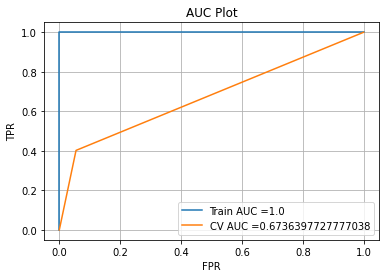

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.05501930501930502 ,TNR:0.944980694980695 


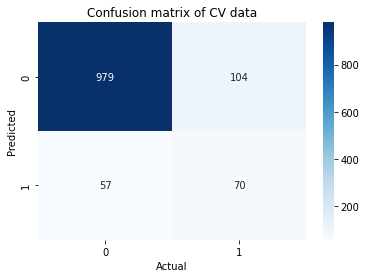

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.10018544762833899
only_fraud_physician_count 0.2700622158385701
only_fraud_op_physician_count 0.2556117486825998
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.57      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



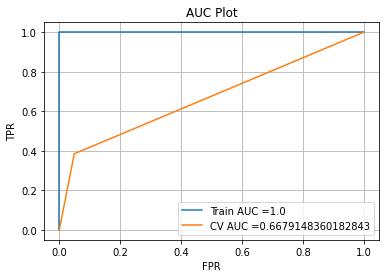

Cross Validation
FNR:0.6149425287356322 ,TPR:0.3850574712643678 ,FPR:0.04922779922779923 ,TNR:0.9507722007722008 


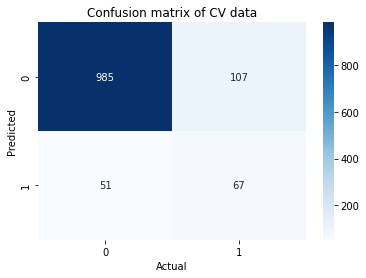

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.11448095117675358
only_fraud_physician_count 0.25602156968830686
only_fraud_op_physician_count 0.26281378837016145
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1036
           1       0.54      0.33      0.41       174

    accuracy                           0.86      1210
   macro avg       0.72      0.64      0.66      1210
weighted avg       0.84      0.86      0.85      1210



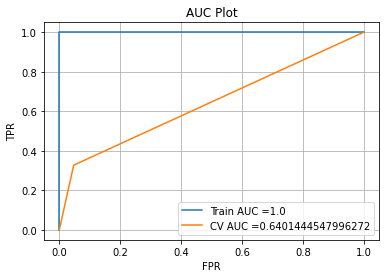

Cross Validation
FNR:0.6724137931034483 ,TPR:0.3275862068965517 ,FPR:0.0472972972972973 ,TNR:0.9527027027027027 


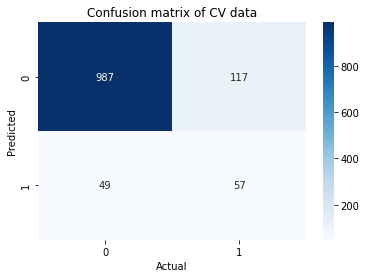

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.12877367259520253
only_fraud_physician_count 0.25812248158047435
only_fraud_op_physician_count 0.252808016601332
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.55      0.40      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



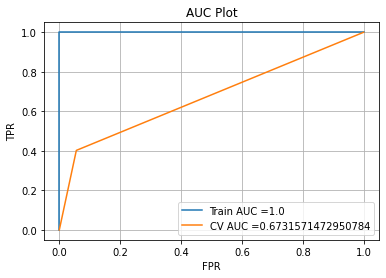

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.055984555984555984 ,TNR:0.944015444015444 


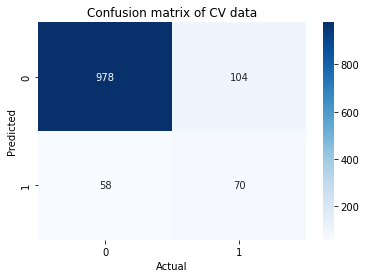

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.11602326268886783
only_fraud_physician_count 0.2670725746088538
only_fraud_op_physician_count 0.24562979429247506
              precision    recall  f1-score   support

           0       0.90      0.95      0.92      1036
           1       0.56      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



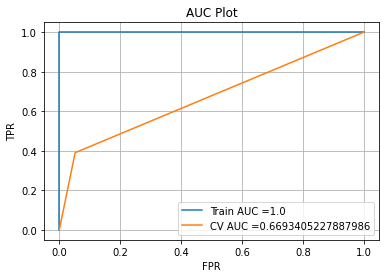

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.052123552123552123 ,TNR:0.9478764478764479 


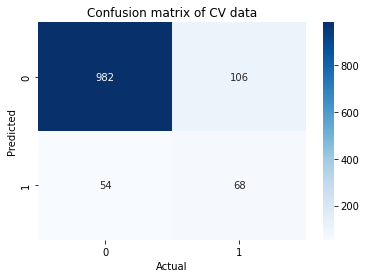

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.11745145941883128
only_fraud_physician_count 0.2676056515250645
only_fraud_op_physician_count 0.24662421430343792
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.55      0.40      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



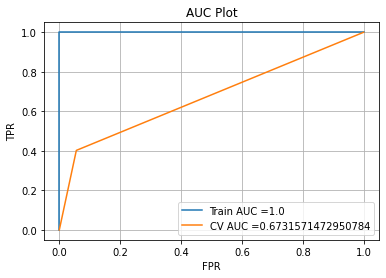

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.055984555984555984 ,TNR:0.944015444015444 


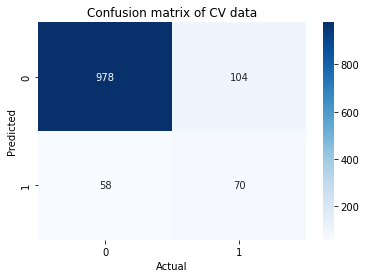

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.11745465070546048
only_fraud_physician_count 0.25517189501155346
only_fraud_op_physician_count 0.25869439460982474
              precision    recall  f1-score   support

           0       0.90      0.95      0.92      1036
           1       0.56      0.39      0.46       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.69      1210
weighted avg       0.85      0.87      0.86      1210



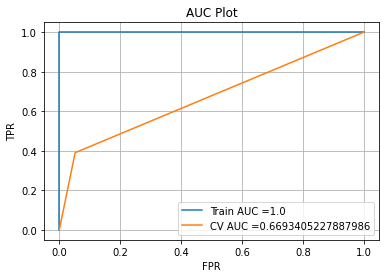

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.052123552123552123 ,TNR:0.9478764478764479 


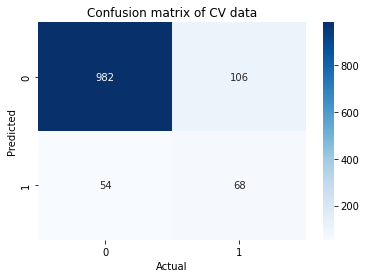

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.1275366782153603
only_fraud_physician_count 0.2735020915260282
only_fraud_op_physician_count 0.24195370194385163
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.53      0.40      0.46       174

    accuracy                           0.86      1210
   macro avg       0.72      0.67      0.69      1210
weighted avg       0.85      0.86      0.85      1210



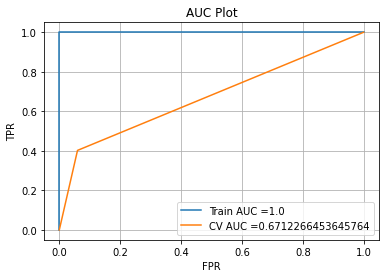

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.059845559845559844 ,TNR:0.9401544401544402 


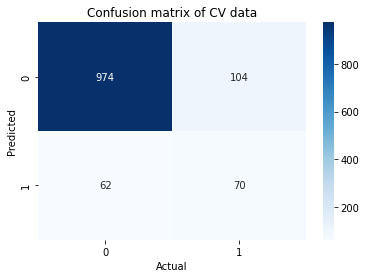

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.12201262496453033
only_fraud_physician_count 0.28193168404755564
only_fraud_op_physician_count 0.23529205542002593
              precision    recall  f1-score   support

           0       0.90      0.95      0.92      1036
           1       0.56      0.40      0.47       174

    accuracy                           0.87      1210
   macro avg       0.73      0.67      0.70      1210
weighted avg       0.85      0.87      0.86      1210



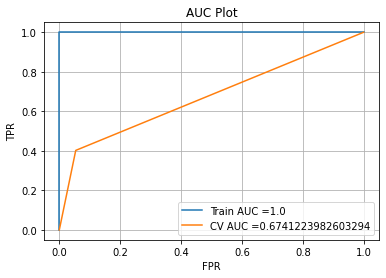

Cross Validation
FNR:0.5977011494252874 ,TPR:0.40229885057471265 ,FPR:0.05405405405405406 ,TNR:0.9459459459459459 


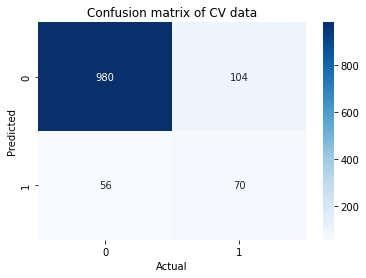

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.11523212499053559
only_fraud_physician_count 0.2734804418502996
only_fraud_op_physician_count 0.2510077398798512
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.54      0.39      0.45       174

    accuracy                           0.86      1210
   macro avg       0.72      0.67      0.69      1210
weighted avg       0.85      0.86      0.86      1210



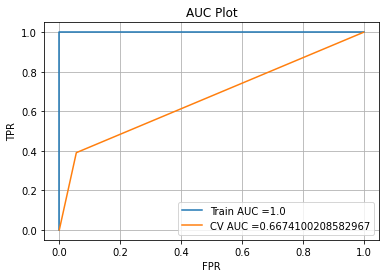

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.055984555984555984 ,TNR:0.944015444015444 


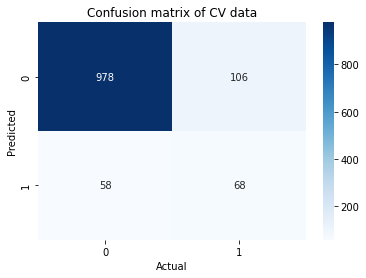

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.11551820470464613
only_fraud_physician_count 0.27233023489281394
only_fraud_op_physician_count 0.2477225054741813
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1036
           1       0.59      0.39      0.47       174

    accuracy                           0.87      1210
   macro avg       0.75      0.67      0.70      1210
weighted avg       0.86      0.87      0.86      1210



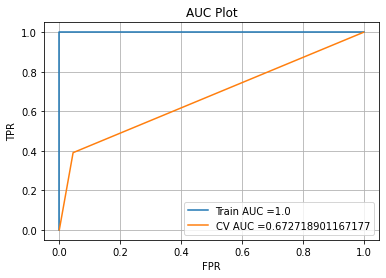

Cross Validation
FNR:0.6091954022988506 ,TPR:0.39080459770114945 ,FPR:0.045366795366795366 ,TNR:0.9546332046332047 


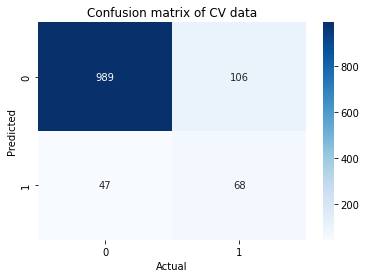

In [97]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_train_outpatient,y_train_outpatient.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_outpatient.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_train_outpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.11357580825008631
only_fraud_physician_count 0.2439085908827758
only_fraud_op_physician_count 0.24882089440600758
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.54      0.25      0.35       174

    accuracy                           0.86      1210
   macro avg       0.71      0.61      0.63      1210
weighted avg       0.84      0.86      0.84      1210



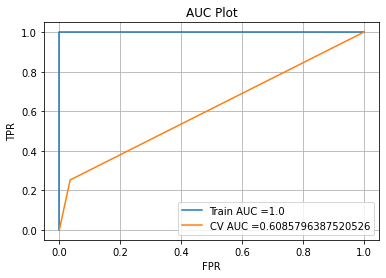

Cross Validation
FNR:0.7471264367816092 ,TPR:0.25287356321839083 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


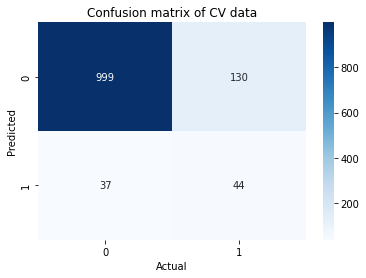

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.09664206360055053
only_fraud_physician_count 0.2740148019811717
only_fraud_op_physician_count 0.2585635799616584
              precision    recall  f1-score   support

           0       0.86      0.97      0.92      1036
           1       0.37      0.09      0.14       174

    accuracy                           0.85      1210
   macro avg       0.61      0.53      0.53      1210
weighted avg       0.79      0.85      0.80      1210



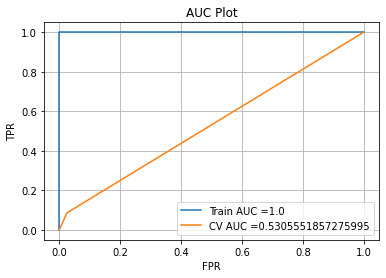

Cross Validation
FNR:0.9137931034482759 ,TPR:0.08620689655172414 ,FPR:0.025096525096525095 ,TNR:0.974903474903475 


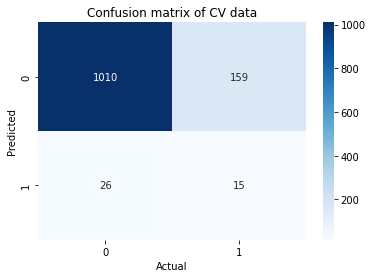

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.10901277079457904
only_fraud_physician_count 0.25894133539772146
only_fraud_op_physician_count 0.2555819731377011
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.36      0.11      0.17       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.54      1210
weighted avg       0.79      0.84      0.81      1210



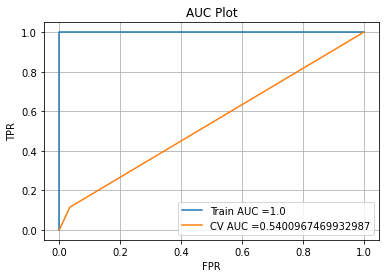

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


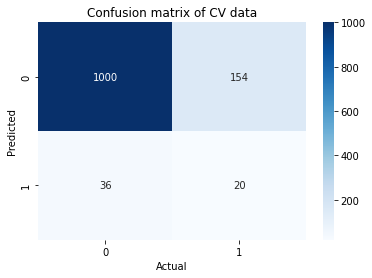

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.09563004031037163
only_fraud_physician_count 0.22493946151065042
only_fraud_op_physician_count 0.3077019472574585
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.37      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.62      0.55      0.55      1210
weighted avg       0.80      0.84      0.81      1210



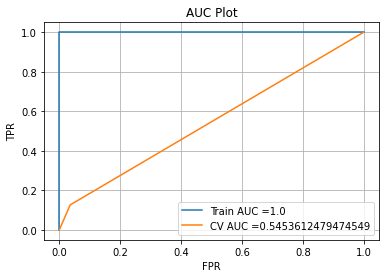

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


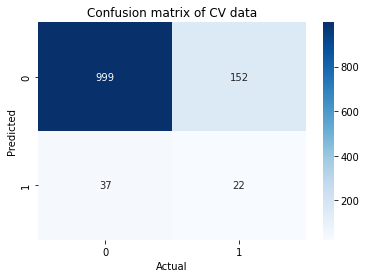

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.09885053883290609
only_fraud_physician_count 0.22125035755564007
only_fraud_op_physician_count 0.2616576441776291
              precision    recall  f1-score   support

           0       0.88      0.98      0.93      1036
           1       0.62      0.23      0.33       174

    accuracy                           0.87      1210
   macro avg       0.75      0.60      0.63      1210
weighted avg       0.84      0.87      0.84      1210



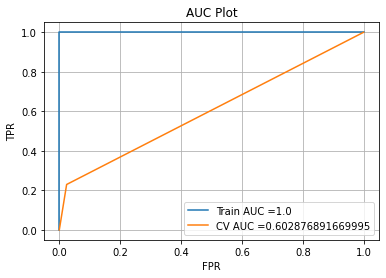

Cross Validation
FNR:0.7701149425287356 ,TPR:0.22988505747126436 ,FPR:0.02413127413127413 ,TNR:0.9758687258687259 


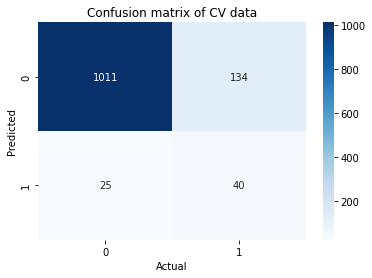

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.10022014518664034
only_fraud_physician_count 0.28257375042578414
only_fraud_op_physician_count 0.2073468819330599
              precision    recall  f1-score   support

           0       0.87      0.98      0.92      1036
           1       0.42      0.10      0.16       174

    accuracy                           0.85      1210
   macro avg       0.65      0.54      0.54      1210
weighted avg       0.80      0.85      0.81      1210



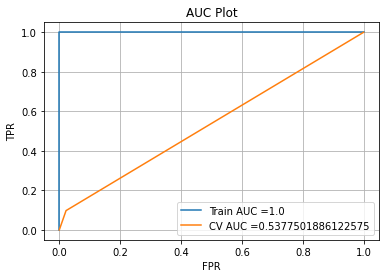

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.0222007722007722 ,TNR:0.9777992277992278 


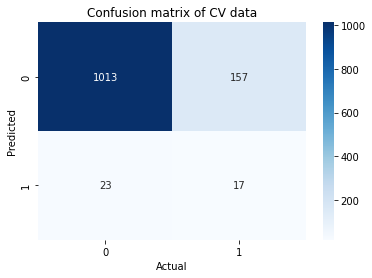

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.10064527031413932
only_fraud_physician_count 0.2962552072941727
only_fraud_op_physician_count 0.26331225104531497
              precision    recall  f1-score   support

           0       0.87      0.94      0.90      1036
           1       0.28      0.13      0.18       174

    accuracy                           0.83      1210
   macro avg       0.57      0.54      0.54      1210
weighted avg       0.78      0.83      0.80      1210



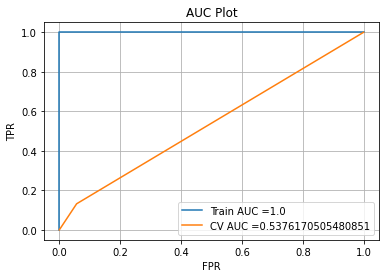

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.05694980694980695 ,TNR:0.943050193050193 


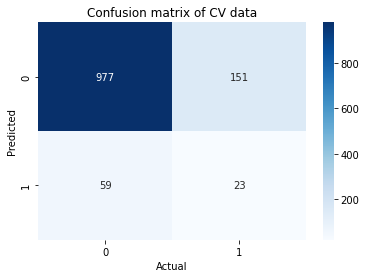

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.10088178205144756
only_fraud_physician_count 0.25702260449454084
only_fraud_op_physician_count 0.2555109866801339
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.47      0.16      0.23       174

    accuracy                           0.85      1210
   macro avg       0.67      0.56      0.58      1210
weighted avg       0.81      0.85      0.82      1210



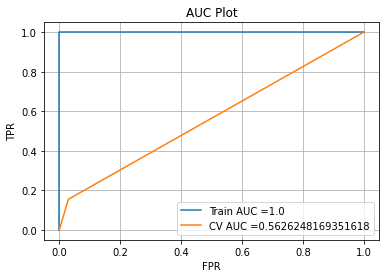

Cross Validation
FNR:0.8448275862068966 ,TPR:0.15517241379310345 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


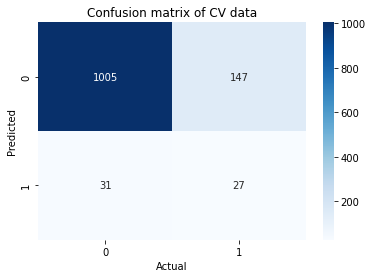

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.09901664928519716
only_fraud_physician_count 0.2545487356840407
only_fraud_op_physician_count 0.26178907164733317
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.41      0.11      0.17       174

    accuracy                           0.85      1210
   macro avg       0.64      0.54      0.55      1210
weighted avg       0.80      0.85      0.81      1210



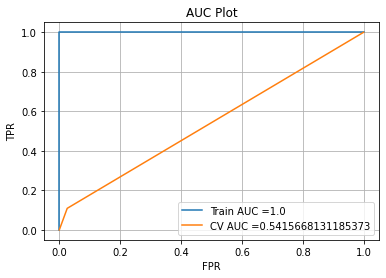

Cross Validation
FNR:0.8908045977011494 ,TPR:0.10919540229885058 ,FPR:0.026061776061776062 ,TNR:0.9739382239382239 


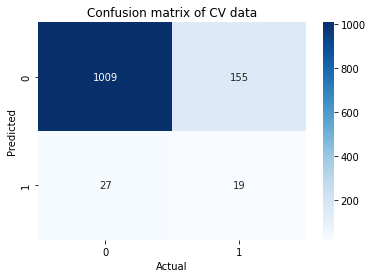

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.08706932562018954
only_fraud_physician_count 0.27294646739160683
only_fraud_op_physician_count 0.24567345195395496
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.40      0.10      0.16       174

    accuracy                           0.85      1210
   macro avg       0.63      0.54      0.54      1210
weighted avg       0.80      0.85      0.81      1210



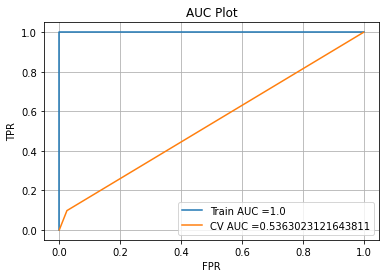

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.025096525096525095 ,TNR:0.974903474903475 


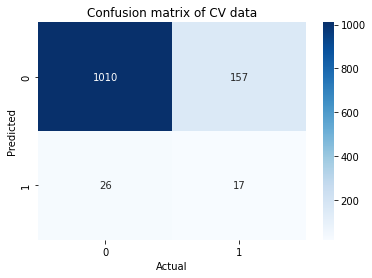

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.09931787740411396
only_fraud_physician_count 0.26892391203587435
only_fraud_op_physician_count 0.2467343037257011
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      1036
           1       0.56      0.21      0.30       174

    accuracy                           0.86      1210
   macro avg       0.72      0.59      0.61      1210
weighted avg       0.83      0.86      0.83      1210



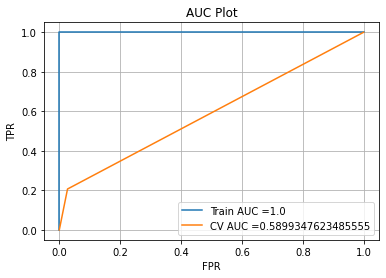

Cross Validation
FNR:0.7931034482758621 ,TPR:0.20689655172413793 ,FPR:0.02702702702702703 ,TNR:0.972972972972973 


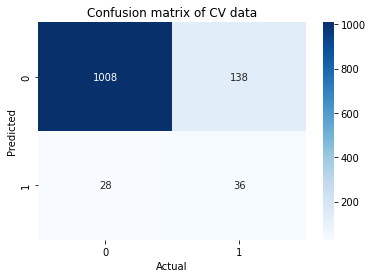

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.10772105481838673
only_fraud_physician_count 0.2818038232394516
only_fraud_op_physician_count 0.23219235587884218
              precision    recall  f1-score   support

           0       0.89      0.94      0.91      1036
           1       0.45      0.28      0.34       174

    accuracy                           0.85      1210
   macro avg       0.67      0.61      0.63      1210
weighted avg       0.82      0.85      0.83      1210



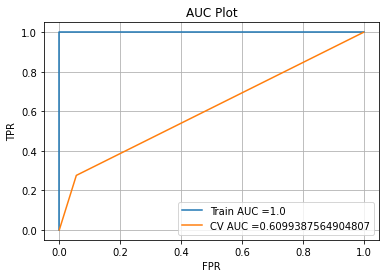

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.055984555984555984 ,TNR:0.944015444015444 


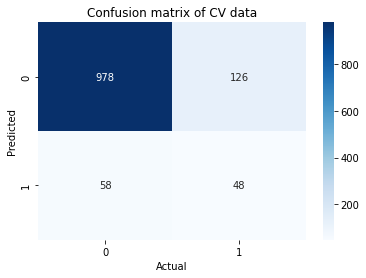

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.11725805013956839
only_fraud_physician_count 0.2569462039637048
only_fraud_op_physician_count 0.24515167876480132
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.59      0.28      0.37       174

    accuracy                           0.87      1210
   macro avg       0.74      0.62      0.65      1210
weighted avg       0.84      0.87      0.85      1210



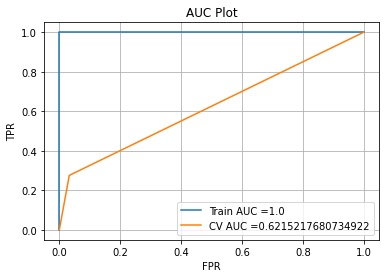

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.032818532818532815 ,TNR:0.9671814671814671 


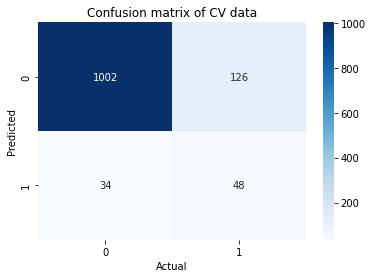

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.10221239393723769
only_fraud_physician_count 0.2519984695346606
only_fraud_op_physician_count 0.24455987473632707
              precision    recall  f1-score   support

           0       0.86      0.98      0.92      1036
           1       0.42      0.09      0.14       174

    accuracy                           0.85      1210
   macro avg       0.64      0.53      0.53      1210
weighted avg       0.80      0.85      0.81      1210



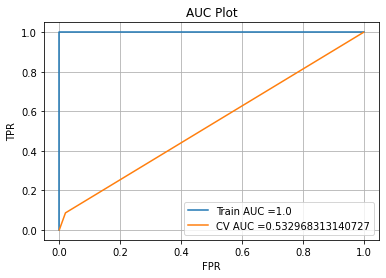

Cross Validation
FNR:0.9137931034482759 ,TPR:0.08620689655172414 ,FPR:0.02027027027027027 ,TNR:0.9797297297297297 


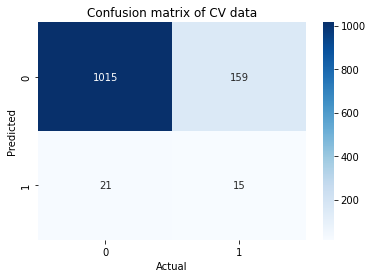

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.11998843668204491
only_fraud_physician_count 0.2595170622111554
only_fraud_op_physician_count 0.24040459260157243
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.40      0.12      0.19       174

    accuracy                           0.85      1210
   macro avg       0.64      0.55      0.55      1210
weighted avg       0.80      0.85      0.81      1210



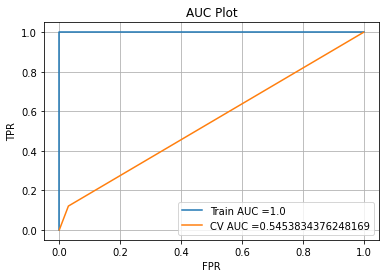

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


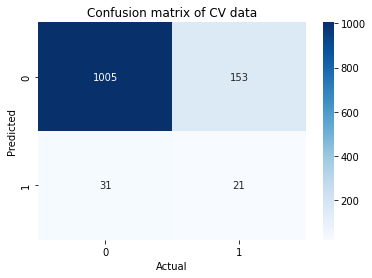

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.10674742642409499
only_fraud_physician_count 0.25088589781084836
only_fraud_op_physician_count 0.2634830855347699
              precision    recall  f1-score   support

           0       0.87      0.98      0.92      1036
           1       0.43      0.11      0.17       174

    accuracy                           0.85      1210
   macro avg       0.65      0.54      0.55      1210
weighted avg       0.80      0.85      0.81      1210



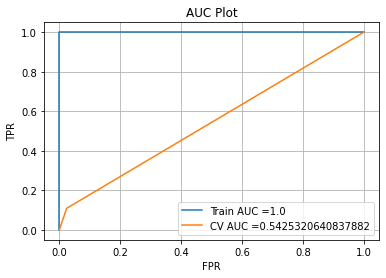

Cross Validation
FNR:0.8908045977011494 ,TPR:0.10919540229885058 ,FPR:0.02413127413127413 ,TNR:0.9758687258687259 


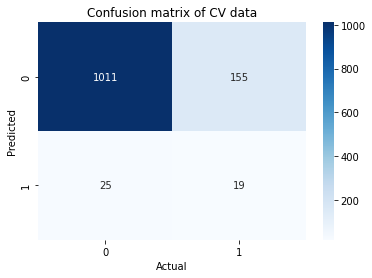

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.11526973680607439
only_fraud_physician_count 0.2594930566924527
only_fraud_op_physician_count 0.2562510376045025
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.35      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



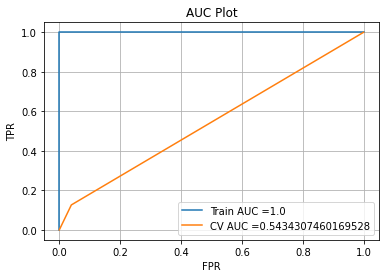

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


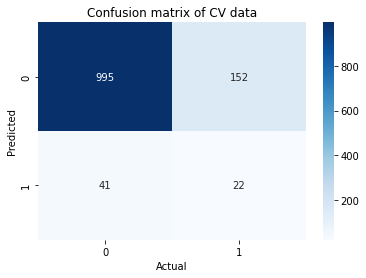

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.12639211587843
only_fraud_physician_count 0.2550567575848755
only_fraud_op_physician_count 0.24385506492416806
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1036
           1       0.46      0.27      0.34       174

    accuracy                           0.85      1210
   macro avg       0.67      0.61      0.63      1210
weighted avg       0.82      0.85      0.83      1210



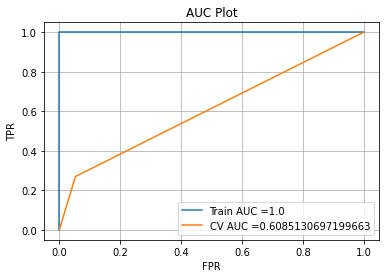

Cross Validation
FNR:0.7298850574712644 ,TPR:0.27011494252873564 ,FPR:0.05308880308880309 ,TNR:0.946911196911197 


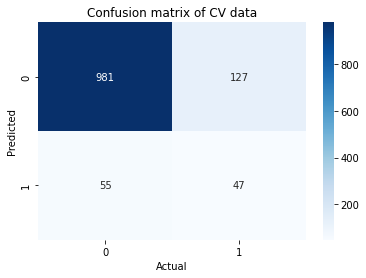

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.09858091291649332
only_fraud_physician_count 0.26245608159817063
only_fraud_op_physician_count 0.24905011952435963
              precision    recall  f1-score   support

           0       0.86      0.97      0.91      1036
           1       0.35      0.10      0.15       174

    accuracy                           0.84      1210
   macro avg       0.61      0.53      0.53      1210
weighted avg       0.79      0.84      0.80      1210



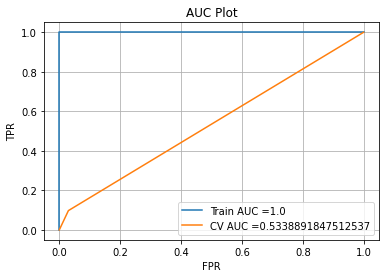

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


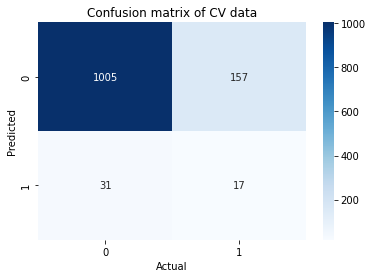

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.09948880891965727
only_fraud_physician_count 0.27624272984912807
only_fraud_op_physician_count 0.23663180127394118
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      1036
           1       0.56      0.22      0.31       174

    accuracy                           0.86      1210
   macro avg       0.72      0.59      0.62      1210
weighted avg       0.83      0.86      0.84      1210



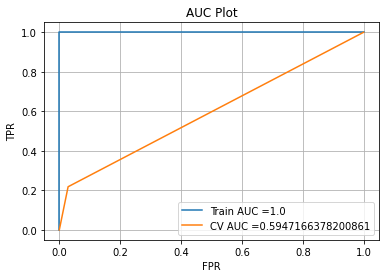

Cross Validation
FNR:0.7816091954022989 ,TPR:0.21839080459770116 ,FPR:0.02895752895752896 ,TNR:0.971042471042471 


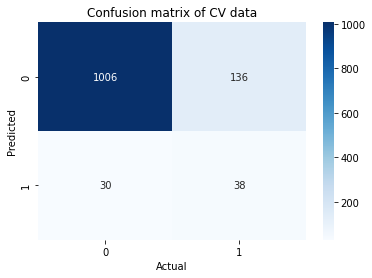

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.10295730257647118
only_fraud_physician_count 0.2610906193045761
only_fraud_op_physician_count 0.2639426665107533
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.38      0.11      0.18       174

    accuracy                           0.85      1210
   macro avg       0.63      0.54      0.55      1210
weighted avg       0.80      0.85      0.81      1210



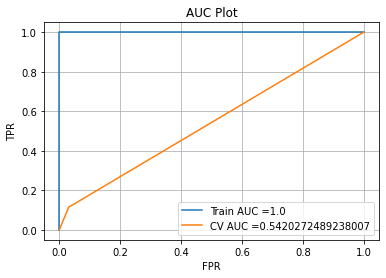

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.03088803088803089 ,TNR:0.9691119691119691 


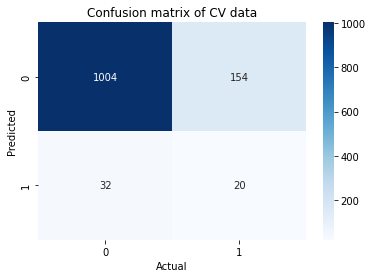

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.10269923348298526
only_fraud_physician_count 0.25689463037211313
only_fraud_op_physician_count 0.24559091116372256
              precision    recall  f1-score   support

           0       0.88      0.97      0.93      1036
           1       0.59      0.23      0.33       174

    accuracy                           0.87      1210
   macro avg       0.74      0.60      0.63      1210
weighted avg       0.84      0.87      0.84      1210



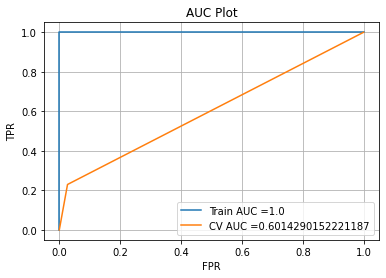

Cross Validation
FNR:0.7701149425287356 ,TPR:0.22988505747126436 ,FPR:0.02702702702702703 ,TNR:0.972972972972973 


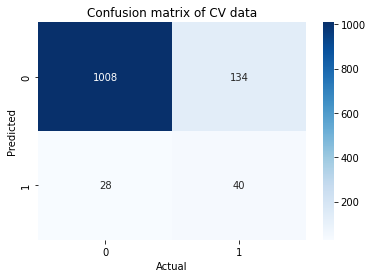

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.10402392860058525
only_fraud_physician_count 0.26024616122722827
only_fraud_op_physician_count 0.2536766498484424
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.36      0.11      0.17       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.54      1210
weighted avg       0.79      0.84      0.81      1210



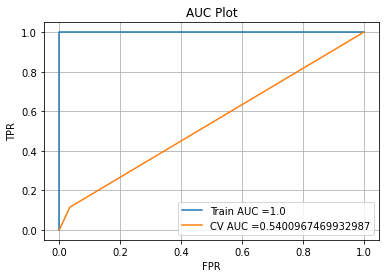

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


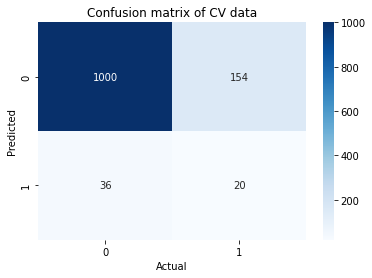

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.1018432923048111
only_fraud_physician_count 0.2644369275708617
only_fraud_op_physician_count 0.2585277001698984
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.40      0.12      0.19       174

    accuracy                           0.85      1210
   macro avg       0.64      0.55      0.55      1210
weighted avg       0.80      0.85      0.81      1210



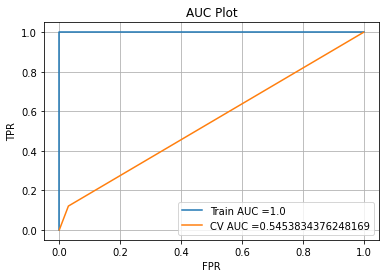

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


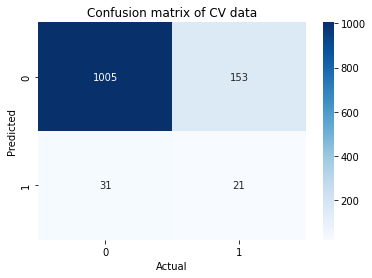

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.11074082843751608
only_fraud_physician_count 0.2648404424570309
only_fraud_op_physician_count 0.241023723087754
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.33      0.12      0.18       174

    accuracy                           0.84      1210
   macro avg       0.60      0.54      0.54      1210
weighted avg       0.79      0.84      0.81      1210



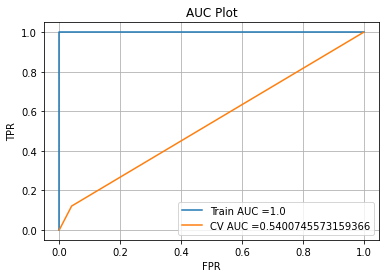

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.04054054054054054 ,TNR:0.9594594594594594 


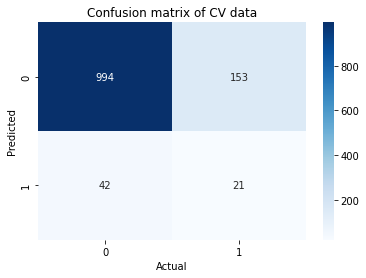

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.11033227885596959
only_fraud_physician_count 0.26724225191955175
only_fraud_op_physician_count 0.23921393449758255
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.37      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.62      0.55      0.55      1210
weighted avg       0.80      0.84      0.81      1210



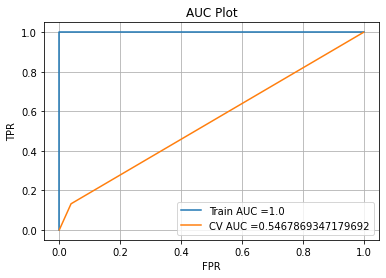

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


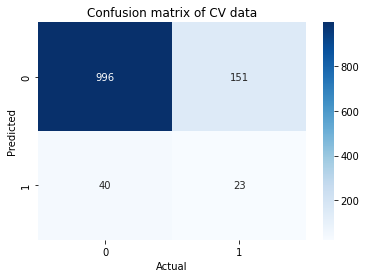

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.10624284839827022
only_fraud_physician_count 0.27706720539674046
only_fraud_op_physician_count 0.24321903334832082
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.36      0.12      0.18       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



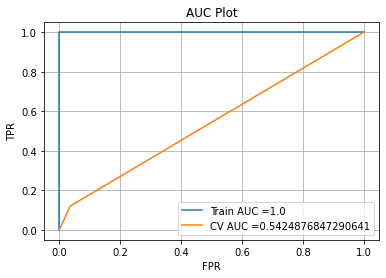

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


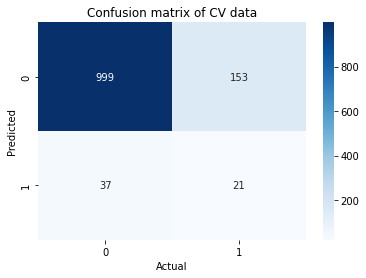

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.1099846951107517
only_fraud_physician_count 0.2719061221371219
only_fraud_op_physician_count 0.24557832928903145
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.35      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.61      0.55      0.55      1210
weighted avg       0.79      0.84      0.81      1210



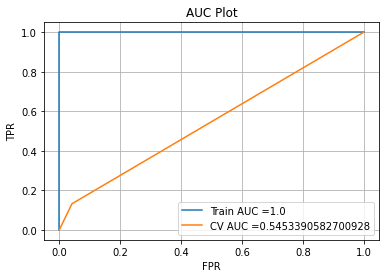

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.041505791505791506 ,TNR:0.9584942084942085 


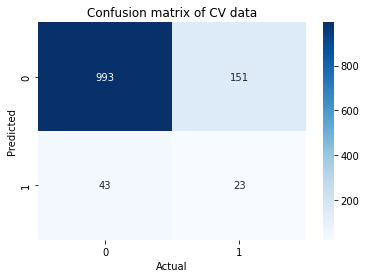

In [98]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_50_50,y_outpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.08946673041993464
only_fraud_physician_count 0.2387286882366576
only_fraud_op_physician_count 0.2715025886433268
              precision    recall  f1-score   support

           0       0.88      0.98      0.92      1036
           1       0.57      0.17      0.26       174

    accuracy                           0.86      1210
   macro avg       0.72      0.58      0.59      1210
weighted avg       0.83      0.86      0.83      1210



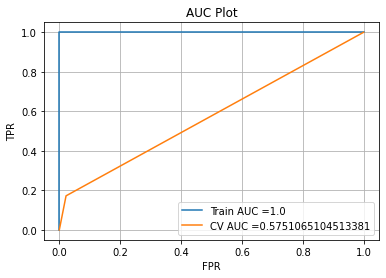

Cross Validation
FNR:0.8275862068965517 ,TPR:0.1724137931034483 ,FPR:0.0222007722007722 ,TNR:0.9777992277992278 


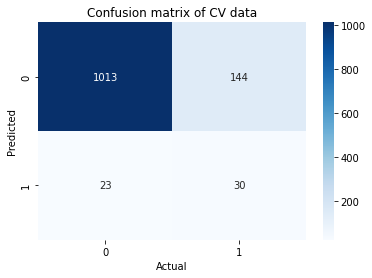

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.13637095952120212
only_fraud_physician_count 0.25721916755908697
only_fraud_op_physician_count 0.1960643289879287
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.38      0.13      0.20       174

    accuracy                           0.84      1210
   macro avg       0.63      0.55      0.56      1210
weighted avg       0.80      0.84      0.81      1210



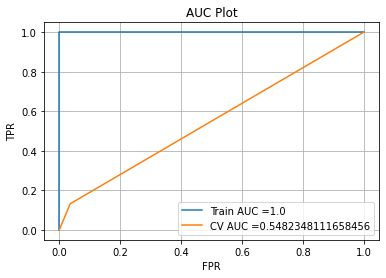

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


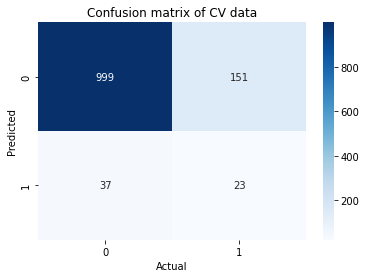

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.08872443883901844
only_fraud_physician_count 0.2578345771583224
only_fraud_op_physician_count 0.2561200125587036
              precision    recall  f1-score   support

           0       0.87      0.98      0.92      1036
           1       0.40      0.10      0.16       174

    accuracy                           0.85      1210
   macro avg       0.64      0.54      0.54      1210
weighted avg       0.80      0.85      0.81      1210



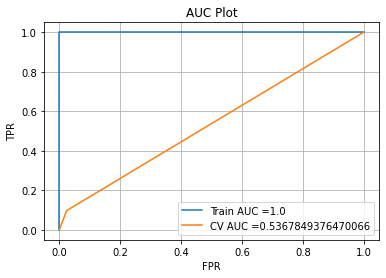

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.02413127413127413 ,TNR:0.9758687258687259 


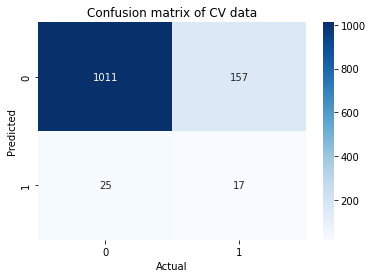

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.13368731020594565
only_fraud_physician_count 0.19901158025518575
only_fraud_op_physician_count 0.256288626430072
              precision    recall  f1-score   support

           0       0.88      0.97      0.93      1036
           1       0.59      0.22      0.32       174

    accuracy                           0.87      1210
   macro avg       0.74      0.60      0.63      1210
weighted avg       0.84      0.87      0.84      1210



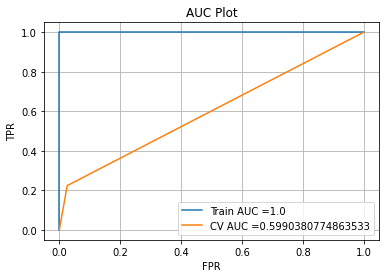

Cross Validation
FNR:0.7758620689655172 ,TPR:0.22413793103448276 ,FPR:0.026061776061776062 ,TNR:0.9739382239382239 


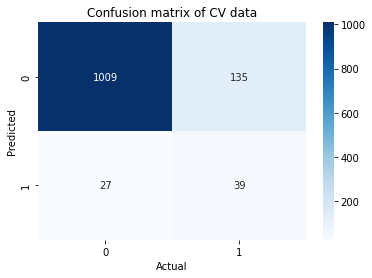

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.11022467489384877
only_fraud_physician_count 0.24873465325162594
only_fraud_op_physician_count 0.2506117189181034
              precision    recall  f1-score   support

           0       0.86      0.96      0.91      1036
           1       0.31      0.10      0.15       174

    accuracy                           0.84      1210
   macro avg       0.59      0.53      0.53      1210
weighted avg       0.79      0.84      0.80      1210



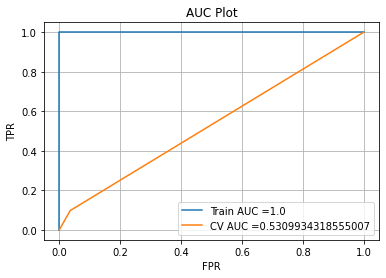

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


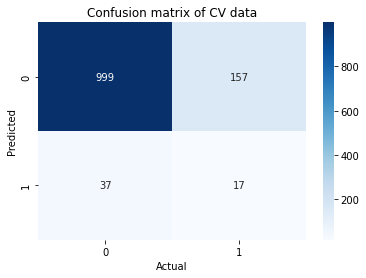

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.10238445551183818
only_fraud_physician_count 0.26053844497739903
only_fraud_op_physician_count 0.2543287878034754
              precision    recall  f1-score   support

           0       0.86      0.97      0.91      1036
           1       0.35      0.10      0.15       174

    accuracy                           0.84      1210
   macro avg       0.61      0.53      0.53      1210
weighted avg       0.79      0.84      0.80      1210



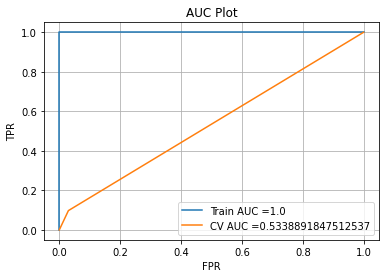

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


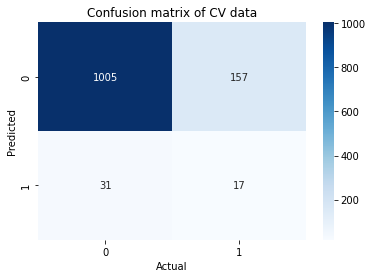

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.11254921729933107
only_fraud_physician_count 0.24548900269122803
only_fraud_op_physician_count 0.28608727995693817
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.38      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.62      0.55      0.55      1210
weighted avg       0.80      0.84      0.81      1210



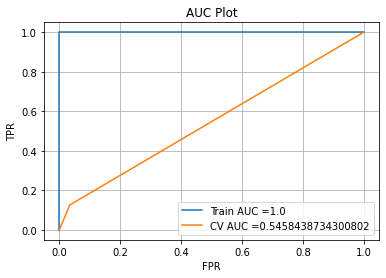

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


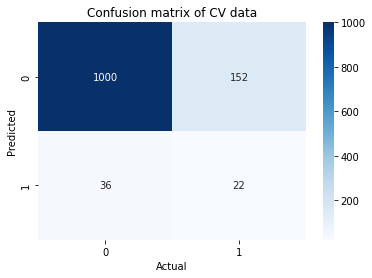

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.12348501918542146
only_fraud_physician_count 0.22110127374837435
only_fraud_op_physician_count 0.26624894727379295
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.59      0.25      0.35       174

    accuracy                           0.87      1210
   macro avg       0.74      0.61      0.64      1210
weighted avg       0.84      0.87      0.84      1210



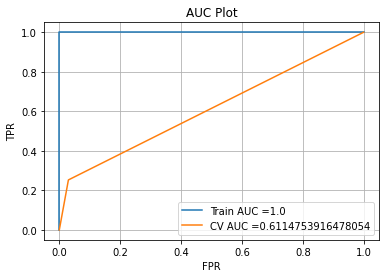

Cross Validation
FNR:0.7471264367816092 ,TPR:0.25287356321839083 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


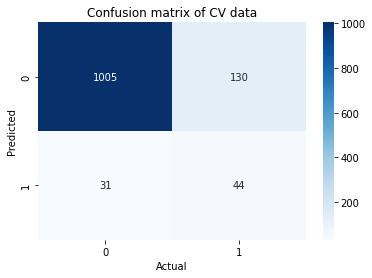

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.10281669599580046
only_fraud_physician_count 0.28823005578885225
only_fraud_op_physician_count 0.22951748911456357
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.35      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



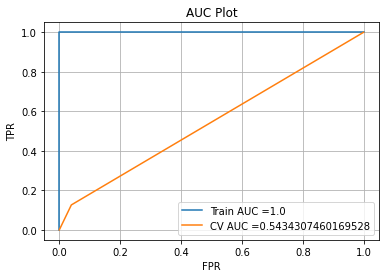

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


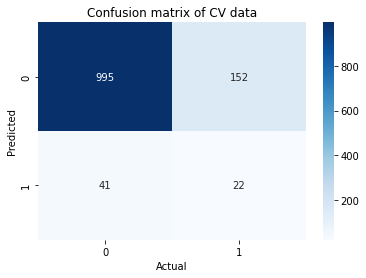

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.11107612379417096
only_fraud_physician_count 0.2687304262138643
only_fraud_op_physician_count 0.24901165458448113
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.34      0.12      0.18       174

    accuracy                           0.84      1210
   macro avg       0.60      0.54      0.54      1210
weighted avg       0.79      0.84      0.81      1210



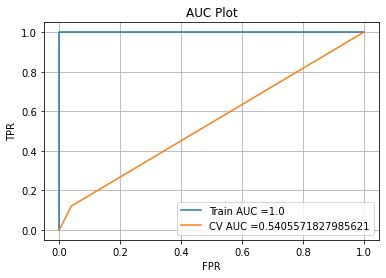

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


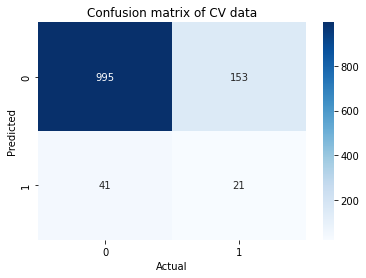

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.10571868103358205
only_fraud_physician_count 0.2702315940479988
only_fraud_op_physician_count 0.25884499754356466
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.39      0.15      0.22       174

    accuracy                           0.84      1210
   macro avg       0.63      0.56      0.57      1210
weighted avg       0.80      0.84      0.81      1210



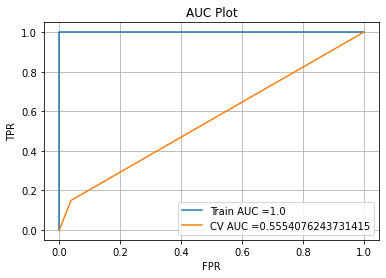

Cross Validation
FNR:0.8505747126436781 ,TPR:0.14942528735632185 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


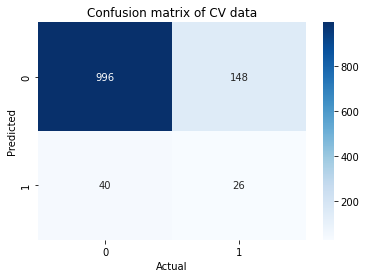

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.1123869936583874
only_fraud_physician_count 0.2922778422159655
only_fraud_op_physician_count 0.22093479656398632
              precision    recall  f1-score   support

           0       0.87      0.95      0.91      1036
           1       0.32      0.14      0.20       174

    accuracy                           0.83      1210
   macro avg       0.59      0.55      0.55      1210
weighted avg       0.79      0.83      0.80      1210



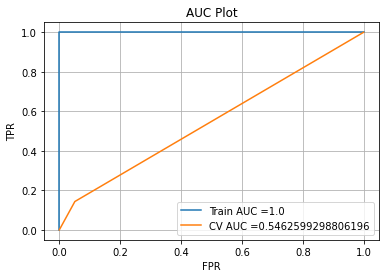

Cross Validation
FNR:0.8563218390804598 ,TPR:0.14367816091954022 ,FPR:0.05115830115830116 ,TNR:0.9488416988416989 


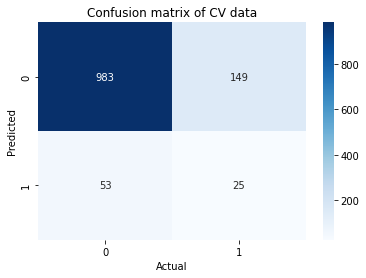

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.12310091512058467
only_fraud_physician_count 0.27328017704888363
only_fraud_op_physician_count 0.2288483953096873
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.32      0.13      0.18       174

    accuracy                           0.84      1210
   macro avg       0.60      0.54      0.55      1210
weighted avg       0.79      0.84      0.80      1210



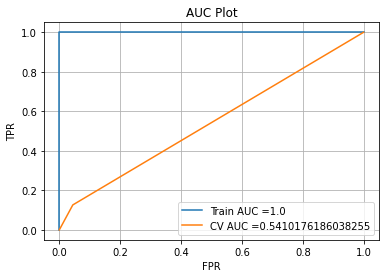

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.0444015444015444 ,TNR:0.9555984555984556 


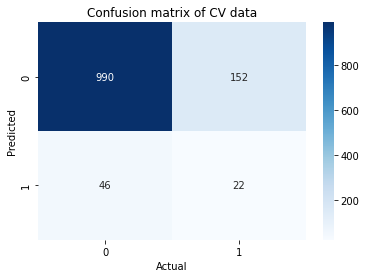

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.1291371649917411
only_fraud_physician_count 0.2652926074434576
only_fraud_op_physician_count 0.23547246257999702
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.45      0.20      0.27       174

    accuracy                           0.85      1210
   macro avg       0.66      0.58      0.59      1210
weighted avg       0.81      0.85      0.82      1210



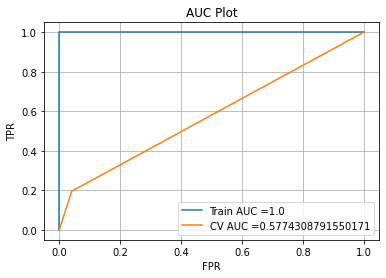

Cross Validation
FNR:0.8045977011494253 ,TPR:0.19540229885057472 ,FPR:0.04054054054054054 ,TNR:0.9594594594594594 


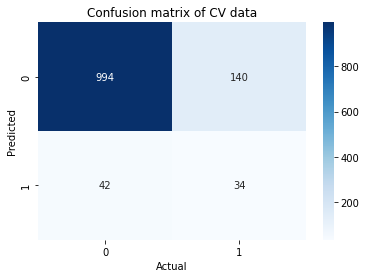

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.09352185765620845
only_fraud_physician_count 0.26505917450925526
only_fraud_op_physician_count 0.25761983031981667
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.36      0.11      0.17       174

    accuracy                           0.84      1210
   macro avg       0.62      0.54      0.54      1210
weighted avg       0.79      0.84      0.81      1210



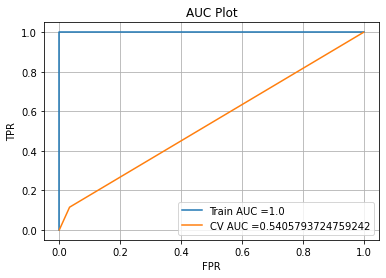

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


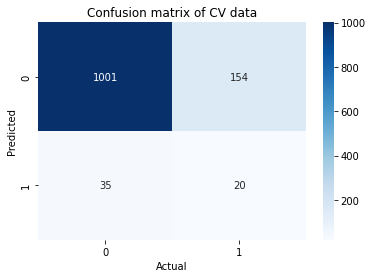

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.09467109311743527
only_fraud_physician_count 0.26932860371657236
only_fraud_op_physician_count 0.24522723152910975
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.39      0.11      0.17       174

    accuracy                           0.85      1210
   macro avg       0.63      0.54      0.54      1210
weighted avg       0.80      0.85      0.81      1210



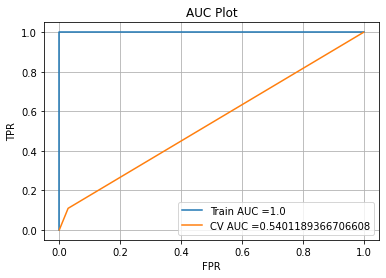

Cross Validation
FNR:0.8908045977011494 ,TPR:0.10919540229885058 ,FPR:0.02895752895752896 ,TNR:0.971042471042471 


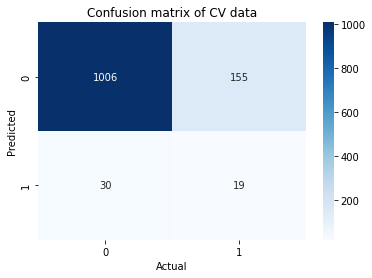

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.12301036511529043
only_fraud_physician_count 0.23437054540761545
only_fraud_op_physician_count 0.27063520010646075
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.58      0.26      0.36       174

    accuracy                           0.87      1210
   macro avg       0.73      0.62      0.64      1210
weighted avg       0.84      0.87      0.84      1210



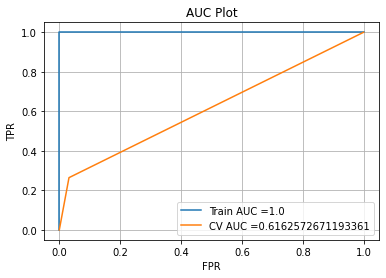

Cross Validation
FNR:0.735632183908046 ,TPR:0.26436781609195403 ,FPR:0.03185328185328185 ,TNR:0.9681467181467182 


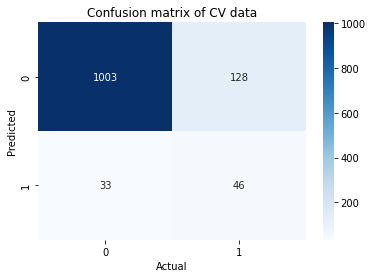

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.11876213272865417
only_fraud_physician_count 0.24637791672427797
only_fraud_op_physician_count 0.25322224119820935
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.40      0.17      0.24       174

    accuracy                           0.84      1210
   macro avg       0.64      0.56      0.57      1210
weighted avg       0.81      0.84      0.82      1210



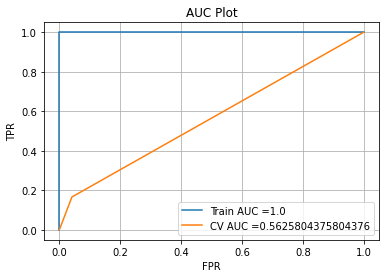

Cross Validation
FNR:0.8333333333333334 ,TPR:0.16666666666666666 ,FPR:0.041505791505791506 ,TNR:0.9584942084942085 


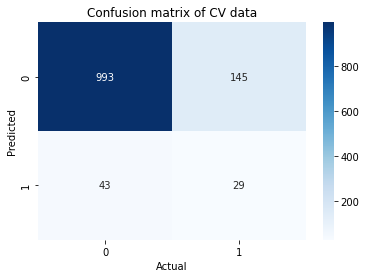

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.10360702690925228
only_fraud_physician_count 0.23771169001083828
only_fraud_op_physician_count 0.25801250317344804
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      1036
           1       0.51      0.20      0.29       174

    accuracy                           0.86      1210
   macro avg       0.70      0.58      0.61      1210
weighted avg       0.83      0.86      0.83      1210



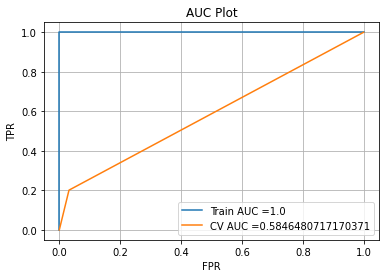

Cross Validation
FNR:0.7988505747126436 ,TPR:0.20114942528735633 ,FPR:0.03185328185328185 ,TNR:0.9681467181467182 


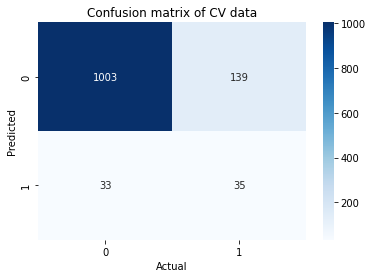

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.10919911426574468
only_fraud_physician_count 0.2647592331184218
only_fraud_op_physician_count 0.24221745540494627
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.54      0.26      0.35       174

    accuracy                           0.86      1210
   macro avg       0.71      0.61      0.64      1210
weighted avg       0.84      0.86      0.84      1210



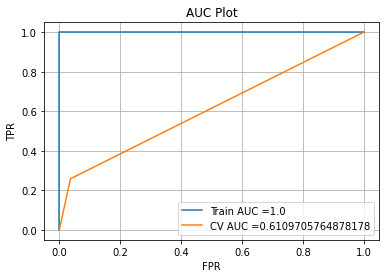

Cross Validation
FNR:0.7413793103448276 ,TPR:0.25862068965517243 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


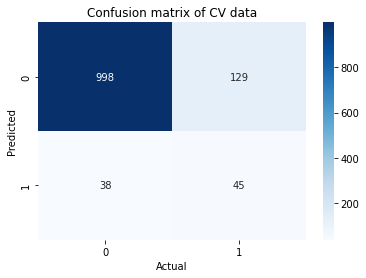

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.10960419081324638
only_fraud_physician_count 0.29085916932728445
only_fraud_op_physician_count 0.24165894803684115
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.33      0.13      0.18       174

    accuracy                           0.84      1210
   macro avg       0.60      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



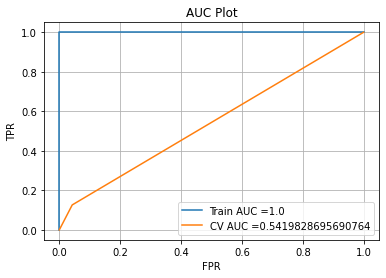

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


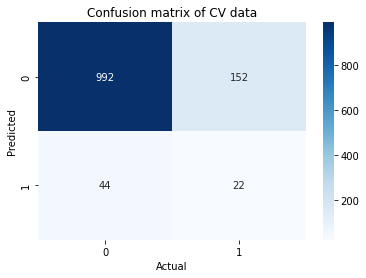

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.10492137720568437
only_fraud_physician_count 0.2617322841506872
only_fraud_op_physician_count 0.2569060359910048
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.51      0.24      0.32       174

    accuracy                           0.86      1210
   macro avg       0.70      0.60      0.62      1210
weighted avg       0.83      0.86      0.83      1210



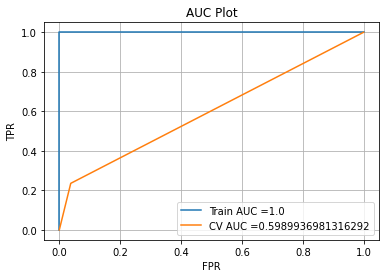

Cross Validation
FNR:0.764367816091954 ,TPR:0.23563218390804597 ,FPR:0.037644787644787646 ,TNR:0.9623552123552124 


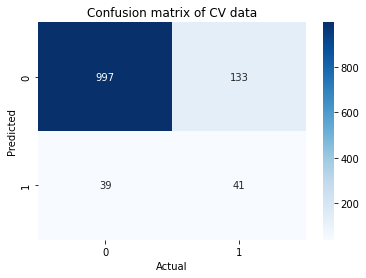

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.10629148416043736
only_fraud_physician_count 0.2575596471679568
only_fraud_op_physician_count 0.24357724380719267
              precision    recall  f1-score   support

           0       0.86      0.97      0.91      1036
           1       0.31      0.09      0.14       174

    accuracy                           0.84      1210
   macro avg       0.59      0.53      0.53      1210
weighted avg       0.78      0.84      0.80      1210



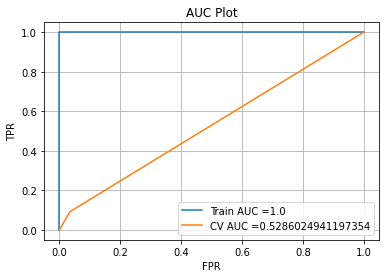

Cross Validation
FNR:0.9080459770114943 ,TPR:0.09195402298850575 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


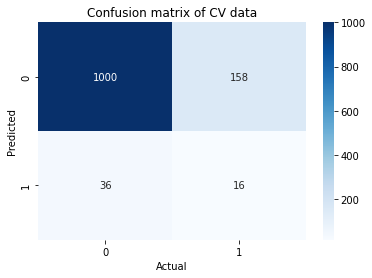

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.11226551153284285
only_fraud_physician_count 0.2616974473571845
only_fraud_op_physician_count 0.23600516053033874
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.36      0.12      0.18       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



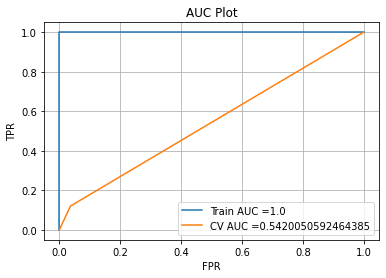

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


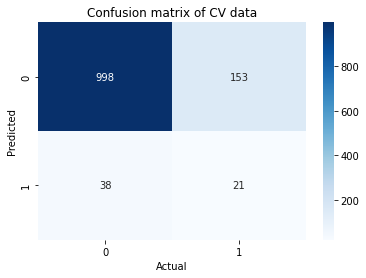

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.12235390459209512
only_fraud_physician_count 0.25412026934312826
only_fraud_op_physician_count 0.23508708455522515
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.55      0.31      0.40       174

    accuracy                           0.86      1210
   macro avg       0.72      0.63      0.66      1210
weighted avg       0.84      0.86      0.85      1210



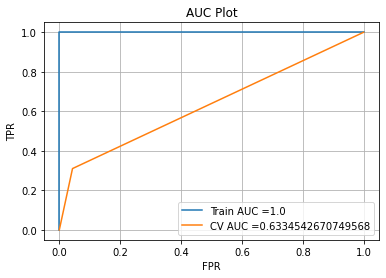

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.04343629343629344 ,TNR:0.9565637065637066 


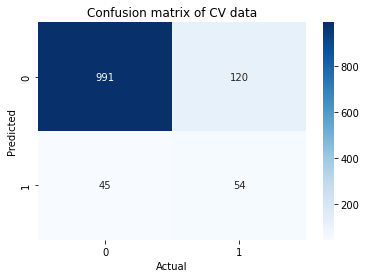

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.09948140741108916
only_fraud_physician_count 0.2751088737958747
only_fraud_op_physician_count 0.24091998325203615
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.51      0.25      0.33       174

    accuracy                           0.86      1210
   macro avg       0.70      0.60      0.63      1210
weighted avg       0.83      0.86      0.84      1210



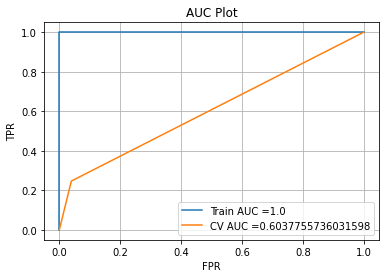

Cross Validation
FNR:0.7528735632183908 ,TPR:0.2471264367816092 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


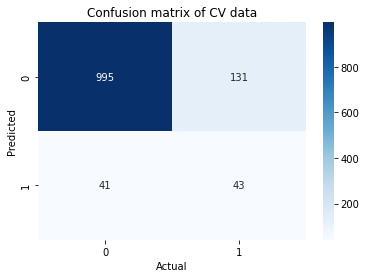

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.12125107440478479
only_fraud_physician_count 0.2675457410730437
only_fraud_op_physician_count 0.22843674143977954
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.32      0.12      0.18       174

    accuracy                           0.84      1210
   macro avg       0.59      0.54      0.54      1210
weighted avg       0.79      0.84      0.80      1210



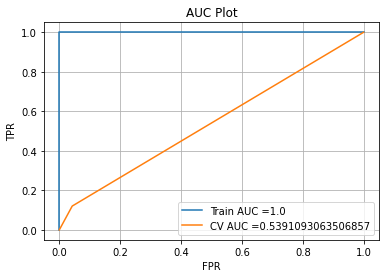

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


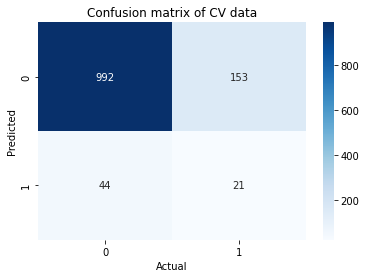

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.10395185439411898
only_fraud_physician_count 0.2537575208123341
only_fraud_op_physician_count 0.2572223492866283
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.40      0.12      0.19       174

    accuracy                           0.85      1210
   macro avg       0.64      0.55      0.55      1210
weighted avg       0.80      0.85      0.81      1210



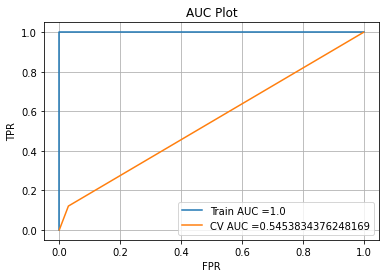

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.029922779922779922 ,TNR:0.9700772200772201 


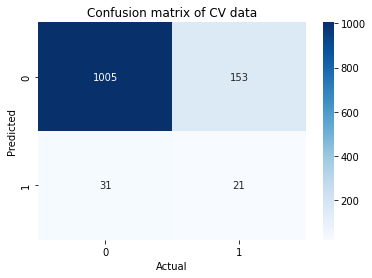

In [99]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_60_40,y_outpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_code_count 0.1269723557611908
only_fraud_physician_count 0.2666125487593106
only_fraud_op_physician_count 0.22339095357986058
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1036
           1       0.59      0.31      0.41       174

    accuracy                           0.87      1210
   macro avg       0.74      0.64      0.67      1210
weighted avg       0.85      0.87      0.85      1210



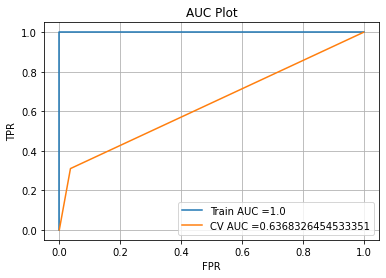

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


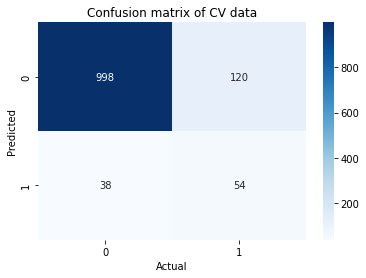

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  100
Important Features
only_fraud_code_count 0.12514542930874215
only_fraud_physician_count 0.2661136347424415
only_fraud_op_physician_count 0.23933886991311484
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.40      0.13      0.20       174

    accuracy                           0.85      1210
   macro avg       0.63      0.55      0.56      1210
weighted avg       0.80      0.85      0.81      1210



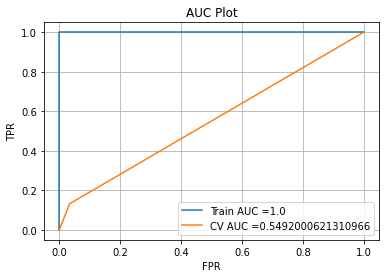

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


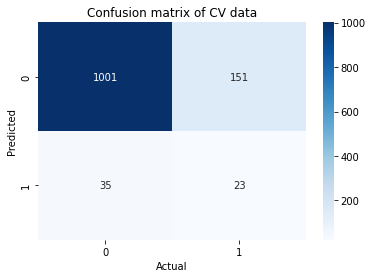

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  100
Important Features
only_fraud_code_count 0.11076114353017993
only_fraud_physician_count 0.2720602878160509
only_fraud_op_physician_count 0.24169134329628675
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.48      0.25      0.33       174

    accuracy                           0.85      1210
   macro avg       0.68      0.60      0.62      1210
weighted avg       0.83      0.85      0.83      1210



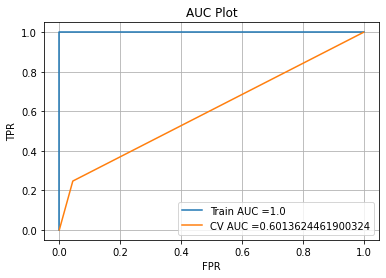

Cross Validation
FNR:0.7528735632183908 ,TPR:0.2471264367816092 ,FPR:0.0444015444015444 ,TNR:0.9555984555984556 


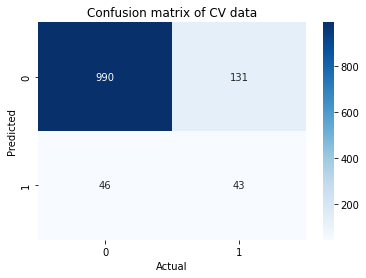

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  100
Important Features
only_fraud_code_count 0.12851199924068551
only_fraud_physician_count 0.30849711875742836
only_fraud_op_physician_count 0.2058356523573866
              precision    recall  f1-score   support

           0       0.89      0.94      0.91      1036
           1       0.45      0.28      0.35       174

    accuracy                           0.85      1210
   macro avg       0.67      0.61      0.63      1210
weighted avg       0.82      0.85      0.83      1210



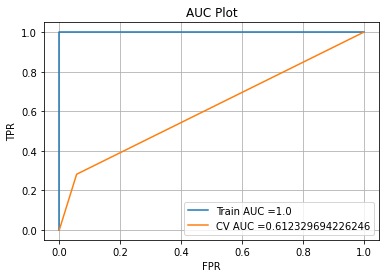

Cross Validation
FNR:0.7183908045977011 ,TPR:0.28160919540229884 ,FPR:0.05694980694980695 ,TNR:0.943050193050193 


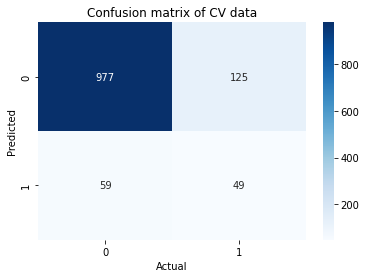

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  100
Important Features
only_fraud_code_count 0.09918309836392113
only_fraud_physician_count 0.2328244917960092
only_fraud_op_physician_count 0.32189323106047163
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.38      0.11      0.18       174

    accuracy                           0.85      1210
   macro avg       0.62      0.54      0.55      1210
weighted avg       0.80      0.85      0.81      1210



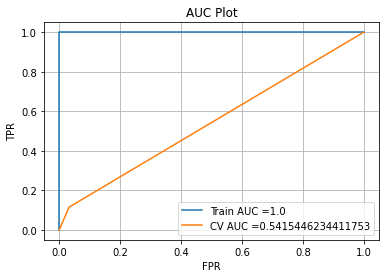

Cross Validation
FNR:0.8850574712643678 ,TPR:0.11494252873563218 ,FPR:0.03185328185328185 ,TNR:0.9681467181467182 


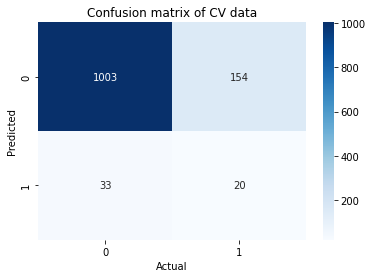

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  100
Important Features
only_fraud_code_count 0.0955137847239361
only_fraud_physician_count 0.30940447504653323
only_fraud_op_physician_count 0.2518434786598146
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.37      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.62      0.55      0.55      1210
weighted avg       0.80      0.84      0.81      1210



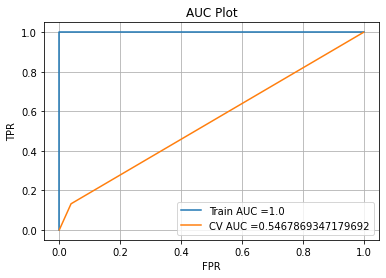

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


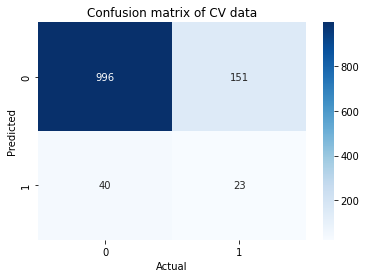

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  100
Important Features
only_fraud_code_count 0.11881774874616688
only_fraud_physician_count 0.2701226239036868
only_fraud_op_physician_count 0.24547821506213527
              precision    recall  f1-score   support

           0       0.87      0.97      0.91      1036
           1       0.40      0.13      0.20       174

    accuracy                           0.85      1210
   macro avg       0.63      0.55      0.56      1210
weighted avg       0.80      0.85      0.81      1210



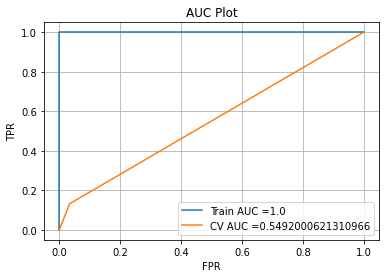

Cross Validation
FNR:0.867816091954023 ,TPR:0.13218390804597702 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


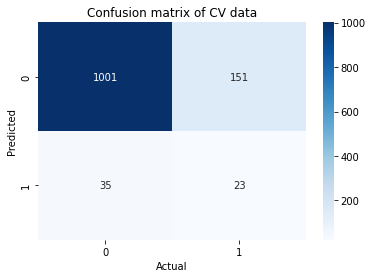

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_code_count 0.11165713780442524
only_fraud_physician_count 0.2612427641188554
only_fraud_op_physician_count 0.24143867404639316
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1036
           1       0.39      0.12      0.18       174

    accuracy                           0.85      1210
   macro avg       0.63      0.54      0.55      1210
weighted avg       0.80      0.85      0.81      1210



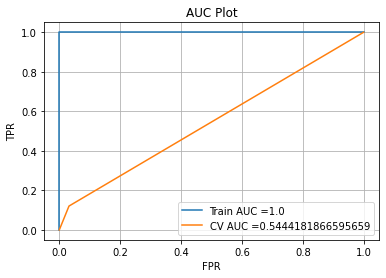

Cross Validation
FNR:0.8793103448275862 ,TPR:0.1206896551724138 ,FPR:0.03185328185328185 ,TNR:0.9681467181467182 


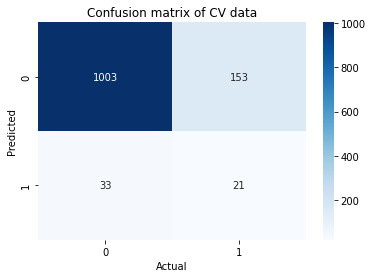

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  200
Important Features
only_fraud_code_count 0.11287281881888372
only_fraud_physician_count 0.25499867976250695
only_fraud_op_physician_count 0.26521919395803056
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.55      0.30      0.39       174

    accuracy                           0.86      1210
   macro avg       0.72      0.63      0.65      1210
weighted avg       0.84      0.86      0.85      1210



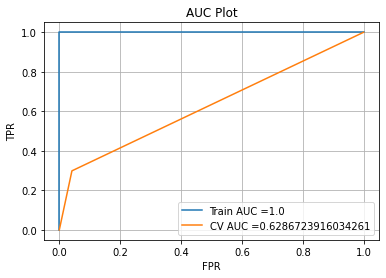

Cross Validation
FNR:0.7011494252873564 ,TPR:0.2988505747126437 ,FPR:0.041505791505791506 ,TNR:0.9584942084942085 


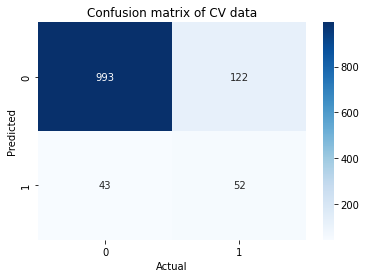

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  200
Important Features
only_fraud_code_count 0.12072240977862343
only_fraud_physician_count 0.2716986070531899
only_fraud_op_physician_count 0.2440157794508358
              precision    recall  f1-score   support

           0       0.87      0.96      0.91      1036
           1       0.36      0.13      0.19       174

    accuracy                           0.84      1210
   macro avg       0.61      0.54      0.55      1210
weighted avg       0.79      0.84      0.81      1210



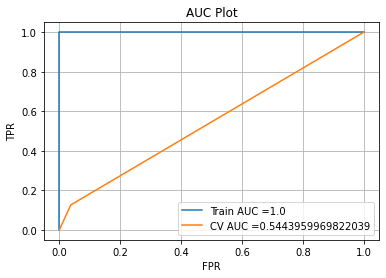

Cross Validation
FNR:0.8735632183908046 ,TPR:0.12643678160919541 ,FPR:0.037644787644787646 ,TNR:0.9623552123552124 


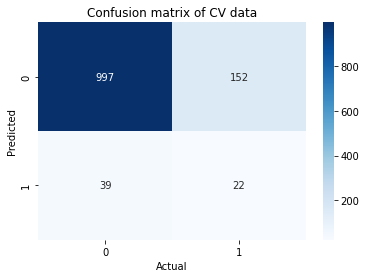

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  200
Important Features
only_fraud_code_count 0.10697964739279016
only_fraud_physician_count 0.25775719642871897
only_fraud_op_physician_count 0.29000546763621454
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.60      0.30      0.40       174

    accuracy                           0.87      1210
   macro avg       0.74      0.63      0.66      1210
weighted avg       0.85      0.87      0.85      1210



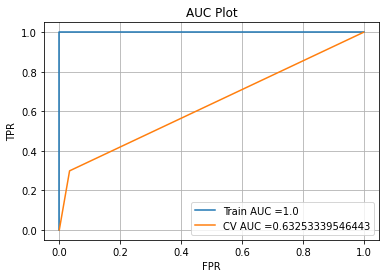

Cross Validation
FNR:0.7011494252873564 ,TPR:0.2988505747126437 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


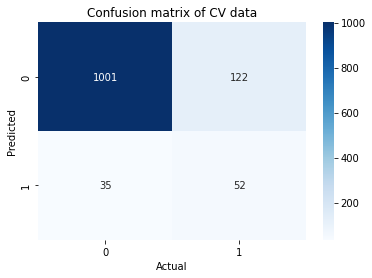

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  200
Important Features
only_fraud_code_count 0.1223991538124
only_fraud_physician_count 0.2787077302484955
only_fraud_op_physician_count 0.21831583440251925
              precision    recall  f1-score   support

           0       0.88      0.95      0.91      1036
           1       0.45      0.26      0.33       174

    accuracy                           0.85      1210
   macro avg       0.67      0.60      0.62      1210
weighted avg       0.82      0.85      0.83      1210



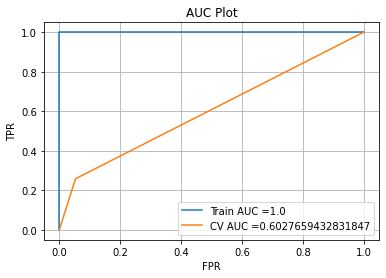

Cross Validation
FNR:0.7413793103448276 ,TPR:0.25862068965517243 ,FPR:0.05308880308880309 ,TNR:0.946911196911197 


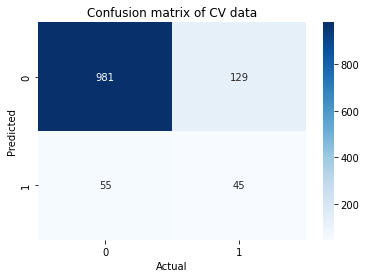

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  200
Important Features
only_fraud_code_count 0.10855697640506394
only_fraud_physician_count 0.2648302063863062
only_fraud_op_physician_count 0.27139690490963814
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.52      0.24      0.32       174

    accuracy                           0.86      1210
   macro avg       0.70      0.60      0.62      1210
weighted avg       0.83      0.86      0.84      1210



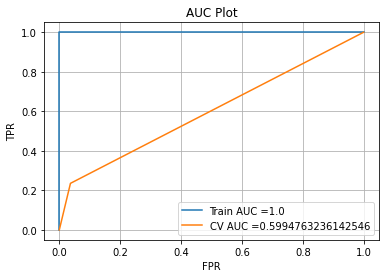

Cross Validation
FNR:0.764367816091954 ,TPR:0.23563218390804597 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


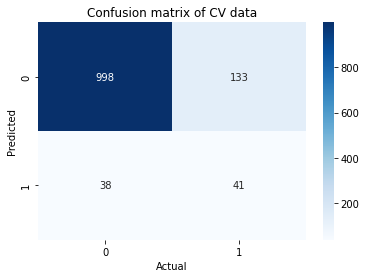

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  200
Important Features
only_fraud_code_count 0.1169818918896327
only_fraud_physician_count 0.2749150737974942
only_fraud_op_physician_count 0.21217856473856295
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1036
           1       0.51      0.32      0.39       174

    accuracy                           0.86      1210
   macro avg       0.70      0.63      0.66      1210
weighted avg       0.84      0.86      0.84      1210



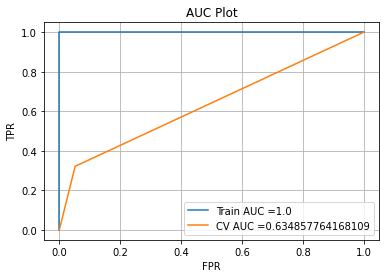

Cross Validation
FNR:0.6781609195402298 ,TPR:0.3218390804597701 ,FPR:0.052123552123552123 ,TNR:0.9478764478764479 


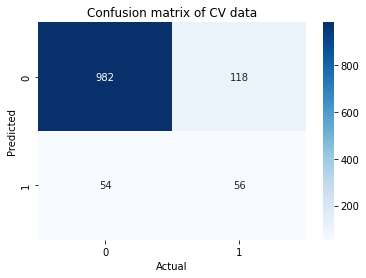

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_code_count 0.12089000718948477
only_fraud_physician_count 0.2708901135170241
only_fraud_op_physician_count 0.23517855586692257
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.56      0.27      0.36       174

    accuracy                           0.86      1210
   macro avg       0.72      0.62      0.64      1210
weighted avg       0.84      0.86      0.84      1210



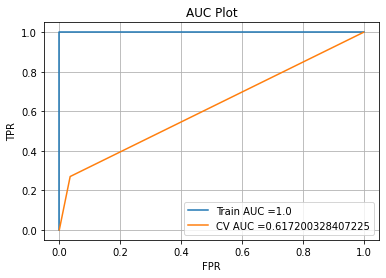

Cross Validation
FNR:0.7298850574712644 ,TPR:0.27011494252873564 ,FPR:0.03571428571428571 ,TNR:0.9642857142857143 


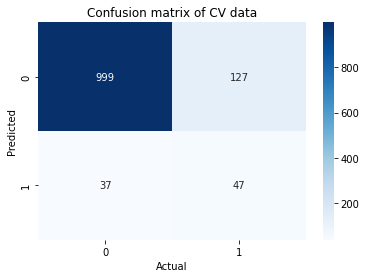

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  500
Important Features
only_fraud_code_count 0.10834581125495375
only_fraud_physician_count 0.2816308171281527
only_fraud_op_physician_count 0.2526407572496642
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.49      0.25      0.33       174

    accuracy                           0.86      1210
   macro avg       0.69      0.60      0.62      1210
weighted avg       0.83      0.86      0.83      1210



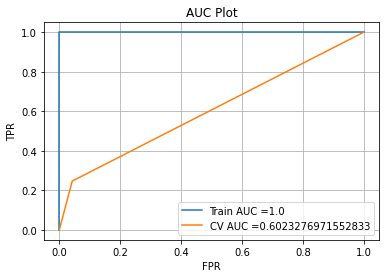

Cross Validation
FNR:0.7528735632183908 ,TPR:0.2471264367816092 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


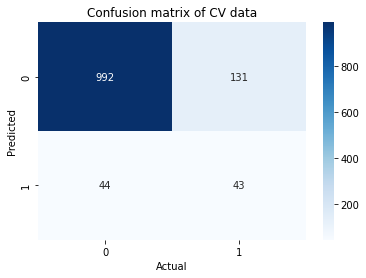

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  500
Important Features
only_fraud_code_count 0.11082724519312653
only_fraud_physician_count 0.2661155863261149
only_fraud_op_physician_count 0.25163978849469626
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1036
           1       0.57      0.30      0.39       174

    accuracy                           0.87      1210
   macro avg       0.73      0.63      0.66      1210
weighted avg       0.85      0.87      0.85      1210



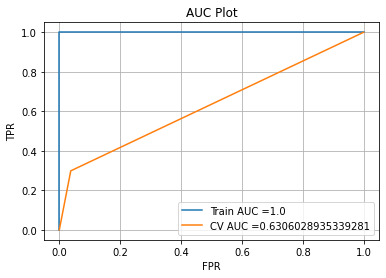

Cross Validation
FNR:0.7011494252873564 ,TPR:0.2988505747126437 ,FPR:0.037644787644787646 ,TNR:0.9623552123552124 


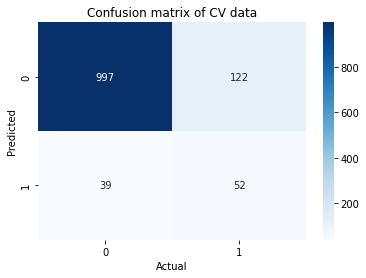

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  500
Important Features
only_fraud_code_count 0.1121709166397324
only_fraud_physician_count 0.2684067748774146
only_fraud_op_physician_count 0.2494171000071688
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.60      0.31      0.41       174

    accuracy                           0.87      1210
   macro avg       0.75      0.64      0.67      1210
weighted avg       0.85      0.87      0.85      1210



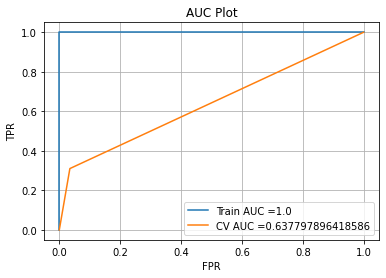

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


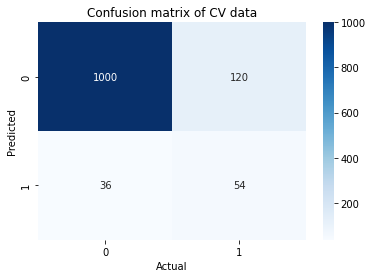

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  500
Important Features
only_fraud_code_count 0.12336405819585623
only_fraud_physician_count 0.25645339306747494
only_fraud_op_physician_count 0.24862300987783914
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.60      0.30      0.40       174

    accuracy                           0.87      1210
   macro avg       0.75      0.64      0.67      1210
weighted avg       0.85      0.87      0.85      1210



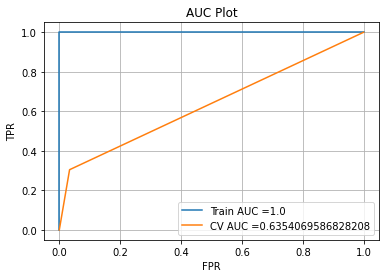

Cross Validation
FNR:0.6954022988505747 ,TPR:0.3045977011494253 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


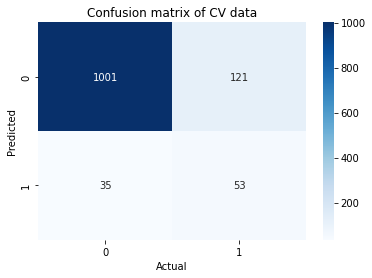

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  500
Important Features
only_fraud_code_count 0.11925001390099993
only_fraud_physician_count 0.25732118938198945
only_fraud_op_physician_count 0.2448241442298475
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1036
           1       0.53      0.31      0.39       174

    accuracy                           0.86      1210
   macro avg       0.71      0.63      0.66      1210
weighted avg       0.84      0.86      0.85      1210



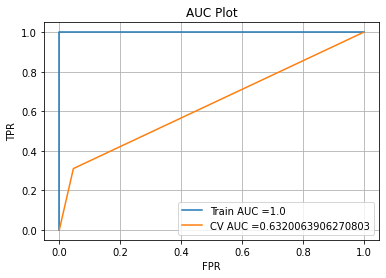

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.04633204633204633 ,TNR:0.9536679536679536 


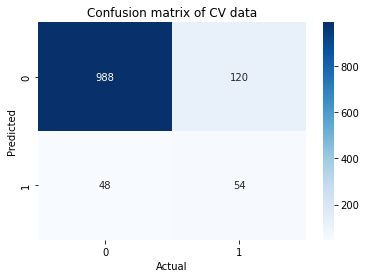

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  500
Important Features
only_fraud_code_count 0.11478872385719711
only_fraud_physician_count 0.2701285585942433
only_fraud_op_physician_count 0.251641138108108
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1036
           1       0.53      0.31      0.39       174

    accuracy                           0.86      1210
   macro avg       0.71      0.63      0.66      1210
weighted avg       0.84      0.86      0.85      1210



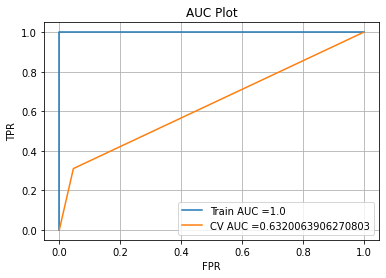

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.04633204633204633 ,TNR:0.9536679536679536 


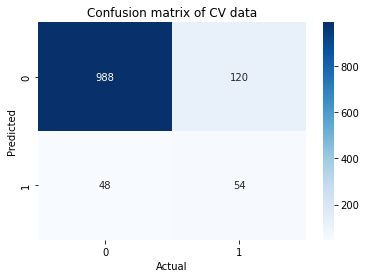

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_code_count 0.11822804517129316
only_fraud_physician_count 0.2683305409744281
only_fraud_op_physician_count 0.23836904840716105
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.61      0.31      0.41       174

    accuracy                           0.87      1210
   macro avg       0.75      0.64      0.67      1210
weighted avg       0.85      0.87      0.85      1210



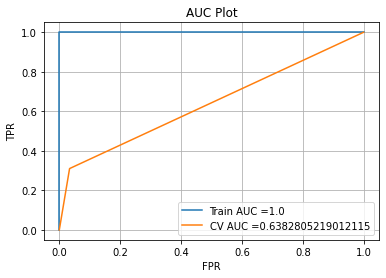

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.033783783783783786 ,TNR:0.9662162162162162 


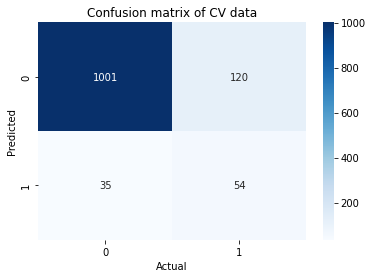

----------------------------------------------------------------------------------------
Depth:  100  N estimator:  1000
Important Features
only_fraud_code_count 0.11118255475057023
only_fraud_physician_count 0.2695953594184282
only_fraud_op_physician_count 0.24156677875671345
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1036
           1       0.57      0.31      0.40       174

    accuracy                           0.87      1210
   macro avg       0.73      0.64      0.66      1210
weighted avg       0.85      0.87      0.85      1210



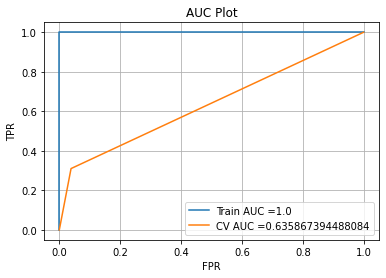

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


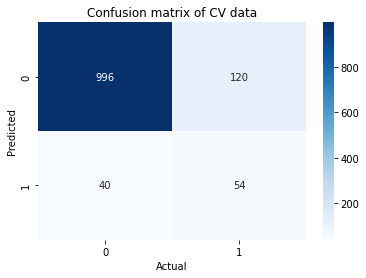

----------------------------------------------------------------------------------------
Depth:  200  N estimator:  1000
Important Features
only_fraud_code_count 0.11495261497543344
only_fraud_physician_count 0.2666464786463645
only_fraud_op_physician_count 0.24183449254856398
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1036
           1       0.57      0.31      0.40       174

    accuracy                           0.87      1210
   macro avg       0.73      0.64      0.66      1210
weighted avg       0.85      0.87      0.85      1210



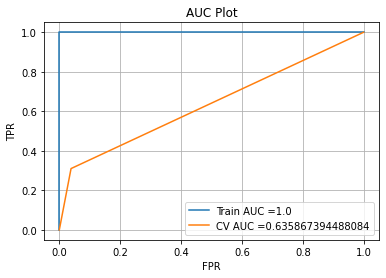

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.03861003861003861 ,TNR:0.9613899613899614 


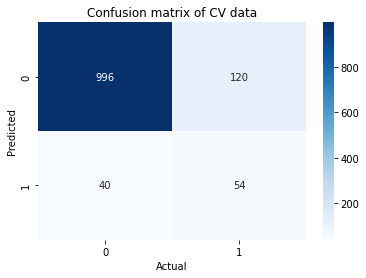

----------------------------------------------------------------------------------------
Depth:  500  N estimator:  1000
Important Features
only_fraud_code_count 0.10987846425316736
only_fraud_physician_count 0.27044018082531157
only_fraud_op_physician_count 0.25059136924710135
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1036
           1       0.49      0.25      0.33       174

    accuracy                           0.86      1210
   macro avg       0.69      0.60      0.62      1210
weighted avg       0.83      0.86      0.83      1210



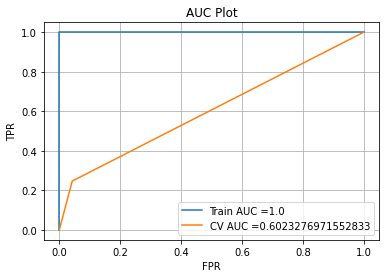

Cross Validation
FNR:0.7528735632183908 ,TPR:0.2471264367816092 ,FPR:0.04247104247104247 ,TNR:0.9575289575289575 


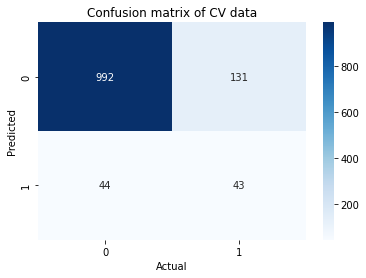

----------------------------------------------------------------------------------------
Depth:  1000  N estimator:  1000
Important Features
only_fraud_code_count 0.11579108839759727
only_fraud_physician_count 0.2614089055920299
only_fraud_op_physician_count 0.24488445367212688
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1036
           1       0.55      0.31      0.40       174

    accuracy                           0.86      1210
   macro avg       0.72      0.63      0.66      1210
weighted avg       0.84      0.86      0.85      1210



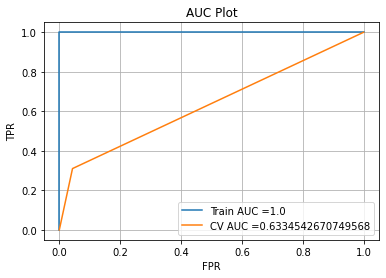

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.04343629343629344 ,TNR:0.9565637065637066 


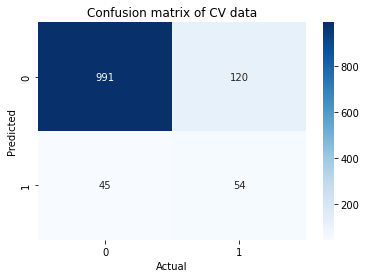

----------------------------------------------------------------------------------------
Depth:  2000  N estimator:  1000
Important Features
only_fraud_code_count 0.11717031994209527
only_fraud_physician_count 0.2607960318370844
only_fraud_op_physician_count 0.23477298560803428
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1036
           1       0.59      0.31      0.41       174

    accuracy                           0.87      1210
   macro avg       0.74      0.64      0.67      1210
weighted avg       0.85      0.87      0.85      1210



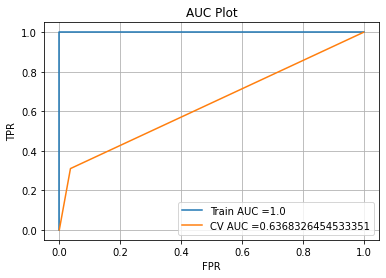

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


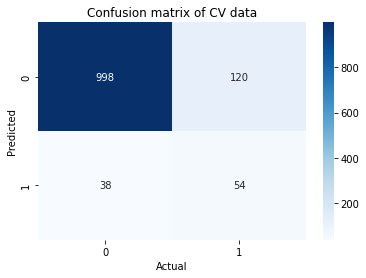

----------------------------------------------------------------------------------------
Depth:  3000  N estimator:  1000
Important Features
only_fraud_code_count 0.11850363841421939
only_fraud_physician_count 0.26173624625225916
only_fraud_op_physician_count 0.24267477336046922
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      1036
           1       0.60      0.30      0.40       174

    accuracy                           0.87      1210
   macro avg       0.74      0.63      0.67      1210
weighted avg       0.85      0.87      0.85      1210



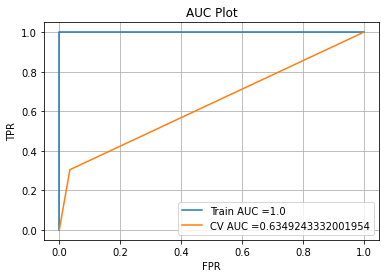

Cross Validation
FNR:0.6954022988505747 ,TPR:0.3045977011494253 ,FPR:0.03474903474903475 ,TNR:0.9652509652509652 


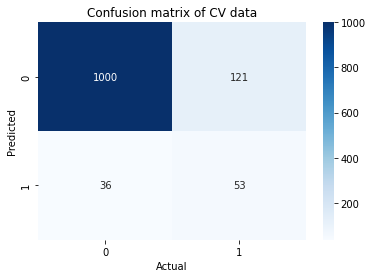

In [100]:
for n_est in [100,200,500,1000]:    
    for depth in [50,100,200,500,1000,2000,3000]:
        clf = RandomForestClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_70_30,y_outpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

In [101]:
from xgboost import XGBClassifier

<h2>XgBoost Forest</h2>

Original Distribution

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.8874159
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



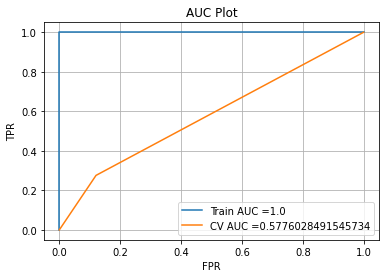

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


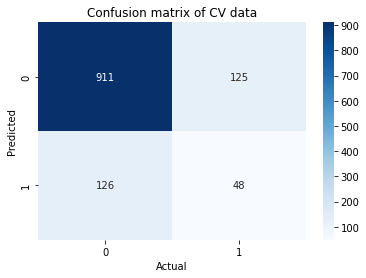

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.9353326
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



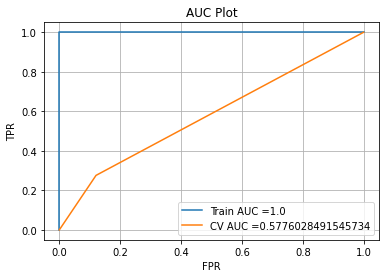

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


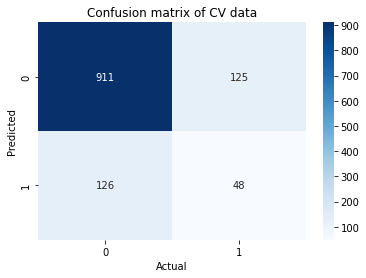

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.9353326
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



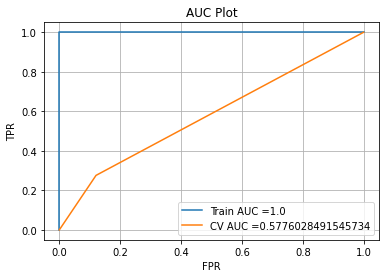

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


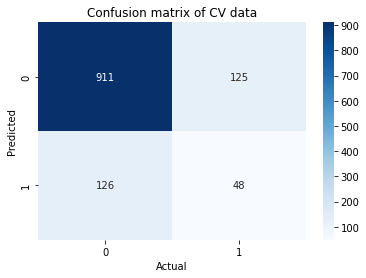

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.9353326
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



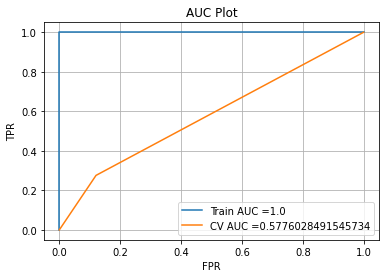

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


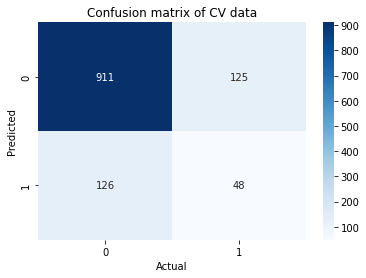

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.90099376
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



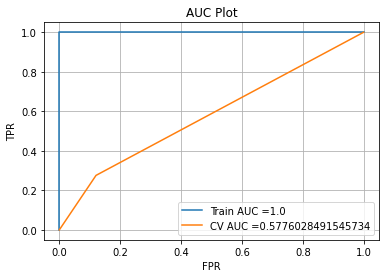

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


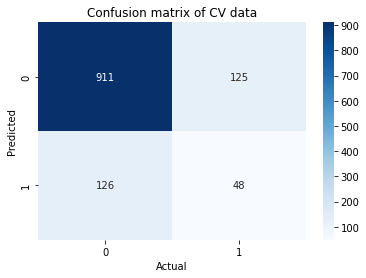

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.9412751
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



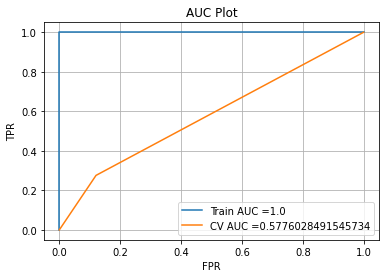

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


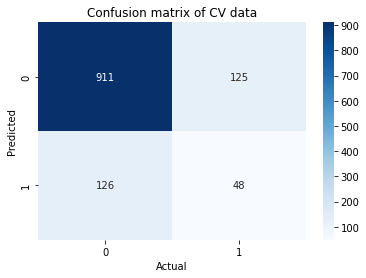

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.9412751
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



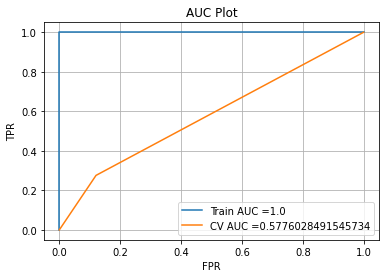

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


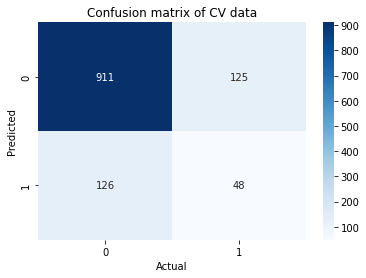

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.9412751
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



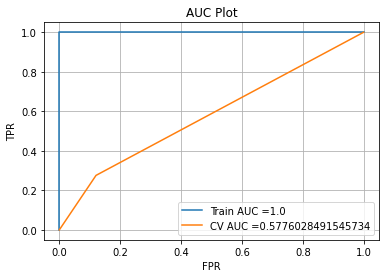

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


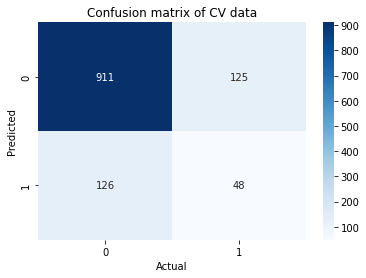

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.9273263
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



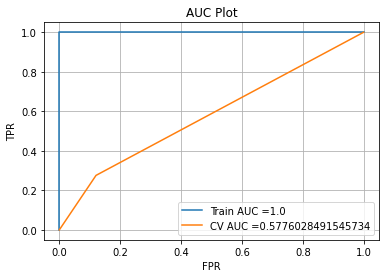

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


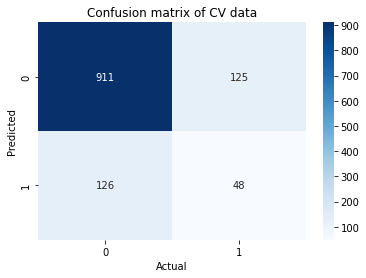

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.9527023
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



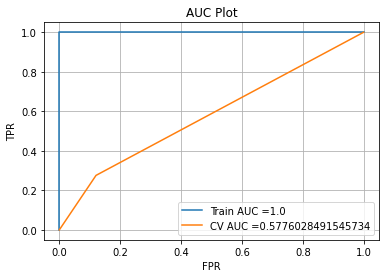

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


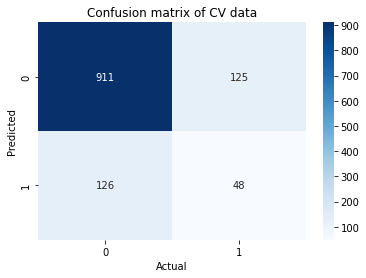

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.9527023
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



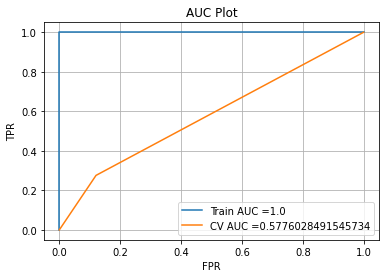

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


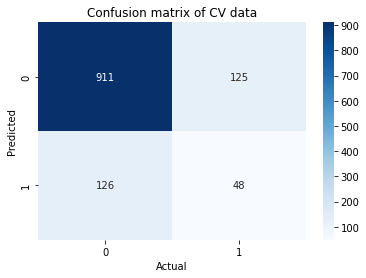

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.9527023
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



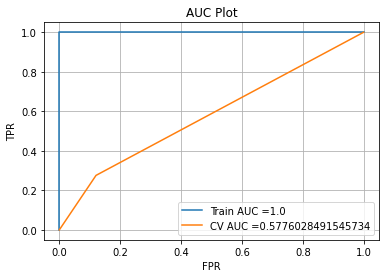

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


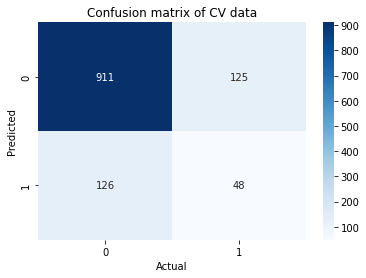

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.94443166
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



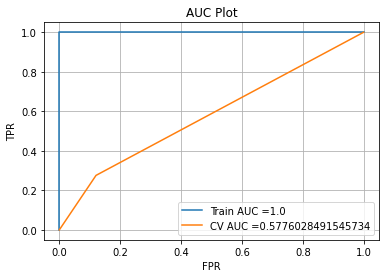

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


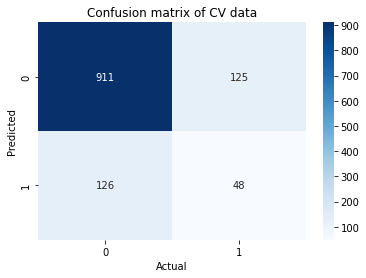

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.9618543
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



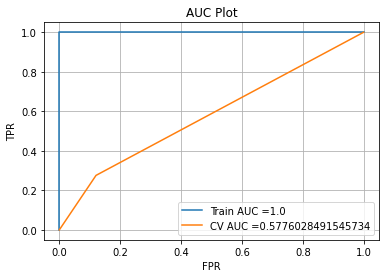

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


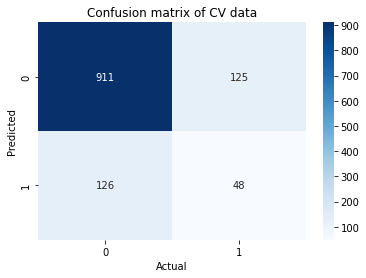

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.9618543
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



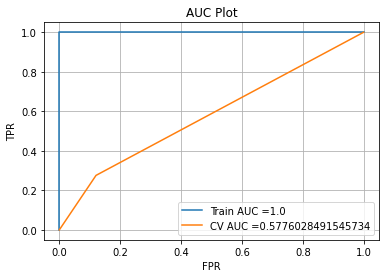

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


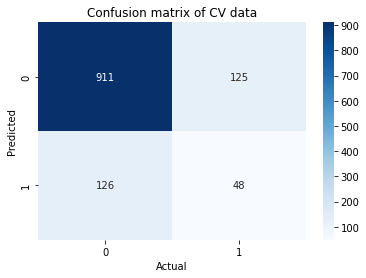

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.9618543
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



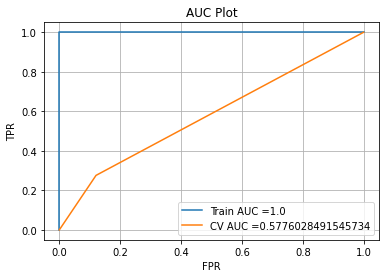

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


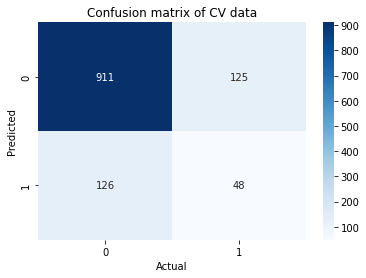

In [102]:
for n_est in [100,200,500,1000]:
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_train_outpatient,y_train_outpatient.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_train_outpatient.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_train_outpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.96677965
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



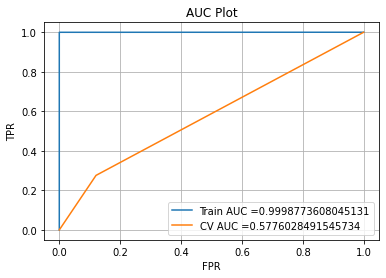

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


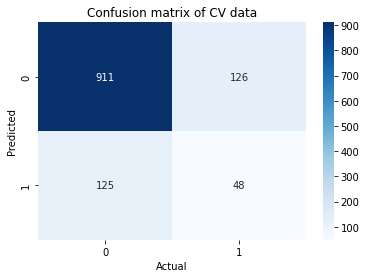

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.9823199
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



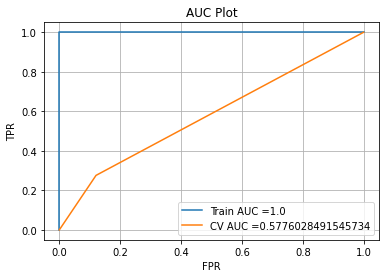

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


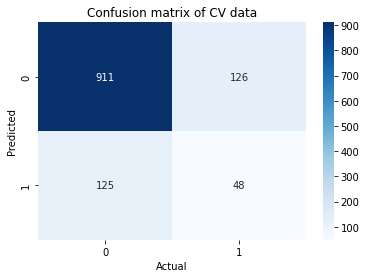

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.9823199
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



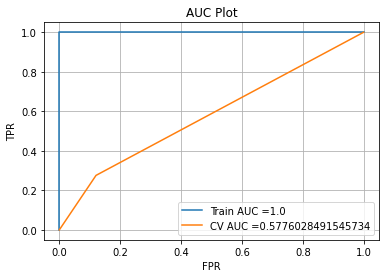

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


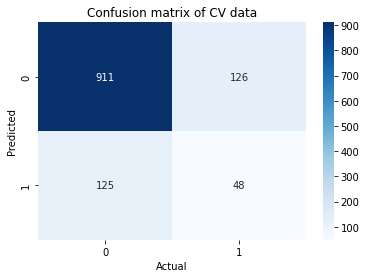

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.9823199
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



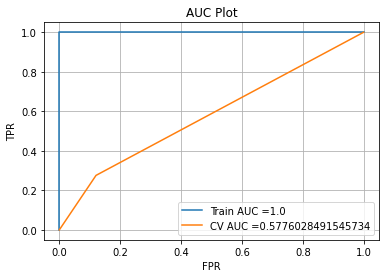

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


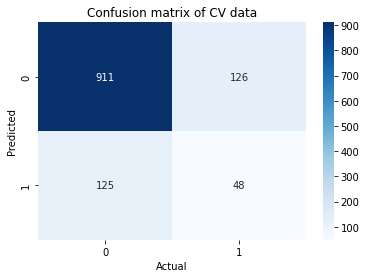

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.9706138
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



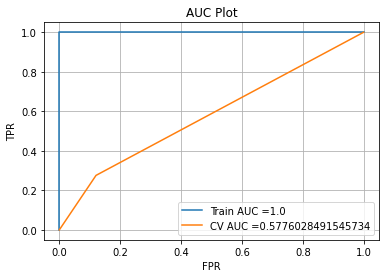

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


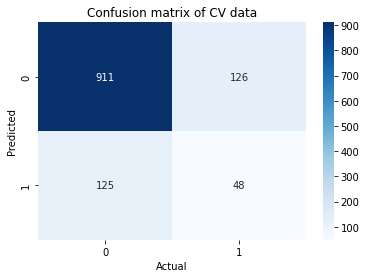

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.9841222
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



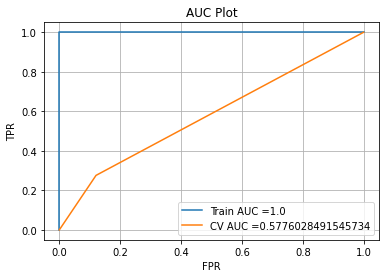

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


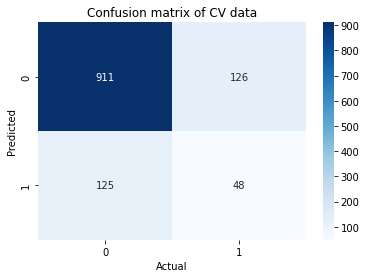

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.9841222
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



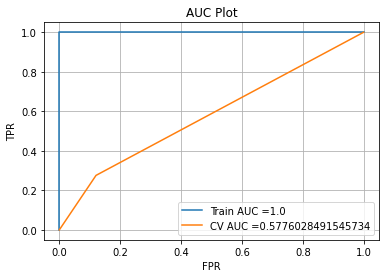

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


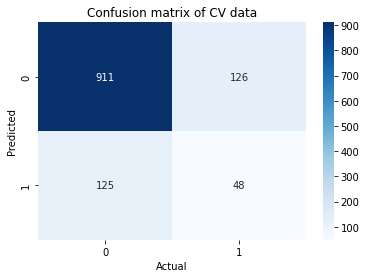

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.9841222
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



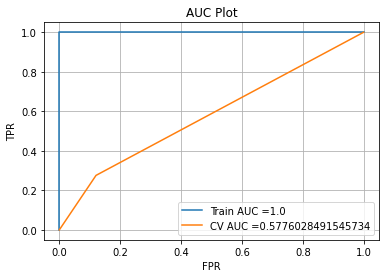

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


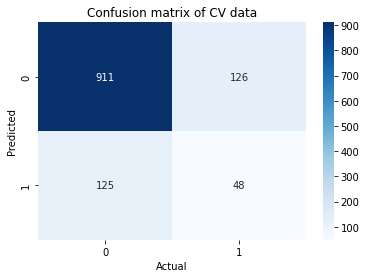

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.980773
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



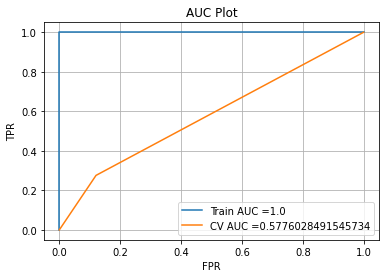

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


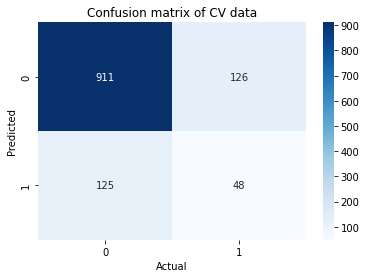

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.9893431
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



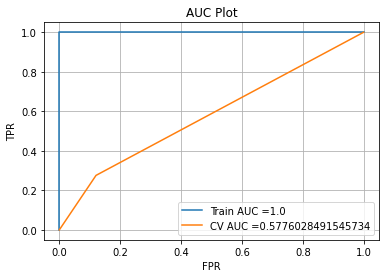

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


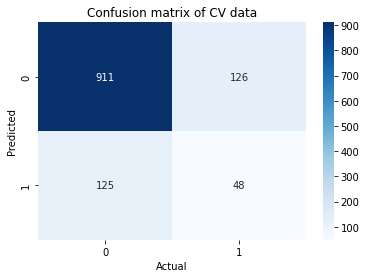

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.9893431
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



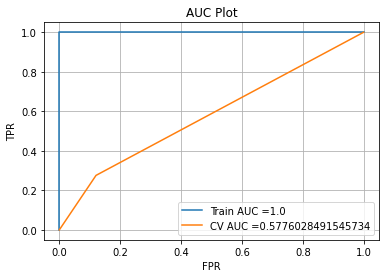

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


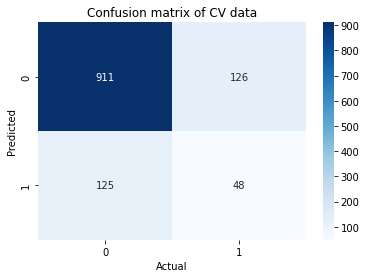

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.9893431
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



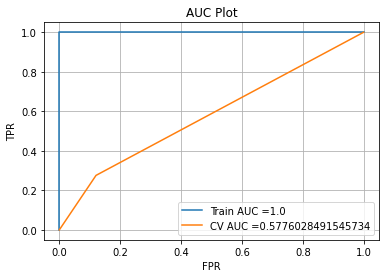

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


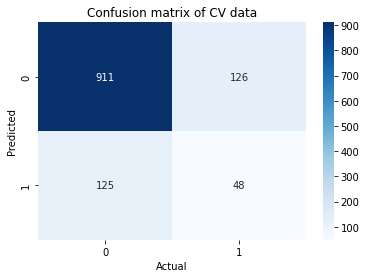

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.9821208
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



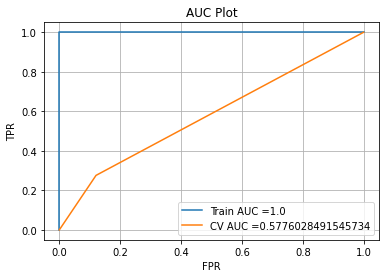

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


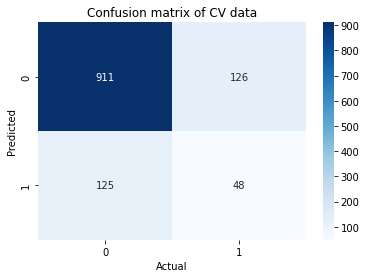

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.99178004
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



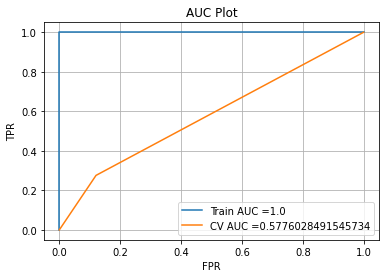

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


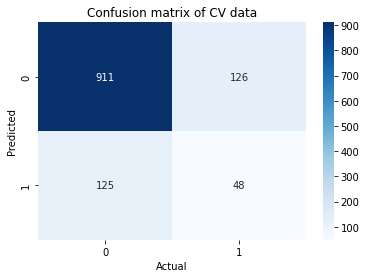

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.99178004
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



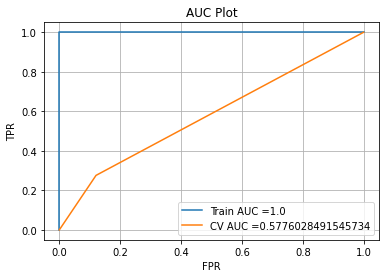

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


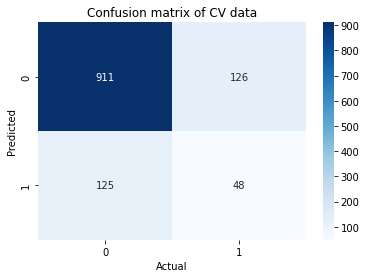

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.99178004
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



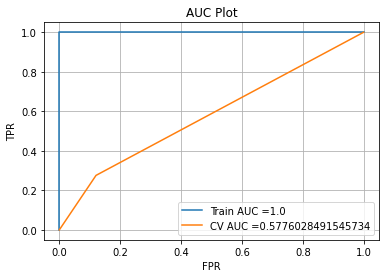

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


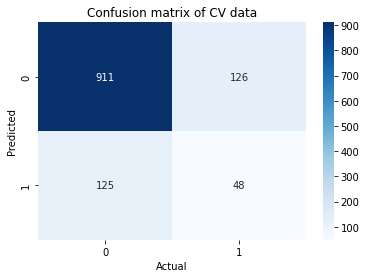

In [103]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_50_50,y_outpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.9562627
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



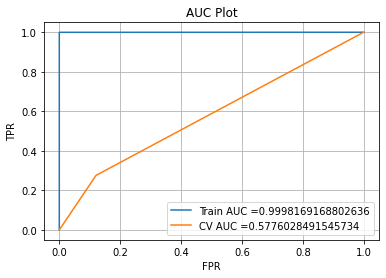

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


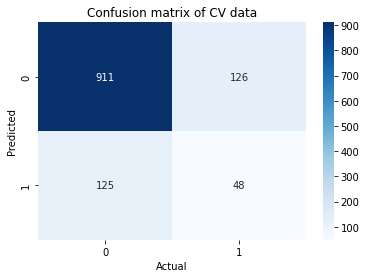

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.9783859
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



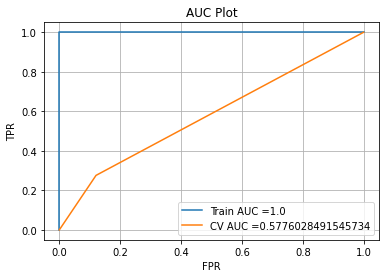

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


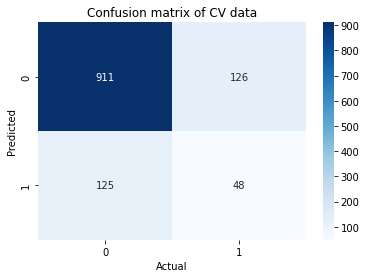

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.9783859
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



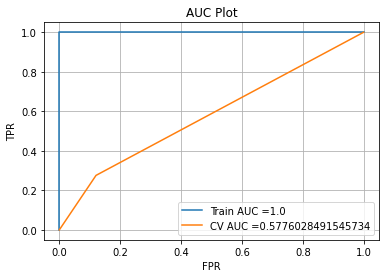

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


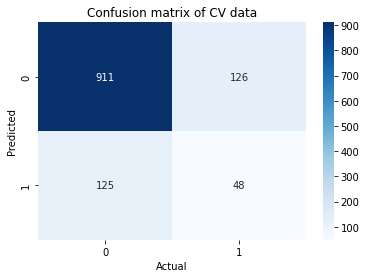

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.9783859
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



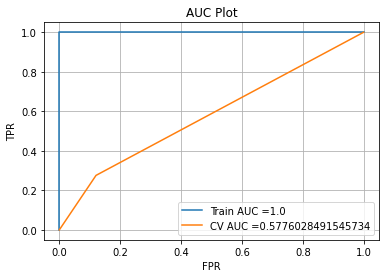

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


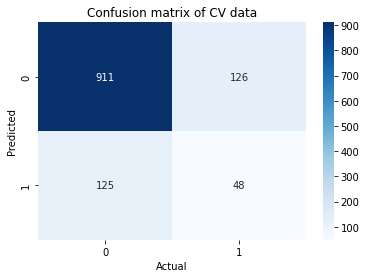

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.96005607
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



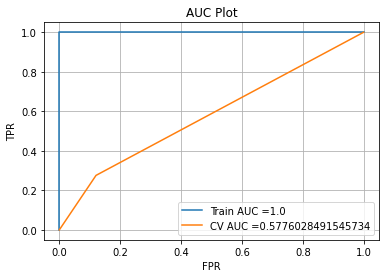

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


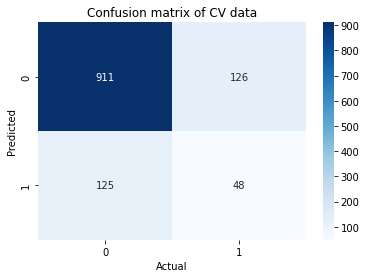

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.98073786
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



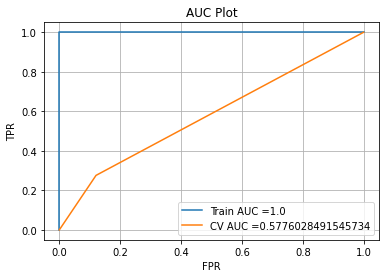

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


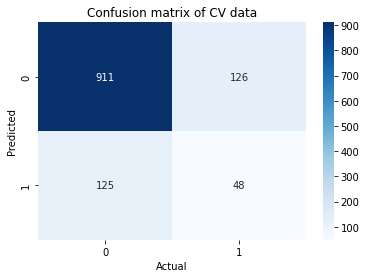

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.98073786
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



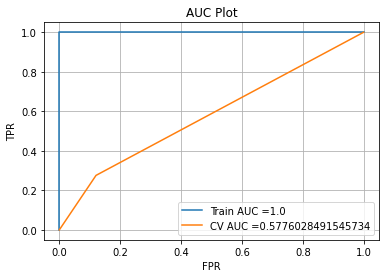

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


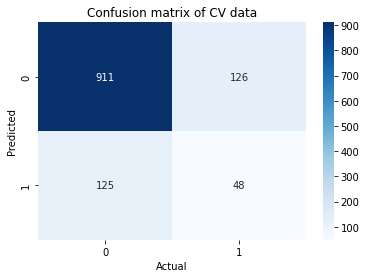

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.98073786
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



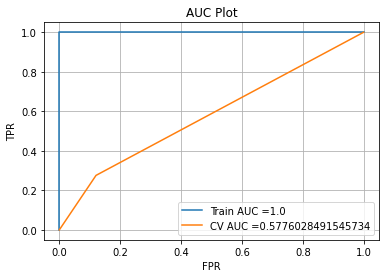

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


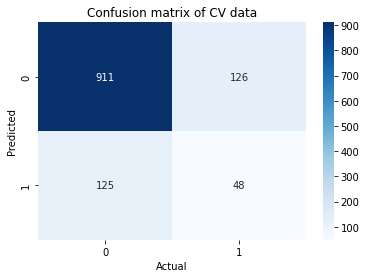

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.974009
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



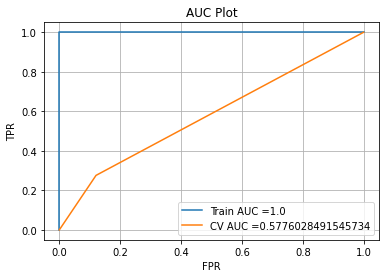

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


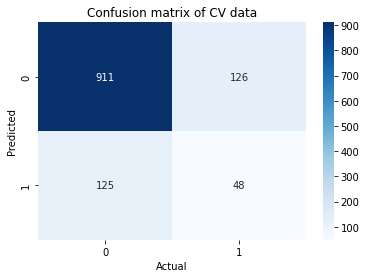

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.98617727
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



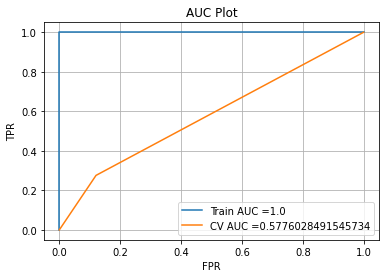

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


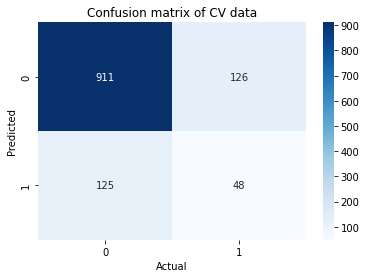

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.98617727
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



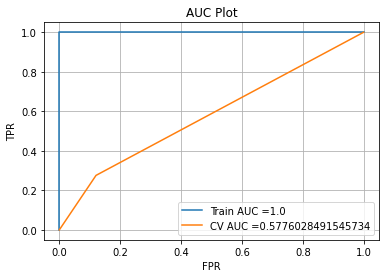

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


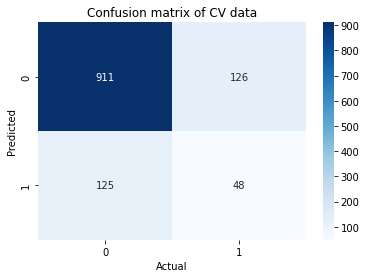

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.98617727
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



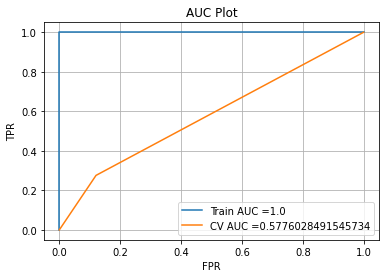

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


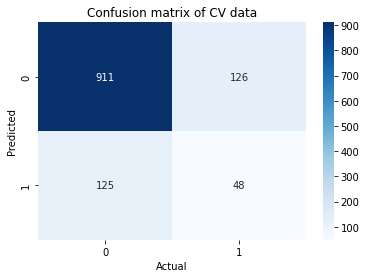

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.976622
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



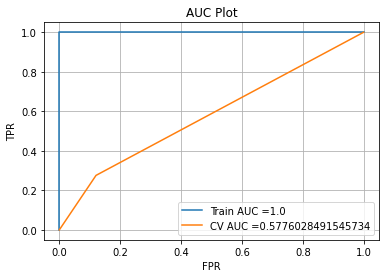

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


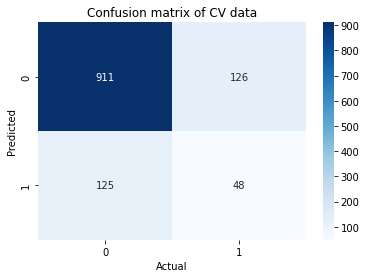

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.98807454
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



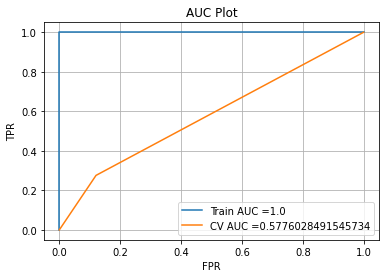

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


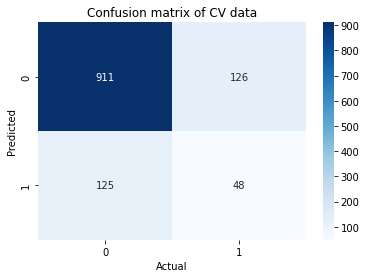

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.98807454
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



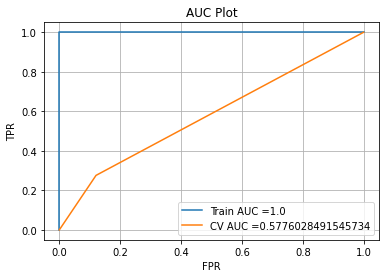

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


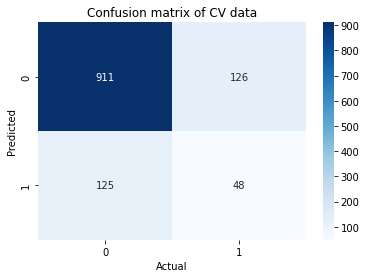

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.98807454
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



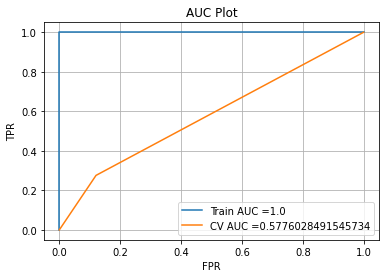

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


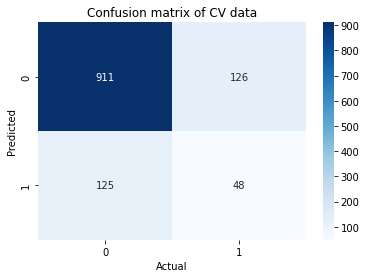

In [104]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_60_40,y_outpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  100
Important Features
only_fraud_physician_count 0.9424954
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



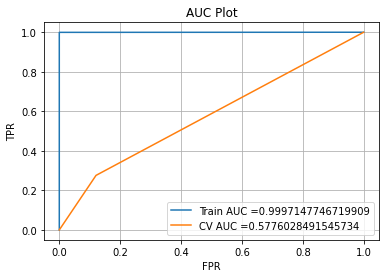

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


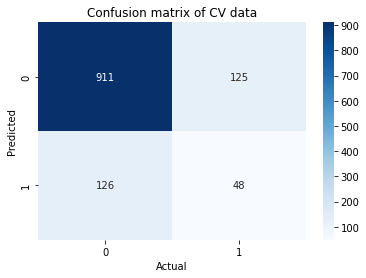

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  100
Important Features
only_fraud_physician_count 0.97123533
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



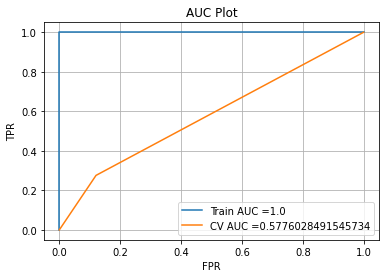

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


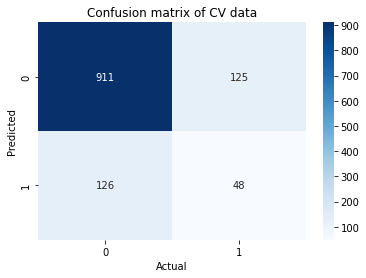

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  100
Important Features
only_fraud_physician_count 0.97123533
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



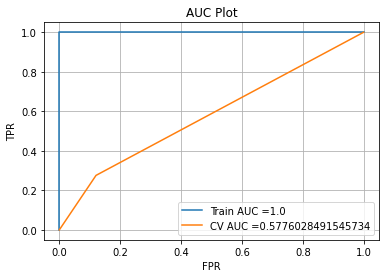

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


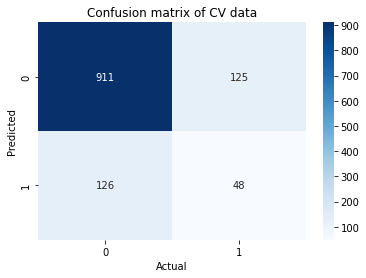

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  100
Important Features
only_fraud_physician_count 0.97123533
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



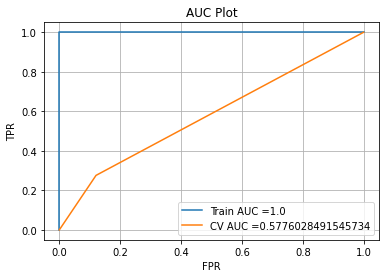

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


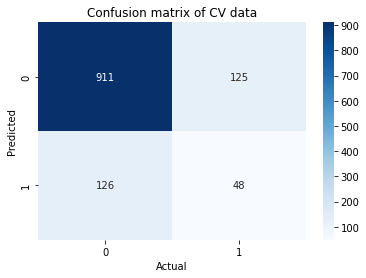

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  200
Important Features
only_fraud_physician_count 0.94754153
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



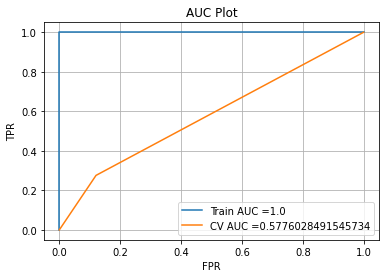

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


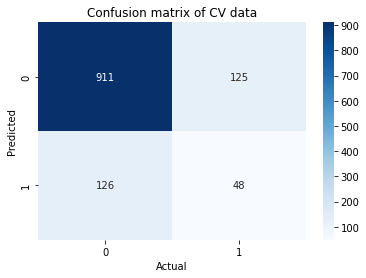

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  200
Important Features
only_fraud_physician_count 0.9734071
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



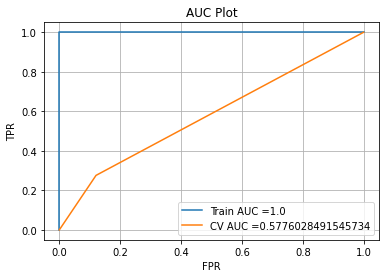

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


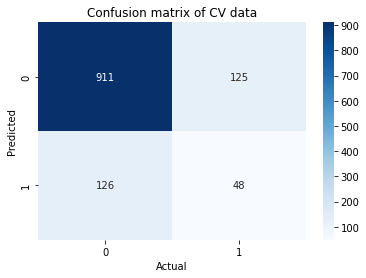

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  200
Important Features
only_fraud_physician_count 0.9734071
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



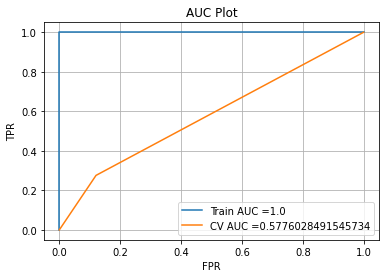

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


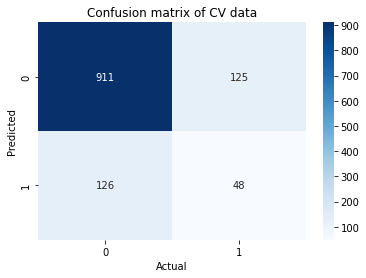

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  200
Important Features
only_fraud_physician_count 0.9734071
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



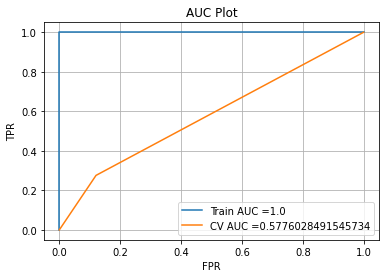

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


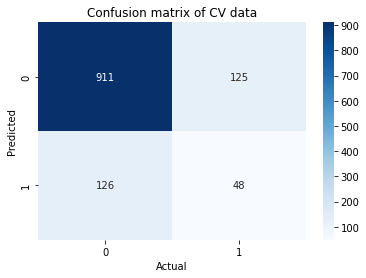

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  500
Important Features
only_fraud_physician_count 0.9646059
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



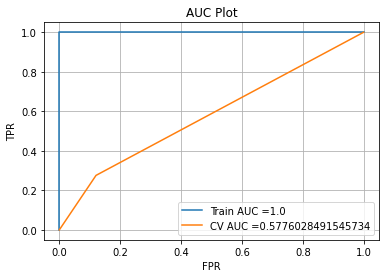

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


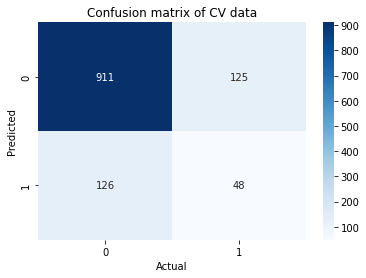

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  500
Important Features
only_fraud_physician_count 0.9796058
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



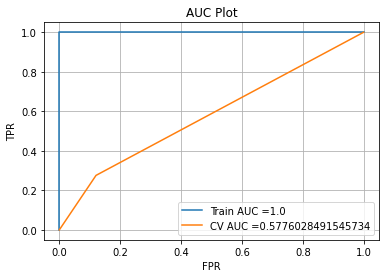

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


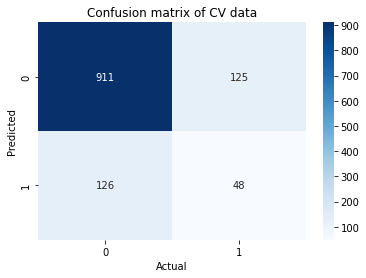

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  500
Important Features
only_fraud_physician_count 0.9796058
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



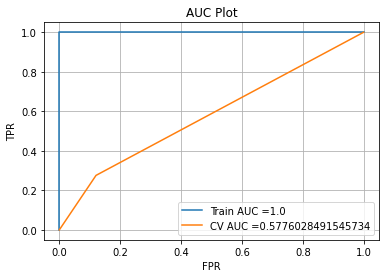

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


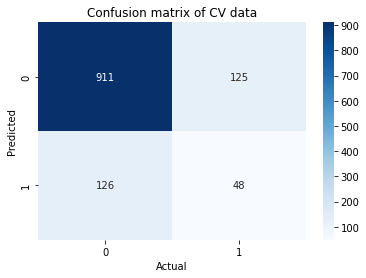

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  500
Important Features
only_fraud_physician_count 0.9796058
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



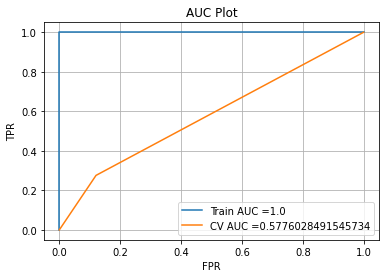

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


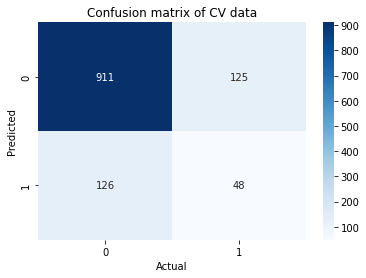

----------------------------------------------------------------------------------------
Depth:  1  N estimator:  1000
Important Features
only_fraud_physician_count 0.9706067
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



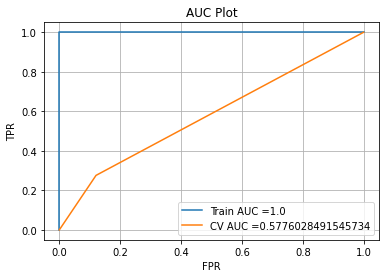

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


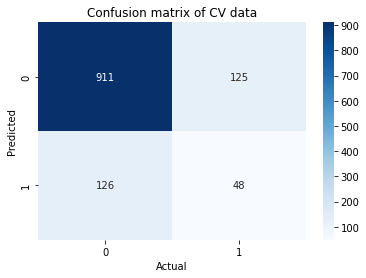

----------------------------------------------------------------------------------------
Depth:  5  N estimator:  1000
Important Features
only_fraud_physician_count 0.98362243
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



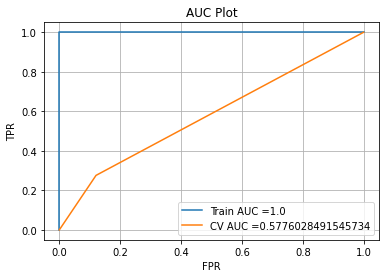

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


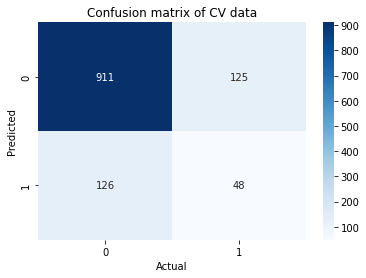

----------------------------------------------------------------------------------------
Depth:  10  N estimator:  1000
Important Features
only_fraud_physician_count 0.98362243
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



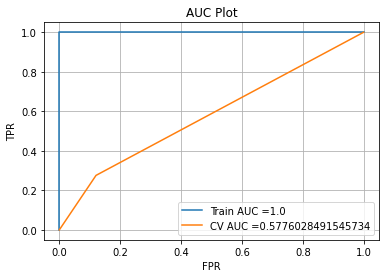

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


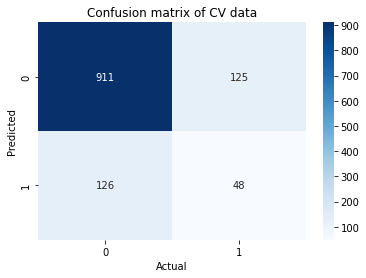

----------------------------------------------------------------------------------------
Depth:  50  N estimator:  1000
Important Features
only_fraud_physician_count 0.98362243
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1036
           1       0.28      0.28      0.28       174

    accuracy                           0.79      1210
   macro avg       0.58      0.58      0.58      1210
weighted avg       0.79      0.79      0.79      1210



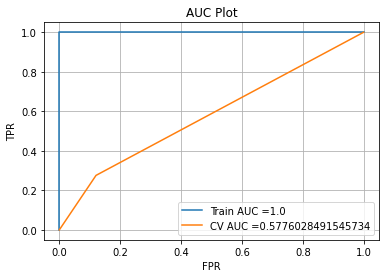

Cross Validation
FNR:0.7241379310344828 ,TPR:0.27586206896551724 ,FPR:0.12065637065637065 ,TNR:0.8793436293436293 


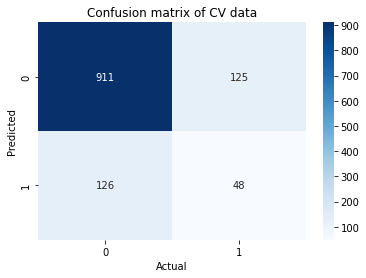

In [105]:
for n_est in [100,200,500,1000]:    
    for depth in [1,5,10,50]:
        clf = XGBClassifier(max_depth=depth,n_estimators=n_est)
        clf.fit(X_outpatient_70_30,y_outpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " N estimator: ",n_est)
        print("Important Features")
        for i,j in zip(list(X_outpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm, annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Decision Tree</h2>

In [106]:
from sklearn.tree import DecisionTreeClassifier

Original Distribution

----------------------------------------------------------------------------------------
Depth:  5 Min sample split 10
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



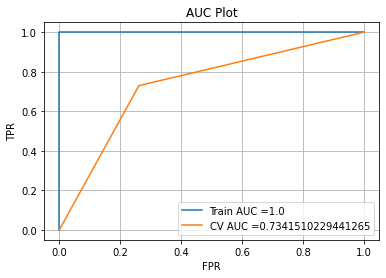

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


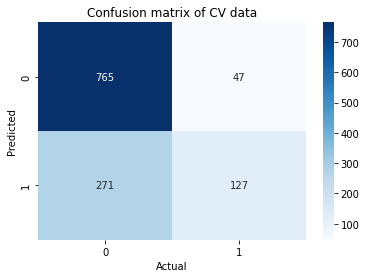

----------------------------------------------------------------------------------------
Depth:  5 Min sample split 20
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



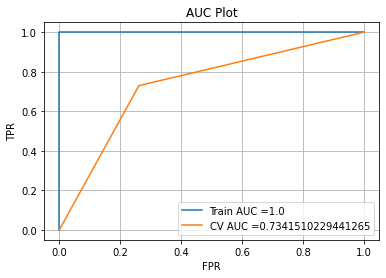

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


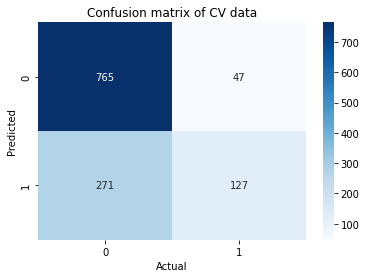

----------------------------------------------------------------------------------------
Depth:  5 Min sample split 50
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



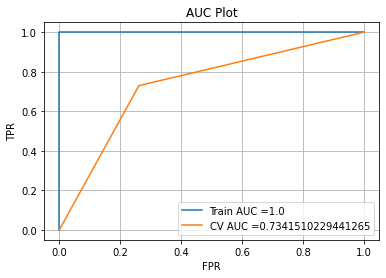

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


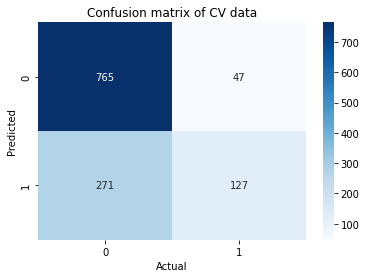

----------------------------------------------------------------------------------------
Depth:  5 Min sample split 100
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



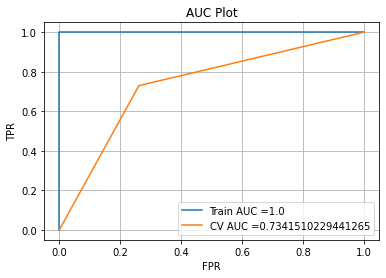

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


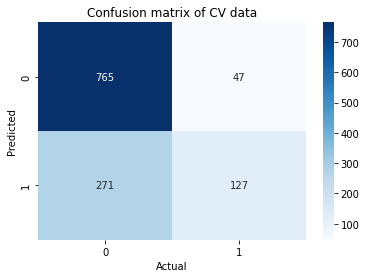

----------------------------------------------------------------------------------------
Depth:  10 Min sample split 10
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



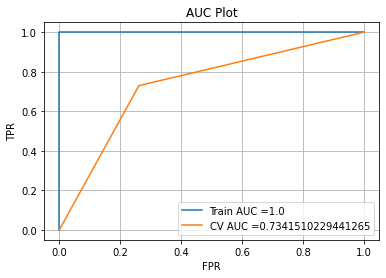

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


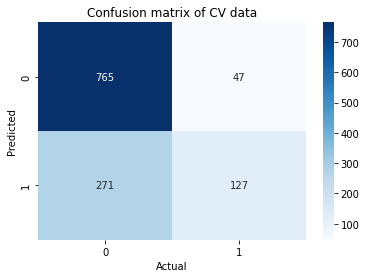

----------------------------------------------------------------------------------------
Depth:  10 Min sample split 20
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



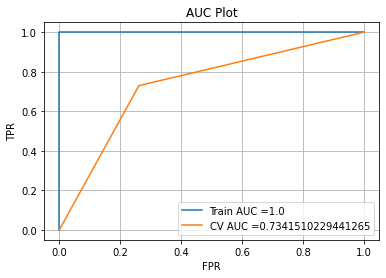

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


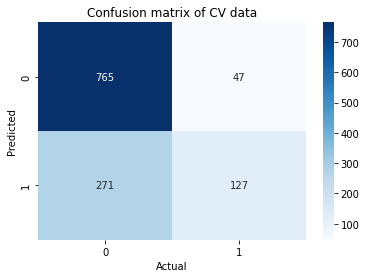

----------------------------------------------------------------------------------------
Depth:  10 Min sample split 50
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



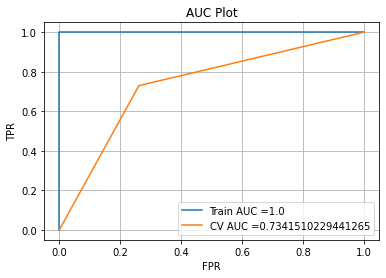

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


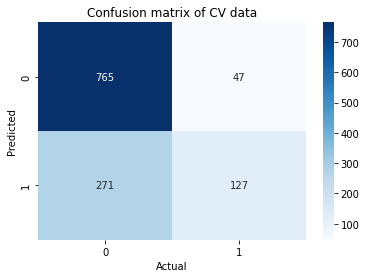

----------------------------------------------------------------------------------------
Depth:  10 Min sample split 100
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



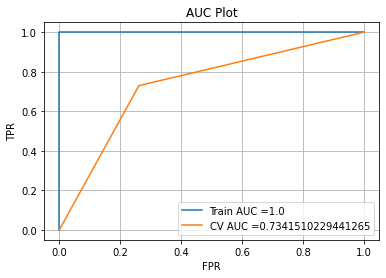

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


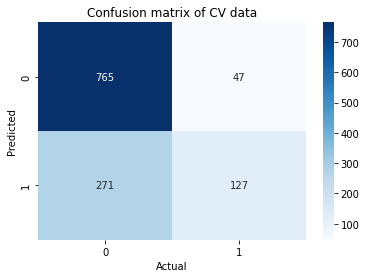

----------------------------------------------------------------------------------------
Depth:  20 Min sample split 10
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



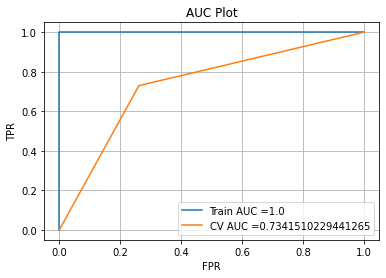

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


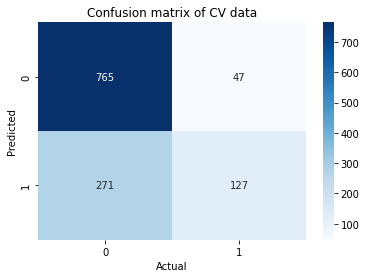

----------------------------------------------------------------------------------------
Depth:  20 Min sample split 20
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



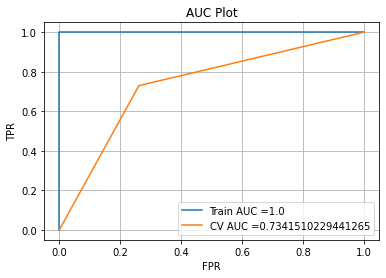

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


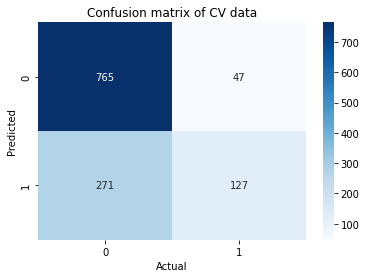

----------------------------------------------------------------------------------------
Depth:  20 Min sample split 50
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



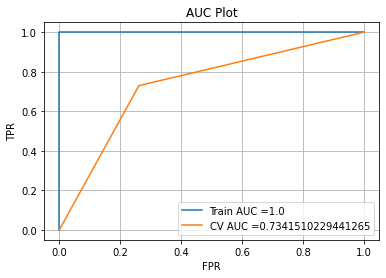

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


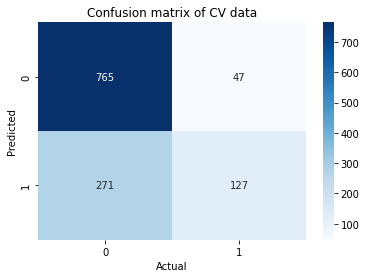

----------------------------------------------------------------------------------------
Depth:  20 Min sample split 100
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



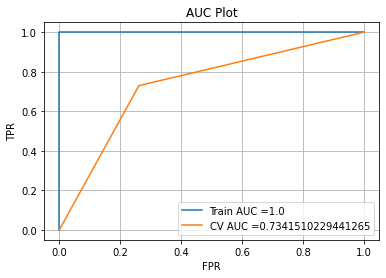

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


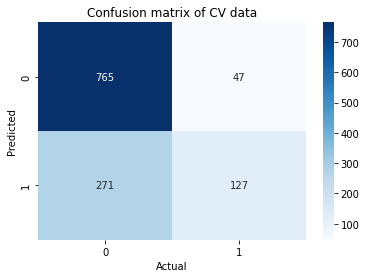

----------------------------------------------------------------------------------------
Depth:  30 Min sample split 10
Important Features
only_fraud_physician_count 0.9965236062201958
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



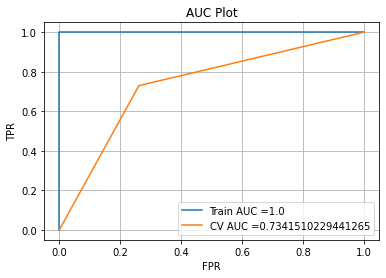

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


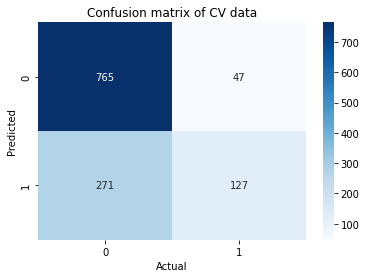

----------------------------------------------------------------------------------------
Depth:  30 Min sample split 20
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



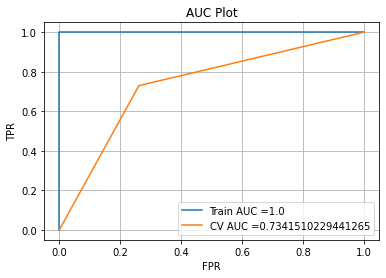

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


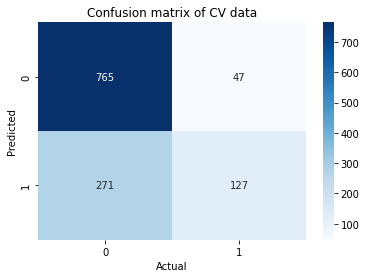

----------------------------------------------------------------------------------------
Depth:  30 Min sample split 50
Important Features
only_fraud_physician_count 0.9965236062201958
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



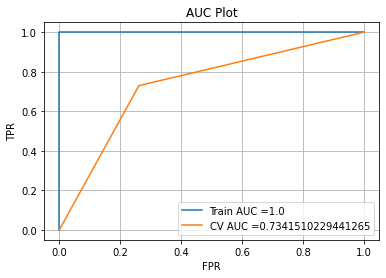

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


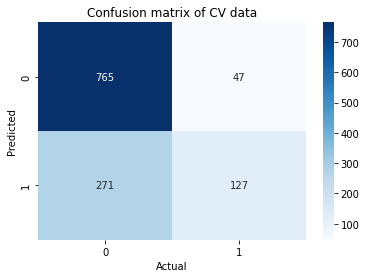

----------------------------------------------------------------------------------------
Depth:  30 Min sample split 100
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



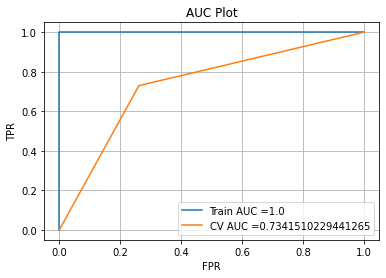

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


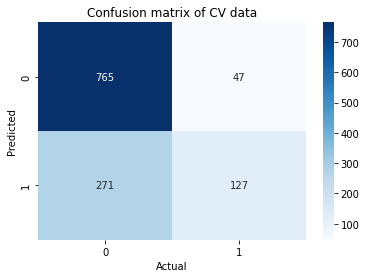

----------------------------------------------------------------------------------------
Depth:  50 Min sample split 10
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



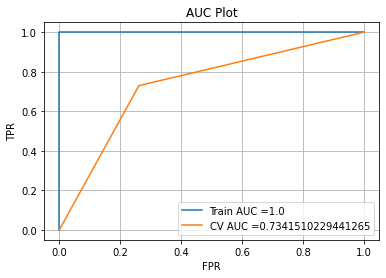

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


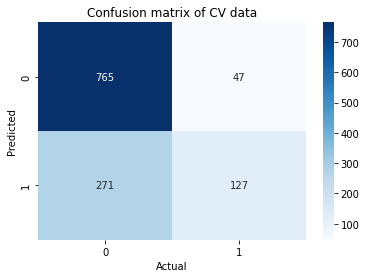

----------------------------------------------------------------------------------------
Depth:  50 Min sample split 20
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



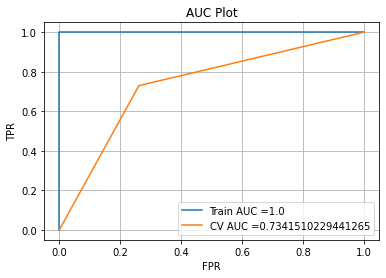

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


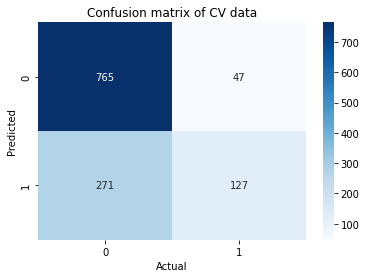

----------------------------------------------------------------------------------------
Depth:  50 Min sample split 50
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



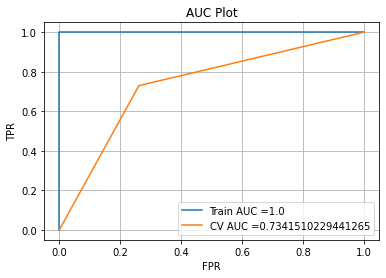

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


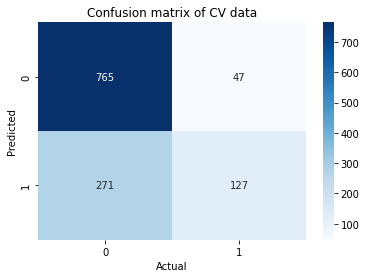

----------------------------------------------------------------------------------------
Depth:  50 Min sample split 100
Important Features
only_fraud_physician_count 0.996523606220196
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



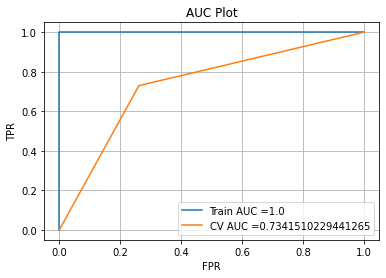

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


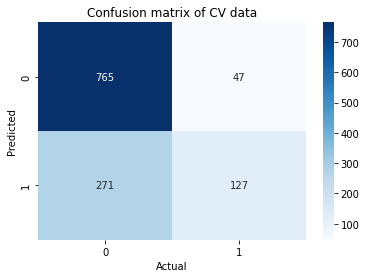

In [107]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:1,0:0.8})
        clf.fit(X_train_outpatient,y_train_outpatient.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth,"Min sample split",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_train_outpatient.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_train_outpatient)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.996972384476546
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



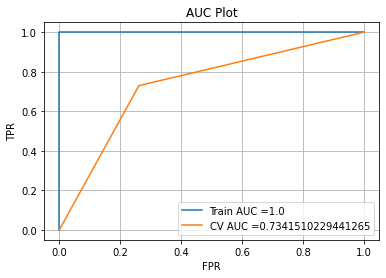

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


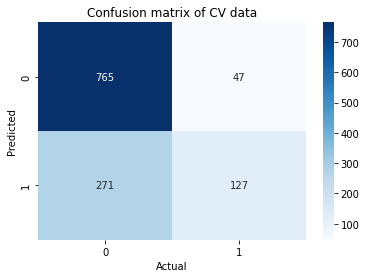

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



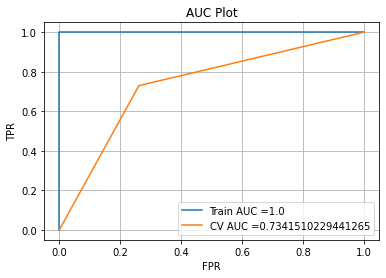

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


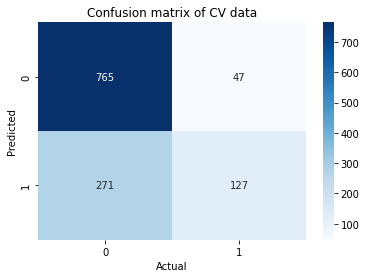

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



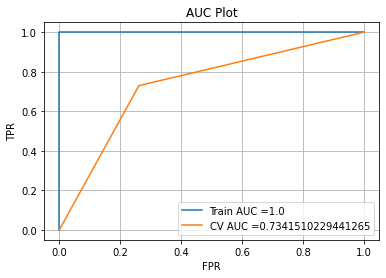

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


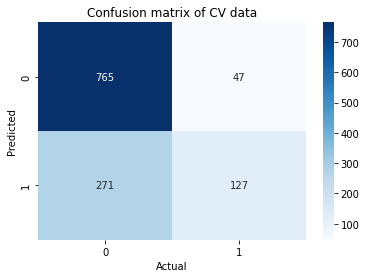

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



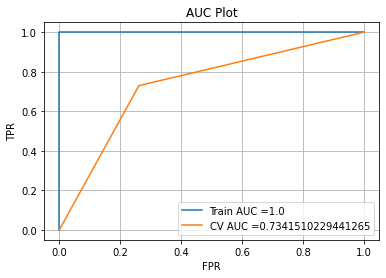

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


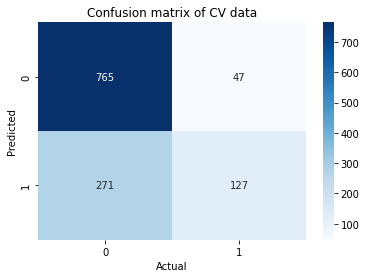

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



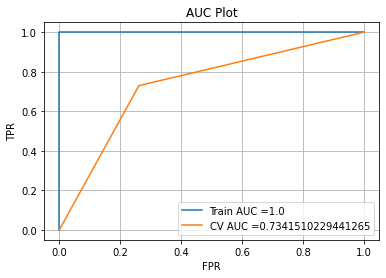

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


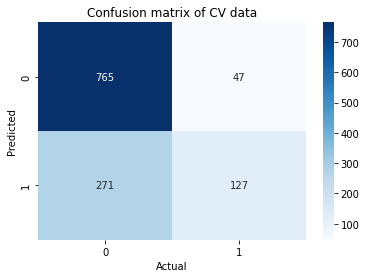

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



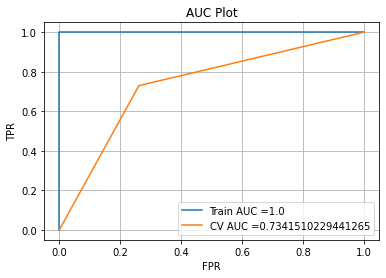

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


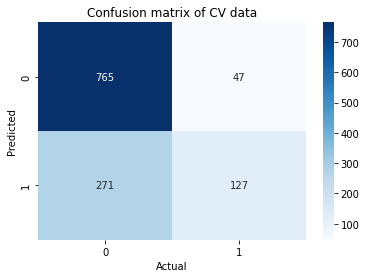

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



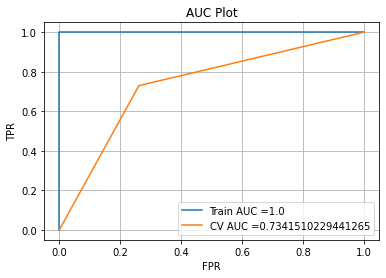

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


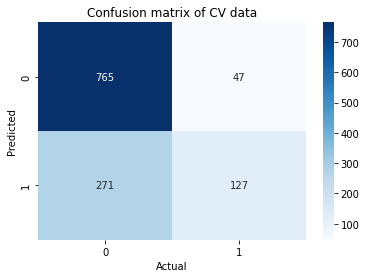

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



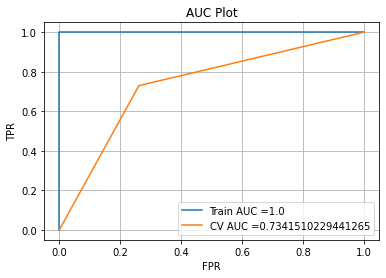

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


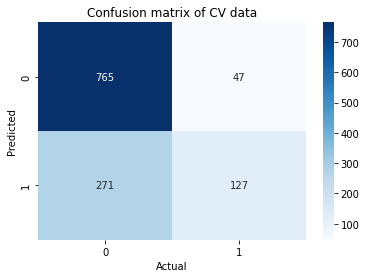

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



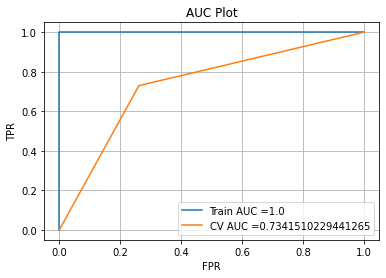

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


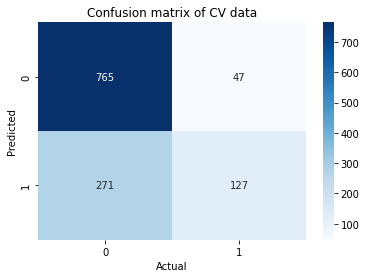

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



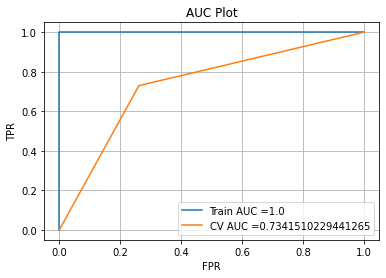

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


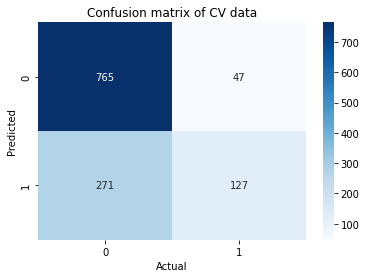

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.996972384476546
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



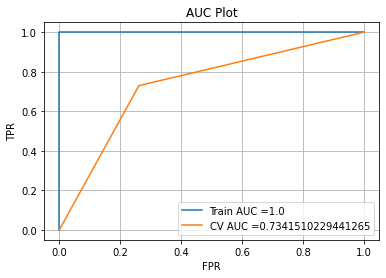

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


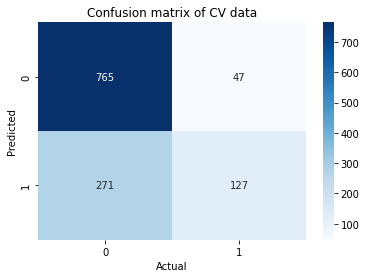

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



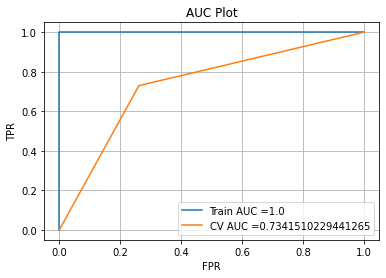

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


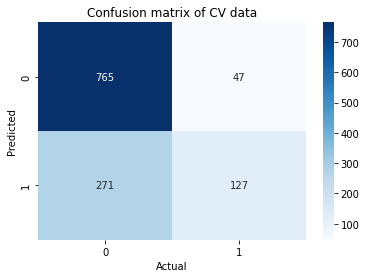

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



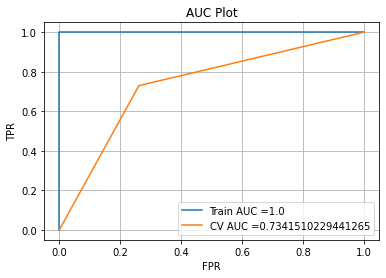

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


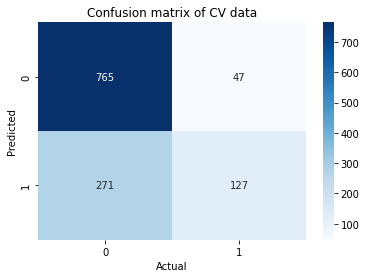

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9969723844765462
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



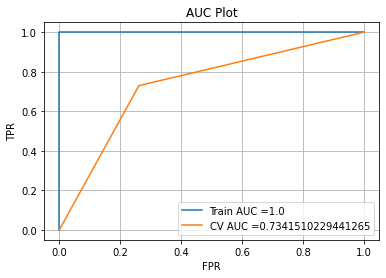

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


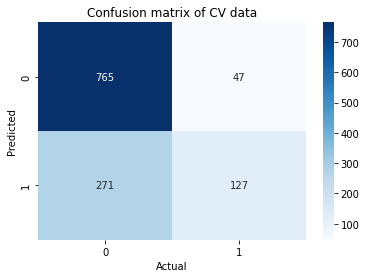

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9969723844765462
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



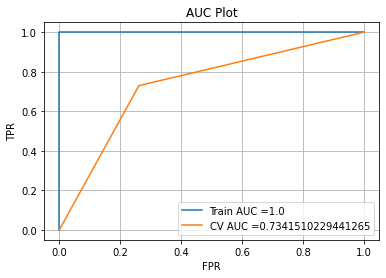

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


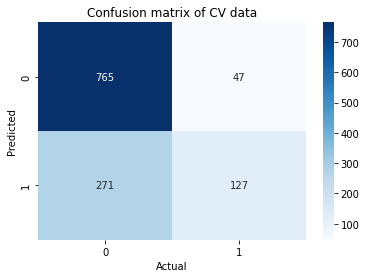

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



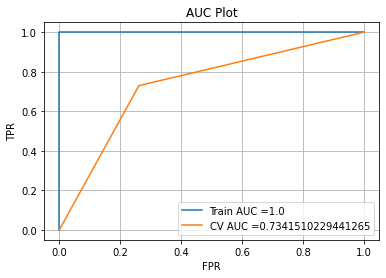

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


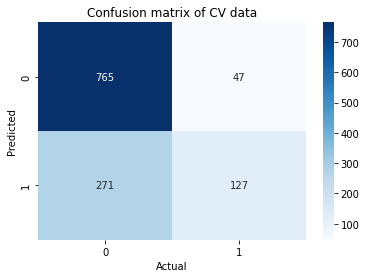

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



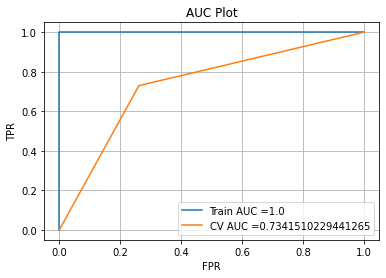

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


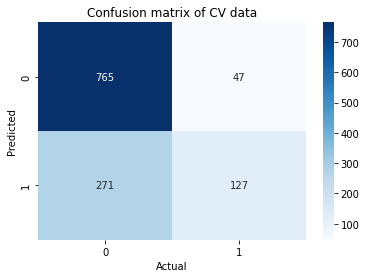

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



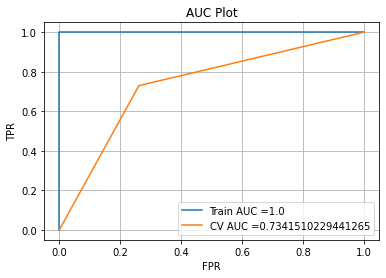

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


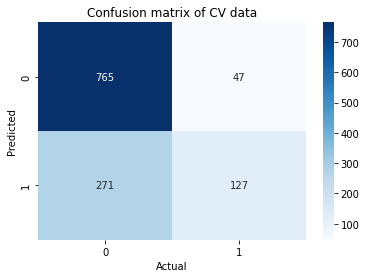

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9969723844765462
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



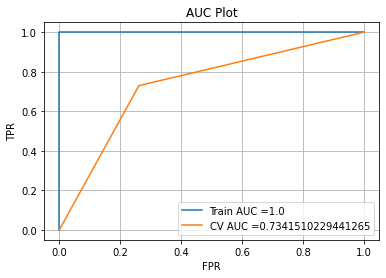

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


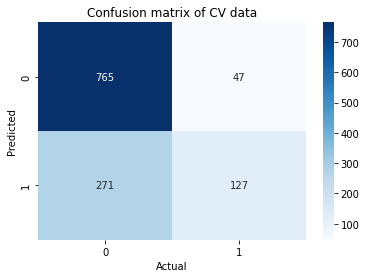

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9969723844765456
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



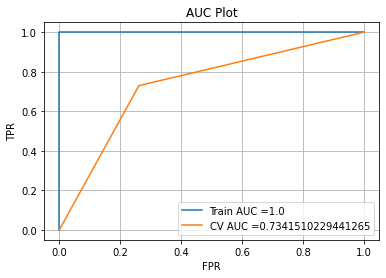

Cross validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


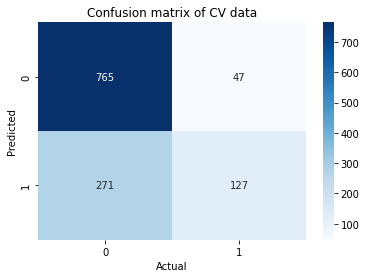

In [108]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split,class_weight={1:0.83,0:0.16})
        clf.fit(X_outpatient_50_50,y_outpatient_50_50.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_outpatient_50_50.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_50_50)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  5
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



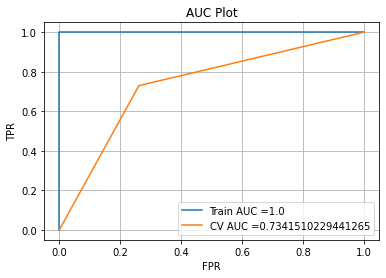

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


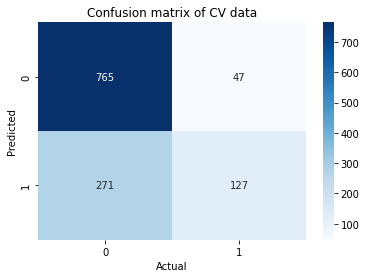

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



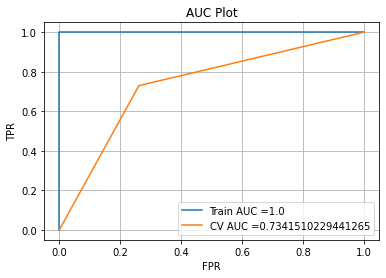

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


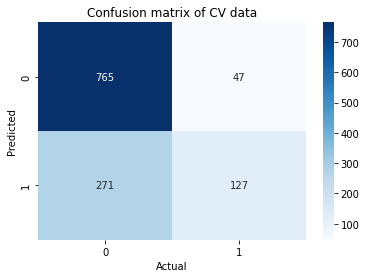

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



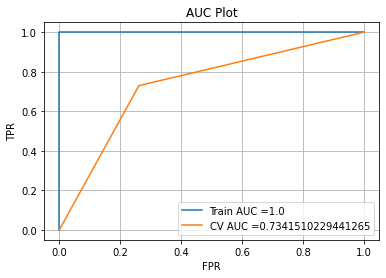

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


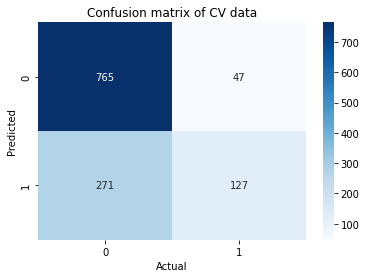

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



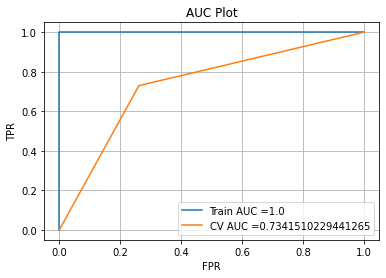

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


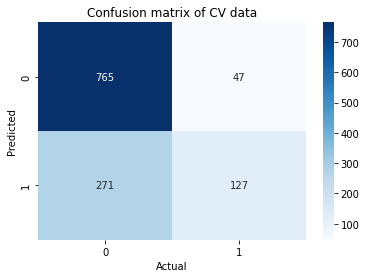

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



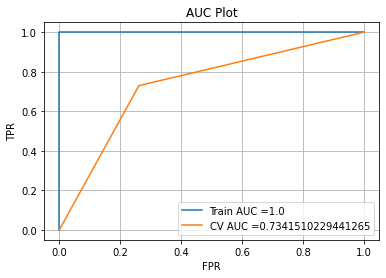

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


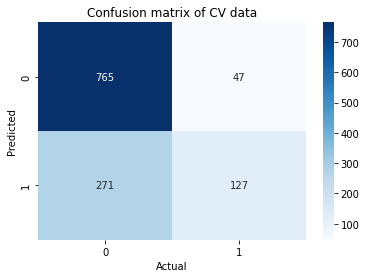

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  5
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



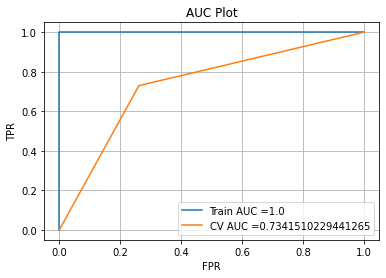

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


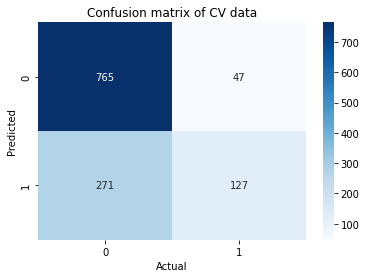

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



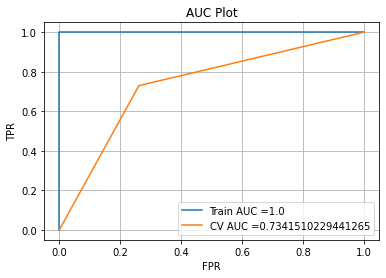

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


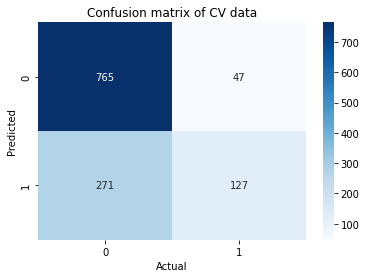

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



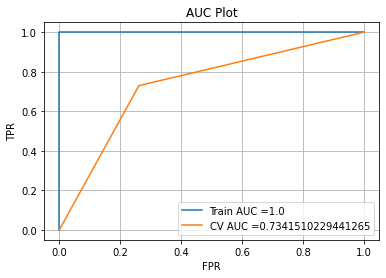

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


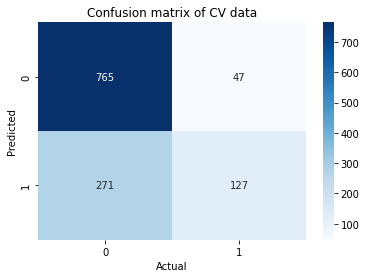

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



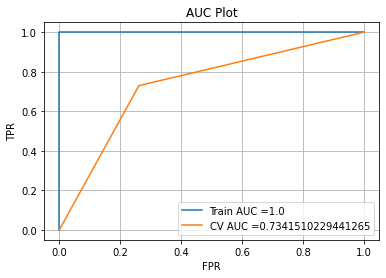

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


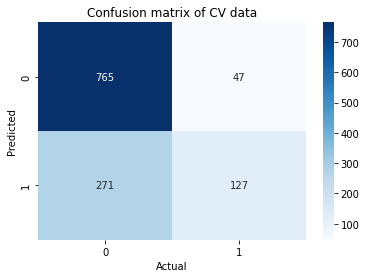

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



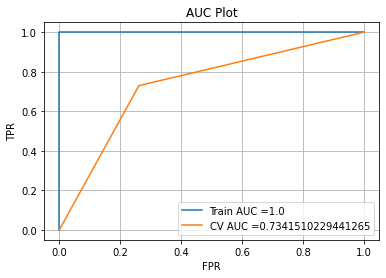

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


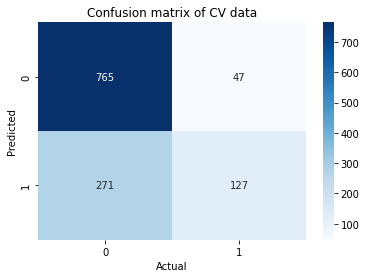

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  5
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



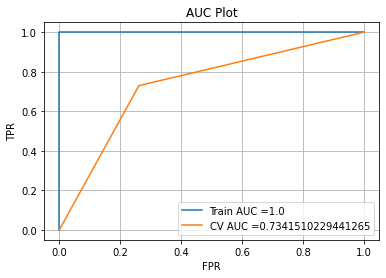

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


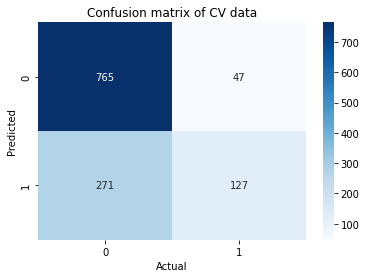

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



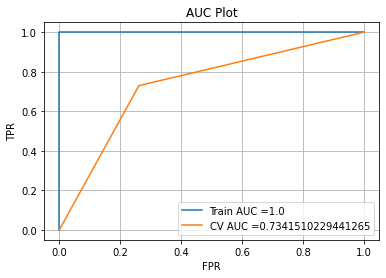

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


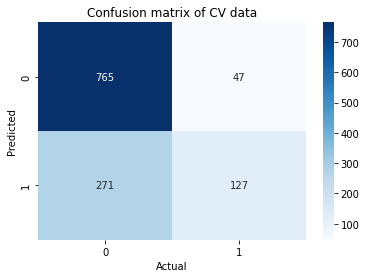

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



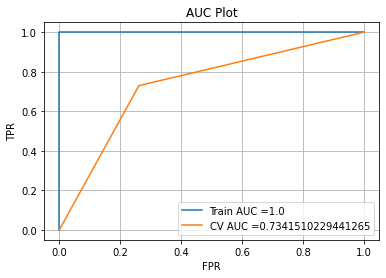

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


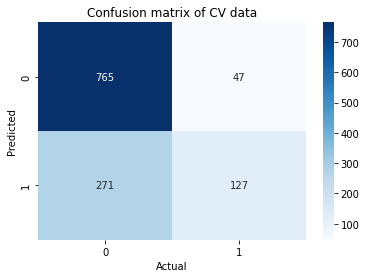

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



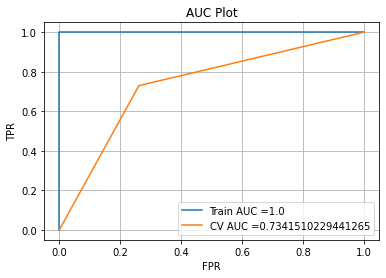

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


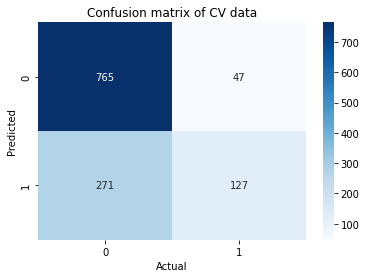

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



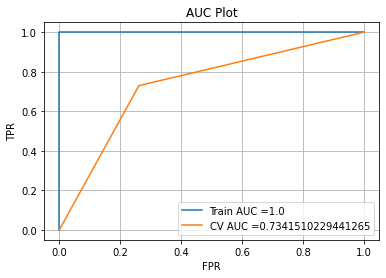

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


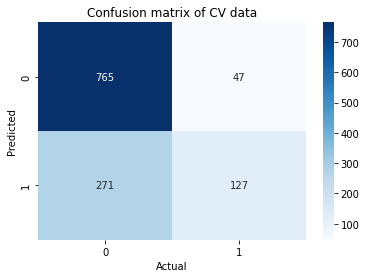

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  5
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



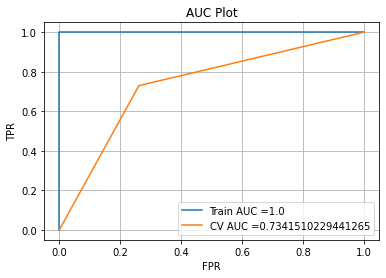

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


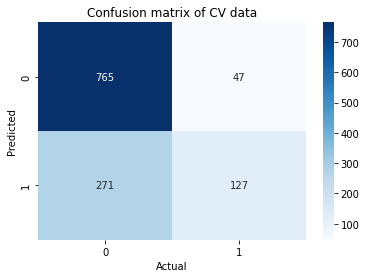

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



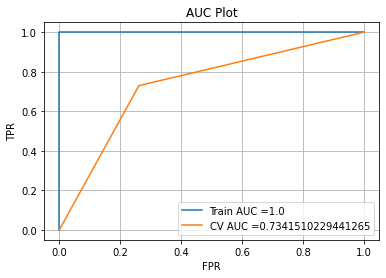

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


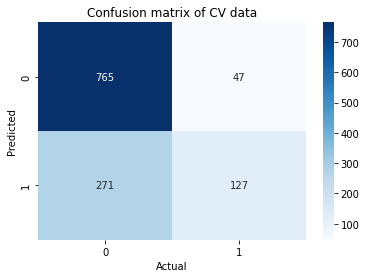

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



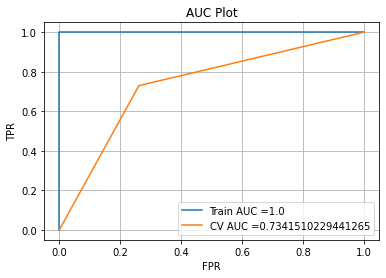

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


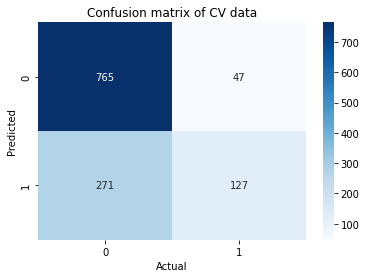

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



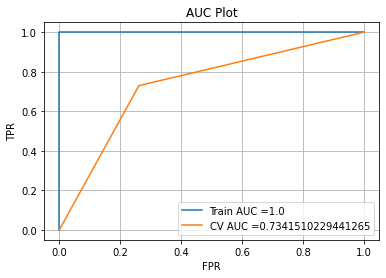

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


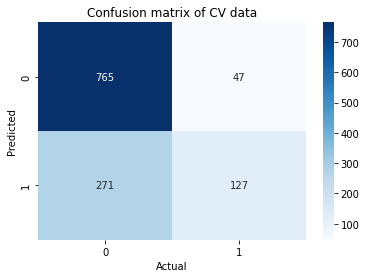

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



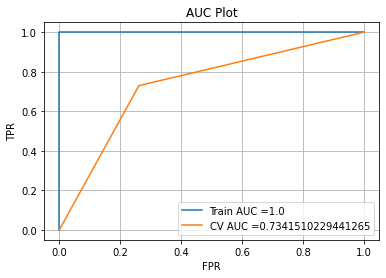

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


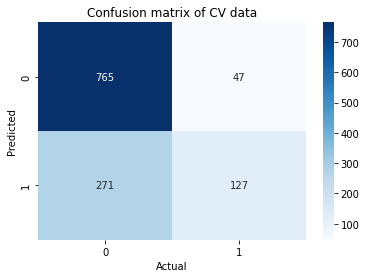

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  5
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



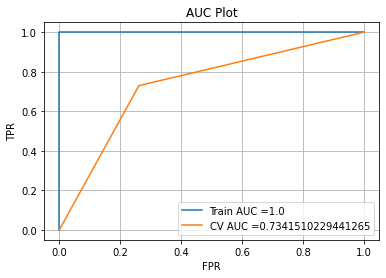

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


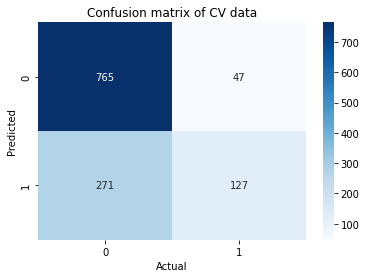

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



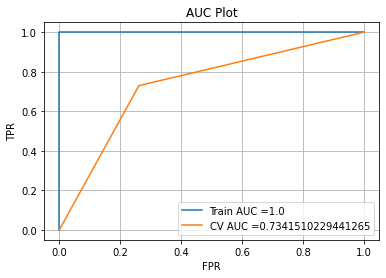

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


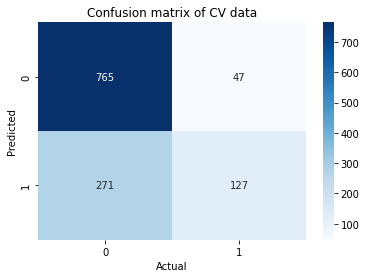

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



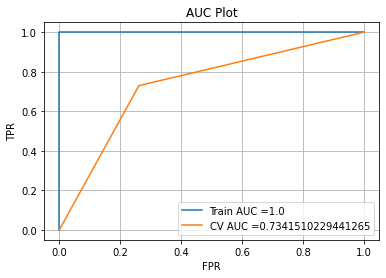

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


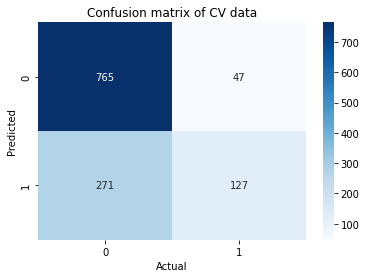

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



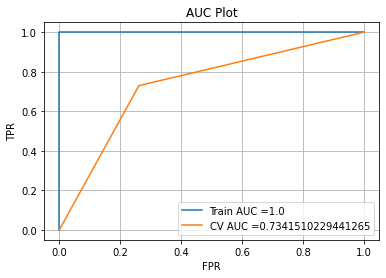

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


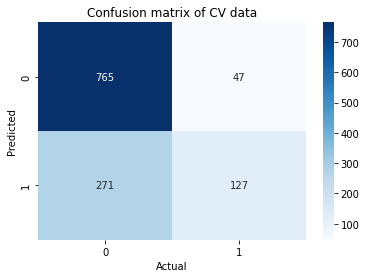

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9987777103415885
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



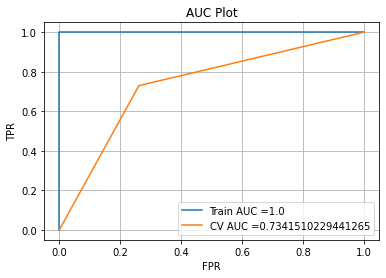

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


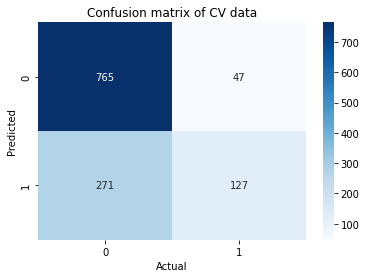

In [109]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [5,10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split)
        clf.fit(X_outpatient_60_40,y_outpatient_60_40.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_outpatient_60_40.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_60_40)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



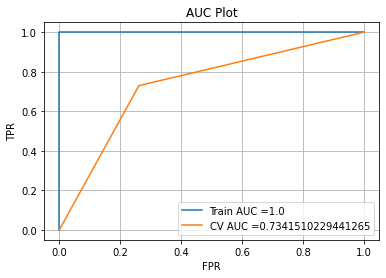

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


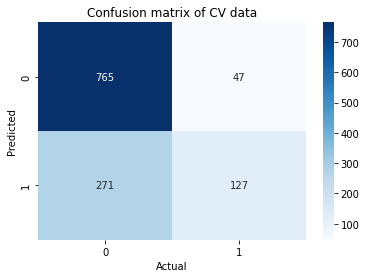

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



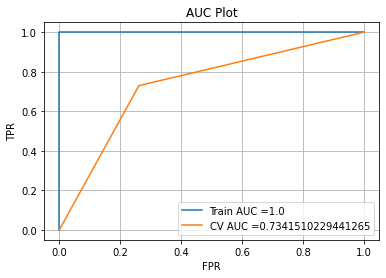

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


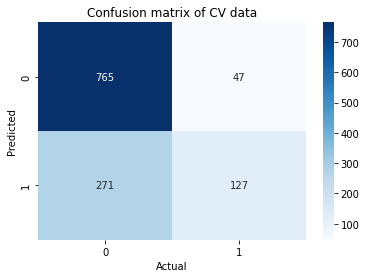

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



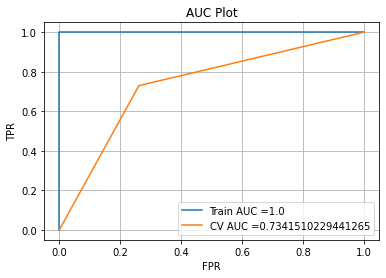

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


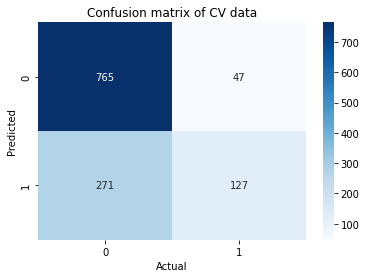

----------------------------------------------------------------------------------------
Depth:  5  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



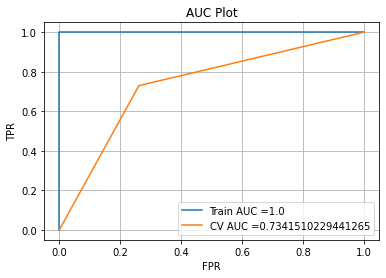

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


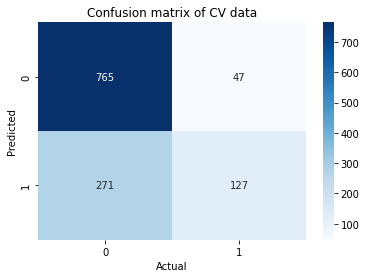

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



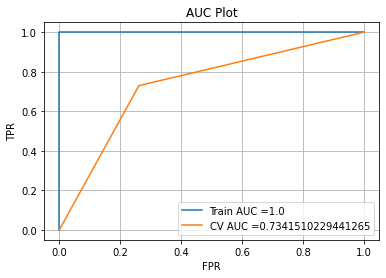

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


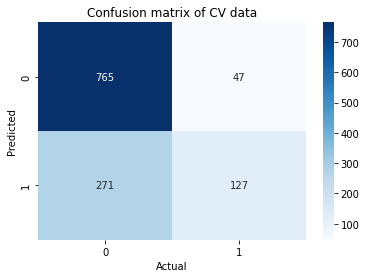

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



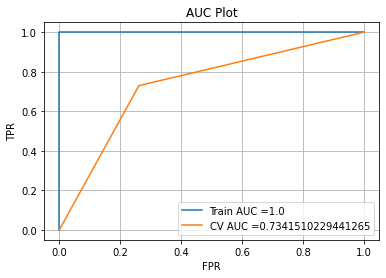

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


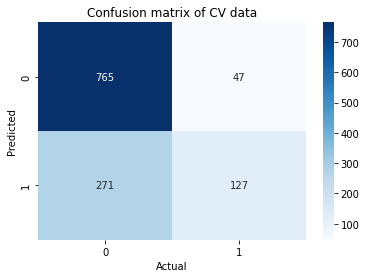

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



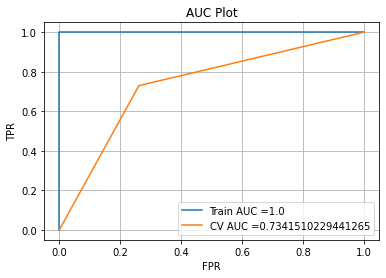

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


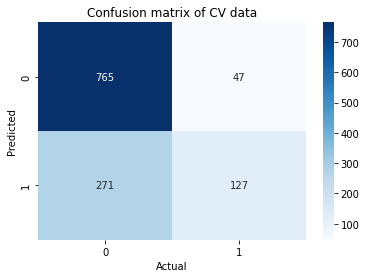

----------------------------------------------------------------------------------------
Depth:  10  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



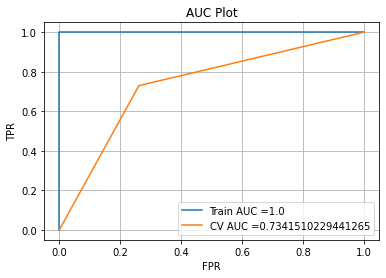

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


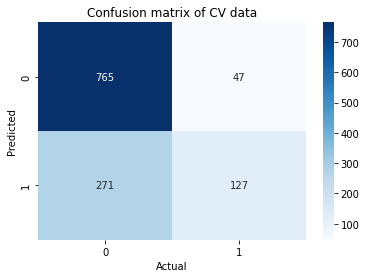

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



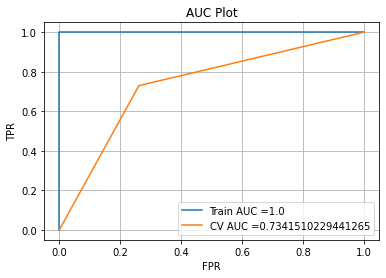

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


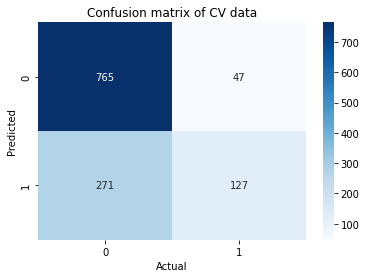

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



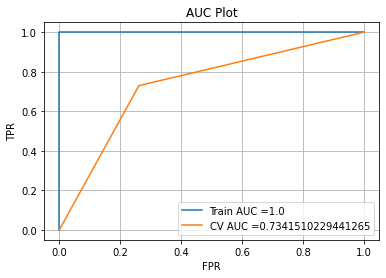

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


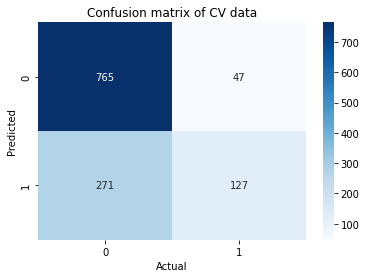

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



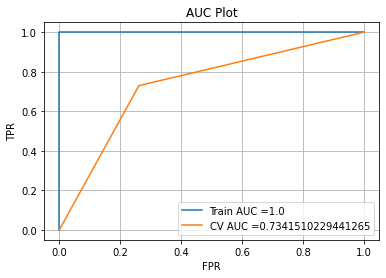

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


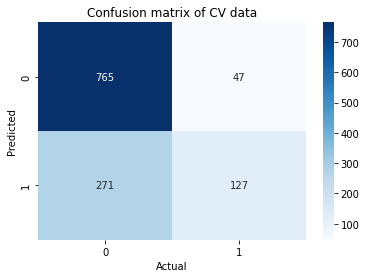

----------------------------------------------------------------------------------------
Depth:  20  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



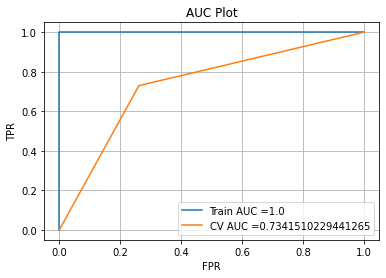

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


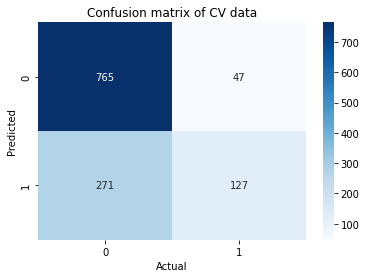

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



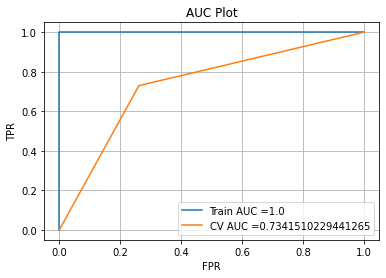

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


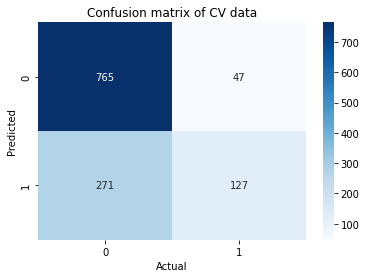

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



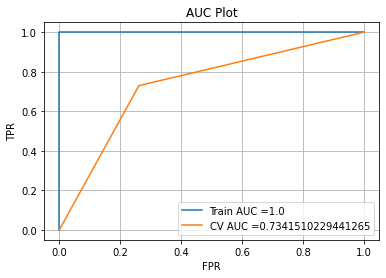

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


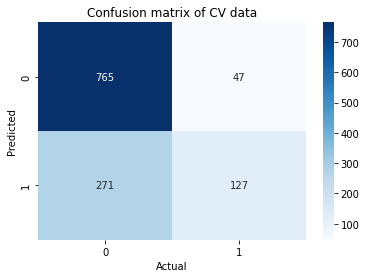

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



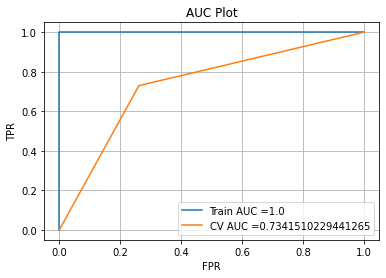

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


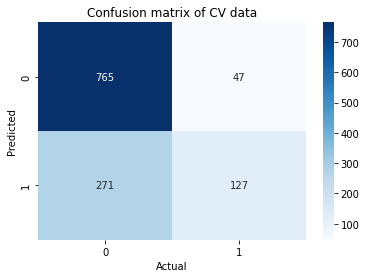

----------------------------------------------------------------------------------------
Depth:  30  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



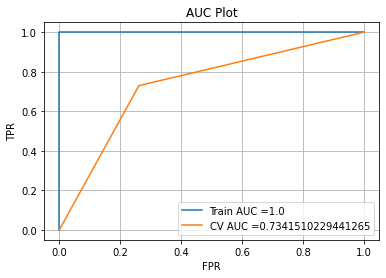

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


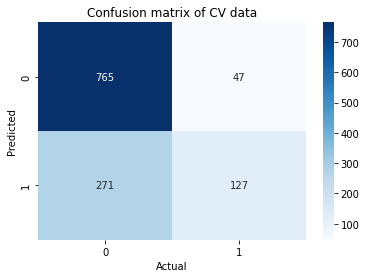

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  10
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



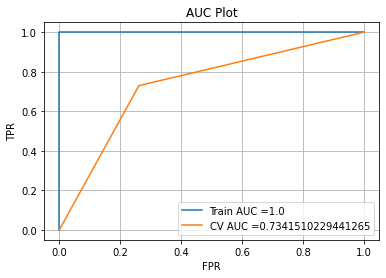

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


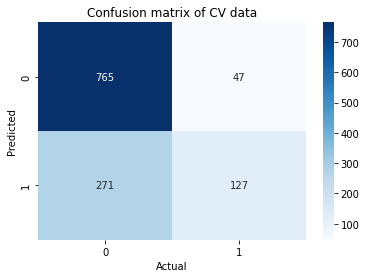

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  20
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



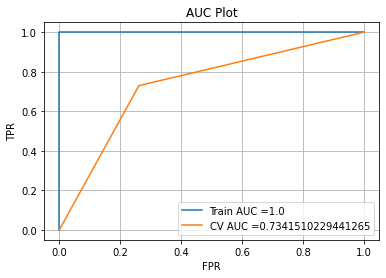

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


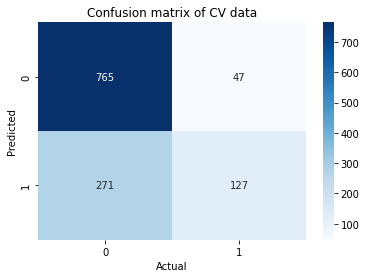

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  50
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



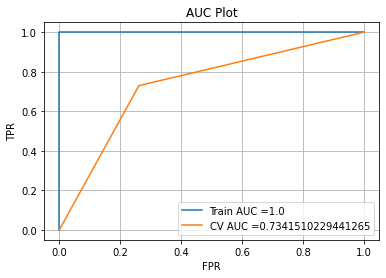

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


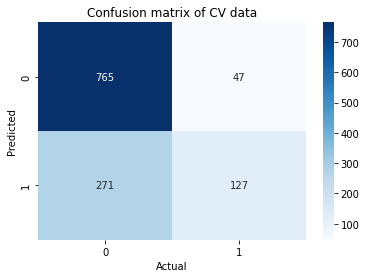

----------------------------------------------------------------------------------------
Depth:  50  min_samples_split:  100
Important Features
only_fraud_physician_count 0.9983693418364372
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.32      0.73      0.44       174

    accuracy                           0.74      1210
   macro avg       0.63      0.73      0.64      1210
weighted avg       0.85      0.74      0.77      1210



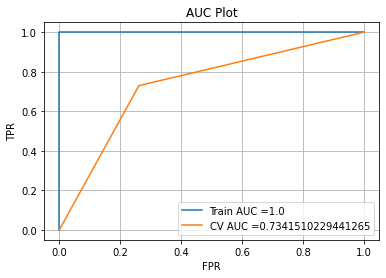

Cross Validation
FNR:0.27011494252873564 ,TPR:0.7298850574712644 ,FPR:0.26158301158301156 ,TNR:0.7384169884169884 


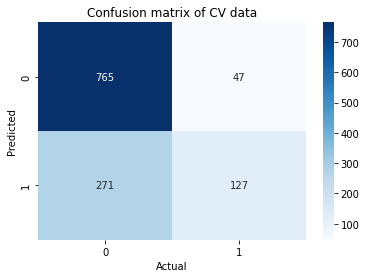

In [110]:
for depth in [5,10,20,30,50]:
    for min_samples_split in [10,20,50,100]:
        clf = DecisionTreeClassifier(max_depth=depth,min_samples_split=min_samples_split)
        clf.fit(X_outpatient_70_30,y_outpatient_70_30.values.ravel())
        y_pred = clf.predict(X_cv_outpatient)
        print("----------------------------------------------------------------------------------------")
        print("Depth: ", depth, " min_samples_split: ",min_samples_split)
        print("Important Features")
        for i,j in zip(list(X_outpatient_70_30.columns),clf.feature_importances_):
            if j > 0.05:
                print(i,j)
        print(classification_report(y_cv_outpatient,y_pred))
        y_train_pred = clf.predict(X_outpatient_70_30)
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30, y_train_pred)
        cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
        auc_score = auc(cv_fpr, cv_tpr)
        plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
        plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
        plt.legend()
        plt.xlabel("FPR")
        plt.ylabel("TPR")
        plt.title("AUC Plot")
        plt.grid()
        plt.show()
        plt.figure()
        cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
        tn, fp, fn, tp = cv_cm.ravel()
        print("Cross Validation")
        print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
        sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
        plt.title('Confusion matrix of CV data')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.show()

<h2>Logistic Regression</h2>

In [111]:
from sklearn.linear_model import LogisticRegression

Original Distribution

----------------------------------------------------------------------------------------
C:  0.01
Important Features
only_fraud_physician_count 0.2074862047014506
              precision    recall  f1-score   support

           0       0.86      0.99      0.92      1036
           1       0.06      0.01      0.01       174

    accuracy                           0.84      1210
   macro avg       0.46      0.50      0.46      1210
weighted avg       0.74      0.84      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      0.98      0.99       698

    accuracy                           1.00      4775
   macro avg       1.00      0.99      0.99      4775
weighted avg       1.00      1.00      1.00      4775



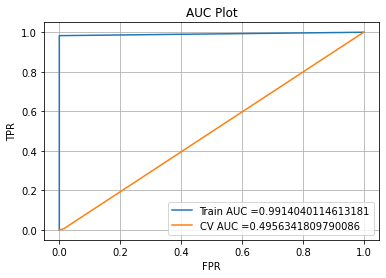

Cross Validation
FNR:0.9942528735632183 ,TPR:0.005747126436781609 ,FPR:0.01447876447876448 ,TNR:0.9855212355212355 


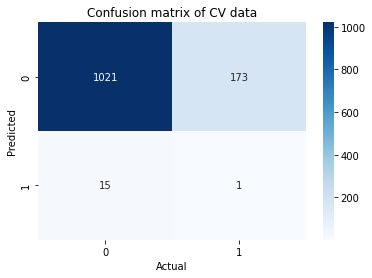

----------------------------------------------------------------------------------------
C:  0.1
Important Features
only_fraud_physician_count 0.20164714046220863
              precision    recall  f1-score   support

           0       0.86      0.99      0.92      1036
           1       0.08      0.01      0.01       174

    accuracy                           0.85      1210
   macro avg       0.47      0.50      0.46      1210
weighted avg       0.74      0.85      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      0.98      0.99       698

    accuracy                           1.00      4775
   macro avg       1.00      0.99      0.99      4775
weighted avg       1.00      1.00      1.00      4775



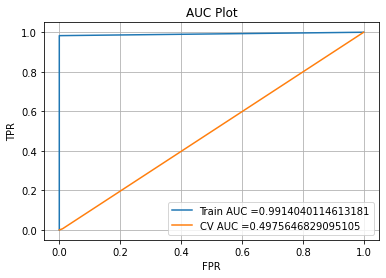

Cross Validation
FNR:0.9942528735632183 ,TPR:0.005747126436781609 ,FPR:0.010617760617760617 ,TNR:0.9893822393822393 


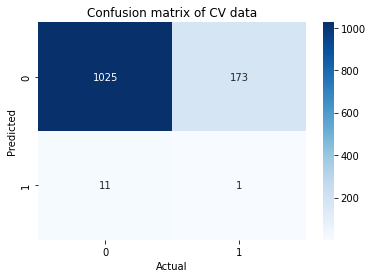

----------------------------------------------------------------------------------------
C:  1
Important Features
only_fraud_physician_count 0.20108163150869685
              precision    recall  f1-score   support

           0       0.85      0.99      0.92      1036
           1       0.00      0.00      0.00       174

    accuracy                           0.85      1210
   macro avg       0.43      0.50      0.46      1210
weighted avg       0.73      0.85      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      0.98      0.99       698

    accuracy                           1.00      4775
   macro avg       1.00      0.99      0.99      4775
weighted avg       1.00      1.00      1.00      4775



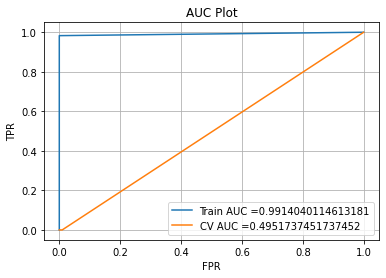

Cross Validation
FNR:1.0 ,TPR:0.0 ,FPR:0.009652509652509652 ,TNR:0.9903474903474904 


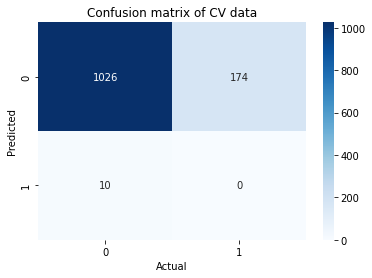

----------------------------------------------------------------------------------------
C:  10
Important Features
only_fraud_physician_count 0.2009858295542444
              precision    recall  f1-score   support

           0       0.85      0.99      0.92      1036
           1       0.00      0.00      0.00       174

    accuracy                           0.85      1210
   macro avg       0.43      0.50      0.46      1210
weighted avg       0.73      0.85      0.79      1210

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4077
           1       1.00      0.98      0.99       698

    accuracy                           1.00      4775
   macro avg       1.00      0.99      0.99      4775
weighted avg       1.00      1.00      1.00      4775



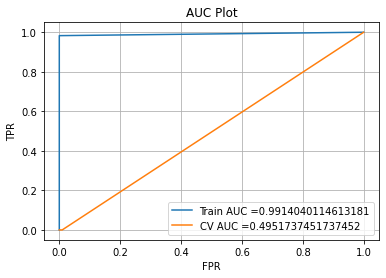

Cross Validation
FNR:1.0 ,TPR:0.0 ,FPR:0.009652509652509652 ,TNR:0.9903474903474904 


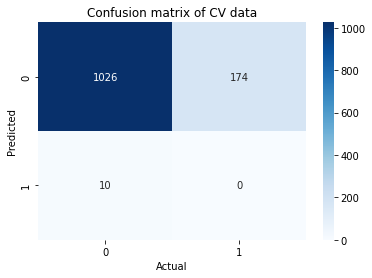

In [112]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:1.8,0:0.1})
    clf.fit(X_train_outpatient,y_train_outpatient.values.ravel())
    y_pred = clf.predict(X_cv_outpatient)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_train_outpatient.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_train_outpatient)
    print(classification_report(y_train_outpatient,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
              precision    recall  f1-score   support

           0       0.83      0.75      0.79      1036
           1       0.03      0.05      0.04       174

    accuracy                           0.65      1210
   macro avg       0.43      0.40      0.41      1210
weighted avg       0.71      0.65      0.68      1210

              precision    recall  f1-score   support

           0       1.00      0.79      0.88      4077
           1       0.82      1.00      0.90      4077

    accuracy                           0.89      8154
   macro avg       0.91      0.89      0.89      8154
weighted avg       0.91      0.89      0.89      8154



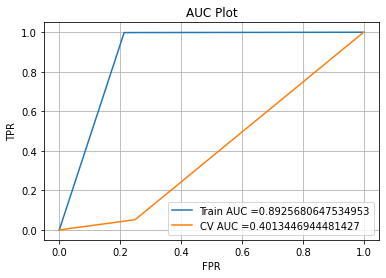

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.24903474903474904 ,TNR:0.750965250965251 


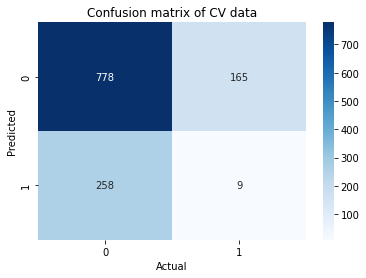

----------------------------------------------------------------------------------------
C:  0.1
Important Features
              precision    recall  f1-score   support

           0       0.83      0.75      0.79      1036
           1       0.03      0.05      0.04       174

    accuracy                           0.65      1210
   macro avg       0.43      0.40      0.41      1210
weighted avg       0.71      0.65      0.68      1210

              precision    recall  f1-score   support

           0       1.00      0.79      0.88      4077
           1       0.82      1.00      0.90      4077

    accuracy                           0.89      8154
   macro avg       0.91      0.89      0.89      8154
weighted avg       0.91      0.89      0.89      8154



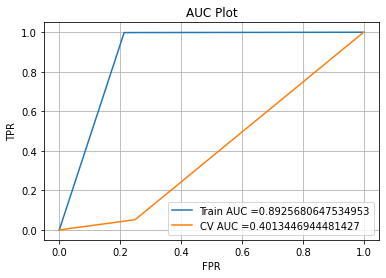

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.24903474903474904 ,TNR:0.750965250965251 


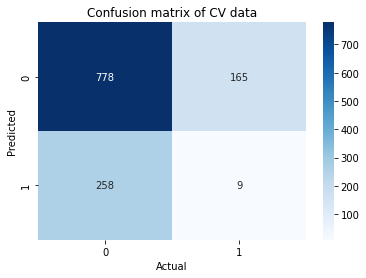

----------------------------------------------------------------------------------------
C:  1
Important Features
              precision    recall  f1-score   support

           0       0.83      0.75      0.79      1036
           1       0.03      0.05      0.04       174

    accuracy                           0.65      1210
   macro avg       0.43      0.40      0.41      1210
weighted avg       0.71      0.65      0.68      1210

              precision    recall  f1-score   support

           0       1.00      0.79      0.88      4077
           1       0.82      1.00      0.90      4077

    accuracy                           0.89      8154
   macro avg       0.91      0.89      0.89      8154
weighted avg       0.91      0.89      0.89      8154



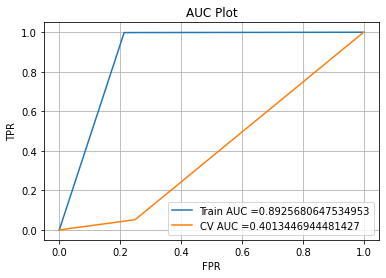

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.24903474903474904 ,TNR:0.750965250965251 


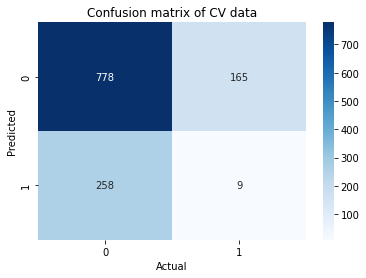

----------------------------------------------------------------------------------------
C:  10
Important Features
              precision    recall  f1-score   support

           0       0.83      0.75      0.79      1036
           1       0.03      0.05      0.04       174

    accuracy                           0.65      1210
   macro avg       0.43      0.40      0.41      1210
weighted avg       0.71      0.65      0.68      1210

              precision    recall  f1-score   support

           0       1.00      0.79      0.88      4077
           1       0.82      1.00      0.90      4077

    accuracy                           0.89      8154
   macro avg       0.91      0.89      0.89      8154
weighted avg       0.91      0.89      0.89      8154



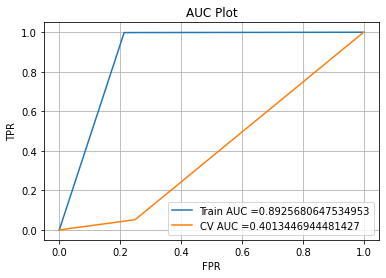

Cross Validation
FNR:0.9482758620689655 ,TPR:0.05172413793103448 ,FPR:0.24903474903474904 ,TNR:0.750965250965251 


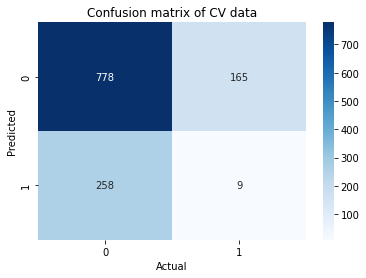

In [113]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:1.8,0:0.35})
    clf.fit(X_outpatient_50_50,y_outpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_outpatient_50_50.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_50_50)
    print(classification_report(y_outpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
InscClaimAmtReimbursed_avg 0.10369210145582379
only_fraud_code_count 0.795281713855281
only_fraud_procedure_code_count 0.21261867120424358
only_fraud_physician_count 1.0315316095242533
only_fraud_op_physician_count 1.0688328128238433
alive_count 0.0851748493301992
Doctor 0.7316755244416309
County_1 0.08586650510759271
County_3 0.12330924014308868
County_8 0.06004381011463342
County_28 0.062498828919374076
County_29 0.0715153647413491
County_37 0.14680190607264776
              precision    recall  f1-score   support

           0       0.87      0.42      0.57      1036
           1       0.15      0.62      0.24       174

    accuracy                           0.45      1210
   macro avg       0.51      0.52      0.41      1210
weighted avg       0.77      0.45      0.52      1210

              precision    recall  f1-score   support

           0       0.99      0.49

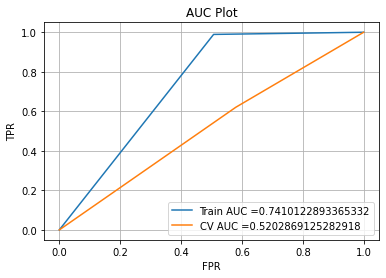

Cross Validation
FNR:0.3793103448275862 ,TPR:0.6206896551724138 ,FPR:0.5801158301158301 ,TNR:0.4198841698841699 


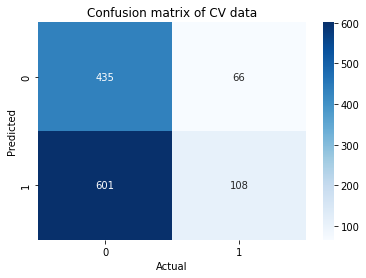

----------------------------------------------------------------------------------------
C:  0.1
Important Features
InscClaimAmtReimbursed_avg 0.32053622557332245
Race_3 0.10898958958790092
Race_5 0.05887943153251578
only_fraud_code_count 2.3575633520389725
only_fraud_procedure_code_count 0.3295249013982852
only_fraud_physician_count 3.947544283207383
only_fraud_op_physician_count 4.101303661703636
Doctor 1.2804038207774922
County_3 0.08804028805586982
County_6 0.05433548336732227
County_8 0.3145859208248096
County_13 0.052490860495177635
County_17 0.08290807597246631
County_26 0.05909874767723415
County_29 0.20938298182999537
County_35 0.06851302306967218
County_36 0.13639888354291022
County_37 0.41037412518490346
ChronicCond_ObstrPulmonary_1 0.051368639623007584
ChronicCond_stroke_1 0.07022342585421162
              precision    recall  f1-score   support

           0       0.85      0.77      0.81      1036
           1       0.13      0.20      0.16       174

    accuracy        

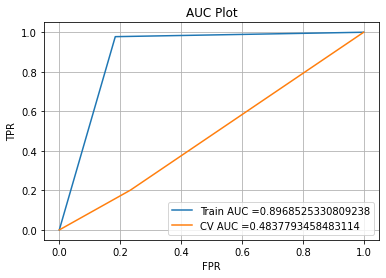

Cross Validation
FNR:0.7988505747126436 ,TPR:0.20114942528735633 ,FPR:0.2335907335907336 ,TNR:0.7664092664092664 


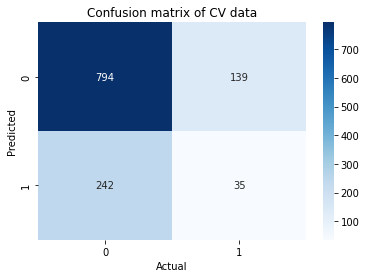

----------------------------------------------------------------------------------------
C:  1
Important Features
InscClaimAmtReimbursed_avg 0.4639532661113578
Race_3 0.4828845050317479
Race_5 0.24037229609902014
only_fraud_code_count 5.365930500629514
only_fraud_procedure_code_count 0.38697308869671126
only_fraud_physician_count 12.902738568638863
only_fraud_op_physician_count 12.563625356206405
alive_count 0.05175146561033113
Doctor 2.32665965805686
County_8 0.9910412453687454
County_9 0.3593719832374434
County_13 0.40609992935215394
County_17 0.8420715447553403
County_19 0.3975839401693277
County_29 0.3573848366206431
County_35 0.057614797526020285
County_36 0.23114612628985554
County_37 0.7480616613821537
              precision    recall  f1-score   support

           0       0.86      0.92      0.89      1036
           1       0.17      0.10      0.12       174

    accuracy                           0.80      1210
   macro avg       0.52      0.51      0.51      1210
weighted 

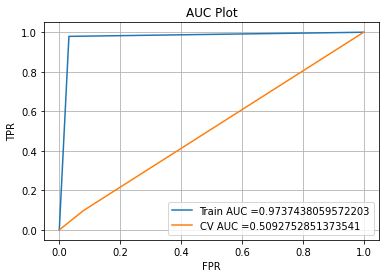

Cross Validation
FNR:0.9022988505747126 ,TPR:0.09770114942528736 ,FPR:0.07915057915057915 ,TNR:0.9208494208494209 


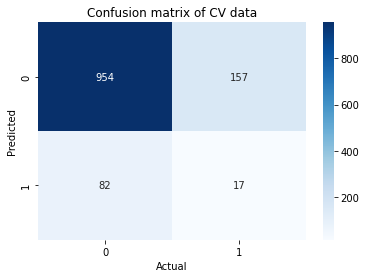

----------------------------------------------------------------------------------------
C:  10
Important Features
InscClaimAmtReimbursed_total 0.6296234056313343
InscClaimAmtReimbursed_avg 0.22031107093281388
Gender_0 0.5962445979929364
Race_2 0.5693471924326662
Race_3 2.72135736867325
Race_5 1.1752675852465313
only_fraud_code_count 9.776484340802119
only_fraud_procedure_code_count 0.6105733919290042
only_fraud_physician_count 38.64721539835053
only_fraud_op_physician_count 31.546580120093697
alive_count 0.07947342695658309
Doctor 3.471061337802903
County_8 2.438388084150978
County_9 2.1397769468253327
County_10 0.22323099908904867
County_11 0.3024262143211021
County_13 1.919077698352792
County_17 2.100556825206042
County_19 1.0217361584427793
County_23 0.48007830162296217
County_29 0.29145941088724997
County_35 1.0152469637926758
County_36 0.12065367376462677
Diagnosis_2 0.13055158378829354
Diagnosis_4 0.1305515837887858
Diagnosis_5 0.13055158378828652
Diagnosis_6 0.1305515837881677


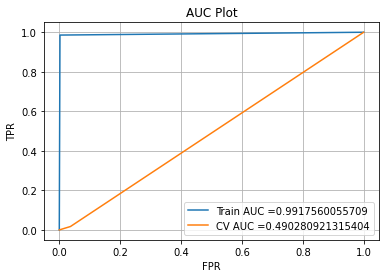

Cross Validation
FNR:0.9827586206896551 ,TPR:0.017241379310344827 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


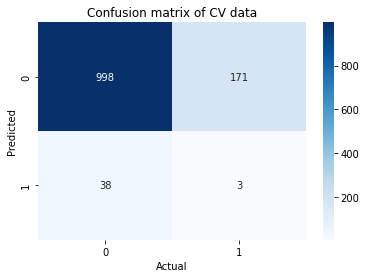

In [114]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:1.7,0:0.28})
    clf.fit(X_outpatient_60_40_sd,y_outpatient_60_40_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_outpatient_60_40.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_60_40_sd)
    print(classification_report(y_outpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
C:  0.01
Important Features
InscClaimAmtReimbursed_avg 0.0664506041270585
only_fraud_code_count 0.49820949987414387
only_fraud_procedure_code_count 0.1638253544199452
only_fraud_physician_count 0.5733210495866807
only_fraud_op_physician_count 0.5874297524413525
alive_count 0.09073491099517532
Doctor 0.5241776938931011
County_3 0.09780601457346322
County_28 0.052243671034601924
County_37 0.09077847166621303
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.72      0.41       174

    accuracy                           0.70      1210
   macro avg       0.61      0.71      0.61      1210
weighted avg       0.84      0.70      0.75      1210

              precision    recall  f1-score   support

           0       0.95      0.74      0.83      4077
           1       0.60      0.91      0.72      1753

    accura

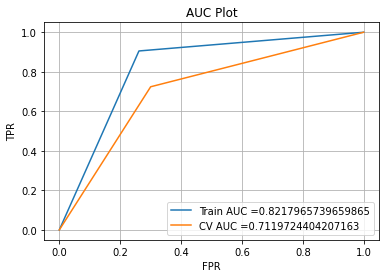

Cross Validation
FNR:0.27586206896551724 ,TPR:0.7241379310344828 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


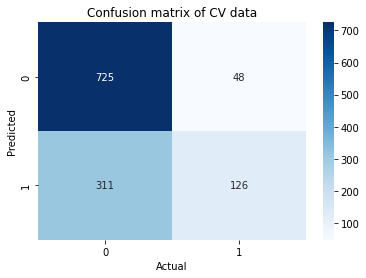

----------------------------------------------------------------------------------------
C:  0.1
Important Features
InscClaimAmtReimbursed_avg 0.210428736103143
Race_3 0.06410422899039996
Race_5 0.06888242456135912
only_fraud_code_count 1.7105717965512919
only_fraud_procedure_code_count 0.3042217145840588
only_fraud_physician_count 2.3992504017240246
only_fraud_op_physician_count 2.4963854831295653
alive_count 0.07208494041665715
Doctor 1.0139329058395705
County_1 0.05578608071919315
County_3 0.14748688190303097
County_8 0.18723781006510973
County_13 0.06365684798235378
County_26 0.0548452595743473
County_29 0.11932861761343443
County_36 0.09004597363060897
County_37 0.2376485236674596
ChronicCond_ObstrPulmonary_1 0.059808098282218836
              precision    recall  f1-score   support

           0       0.87      0.85      0.86      1036
           1       0.23      0.25      0.24       174

    accuracy                           0.77      1210
   macro avg       0.55      0.55    

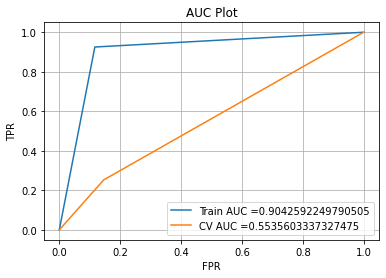

Cross Validation
FNR:0.7471264367816092 ,TPR:0.25287356321839083 ,FPR:0.14575289575289574 ,TNR:0.8542471042471043 


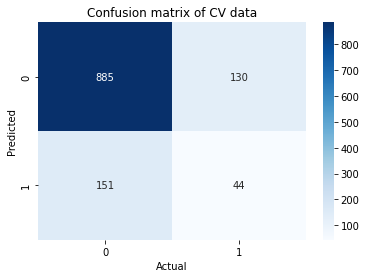

----------------------------------------------------------------------------------------
C:  1
Important Features
InscClaimAmtReimbursed_avg 0.4457050008741223
Race_3 0.16552512584747914
Race_5 0.2238900291516179
only_fraud_code_count 4.205546482388643
only_fraud_procedure_code_count 0.3576552164085819
only_fraud_physician_count 8.224520739367595
only_fraud_op_physician_count 8.384694504532531
alive_count 0.08776268594992634
Doctor 1.8272172157712678
County_6 0.06650720274060014
County_8 0.6778096896708079
County_9 0.10733464388433889
County_13 0.20802643089863243
County_17 0.5316088968376332
County_18 0.06620652296112538
County_19 0.07923804796083762
County_26 0.055846075955235386
County_29 0.27300183998931893
County_35 0.061576128631412465
County_36 0.20531955529441281
County_37 0.5751485747306248
ChronicCond_ObstrPulmonary_1 0.14430763261278504
              precision    recall  f1-score   support

           0       0.86      0.94      0.90      1036
           1       0.20      0.

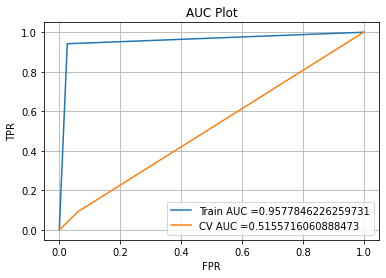

Cross Validation
FNR:0.9080459770114943 ,TPR:0.09195402298850575 ,FPR:0.060810810810810814 ,TNR:0.9391891891891891 


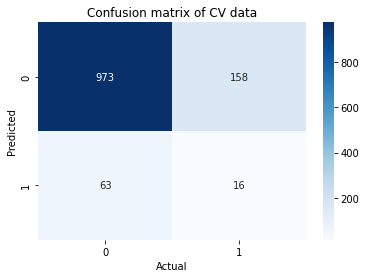

----------------------------------------------------------------------------------------
C:  10
Important Features
InscClaimAmtReimbursed_avg 0.37335584196668115
Race_3 0.977324877372408
Race_5 0.3649802010599693
only_fraud_code_count 8.344657809012133
only_fraud_procedure_code_count 0.4668373808480986
only_fraud_physician_count 25.041771116639598
only_fraud_op_physician_count 22.677273314243116
alive_count 0.21403081967878734
Doctor 3.3438680839221027
County_8 1.50460793845675
County_9 1.0510959968628528
County_13 1.2303116679992268
County_17 2.22419710111306
County_19 0.702752137424712
County_28 0.08573697816719883
County_29 0.34820746881128556
County_35 0.3051574671392957
County_36 0.09155199234481703
County_37 0.8026025342913501
Diagnosis_2 0.07723433094285584
Diagnosis_4 0.07723433094299956
Diagnosis_5 0.07723433094277266
Diagnosis_6 0.0772343309428843
RenalDiseaseIndicator_1 0.39071495686251473
              precision    recall  f1-score   support

           0       0.85      0.

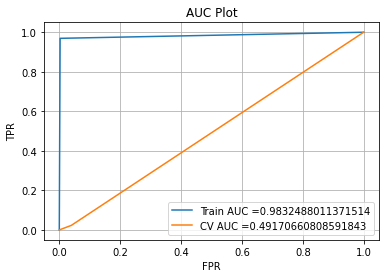

Cross Validation
FNR:0.9770114942528736 ,TPR:0.022988505747126436 ,FPR:0.03957528957528957 ,TNR:0.9604247104247104 


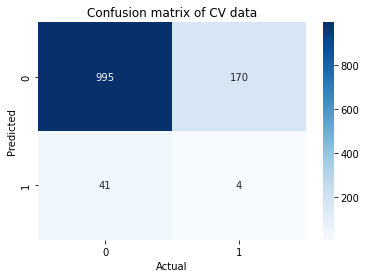

In [115]:
for hyperparameter in [0.01,0.1,1,10]:
    clf = LogisticRegression(C=hyperparameter,solver='liblinear',class_weight={1:0.9,0:0.13})
    clf.fit(X_outpatient_70_30_sd,y_outpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("C: ",hyperparameter)
    print("Important Features")
    for i,j in zip(list(X_outpatient_70_30.columns),clf.coef_[0]):
        if j > 0.05:
            print(i,j)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_70_30_sd)
    print(classification_report(y_outpatient_70_30_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

<h2>Naive Bayes</h2>

In [116]:
from sklearn.naive_bayes import GaussianNB

Original Distribution

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      4077
           1       0.76      1.00      0.86       698

    accuracy                           0.95      4775
   macro avg       0.88      0.97      0.92      4775
weighted avg       0.96      0.95      0.96      4775



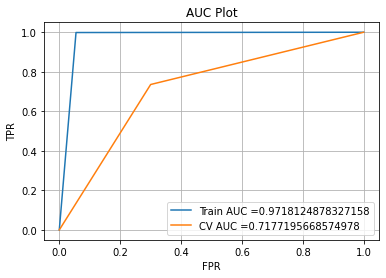

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


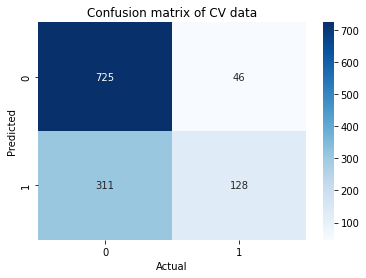

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      4077
           1       0.76      1.00      0.86       698

    accuracy                           0.95      4775
   macro avg       0.88      0.97      0.92      4775
weighted avg       0.96      0.95      0.96      4775



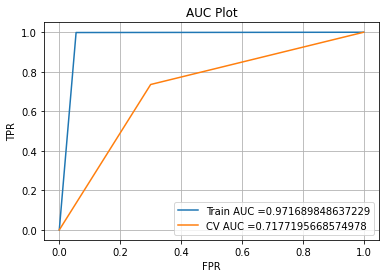

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


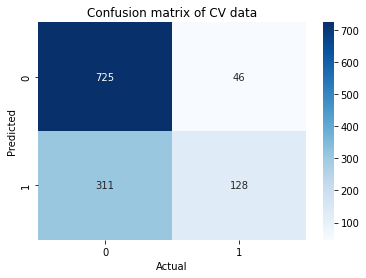

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.94      0.73      0.82      1036
           1       0.31      0.72      0.43       174

    accuracy                           0.73      1210
   macro avg       0.62      0.73      0.63      1210
weighted avg       0.85      0.73      0.77      1210

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      4077
           1       0.75      1.00      0.86       698

    accuracy                           0.95      4775
   macro avg       0.88      0.97      0.91      4775
weighted avg       0.96      0.95      0.95      4775



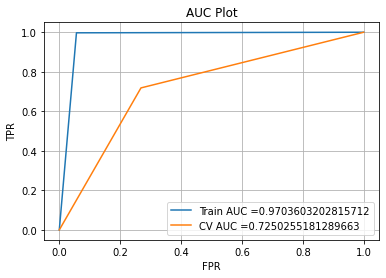

Cross Validation
FNR:0.28160919540229884 ,TPR:0.7183908045977011 ,FPR:0.26833976833976836 ,TNR:0.7316602316602316 


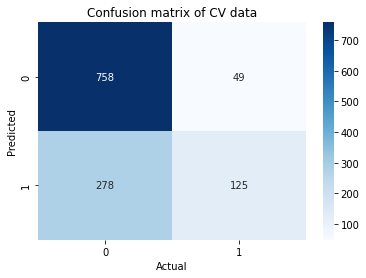

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.92      0.78      0.84      1036
           1       0.31      0.61      0.41       174

    accuracy                           0.75      1210
   macro avg       0.62      0.69      0.63      1210
weighted avg       0.83      0.75      0.78      1210

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      4077
           1       0.73      0.99      0.84       698

    accuracy                           0.94      4775
   macro avg       0.86      0.96      0.90      4775
weighted avg       0.96      0.94      0.95      4775



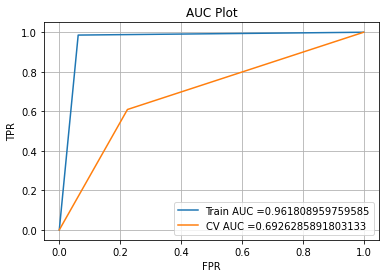

Cross Validation
FNR:0.39080459770114945 ,TPR:0.6091954022988506 ,FPR:0.22393822393822393 ,TNR:0.7760617760617761 


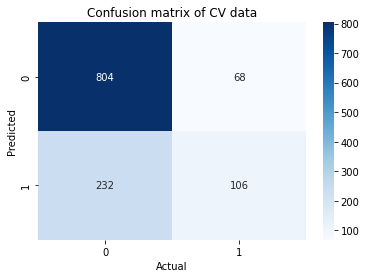

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.92      0.80      0.85      1036
           1       0.33      0.60      0.43       174

    accuracy                           0.77      1210
   macro avg       0.63      0.70      0.64      1210
weighted avg       0.84      0.77      0.79      1210

              precision    recall  f1-score   support

           0       0.97      0.94      0.95      4077
           1       0.69      0.83      0.75       698

    accuracy                           0.92      4775
   macro avg       0.83      0.88      0.85      4775
weighted avg       0.93      0.92      0.92      4775



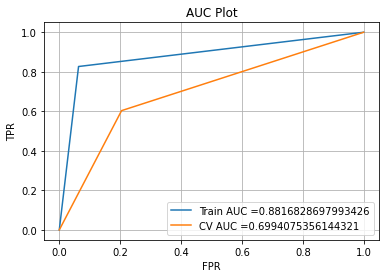

Cross Validation
FNR:0.39655172413793105 ,TPR:0.603448275862069 ,FPR:0.20463320463320464 ,TNR:0.7953667953667953 


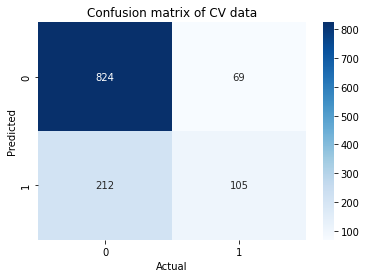

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1036
           1       0.45      0.45      0.45       174

    accuracy                           0.84      1210
   macro avg       0.68      0.68      0.68      1210
weighted avg       0.84      0.84      0.84      1210

              precision    recall  f1-score   support

           0       0.92      0.94      0.93      4077
           1       0.60      0.55      0.58       698

    accuracy                           0.88      4775
   macro avg       0.76      0.75      0.75      4775
weighted avg       0.88      0.88      0.88      4775



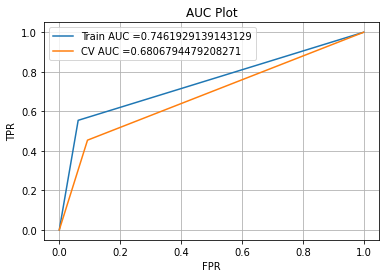

Cross Validation
FNR:0.5459770114942529 ,TPR:0.4540229885057471 ,FPR:0.09266409266409266 ,TNR:0.9073359073359073 


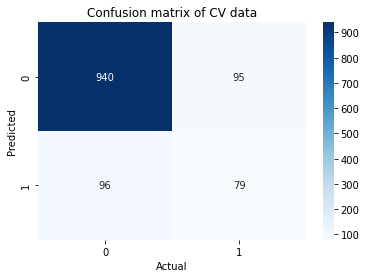

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.91      0.93      0.92      1036
           1       0.50      0.44      0.47       174

    accuracy                           0.86      1210
   macro avg       0.70      0.68      0.69      1210
weighted avg       0.85      0.86      0.85      1210

              precision    recall  f1-score   support

           0       0.91      0.95      0.93      4077
           1       0.62      0.46      0.53       698

    accuracy                           0.88      4775
   macro avg       0.77      0.70      0.73      4775
weighted avg       0.87      0.88      0.87      4775



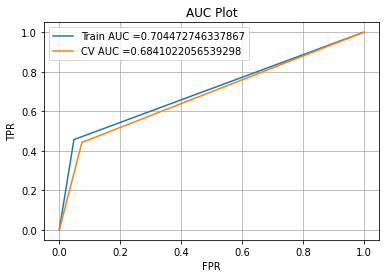

Cross Validation
FNR:0.5574712643678161 ,TPR:0.4425287356321839 ,FPR:0.07432432432432433 ,TNR:0.9256756756756757 


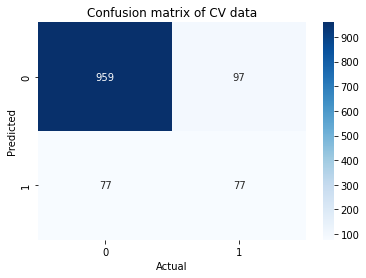

----------------------------------------------------------------------------------------
var_smoothing:  1
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1036
           1       0.62      0.36      0.45       174

    accuracy                           0.88      1210
   macro avg       0.76      0.66      0.69      1210
weighted avg       0.86      0.88      0.86      1210

              precision    recall  f1-score   support

           0       0.90      0.98      0.94      4077
           1       0.72      0.37      0.49       698

    accuracy                           0.89      4775
   macro avg       0.81      0.67      0.71      4775
weighted avg       0.88      0.89      0.87      4775



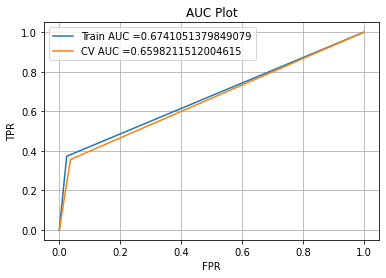

Cross Validation
FNR:0.6436781609195402 ,TPR:0.3563218390804598 ,FPR:0.03667953667953668 ,TNR:0.9633204633204633 


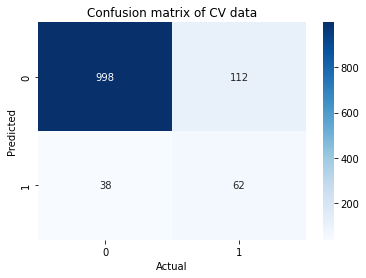

----------------------------------------------------------------------------------------
var_smoothing:  5
              precision    recall  f1-score   support

           0       0.90      1.00      0.95      1036
           1       1.00      0.31      0.47       174

    accuracy                           0.90      1210
   macro avg       0.95      0.66      0.71      1210
weighted avg       0.91      0.90      0.88      1210

              precision    recall  f1-score   support

           0       0.89      1.00      0.94      4077
           1       0.93      0.27      0.41       698

    accuracy                           0.89      4775
   macro avg       0.91      0.63      0.68      4775
weighted avg       0.89      0.89      0.86      4775



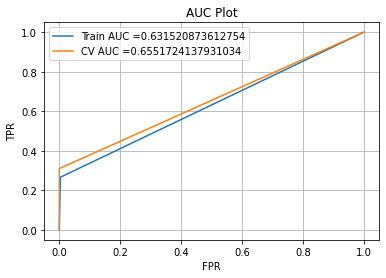

Cross Validation
FNR:0.6896551724137931 ,TPR:0.3103448275862069 ,FPR:0.0 ,TNR:1.0 


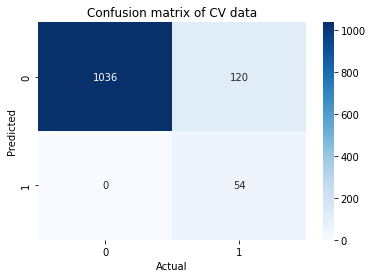

----------------------------------------------------------------------------------------
var_smoothing:  10
              precision    recall  f1-score   support

           0       0.89      1.00      0.94      1036
           1       1.00      0.24      0.39       174

    accuracy                           0.89      1210
   macro avg       0.94      0.62      0.66      1210
weighted avg       0.90      0.89      0.86      1210

              precision    recall  f1-score   support

           0       0.88      1.00      0.94      4077
           1       1.00      0.23      0.37       698

    accuracy                           0.89      4775
   macro avg       0.94      0.61      0.65      4775
weighted avg       0.90      0.89      0.85      4775



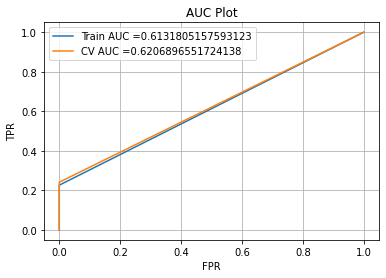

Cross Validation
FNR:0.7586206896551724 ,TPR:0.2413793103448276 ,FPR:0.0 ,TNR:1.0 


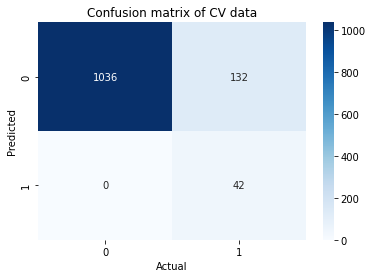

In [117]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1,1,5,10]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_train_outpatient_sd,y_train_outpatient.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_train_outpatient_sd)
    print(classification_report(y_train_outpatient,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train_outpatient, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

50:50 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      4077
           1       0.95      1.00      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



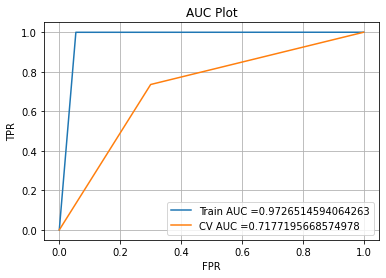

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


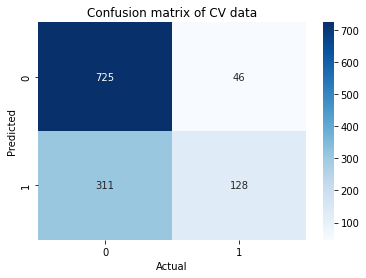

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      4077
           1       0.95      1.00      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



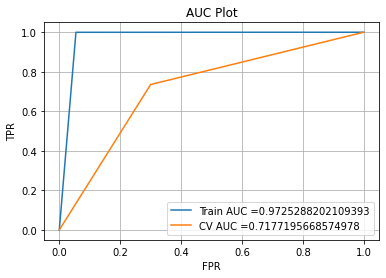

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


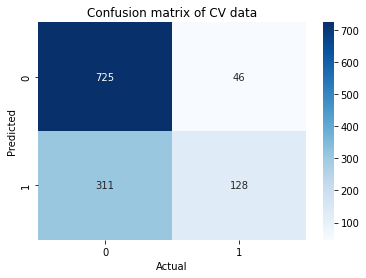

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.93      0.74      0.83      1036
           1       0.31      0.68      0.43       174

    accuracy                           0.74      1210
   macro avg       0.62      0.71      0.63      1210
weighted avg       0.84      0.74      0.77      1210

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      4077
           1       0.94      1.00      0.97      4077

    accuracy                           0.97      8154
   macro avg       0.97      0.97      0.97      8154
weighted avg       0.97      0.97      0.97      8154



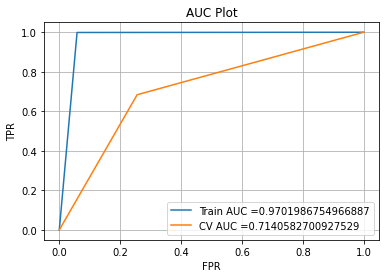

Cross Validation
FNR:0.3160919540229885 ,TPR:0.6839080459770115 ,FPR:0.2557915057915058 ,TNR:0.7442084942084942 


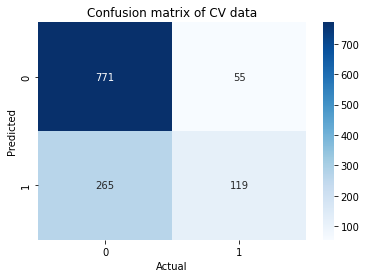

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.92      0.78      0.85      1036
           1       0.32      0.61      0.42       174

    accuracy                           0.76      1210
   macro avg       0.62      0.70      0.63      1210
weighted avg       0.84      0.76      0.79      1210

              precision    recall  f1-score   support

           0       0.95      0.94      0.94      4077
           1       0.94      0.95      0.94      4077

    accuracy                           0.94      8154
   macro avg       0.94      0.94      0.94      8154
weighted avg       0.94      0.94      0.94      8154



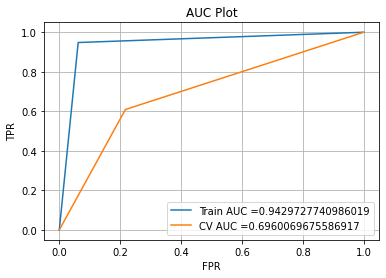

Cross Validation
FNR:0.39080459770114945 ,TPR:0.6091954022988506 ,FPR:0.2171814671814672 ,TNR:0.7828185328185329 


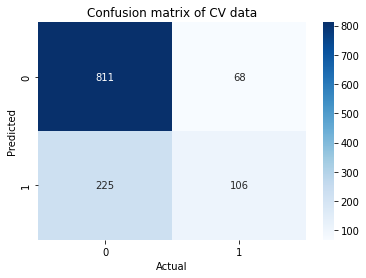

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.92      0.86      0.89      1036
           1       0.40      0.55      0.46       174

    accuracy                           0.82      1210
   macro avg       0.66      0.70      0.68      1210
weighted avg       0.84      0.82      0.83      1210

              precision    recall  f1-score   support

           0       0.78      0.94      0.85      4077
           1       0.92      0.73      0.82      4077

    accuracy                           0.84      8154
   macro avg       0.85      0.84      0.83      8154
weighted avg       0.85      0.84      0.83      8154



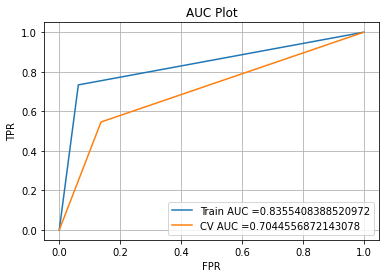

Cross Validation
FNR:0.4540229885057471 ,TPR:0.5459770114942529 ,FPR:0.13706563706563707 ,TNR:0.862934362934363 


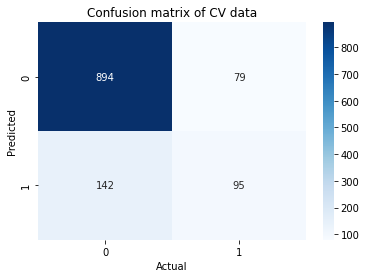

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1036
           1       0.47      0.45      0.46       174

    accuracy                           0.85      1210
   macro avg       0.69      0.68      0.69      1210
weighted avg       0.85      0.85      0.85      1210

              precision    recall  f1-score   support

           0       0.65      0.94      0.77      4077
           1       0.90      0.49      0.63      4077

    accuracy                           0.72      8154
   macro avg       0.77      0.72      0.70      8154
weighted avg       0.77      0.72      0.70      8154



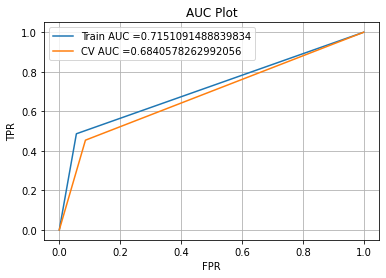

Cross Validation
FNR:0.5459770114942529 ,TPR:0.4540229885057471 ,FPR:0.0859073359073359 ,TNR:0.9140926640926641 


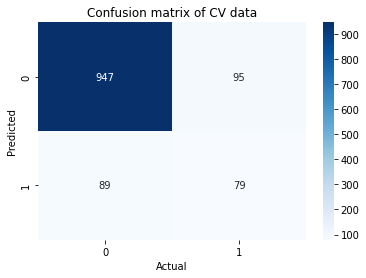

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.53      0.40      0.46       174

    accuracy                           0.86      1210
   macro avg       0.72      0.67      0.69      1210
weighted avg       0.85      0.86      0.85      1210

              precision    recall  f1-score   support

           0       0.62      0.97      0.76      4077
           1       0.93      0.42      0.57      4077

    accuracy                           0.69      8154
   macro avg       0.78      0.69      0.67      8154
weighted avg       0.78      0.69      0.67      8154



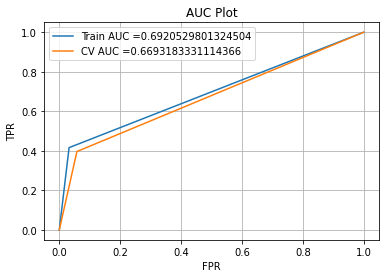

Cross Validation
FNR:0.603448275862069 ,TPR:0.39655172413793105 ,FPR:0.05791505791505792 ,TNR:0.9420849420849421 


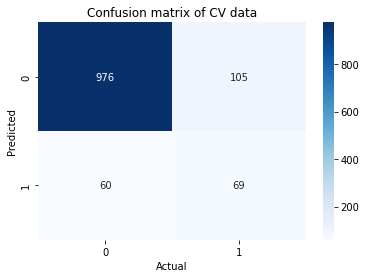

----------------------------------------------------------------------------------------
var_smoothing:  1
              precision    recall  f1-score   support

           0       0.90      0.99      0.94      1036
           1       0.81      0.32      0.46       174

    accuracy                           0.89      1210
   macro avg       0.85      0.65      0.70      1210
weighted avg       0.88      0.89      0.87      1210

              precision    recall  f1-score   support

           0       0.58      1.00      0.73      4077
           1       0.98      0.28      0.44      4077

    accuracy                           0.64      8154
   macro avg       0.78      0.64      0.59      8154
weighted avg       0.78      0.64      0.59      8154



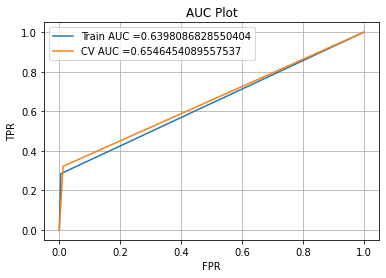

Cross Validation
FNR:0.6781609195402298 ,TPR:0.3218390804597701 ,FPR:0.012548262548262547 ,TNR:0.9874517374517374 


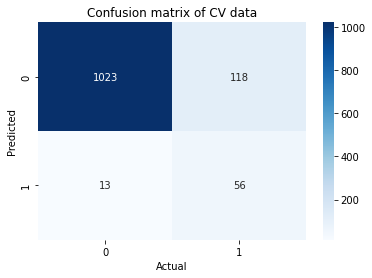

----------------------------------------------------------------------------------------
var_smoothing:  5
              precision    recall  f1-score   support

           0       0.88      1.00      0.93      1036
           1       1.00      0.16      0.27       174

    accuracy                           0.88      1210
   macro avg       0.94      0.58      0.60      1210
weighted avg       0.89      0.88      0.84      1210

              precision    recall  f1-score   support

           0       0.56      1.00      0.72      4077
           1       1.00      0.20      0.34      4077

    accuracy                           0.60      8154
   macro avg       0.78      0.60      0.53      8154
weighted avg       0.78      0.60      0.53      8154



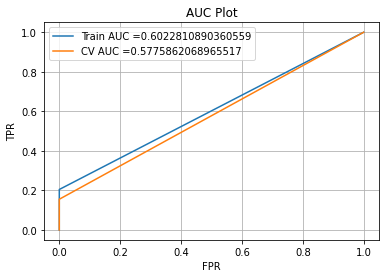

Cross Validation
FNR:0.8448275862068966 ,TPR:0.15517241379310345 ,FPR:0.0 ,TNR:1.0 


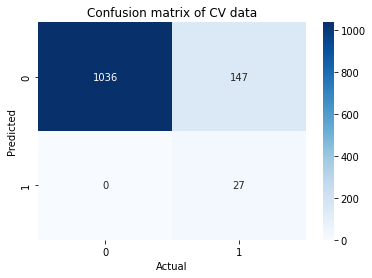

In [118]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1,1,5]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_outpatient_50_50_sd,y_outpatient_50_50_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_50_50_sd)
    print(classification_report(y_outpatient_50_50_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_50_50_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

60:40 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      4077
           1       0.92      1.00      0.96      2731

    accuracy                           0.97      6808
   macro avg       0.96      0.97      0.97      6808
weighted avg       0.97      0.97      0.97      6808



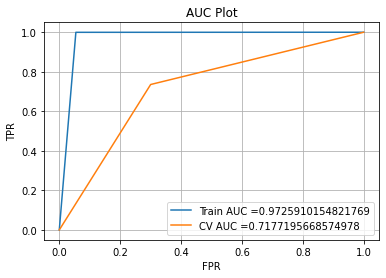

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


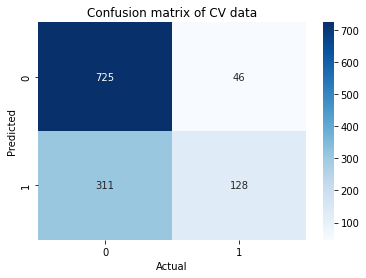

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.94      0.70      0.80      1036
           1       0.29      0.74      0.42       174

    accuracy                           0.70      1210
   macro avg       0.62      0.72      0.61      1210
weighted avg       0.85      0.70      0.75      1210

              precision    recall  f1-score   support

           0       1.00      0.95      0.97      4077
           1       0.92      1.00      0.96      2731

    accuracy                           0.97      6808
   macro avg       0.96      0.97      0.97      6808
weighted avg       0.97      0.97      0.97      6808



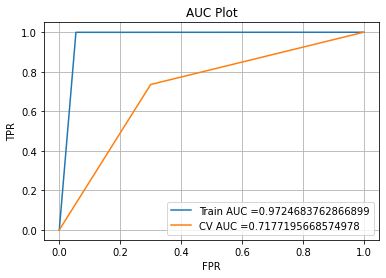

Cross Validation
FNR:0.26436781609195403 ,TPR:0.735632183908046 ,FPR:0.3001930501930502 ,TNR:0.6998069498069498 


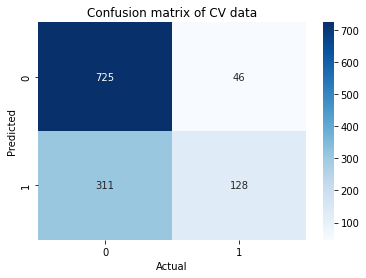

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.94      0.74      0.83      1036
           1       0.31      0.70      0.43       174

    accuracy                           0.73      1210
   macro avg       0.62      0.72      0.63      1210
weighted avg       0.85      0.73      0.77      1210

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      4077
           1       0.92      1.00      0.96      2731

    accuracy                           0.97      6808
   macro avg       0.96      0.97      0.96      6808
weighted avg       0.97      0.97      0.97      6808



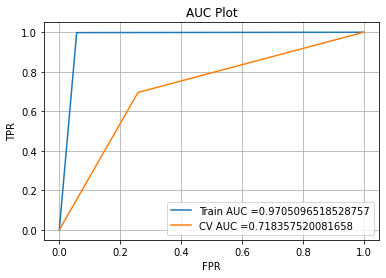

Cross Validation
FNR:0.3045977011494253 ,TPR:0.6954022988505747 ,FPR:0.25868725868725867 ,TNR:0.7413127413127413 


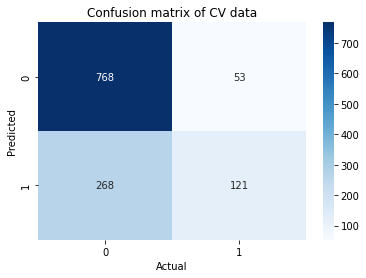

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.92      0.78      0.85      1036
           1       0.32      0.61      0.42       174

    accuracy                           0.76      1210
   macro avg       0.62      0.70      0.63      1210
weighted avg       0.84      0.76      0.78      1210

              precision    recall  f1-score   support

           0       0.97      0.94      0.95      4077
           1       0.91      0.95      0.93      2731

    accuracy                           0.94      6808
   macro avg       0.94      0.94      0.94      6808
weighted avg       0.94      0.94      0.94      6808



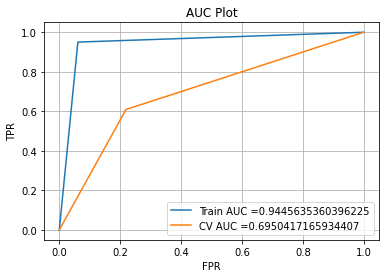

Cross Validation
FNR:0.39080459770114945 ,TPR:0.6091954022988506 ,FPR:0.21911196911196912 ,TNR:0.7808880308880309 


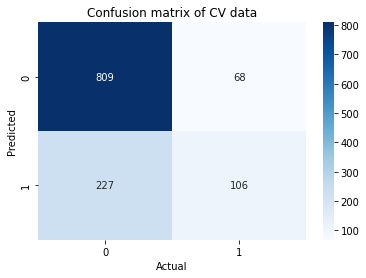

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       0.92      0.86      0.89      1036
           1       0.39      0.56      0.46       174

    accuracy                           0.81      1210
   macro avg       0.66      0.71      0.67      1210
weighted avg       0.84      0.81      0.83      1210

              precision    recall  f1-score   support

           0       0.85      0.94      0.89      4077
           1       0.89      0.74      0.81      2731

    accuracy                           0.86      6808
   macro avg       0.87      0.84      0.85      6808
weighted avg       0.86      0.86      0.86      6808



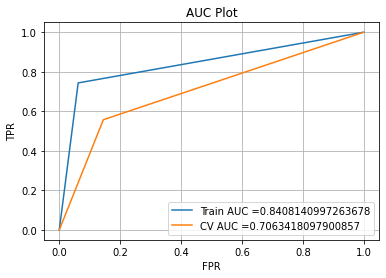

Cross Validation
FNR:0.4425287356321839 ,TPR:0.5574712643678161 ,FPR:0.14478764478764478 ,TNR:0.8552123552123552 


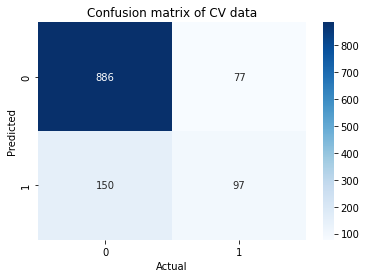

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1036
           1       0.47      0.45      0.46       174

    accuracy                           0.85      1210
   macro avg       0.69      0.68      0.69      1210
weighted avg       0.85      0.85      0.85      1210

              precision    recall  f1-score   support

           0       0.74      0.94      0.83      4077
           1       0.85      0.49      0.63      2731

    accuracy                           0.76      6808
   macro avg       0.79      0.72      0.73      6808
weighted avg       0.78      0.76      0.75      6808



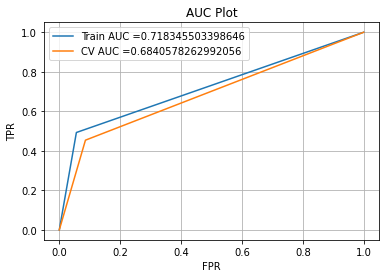

Cross Validation
FNR:0.5459770114942529 ,TPR:0.4540229885057471 ,FPR:0.0859073359073359 ,TNR:0.9140926640926641 


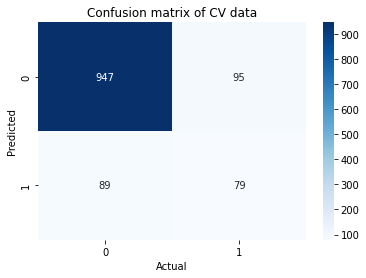

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1036
           1       0.53      0.40      0.46       174

    accuracy                           0.86      1210
   macro avg       0.72      0.67      0.69      1210
weighted avg       0.85      0.86      0.85      1210

              precision    recall  f1-score   support

           0       0.72      0.97      0.82      4077
           1       0.90      0.43      0.58      2731

    accuracy                           0.75      6808
   macro avg       0.81      0.70      0.70      6808
weighted avg       0.79      0.75      0.72      6808



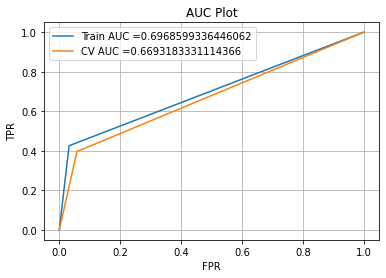

Cross Validation
FNR:0.603448275862069 ,TPR:0.39655172413793105 ,FPR:0.05791505791505792 ,TNR:0.9420849420849421 


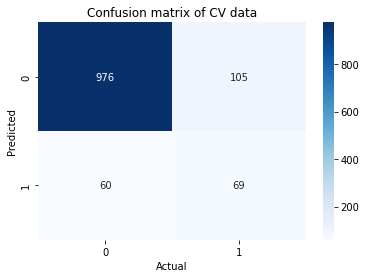

----------------------------------------------------------------------------------------
var_smoothing:  1
              precision    recall  f1-score   support

           0       0.90      0.99      0.94      1036
           1       0.81      0.32      0.46       174

    accuracy                           0.89      1210
   macro avg       0.85      0.65      0.70      1210
weighted avg       0.88      0.89      0.87      1210

              precision    recall  f1-score   support

           0       0.68      0.99      0.80      4077
           1       0.96      0.29      0.45      2731

    accuracy                           0.71      6808
   macro avg       0.82      0.64      0.63      6808
weighted avg       0.79      0.71      0.66      6808



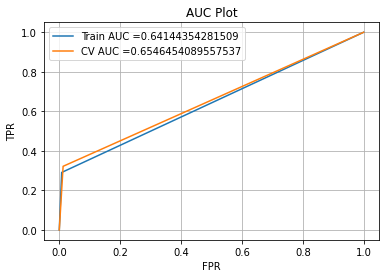

Cross Validation
FNR:0.6781609195402298 ,TPR:0.3218390804597701 ,FPR:0.012548262548262547 ,TNR:0.9874517374517374 


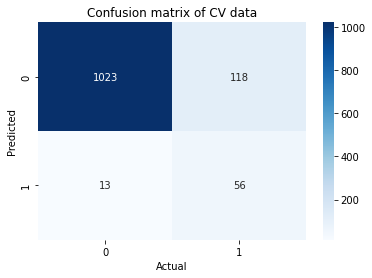

----------------------------------------------------------------------------------------
var_smoothing:  10
              precision    recall  f1-score   support

           0       0.87      1.00      0.93      1036
           1       1.00      0.09      0.16       174

    accuracy                           0.87      1210
   macro avg       0.93      0.54      0.54      1210
weighted avg       0.89      0.87      0.82      1210

              precision    recall  f1-score   support

           0       0.63      1.00      0.77      4077
           1       1.00      0.13      0.23      2731

    accuracy                           0.65      6808
   macro avg       0.82      0.56      0.50      6808
weighted avg       0.78      0.65      0.55      6808



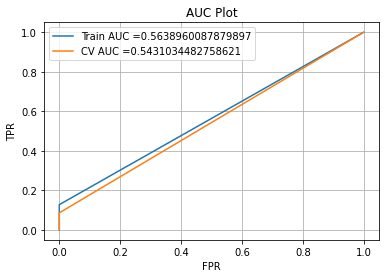

Cross Validation
FNR:0.9137931034482759 ,TPR:0.08620689655172414 ,FPR:0.0 ,TNR:1.0 


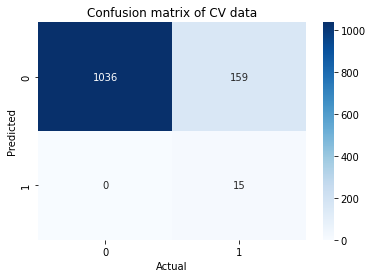

In [119]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1,1,10]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_outpatient_60_40_sd,y_outpatient_60_40_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient_sd)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_60_40_sd)
    print(classification_report(y_outpatient_60_40_sd,y_train_pred))
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_60_40_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="Train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print("Cross Validation")
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

70:30 sampling

----------------------------------------------------------------------------------------
var_smoothing:  1e-12
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.14      1210
   macro avg       0.07      0.50      0.13      1210
weighted avg       0.02      0.14      0.04      1210



c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


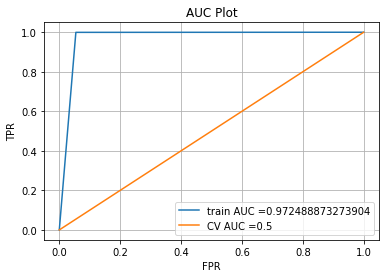

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:1.0 ,TNR:0.0 


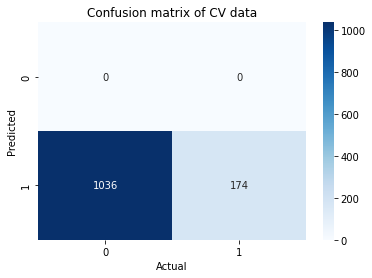

----------------------------------------------------------------------------------------
var_smoothing:  1e-10
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.14      1210
   macro avg       0.07      0.50      0.13      1210
weighted avg       0.02      0.14      0.04      1210



c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


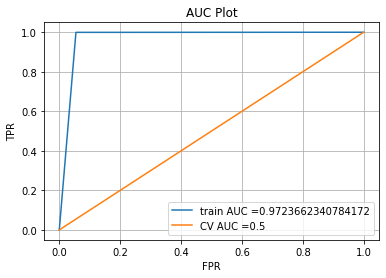

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:1.0 ,TNR:0.0 


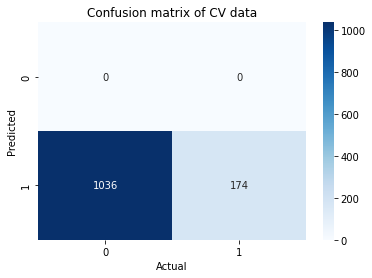

----------------------------------------------------------------------------------------
var_smoothing:  1e-08
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.14      1210
   macro avg       0.07      0.50      0.13      1210
weighted avg       0.02      0.14      0.04      1210



c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


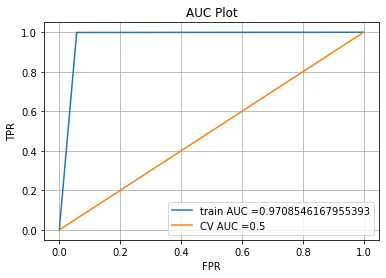

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:1.0 ,TNR:0.0 


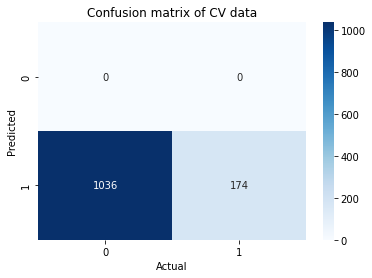

----------------------------------------------------------------------------------------
var_smoothing:  1e-06
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.14      1210
   macro avg       0.07      0.50      0.13      1210
weighted avg       0.02      0.14      0.04      1210



c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\programdata\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


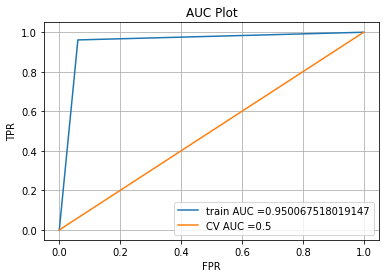

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:1.0 ,TNR:0.0 


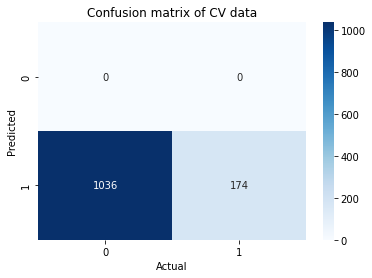

----------------------------------------------------------------------------------------
var_smoothing:  0.0001
              precision    recall  f1-score   support

           0       1.00      0.00      0.01      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.15      1210
   macro avg       0.57      0.50      0.13      1210
weighted avg       0.88      0.15      0.04      1210



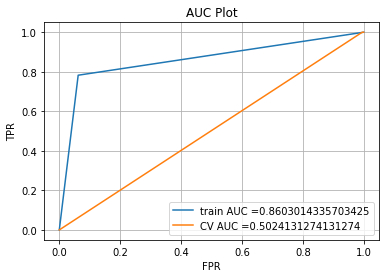

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:0.9951737451737451 ,TNR:0.004826254826254826 


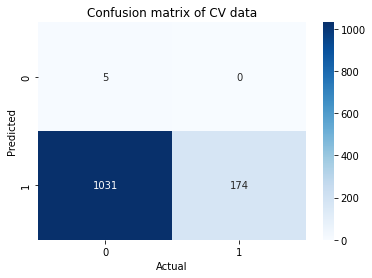

----------------------------------------------------------------------------------------
var_smoothing:  0.01
              precision    recall  f1-score   support

           0       1.00      0.01      0.02      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.15      1210
   macro avg       0.57      0.50      0.13      1210
weighted avg       0.88      0.15      0.05      1210



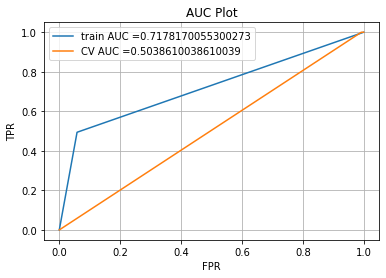

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:0.9922779922779923 ,TNR:0.007722007722007722 


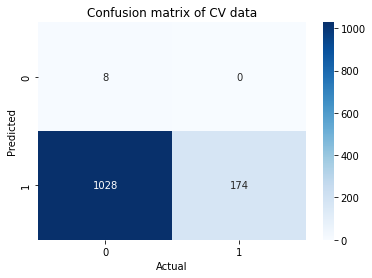

----------------------------------------------------------------------------------------
var_smoothing:  0.1
              precision    recall  f1-score   support

           0       1.00      0.01      0.02      1036
           1       0.14      1.00      0.25       174

    accuracy                           0.15      1210
   macro avg       0.57      0.50      0.14      1210
weighted avg       0.88      0.15      0.05      1210



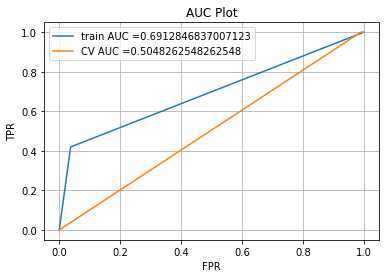

Cross Validation
FNR:0.0 ,TPR:1.0 ,FPR:0.9903474903474904 ,TNR:0.009652509652509652 


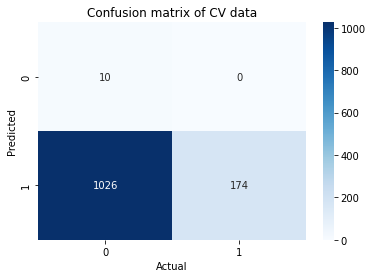

In [120]:
for hyperparameter in [0.000000000001,0.0000000001,0.00000001,0.000001,0.0001,0.01,0.1]:
    clf = GaussianNB(var_smoothing=hyperparameter)
    clf.fit(X_outpatient_70_30_sd,y_outpatient_70_30_sd.values.ravel())
    y_pred = clf.predict(X_cv_outpatient)
    print("----------------------------------------------------------------------------------------")
    print("var_smoothing: ",hyperparameter)
    print(classification_report(y_cv_outpatient,y_pred))
    y_train_pred = clf.predict(X_outpatient_70_30_sd)
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_outpatient_70_30_sd, y_train_pred)
    cv_fpr, cv_tpr, te_thresholds = roc_curve(y_cv_outpatient, y_pred)
    auc_score = auc(cv_fpr, cv_tpr)
    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(cv_fpr, cv_tpr, label="CV AUC ="+str(auc_score))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()
    plt.figure()
    print("Cross Validation")
    cv_cm = confusion_matrix(y_cv_outpatient, y_pred)
    tn, fp, fn, tp = cv_cm.ravel()
    print('FNR:{0} ,TPR:{1} ,FPR:{2} ,TNR:{3} '.format(fn/(fn + tp), tp/(tp + fn), fp/(fp+tn), tn/(tn+fp)))
    sns.heatmap(cv_cm.transpose(), annot=True,fmt="d",cmap='Blues')
    plt.title('Confusion matrix of CV data')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()